<a href="https://colab.research.google.com/github/fastaccurate/Algorithmic-Trading/blob/main/price.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [ ]:
data_df = pd.read_csv('tbt_resampled_1 (1).csv')

In [ ]:
data_df

,Unnamed: 0,time,bid_size[0],bid[0],ask[0],ask_size[0],bid_size[1],bid[1],ask[1],ask_size[1],bid_size[2],bid[2],ask[2],ask_size[2],bid_size[3],bid[3],ask[3],ask_size[3]
0,0,2023-07-17 09:15:00.000,200.0,1961560.0,1964450.0,250.0,150.0,1960665.0,1964540.0,250.0,50.0,1960365.0,1964550.0,1000.0,50.0,1960005.0,1964640.0,250.0
1,1,2023-07-17 09:15:00.030,1200.0,1961575.0,1963795.0,200.0,750.0,1961570.0,1963800.0,50.0,200.0,1961560.0,1963900.0,50.0,1000.0,1960675.0,1964000.0,50.0
2,2,2023-07-17 09:15:00.060,200.0,1962105.0,1963795.0,200.0,200.0,1962100.0,1963800.0,50.0,100.0,1961585.0,1963900.0,50.0,2500.0,1961580.0,1964000.0,50.0
3,3,2023-07-17 09:15:00.090,1450.0,1962135.0,1963775.0,200.0,600.0,1962130.0,1963780.0,150.0,300.0,1962125.0,1963785.0,250.0,2250.0,1962120.0,1963790.0,2250.0
4,4,2023-07-17 09:15:00.120,200.0,1962145.0,1963765.0,200.0,50.0,1962140.0,1963770.0,300.0,1000.0,1962135.0,1963800.0,50.0,350.0,1962130.0,1963880.0,1250.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
749994,749994,2023-07-17 15:29:59.820,300.0,1972950.0,1973000.0,3200.0,700.0,1972890.0,1973075.0,250.0,1500.0,1972800.0,1973080.0,50.0,1550.0,1972750.0,1973100.0,150.0
749995,749995,2023-07-17 15:29:59.850,300.0,1972950.0,1973000.0,3200.0,700.0,1972890.0,1973075.0,250.0,1500.0,1972800.0,1973080.0,50.0,1550.0,1972750.0,1973100.0,350.0
749996,749996,2023-07-17 15:29:59.880,300.0,1972950.0,1973000.0,3200.0,700.0,1972890.0,1973075.0,250.0,1500.0,1972800.0,1973080.0,50.0,1550.0,1972750.0,1973100.0,350.0
749997,749997,2023-07-17 15:29:59.910,300.0,1972950.0,1972990.0,250.0,700.0,1972890.0,1973000.0,3200.0,1500.0,1972800.0,1973080.0,50.0,1550.0,1972750.0,1973100.0,350.0


In [ ]:
data_df=data_df.drop(['Unnamed: 0'], axis=1)

In [ ]:
data_df.describe()

,bid_size[0],bid[0],ask[0],ask_size[0],bid_size[1],bid[1],ask[1],ask_size[1],bid_size[2],bid[2],ask[2],ask_size[2],bid_size[3],bid[3],ask[3],ask_size[3]
count,749999.000000,7.499990e+05,7.499990e+05,749999.000000,749999.000000,7.499990e+05,7.499990e+05,749999.000000,749999.000000,7.499990e+05,7.499990e+05,749999.000000,749999.000000,7.499990e+05,7.499990e+05,749999.000000
mean,248.393131,1.966182e+06,1.966318e+06,325.661768,221.207562,1.966144e+06,1.966365e+06,219.046359,208.054477,1.966116e+06,1.966394e+06,193.083191,201.270402,1.966097e+06,1.966414e+06,183.193444
std,1264.440972,2.739657e+03,2.721451e+03,1426.037023,1236.482304,2.740358e+03,2.724460e+03,935.396269,1169.119803,2.742645e+03,2.729593e+03,466.618422,1044.004891,2.745303e+03,2.733524e+03,393.094228
min,50.000000,1.959700e+06,1.959805e+06,50.000000,50.000000,1.959665e+06,1.959925e+06,50.000000,50.000000,1.959635e+06,1.959930e+06,50.000000,50.000000,1.959630e+06,1.959950e+06,50.000000
25%,50.000000,1.964405e+06,1.964505e+06,50.000000,50.000000,1.964370e+06,1.964600e+06,50.000000,50.000000,1.964330e+06,1.964635e+06,50.000000,50.000000,1.964310e+06,1.964655e+06,50.000000
50%,100.000000,1.965715e+06,1.965900e+06,100.000000,100.000000,1.965695e+06,1.965950e+06,100.000000,100.000000,1.965660e+06,1.965985e+06,100.000000,100.000000,1.965645e+06,1.965995e+06,100.000000
75%,200.000000,1.968200e+06,1.968300e+06,250.000000,200.000000,1.968170e+06,1.968375e+06,200.000000,200.000000,1.968140e+06,1.968400e+06,200.000000,200.000000,1.968125e+06,1.968435e+06,200.000000
max,50300.000000,1.973705e+06,1.973900e+06,49750.000000,50150.000000,1.973690e+06,1.973925e+06,49750.000000,50300.000000,1.973685e+06,1.973940e+06,11900.000000,50200.000000,1.973660e+06,1.973950e+06,11900.000000


## BID ASK SPREAD

In [ ]:
data_df['bid-ask spread']=data_df["ask[0]"]-data_df["bid[0]"]

In [ ]:
data_df

,time,bid_size[0],bid[0],ask[0],ask_size[0],bid_size[1],bid[1],ask[1],ask_size[1],bid_size[2],bid[2],ask[2],ask_size[2],bid_size[3],bid[3],ask[3],ask_size[3],bid-ask spread
0,2023-07-17 09:15:00.000,200.0,1961560.0,1964450.0,250.0,150.0,1960665.0,1964540.0,250.0,50.0,1960365.0,1964550.0,1000.0,50.0,1960005.0,1964640.0,250.0,2890.0
1,2023-07-17 09:15:00.030,1200.0,1961575.0,1963795.0,200.0,750.0,1961570.0,1963800.0,50.0,200.0,1961560.0,1963900.0,50.0,1000.0,1960675.0,1964000.0,50.0,2220.0
2,2023-07-17 09:15:00.060,200.0,1962105.0,1963795.0,200.0,200.0,1962100.0,1963800.0,50.0,100.0,1961585.0,1963900.0,50.0,2500.0,1961580.0,1964000.0,50.0,1690.0
3,2023-07-17 09:15:00.090,1450.0,1962135.0,1963775.0,200.0,600.0,1962130.0,1963780.0,150.0,300.0,1962125.0,1963785.0,250.0,2250.0,1962120.0,1963790.0,2250.0,1640.0
4,2023-07-17 09:15:00.120,200.0,1962145.0,1963765.0,200.0,50.0,1962140.0,1963770.0,300.0,1000.0,1962135.0,1963800.0,50.0,350.0,1962130.0,1963880.0,1250.0,1620.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
749994,2023-07-17 15:29:59.820,300.0,1972950.0,1973000.0,3200.0,700.0,1972890.0,1973075.0,250.0,1500.0,1972800.0,1973080.0,50.0,1550.0,1972750.0,1973100.0,150.0,50.0
749995,2023-07-17 15:29:59.850,300.0,1972950.0,1973000.0,3200.0,700.0,1972890.0,1973075.0,250.0,1500.0,1972800.0,1973080.0,50.0,1550.0,1972750.0,1973100.0,350.0,50.0
749996,2023-07-17 15:29:59.880,300.0,1972950.0,1973000.0,3200.0,700.0,1972890.0,1973075.0,250.0,1500.0,1972800.0,1973080.0,50.0,1550.0,1972750.0,1973100.0,350.0,50.0
749997,2023-07-17 15:29:59.910,300.0,1972950.0,1972990.0,250.0,700.0,1972890.0,1973000.0,3200.0,1500.0,1972800.0,1973080.0,50.0,1550.0,1972750.0,1973100.0,350.0,40.0


In [ ]:
data_df.corr()


C:\Users\kaustubh\AppData\Local\Temp\ipykernel_24656\949887772.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  data_df.corr()


,bid_size[0],bid[0],ask[0],ask_size[0],bid_size[1],bid[1],ask[1],ask_size[1],bid_size[2],bid[2],ask[2],ask_size[2],bid_size[3],bid[3],ask[3],ask_size[3],bid-ask spread
bid_size[0],1.000000,0.014816,0.013343,-0.009779,0.004441,0.014105,0.013147,-0.002207,0.001665,0.013840,0.012950,0.013075,0.001233,0.013668,0.012853,0.017976,-0.048497
bid[0],0.014816,1.000000,0.999500,0.027952,0.012964,0.999863,0.999498,0.042571,0.011591,0.999802,0.999534,0.070915,0.016212,0.999762,0.999559,0.048218,-0.221761
ask[0],0.013343,0.999500,1.000000,0.026444,0.012073,0.999503,0.999843,0.041247,0.010587,0.999530,0.999780,0.069856,0.015486,0.999547,0.999741,0.046819,-0.190824
ask_size[0],-0.009779,0.027952,0.026444,1.000000,-0.006271,0.028346,0.027115,0.010939,-0.004975,0.028599,0.027329,0.031392,-0.003234,0.028661,0.027394,0.051620,-0.052297
bid_size[1],0.004441,0.012964,0.012073,-0.006271,1.000000,0.013543,0.012043,-0.003837,0.001648,0.012926,0.011880,-0.003109,0.001174,0.012649,0.011794,0.006889,-0.030171
bid[1],0.014105,0.999863,0.999503,0.028346,0.013543,1.000000,0.999530,0.042862,0.011926,0.999923,0.999582,0.071146,0.016556,0.999880,0.999619,0.048162,-0.217413
ask[1],0.013147,0.999498,0.999843,0.027115,0.012043,0.999530,1.000000,0.040839,0.010516,0.999578,0.999925,0.069264,0.015496,0.999608,0.999880,0.046257,-0.195611
ask_size[1],-0.002207,0.042571,0.041247,0.010939,-0.003837,0.042862,0.040839,1.000000,-0.004937,0.043054,0.041615,0.017588,-0.003540,0.043116,0.041996,0.020607,-0.049605
bid_size[2],0.001665,0.011591,0.010587,-0.004975,0.001648,0.011926,0.010516,-0.004937,1.000000,0.012178,0.010463,-0.002680,0.004916,0.011657,0.010481,0.005059,-0.033363
bid[2],0.013840,0.999802,0.999530,0.028599,0.012926,0.999923,0.999578,0.043054,0.012178,1.000000,0.999641,0.071354,0.016762,0.999956,0.999685,0.048258,-0.214690


In [ ]:
data_df

,time,bid_size[0],bid[0],ask[0],ask_size[0],bid_size[1],bid[1],ask[1],ask_size[1],bid_size[2],bid[2],ask[2],ask_size[2],bid_size[3],bid[3],ask[3],ask_size[3],bid-ask spread
0,2023-07-17 09:15:00.000,200.0,1961560.0,1964450.0,250.0,150.0,1960665.0,1964540.0,250.0,50.0,1960365.0,1964550.0,1000.0,50.0,1960005.0,1964640.0,250.0,2890.0
1,2023-07-17 09:15:00.030,1200.0,1961575.0,1963795.0,200.0,750.0,1961570.0,1963800.0,50.0,200.0,1961560.0,1963900.0,50.0,1000.0,1960675.0,1964000.0,50.0,2220.0
2,2023-07-17 09:15:00.060,200.0,1962105.0,1963795.0,200.0,200.0,1962100.0,1963800.0,50.0,100.0,1961585.0,1963900.0,50.0,2500.0,1961580.0,1964000.0,50.0,1690.0
3,2023-07-17 09:15:00.090,1450.0,1962135.0,1963775.0,200.0,600.0,1962130.0,1963780.0,150.0,300.0,1962125.0,1963785.0,250.0,2250.0,1962120.0,1963790.0,2250.0,1640.0
4,2023-07-17 09:15:00.120,200.0,1962145.0,1963765.0,200.0,50.0,1962140.0,1963770.0,300.0,1000.0,1962135.0,1963800.0,50.0,350.0,1962130.0,1963880.0,1250.0,1620.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
749994,2023-07-17 15:29:59.820,300.0,1972950.0,1973000.0,3200.0,700.0,1972890.0,1973075.0,250.0,1500.0,1972800.0,1973080.0,50.0,1550.0,1972750.0,1973100.0,150.0,50.0
749995,2023-07-17 15:29:59.850,300.0,1972950.0,1973000.0,3200.0,700.0,1972890.0,1973075.0,250.0,1500.0,1972800.0,1973080.0,50.0,1550.0,1972750.0,1973100.0,350.0,50.0
749996,2023-07-17 15:29:59.880,300.0,1972950.0,1973000.0,3200.0,700.0,1972890.0,1973075.0,250.0,1500.0,1972800.0,1973080.0,50.0,1550.0,1972750.0,1973100.0,350.0,50.0
749997,2023-07-17 15:29:59.910,300.0,1972950.0,1972990.0,250.0,700.0,1972890.0,1973000.0,3200.0,1500.0,1972800.0,1973080.0,50.0,1550.0,1972750.0,1973100.0,350.0,40.0


# Calculating MV
### MV=  [SUMMATION(bid[i]*bid_size[i])+SUMMATION(ask[i]*ask_size[i]]/[summation(bid_size[i])+summation(ask_size[i]]

In [ ]:
data_df['MV']=(data_df["bid[0]"]*data_df["bid_size[0]"]+data_df["bid[1]"]*data_df["bid_size[1]"]+data_df["bid[2]"]*data_df["bid_size[2]"]+data_df["bid[3]"]*data_df["bid_size[3]"]+data_df["ask[0]"]*data_df["ask_size[0]"]+data_df["ask[1]"]*data_df["ask_size[1]"]+data_df["ask[2]"]*data_df["ask_size[2]"]+data_df["ask[3]"]*data_df["ask_size[3]"])/(data_df["bid_size[0]"]+data_df["bid_size[1]"]+data_df["bid_size[2]"]+data_df["bid_size[3]"]+data_df["ask_size[0]"]+data_df["ask_size[1]"]+data_df["ask_size[2]"]+data_df["ask_size[3]"])

In [ ]:
data_df['MV']

0         1.963813e+06
1         1.961542e+06
2         1.961879e+06
3         1.962762e+06
4         1.963041e+06
              ...     
749994    1.972904e+06
749995    1.972909e+06
749996    1.972909e+06
749997    1.972906e+06
749998    1.972909e+06
Name: MV, Length: 749999, dtype: float64

In [ ]:
data_df

,time,bid_size[0],bid[0],ask[0],ask_size[0],bid_size[1],bid[1],ask[1],ask_size[1],bid_size[2],bid[2],ask[2],ask_size[2],bid_size[3],bid[3],ask[3],ask_size[3],bid-ask spread,MV
0,2023-07-17 09:15:00.000,200.0,1961560.0,1964450.0,250.0,150.0,1960665.0,1964540.0,250.0,50.0,1960365.0,1964550.0,1000.0,50.0,1960005.0,1964640.0,250.0,2890.0,1.963813e+06
1,2023-07-17 09:15:00.030,1200.0,1961575.0,1963795.0,200.0,750.0,1961570.0,1963800.0,50.0,200.0,1961560.0,1963900.0,50.0,1000.0,1960675.0,1964000.0,50.0,2220.0,1.961542e+06
2,2023-07-17 09:15:00.060,200.0,1962105.0,1963795.0,200.0,200.0,1962100.0,1963800.0,50.0,100.0,1961585.0,1963900.0,50.0,2500.0,1961580.0,1964000.0,50.0,1690.0,1.961879e+06
3,2023-07-17 09:15:00.090,1450.0,1962135.0,1963775.0,200.0,600.0,1962130.0,1963780.0,150.0,300.0,1962125.0,1963785.0,250.0,2250.0,1962120.0,1963790.0,2250.0,1640.0,1.962762e+06
4,2023-07-17 09:15:00.120,200.0,1962145.0,1963765.0,200.0,50.0,1962140.0,1963770.0,300.0,1000.0,1962135.0,1963800.0,50.0,350.0,1962130.0,1963880.0,1250.0,1620.0,1.963041e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
749994,2023-07-17 15:29:59.820,300.0,1972950.0,1973000.0,3200.0,700.0,1972890.0,1973075.0,250.0,1500.0,1972800.0,1973080.0,50.0,1550.0,1972750.0,1973100.0,150.0,50.0,1.972904e+06
749995,2023-07-17 15:29:59.850,300.0,1972950.0,1973000.0,3200.0,700.0,1972890.0,1973075.0,250.0,1500.0,1972800.0,1973080.0,50.0,1550.0,1972750.0,1973100.0,350.0,50.0,1.972909e+06
749996,2023-07-17 15:29:59.880,300.0,1972950.0,1973000.0,3200.0,700.0,1972890.0,1973075.0,250.0,1500.0,1972800.0,1973080.0,50.0,1550.0,1972750.0,1973100.0,350.0,50.0,1.972909e+06
749997,2023-07-17 15:29:59.910,300.0,1972950.0,1972990.0,250.0,700.0,1972890.0,1973000.0,3200.0,1500.0,1972800.0,1973080.0,50.0,1550.0,1972750.0,1973100.0,350.0,40.0,1.972906e+06


## Plotting Market value vs time graph

In [ ]:
data_df["time"]=pd.to_datetime(data_df["time"])

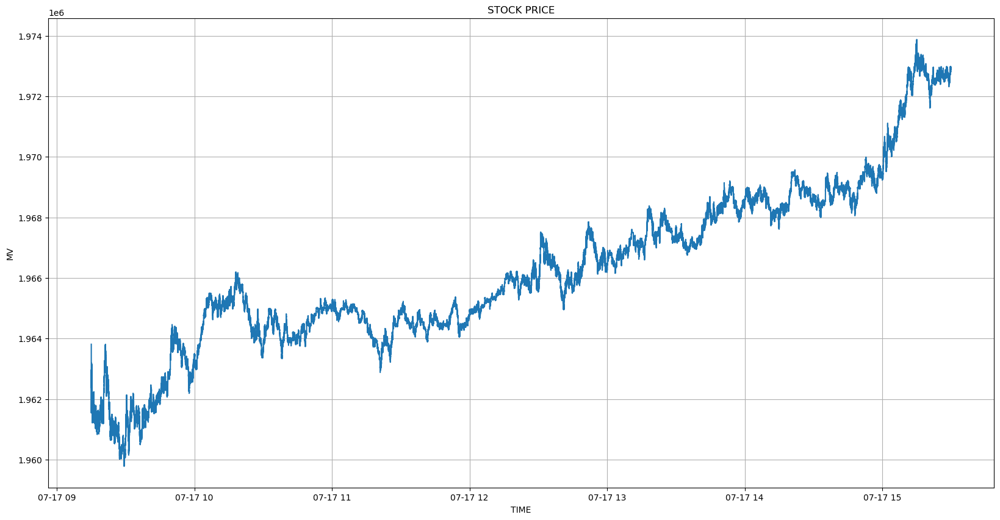

In [ ]:
x_axis = data_df["time"]
y_axis = data_df["MV"]
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(x_axis, y_axis)
plt.title('STOCK PRICE')
plt.xlabel('TIME')
plt.ylabel('MV')


plt.show()

In [ ]:
data_df
value=175.57

## CALCULATING VOLUME OF SHARE TRADED AT EVERY INSTANT:
### VOLUME=MIN(a,b), where a=sum of all ask_size[i] for which ask[i]<=MARKET VALUE
### b=sum of all bid_size[i] for which bid[i]>=MARKET VALUE

In [ ]:


# Set initial values of 'b' and 'a' columns to 0 (numeric)
data_df['b'] = 0
data_df['a'] = 0

# Create boolean masks for bid and ask conditions
bid_conditions = data_df.filter(like='bid[').ge(data_df['MV'], axis=0)
ask_conditions = data_df.filter(like='ask[').ge(data_df['MV'], axis=0)

# Get the sum of bid_size and ask_size based on conditions
data_df['b'] = data_df['b'] + np.where(bid_conditions, data_df.filter(like='bid_size['), 0).sum(axis=1)
data_df['a'] = data_df['a'] + np.where(ask_conditions, data_df.filter(like='ask_size['), 0).sum(axis=1)

data_df['volume'] = np.minimum(data_df['a'], data_df['b'])



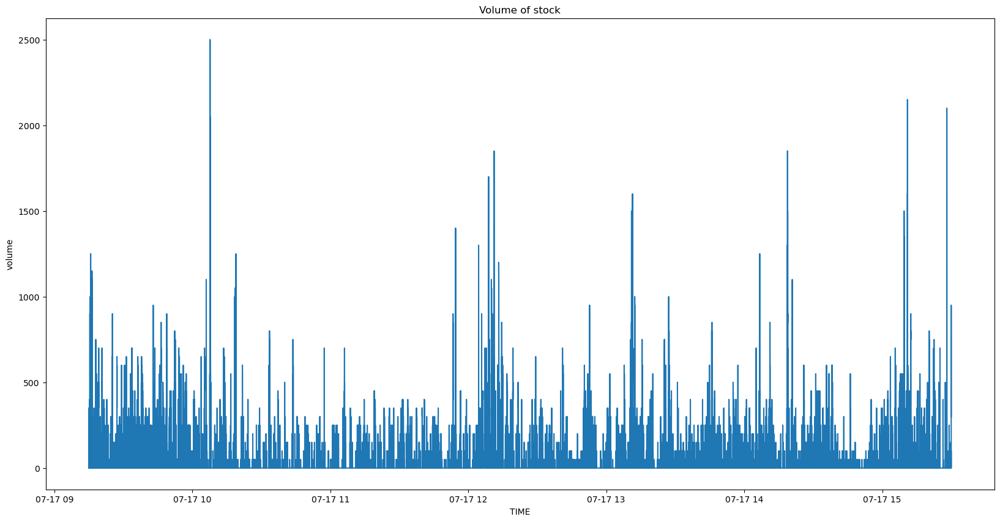

In [ ]:
x_axis = data_df["time"]
y_axis = data_df["volume"]
plt.figure(figsize=(20,10))
plt.plot(x_axis, y_axis)
plt.title('Volume of stock')
plt.xlabel('TIME')
plt.ylabel('volume')


plt.show()

### Calculating open and close

In [ ]:
data_df["Open"] = data_df['MV'].shift(periods=1)
data_df["Close"] = data_df['MV']
data_df["High"]=data_df['MV']*100.01
data_df["Low"]=data_df['MV']*99.99

In [ ]:
data_df

,time,bid_size[0],bid[0],ask[0],ask_size[0],bid_size[1],bid[1],ask[1],ask_size[1],bid_size[2],...,ask_size[3],bid-ask spread,MV,b,a,volume,Open,Close,High,Low
0,2023-07-17 09:15:00.000,200.0,1961560.0,1964450.0,250.0,150.0,1960665.0,1964540.0,250.0,50.0,...,250.0,2890.0,1.963813e+06,0.0,1750.0,0.0,NaN,1.963813e+06,1.964009e+08,1.963616e+08
1,2023-07-17 09:15:00.030,1200.0,1961575.0,1963795.0,200.0,750.0,1961570.0,1963800.0,50.0,200.0,...,50.0,2220.0,1.961542e+06,2150.0,350.0,350.0,1.963813e+06,1.961542e+06,1.961739e+08,1.961346e+08
2,2023-07-17 09:15:00.060,200.0,1962105.0,1963795.0,200.0,200.0,1962100.0,1963800.0,50.0,100.0,...,50.0,1690.0,1.961879e+06,400.0,350.0,350.0,1.961542e+06,1.961879e+06,1.962075e+08,1.961682e+08
3,2023-07-17 09:15:00.090,1450.0,1962135.0,1963775.0,200.0,600.0,1962130.0,1963780.0,150.0,300.0,...,2250.0,1640.0,1.962762e+06,0.0,2850.0,0.0,1.961879e+06,1.962762e+06,1.962958e+08,1.962566e+08
4,2023-07-17 09:15:00.120,200.0,1962145.0,1963765.0,200.0,50.0,1962140.0,1963770.0,300.0,1000.0,...,1250.0,1620.0,1.963041e+06,0.0,1800.0,0.0,1.962762e+06,1.963041e+06,1.963238e+08,1.962845e+08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
749994,2023-07-17 15:29:59.820,300.0,1972950.0,1973000.0,3200.0,700.0,1972890.0,1973075.0,250.0,1500.0,...,150.0,50.0,1.972904e+06,300.0,3650.0,300.0,1.972901e+06,1.972904e+06,1.973101e+08,1.972706e+08
749995,2023-07-17 15:29:59.850,300.0,1972950.0,1973000.0,3200.0,700.0,1972890.0,1973075.0,250.0,1500.0,...,350.0,50.0,1.972909e+06,300.0,3850.0,300.0,1.972904e+06,1.972909e+06,1.973106e+08,1.972711e+08
749996,2023-07-17 15:29:59.880,300.0,1972950.0,1973000.0,3200.0,700.0,1972890.0,1973075.0,250.0,1500.0,...,350.0,50.0,1.972909e+06,300.0,3850.0,300.0,1.972909e+06,1.972909e+06,1.973106e+08,1.972711e+08
749997,2023-07-17 15:29:59.910,300.0,1972950.0,1972990.0,250.0,700.0,1972890.0,1973000.0,3200.0,1500.0,...,350.0,40.0,1.972906e+06,300.0,3850.0,300.0,1.972909e+06,1.972906e+06,1.973103e+08,1.972709e+08


starting portfolio value: 100.00
2023-07-17, Close, 1962961.46
2023-07-17, Close, 1962887.90
2023-07-17, Close, 1962874.74
2023-07-17, Close, 1962856.43
2023-07-17, Close, 1962771.67
2023-07-17, Close, 1962738.46
2023-07-17, Close, 1962742.31
2023-07-17, Close, 1962850.71
2023-07-17, Close, 1962715.48
2023-07-17, Close, 1962675.87
2023-07-17, BUY CREATE, 1962675.87
2023-07-17, Close, 1962697.38
2023-07-17, Close, 1962683.10
2023-07-17, Close, 1962683.10
2023-07-17, Close, 1962696.59
2023-07-17, Close, 1962633.68
2023-07-17, Close, 1962669.41
2023-07-17, Close, 1962657.50
2023-07-17, Close, 1962652.22
2023-07-17, Close, 1962598.33
2023-07-17, Close, 1962623.68
2023-07-17, Close, 1962623.68
2023-07-17, Close, 1962673.04
2023-07-17, Close, 1962673.04
2023-07-17, Close, 1962737.63
2023-07-17, Close, 1962740.79
2023-07-17, Close, 1962693.18
2023-07-17, Close, 1962693.18
2023-07-17, Close, 1962946.40
2023-07-17, Close, 1962926.33
2023-07-17, Close, 1962926.33
2023-07-17, Close, 1962729.00
20

2023-07-17, Close, 1961830.70
2023-07-17, Close, 1961933.31
2023-07-17, Close, 1961866.94
2023-07-17, Close, 1962023.40
2023-07-17, Close, 1962002.36
2023-07-17, Close, 1961926.30
2023-07-17, Close, 1961901.50
2023-07-17, Close, 1961903.59
2023-07-17, Close, 1961901.07
2023-07-17, Close, 1961911.22
2023-07-17, Close, 1961912.03
2023-07-17, Close, 1962004.42
2023-07-17, Close, 1962026.07
2023-07-17, Close, 1962026.07
2023-07-17, Close, 1962026.07
2023-07-17, Close, 1961982.08
2023-07-17, Close, 1961973.03
2023-07-17, Close, 1961973.03
2023-07-17, Close, 1961968.09
2023-07-17, Close, 1961965.76
2023-07-17, Close, 1961965.76
2023-07-17, Close, 1961965.76
2023-07-17, Close, 1961965.76
2023-07-17, Close, 1961975.16
2023-07-17, Close, 1961975.16
2023-07-17, Close, 1961985.61
2023-07-17, Close, 1961985.61
2023-07-17, Close, 1961982.58
2023-07-17, Close, 1961982.58
2023-07-17, Close, 1961982.58
2023-07-17, Close, 1961982.58
2023-07-17, Close, 1961981.13
2023-07-17, Close, 1961980.48
2023-07-17

2023-07-17, Close, 1961804.84
2023-07-17, Close, 1961804.84
2023-07-17, Close, 1961803.21
2023-07-17, Close, 1961803.21
2023-07-17, Close, 1961803.21
2023-07-17, Close, 1961802.76
2023-07-17, Close, 1961803.21
2023-07-17, Close, 1961803.21
2023-07-17, Close, 1961803.21
2023-07-17, Close, 1961803.21
2023-07-17, Close, 1961803.21
2023-07-17, Close, 1961803.21
2023-07-17, Close, 1961803.28
2023-07-17, Close, 1961803.54
2023-07-17, Close, 1961803.54
2023-07-17, Close, 1961803.28
2023-07-17, Close, 1961803.28
2023-07-17, Close, 1961803.28
2023-07-17, Close, 1961803.58
2023-07-17, Close, 1961803.58
2023-07-17, Close, 1961803.58
2023-07-17, Close, 1961803.58
2023-07-17, Close, 1961803.32
2023-07-17, Close, 1961803.32
2023-07-17, Close, 1961800.67
2023-07-17, BUY CREATE, 1961800.67
2023-07-17, Close, 1961800.62
2023-07-17, BUY CREATE, 1961800.62
2023-07-17, Close, 1961794.38
2023-07-17, BUY CREATE, 1961794.38
2023-07-17, Close, 1961794.38
2023-07-17, BUY CREATE, 1961794.38
2023-07-17, Close, 1

2023-07-17, Close, 1961227.86
2023-07-17, Close, 1961227.14
2023-07-17, Close, 1961227.14
2023-07-17, Close, 1961230.38
2023-07-17, Close, 1961230.38
2023-07-17, Close, 1961236.43
2023-07-17, Close, 1961236.43
2023-07-17, Close, 1961235.71
2023-07-17, Close, 1961240.67
2023-07-17, Close, 1961240.67
2023-07-17, Close, 1961240.67
2023-07-17, Close, 1961240.67
2023-07-17, Close, 1961240.00
2023-07-17, Close, 1961240.00
2023-07-17, Close, 1961240.00
2023-07-17, Close, 1961290.38
2023-07-17, Close, 1961207.89
2023-07-17, Close, 1961211.47
2023-07-17, Close, 1961267.00
2023-07-17, Close, 1961283.82
2023-07-17, Close, 1961298.89
2023-07-17, Close, 1961301.94
2023-07-17, Close, 1961319.29
2023-07-17, Close, 1961316.50
2023-07-17, Close, 1961252.63
2023-07-17, Close, 1961252.63
2023-07-17, Close, 1961275.00
2023-07-17, Close, 1961297.67
2023-07-17, Close, 1961299.75
2023-07-17, Close, 1961299.75
2023-07-17, Close, 1961299.75
2023-07-17, Close, 1961299.75
2023-07-17, Close, 1961312.50
2023-07-17

2023-07-17, Close, 1960993.41
2023-07-17, Close, 1961066.67
2023-07-17, Close, 1961090.00
2023-07-17, Close, 1961030.20
2023-07-17, Close, 1961000.00
2023-07-17, Close, 1961018.41
2023-07-17, Close, 1961014.57
2023-07-17, Close, 1960997.27
2023-07-17, Close, 1960994.55
2023-07-17, Close, 1960963.12
2023-07-17, Close, 1960963.75
2023-07-17, Close, 1961002.75
2023-07-17, Close, 1961002.75
2023-07-17, Close, 1961002.75
2023-07-17, Close, 1961015.48
2023-07-17, Close, 1961021.19
2023-07-17, Close, 1960994.77
2023-07-17, Close, 1960965.00
2023-07-17, Close, 1960967.67
2023-07-17, Close, 1960977.42
2023-07-17, Close, 1960977.42
2023-07-17, Close, 1960967.67
2023-07-17, Close, 1960977.42
2023-07-17, Close, 1960977.42
2023-07-17, Close, 1960998.33
2023-07-17, Close, 1960975.00
2023-07-17, Close, 1961015.00
2023-07-17, Close, 1961054.71
2023-07-17, Close, 1961021.14
2023-07-17, Close, 1961031.25
2023-07-17, Close, 1960999.61
2023-07-17, Close, 1961043.03
2023-07-17, Close, 1961043.03
2023-07-17

2023-07-17, Close, 1961615.12
2023-07-17, Close, 1961622.44
2023-07-17, Close, 1961592.76
2023-07-17, Close, 1961615.12
2023-07-17, Close, 1961615.12
2023-07-17, Close, 1961615.12
2023-07-17, Close, 1961622.44
2023-07-17, Close, 1961622.22
2023-07-17, Close, 1961622.22
2023-07-17, Close, 1961622.22
2023-07-17, Close, 1961625.22
2023-07-17, Close, 1961625.22
2023-07-17, Close, 1961625.22
2023-07-17, Close, 1961625.22
2023-07-17, Close, 1961620.53
2023-07-17, Close, 1961620.53
2023-07-17, Close, 1961620.11
2023-07-17, Close, 1961599.00
2023-07-17, Close, 1961599.76
2023-07-17, Close, 1961599.76
2023-07-17, Close, 1961599.76
2023-07-17, Close, 1961599.76
2023-07-17, Close, 1961599.76
2023-07-17, Close, 1961599.27
2023-07-17, Close, 1961595.25
2023-07-17, Close, 1961584.87
2023-07-17, Close, 1961592.93
2023-07-17, Close, 1961584.27
2023-07-17, Close, 1961582.07
2023-07-17, Close, 1961582.07
2023-07-17, Close, 1961572.18
2023-07-17, Close, 1961573.38
2023-07-17, Close, 1961573.38
2023-07-17

2023-07-17, Close, 1961263.95
2023-07-17, Close, 1961261.32
2023-07-17, Close, 1961261.32
2023-07-17, Close, 1961259.00
2023-07-17, Close, 1961225.62
2023-07-17, Close, 1961227.50
2023-07-17, Close, 1961232.19
2023-07-17, Close, 1961243.85
2023-07-17, Close, 1961243.85
2023-07-17, Close, 1961225.42
2023-07-17, Close, 1961229.67
2023-07-17, Close, 1961229.67
2023-07-17, Close, 1961241.84
2023-07-17, Close, 1961257.14
2023-07-17, Close, 1961271.05
2023-07-17, Close, 1961269.47
2023-07-17, Close, 1961275.79
2023-07-17, Close, 1961258.95
2023-07-17, Close, 1961258.95
2023-07-17, Close, 1961260.53
2023-07-17, Close, 1961273.00
2023-07-17, Close, 1961261.58
2023-07-17, Close, 1961280.00
2023-07-17, Close, 1961251.32
2023-07-17, Close, 1961225.91
2023-07-17, Close, 1961205.74
2023-07-17, Close, 1961255.26
2023-07-17, Close, 1961255.26
2023-07-17, Close, 1961257.89
2023-07-17, Close, 1961176.25
2023-07-17, Close, 1961176.25
2023-07-17, Close, 1961176.25
2023-07-17, Close, 1961176.25
2023-07-17

2023-07-17, Close, 1961656.60
2023-07-17, Close, 1961669.39
2023-07-17, Close, 1961664.81
2023-07-17, Close, 1961692.65
2023-07-17, Close, 1961678.85
2023-07-17, Close, 1961682.74
2023-07-17, Close, 1961678.85
2023-07-17, Close, 1961686.12
2023-07-17, Close, 1961678.85
2023-07-17, Close, 1961686.12
2023-07-17, Close, 1961686.12
2023-07-17, Close, 1961689.18
2023-07-17, Close, 1961700.11
2023-07-17, Close, 1961687.35
2023-07-17, Close, 1961692.39
2023-07-17, Close, 1961692.39
2023-07-17, Close, 1961687.87
2023-07-17, Close, 1961684.78
2023-07-17, Close, 1961681.17
2023-07-17, Close, 1961676.02
2023-07-17, Close, 1961675.82
2023-07-17, Close, 1961675.82
2023-07-17, Close, 1961699.52
2023-07-17, Close, 1961699.52
2023-07-17, Close, 1961699.52
2023-07-17, Close, 1961700.24
2023-07-17, Close, 1961702.26
2023-07-17, Close, 1961681.12
2023-07-17, Close, 1961702.26
2023-07-17, Close, 1961702.26
2023-07-17, Close, 1961702.62
2023-07-17, Close, 1961702.62
2023-07-17, Close, 1961763.86
2023-07-17

2023-07-17, Close, 1961455.34
2023-07-17, Close, 1961457.07
2023-07-17, Close, 1961476.09
2023-07-17, Close, 1961476.09
2023-07-17, Close, 1961457.83
2023-07-17, Close, 1961466.73
2023-07-17, Close, 1961459.50
2023-07-17, Close, 1961457.83
2023-07-17, Close, 1961466.73
2023-07-17, Close, 1961466.35
2023-07-17, Close, 1961469.00
2023-07-17, Close, 1961469.40
2023-07-17, Close, 1961469.40
2023-07-17, Close, 1961492.50
2023-07-17, Close, 1961492.14
2023-07-17, Close, 1961492.14
2023-07-17, Close, 1961480.69
2023-07-17, Close, 1961480.69
2023-07-17, Close, 1961481.96
2023-07-17, Close, 1961493.33
2023-07-17, Close, 1961490.77
2023-07-17, Close, 1961490.77
2023-07-17, Close, 1961493.08
2023-07-17, Close, 1961518.41
2023-07-17, Close, 1961485.33
2023-07-17, Close, 1961485.33
2023-07-17, Close, 1961486.75
2023-07-17, Close, 1961463.96
2023-07-17, Close, 1961461.40
2023-07-17, Close, 1961433.97
2023-07-17, Close, 1961437.14
2023-07-17, Close, 1961437.14
2023-07-17, Close, 1961437.14
2023-07-17

2023-07-17, Close, 1961272.00
2023-07-17, Close, 1961299.69
2023-07-17, Close, 1961276.76
2023-07-17, Close, 1961276.76
2023-07-17, Close, 1961262.81
2023-07-17, Close, 1961281.07
2023-07-17, Close, 1961281.07
2023-07-17, Close, 1961281.07
2023-07-17, Close, 1961281.07
2023-07-17, Close, 1961281.07
2023-07-17, Close, 1961233.57
2023-07-17, BUY CREATE, 1961233.57
2023-07-17, Close, 1961233.57
2023-07-17, Close, 1961245.68
2023-07-17, Close, 1961245.68
2023-07-17, Close, 1961245.68
2023-07-17, Close, 1961255.25
2023-07-17, Close, 1961253.95
2023-07-17, Close, 1961238.41
2023-07-17, Close, 1961238.41
2023-07-17, Close, 1961237.73
2023-07-17, Close, 1961237.73
2023-07-17, Close, 1961226.14
2023-07-17, Close, 1961215.80
2023-07-17, Close, 1961215.80
2023-07-17, Close, 1961272.19
2023-07-17, Close, 1961272.19
2023-07-17, Close, 1961265.53
2023-07-17, Close, 1961265.53
2023-07-17, Close, 1961340.45
2023-07-17, Close, 1961415.31
2023-07-17, Close, 1961415.31
2023-07-17, Close, 1961373.41
2023-

2023-07-17, Close, 1962945.88
2023-07-17, Close, 1962944.12
2023-07-17, Close, 1962945.88
2023-07-17, Close, 1962945.88
2023-07-17, Close, 1962945.88
2023-07-17, Close, 1962986.25
2023-07-17, Close, 1963000.45
2023-07-17, Close, 1963000.45
2023-07-17, Close, 1962997.50
2023-07-17, Close, 1962999.00
2023-07-17, Close, 1963001.50
2023-07-17, Close, 1963057.86
2023-07-17, Close, 1962999.00
2023-07-17, Close, 1962999.00
2023-07-17, Close, 1962997.00
2023-07-17, Close, 1962986.50
2023-07-17, Close, 1962969.55
2023-07-17, Close, 1962986.50
2023-07-17, Close, 1963015.45
2023-07-17, Close, 1963019.09
2023-07-17, Close, 1963019.09
2023-07-17, Close, 1963019.09
2023-07-17, Close, 1963023.08
2023-07-17, Close, 1963025.00
2023-07-17, Close, 1963026.15
2023-07-17, Close, 1963037.50
2023-07-17, Close, 1963049.67
2023-07-17, Close, 1963064.29
2023-07-17, Close, 1963064.29
2023-07-17, Close, 1963066.79
2023-07-17, Close, 1963066.79
2023-07-17, Close, 1963056.54
2023-07-17, Close, 1963056.54
2023-07-17

2023-07-17, Close, 1963243.10
2023-07-17, Close, 1963243.10
2023-07-17, Close, 1963245.67
2023-07-17, Close, 1963245.67
2023-07-17, Close, 1963229.07
2023-07-17, Close, 1963221.73
2023-07-17, Close, 1963222.20
2023-07-17, Close, 1963222.20
2023-07-17, Close, 1963228.08
2023-07-17, Close, 1963228.08
2023-07-17, Close, 1963219.81
2023-07-17, Close, 1963219.81
2023-07-17, Close, 1963228.27
2023-07-17, Close, 1963228.27
2023-07-17, Close, 1963234.63
2023-07-17, Close, 1963233.65
2023-07-17, Close, 1963233.65
2023-07-17, Close, 1963233.65
2023-07-17, Close, 1963233.65
2023-07-17, Close, 1963241.40
2023-07-17, Close, 1963241.00
2023-07-17, Close, 1963241.00
2023-07-17, Close, 1963233.65
2023-07-17, Close, 1963233.65
2023-07-17, Close, 1963236.11
2023-07-17, Close, 1963235.37
2023-07-17, Close, 1963234.81
2023-07-17, Close, 1963234.81
2023-07-17, Close, 1963234.44
2023-07-17, Close, 1963155.31
2023-07-17, BUY CREATE, 1963155.31
2023-07-17, Close, 1963155.31
2023-07-17, BUY CREATE, 1963155.31


2023-07-17, Close, 1962666.29
2023-07-17, Close, 1962615.94
2023-07-17, Close, 1962615.94
2023-07-17, Close, 1962615.94
2023-07-17, Close, 1962615.94
2023-07-17, Close, 1962615.94
2023-07-17, Close, 1962615.94
2023-07-17, Close, 1962615.94
2023-07-17, Close, 1962636.47
2023-07-17, Close, 1962639.10
2023-07-17, Close, 1962649.48
2023-07-17, Close, 1962649.48
2023-07-17, Close, 1962649.48
2023-07-17, Close, 1962649.31
2023-07-17, Close, 1962649.31
2023-07-17, Close, 1962672.03
2023-07-17, Close, 1962683.38
2023-07-17, Close, 1962767.05
2023-07-17, Close, 1962766.59
2023-07-17, Close, 1962773.04
2023-07-17, Close, 1962773.04
2023-07-17, Close, 1962767.95
2023-07-17, Close, 1962767.95
2023-07-17, Close, 1962767.95
2023-07-17, Close, 1962766.14
2023-07-17, Close, 1962766.14
2023-07-17, Close, 1962761.43
2023-07-17, Close, 1962682.06
2023-07-17, Close, 1962679.71
2023-07-17, Close, 1962761.43
2023-07-17, Close, 1962761.43
2023-07-17, Close, 1962760.95
2023-07-17, Close, 1962746.50
2023-07-17

2023-07-17, Close, 1962381.25
2023-07-17, Close, 1962381.25
2023-07-17, Close, 1962363.85
2023-07-17, Close, 1962326.25
2023-07-17, Close, 1962382.50
2023-07-17, Close, 1962365.38
2023-07-17, Close, 1962365.38
2023-07-17, Close, 1962365.38
2023-07-17, Close, 1962379.17
2023-07-17, Close, 1962353.57
2023-07-17, Close, 1962353.57
2023-07-17, Close, 1962353.57
2023-07-17, Close, 1962353.93
2023-07-17, Close, 1962353.93
2023-07-17, Close, 1962353.93
2023-07-17, Close, 1962353.93
2023-07-17, Close, 1962353.57
2023-07-17, Close, 1962353.57
2023-07-17, Close, 1962353.57
2023-07-17, Close, 1962353.33
2023-07-17, Close, 1962327.33
2023-07-17, BUY CREATE, 1962327.33
2023-07-17, Close, 1962327.33
2023-07-17, Close, 1962327.33
2023-07-17, Close, 1962315.62
2023-07-17, BUY CREATE, 1962315.62
2023-07-17, Close, 1962315.62
2023-07-17, Close, 1962315.62
2023-07-17, Close, 1962315.62
2023-07-17, Close, 1962315.62
2023-07-17, Close, 1962343.21
2023-07-17, Close, 1962343.21
2023-07-17, Close, 1962343.21


2023-07-17, Close, 1961772.78
2023-07-17, Close, 1961772.78
2023-07-17, Close, 1961732.89
2023-07-17, Close, 1961767.50
2023-07-17, Close, 1961761.74
2023-07-17, Close, 1961823.44
2023-07-17, Close, 1961825.94
2023-07-17, Close, 1961744.42
2023-07-17, Close, 1961798.08
2023-07-17, Close, 1961849.00
2023-07-17, Close, 1961849.00
2023-07-17, Close, 1961850.00
2023-07-17, Close, 1961850.00
2023-07-17, Close, 1961850.00
2023-07-17, Close, 1961810.38
2023-07-17, Close, 1961805.00
2023-07-17, Close, 1961826.54
2023-07-17, Close, 1961757.78
2023-07-17, Close, 1961781.15
2023-07-17, Close, 1961743.97
2023-07-17, Close, 1961726.29
2023-07-17, Close, 1961726.29
2023-07-17, Close, 1961726.29
2023-07-17, Close, 1961726.29
2023-07-17, Close, 1961726.29
2023-07-17, Close, 1961727.26
2023-07-17, Close, 1961727.26
2023-07-17, Close, 1961727.26
2023-07-17, Close, 1961729.19
2023-07-17, Close, 1961785.56
2023-07-17, Close, 1961785.56
2023-07-17, Close, 1961785.56
2023-07-17, Close, 1961785.56
2023-07-17

2023-07-17, Close, 1961217.50
2023-07-17, Close, 1961187.63
2023-07-17, Close, 1961082.31
2023-07-17, Close, 1961081.92
2023-07-17, BUY CREATE, 1961081.92
2023-07-17, Close, 1961081.92
2023-07-17, BUY CREATE, 1961081.92
2023-07-17, Close, 1961081.92
2023-07-17, Close, 1961093.75
2023-07-17, Close, 1961113.08
2023-07-17, Close, 1961036.32
2023-07-17, Close, 1961028.00
2023-07-17, Close, 1961015.22
2023-07-17, Close, 1961032.19
2023-07-17, Close, 1961056.67
2023-07-17, Close, 1961055.56
2023-07-17, Close, 1961023.44
2023-07-17, Close, 1961023.44
2023-07-17, Close, 1961055.83
2023-07-17, Close, 1960985.71
2023-07-17, Close, 1961007.50
2023-07-17, Close, 1960951.00
2023-07-17, Close, 1961002.92
2023-07-17, Close, 1960858.42
2023-07-17, BUY CREATE, 1960858.42
2023-07-17, Close, 1960900.67
2023-07-17, BUY CREATE, 1960900.67
2023-07-17, Close, 1960942.92
2023-07-17, Close, 1960944.17
2023-07-17, Close, 1960972.50
2023-07-17, Close, 1960969.06
2023-07-17, Close, 1960919.74
2023-07-17, Close, 1

2023-07-17, Close, 1961200.60
2023-07-17, BUY CREATE, 1961200.60
2023-07-17, Close, 1961271.47
2023-07-17, Close, 1961271.47
2023-07-17, Close, 1961271.47
2023-07-17, Close, 1961288.75
2023-07-17, Close, 1961138.89
2023-07-17, BUY CREATE, 1961138.89
2023-07-17, Close, 1961172.88
2023-07-17, Close, 1961168.67
2023-07-17, Close, 1961232.22
2023-07-17, Close, 1961214.25
2023-07-17, Close, 1961156.62
2023-07-17, Close, 1961160.34
2023-07-17, Close, 1961180.40
2023-07-17, Close, 1961158.29
2023-07-17, Close, 1961232.25
2023-07-17, Close, 1961467.80
2023-07-17, Close, 1961231.67
2023-07-17, Close, 1961248.16
2023-07-17, Close, 1961336.43
2023-07-17, Close, 1961346.07
2023-07-17, Close, 1961354.67
2023-07-17, Close, 1961344.64
2023-07-17, Close, 1961348.57
2023-07-17, Close, 1961348.57
2023-07-17, Close, 1961334.67
2023-07-17, Close, 1961278.93
2023-07-17, Close, 1961245.91
2023-07-17, Close, 1961233.80
2023-07-17, Close, 1961230.00
2023-07-17, Close, 1961316.82
2023-07-17, Close, 1961305.00


2023-07-17, Close, 1960822.00
2023-07-17, Close, 1960822.00
2023-07-17, Close, 1960822.00
2023-07-17, Close, 1960822.00
2023-07-17, Close, 1960800.11
2023-07-17, BUY CREATE, 1960800.11
2023-07-17, Close, 1960795.12
2023-07-17, BUY CREATE, 1960795.12
2023-07-17, Close, 1960846.41
2023-07-17, Close, 1960846.41
2023-07-17, Close, 1960804.77
2023-07-17, Close, 1960811.44
2023-07-17, Close, 1960811.44
2023-07-17, Close, 1960805.57
2023-07-17, Close, 1960839.03
2023-07-17, Close, 1960821.91
2023-07-17, Close, 1960836.25
2023-07-17, Close, 1960893.21
2023-07-17, Close, 1960888.42
2023-07-17, Close, 1960880.64
2023-07-17, Close, 1960882.63
2023-07-17, Close, 1960840.80
2023-07-17, Close, 1960888.38
2023-07-17, Close, 1960887.62
2023-07-17, Close, 1960839.40
2023-07-17, Close, 1960838.80
2023-07-17, Close, 1960837.00
2023-07-17, Close, 1960837.00
2023-07-17, Close, 1960837.00
2023-07-17, Close, 1960827.92
2023-07-17, Close, 1960889.62
2023-07-17, Close, 1960870.41
2023-07-17, Close, 1960867.03


2023-07-17, Close, 1960754.52
2023-07-17, Close, 1960754.52
2023-07-17, Close, 1960749.32
2023-07-17, Close, 1960749.32
2023-07-17, Close, 1960754.52
2023-07-17, Close, 1960761.25
2023-07-17, Close, 1960761.25
2023-07-17, Close, 1960761.25
2023-07-17, Close, 1960777.05
2023-07-17, Close, 1960665.00
2023-07-17, Close, 1960665.00
2023-07-17, Close, 1960664.30
2023-07-17, Close, 1960664.30
2023-07-17, Close, 1960664.30
2023-07-17, Close, 1960661.67
2023-07-17, Close, 1960674.24
2023-07-17, Close, 1960674.24
2023-07-17, Close, 1960674.24
2023-07-17, Close, 1960674.24
2023-07-17, Close, 1960664.45
2023-07-17, Close, 1960665.48
2023-07-17, Close, 1960675.38
2023-07-17, Close, 1960675.38
2023-07-17, Close, 1960675.38
2023-07-17, Close, 1960675.38
2023-07-17, Close, 1960684.78
2023-07-17, Close, 1960665.71
2023-07-17, Close, 1960660.48
2023-07-17, Close, 1960660.48
2023-07-17, Close, 1960660.32
2023-07-17, Close, 1960671.92
2023-07-17, Close, 1960712.83
2023-07-17, Close, 1960715.84
2023-07-17

2023-07-17, Close, 1961360.10
2023-07-17, Close, 1961360.10
2023-07-17, Close, 1961360.10
2023-07-17, Close, 1961360.10
2023-07-17, Close, 1961325.09
2023-07-17, Close, 1961325.09
2023-07-17, Close, 1961203.44
2023-07-17, BUY CREATE, 1961203.44
2023-07-17, Close, 1961300.25
2023-07-17, Close, 1961300.50
2023-07-17, Close, 1961300.50
2023-07-17, Close, 1961300.50
2023-07-17, Close, 1961293.39
2023-07-17, Close, 1961314.55
2023-07-17, Close, 1961331.06
2023-07-17, Close, 1961331.06
2023-07-17, Close, 1961331.06
2023-07-17, Close, 1961331.06
2023-07-17, Close, 1961340.30
2023-07-17, Close, 1961313.09
2023-07-17, Close, 1961313.82
2023-07-17, Close, 1961288.36
2023-07-17, Close, 1961271.71
2023-07-17, Close, 1961285.69
2023-07-17, Close, 1961294.11
2023-07-17, Close, 1961307.41
2023-07-17, Close, 1961307.41
2023-07-17, Close, 1961334.90
2023-07-17, Close, 1961292.58
2023-07-17, Close, 1961307.41
2023-07-17, Close, 1961307.41
2023-07-17, Close, 1961307.41
2023-07-17, Close, 1961293.67
2023-

2023-07-17, Close, 1961049.41
2023-07-17, Close, 1960981.73
2023-07-17, Close, 1960977.41
2023-07-17, Close, 1960977.41
2023-07-17, Close, 1960977.41
2023-07-17, Close, 1960977.41
2023-07-17, Close, 1960977.78
2023-07-17, Close, 1960977.78
2023-07-17, Close, 1960965.83
2023-07-17, Close, 1961058.06
2023-07-17, Close, 1961075.79
2023-07-17, Close, 1961075.79
2023-07-17, Close, 1960970.58
2023-07-17, Close, 1960970.58
2023-07-17, Close, 1960970.58
2023-07-17, Close, 1960974.80
2023-07-17, Close, 1961003.39
2023-07-17, Close, 1961003.39
2023-07-17, Close, 1961066.39
2023-07-17, Close, 1961084.25
2023-07-17, Close, 1961055.43
2023-07-17, Close, 1961055.43
2023-07-17, Close, 1961055.43
2023-07-17, Close, 1961055.43
2023-07-17, Close, 1961083.75
2023-07-17, Close, 1961083.75
2023-07-17, Close, 1961083.75
2023-07-17, Close, 1961083.75
2023-07-17, Close, 1961083.75
2023-07-17, Close, 1961083.75
2023-07-17, Close, 1960994.82
2023-07-17, Close, 1960994.82
2023-07-17, Close, 1960994.82
2023-07-17

2023-07-17, Close, 1960967.78
2023-07-17, Close, 1960967.78
2023-07-17, Close, 1960972.12
2023-07-17, Close, 1960995.77
2023-07-17, Close, 1960995.77
2023-07-17, Close, 1960995.77
2023-07-17, Close, 1961000.56
2023-07-17, Close, 1961007.68
2023-07-17, Close, 1961007.68
2023-07-17, Close, 1961002.40
2023-07-17, Close, 1961002.40
2023-07-17, Close, 1961003.20
2023-07-17, Close, 1961003.20
2023-07-17, Close, 1961001.11
2023-07-17, Close, 1960992.00
2023-07-17, Close, 1960911.97
2023-07-17, BUY CREATE, 1960911.97
2023-07-17, Close, 1961032.80
2023-07-17, Close, 1961034.78
2023-07-17, Close, 1960998.03
2023-07-17, Close, 1961014.60
2023-07-17, Close, 1961019.20
2023-07-17, Close, 1961011.43
2023-07-17, Close, 1961047.62
2023-07-17, Close, 1961010.00
2023-07-17, Close, 1960975.91
2023-07-17, Close, 1960999.00
2023-07-17, Close, 1960999.00
2023-07-17, Close, 1960999.00
2023-07-17, Close, 1960999.00
2023-07-17, Close, 1960999.00
2023-07-17, Close, 1960999.00
2023-07-17, Close, 1960999.00
2023-

2023-07-17, Close, 1960345.00
2023-07-17, Close, 1960363.82
2023-07-17, Close, 1960363.82
2023-07-17, Close, 1960363.82
2023-07-17, Close, 1960363.82
2023-07-17, Close, 1960363.82
2023-07-17, Close, 1960363.82
2023-07-17, Close, 1960310.43
2023-07-17, BUY CREATE, 1960310.43
2023-07-17, Close, 1960310.43
2023-07-17, BUY CREATE, 1960310.43
2023-07-17, Close, 1960309.78
2023-07-17, BUY CREATE, 1960309.78
2023-07-17, Close, 1960309.78
2023-07-17, Close, 1960309.78
2023-07-17, Close, 1960309.78
2023-07-17, Close, 1960309.78
2023-07-17, Close, 1960309.78
2023-07-17, Close, 1960309.78
2023-07-17, Close, 1960309.78
2023-07-17, Close, 1960309.78
2023-07-17, Close, 1960309.78
2023-07-17, Close, 1960309.78
2023-07-17, Close, 1960309.78
2023-07-17, Close, 1960309.78
2023-07-17, Close, 1960309.78
2023-07-17, Close, 1960305.45
2023-07-17, Close, 1960305.45
2023-07-17, Close, 1960311.74
2023-07-17, Close, 1960311.74
2023-07-17, Close, 1960311.74
2023-07-17, Close, 1960311.74
2023-07-17, Close, 196028

2023-07-17, Close, 1960175.88
2023-07-17, Close, 1960215.68
2023-07-17, Close, 1960215.68
2023-07-17, Close, 1960253.50
2023-07-17, Close, 1960253.50
2023-07-17, Close, 1960244.74
2023-07-17, Close, 1960302.00
2023-07-17, Close, 1960302.00
2023-07-17, Close, 1960258.33
2023-07-17, Close, 1960302.67
2023-07-17, Close, 1960321.43
2023-07-17, Close, 1960321.43
2023-07-17, Close, 1960321.43
2023-07-17, Close, 1960321.43
2023-07-17, Close, 1960303.67
2023-07-17, Close, 1960303.67
2023-07-17, Close, 1960288.67
2023-07-17, Close, 1960288.67
2023-07-17, Close, 1960295.31
2023-07-17, Close, 1960295.31
2023-07-17, Close, 1960295.31
2023-07-17, Close, 1960295.31
2023-07-17, Close, 1960295.31
2023-07-17, Close, 1960295.31
2023-07-17, Close, 1960295.31
2023-07-17, Close, 1960295.31
2023-07-17, Close, 1960312.33
2023-07-17, Close, 1960312.33
2023-07-17, Close, 1960312.33
2023-07-17, Close, 1960312.33
2023-07-17, Close, 1960272.22
2023-07-17, Close, 1960272.22
2023-07-17, Close, 1960272.22
2023-07-17

2023-07-17, Close, 1960245.68
2023-07-17, Close, 1960268.25
2023-07-17, Close, 1960268.25
2023-07-17, Close, 1960248.41
2023-07-17, Close, 1960260.71
2023-07-17, Close, 1960260.71
2023-07-17, Close, 1960260.71
2023-07-17, Close, 1960260.71
2023-07-17, Close, 1960260.71
2023-07-17, Close, 1960260.71
2023-07-17, Close, 1960260.71
2023-07-17, Close, 1960251.00
2023-07-17, Close, 1960261.32
2023-07-17, Close, 1960261.32
2023-07-17, Close, 1960270.53
2023-07-17, Close, 1960270.53
2023-07-17, Close, 1960270.53
2023-07-17, Close, 1960270.53
2023-07-17, Close, 1960270.53
2023-07-17, Close, 1960270.53
2023-07-17, Close, 1960270.53
2023-07-17, Close, 1960271.05
2023-07-17, Close, 1960230.00
2023-07-17, BUY CREATE, 1960230.00
2023-07-17, Close, 1960230.00
2023-07-17, BUY CREATE, 1960230.00
2023-07-17, Close, 1960213.89
2023-07-17, BUY CREATE, 1960213.89
2023-07-17, Close, 1960213.89
2023-07-17, BUY CREATE, 1960213.89
2023-07-17, Close, 1960213.89
2023-07-17, Close, 1960186.96
2023-07-17, BUY CREA

2023-07-17, Close, 1960667.86
2023-07-17, Close, 1960742.38
2023-07-17, Close, 1960734.75
2023-07-17, Close, 1960734.50
2023-07-17, Close, 1960734.50
2023-07-17, Close, 1960708.06
2023-07-17, Close, 1960640.00
2023-07-17, Close, 1960640.00
2023-07-17, Close, 1960640.00
2023-07-17, Close, 1960622.00
2023-07-17, Close, 1960663.39
2023-07-17, Close, 1960662.07
2023-07-17, Close, 1960559.38
2023-07-17, BUY CREATE, 1960559.38
2023-07-17, Close, 1960561.60
2023-07-17, BUY CREATE, 1960561.60
2023-07-17, Close, 1960527.38
2023-07-17, BUY CREATE, 1960527.38
2023-07-17, Close, 1960527.38
2023-07-17, Close, 1960540.43
2023-07-17, Close, 1960540.43
2023-07-17, Close, 1960525.95
2023-07-17, Close, 1960525.95
2023-07-17, Close, 1960531.74
2023-07-17, Close, 1960531.74
2023-07-17, Close, 1960531.74
2023-07-17, Close, 1960533.91
2023-07-17, Close, 1960533.91
2023-07-17, Close, 1960533.91
2023-07-17, Close, 1960529.29
2023-07-17, Close, 1960527.73
2023-07-17, Close, 1960527.73
2023-07-17, Close, 196046

2023-07-17, Close, 1959894.50
2023-07-17, Close, 1959883.18
2023-07-17, Close, 1959883.18
2023-07-17, Close, 1959846.56
2023-07-17, BUY CREATE, 1959846.56
2023-07-17, Close, 1959846.25
2023-07-17, Close, 1959857.50
2023-07-17, Close, 1959857.50
2023-07-17, Close, 1959857.50
2023-07-17, Close, 1959877.67
2023-07-17, Close, 1959864.41
2023-07-17, Close, 1959864.41
2023-07-17, Close, 1959865.00
2023-07-17, Close, 1959870.94
2023-07-17, Close, 1959878.33
2023-07-17, Close, 1959878.33
2023-07-17, Close, 1959878.33
2023-07-17, Close, 1959878.33
2023-07-17, Close, 1959878.33
2023-07-17, Close, 1959878.33
2023-07-17, Close, 1959878.33
2023-07-17, Close, 1959870.62
2023-07-17, Close, 1959870.62
2023-07-17, Close, 1959864.71
2023-07-17, Close, 1959898.08
2023-07-17, Close, 1959874.72
2023-07-17, Close, 1959894.17
2023-07-17, Close, 1959885.31
2023-07-17, Close, 1959924.52
2023-07-17, Close, 1959927.38
2023-07-17, Close, 1959935.95
2023-07-17, Close, 1959909.72
2023-07-17, Close, 1959956.19
2023-

2023-07-17, Close, 1960701.58
2023-07-17, Close, 1960689.74
2023-07-17, Close, 1960688.95
2023-07-17, Close, 1960688.95
2023-07-17, Close, 1960688.95
2023-07-17, Close, 1960688.95
2023-07-17, Close, 1960695.00
2023-07-17, Close, 1960695.00
2023-07-17, Close, 1960695.00
2023-07-17, Close, 1960710.62
2023-07-17, Close, 1960683.70
2023-07-17, Close, 1960683.70
2023-07-17, Close, 1960683.70
2023-07-17, Close, 1960716.36
2023-07-17, Close, 1960700.50
2023-07-17, Close, 1960700.50
2023-07-17, Close, 1960708.10
2023-07-17, Close, 1960708.10
2023-07-17, Close, 1960702.96
2023-07-17, Close, 1960679.00
2023-07-17, Close, 1960679.00
2023-07-17, Close, 1960679.00
2023-07-17, Close, 1960681.50
2023-07-17, Close, 1960681.50
2023-07-17, Close, 1960681.50
2023-07-17, Close, 1960681.50
2023-07-17, Close, 1960681.50
2023-07-17, Close, 1960681.50
2023-07-17, Close, 1960681.50
2023-07-17, Close, 1960681.50
2023-07-17, Close, 1960681.50
2023-07-17, Close, 1960681.50
2023-07-17, Close, 1960681.50
2023-07-17

2023-07-17, Close, 1961554.09
2023-07-17, Close, 1961550.62
2023-07-17, BUY CREATE, 1961550.62
2023-07-17, Close, 1961560.29
2023-07-17, Close, 1961560.29
2023-07-17, Close, 1961560.29
2023-07-17, Close, 1961560.29
2023-07-17, Close, 1961560.29
2023-07-17, Close, 1961560.29
2023-07-17, Close, 1961560.29
2023-07-17, Close, 1961576.84
2023-07-17, Close, 1961576.84
2023-07-17, Close, 1961574.05
2023-07-17, Close, 1961574.05
2023-07-17, Close, 1961574.05
2023-07-17, Close, 1961574.05
2023-07-17, Close, 1961574.05
2023-07-17, Close, 1961574.05
2023-07-17, Close, 1961574.05
2023-07-17, Close, 1961574.05
2023-07-17, Close, 1961574.05
2023-07-17, Close, 1961574.05
2023-07-17, Close, 1961574.05
2023-07-17, Close, 1961574.05
2023-07-17, Close, 1961574.05
2023-07-17, Close, 1961574.05
2023-07-17, Close, 1961574.05
2023-07-17, Close, 1961546.67
2023-07-17, BUY CREATE, 1961546.67
2023-07-17, Close, 1961555.15
2023-07-17, BUY CREATE, 1961555.15
2023-07-17, Close, 1961574.86
2023-07-17, Close, 196156

2023-07-17, Close, 1961027.08
2023-07-17, BUY CREATE, 1961027.08
2023-07-17, Close, 1961027.08
2023-07-17, Close, 1961026.67
2023-07-17, Close, 1960998.68
2023-07-17, BUY CREATE, 1960998.68
2023-07-17, Close, 1961010.77
2023-07-17, Close, 1961010.77
2023-07-17, Close, 1960979.52
2023-07-17, BUY CREATE, 1960979.52
2023-07-17, Close, 1960904.41
2023-07-17, BUY CREATE, 1960904.41
2023-07-17, Close, 1960904.41
2023-07-17, BUY CREATE, 1960904.41
2023-07-17, Close, 1960872.35
2023-07-17, BUY CREATE, 1960872.35
2023-07-17, Close, 1960863.75
2023-07-17, BUY CREATE, 1960863.75
2023-07-17, Close, 1960864.38
2023-07-17, Close, 1960863.75
2023-07-17, Close, 1960878.06
2023-07-17, Close, 1960857.50
2023-07-17, Close, 1960866.56
2023-07-17, Close, 1960891.25
2023-07-17, Close, 1960856.00
2023-07-17, Close, 1960833.08
2023-07-17, Close, 1960837.50
2023-07-17, Close, 1960828.46
2023-07-17, Close, 1960830.83
2023-07-17, Close, 1960833.75
2023-07-17, Close, 1960833.75
2023-07-17, Close, 1960833.75
2023-

2023-07-17, Close, 1960683.00
2023-07-17, Close, 1960812.31
2023-07-17, Close, 1960829.23
2023-07-17, Close, 1960829.23
2023-07-17, Close, 1960829.23
2023-07-17, Close, 1960829.23
2023-07-17, Close, 1960835.36
2023-07-17, Close, 1960791.67
2023-07-17, Close, 1960791.67
2023-07-17, Close, 1960791.67
2023-07-17, Close, 1960791.67
2023-07-17, Close, 1960791.67
2023-07-17, Close, 1960791.67
2023-07-17, Close, 1960791.67
2023-07-17, Close, 1960823.89
2023-07-17, Close, 1960856.56
2023-07-17, Close, 1960856.56
2023-07-17, Close, 1960832.14
2023-07-17, Close, 1960832.14
2023-07-17, Close, 1960813.67
2023-07-17, Close, 1960788.67
2023-07-17, Close, 1960788.67
2023-07-17, Close, 1960788.67
2023-07-17, Close, 1960788.67
2023-07-17, Close, 1960681.47
2023-07-17, Close, 1960681.47
2023-07-17, Close, 1960681.47
2023-07-17, Close, 1960681.47
2023-07-17, Close, 1960668.16
2023-07-17, Close, 1960709.29
2023-07-17, Close, 1960709.29
2023-07-17, Close, 1960709.29
2023-07-17, Close, 1960690.00
2023-07-17

2023-07-17, Close, 1961556.18
2023-07-17, Close, 1961556.18
2023-07-17, Close, 1961575.83
2023-07-17, Close, 1961575.83
2023-07-17, Close, 1961575.83
2023-07-17, Close, 1961575.83
2023-07-17, Close, 1961566.76
2023-07-17, Close, 1961566.76
2023-07-17, Close, 1961566.76
2023-07-17, Close, 1961572.35
2023-07-17, Close, 1961572.35
2023-07-17, Close, 1961572.35
2023-07-17, Close, 1961590.83
2023-07-17, Close, 1961576.47
2023-07-17, Close, 1961576.47
2023-07-17, Close, 1961570.59
2023-07-17, Close, 1961575.88
2023-07-17, Close, 1961575.88
2023-07-17, Close, 1961575.88
2023-07-17, Close, 1961581.18
2023-07-17, Close, 1961581.18
2023-07-17, Close, 1961581.18
2023-07-17, Close, 1961581.18
2023-07-17, Close, 1961549.41
2023-07-17, Close, 1961548.82
2023-07-17, Close, 1961548.82
2023-07-17, Close, 1961554.12
2023-07-17, Close, 1961554.12
2023-07-17, Close, 1961554.12
2023-07-17, Close, 1961559.41
2023-07-17, Close, 1961559.41
2023-07-17, Close, 1961559.41
2023-07-17, Close, 1961559.41
2023-07-17

2023-07-17, Close, 1961637.71
2023-07-17, Close, 1961643.06
2023-07-17, Close, 1961644.08
2023-07-17, Close, 1961644.08
2023-07-17, Close, 1961703.45
2023-07-17, Close, 1961678.75
2023-07-17, Close, 1961661.92
2023-07-17, Close, 1961679.14
2023-07-17, Close, 1961634.47
2023-07-17, Close, 1961650.71
2023-07-17, Close, 1961635.53
2023-07-17, Close, 1961694.23
2023-07-17, Close, 1961673.12
2023-07-17, Close, 1961673.12
2023-07-17, Close, 1961667.39
2023-07-17, Close, 1961613.33
2023-07-17, Close, 1961624.44
2023-07-17, Close, 1961596.56
2023-07-17, BUY CREATE, 1961596.56
2023-07-17, Close, 1961600.00
2023-07-17, Close, 1961688.54
2023-07-17, Close, 1961712.22
2023-07-17, Close, 1961715.56
2023-07-17, Close, 1961667.88
2023-07-17, Close, 1961624.52
2023-07-17, Close, 1961624.29
2023-07-17, Close, 1961671.54
2023-07-17, Close, 1961674.23
2023-07-17, Close, 1961682.50
2023-07-17, Close, 1961682.50
2023-07-17, Close, 1961702.76
2023-07-17, Close, 1961683.00
2023-07-17, Close, 1961675.00
2023-

2023-07-17, Close, 1961927.50
2023-07-17, Close, 1961927.50
2023-07-17, Close, 1961927.50
2023-07-17, Close, 1961927.32
2023-07-17, Close, 1961927.50
2023-07-17, Close, 1961927.50
2023-07-17, Close, 1961936.61
2023-07-17, Close, 1961936.61
2023-07-17, Close, 1961936.61
2023-07-17, Close, 1961936.61
2023-07-17, Close, 1961936.61
2023-07-17, Close, 1961940.89
2023-07-17, Close, 1961940.86
2023-07-17, Close, 1961940.86
2023-07-17, Close, 1961942.24
2023-07-17, Close, 1961942.24
2023-07-17, Close, 1961943.97
2023-07-17, Close, 1961945.34
2023-07-17, Close, 1961945.34
2023-07-17, Close, 1961934.62
2023-07-17, Close, 1961900.19
2023-07-17, BUY CREATE, 1961900.19
2023-07-17, Close, 1961900.19
2023-07-17, BUY CREATE, 1961900.19
2023-07-17, Close, 1961900.19
2023-07-17, BUY CREATE, 1961900.19
2023-07-17, Close, 1961935.22
2023-07-17, Close, 1961935.22
2023-07-17, Close, 1961935.22
2023-07-17, Close, 1961935.22
2023-07-17, Close, 1961781.77
2023-07-17, BUY CREATE, 1961781.77
2023-07-17, Close, 1

2023-07-17, Close, 1961877.33
2023-07-17, Close, 1961877.33
2023-07-17, Close, 1961894.00
2023-07-17, Close, 1961858.67
2023-07-17, Close, 1961858.67
2023-07-17, Close, 1961858.67
2023-07-17, Close, 1961864.00
2023-07-17, Close, 1961864.00
2023-07-17, Close, 1961864.00
2023-07-17, Close, 1961870.67
2023-07-17, Close, 1961870.67
2023-07-17, Close, 1961870.67
2023-07-17, Close, 1961870.67
2023-07-17, Close, 1961876.67
2023-07-17, Close, 1961920.00
2023-07-17, Close, 1961920.00
2023-07-17, Close, 1961892.00
2023-07-17, Close, 1961892.00
2023-07-17, Close, 1961892.00
2023-07-17, Close, 1961931.00
2023-07-17, Close, 1961931.39
2023-07-17, Close, 1961914.69
2023-07-17, Close, 1961914.69
2023-07-17, Close, 1961920.94
2023-07-17, Close, 1961920.94
2023-07-17, Close, 1961920.94
2023-07-17, Close, 1961927.19
2023-07-17, Close, 1961927.19
2023-07-17, Close, 1961937.06
2023-07-17, Close, 1961922.19
2023-07-17, Close, 1961927.19
2023-07-17, Close, 1961927.19
2023-07-17, Close, 1961936.47
2023-07-17

2023-07-17, Close, 1961071.83
2023-07-17, Close, 1961066.43
2023-07-17, Close, 1961066.43
2023-07-17, Close, 1961061.34
2023-07-17, Close, 1961061.34
2023-07-17, Close, 1961063.54
2023-07-17, Close, 1961063.54
2023-07-17, Close, 1961063.54
2023-07-17, Close, 1961065.73
2023-07-17, Close, 1961065.73
2023-07-17, Close, 1961065.73
2023-07-17, Close, 1961067.93
2023-07-17, Close, 1961067.93
2023-07-17, Close, 1961067.93
2023-07-17, Close, 1961067.93
2023-07-17, Close, 1961070.12
2023-07-17, Close, 1961070.12
2023-07-17, Close, 1961077.09
2023-07-17, Close, 1961079.19
2023-07-17, Close, 1961079.19
2023-07-17, Close, 1961072.32
2023-07-17, Close, 1961074.51
2023-07-17, Close, 1961074.39
2023-07-17, Close, 1961074.39
2023-07-17, Close, 1961074.02
2023-07-17, Close, 1961076.22
2023-07-17, Close, 1961076.22
2023-07-17, Close, 1961076.22
2023-07-17, Close, 1961078.41
2023-07-17, Close, 1961078.41
2023-07-17, Close, 1961078.41
2023-07-17, Close, 1961053.05
2023-07-17, BUY CREATE, 1961053.05
2023-

2023-07-17, Close, 1961433.54
2023-07-17, Close, 1961433.54
2023-07-17, Close, 1961433.54
2023-07-17, Close, 1961433.54
2023-07-17, Close, 1961462.95
2023-07-17, Close, 1961454.13
2023-07-17, Close, 1961440.87
2023-07-17, Close, 1961440.87
2023-07-17, Close, 1961443.12
2023-07-17, Close, 1961436.00
2023-07-17, Close, 1961456.88
2023-07-17, Close, 1961415.34
2023-07-17, Close, 1961415.34
2023-07-17, Close, 1961418.57
2023-07-17, Close, 1961422.86
2023-07-17, Close, 1961422.86
2023-07-17, Close, 1961422.86
2023-07-17, Close, 1961468.48
2023-07-17, Close, 1961460.45
2023-07-17, Close, 1961460.45
2023-07-17, Close, 1961460.45
2023-07-17, Close, 1961492.41
2023-07-17, Close, 1961492.41
2023-07-17, Close, 1961468.48
2023-07-17, Close, 1961468.48
2023-07-17, Close, 1961419.82
2023-07-17, Close, 1961419.82
2023-07-17, Close, 1961426.48
2023-07-17, Close, 1961426.48
2023-07-17, Close, 1961426.48
2023-07-17, Close, 1961426.48
2023-07-17, Close, 1961426.30
2023-07-17, Close, 1961426.30
2023-07-17

2023-07-17, Close, 1961559.13
2023-07-17, Close, 1961559.13
2023-07-17, Close, 1961559.13
2023-07-17, Close, 1961559.13
2023-07-17, Close, 1961559.13
2023-07-17, Close, 1961559.13
2023-07-17, Close, 1961560.83
2023-07-17, Close, 1961562.12
2023-07-17, Close, 1961558.40
2023-07-17, Close, 1961551.60
2023-07-17, BUY CREATE, 1961551.60
2023-07-17, Close, 1961590.60
2023-07-17, Close, 1961562.04
2023-07-17, Close, 1961563.57
2023-07-17, Close, 1961574.09
2023-07-17, Close, 1961574.09
2023-07-17, Close, 1961576.74
2023-07-17, Close, 1961576.74
2023-07-17, Close, 1961563.39
2023-07-17, Close, 1961563.39
2023-07-17, Close, 1961562.96
2023-07-17, Close, 1961573.81
2023-07-17, Close, 1961558.33
2023-07-17, Close, 1961569.44
2023-07-17, Close, 1961561.33
2023-07-17, Close, 1961570.26
2023-07-17, Close, 1961548.33
2023-07-17, Close, 1961557.94
2023-07-17, Close, 1961565.00
2023-07-17, Close, 1961556.75
2023-07-17, Close, 1961561.36
2023-07-17, Close, 1961558.45
2023-07-17, Close, 1961546.09
2023-

2023-07-17, Close, 1961700.94
2023-07-17, Close, 1961776.94
2023-07-17, Close, 1961777.50
2023-07-17, Close, 1961777.50
2023-07-17, Close, 1961758.12
2023-07-17, Close, 1961744.12
2023-07-17, Close, 1961741.79
2023-07-17, Close, 1961756.88
2023-07-17, Close, 1961763.82
2023-07-17, Close, 1961762.94
2023-07-17, Close, 1961762.94
2023-07-17, Close, 1961677.08
2023-07-17, Close, 1961681.36
2023-07-17, Close, 1961665.42
2023-07-17, Close, 1961701.00
2023-07-17, Close, 1961701.00
2023-07-17, Close, 1961701.00
2023-07-17, Close, 1961701.00
2023-07-17, Close, 1961739.69
2023-07-17, Close, 1961756.25
2023-07-17, Close, 1961750.87
2023-07-17, Close, 1961750.87
2023-07-17, Close, 1961750.87
2023-07-17, Close, 1961741.04
2023-07-17, Close, 1961750.43
2023-07-17, Close, 1961750.43
2023-07-17, Close, 1961669.00
2023-07-17, Close, 1961651.36
2023-07-17, Close, 1961651.36
2023-07-17, Close, 1961676.54
2023-07-17, Close, 1961713.33
2023-07-17, Close, 1961565.00
2023-07-17, BUY CREATE, 1961565.00
2023-

2023-07-17, Close, 1960908.75
2023-07-17, Close, 1960901.92
2023-07-17, Close, 1960905.38
2023-07-17, Close, 1960790.42
2023-07-17, BUY CREATE, 1960790.42
2023-07-17, Close, 1960803.93
2023-07-17, BUY CREATE, 1960803.93
2023-07-17, Close, 1960799.00
2023-07-17, BUY CREATE, 1960799.00
2023-07-17, Close, 1960790.36
2023-07-17, Close, 1960790.36
2023-07-17, Close, 1960776.07
2023-07-17, Close, 1960787.08
2023-07-17, Close, 1960787.08
2023-07-17, Close, 1960787.08
2023-07-17, Close, 1960787.08
2023-07-17, Close, 1960841.92
2023-07-17, Close, 1960866.05
2023-07-17, Close, 1960886.67
2023-07-17, Close, 1960886.67
2023-07-17, Close, 1960882.35
2023-07-17, Close, 1960923.16
2023-07-17, Close, 1960904.17
2023-07-17, Close, 1960904.17
2023-07-17, Close, 1960899.69
2023-07-17, Close, 1960887.69
2023-07-17, Close, 1960881.54
2023-07-17, Close, 1960878.46
2023-07-17, Close, 1960876.92
2023-07-17, Close, 1960876.92
2023-07-17, Close, 1960876.92
2023-07-17, Close, 1960908.68
2023-07-17, Close, 196087

2023-07-17, Close, 1960901.41
2023-07-17, Close, 1960901.41
2023-07-17, Close, 1960901.41
2023-07-17, Close, 1960896.88
2023-07-17, Close, 1960944.85
2023-07-17, Close, 1960946.03
2023-07-17, Close, 1960944.85
2023-07-17, Close, 1960944.85
2023-07-17, Close, 1960943.18
2023-07-17, Close, 1960936.32
2023-07-17, Close, 1960936.76
2023-07-17, Close, 1960936.76
2023-07-17, Close, 1960936.76
2023-07-17, Close, 1960937.21
2023-07-17, Close, 1960937.21
2023-07-17, Close, 1960943.18
2023-07-17, Close, 1960936.18
2023-07-17, Close, 1960936.18
2023-07-17, Close, 1960936.76
2023-07-17, Close, 1960931.14
2023-07-17, Close, 1960931.14
2023-07-17, Close, 1960931.14
2023-07-17, Close, 1960931.14
2023-07-17, Close, 1960942.58
2023-07-17, Close, 1960941.36
2023-07-17, Close, 1960941.36
2023-07-17, Close, 1960941.36
2023-07-17, Close, 1960941.36
2023-07-17, Close, 1960941.36
2023-07-17, Close, 1960941.36
2023-07-17, Close, 1960941.36
2023-07-17, Close, 1960935.00
2023-07-17, Close, 1960935.88
2023-07-17

2023-07-17, Close, 1960948.86
2023-07-17, Close, 1960950.68
2023-07-17, Close, 1960950.68
2023-07-17, Close, 1960951.14
2023-07-17, Close, 1960951.14
2023-07-17, Close, 1960951.14
2023-07-17, Close, 1960949.32
2023-07-17, Close, 1960950.68
2023-07-17, Close, 1960950.68
2023-07-17, Close, 1960950.68
2023-07-17, Close, 1960951.36
2023-07-17, Close, 1960951.36
2023-07-17, Close, 1960968.25
2023-07-17, Close, 1960976.05
2023-07-17, Close, 1960948.33
2023-07-17, Close, 1960960.88
2023-07-17, Close, 1960960.88
2023-07-17, Close, 1960960.88
2023-07-17, Close, 1960960.88
2023-07-17, Close, 1960960.88
2023-07-17, Close, 1960960.88
2023-07-17, Close, 1960948.33
2023-07-17, Close, 1960979.12
2023-07-17, Close, 1960976.76
2023-07-17, Close, 1960976.47
2023-07-17, Close, 1960976.47
2023-07-17, Close, 1960988.33
2023-07-17, Close, 1960988.06
2023-07-17, Close, 1960988.06
2023-07-17, Close, 1960987.50
2023-07-17, Close, 1961032.39
2023-07-17, Close, 1961032.39
2023-07-17, Close, 1961032.39
2023-07-17

2023-07-17, Close, 1961351.76
2023-07-17, Close, 1961345.00
2023-07-17, Close, 1961317.50
2023-07-17, BUY CREATE, 1961317.50
2023-07-17, Close, 1961327.94
2023-07-17, Close, 1961327.94
2023-07-17, Close, 1961325.00
2023-07-17, Close, 1961325.33
2023-07-17, Close, 1961325.67
2023-07-17, Close, 1961325.67
2023-07-17, Close, 1961326.39
2023-07-17, Close, 1961326.39
2023-07-17, Close, 1961326.39
2023-07-17, Close, 1961253.40
2023-07-17, BUY CREATE, 1961253.40
2023-07-17, Close, 1961253.40
2023-07-17, BUY CREATE, 1961253.40
2023-07-17, Close, 1961249.81
2023-07-17, BUY CREATE, 1961249.81
2023-07-17, Close, 1961249.81
2023-07-17, Close, 1961268.00
2023-07-17, Close, 1961268.00
2023-07-17, Close, 1961268.00
2023-07-17, Close, 1961268.00
2023-07-17, Close, 1961289.47
2023-07-17, Close, 1961294.44
2023-07-17, Close, 1961306.92
2023-07-17, Close, 1961306.92
2023-07-17, Close, 1961306.92
2023-07-17, Close, 1961306.92
2023-07-17, Close, 1961271.19
2023-07-17, Close, 1961361.18
2023-07-17, Close, 1

2023-07-17, Close, 1961805.97
2023-07-17, Close, 1961803.00
2023-07-17, Close, 1961798.39
2023-07-17, Close, 1961805.47
2023-07-17, Close, 1961800.17
2023-07-17, Close, 1961802.41
2023-07-17, Close, 1961798.79
2023-07-17, Close, 1961792.07
2023-07-17, Close, 1961789.48
2023-07-17, Close, 1961789.48
2023-07-17, Close, 1961734.38
2023-07-17, Close, 1961737.60
2023-07-17, Close, 1961745.36
2023-07-17, Close, 1961747.50
2023-07-17, Close, 1961745.37
2023-07-17, Close, 1961745.37
2023-07-17, Close, 1961749.82
2023-07-17, Close, 1961749.82
2023-07-17, Close, 1961749.82
2023-07-17, Close, 1961745.37
2023-07-17, Close, 1961749.82
2023-07-17, Close, 1961749.82
2023-07-17, Close, 1961749.82
2023-07-17, Close, 1961740.58
2023-07-17, Close, 1961741.38
2023-07-17, Close, 1961717.71
2023-07-17, Close, 1961717.71
2023-07-17, Close, 1961714.13
2023-07-17, Close, 1961614.23
2023-07-17, BUY CREATE, 1961614.23
2023-07-17, Close, 1961633.12
2023-07-17, BUY CREATE, 1961633.12
2023-07-17, Close, 1961583.75


2023-07-17, Close, 1961400.83
2023-07-17, Close, 1961400.83
2023-07-17, Close, 1961400.83
2023-07-17, Close, 1961390.65
2023-07-17, Close, 1961390.65
2023-07-17, Close, 1961390.65
2023-07-17, Close, 1961390.65
2023-07-17, Close, 1961388.54
2023-07-17, Close, 1961393.91
2023-07-17, Close, 1961392.50
2023-07-17, Close, 1961392.50
2023-07-17, Close, 1961422.22
2023-07-17, Close, 1961422.22
2023-07-17, Close, 1961422.22
2023-07-17, Close, 1961437.93
2023-07-17, Close, 1961437.93
2023-07-17, Close, 1961437.93
2023-07-17, Close, 1961437.93
2023-07-17, Close, 1961437.93
2023-07-17, Close, 1961437.93
2023-07-17, Close, 1961437.93
2023-07-17, Close, 1961437.93
2023-07-17, Close, 1961437.93
2023-07-17, Close, 1961437.93
2023-07-17, Close, 1961437.93
2023-07-17, Close, 1961437.93
2023-07-17, Close, 1961437.93
2023-07-17, Close, 1961437.93
2023-07-17, Close, 1961437.93
2023-07-17, Close, 1961445.00
2023-07-17, Close, 1961375.00
2023-07-17, Close, 1961413.46
2023-07-17, Close, 1961393.19
2023-07-17

2023-07-17, Close, 1961472.08
2023-07-17, Close, 1961472.08
2023-07-17, Close, 1961468.33
2023-07-17, Close, 1961433.89
2023-07-17, Close, 1961420.00
2023-07-17, Close, 1961420.00
2023-07-17, Close, 1961420.00
2023-07-17, Close, 1961423.42
2023-07-17, Close, 1961423.42
2023-07-17, Close, 1961411.11
2023-07-17, Close, 1961420.59
2023-07-17, Close, 1961421.76
2023-07-17, Close, 1961423.82
2023-07-17, Close, 1961406.84
2023-07-17, Close, 1961424.41
2023-07-17, Close, 1961424.41
2023-07-17, Close, 1961424.41
2023-07-17, Close, 1961403.65
2023-07-17, Close, 1961403.65
2023-07-17, Close, 1961403.65
2023-07-17, Close, 1961403.65
2023-07-17, Close, 1961405.58
2023-07-17, Close, 1961414.64
2023-07-17, Close, 1961414.64
2023-07-17, Close, 1961414.29
2023-07-17, Close, 1961424.26
2023-07-17, Close, 1961424.26
2023-07-17, Close, 1961424.26
2023-07-17, Close, 1961424.26
2023-07-17, Close, 1961424.26
2023-07-17, Close, 1961424.26
2023-07-17, Close, 1961424.26
2023-07-17, Close, 1961424.26
2023-07-17

2023-07-17, Close, 1961275.90
2023-07-17, Close, 1961273.38
2023-07-17, Close, 1961273.38
2023-07-17, Close, 1961276.92
2023-07-17, Close, 1961305.57
2023-07-17, Close, 1961304.43
2023-07-17, Close, 1961304.43
2023-07-17, Close, 1961309.22
2023-07-17, Close, 1961309.22
2023-07-17, Close, 1961315.47
2023-07-17, Close, 1961315.47
2023-07-17, Close, 1961315.47
2023-07-17, Close, 1961315.47
2023-07-17, Close, 1961315.47
2023-07-17, Close, 1961315.47
2023-07-17, Close, 1961315.47
2023-07-17, Close, 1961315.47
2023-07-17, Close, 1961312.62
2023-07-17, Close, 1961270.43
2023-07-17, Close, 1961279.03
2023-07-17, Close, 1961279.03
2023-07-17, Close, 1961279.03
2023-07-17, Close, 1961279.03
2023-07-17, Close, 1961279.03
2023-07-17, Close, 1961279.03
2023-07-17, Close, 1961279.03
2023-07-17, Close, 1961279.03
2023-07-17, Close, 1961279.03
2023-07-17, Close, 1961279.03
2023-07-17, Close, 1961279.03
2023-07-17, Close, 1961273.68
2023-07-17, Close, 1961280.64
2023-07-17, Close, 1961312.16
2023-07-17

2023-07-17, Close, 1961717.50
2023-07-17, Close, 1961727.96
2023-07-17, Close, 1961716.54
2023-07-17, Close, 1961716.54
2023-07-17, Close, 1961716.54
2023-07-17, Close, 1961717.69
2023-07-17, Close, 1961717.69
2023-07-17, Close, 1961717.69
2023-07-17, Close, 1961718.27
2023-07-17, Close, 1961718.27
2023-07-17, Close, 1961718.27
2023-07-17, Close, 1961741.25
2023-07-17, Close, 1961746.00
2023-07-17, Close, 1961748.79
2023-07-17, Close, 1961748.79
2023-07-17, Close, 1961766.29
2023-07-17, Close, 1961720.93
2023-07-17, Close, 1961724.38
2023-07-17, Close, 1961735.00
2023-07-17, Close, 1961730.83
2023-07-17, Close, 1961718.04
2023-07-17, Close, 1961720.22
2023-07-17, Close, 1961720.22
2023-07-17, Close, 1961720.22
2023-07-17, Close, 1961720.22
2023-07-17, Close, 1961720.22
2023-07-17, Close, 1961720.22
2023-07-17, Close, 1961720.22
2023-07-17, Close, 1961801.25
2023-07-17, Close, 1961824.58
2023-07-17, Close, 1961818.04
2023-07-17, Close, 1961785.79
2023-07-17, Close, 1961785.79
2023-07-17

2023-07-17, Close, 1962326.07
2023-07-17, Close, 1962326.07
2023-07-17, Close, 1962326.07
2023-07-17, Close, 1962318.67
2023-07-17, Close, 1962318.67
2023-07-17, Close, 1962305.00
2023-07-17, Close, 1962304.41
2023-07-17, Close, 1962304.41
2023-07-17, Close, 1962304.41
2023-07-17, Close, 1962304.41
2023-07-17, Close, 1962304.41
2023-07-17, Close, 1962304.41
2023-07-17, Close, 1962303.82
2023-07-17, Close, 1962303.82
2023-07-17, Close, 1962303.82
2023-07-17, Close, 1962295.28
2023-07-17, Close, 1962306.05
2023-07-17, Close, 1962306.05
2023-07-17, Close, 1962309.50
2023-07-17, Close, 1962309.50
2023-07-17, Close, 1962309.50
2023-07-17, Close, 1962309.50
2023-07-17, Close, 1962301.43
2023-07-17, Close, 1962301.43
2023-07-17, Close, 1962301.43
2023-07-17, Close, 1962301.43
2023-07-17, Close, 1962301.43
2023-07-17, Close, 1962301.43
2023-07-17, Close, 1962301.43
2023-07-17, Close, 1962295.00
2023-07-17, Close, 1962287.25
2023-07-17, Close, 1962286.84
2023-07-17, Close, 1962301.54
2023-07-17

2023-07-17, Close, 1961649.04
2023-07-17, Close, 1961649.04
2023-07-17, Close, 1961649.04
2023-07-17, Close, 1961649.04
2023-07-17, Close, 1961650.19
2023-07-17, Close, 1961655.80
2023-07-17, Close, 1961655.80
2023-07-17, Close, 1961655.80
2023-07-17, Close, 1961634.31
2023-07-17, BUY CREATE, 1961634.31
2023-07-17, Close, 1961702.73
2023-07-17, Close, 1961702.95
2023-07-17, Close, 1961702.95
2023-07-17, Close, 1961702.95
2023-07-17, Close, 1961703.18
2023-07-17, Close, 1961710.48
2023-07-17, Close, 1961710.48
2023-07-17, Close, 1961710.24
2023-07-17, Close, 1961710.00
2023-07-17, Close, 1961701.35
2023-07-17, Close, 1961710.00
2023-07-17, Close, 1961694.00
2023-07-17, Close, 1961665.23
2023-07-17, Close, 1961663.86
2023-07-17, Close, 1961663.86
2023-07-17, Close, 1961663.86
2023-07-17, Close, 1961664.77
2023-07-17, Close, 1961664.77
2023-07-17, Close, 1961664.77
2023-07-17, Close, 1961664.77
2023-07-17, Close, 1961665.68
2023-07-17, Close, 1961665.68
2023-07-17, Close, 1961665.68
2023-

2023-07-17, Close, 1961972.14
2023-07-17, Close, 1961972.14
2023-07-17, Close, 1961964.55
2023-07-17, Close, 1961964.55
2023-07-17, Close, 1961976.96
2023-07-17, Close, 1961957.14
2023-07-17, Close, 1961941.95
2023-07-17, Close, 1961941.95
2023-07-17, Close, 1961945.00
2023-07-17, Close, 1961919.03
2023-07-17, Close, 1961919.03
2023-07-17, Close, 1961919.03
2023-07-17, Close, 1961916.22
2023-07-17, Close, 1961916.22
2023-07-17, Close, 1961916.22
2023-07-17, Close, 1961928.03
2023-07-17, Close, 1961928.03
2023-07-17, Close, 1961928.03
2023-07-17, Close, 1961928.29
2023-07-17, Close, 1961928.29
2023-07-17, Close, 1961928.29
2023-07-17, Close, 1961928.29
2023-07-17, Close, 1962030.95
2023-07-17, Close, 1962054.21
2023-07-17, Close, 1962161.14
2023-07-17, Close, 1962161.14
2023-07-17, Close, 1962072.60
2023-07-17, Close, 1962066.00
2023-07-17, Close, 1962066.00
2023-07-17, Close, 1962066.00
2023-07-17, Close, 1962066.00
2023-07-17, Close, 1962066.00
2023-07-17, Close, 1962066.00
2023-07-17

2023-07-17, Close, 1961706.10
2023-07-17, Close, 1961700.47
2023-07-17, Close, 1961688.86
2023-07-17, Close, 1961750.00
2023-07-17, Close, 1961750.00
2023-07-17, Close, 1961750.00
2023-07-17, Close, 1961750.00
2023-07-17, Close, 1961750.00
2023-07-17, Close, 1961750.00
2023-07-17, Close, 1961750.00
2023-07-17, Close, 1961750.00
2023-07-17, Close, 1961750.00
2023-07-17, Close, 1961750.00
2023-07-17, Close, 1961750.00
2023-07-17, Close, 1961750.00
2023-07-17, Close, 1961750.00
2023-07-17, Close, 1961732.96
2023-07-17, Close, 1961719.50
2023-07-17, Close, 1961706.47
2023-07-17, Close, 1961706.47
2023-07-17, Close, 1961706.47
2023-07-17, Close, 1961712.00
2023-07-17, Close, 1961712.00
2023-07-17, Close, 1961712.00
2023-07-17, Close, 1961712.00
2023-07-17, Close, 1961712.00
2023-07-17, Close, 1961712.00
2023-07-17, Close, 1961712.00
2023-07-17, Close, 1961712.00
2023-07-17, Close, 1961712.00
2023-07-17, Close, 1961712.00
2023-07-17, Close, 1961712.00
2023-07-17, Close, 1961712.00
2023-07-17

2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961569.31
2023-07-17, Close, 1961572.69
2023-07-17, Close, 1961567.75
2023-07-17, BUY CREATE, 1961567.75
2023-

2023-07-17, Close, 1961924.19
2023-07-17, Close, 1961924.19
2023-07-17, Close, 1961963.56
2023-07-17, Close, 1961936.22
2023-07-17, Close, 1961936.22
2023-07-17, Close, 1961936.22
2023-07-17, Close, 1961936.22
2023-07-17, Close, 1961936.22
2023-07-17, Close, 1961936.22
2023-07-17, Close, 1961936.22
2023-07-17, Close, 1961936.22
2023-07-17, Close, 1961944.49
2023-07-17, Close, 1961944.74
2023-07-17, Close, 1961944.74
2023-07-17, Close, 1961920.43
2023-07-17, Close, 1961920.43
2023-07-17, Close, 1961920.43
2023-07-17, Close, 1961937.50
2023-07-17, Close, 1961937.50
2023-07-17, Close, 1961952.32
2023-07-17, Close, 1961952.32
2023-07-17, Close, 1961937.50
2023-07-17, Close, 1961945.60
2023-07-17, Close, 1961958.33
2023-07-17, Close, 1961930.13
2023-07-17, Close, 1961934.25
2023-07-17, Close, 1961934.25
2023-07-17, Close, 1961907.20
2023-07-17, BUY CREATE, 1961907.20
2023-07-17, Close, 1961923.33
2023-07-17, Close, 1961923.33
2023-07-17, Close, 1961919.53
2023-07-17, Close, 1961910.59
2023-

2023-07-17, Close, 1962012.37
2023-07-17, Close, 1962012.37
2023-07-17, Close, 1962012.37
2023-07-17, Close, 1962012.37
2023-07-17, Close, 1962012.37
2023-07-17, Close, 1962012.37
2023-07-17, Close, 1962012.37
2023-07-17, Close, 1962012.37
2023-07-17, Close, 1962012.37
2023-07-17, Close, 1962012.37
2023-07-17, Close, 1962012.37
2023-07-17, Close, 1962012.37
2023-07-17, Close, 1962012.37
2023-07-17, Close, 1962012.37
2023-07-17, Close, 1962023.00
2023-07-17, Close, 1962023.00
2023-07-17, Close, 1962023.00
2023-07-17, Close, 1962019.58
2023-07-17, Close, 1962019.58
2023-07-17, Close, 1962019.58
2023-07-17, Close, 1962019.58
2023-07-17, Close, 1962019.58
2023-07-17, Close, 1962019.58
2023-07-17, Close, 1962019.58
2023-07-17, Close, 1962042.96
2023-07-17, Close, 1961996.00
2023-07-17, BUY CREATE, 1961996.00
2023-07-17, Close, 1961996.00
2023-07-17, BUY CREATE, 1961996.00
2023-07-17, Close, 1961980.53
2023-07-17, BUY CREATE, 1961980.53
2023-07-17, Close, 1961980.53
2023-07-17, BUY CREATE, 1

2023-07-17, Close, 1962075.35
2023-07-17, Close, 1962081.85
2023-07-17, Close, 1962081.85
2023-07-17, Close, 1962081.85
2023-07-17, Close, 1962081.85
2023-07-17, Close, 1962081.85
2023-07-17, Close, 1962081.85
2023-07-17, Close, 1962084.89
2023-07-17, Close, 1962084.89
2023-07-17, Close, 1962084.89
2023-07-17, Close, 1962084.89
2023-07-17, Close, 1962093.40
2023-07-17, Close, 1962091.94
2023-07-17, Close, 1962091.94
2023-07-17, Close, 1962091.06
2023-07-17, Close, 1962094.90
2023-07-17, Close, 1962094.90
2023-07-17, Close, 1962093.88
2023-07-17, Close, 1962093.88
2023-07-17, Close, 1962093.88
2023-07-17, Close, 1962093.88
2023-07-17, Close, 1962093.88
2023-07-17, Close, 1962093.88
2023-07-17, Close, 1962094.90
2023-07-17, Close, 1962094.90
2023-07-17, Close, 1962094.90
2023-07-17, Close, 1962093.88
2023-07-17, Close, 1962093.88
2023-07-17, Close, 1962093.88
2023-07-17, Close, 1962093.88
2023-07-17, Close, 1962093.88
2023-07-17, Close, 1962094.79
2023-07-17, Close, 1962094.79
2023-07-17

2023-07-17, Close, 1962192.14
2023-07-17, Close, 1962192.14
2023-07-17, Close, 1962192.14
2023-07-17, Close, 1962192.43
2023-07-17, Close, 1962192.43
2023-07-17, Close, 1962192.43
2023-07-17, Close, 1962192.43
2023-07-17, Close, 1962192.43
2023-07-17, Close, 1962192.43
2023-07-17, Close, 1962192.43
2023-07-17, Close, 1962192.14
2023-07-17, Close, 1962192.14
2023-07-17, Close, 1962192.14
2023-07-17, Close, 1962192.43
2023-07-17, Close, 1962192.43
2023-07-17, Close, 1962192.14
2023-07-17, Close, 1962192.14
2023-07-17, Close, 1962212.68
2023-07-17, Close, 1962200.17
2023-07-17, Close, 1962230.83
2023-07-17, Close, 1962230.83
2023-07-17, Close, 1962230.83
2023-07-17, Close, 1962230.83
2023-07-17, Close, 1962230.83
2023-07-17, Close, 1962203.79
2023-07-17, Close, 1962203.79
2023-07-17, Close, 1962203.79
2023-07-17, Close, 1962260.79
2023-07-17, Close, 1962261.84
2023-07-17, Close, 1962261.84
2023-07-17, Close, 1962270.25
2023-07-17, Close, 1962259.76
2023-07-17, Close, 1962259.76
2023-07-17

2023-07-17, Close, 1962419.72
2023-07-17, Close, 1962419.72
2023-07-17, Close, 1962419.72
2023-07-17, Close, 1962427.65
2023-07-17, Close, 1962429.12
2023-07-17, Close, 1962482.73
2023-07-17, Close, 1962427.65
2023-07-17, Close, 1962446.84
2023-07-17, Close, 1962446.84
2023-07-17, Close, 1962446.84
2023-07-17, Close, 1962446.84
2023-07-17, Close, 1962446.84
2023-07-17, Close, 1962446.84
2023-07-17, Close, 1962442.50
2023-07-17, Close, 1962432.11
2023-07-17, Close, 1962459.09
2023-07-17, Close, 1962497.93
2023-07-17, Close, 1962497.93
2023-07-17, Close, 1962457.50
2023-07-17, Close, 1962457.50
2023-07-17, Close, 1962457.50
2023-07-17, Close, 1962457.50
2023-07-17, Close, 1962457.50
2023-07-17, Close, 1962457.50
2023-07-17, Close, 1962457.50
2023-07-17, Close, 1962457.61
2023-07-17, Close, 1962457.61
2023-07-17, Close, 1962457.61
2023-07-17, Close, 1962457.61
2023-07-17, Close, 1962457.61
2023-07-17, Close, 1962457.61
2023-07-17, Close, 1962443.57
2023-07-17, Close, 1962443.57
2023-07-17

2023-07-17, Close, 1962399.14
2023-07-17, Close, 1962399.14
2023-07-17, Close, 1962396.03
2023-07-17, Close, 1962396.03
2023-07-17, Close, 1962396.03
2023-07-17, Close, 1962396.03
2023-07-17, Close, 1962396.03
2023-07-17, Close, 1962396.03
2023-07-17, Close, 1962396.03
2023-07-17, Close, 1962396.03
2023-07-17, Close, 1962339.09
2023-07-17, BUY CREATE, 1962339.09
2023-07-17, Close, 1962372.38
2023-07-17, Close, 1962312.19
2023-07-17, BUY CREATE, 1962312.19
2023-07-17, Close, 1962325.88
2023-07-17, BUY CREATE, 1962325.88
2023-07-17, Close, 1962354.72
2023-07-17, Close, 1962402.83
2023-07-17, Close, 1962402.83
2023-07-17, Close, 1962402.83
2023-07-17, Close, 1962409.38
2023-07-17, Close, 1962359.72
2023-07-17, Close, 1962410.21
2023-07-17, Close, 1962405.62
2023-07-17, Close, 1962382.12
2023-07-17, Close, 1962375.58
2023-07-17, Close, 1962347.95
2023-07-17, Close, 1962343.86
2023-07-17, Close, 1962343.64
2023-07-17, Close, 1962362.79
2023-07-17, Close, 1962360.57
2023-07-17, Close, 196236

2023-07-17, Close, 1962593.33
2023-07-17, Close, 1962593.33
2023-07-17, Close, 1962571.18
2023-07-17, BUY CREATE, 1962571.18
2023-07-17, Close, 1962571.18
2023-07-17, BUY CREATE, 1962571.18
2023-07-17, Close, 1962571.18
2023-07-17, BUY CREATE, 1962571.18
2023-07-17, Close, 1962571.18
2023-07-17, Close, 1962602.00
2023-07-17, Close, 1962574.44
2023-07-17, Close, 1962594.00
2023-07-17, Close, 1962594.00
2023-07-17, Close, 1962512.65
2023-07-17, BUY CREATE, 1962512.65
2023-07-17, Close, 1962560.83
2023-07-17, Close, 1962560.83
2023-07-17, Close, 1962560.48
2023-07-17, Close, 1962545.59
2023-07-17, Close, 1962545.59
2023-07-17, Close, 1962618.46
2023-07-17, Close, 1962624.67
2023-07-17, Close, 1962604.23
2023-07-17, Close, 1962594.62
2023-07-17, Close, 1962664.76
2023-07-17, Close, 1962631.88
2023-07-17, Close, 1962633.12
2023-07-17, Close, 1962624.00
2023-07-17, Close, 1962667.63
2023-07-17, Close, 1962632.33
2023-07-17, Close, 1962620.67
2023-07-17, Close, 1962658.42
2023-07-17, Close, 1

2023-07-17, Close, 1962435.53
2023-07-17, Close, 1962435.53
2023-07-17, Close, 1962435.53
2023-07-17, Close, 1962443.60
2023-07-17, Close, 1962443.60
2023-07-17, Close, 1962424.72
2023-07-17, Close, 1962424.72
2023-07-17, Close, 1962424.72
2023-07-17, Close, 1962424.72
2023-07-17, Close, 1962424.72
2023-07-17, Close, 1962424.72
2023-07-17, Close, 1962424.72
2023-07-17, Close, 1962410.29
2023-07-17, BUY CREATE, 1962410.29
2023-07-17, Close, 1962426.11
2023-07-17, Close, 1962426.11
2023-07-17, Close, 1962429.44
2023-07-17, Close, 1962424.44
2023-07-17, Close, 1962424.44
2023-07-17, Close, 1962424.44
2023-07-17, Close, 1962424.44
2023-07-17, Close, 1962424.44
2023-07-17, Close, 1962424.44
2023-07-17, Close, 1962424.44
2023-07-17, Close, 1962424.44
2023-07-17, Close, 1962424.44
2023-07-17, Close, 1962424.44
2023-07-17, Close, 1962424.44
2023-07-17, Close, 1962424.44
2023-07-17, Close, 1962426.58
2023-07-17, Close, 1962426.58
2023-07-17, Close, 1962439.17
2023-07-17, Close, 1962410.71
2023-

2023-07-17, Close, 1962196.59
2023-07-17, Close, 1962196.59
2023-07-17, Close, 1962196.59
2023-07-17, Close, 1962210.20
2023-07-17, Close, 1962162.65
2023-07-17, Close, 1962162.65
2023-07-17, Close, 1962162.65
2023-07-17, Close, 1962161.18
2023-07-17, Close, 1962161.18
2023-07-17, Close, 1962161.18
2023-07-17, Close, 1962161.18
2023-07-17, Close, 1962161.18
2023-07-17, Close, 1962161.18
2023-07-17, Close, 1962264.50
2023-07-17, Close, 1962261.67
2023-07-17, Close, 1962167.78
2023-07-17, Close, 1962202.39
2023-07-17, Close, 1962202.39
2023-07-17, Close, 1962202.39
2023-07-17, Close, 1962202.39
2023-07-17, Close, 1962202.39
2023-07-17, Close, 1962202.39
2023-07-17, Close, 1962202.39
2023-07-17, Close, 1962202.39
2023-07-17, Close, 1962247.65
2023-07-17, Close, 1962247.65
2023-07-17, Close, 1962247.65
2023-07-17, Close, 1962271.90
2023-07-17, Close, 1962257.06
2023-07-17, Close, 1962257.06
2023-07-17, Close, 1962273.95
2023-07-17, Close, 1962277.63
2023-07-17, Close, 1962270.62
2023-07-17

2023-07-17, Close, 1962845.77
2023-07-17, Close, 1962853.52
2023-07-17, Close, 1962853.52
2023-07-17, Close, 1962856.07
2023-07-17, Close, 1962867.90
2023-07-17, Close, 1962869.03
2023-07-17, Close, 1962811.61
2023-07-17, Close, 1962803.54
2023-07-17, Close, 1962862.40
2023-07-17, Close, 1962877.00
2023-07-17, Close, 1962865.80
2023-07-17, Close, 1962865.80
2023-07-17, Close, 1962876.17
2023-07-17, Close, 1962876.17
2023-07-17, Close, 1962872.41
2023-07-17, Close, 1962872.41
2023-07-17, Close, 1962872.41
2023-07-17, Close, 1962872.41
2023-07-17, Close, 1962872.41
2023-07-17, Close, 1962823.00
2023-07-17, Close, 1962823.00
2023-07-17, Close, 1962823.00
2023-07-17, Close, 1962811.43
2023-07-17, Close, 1962811.43
2023-07-17, Close, 1962811.43
2023-07-17, Close, 1962822.33
2023-07-17, Close, 1962839.44
2023-07-17, Close, 1962839.44
2023-07-17, Close, 1962839.44
2023-07-17, Close, 1962839.44
2023-07-17, Close, 1962839.44
2023-07-17, Close, 1962822.33
2023-07-17, Close, 1962845.87
2023-07-17

2023-07-17, Close, 1962956.12
2023-07-17, Close, 1962937.68
2023-07-17, Close, 1962937.68
2023-07-17, Close, 1962937.68
2023-07-17, Close, 1962937.68
2023-07-17, Close, 1962937.68
2023-07-17, Close, 1962937.68
2023-07-17, Close, 1962937.68
2023-07-17, Close, 1962937.68
2023-07-17, Close, 1962954.52
2023-07-17, Close, 1962954.52
2023-07-17, Close, 1962954.52
2023-07-17, Close, 1962954.52
2023-07-17, Close, 1962954.52
2023-07-17, Close, 1962954.52
2023-07-17, Close, 1962860.17
2023-07-17, BUY CREATE, 1962860.17
2023-07-17, Close, 1962961.54
2023-07-17, Close, 1962959.90
2023-07-17, Close, 1962959.62
2023-07-17, Close, 1962959.62
2023-07-17, Close, 1962959.04
2023-07-17, Close, 1962959.04
2023-07-17, Close, 1962956.10
2023-07-17, Close, 1962955.91
2023-07-17, Close, 1962956.78
2023-07-17, Close, 1962955.25
2023-07-17, Close, 1962955.25
2023-07-17, Close, 1962955.25
2023-07-17, Close, 1962955.25
2023-07-17, Close, 1962955.25
2023-07-17, Close, 1962961.38
2023-07-17, Close, 1962961.38
2023-

2023-07-17, Close, 1963839.55
2023-07-17, Close, 1963839.55
2023-07-17, Close, 1963872.40
2023-07-17, Close, 1963872.40
2023-07-17, Close, 1963822.05
2023-07-17, Close, 1963834.78
2023-07-17, Close, 1963834.78
2023-07-17, Close, 1963726.83
2023-07-17, BUY CREATE, 1963726.83
2023-07-17, Close, 1963756.04
2023-07-17, Close, 1963757.08
2023-07-17, Close, 1963761.04
2023-07-17, Close, 1963769.80
2023-07-17, Close, 1963777.00
2023-07-17, Close, 1963777.00
2023-07-17, Close, 1963782.12
2023-07-17, Close, 1963782.12
2023-07-17, Close, 1963809.48
2023-07-17, Close, 1963793.70
2023-07-17, Close, 1963766.67
2023-07-17, Close, 1963766.67
2023-07-17, Close, 1963821.25
2023-07-17, Close, 1963767.61
2023-07-17, Close, 1963767.61
2023-07-17, Close, 1963807.86
2023-07-17, Close, 1963797.50
2023-07-17, Close, 1963791.05
2023-07-17, Close, 1963791.05
2023-07-17, Close, 1963791.05
2023-07-17, Close, 1963791.05
2023-07-17, Close, 1963821.07
2023-07-17, Close, 1963762.22
2023-07-17, Close, 1963761.39
2023-

2023-07-17, Close, 1964140.67
2023-07-17, BUY CREATE, 1964140.67
2023-07-17, Close, 1964125.00
2023-07-17, BUY CREATE, 1964125.00
2023-07-17, Close, 1964122.14
2023-07-17, BUY CREATE, 1964122.14
2023-07-17, Close, 1964091.43
2023-07-17, BUY CREATE, 1964091.43
2023-07-17, Close, 1964098.11
2023-07-17, Close, 1964098.11
2023-07-17, Close, 1964098.11
2023-07-17, Close, 1964098.11
2023-07-17, Close, 1964098.11
2023-07-17, Close, 1964098.11
2023-07-17, Close, 1964093.19
2023-07-17, Close, 1964096.08
2023-07-17, Close, 1964088.57
2023-07-17, Close, 1964083.05
2023-07-17, Close, 1964083.05
2023-07-17, Close, 1964083.05
2023-07-17, Close, 1964083.05
2023-07-17, Close, 1964087.56
2023-07-17, Close, 1964082.93
2023-07-17, Close, 1964091.11
2023-07-17, Close, 1964091.11
2023-07-17, Close, 1964091.11
2023-07-17, Close, 1964091.11
2023-07-17, Close, 1964091.11
2023-07-17, Close, 1964086.67
2023-07-17, Close, 1964086.38
2023-07-17, Close, 1964084.83
2023-07-17, Close, 1964087.93
2023-07-17, Close, 1

2023-07-17, Close, 1963717.31
2023-07-17, Close, 1963717.31
2023-07-17, Close, 1963900.62
2023-07-17, Close, 1963841.21
2023-07-17, Close, 1963841.21
2023-07-17, Close, 1963841.21
2023-07-17, Close, 1963847.19
2023-07-17, Close, 1963847.19
2023-07-17, Close, 1963846.25
2023-07-17, Close, 1963858.38
2023-07-17, Close, 1963858.38
2023-07-17, Close, 1963860.81
2023-07-17, Close, 1963860.81
2023-07-17, Close, 1963860.81
2023-07-17, Close, 1963860.81
2023-07-17, Close, 1963866.92
2023-07-17, Close, 1963857.78
2023-07-17, Close, 1963789.38
2023-07-17, Close, 1963829.67
2023-07-17, Close, 1963863.15
2023-07-17, Close, 1963866.48
2023-07-17, Close, 1963866.48
2023-07-17, Close, 1963865.00
2023-07-17, Close, 1963865.00
2023-07-17, Close, 1963865.00
2023-07-17, Close, 1963865.00
2023-07-17, Close, 1963865.00
2023-07-17, Close, 1963865.00
2023-07-17, Close, 1963817.10
2023-07-17, Close, 1963817.10
2023-07-17, Close, 1963817.10
2023-07-17, Close, 1963817.10
2023-07-17, Close, 1963859.58
2023-07-17

2023-07-17, Close, 1964219.64
2023-07-17, Close, 1964204.67
2023-07-17, Close, 1964283.57
2023-07-17, Close, 1964283.21
2023-07-17, Close, 1964283.21
2023-07-17, Close, 1964266.00
2023-07-17, Close, 1964284.19
2023-07-17, Close, 1964284.19
2023-07-17, Close, 1964330.65
2023-07-17, Close, 1964327.11
2023-07-17, Close, 1964327.11
2023-07-17, Close, 1964341.88
2023-07-17, Close, 1964337.27
2023-07-17, Close, 1964337.27
2023-07-17, Close, 1964274.58
2023-07-17, Close, 1964270.75
2023-07-17, Close, 1964270.75
2023-07-17, Close, 1964270.75
2023-07-17, Close, 1964270.75
2023-07-17, Close, 1964257.89
2023-07-17, Close, 1964265.26
2023-07-17, Close, 1964265.26
2023-07-17, Close, 1964265.26
2023-07-17, Close, 1964279.55
2023-07-17, Close, 1964262.92
2023-07-17, Close, 1964264.38
2023-07-17, Close, 1964216.25
2023-07-17, BUY CREATE, 1964216.25
2023-07-17, Close, 1964223.91
2023-07-17, Close, 1964223.91
2023-07-17, Close, 1964253.48
2023-07-17, Close, 1964227.62
2023-07-17, Close, 1964231.50
2023-

2023-07-17, Close, 1964194.29
2023-07-17, Close, 1964194.29
2023-07-17, Close, 1964194.29
2023-07-17, Close, 1964194.29
2023-07-17, Close, 1964194.29
2023-07-17, Close, 1964134.85
2023-07-17, Close, 1964099.50
2023-07-17, BUY CREATE, 1964099.50
2023-07-17, Close, 1964099.50
2023-07-17, Close, 1964099.67
2023-07-17, Close, 1964100.42
2023-07-17, Close, 1964101.81
2023-07-17, Close, 1964102.22
2023-07-17, Close, 1964102.22
2023-07-17, Close, 1964093.25
2023-07-17, Close, 1964102.22
2023-07-17, Close, 1964108.10
2023-07-17, Close, 1964176.29
2023-07-17, Close, 1964169.85
2023-07-17, Close, 1964189.50
2023-07-17, Close, 1964086.61
2023-07-17, Close, 1964073.70
2023-07-17, Close, 1964182.75
2023-07-17, Close, 1964248.02
2023-07-17, Close, 1964120.53
2023-07-17, Close, 1964147.86
2023-07-17, Close, 1964182.08
2023-07-17, Close, 1964195.91
2023-07-17, Close, 1964195.91
2023-07-17, Close, 1964190.62
2023-07-17, Close, 1964198.18
2023-07-17, Close, 1964178.46
2023-07-17, Close, 1964123.55
2023-

2023-07-17, Close, 1963901.88
2023-07-17, Close, 1963901.88
2023-07-17, Close, 1963900.31
2023-07-17, Close, 1963900.31
2023-07-17, Close, 1963900.31
2023-07-17, Close, 1963900.31
2023-07-17, Close, 1963900.31
2023-07-17, Close, 1963900.31
2023-07-17, Close, 1963900.31
2023-07-17, Close, 1963900.31
2023-07-17, Close, 1963900.31
2023-07-17, Close, 1963885.42
2023-07-17, Close, 1963905.00
2023-07-17, Close, 1963868.93
2023-07-17, BUY CREATE, 1963868.93
2023-07-17, Close, 1963868.21
2023-07-17, BUY CREATE, 1963868.21
2023-07-17, Close, 1963879.69
2023-07-17, Close, 1963879.69
2023-07-17, Close, 1963879.69
2023-07-17, Close, 1963879.69
2023-07-17, Close, 1963884.71
2023-07-17, Close, 1963884.12
2023-07-17, Close, 1963884.12
2023-07-17, Close, 1963884.12
2023-07-17, Close, 1963879.44
2023-07-17, Close, 1963879.44
2023-07-17, Close, 1963867.65
2023-07-17, Close, 1963880.75
2023-07-17, Close, 1963883.81
2023-07-17, Close, 1963893.33
2023-07-17, Close, 1963893.33
2023-07-17, Close, 1963899.04


2023-07-17, Close, 1963924.08
2023-07-17, Close, 1963924.08
2023-07-17, Close, 1963924.08
2023-07-17, Close, 1963924.08
2023-07-17, Close, 1963924.08
2023-07-17, Close, 1963924.08
2023-07-17, Close, 1963924.08
2023-07-17, Close, 1963924.08
2023-07-17, Close, 1963924.08
2023-07-17, Close, 1963830.23
2023-07-17, Close, 1963819.21
2023-07-17, BUY CREATE, 1963819.21
2023-07-17, Close, 1963819.21
2023-07-17, BUY CREATE, 1963819.21
2023-07-17, Close, 1963819.21
2023-07-17, Close, 1963819.21
2023-07-17, Close, 1963819.21
2023-07-17, Close, 1963819.21
2023-07-17, Close, 1963819.21
2023-07-17, Close, 1963819.21
2023-07-17, Close, 1963819.21
2023-07-17, Close, 1963819.21
2023-07-17, Close, 1963819.21
2023-07-17, Close, 1963819.21
2023-07-17, Close, 1963819.21
2023-07-17, Close, 1963819.21
2023-07-17, Close, 1963819.21
2023-07-17, Close, 1963815.53
2023-07-17, Close, 1963815.53
2023-07-17, Close, 1963785.88
2023-07-17, Close, 1963785.88
2023-07-17, BUY CREATE, 1963785.88
2023-07-17, Close, 196378

2023-07-17, Close, 1963928.11
2023-07-17, Close, 1963928.11
2023-07-17, Close, 1963928.11
2023-07-17, Close, 1963923.98
2023-07-17, Close, 1963923.98
2023-07-17, Close, 1963914.02
2023-07-17, Close, 1963932.11
2023-07-17, Close, 1963956.51
2023-07-17, Close, 1963956.51
2023-07-17, Close, 1963956.51
2023-07-17, Close, 1963956.51
2023-07-17, Close, 1963956.51
2023-07-17, Close, 1963956.51
2023-07-17, Close, 1963956.51
2023-07-17, Close, 1963956.51
2023-07-17, Close, 1963956.51
2023-07-17, Close, 1963961.35
2023-07-17, Close, 1963961.35
2023-07-17, Close, 1963964.63
2023-07-17, Close, 1963964.63
2023-07-17, Close, 1963964.63
2023-07-17, Close, 1963938.00
2023-07-17, Close, 1963933.28
2023-07-17, Close, 1963933.28
2023-07-17, Close, 1963932.76
2023-07-17, Close, 1963932.76
2023-07-17, Close, 1963913.61
2023-07-17, BUY CREATE, 1963913.61
2023-07-17, Close, 1963913.61
2023-07-17, BUY CREATE, 1963913.61
2023-07-17, Close, 1963913.61
2023-07-17, Close, 1963913.61
2023-07-17, Close, 1963916.75


2023-07-17, Close, 1963440.24
2023-07-17, Close, 1963440.24
2023-07-17, Close, 1963440.24
2023-07-17, Close, 1963440.24
2023-07-17, Close, 1963440.24
2023-07-17, Close, 1963439.52
2023-07-17, Close, 1963439.52
2023-07-17, Close, 1963436.25
2023-07-17, Close, 1963436.25
2023-07-17, Close, 1963436.25
2023-07-17, Close, 1963436.25
2023-07-17, Close, 1963436.25
2023-07-17, Close, 1963436.50
2023-07-17, Close, 1963436.50
2023-07-17, Close, 1963434.33
2023-07-17, Close, 1963431.25
2023-07-17, Close, 1963426.74
2023-07-17, Close, 1963426.74
2023-07-17, BUY CREATE, 1963426.74
2023-07-17, Close, 1963426.74
2023-07-17, BUY CREATE, 1963426.74
2023-07-17, Close, 1963426.74
2023-07-17, Close, 1963502.95
2023-07-17, Close, 1963503.03
2023-07-17, Close, 1963503.03
2023-07-17, Close, 1963503.03
2023-07-17, Close, 1963503.03
2023-07-17, Close, 1963503.03
2023-07-17, Close, 1963503.03
2023-07-17, Close, 1963489.46
2023-07-17, Close, 1963445.00
2023-07-17, Close, 1963445.00
2023-07-17, Close, 1963445.00


2023-07-17, Close, 1963492.95
2023-07-17, Close, 1963477.17
2023-07-17, Close, 1963513.75
2023-07-17, Close, 1963471.67
2023-07-17, Close, 1963455.00
2023-07-17, Close, 1963455.00
2023-07-17, Close, 1963436.90
2023-07-17, Close, 1963436.90
2023-07-17, Close, 1963430.68
2023-07-17, Close, 1963411.73
2023-07-17, Close, 1963411.73
2023-07-17, Close, 1963495.00
2023-07-17, Close, 1963520.00
2023-07-17, Close, 1963455.71
2023-07-17, Close, 1963443.75
2023-07-17, Close, 1963490.36
2023-07-17, Close, 1963490.36
2023-07-17, Close, 1963490.36
2023-07-17, Close, 1963490.36
2023-07-17, Close, 1963490.36
2023-07-17, Close, 1963523.44
2023-07-17, Close, 1963469.32
2023-07-17, Close, 1963469.32
2023-07-17, Close, 1963469.32
2023-07-17, Close, 1963469.32
2023-07-17, Close, 1963469.32
2023-07-17, Close, 1963469.32
2023-07-17, Close, 1963469.32
2023-07-17, Close, 1963469.32
2023-07-17, Close, 1963469.32
2023-07-17, Close, 1963469.32
2023-07-17, Close, 1963469.32
2023-07-17, Close, 1963469.32
2023-07-17

2023-07-17, Close, 1963646.76
2023-07-17, Close, 1963646.76
2023-07-17, Close, 1963647.74
2023-07-17, Close, 1963647.74
2023-07-17, Close, 1963647.74
2023-07-17, Close, 1963638.29
2023-07-17, Close, 1963638.29
2023-07-17, Close, 1963637.86
2023-07-17, Close, 1963637.86
2023-07-17, Close, 1963637.86
2023-07-17, Close, 1963637.86
2023-07-17, Close, 1963628.85
2023-07-17, Close, 1963628.85
2023-07-17, Close, 1963628.85
2023-07-17, Close, 1963627.31
2023-07-17, Close, 1963647.07
2023-07-17, Close, 1963647.07
2023-07-17, Close, 1963648.45
2023-07-17, Close, 1963650.38
2023-07-17, Close, 1963650.38
2023-07-17, Close, 1963650.38
2023-07-17, Close, 1963653.65
2023-07-17, Close, 1963682.59
2023-07-17, Close, 1963682.59
2023-07-17, Close, 1963682.59
2023-07-17, Close, 1963682.59
2023-07-17, Close, 1963680.52
2023-07-17, Close, 1963680.52
2023-07-17, Close, 1963680.52
2023-07-17, Close, 1963680.52
2023-07-17, Close, 1963680.86
2023-07-17, Close, 1963680.86
2023-07-17, Close, 1963680.86
2023-07-17

2023-07-17, Close, 1963521.96
2023-07-17, BUY CREATE, 1963521.96
2023-07-17, Close, 1963521.96
2023-07-17, Close, 1963610.65
2023-07-17, Close, 1963610.65
2023-07-17, Close, 1963610.65
2023-07-17, Close, 1963610.65
2023-07-17, Close, 1963610.65
2023-07-17, Close, 1963610.65
2023-07-17, Close, 1963594.52
2023-07-17, Close, 1963594.52
2023-07-17, Close, 1963599.32
2023-07-17, Close, 1963599.32
2023-07-17, Close, 1963599.32
2023-07-17, Close, 1963599.32
2023-07-17, Close, 1963599.32
2023-07-17, Close, 1963599.32
2023-07-17, Close, 1963614.13
2023-07-17, Close, 1963614.13
2023-07-17, Close, 1963614.13
2023-07-17, Close, 1963614.13
2023-07-17, Close, 1963614.13
2023-07-17, Close, 1963614.13
2023-07-17, Close, 1963607.73
2023-07-17, Close, 1963607.73
2023-07-17, Close, 1963593.64
2023-07-17, Close, 1963593.64
2023-07-17, Close, 1963593.64
2023-07-17, Close, 1963593.64
2023-07-17, Close, 1963593.64
2023-07-17, Close, 1963593.64
2023-07-17, Close, 1963593.64
2023-07-17, Close, 1963593.64
2023-

2023-07-17, Close, 1963020.07
2023-07-17, Close, 1963020.07
2023-07-17, Close, 1963019.93
2023-07-17, Close, 1963025.45
2023-07-17, Close, 1963025.45
2023-07-17, Close, 1963025.45
2023-07-17, Close, 1963034.87
2023-07-17, Close, 1963034.87
2023-07-17, Close, 1963034.87
2023-07-17, Close, 1963034.87
2023-07-17, Close, 1963034.87
2023-07-17, Close, 1963034.87
2023-07-17, Close, 1963034.87
2023-07-17, Close, 1963034.87
2023-07-17, Close, 1963026.51
2023-07-17, Close, 1963026.64
2023-07-17, Close, 1963023.93
2023-07-17, Close, 1963023.93
2023-07-17, Close, 1963023.93
2023-07-17, Close, 1963056.65
2023-07-17, Close, 1963056.65
2023-07-17, Close, 1963038.38
2023-07-17, Close, 1963020.27
2023-07-17, Close, 1963017.01
2023-07-17, Close, 1963017.01
2023-07-17, Close, 1963017.36
2023-07-17, Close, 1963017.36
2023-07-17, Close, 1963017.36
2023-07-17, Close, 1963017.36
2023-07-17, Close, 1963017.36
2023-07-17, Close, 1963017.36
2023-07-17, Close, 1963017.36
2023-07-17, Close, 1963017.36
2023-07-17

2023-07-17, Close, 1963266.32
2023-07-17, Close, 1963266.32
2023-07-17, Close, 1963268.95
2023-07-17, Close, 1963268.95
2023-07-17, Close, 1963266.32
2023-07-17, Close, 1963266.32
2023-07-17, Close, 1963266.32
2023-07-17, Close, 1963266.32
2023-07-17, Close, 1963268.95
2023-07-17, Close, 1963268.95
2023-07-17, Close, 1963268.95
2023-07-17, Close, 1963271.58
2023-07-17, Close, 1963271.58
2023-07-17, Close, 1963270.00
2023-07-17, Close, 1963270.00
2023-07-17, Close, 1963270.00
2023-07-17, Close, 1963310.45
2023-07-17, Close, 1963310.45
2023-07-17, Close, 1963310.45
2023-07-17, Close, 1963301.36
2023-07-17, Close, 1963301.36
2023-07-17, Close, 1963301.36
2023-07-17, Close, 1963301.36
2023-07-17, Close, 1963308.70
2023-07-17, Close, 1963308.70
2023-07-17, Close, 1963308.70
2023-07-17, Close, 1963313.75
2023-07-17, Close, 1963268.16
2023-07-17, Close, 1963268.16
2023-07-17, Close, 1963260.26
2023-07-17, Close, 1963260.26
2023-07-17, Close, 1963260.26
2023-07-17, Close, 1963262.89
2023-07-17

2023-07-17, Close, 1962306.94
2023-07-17, Close, 1962312.50
2023-07-17, Close, 1962289.41
2023-07-17, Close, 1962294.74
2023-07-17, Close, 1962279.71
2023-07-17, Close, 1962287.22
2023-07-17, Close, 1962287.22
2023-07-17, Close, 1962300.94
2023-07-17, Close, 1962300.94
2023-07-17, Close, 1962300.94
2023-07-17, Close, 1962282.94
2023-07-17, Close, 1962274.38
2023-07-17, Close, 1962282.94
2023-07-17, Close, 1962282.94
2023-07-17, Close, 1962282.94
2023-07-17, Close, 1962274.38
2023-07-17, Close, 1962274.38
2023-07-17, Close, 1962282.94
2023-07-17, Close, 1962282.94
2023-07-17, Close, 1962282.94
2023-07-17, Close, 1962282.94
2023-07-17, Close, 1962282.94
2023-07-17, Close, 1962282.94
2023-07-17, Close, 1962282.94
2023-07-17, Close, 1962282.94
2023-07-17, Close, 1962283.33
2023-07-17, Close, 1962283.33
2023-07-17, Close, 1962283.33
2023-07-17, Close, 1962281.39
2023-07-17, Close, 1962280.28
2023-07-17, Close, 1962274.41
2023-07-17, Close, 1962274.41
2023-07-17, Close, 1962274.41
2023-07-17

2023-07-17, Close, 1962825.00
2023-07-17, Close, 1962825.00
2023-07-17, Close, 1962835.94
2023-07-17, Close, 1962835.94
2023-07-17, Close, 1962838.12
2023-07-17, Close, 1962866.79
2023-07-17, Close, 1962859.31
2023-07-17, Close, 1962835.58
2023-07-17, Close, 1962855.56
2023-07-17, Close, 1962849.43
2023-07-17, Close, 1962849.43
2023-07-17, Close, 1962815.21
2023-07-17, Close, 1962815.21
2023-07-17, Close, 1962790.91
2023-07-17, Close, 1962797.62
2023-07-17, Close, 1962806.82
2023-07-17, Close, 1962885.23
2023-07-17, Close, 1962885.23
2023-07-17, Close, 1962885.23
2023-07-17, Close, 1962885.23
2023-07-17, Close, 1962885.23
2023-07-17, Close, 1962885.23
2023-07-17, Close, 1962880.00
2023-07-17, Close, 1962880.00
2023-07-17, Close, 1962880.00
2023-07-17, Close, 1962888.18
2023-07-17, Close, 1962873.10
2023-07-17, Close, 1962877.73
2023-07-17, Close, 1962877.73
2023-07-17, Close, 1962902.78
2023-07-17, Close, 1962890.29
2023-07-17, Close, 1962865.91
2023-07-17, Close, 1962853.00
2023-07-17

2023-07-17, Close, 1962596.25
2023-07-17, Close, 1962596.25
2023-07-17, Close, 1962613.86
2023-07-17, Close, 1962613.86
2023-07-17, Close, 1962641.73
2023-07-17, Close, 1962641.73
2023-07-17, Close, 1962641.73
2023-07-17, Close, 1962641.73
2023-07-17, Close, 1962641.73
2023-07-17, Close, 1962641.73
2023-07-17, Close, 1962641.73
2023-07-17, Close, 1962641.73
2023-07-17, Close, 1962641.73
2023-07-17, Close, 1962641.73
2023-07-17, Close, 1962641.73
2023-07-17, Close, 1962641.73
2023-07-17, Close, 1962584.52
2023-07-17, Close, 1962584.52
2023-07-17, Close, 1962612.73
2023-07-17, Close, 1962612.73
2023-07-17, Close, 1962672.34
2023-07-17, Close, 1962672.34
2023-07-17, Close, 1962667.79
2023-07-17, Close, 1962667.79
2023-07-17, Close, 1962667.79
2023-07-17, Close, 1962667.79
2023-07-17, Close, 1962667.79
2023-07-17, Close, 1962672.03
2023-07-17, Close, 1962639.11
2023-07-17, Close, 1962638.93
2023-07-17, Close, 1962638.93
2023-07-17, Close, 1962587.14
2023-07-17, Close, 1962587.14
2023-07-17

2023-07-17, Close, 1962953.93
2023-07-17, Close, 1962953.93
2023-07-17, Close, 1962953.57
2023-07-17, Close, 1962953.21
2023-07-17, Close, 1962926.17
2023-07-17, Close, 1962935.17
2023-07-17, Close, 1962935.17
2023-07-17, Close, 1962935.17
2023-07-17, Close, 1962935.17
2023-07-17, Close, 1962935.17
2023-07-17, Close, 1962935.17
2023-07-17, Close, 1962935.17
2023-07-17, Close, 1962937.59
2023-07-17, Close, 1962937.59
2023-07-17, Close, 1962937.59
2023-07-17, Close, 1962937.59
2023-07-17, Close, 1962937.59
2023-07-17, Close, 1962937.59
2023-07-17, Close, 1962937.59
2023-07-17, Close, 1962944.64
2023-07-17, Close, 1962944.64
2023-07-17, Close, 1962944.64
2023-07-17, Close, 1962944.64
2023-07-17, Close, 1962944.64
2023-07-17, Close, 1962944.64
2023-07-17, Close, 1962944.64
2023-07-17, Close, 1962944.64
2023-07-17, Close, 1962944.64
2023-07-17, Close, 1962944.64
2023-07-17, Close, 1962944.64
2023-07-17, Close, 1962944.64
2023-07-17, Close, 1962944.64
2023-07-17, Close, 1962944.64
2023-07-17

2023-07-17, Close, 1963264.58
2023-07-17, Close, 1963264.58
2023-07-17, Close, 1963227.76
2023-07-17, Close, 1963246.54
2023-07-17, Close, 1963246.54
2023-07-17, Close, 1963246.54
2023-07-17, Close, 1963246.54
2023-07-17, Close, 1963246.54
2023-07-17, Close, 1963246.54
2023-07-17, Close, 1963246.54
2023-07-17, Close, 1963246.54
2023-07-17, Close, 1963246.54
2023-07-17, Close, 1963246.54
2023-07-17, Close, 1963246.54
2023-07-17, Close, 1963245.77
2023-07-17, Close, 1963236.00
2023-07-17, Close, 1963236.00
2023-07-17, Close, 1963237.59
2023-07-17, Close, 1963237.59
2023-07-17, Close, 1963239.81
2023-07-17, Close, 1963239.81
2023-07-17, Close, 1963242.04
2023-07-17, Close, 1963228.10
2023-07-17, Close, 1963228.10
2023-07-17, Close, 1963221.41
2023-07-17, Close, 1963221.41
2023-07-17, Close, 1963184.05
2023-07-17, BUY CREATE, 1963184.05
2023-07-17, Close, 1963276.25
2023-07-17, Close, 1963276.25
2023-07-17, Close, 1963276.25
2023-07-17, Close, 1963167.55
2023-07-17, BUY CREATE, 1963167.55


2023-07-17, Close, 1963337.50
2023-07-17, Close, 1963310.77
2023-07-17, Close, 1963258.85
2023-07-17, BUY CREATE, 1963258.85
2023-07-17, Close, 1963283.57
2023-07-17, BUY CREATE, 1963283.57
2023-07-17, Close, 1963293.00
2023-07-17, Close, 1963293.00
2023-07-17, Close, 1963317.50
2023-07-17, Close, 1963317.50
2023-07-17, Close, 1963317.50
2023-07-17, Close, 1963317.50
2023-07-17, Close, 1963317.50
2023-07-17, Close, 1963317.50
2023-07-17, Close, 1963317.50
2023-07-17, Close, 1963317.50
2023-07-17, Close, 1963317.50
2023-07-17, Close, 1963295.33
2023-07-17, Close, 1963258.85
2023-07-17, BUY CREATE, 1963258.85
2023-07-17, Close, 1963255.00
2023-07-17, BUY CREATE, 1963255.00
2023-07-17, Close, 1963255.00
2023-07-17, Close, 1963255.00
2023-07-17, Close, 1963255.00
2023-07-17, Close, 1963255.00
2023-07-17, Close, 1963285.36
2023-07-17, Close, 1963285.36
2023-07-17, Close, 1963285.36
2023-07-17, Close, 1963285.36
2023-07-17, Close, 1963286.79
2023-07-17, Close, 1963295.00
2023-07-17, Close, 1

2023-07-17, Close, 1963010.56
2023-07-17, BUY CREATE, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963010.56
2023-07-17, Close, 1963001.92
2023-07-17, BUY CREATE, 1963001.92
2023-07-17, Close, 1963016.43
2023-07-17, Close, 1963016.43
2023-07-17, Close, 1963016.43
2023-07-17, Close, 1963016.43
2023-07-17, Close, 1963008.70
2023-07-17, Close, 1962974.26
2023-07-17, BUY CREATE, 1962974.26
2023-07-17, Close, 196297

2023-07-17, Close, 1963550.41
2023-07-17, Close, 1963551.62
2023-07-17, Close, 1963551.62
2023-07-17, Close, 1963551.62
2023-07-17, Close, 1963556.71
2023-07-17, Close, 1963556.71
2023-07-17, Close, 1963551.62
2023-07-17, Close, 1963551.62
2023-07-17, Close, 1963551.62
2023-07-17, Close, 1963556.58
2023-07-17, Close, 1963556.58
2023-07-17, Close, 1963556.58
2023-07-17, Close, 1963556.58
2023-07-17, Close, 1963556.58
2023-07-17, Close, 1963556.58
2023-07-17, Close, 1963556.58
2023-07-17, Close, 1963556.58
2023-07-17, Close, 1963556.58
2023-07-17, Close, 1963556.58
2023-07-17, Close, 1963556.58
2023-07-17, Close, 1963556.58
2023-07-17, Close, 1963546.49
2023-07-17, Close, 1963546.49
2023-07-17, Close, 1963546.49
2023-07-17, Close, 1963546.89
2023-07-17, Close, 1963546.89
2023-07-17, Close, 1963552.63
2023-07-17, Close, 1963552.63
2023-07-17, Close, 1963552.63
2023-07-17, Close, 1963552.37
2023-07-17, Close, 1963552.37
2023-07-17, Close, 1963531.06
2023-07-17, Close, 1963531.06
2023-07-17

2023-07-17, Close, 1963609.17
2023-07-17, Close, 1963609.17
2023-07-17, Close, 1963606.50
2023-07-17, Close, 1963607.17
2023-07-17, Close, 1963592.41
2023-07-17, Close, 1963593.89
2023-07-17, Close, 1963593.89
2023-07-17, Close, 1963601.96
2023-07-17, Close, 1963610.50
2023-07-17, Close, 1963610.50
2023-07-17, Close, 1963616.50
2023-07-17, Close, 1963616.50
2023-07-17, Close, 1963616.50
2023-07-17, Close, 1963616.50
2023-07-17, Close, 1963593.89
2023-07-17, Close, 1963593.89
2023-07-17, Close, 1963593.89
2023-07-17, Close, 1963601.96
2023-07-17, Close, 1963593.89
2023-07-17, Close, 1963593.89
2023-07-17, Close, 1963593.89
2023-07-17, Close, 1963593.89
2023-07-17, Close, 1963592.78
2023-07-17, Close, 1963592.78
2023-07-17, Close, 1963592.78
2023-07-17, Close, 1963592.78
2023-07-17, Close, 1963592.78
2023-07-17, Close, 1963592.78
2023-07-17, Close, 1963592.78
2023-07-17, Close, 1963592.78
2023-07-17, Close, 1963592.78
2023-07-17, Close, 1963592.78
2023-07-17, Close, 1963592.78
2023-07-17

2023-07-17, Close, 1963787.00
2023-07-17, Close, 1963787.00
2023-07-17, Close, 1963787.00
2023-07-17, Close, 1963787.00
2023-07-17, Close, 1963787.00
2023-07-17, Close, 1963787.00
2023-07-17, Close, 1963787.00
2023-07-17, Close, 1963788.10
2023-07-17, Close, 1963788.10
2023-07-17, Close, 1963788.10
2023-07-17, Close, 1963788.10
2023-07-17, Close, 1963788.10
2023-07-17, Close, 1963788.10
2023-07-17, Close, 1963788.10
2023-07-17, Close, 1963787.68
2023-07-17, Close, 1963786.03
2023-07-17, BUY CREATE, 1963786.03
2023-07-17, Close, 1963786.03
2023-07-17, Close, 1963788.10
2023-07-17, Close, 1963788.10
2023-07-17, Close, 1963785.33
2023-07-17, BUY CREATE, 1963785.33
2023-07-17, Close, 1963785.33
2023-07-17, BUY CREATE, 1963785.33
2023-07-17, Close, 1963785.33
2023-07-17, Close, 1963785.33
2023-07-17, Close, 1963785.33
2023-07-17, Close, 1963785.33
2023-07-17, Close, 1963785.33
2023-07-17, Close, 1963785.33
2023-07-17, Close, 1963785.33
2023-07-17, Close, 1963785.33
2023-07-17, Close, 196378

2023-07-17, Close, 1964259.60
2023-07-17, Close, 1964259.60
2023-07-17, Close, 1964264.04
2023-07-17, Close, 1964322.56
2023-07-17, Close, 1964318.55
2023-07-17, Close, 1964336.00
2023-07-17, Close, 1964336.00
2023-07-17, Close, 1964312.03
2023-07-17, Close, 1964315.81
2023-07-17, Close, 1964315.81
2023-07-17, Close, 1964315.81
2023-07-17, Close, 1964311.71
2023-07-17, Close, 1964351.30
2023-07-17, Close, 1964351.30
2023-07-17, Close, 1964349.63
2023-07-17, Close, 1964349.63
2023-07-17, Close, 1964349.63
2023-07-17, Close, 1964349.63
2023-07-17, Close, 1964349.63
2023-07-17, Close, 1964349.63
2023-07-17, Close, 1964349.63
2023-07-17, Close, 1964349.63
2023-07-17, Close, 1964349.63
2023-07-17, Close, 1964349.63
2023-07-17, Close, 1964349.63
2023-07-17, Close, 1964349.63
2023-07-17, Close, 1964349.63
2023-07-17, Close, 1964349.63
2023-07-17, Close, 1964349.63
2023-07-17, Close, 1964350.00
2023-07-17, Close, 1964350.00
2023-07-17, Close, 1964351.48
2023-07-17, Close, 1964351.48
2023-07-17

2023-07-17, Close, 1964292.31
2023-07-17, BUY CREATE, 1964292.31
2023-07-17, Close, 1964292.31
2023-07-17, Close, 1964292.31
2023-07-17, Close, 1964291.54
2023-07-17, Close, 1964292.31
2023-07-17, Close, 1964292.31
2023-07-17, Close, 1964292.31
2023-07-17, Close, 1964291.54
2023-07-17, Close, 1964291.54
2023-07-17, Close, 1964291.54
2023-07-17, Close, 1964292.31
2023-07-17, Close, 1964292.31
2023-07-17, Close, 1964292.31
2023-07-17, Close, 1964303.21
2023-07-17, Close, 1964298.33
2023-07-17, Close, 1964377.50
2023-07-17, Close, 1964354.67
2023-07-17, Close, 1964384.62
2023-07-17, Close, 1964377.92
2023-07-17, Close, 1964462.84
2023-07-17, Close, 1964470.00
2023-07-17, Close, 1964448.45
2023-07-17, Close, 1964459.88
2023-07-17, Close, 1964459.88
2023-07-17, Close, 1964459.88
2023-07-17, Close, 1964459.88
2023-07-17, Close, 1964459.88
2023-07-17, Close, 1964459.88
2023-07-17, Close, 1964459.88
2023-07-17, Close, 1964459.88
2023-07-17, Close, 1964459.88
2023-07-17, Close, 1964459.88
2023-

2023-07-17, Close, 1964801.12
2023-07-17, Close, 1964801.12
2023-07-17, Close, 1964801.12
2023-07-17, Close, 1964804.87
2023-07-17, Close, 1964804.87
2023-07-17, Close, 1964838.38
2023-07-17, Close, 1964831.71
2023-07-17, Close, 1964831.71
2023-07-17, Close, 1964831.71
2023-07-17, Close, 1964831.71
2023-07-17, Close, 1964831.71
2023-07-17, Close, 1964831.71
2023-07-17, Close, 1964831.71
2023-07-17, Close, 1964831.71
2023-07-17, Close, 1964831.71
2023-07-17, Close, 1964831.71
2023-07-17, Close, 1964831.71
2023-07-17, Close, 1964831.71
2023-07-17, Close, 1964831.71
2023-07-17, Close, 1964796.92
2023-07-17, Close, 1964796.92
2023-07-17, Close, 1964801.97
2023-07-17, Close, 1964801.97
2023-07-17, Close, 1964801.97
2023-07-17, Close, 1964801.97
2023-07-17, Close, 1964801.97
2023-07-17, Close, 1964801.97
2023-07-17, Close, 1964796.79
2023-07-17, Close, 1964796.79
2023-07-17, Close, 1964796.79
2023-07-17, Close, 1964796.79
2023-07-17, Close, 1964793.25
2023-07-17, Close, 1964793.25
2023-07-17

2023-07-17, BUY CREATE, 1964816.43
2023-07-17, Close, 1964812.14
2023-07-17, Close, 1964812.14
2023-07-17, Close, 1964812.14
2023-07-17, Close, 1964816.07
2023-07-17, Close, 1964816.07
2023-07-17, Close, 1964816.07
2023-07-17, Close, 1964816.07
2023-07-17, Close, 1964816.07
2023-07-17, Close, 1964828.00
2023-07-17, Close, 1964811.79
2023-07-17, Close, 1964811.79
2023-07-17, Close, 1964812.14
2023-07-17, Close, 1964811.79
2023-07-17, Close, 1964817.67
2023-07-17, Close, 1964810.31
2023-07-17, Close, 1964814.69
2023-07-17, Close, 1964814.69
2023-07-17, Close, 1964814.69
2023-07-17, Close, 1964814.69
2023-07-17, Close, 1964814.69
2023-07-17, Close, 1964824.41
2023-07-17, Close, 1964824.41
2023-07-17, Close, 1964814.69
2023-07-17, Close, 1964833.06
2023-07-17, Close, 1964835.28
2023-07-17, Close, 1964855.95
2023-07-17, Close, 1964854.52
2023-07-17, Close, 1964854.52
2023-07-17, Close, 1964854.52
2023-07-17, Close, 1964854.52
2023-07-17, Close, 1964854.52
2023-07-17, Close, 1964854.52
2023-

2023-07-17, Close, 1965242.94
2023-07-17, Close, 1965092.41
2023-07-17, BUY CREATE, 1965092.41
2023-07-17, Close, 1965205.91
2023-07-17, Close, 1965205.91
2023-07-17, Close, 1965205.91
2023-07-17, Close, 1965206.36
2023-07-17, Close, 1965206.36
2023-07-17, Close, 1965206.36
2023-07-17, Close, 1965206.36
2023-07-17, Close, 1965081.84
2023-07-17, BUY CREATE, 1965081.84
2023-07-17, Close, 1965115.98
2023-07-17, Close, 1965107.88
2023-07-17, Close, 1965107.98
2023-07-17, Close, 1965107.98
2023-07-17, Close, 1965107.98
2023-07-17, Close, 1965093.88
2023-07-17, Close, 1965093.88
2023-07-17, Close, 1965093.88
2023-07-17, Close, 1965093.88
2023-07-17, Close, 1965093.88
2023-07-17, Close, 1965093.88
2023-07-17, Close, 1965098.90
2023-07-17, Close, 1965098.90
2023-07-17, Close, 1965111.27
2023-07-17, Close, 1965103.53
2023-07-17, Close, 1965098.40
2023-07-17, Close, 1965103.53
2023-07-17, Close, 1965078.09
2023-07-17, Close, 1965076.81
2023-07-17, BUY CREATE, 1965076.81
2023-07-17, Close, 196507

2023-07-17, Close, 1965085.30
2023-07-17, Close, 1965085.30
2023-07-17, Close, 1965085.30
2023-07-17, Close, 1965085.00
2023-07-17, Close, 1965085.00
2023-07-17, Close, 1965085.00
2023-07-17, Close, 1965085.00
2023-07-17, Close, 1965085.00
2023-07-17, Close, 1965077.00
2023-07-17, Close, 1965077.00
2023-07-17, Close, 1965077.00
2023-07-17, Close, 1965064.03
2023-07-17, Close, 1965064.03
2023-07-17, Close, 1965054.17
2023-07-17, Close, 1965054.17
2023-07-17, Close, 1965053.67
2023-07-17, Close, 1965053.67
2023-07-17, Close, 1965053.67
2023-07-17, Close, 1965053.67
2023-07-17, Close, 1965058.20
2023-07-17, Close, 1965057.70
2023-07-17, Close, 1965057.70
2023-07-17, Close, 1965057.70
2023-07-17, Close, 1965076.52
2023-07-17, Close, 1965054.51
2023-07-17, Close, 1965054.51
2023-07-17, Close, 1965040.17
2023-07-17, Close, 1965038.31
2023-07-17, Close, 1965038.31
2023-07-17, Close, 1965038.31
2023-07-17, Close, 1965056.83
2023-07-17, Close, 1965056.83
2023-07-17, Close, 1965045.66
2023-07-17

2023-07-17, Close, 1965492.91
2023-07-17, Close, 1965495.78
2023-07-17, Close, 1965495.78
2023-07-17, Close, 1965483.47
2023-07-17, Close, 1965483.47
2023-07-17, Close, 1965483.47
2023-07-17, Close, 1965483.47
2023-07-17, Close, 1965483.47
2023-07-17, Close, 1965483.47
2023-07-17, Close, 1965483.47
2023-07-17, Close, 1965482.54
2023-07-17, Close, 1965482.44
2023-07-17, Close, 1965483.34
2023-07-17, Close, 1965483.34
2023-07-17, Close, 1965483.34
2023-07-17, Close, 1965483.34
2023-07-17, Close, 1965483.40
2023-07-17, Close, 1965483.40
2023-07-17, Close, 1965483.40
2023-07-17, Close, 1965480.44
2023-07-17, Close, 1965480.44
2023-07-17, Close, 1965480.44
2023-07-17, Close, 1965480.44
2023-07-17, Close, 1965480.44
2023-07-17, Close, 1965480.44
2023-07-17, Close, 1965480.44
2023-07-17, Close, 1965480.44
2023-07-17, Close, 1965480.44
2023-07-17, Close, 1965480.44
2023-07-17, Close, 1965480.44
2023-07-17, Close, 1965480.44
2023-07-17, Close, 1965480.44
2023-07-17, Close, 1965480.44
2023-07-17

2023-07-17, Close, 1965465.16
2023-07-17, BUY CREATE, 1965465.16
2023-07-17, Close, 1965465.16
2023-07-17, BUY CREATE, 1965465.16
2023-07-17, Close, 1965465.16
2023-07-17, Close, 1965465.16
2023-07-17, Close, 1965465.16
2023-07-17, Close, 1965465.16
2023-07-17, Close, 1965465.16
2023-07-17, Close, 1965465.16
2023-07-17, Close, 1965470.27
2023-07-17, Close, 1965470.27
2023-07-17, Close, 1965470.27
2023-07-17, Close, 1965470.27
2023-07-17, Close, 1965470.27
2023-07-17, Close, 1965468.42
2023-07-17, Close, 1965468.38
2023-07-17, Close, 1965468.38
2023-07-17, Close, 1965468.38
2023-07-17, Close, 1965468.56
2023-07-17, Close, 1965468.56
2023-07-17, Close, 1965468.56
2023-07-17, Close, 1965468.56
2023-07-17, Close, 1965468.56
2023-07-17, Close, 1965468.56
2023-07-17, Close, 1965468.74
2023-07-17, Close, 1965468.74
2023-07-17, Close, 1965471.27
2023-07-17, Close, 1965471.05
2023-07-17, Close, 1965471.05
2023-07-17, Close, 1965471.05
2023-07-17, Close, 1965471.05
2023-07-17, Close, 1965471.05


2023-07-17, Close, 1965299.15
2023-07-17, Close, 1965299.15
2023-07-17, Close, 1965299.15
2023-07-17, Close, 1965299.15
2023-07-17, Close, 1965299.15
2023-07-17, Close, 1965299.15
2023-07-17, Close, 1965299.15
2023-07-17, Close, 1965299.15
2023-07-17, Close, 1965299.15
2023-07-17, Close, 1965299.15
2023-07-17, Close, 1965299.15
2023-07-17, Close, 1965299.15
2023-07-17, Close, 1965299.15
2023-07-17, Close, 1965299.15
2023-07-17, Close, 1965299.15
2023-07-17, Close, 1965298.68
2023-07-17, BUY CREATE, 1965298.68
2023-07-17, Close, 1965298.68
2023-07-17, BUY CREATE, 1965298.68
2023-07-17, Close, 1965298.68
2023-07-17, BUY CREATE, 1965298.68
2023-07-17, Close, 1965287.88
2023-07-17, BUY CREATE, 1965287.88
2023-07-17, Close, 1965287.29
2023-07-17, BUY CREATE, 1965287.29
2023-07-17, Close, 1965287.46
2023-07-17, BUY CREATE, 1965287.46
2023-07-17, Close, 1965297.74
2023-07-17, Close, 1965290.58
2023-07-17, Close, 1965290.58
2023-07-17, Close, 1965287.37
2023-07-17, Close, 1965287.37
2023-07-17

2023-07-17, Close, 1964845.81
2023-07-17, Close, 1964850.26
2023-07-17, Close, 1964850.26
2023-07-17, Close, 1964850.26
2023-07-17, Close, 1964859.00
2023-07-17, Close, 1964859.00
2023-07-17, Close, 1964854.23
2023-07-17, Close, 1964854.23
2023-07-17, Close, 1964849.74
2023-07-17, Close, 1964849.74
2023-07-17, Close, 1964849.74
2023-07-17, Close, 1964849.74
2023-07-17, Close, 1964854.36
2023-07-17, Close, 1964857.44
2023-07-17, Close, 1964852.88
2023-07-17, Close, 1964855.12
2023-07-17, Close, 1964855.12
2023-07-17, Close, 1964846.28
2023-07-17, Close, 1964846.28
2023-07-17, Close, 1964846.28
2023-07-17, Close, 1964846.28
2023-07-17, Close, 1964846.28
2023-07-17, Close, 1964846.45
2023-07-17, Close, 1964846.45
2023-07-17, Close, 1964846.97
2023-07-17, Close, 1964836.43
2023-07-17, Close, 1964836.43
2023-07-17, Close, 1964836.43
2023-07-17, Close, 1964836.43
2023-07-17, Close, 1964836.43
2023-07-17, Close, 1964836.43
2023-07-17, Close, 1964836.43
2023-07-17, Close, 1964836.43
2023-07-17

2023-07-17, Close, 1964986.43
2023-07-17, Close, 1964986.43
2023-07-17, Close, 1964986.43
2023-07-17, Close, 1964987.38
2023-07-17, Close, 1964987.50
2023-07-17, Close, 1964987.50
2023-07-17, Close, 1964974.63
2023-07-17, Close, 1964974.63
2023-07-17, Close, 1964977.24
2023-07-17, Close, 1964977.24
2023-07-17, Close, 1964977.24
2023-07-17, Close, 1964973.99
2023-07-17, Close, 1964975.00
2023-07-17, Close, 1964984.09
2023-07-17, Close, 1964984.09
2023-07-17, Close, 1964984.02
2023-07-17, Close, 1964984.02
2023-07-17, Close, 1964986.31
2023-07-17, Close, 1964986.31
2023-07-17, Close, 1964986.31
2023-07-17, Close, 1964984.17
2023-07-17, Close, 1964984.17
2023-07-17, Close, 1964984.17
2023-07-17, Close, 1964984.17
2023-07-17, Close, 1964984.77
2023-07-17, Close, 1964991.98
2023-07-17, Close, 1964991.98
2023-07-17, Close, 1964991.98
2023-07-17, Close, 1964991.98
2023-07-17, Close, 1964999.58
2023-07-17, Close, 1964999.58
2023-07-17, Close, 1964999.58
2023-07-17, Close, 1964999.58
2023-07-17

2023-07-17, Close, 1965180.89
2023-07-17, Close, 1965180.89
2023-07-17, Close, 1965180.89
2023-07-17, Close, 1965180.89
2023-07-17, Close, 1965200.50
2023-07-17, Close, 1965200.50
2023-07-17, Close, 1965200.50
2023-07-17, Close, 1965180.22
2023-07-17, Close, 1965183.11
2023-07-17, Close, 1965183.11
2023-07-17, Close, 1965183.11
2023-07-17, Close, 1965161.34
2023-07-17, BUY CREATE, 1965161.34
2023-07-17, Close, 1965161.34
2023-07-17, BUY CREATE, 1965161.34
2023-07-17, Close, 1965161.34
2023-07-17, Close, 1965161.34
2023-07-17, Close, 1965161.34
2023-07-17, Close, 1965179.34
2023-07-17, Close, 1965179.34
2023-07-17, Close, 1965190.14
2023-07-17, Close, 1965247.19
2023-07-17, Close, 1965235.00
2023-07-17, Close, 1965163.69
2023-07-17, Close, 1965194.07
2023-07-17, Close, 1965194.07
2023-07-17, Close, 1965194.07
2023-07-17, Close, 1965194.07
2023-07-17, Close, 1965197.62
2023-07-17, Close, 1965176.84
2023-07-17, Close, 1965176.84
2023-07-17, Close, 1965176.84
2023-07-17, Close, 1965176.84


2023-07-17, Close, 1965105.77
2023-07-17, BUY CREATE, 1965105.77
2023-07-17, Close, 1965105.77
2023-07-17, Close, 1965119.17
2023-07-17, Close, 1965111.82
2023-07-17, Close, 1965111.82
2023-07-17, Close, 1965116.96
2023-07-17, Close, 1965116.96
2023-07-17, Close, 1965116.96
2023-07-17, Close, 1965115.22
2023-07-17, Close, 1965115.22
2023-07-17, Close, 1965115.22
2023-07-17, Close, 1965115.22
2023-07-17, Close, 1965115.22
2023-07-17, Close, 1965115.22
2023-07-17, Close, 1965115.22
2023-07-17, Close, 1965101.39
2023-07-17, BUY CREATE, 1965101.39
2023-07-17, Close, 1965080.71
2023-07-17, BUY CREATE, 1965080.71
2023-07-17, Close, 1965102.20
2023-07-17, Close, 1965106.54
2023-07-17, Close, 1965102.00
2023-07-17, Close, 1965102.00
2023-07-17, Close, 1965101.40
2023-07-17, Close, 1965102.92
2023-07-17, Close, 1965072.89
2023-07-17, BUY CREATE, 1965072.89
2023-07-17, Close, 1965072.89
2023-07-17, BUY CREATE, 1965072.89
2023-07-17, Close, 1965072.89
2023-07-17, Close, 1965089.35
2023-07-17, Clo

2023-07-17, Close, 1964980.11
2023-07-17, Close, 1964980.11
2023-07-17, Close, 1964955.09
2023-07-17, Close, 1964955.09
2023-07-17, Close, 1964955.09
2023-07-17, Close, 1964955.09
2023-07-17, Close, 1964955.09
2023-07-17, Close, 1964954.17
2023-07-17, Close, 1964954.17
2023-07-17, Close, 1964954.17
2023-07-17, Close, 1964933.02
2023-07-17, Close, 1964933.02
2023-07-17, Close, 1964933.02
2023-07-17, Close, 1964939.92
2023-07-17, Close, 1964939.92
2023-07-17, Close, 1964936.53
2023-07-17, Close, 1964928.25
2023-07-17, Close, 1964931.19
2023-07-17, Close, 1964931.19
2023-07-17, Close, 1964978.54
2023-07-17, Close, 1964927.95
2023-07-17, Close, 1964927.95
2023-07-17, Close, 1964963.82
2023-07-17, Close, 1964966.83
2023-07-17, Close, 1964974.60
2023-07-17, Close, 1964937.25
2023-07-17, Close, 1964975.70
2023-07-17, Close, 1964977.80
2023-07-17, Close, 1964981.18
2023-07-17, Close, 1964976.60
2023-07-17, Close, 1964976.60
2023-07-17, Close, 1964938.00
2023-07-17, Close, 1964937.75
2023-07-17

2023-07-17, Close, 1965256.00
2023-07-17, Close, 1965246.33
2023-07-17, Close, 1965272.89
2023-07-17, Close, 1965269.17
2023-07-17, Close, 1965273.24
2023-07-17, Close, 1965233.46
2023-07-17, Close, 1965233.46
2023-07-17, Close, 1965233.46
2023-07-17, Close, 1965233.46
2023-07-17, Close, 1965233.46
2023-07-17, Close, 1965233.46
2023-07-17, Close, 1965233.46
2023-07-17, Close, 1965233.46
2023-07-17, Close, 1965266.54
2023-07-17, Close, 1965266.54
2023-07-17, Close, 1965273.46
2023-07-17, Close, 1965289.41
2023-07-17, Close, 1965280.31
2023-07-17, Close, 1965257.14
2023-07-17, Close, 1965255.94
2023-07-17, Close, 1965256.56
2023-07-17, Close, 1965256.56
2023-07-17, Close, 1965255.94
2023-07-17, Close, 1965255.94
2023-07-17, Close, 1965255.94
2023-07-17, Close, 1965255.94
2023-07-17, Close, 1965250.31
2023-07-17, Close, 1965251.56
2023-07-17, Close, 1965252.19
2023-07-17, Close, 1965240.88
2023-07-17, Close, 1965202.81
2023-07-17, BUY CREATE, 1965202.81
2023-07-17, Close, 1965202.81
2023-

2023-07-17, Close, 1964854.55
2023-07-17, Close, 1964854.55
2023-07-17, Close, 1964865.83
2023-07-17, Close, 1964858.50
2023-07-17, Close, 1964887.08
2023-07-17, Close, 1964859.50
2023-07-17, Close, 1964867.50
2023-07-17, Close, 1964856.67
2023-07-17, Close, 1964856.67
2023-07-17, Close, 1964856.67
2023-07-17, Close, 1964856.67
2023-07-17, Close, 1964856.67
2023-07-17, Close, 1964856.67
2023-07-17, Close, 1964856.67
2023-07-17, Close, 1964856.67
2023-07-17, Close, 1964856.67
2023-07-17, Close, 1964856.67
2023-07-17, Close, 1964856.67
2023-07-17, Close, 1964856.67
2023-07-17, Close, 1964856.67
2023-07-17, Close, 1964845.56
2023-07-17, Close, 1964847.22
2023-07-17, Close, 1964849.44
2023-07-17, Close, 1964849.44
2023-07-17, Close, 1964849.44
2023-07-17, Close, 1964849.44
2023-07-17, Close, 1964849.44
2023-07-17, Close, 1964849.44
2023-07-17, Close, 1964849.44
2023-07-17, Close, 1964862.00
2023-07-17, Close, 1964836.00
2023-07-17, BUY CREATE, 1964836.00
2023-07-17, Close, 1964844.17
2023-

2023-07-17, Close, 1964964.00
2023-07-17, Close, 1964964.00
2023-07-17, Close, 1964964.00
2023-07-17, Close, 1964949.69
2023-07-17, Close, 1964949.69
2023-07-17, Close, 1964949.69
2023-07-17, Close, 1964949.69
2023-07-17, Close, 1964968.67
2023-07-17, Close, 1964968.67
2023-07-17, Close, 1964968.67
2023-07-17, Close, 1964968.67
2023-07-17, Close, 1964968.67
2023-07-17, Close, 1964968.67
2023-07-17, Close, 1964968.67
2023-07-17, Close, 1964968.67
2023-07-17, Close, 1964968.67
2023-07-17, Close, 1964965.67
2023-07-17, Close, 1964965.67
2023-07-17, Close, 1964965.67
2023-07-17, Close, 1964965.67
2023-07-17, Close, 1964965.67
2023-07-17, Close, 1964965.67
2023-07-17, Close, 1964965.67
2023-07-17, Close, 1964965.67
2023-07-17, Close, 1964965.67
2023-07-17, Close, 1964965.67
2023-07-17, Close, 1964973.44
2023-07-17, Close, 1964973.44
2023-07-17, Close, 1964931.25
2023-07-17, BUY CREATE, 1964931.25
2023-07-17, Close, 1964931.25
2023-07-17, BUY CREATE, 1964931.25
2023-07-17, Close, 1964931.25


2023-07-17, Close, 1965282.65
2023-07-17, Close, 1965289.17
2023-07-17, Close, 1965279.71
2023-07-17, Close, 1965293.53
2023-07-17, Close, 1965293.53
2023-07-17, Close, 1965293.53
2023-07-17, Close, 1965283.75
2023-07-17, Close, 1965283.75
2023-07-17, Close, 1965283.75
2023-07-17, Close, 1965283.75
2023-07-17, Close, 1965225.38
2023-07-17, BUY CREATE, 1965225.38
2023-07-17, Close, 1965271.00
2023-07-17, Close, 1965271.00
2023-07-17, Close, 1965242.08
2023-07-17, Close, 1965198.25
2023-07-17, BUY CREATE, 1965198.25
2023-07-17, Close, 1965204.21
2023-07-17, BUY CREATE, 1965204.21
2023-07-17, Close, 1965204.21
2023-07-17, Close, 1965192.22
2023-07-17, Close, 1965186.58
2023-07-17, Close, 1965186.58
2023-07-17, Close, 1965186.58
2023-07-17, Close, 1965186.58
2023-07-17, Close, 1965231.56
2023-07-17, Close, 1965231.56
2023-07-17, Close, 1965231.56
2023-07-17, Close, 1965249.76
2023-07-17, Close, 1965203.70
2023-07-17, Close, 1965203.70
2023-07-17, Close, 1965203.70
2023-07-17, Close, 196520

2023-07-17, Close, 1964915.56
2023-07-17, Close, 1964915.56
2023-07-17, Close, 1964915.56
2023-07-17, Close, 1964915.56
2023-07-17, Close, 1964915.56
2023-07-17, Close, 1964915.56
2023-07-17, Close, 1964969.81
2023-07-17, Close, 1964978.75
2023-07-17, Close, 1964923.16
2023-07-17, Close, 1964923.16
2023-07-17, Close, 1964923.16
2023-07-17, Close, 1964923.16
2023-07-17, Close, 1964923.16
2023-07-17, Close, 1964923.16
2023-07-17, Close, 1964896.76
2023-07-17, Close, 1964896.76
2023-07-17, Close, 1964896.76
2023-07-17, Close, 1964896.76
2023-07-17, Close, 1964896.76
2023-07-17, Close, 1964896.76
2023-07-17, Close, 1964896.76
2023-07-17, Close, 1964901.67
2023-07-17, Close, 1964896.94
2023-07-17, Close, 1964896.94
2023-07-17, Close, 1964896.94
2023-07-17, Close, 1964893.53
2023-07-17, Close, 1964889.12
2023-07-17, Close, 1964889.12
2023-07-17, Close, 1964889.71
2023-07-17, Close, 1964889.71
2023-07-17, Close, 1964889.71
2023-07-17, Close, 1964900.83
2023-07-17, Close, 1964894.41
2023-07-17

2023-07-17, Close, 1965255.85
2023-07-17, Close, 1965255.85
2023-07-17, Close, 1965255.85
2023-07-17, Close, 1965255.85
2023-07-17, Close, 1965255.85
2023-07-17, Close, 1965250.59
2023-07-17, Close, 1965250.59
2023-07-17, Close, 1965246.29
2023-07-17, Close, 1965254.02
2023-07-17, Close, 1965254.02
2023-07-17, Close, 1965254.02
2023-07-17, Close, 1965256.97
2023-07-17, Close, 1965261.51
2023-07-17, Close, 1965261.37
2023-07-17, Close, 1965261.37
2023-07-17, Close, 1965262.82
2023-07-17, Close, 1965262.82
2023-07-17, Close, 1965262.82
2023-07-17, Close, 1965266.35
2023-07-17, Close, 1965266.35
2023-07-17, Close, 1965266.35
2023-07-17, Close, 1965266.35
2023-07-17, Close, 1965262.06
2023-07-17, Close, 1965262.06
2023-07-17, Close, 1965266.35
2023-07-17, Close, 1965267.78
2023-07-17, Close, 1965263.77
2023-07-17, Close, 1965263.77
2023-07-17, Close, 1965263.77
2023-07-17, Close, 1965263.77
2023-07-17, Close, 1965259.34
2023-07-17, Close, 1965254.92
2023-07-17, Close, 1965254.92
2023-07-17

2023-07-17, Close, 1965196.25
2023-07-17, Close, 1965276.79
2023-07-17, Close, 1965276.79
2023-07-17, Close, 1965187.62
2023-07-17, Close, 1965186.67
2023-07-17, Close, 1965186.67
2023-07-17, Close, 1965186.19
2023-07-17, Close, 1965186.67
2023-07-17, Close, 1965186.67
2023-07-17, Close, 1965186.67
2023-07-17, Close, 1965179.77
2023-07-17, Close, 1965322.95
2023-07-17, Close, 1965322.95
2023-07-17, Close, 1965340.00
2023-07-17, Close, 1965339.77
2023-07-17, Close, 1965325.87
2023-07-17, Close, 1965324.57
2023-07-17, Close, 1965324.57
2023-07-17, Close, 1965324.57
2023-07-17, Close, 1965311.43
2023-07-17, Close, 1965311.43
2023-07-17, Close, 1965311.43
2023-07-17, Close, 1965319.35
2023-07-17, Close, 1965319.35
2023-07-17, Close, 1965319.35
2023-07-17, Close, 1965319.35
2023-07-17, Close, 1965319.35
2023-07-17, Close, 1965314.13
2023-07-17, Close, 1965314.13
2023-07-17, Close, 1965312.14
2023-07-17, Close, 1965305.48
2023-07-17, Close, 1965256.60
2023-07-17, Close, 1965256.60
2023-07-17

2023-07-17, Close, 1965063.28
2023-07-17, Close, 1965063.28
2023-07-17, Close, 1965063.28
2023-07-17, Close, 1965063.28
2023-07-17, Close, 1965063.28
2023-07-17, Close, 1965063.28
2023-07-17, Close, 1965063.28
2023-07-17, Close, 1965063.28
2023-07-17, Close, 1965063.28
2023-07-17, Close, 1965063.28
2023-07-17, Close, 1965063.28
2023-07-17, Close, 1965063.59
2023-07-17, Close, 1965072.42
2023-07-17, Close, 1965063.75
2023-07-17, Close, 1965063.75
2023-07-17, Close, 1965063.75
2023-07-17, Close, 1965063.75
2023-07-17, Close, 1965063.75
2023-07-17, Close, 1965063.75
2023-07-17, Close, 1965063.75
2023-07-17, Close, 1965063.75
2023-07-17, Close, 1965061.82
2023-07-17, Close, 1965068.94
2023-07-17, Close, 1965068.94
2023-07-17, Close, 1965068.94
2023-07-17, Close, 1965068.94
2023-07-17, Close, 1965068.94
2023-07-17, Close, 1965068.94
2023-07-17, Close, 1965068.94
2023-07-17, Close, 1965068.94
2023-07-17, Close, 1965068.94
2023-07-17, Close, 1965068.94
2023-07-17, Close, 1965068.94
2023-07-17

2023-07-17, Close, 1965512.94
2023-07-17, Close, 1965512.94
2023-07-17, Close, 1965512.94
2023-07-17, Close, 1965512.94
2023-07-17, Close, 1965519.09
2023-07-17, Close, 1965519.09
2023-07-17, Close, 1965519.09
2023-07-17, Close, 1965526.09
2023-07-17, Close, 1965527.86
2023-07-17, Close, 1965531.25
2023-07-17, Close, 1965531.25
2023-07-17, Close, 1965528.33
2023-07-17, Close, 1965528.33
2023-07-17, Close, 1965535.96
2023-07-17, Close, 1965535.96
2023-07-17, Close, 1965537.50
2023-07-17, Close, 1965537.50
2023-07-17, Close, 1965537.50
2023-07-17, Close, 1965537.88
2023-07-17, Close, 1965537.88
2023-07-17, Close, 1965542.41
2023-07-17, Close, 1965537.88
2023-07-17, Close, 1965537.88
2023-07-17, Close, 1965515.23
2023-07-17, Close, 1965516.47
2023-07-17, Close, 1965523.95
2023-07-17, Close, 1965487.67
2023-07-17, BUY CREATE, 1965487.67
2023-07-17, Close, 1965487.67
2023-07-17, BUY CREATE, 1965487.67
2023-07-17, Close, 1965487.67
2023-07-17, BUY CREATE, 1965487.67
2023-07-17, Close, 196548

2023-07-17, Close, 1965305.78
2023-07-17, Close, 1965305.78
2023-07-17, Close, 1965296.67
2023-07-17, Close, 1965296.67
2023-07-17, Close, 1965296.67
2023-07-17, Close, 1965310.16
2023-07-17, Close, 1965310.16
2023-07-17, Close, 1965310.16
2023-07-17, Close, 1965297.50
2023-07-17, Close, 1965290.90
2023-07-17, Close, 1965290.90
2023-07-17, Close, 1965290.90
2023-07-17, Close, 1965290.90
2023-07-17, Close, 1965290.90
2023-07-17, Close, 1965320.26
2023-07-17, Close, 1965321.18
2023-07-17, Close, 1965324.59
2023-07-17, Close, 1965338.64
2023-07-17, Close, 1965339.85
2023-07-17, Close, 1965340.45
2023-07-17, Close, 1965345.00
2023-07-17, Close, 1965346.82
2023-07-17, Close, 1965351.25
2023-07-17, Close, 1965351.25
2023-07-17, Close, 1965351.25
2023-07-17, Close, 1965351.88
2023-07-17, Close, 1965351.88
2023-07-17, Close, 1965351.88
2023-07-17, Close, 1965337.74
2023-07-17, Close, 1965350.16
2023-07-17, Close, 1965341.41
2023-07-17, Close, 1965341.41
2023-07-17, Close, 1965309.44
2023-07-17

2023-07-17, Close, 1965265.56
2023-07-17, Close, 1965265.56
2023-07-17, Close, 1965265.56
2023-07-17, Close, 1965267.08
2023-07-17, Close, 1965264.59
2023-07-17, Close, 1965264.59
2023-07-17, Close, 1965264.59
2023-07-17, Close, 1965264.59
2023-07-17, Close, 1965276.62
2023-07-17, Close, 1965273.43
2023-07-17, Close, 1965273.43
2023-07-17, Close, 1965267.57
2023-07-17, Close, 1965268.51
2023-07-17, Close, 1965268.51
2023-07-17, Close, 1965268.51
2023-07-17, Close, 1965268.51
2023-07-17, Close, 1965268.51
2023-07-17, Close, 1965268.51
2023-07-17, Close, 1965280.91
2023-07-17, Close, 1965285.45
2023-07-17, Close, 1965285.45
2023-07-17, Close, 1965285.45
2023-07-17, Close, 1965285.91
2023-07-17, Close, 1965285.91
2023-07-17, Close, 1965285.91
2023-07-17, Close, 1965303.10
2023-07-17, Close, 1965313.33
2023-07-17, Close, 1965311.49
2023-07-17, Close, 1965308.42
2023-07-17, Close, 1965295.24
2023-07-17, Close, 1965312.64
2023-07-17, Close, 1965312.64
2023-07-17, Close, 1965312.64
2023-07-17

2023-07-17, Close, 1965089.52
2023-07-17, Close, 1965089.52
2023-07-17, Close, 1965078.00
2023-07-17, Close, 1965150.74
2023-07-17, Close, 1965120.00
2023-07-17, Close, 1965122.05
2023-07-17, Close, 1965173.97
2023-07-17, Close, 1965173.97
2023-07-17, Close, 1965173.97
2023-07-17, Close, 1965173.97
2023-07-17, Close, 1965173.97
2023-07-17, Close, 1965173.97
2023-07-17, Close, 1965173.97
2023-07-17, Close, 1965173.97
2023-07-17, Close, 1965173.97
2023-07-17, Close, 1965155.50
2023-07-17, Close, 1965117.64
2023-07-17, Close, 1965147.74
2023-07-17, Close, 1965147.74
2023-07-17, Close, 1965157.50
2023-07-17, Close, 1965157.50
2023-07-17, Close, 1965165.00
2023-07-17, Close, 1965165.00
2023-07-17, Close, 1965148.14
2023-07-17, Close, 1965149.17
2023-07-17, Close, 1965175.62
2023-07-17, Close, 1965170.48
2023-07-17, Close, 1965170.48
2023-07-17, Close, 1965170.48
2023-07-17, Close, 1965170.48
2023-07-17, Close, 1965170.48
2023-07-17, Close, 1965170.48
2023-07-17, Close, 1965170.48
2023-07-17

2023-07-17, Close, 1965346.05
2023-07-17, Close, 1965328.33
2023-07-17, Close, 1965328.33
2023-07-17, Close, 1965328.33
2023-07-17, Close, 1965328.33
2023-07-17, Close, 1965328.33
2023-07-17, Close, 1965328.33
2023-07-17, Close, 1965328.33
2023-07-17, Close, 1965326.58
2023-07-17, Close, 1965326.58
2023-07-17, Close, 1965282.31
2023-07-17, BUY CREATE, 1965282.31
2023-07-17, Close, 1965282.31
2023-07-17, BUY CREATE, 1965282.31
2023-07-17, Close, 1965282.31
2023-07-17, BUY CREATE, 1965282.31
2023-07-17, Close, 1965282.31
2023-07-17, Close, 1965295.19
2023-07-17, Close, 1965295.19
2023-07-17, Close, 1965299.60
2023-07-17, Close, 1965299.60
2023-07-17, Close, 1965299.60
2023-07-17, Close, 1965305.80
2023-07-17, Close, 1965313.20
2023-07-17, Close, 1965313.20
2023-07-17, Close, 1965313.20
2023-07-17, Close, 1965318.12
2023-07-17, Close, 1965322.29
2023-07-17, Close, 1965322.29
2023-07-17, Close, 1965322.29
2023-07-17, Close, 1965328.70
2023-07-17, Close, 1965328.70
2023-07-17, Close, 196532

2023-07-17, Close, 1966163.51
2023-07-17, Close, 1966163.11
2023-07-17, Close, 1966163.35
2023-07-17, Close, 1966163.40
2023-07-17, Close, 1966163.40
2023-07-17, Close, 1966163.40
2023-07-17, Close, 1966163.40
2023-07-17, Close, 1966166.23
2023-07-17, Close, 1966166.60
2023-07-17, Close, 1966169.95
2023-07-17, Close, 1966169.60
2023-07-17, Close, 1966169.60
2023-07-17, Close, 1966167.50
2023-07-17, Close, 1966173.41
2023-07-17, Close, 1966172.16
2023-07-17, Close, 1966173.70
2023-07-17, Close, 1966173.70
2023-07-17, Close, 1966173.70
2023-07-17, Close, 1966174.00
2023-07-17, Close, 1966175.94
2023-07-17, Close, 1966173.16
2023-07-17, Close, 1966174.36
2023-07-17, Close, 1966053.85
2023-07-17, Close, 1966053.85
2023-07-17, Close, 1966053.85
2023-07-17, Close, 1965965.67
2023-07-17, BUY CREATE, 1965965.67
2023-07-17, Close, 1966177.91
2023-07-17, Close, 1966177.91
2023-07-17, Close, 1966176.12
2023-07-17, Close, 1966176.12
2023-07-17, Close, 1966176.12
2023-07-17, Close, 1966156.39
2023-

2023-07-17, Close, 1965984.43
2023-07-17, Close, 1966010.93
2023-07-17, Close, 1966015.97
2023-07-17, Close, 1966015.97
2023-07-17, Close, 1966017.26
2023-07-17, Close, 1966006.88
2023-07-17, Close, 1965963.09
2023-07-17, BUY CREATE, 1965963.09
2023-07-17, Close, 1965965.71
2023-07-17, Close, 1965965.71
2023-07-17, Close, 1965971.48
2023-07-17, Close, 1965966.44
2023-07-17, Close, 1965964.66
2023-07-17, Close, 1965962.44
2023-07-17, Close, 1965973.64
2023-07-17, Close, 1965967.22
2023-07-17, Close, 1965969.42
2023-07-17, Close, 1965969.88
2023-07-17, Close, 1965969.88
2023-07-17, Close, 1965970.81
2023-07-17, Close, 1965970.23
2023-07-17, Close, 1965970.58
2023-07-17, Close, 1965971.86
2023-07-17, Close, 1965964.19
2023-07-17, Close, 1965958.18
2023-07-17, Close, 1965958.18
2023-07-17, Close, 1965958.18
2023-07-17, Close, 1965970.60
2023-07-17, Close, 1965975.65
2023-07-17, Close, 1966030.69
2023-07-17, Close, 1966024.81
2023-07-17, Close, 1966037.93
2023-07-17, Close, 1966036.16
2023-

2023-07-17, Close, 1965813.41
2023-07-17, Close, 1965813.41
2023-07-17, Close, 1965813.41
2023-07-17, Close, 1965842.03
2023-07-17, Close, 1965842.03
2023-07-17, Close, 1965842.03
2023-07-17, Close, 1965813.41
2023-07-17, Close, 1965813.41
2023-07-17, Close, 1965813.41
2023-07-17, Close, 1965813.41
2023-07-17, Close, 1965812.44
2023-07-17, Close, 1965800.66
2023-07-17, Close, 1965800.66
2023-07-17, Close, 1965800.66
2023-07-17, Close, 1965800.66
2023-07-17, Close, 1965800.66
2023-07-17, Close, 1965803.65
2023-07-17, Close, 1965805.27
2023-07-17, Close, 1965827.50
2023-07-17, Close, 1965827.50
2023-07-17, Close, 1965827.50
2023-07-17, Close, 1965827.50
2023-07-17, Close, 1965827.50
2023-07-17, Close, 1965827.50
2023-07-17, Close, 1965827.50
2023-07-17, Close, 1965827.50
2023-07-17, Close, 1965827.50
2023-07-17, Close, 1965834.70
2023-07-17, Close, 1965834.70
2023-07-17, Close, 1965834.70
2023-07-17, Close, 1965829.71
2023-07-17, Close, 1965829.71
2023-07-17, Close, 1965829.71
2023-07-17

2023-07-17, Close, 1965650.18
2023-07-17, Close, 1965650.18
2023-07-17, Close, 1965650.18
2023-07-17, Close, 1965654.48
2023-07-17, Close, 1965658.17
2023-07-17, Close, 1965654.48
2023-07-17, Close, 1965654.48
2023-07-17, Close, 1965644.11
2023-07-17, Close, 1965651.50
2023-07-17, Close, 1965651.50
2023-07-17, Close, 1965651.50
2023-07-17, Close, 1965651.50
2023-07-17, Close, 1965648.28
2023-07-17, Close, 1965695.15
2023-07-17, Close, 1965695.15
2023-07-17, Close, 1965695.15
2023-07-17, Close, 1965695.15
2023-07-17, Close, 1965695.15
2023-07-17, Close, 1965695.15
2023-07-17, Close, 1965673.54
2023-07-17, Close, 1965673.54
2023-07-17, Close, 1965673.54
2023-07-17, Close, 1965666.14
2023-07-17, Close, 1965666.14
2023-07-17, Close, 1965666.14
2023-07-17, Close, 1965687.76
2023-07-17, Close, 1965677.80
2023-07-17, Close, 1965677.80
2023-07-17, Close, 1965677.80
2023-07-17, Close, 1965677.40
2023-07-17, Close, 1965677.40
2023-07-17, Close, 1965677.80
2023-07-17, Close, 1965677.80
2023-07-17

2023-07-17, Close, 1965679.71
2023-07-17, Close, 1965676.47
2023-07-17, Close, 1965676.47
2023-07-17, Close, 1965676.47
2023-07-17, Close, 1965667.50
2023-07-17, BUY CREATE, 1965667.50
2023-07-17, Close, 1965667.50
2023-07-17, Close, 1965667.50
2023-07-17, BUY CREATE, 1965667.50
2023-07-17, Close, 1965667.50
2023-07-17, Close, 1965670.61
2023-07-17, Close, 1965670.61
2023-07-17, Close, 1965670.61
2023-07-17, Close, 1965670.61
2023-07-17, Close, 1965648.11
2023-07-17, BUY CREATE, 1965648.11
2023-07-17, Close, 1965652.89
2023-07-17, BUY CREATE, 1965652.89
2023-07-17, Close, 1965652.89
2023-07-17, Close, 1965652.89
2023-07-17, Close, 1965665.14
2023-07-17, Close, 1965653.33
2023-07-17, Close, 1965653.33
2023-07-17, Close, 1965656.67
2023-07-17, Close, 1965659.41
2023-07-17, Close, 1965659.41
2023-07-17, Close, 1965659.41
2023-07-17, Close, 1965659.41
2023-07-17, Close, 1965659.41
2023-07-17, Close, 1965659.41
2023-07-17, Close, 1965659.41
2023-07-17, Close, 1965659.41
2023-07-17, Close, 1

2023-07-17, Close, 1965780.62
2023-07-17, Close, 1965780.62
2023-07-17, Close, 1965791.47
2023-07-17, Close, 1965786.29
2023-07-17, Close, 1965781.53
2023-07-17, Close, 1965781.53
2023-07-17, Close, 1965770.44
2023-07-17, Close, 1965772.58
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965772.58
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965786.14
2023-07-17, Close, 1965769.09
2023-07-17, Close, 1965785.43
2023-07-17, Close, 1965785.43
2023-07-17, Close, 1965785.43
2023-07-17, Close, 1965785.43
2023-07-17, Close, 1965785.43
2023-07-17, Close, 1965785.43
2023-07-17

2023-07-17, Close, 1965212.40
2023-07-17, Close, 1965212.40
2023-07-17, Close, 1965212.40
2023-07-17, Close, 1965212.40
2023-07-17, Close, 1965221.84
2023-07-17, Close, 1965221.84
2023-07-17, Close, 1965221.84
2023-07-17, Close, 1965221.84
2023-07-17, Close, 1965221.84
2023-07-17, Close, 1965221.84
2023-07-17, Close, 1965221.84
2023-07-17, Close, 1965221.84
2023-07-17, Close, 1965221.84
2023-07-17, Close, 1965221.84
2023-07-17, Close, 1965221.84
2023-07-17, Close, 1965221.84
2023-07-17, Close, 1965183.33
2023-07-17, BUY CREATE, 1965183.33
2023-07-17, Close, 1965183.33
2023-07-17, BUY CREATE, 1965183.33
2023-07-17, Close, 1965183.33
2023-07-17, BUY CREATE, 1965183.33
2023-07-17, Close, 1965183.33
2023-07-17, Close, 1965183.33
2023-07-17, Close, 1965183.33
2023-07-17, Close, 1965183.33
2023-07-17, Close, 1965183.33
2023-07-17, Close, 1965183.33
2023-07-17, Close, 1965183.33
2023-07-17, Close, 1965183.33
2023-07-17, Close, 1965183.33
2023-07-17, Close, 1965183.33
2023-07-17, Close, 196518

2023-07-17, Close, 1964963.08
2023-07-17, Close, 1964958.57
2023-07-17, Close, 1964958.57
2023-07-17, Close, 1964952.33
2023-07-17, Close, 1964958.21
2023-07-17, Close, 1964958.21
2023-07-17, Close, 1964958.21
2023-07-17, Close, 1964955.52
2023-07-17, Close, 1964955.52
2023-07-17, Close, 1964955.52
2023-07-17, Close, 1964955.52
2023-07-17, Close, 1964940.56
2023-07-17, Close, 1964941.09
2023-07-17, Close, 1964941.09
2023-07-17, Close, 1964950.41
2023-07-17, Close, 1964950.41
2023-07-17, Close, 1964950.41
2023-07-17, Close, 1964950.41
2023-07-17, Close, 1964950.41
2023-07-17, Close, 1964950.41
2023-07-17, Close, 1964950.41
2023-07-17, Close, 1964945.09
2023-07-17, Close, 1964945.09
2023-07-17, Close, 1964945.09
2023-07-17, Close, 1964945.09
2023-07-17, Close, 1964945.09
2023-07-17, Close, 1964945.09
2023-07-17, Close, 1964932.09
2023-07-17, BUY CREATE, 1964932.09
2023-07-17, Close, 1964927.05
2023-07-17, BUY CREATE, 1964927.05
2023-07-17, Close, 1964927.05
2023-07-17, BUY CREATE, 196492

2023-07-17, Close, 1965365.00
2023-07-17, Close, 1965363.06
2023-07-17, Close, 1965363.06
2023-07-17, Close, 1965365.86
2023-07-17, Close, 1965365.86
2023-07-17, Close, 1965365.86
2023-07-17, Close, 1965365.86
2023-07-17, Close, 1965363.06
2023-07-17, Close, 1965363.06
2023-07-17, Close, 1965363.06
2023-07-17, Close, 1965317.95
2023-07-17, BUY CREATE, 1965317.95
2023-07-17, Close, 1965317.95
2023-07-17, BUY CREATE, 1965317.95
2023-07-17, Close, 1965317.95
2023-07-17, Close, 1965363.06
2023-07-17, Close, 1965317.44
2023-07-17, Close, 1965317.44
2023-07-17, Close, 1965311.98
2023-07-17, Close, 1965330.50
2023-07-17, Close, 1965330.50
2023-07-17, Close, 1965333.82
2023-07-17, Close, 1965333.82
2023-07-17, Close, 1965333.82
2023-07-17, Close, 1965336.28
2023-07-17, Close, 1965357.14
2023-07-17, Close, 1965302.65
2023-07-17, Close, 1965384.83
2023-07-17, Close, 1965383.62
2023-07-17, Close, 1965383.62
2023-07-17, Close, 1965380.43
2023-07-17, Close, 1965380.43
2023-07-17, Close, 1965270.88


2023-07-17, Close, 1965216.56
2023-07-17, Close, 1965216.56
2023-07-17, Close, 1965216.56
2023-07-17, Close, 1965216.56
2023-07-17, Close, 1965113.65
2023-07-17, BUY CREATE, 1965113.65
2023-07-17, Close, 1965113.65
2023-07-17, BUY CREATE, 1965113.65
2023-07-17, Close, 1965146.45
2023-07-17, Close, 1965143.23
2023-07-17, Close, 1965186.59
2023-07-17, Close, 1965186.59
2023-07-17, Close, 1965186.59
2023-07-17, Close, 1965186.59
2023-07-17, Close, 1965186.59
2023-07-17, Close, 1965210.26
2023-07-17, Close, 1965210.26
2023-07-17, Close, 1965210.26
2023-07-17, Close, 1965181.74
2023-07-17, Close, 1965181.74
2023-07-17, Close, 1965181.74
2023-07-17, Close, 1965185.43
2023-07-17, Close, 1965185.43
2023-07-17, Close, 1965185.43
2023-07-17, Close, 1965185.43
2023-07-17, Close, 1965185.43
2023-07-17, Close, 1965185.43
2023-07-17, Close, 1965185.43
2023-07-17, Close, 1965185.43
2023-07-17, Close, 1965185.43
2023-07-17, Close, 1965185.43
2023-07-17, Close, 1965185.00
2023-07-17, Close, 1965276.76


2023-07-17, Close, 1964971.05
2023-07-17, Close, 1964971.05
2023-07-17, Close, 1964971.05
2023-07-17, Close, 1964971.05
2023-07-17, Close, 1964971.05
2023-07-17, Close, 1964971.05
2023-07-17, Close, 1964949.17
2023-07-17, Close, 1964949.17
2023-07-17, Close, 1964941.79
2023-07-17, Close, 1964954.41
2023-07-17, Close, 1964954.41
2023-07-17, Close, 1964954.41
2023-07-17, Close, 1964948.57
2023-07-17, Close, 1964948.57
2023-07-17, Close, 1964948.57
2023-07-17, Close, 1964948.57
2023-07-17, Close, 1964947.29
2023-07-17, Close, 1964937.92
2023-07-17, Close, 1964939.46
2023-07-17, Close, 1964943.61
2023-07-17, Close, 1964951.76
2023-07-17, Close, 1964958.24
2023-07-17, Close, 1964958.24
2023-07-17, Close, 1964967.30
2023-07-17, Close, 1964957.88
2023-07-17, Close, 1964967.30
2023-07-17, Close, 1964947.89
2023-07-17, Close, 1964944.26
2023-07-17, Close, 1964944.26
2023-07-17, Close, 1964944.26
2023-07-17, Close, 1964944.26
2023-07-17, Close, 1964938.57
2023-07-17, Close, 1964938.57
2023-07-17

2023-07-17, Close, 1964745.91
2023-07-17, BUY CREATE, 1964745.91
2023-07-17, Close, 1964745.91
2023-07-17, Close, 1964745.91
2023-07-17, Close, 1964745.91
2023-07-17, Close, 1964745.91
2023-07-17, Close, 1964787.67
2023-07-17, Close, 1964787.67
2023-07-17, Close, 1964787.67
2023-07-17, Close, 1964762.22
2023-07-17, Close, 1964762.22
2023-07-17, Close, 1964762.22
2023-07-17, Close, 1964762.22
2023-07-17, Close, 1964762.22
2023-07-17, Close, 1964748.94
2023-07-17, Close, 1964748.38
2023-07-17, Close, 1964748.38
2023-07-17, Close, 1964748.38
2023-07-17, Close, 1964748.38
2023-07-17, Close, 1964748.38
2023-07-17, Close, 1964748.38
2023-07-17, Close, 1964748.38
2023-07-17, Close, 1964748.38
2023-07-17, Close, 1964748.38
2023-07-17, Close, 1964748.94
2023-07-17, Close, 1964774.14
2023-07-17, Close, 1964774.14
2023-07-17, Close, 1964774.14
2023-07-17, Close, 1964774.14
2023-07-17, Close, 1964774.14
2023-07-17, Close, 1964774.14
2023-07-17, Close, 1964766.33
2023-07-17, Close, 1964766.33
2023-

2023-07-17, Close, 1964424.50
2023-07-17, Close, 1964424.50
2023-07-17, Close, 1964424.50
2023-07-17, Close, 1964424.50
2023-07-17, Close, 1964424.50
2023-07-17, Close, 1964414.55
2023-07-17, BUY CREATE, 1964414.55
2023-07-17, Close, 1964414.55
2023-07-17, BUY CREATE, 1964414.55
2023-07-17, Close, 1964414.55
2023-07-17, Close, 1964424.50
2023-07-17, Close, 1964419.50
2023-07-17, Close, 1964419.50
2023-07-17, Close, 1964419.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964442.50
2023-07-17, Close, 1964442.50
2023-07-17, Close, 1964442.50
2023-07-17, Close, 1964442.50
2023-07-17, Close, 1964442.50
2023-07-17, Close, 1964447.50
2023-07-17, Close, 1964452.22
2023-07-17, Close, 1964452.22
2023-07-17, Close, 1964452.22
2023-07-17, Close, 1964452.22
2023-07-17, Close, 1964452.22
2023-07-17, Close, 1964440.50
2023-07-17, Close, 1964428.00
2023-07-17, Close, 1964420.94
2023-07-17, Close, 1964426.90
2023-07-17, Close, 1964422.26
2023-07-17, Close, 1964422.26


2023-07-17, Close, 1964242.50
2023-07-17, Close, 1964196.11
2023-07-17, Close, 1964191.07
2023-07-17, Close, 1964196.11
2023-07-17, Close, 1964201.72
2023-07-17, Close, 1964198.52
2023-07-17, Close, 1964190.52
2023-07-17, Close, 1964191.03
2023-07-17, Close, 1964209.29
2023-07-17, Close, 1964170.36
2023-07-17, Close, 1964188.50
2023-07-17, Close, 1964188.50
2023-07-17, Close, 1964227.88
2023-07-17, Close, 1964214.64
2023-07-17, Close, 1964214.64
2023-07-17, Close, 1964170.22
2023-07-17, Close, 1964217.50
2023-07-17, Close, 1964217.50
2023-07-17, Close, 1964210.60
2023-07-17, Close, 1964240.48
2023-07-17, Close, 1964252.86
2023-07-17, Close, 1964244.50
2023-07-17, Close, 1964244.50
2023-07-17, Close, 1964222.83
2023-07-17, Close, 1964220.83
2023-07-17, Close, 1964229.79
2023-07-17, Close, 1964229.79
2023-07-17, Close, 1964224.40
2023-07-17, Close, 1964234.23
2023-07-17, Close, 1964221.40
2023-07-17, Close, 1964221.40
2023-07-17, Close, 1964245.36
2023-07-17, Close, 1964250.56
2023-07-17

2023-07-17, Close, 1964083.00
2023-07-17, Close, 1964083.00
2023-07-17, Close, 1964083.00
2023-07-17, Close, 1964083.00
2023-07-17, Close, 1964083.00
2023-07-17, Close, 1964132.40
2023-07-17, Close, 1964132.40
2023-07-17, Close, 1964132.40
2023-07-17, Close, 1964111.67
2023-07-17, Close, 1964111.67
2023-07-17, Close, 1964111.67
2023-07-17, Close, 1964111.67
2023-07-17, Close, 1964111.67
2023-07-17, Close, 1964111.67
2023-07-17, Close, 1964111.67
2023-07-17, Close, 1964111.67
2023-07-17, Close, 1964111.67
2023-07-17, Close, 1964111.67
2023-07-17, Close, 1964195.45
2023-07-17, Close, 1964135.00
2023-07-17, Close, 1964163.75
2023-07-17, Close, 1964163.75
2023-07-17, Close, 1964159.63
2023-07-17, Close, 1964159.63
2023-07-17, Close, 1964159.63
2023-07-17, Close, 1964159.63
2023-07-17, Close, 1964159.63
2023-07-17, Close, 1964095.00
2023-07-17, Close, 1964106.82
2023-07-17, Close, 1964129.21
2023-07-17, Close, 1964129.21
2023-07-17, Close, 1964128.68
2023-07-17, Close, 1964163.06
2023-07-17

2023-07-17, Close, 1964061.96
2023-07-17, Close, 1964061.96
2023-07-17, Close, 1964061.96
2023-07-17, Close, 1964046.43
2023-07-17, Close, 1964046.43
2023-07-17, Close, 1964046.43
2023-07-17, Close, 1964046.43
2023-07-17, Close, 1964046.43
2023-07-17, Close, 1964046.43
2023-07-17, Close, 1964046.43
2023-07-17, Close, 1964046.43
2023-07-17, Close, 1964061.96
2023-07-17, Close, 1964061.96
2023-07-17, Close, 1964061.96
2023-07-17, Close, 1964053.08
2023-07-17, Close, 1964053.08
2023-07-17, Close, 1964053.08
2023-07-17, Close, 1964053.08
2023-07-17, Close, 1964095.56
2023-07-17, Close, 1964119.33
2023-07-17, Close, 1964111.88
2023-07-17, Close, 1964111.88
2023-07-17, Close, 1964074.50
2023-07-17, Close, 1964074.50
2023-07-17, Close, 1964074.50
2023-07-17, Close, 1964074.50
2023-07-17, Close, 1964103.93
2023-07-17, Close, 1964103.93
2023-07-17, Close, 1964071.84
2023-07-17, Close, 1964065.48
2023-07-17, Close, 1964051.85
2023-07-17, Close, 1964051.67
2023-07-17, Close, 1964051.67
2023-07-17

2023-07-17, Close, 1964119.21
2023-07-17, Close, 1964119.21
2023-07-17, Close, 1964139.69
2023-07-17, Close, 1964139.69
2023-07-17, Close, 1964153.53
2023-07-17, Close, 1964153.53
2023-07-17, Close, 1964144.50
2023-07-17, Close, 1964144.50
2023-07-17, Close, 1964115.40
2023-07-17, Close, 1964149.32
2023-07-17, Close, 1964125.62
2023-07-17, Close, 1964078.64
2023-07-17, Close, 1964078.64
2023-07-17, Close, 1964039.33
2023-07-17, BUY CREATE, 1964039.33
2023-07-17, Close, 1964049.68
2023-07-17, BUY CREATE, 1964049.68
2023-07-17, Close, 1964073.79
2023-07-17, Close, 1964028.25
2023-07-17, BUY CREATE, 1964028.25
2023-07-17, Close, 1964028.25
2023-07-17, Close, 1964028.25
2023-07-17, Close, 1964125.91
2023-07-17, Close, 1964125.91
2023-07-17, Close, 1964137.39
2023-07-17, Close, 1964137.39
2023-07-17, Close, 1964131.30
2023-07-17, Close, 1964127.86
2023-07-17, Close, 1964092.80
2023-07-17, Close, 1964082.76
2023-07-17, Close, 1964079.17
2023-07-17, Close, 1964079.17
2023-07-17, Close, 196406

2023-07-17, Close, 1964635.56
2023-07-17, Close, 1964682.24
2023-07-17, Close, 1964680.86
2023-07-17, Close, 1964680.86
2023-07-17, Close, 1964678.62
2023-07-17, Close, 1964677.76
2023-07-17, Close, 1964698.08
2023-07-17, Close, 1964698.08
2023-07-17, Close, 1964698.08
2023-07-17, Close, 1964706.04
2023-07-17, Close, 1964728.26
2023-07-17, Close, 1964719.55
2023-07-17, Close, 1964724.74
2023-07-17, Close, 1964724.74
2023-07-17, Close, 1964724.74
2023-07-17, Close, 1964716.94
2023-07-17, Close, 1964717.50
2023-07-17, Close, 1964717.50
2023-07-17, Close, 1964731.25
2023-07-17, Close, 1964704.35
2023-07-17, Close, 1964694.17
2023-07-17, Close, 1964676.15
2023-07-17, Close, 1964635.48
2023-07-17, Close, 1964681.80
2023-07-17, Close, 1964701.52
2023-07-17, Close, 1964701.52
2023-07-17, Close, 1964701.52
2023-07-17, Close, 1964701.52
2023-07-17, Close, 1964699.35
2023-07-17, Close, 1964668.33
2023-07-17, Close, 1964668.33
2023-07-17, Close, 1964644.80
2023-07-17, Close, 1964660.42
2023-07-17

2023-07-17, Close, 1964158.29
2023-07-17, Close, 1964158.29
2023-07-17, Close, 1964157.26
2023-07-17, Close, 1964165.68
2023-07-17, Close, 1964165.68
2023-07-17, Close, 1964167.64
2023-07-17, Close, 1964167.64
2023-07-17, Close, 1964167.64
2023-07-17, Close, 1964167.64
2023-07-17, Close, 1964167.64
2023-07-17, Close, 1964202.29
2023-07-17, Close, 1964227.37
2023-07-17, Close, 1964227.37
2023-07-17, Close, 1964227.37
2023-07-17, Close, 1964227.37
2023-07-17, Close, 1964227.37
2023-07-17, Close, 1964208.52
2023-07-17, Close, 1964201.33
2023-07-17, Close, 1964189.00
2023-07-17, Close, 1964227.41
2023-07-17, Close, 1964210.50
2023-07-17, Close, 1964210.50
2023-07-17, Close, 1964210.50
2023-07-17, Close, 1964239.46
2023-07-17, Close, 1964308.12
2023-07-17, Close, 1964308.12
2023-07-17, Close, 1964308.12
2023-07-17, Close, 1964308.12
2023-07-17, Close, 1964282.14
2023-07-17, Close, 1964282.14
2023-07-17, Close, 1964293.46
2023-07-17, Close, 1964404.85
2023-07-17, Close, 1964402.65
2023-07-17

2023-07-17, Close, 1963881.50
2023-07-17, Close, 1963891.25
2023-07-17, Close, 1963924.78
2023-07-17, Close, 1963919.17
2023-07-17, Close, 1963919.17
2023-07-17, Close, 1963923.33
2023-07-17, Close, 1963916.60
2023-07-17, Close, 1963934.13
2023-07-17, Close, 1963923.40
2023-07-17, Close, 1963926.35
2023-07-17, Close, 1963910.37
2023-07-17, Close, 1963910.37
2023-07-17, Close, 1963910.37
2023-07-17, Close, 1963910.37
2023-07-17, Close, 1963910.37
2023-07-17, Close, 1963910.37
2023-07-17, Close, 1963900.69
2023-07-17, Close, 1963899.14
2023-07-17, Close, 1963952.12
2023-07-17, Close, 1963952.12
2023-07-17, Close, 1963952.12
2023-07-17, Close, 1963908.04
2023-07-17, Close, 1963918.65
2023-07-17, Close, 1963918.65
2023-07-17, Close, 1963884.55
2023-07-17, Close, 1963884.55
2023-07-17, Close, 1963884.55
2023-07-17, Close, 1963887.35
2023-07-17, Close, 1963887.35
2023-07-17, Close, 1963887.35
2023-07-17, Close, 1963886.91
2023-07-17, Close, 1963924.81
2023-07-17, Close, 1963924.81
2023-07-17

2023-07-17, Close, 1963802.67
2023-07-17, Close, 1963826.94
2023-07-17, Close, 1963826.94
2023-07-17, Close, 1963826.94
2023-07-17, Close, 1963802.67
2023-07-17, Close, 1963802.67
2023-07-17, Close, 1963802.67
2023-07-17, Close, 1963802.67
2023-07-17, Close, 1963801.33
2023-07-17, Close, 1963801.33
2023-07-17, Close, 1963801.33
2023-07-17, Close, 1963816.47
2023-07-17, Close, 1963816.47
2023-07-17, Close, 1963816.47
2023-07-17, Close, 1963800.00
2023-07-17, Close, 1963800.00
2023-07-17, Close, 1963798.67
2023-07-17, Close, 1963798.33
2023-07-17, Close, 1963801.56
2023-07-17, Close, 1963812.50
2023-07-17, Close, 1963812.50
2023-07-17, Close, 1963812.50
2023-07-17, Close, 1963828.41
2023-07-17, Close, 1963828.41
2023-07-17, Close, 1963828.41
2023-07-17, Close, 1963828.41
2023-07-17, Close, 1963828.41
2023-07-17, Close, 1963817.63
2023-07-17, Close, 1963821.25
2023-07-17, Close, 1963821.25
2023-07-17, Close, 1963821.25
2023-07-17, Close, 1963821.25
2023-07-17, Close, 1963817.63
2023-07-17

2023-07-17, Close, 1963369.49
2023-07-17, BUY CREATE, 1963369.49
2023-07-17, Close, 1963369.74
2023-07-17, BUY CREATE, 1963369.74
2023-07-17, Close, 1963368.00
2023-07-17, Close, 1963367.50
2023-07-17, Close, 1963367.50
2023-07-17, Close, 1963367.50
2023-07-17, Close, 1963367.25
2023-07-17, Close, 1963373.92
2023-07-17, Close, 1963516.15
2023-07-17, Close, 1963495.28
2023-07-17, Close, 1963606.67
2023-07-17, Close, 1963621.86
2023-07-17, Close, 1963488.12
2023-07-17, Close, 1963488.12
2023-07-17, Close, 1963488.12
2023-07-17, Close, 1963503.00
2023-07-17, Close, 1963503.00
2023-07-17, Close, 1963503.00
2023-07-17, Close, 1963503.00
2023-07-17, Close, 1963503.00
2023-07-17, Close, 1963503.00
2023-07-17, Close, 1963503.00
2023-07-17, Close, 1963503.00
2023-07-17, Close, 1963503.00
2023-07-17, Close, 1963503.00
2023-07-17, Close, 1963503.00
2023-07-17, Close, 1963503.00
2023-07-17, Close, 1963503.00
2023-07-17, Close, 1963492.81
2023-07-17, Close, 1963492.81
2023-07-17, Close, 1963503.00


2023-07-17, Close, 1963836.47
2023-07-17, BUY CREATE, 1963836.47
2023-07-17, Close, 1963836.47
2023-07-17, BUY CREATE, 1963836.47
2023-07-17, Close, 1963836.47
2023-07-17, Close, 1963915.24
2023-07-17, Close, 1963915.24
2023-07-17, Close, 1963915.24
2023-07-17, Close, 1963915.24
2023-07-17, Close, 1963915.24
2023-07-17, Close, 1963915.24
2023-07-17, Close, 1963836.32
2023-07-17, Close, 1963843.00
2023-07-17, Close, 1963836.32
2023-07-17, Close, 1963829.58
2023-07-17, Close, 1963834.58
2023-07-17, Close, 1963906.52
2023-07-17, Close, 1963868.95
2023-07-17, Close, 1963886.21
2023-07-17, Close, 1963888.00
2023-07-17, Close, 1963895.81
2023-07-17, Close, 1963895.81
2023-07-17, Close, 1963886.21
2023-07-17, Close, 1963876.25
2023-07-17, Close, 1963883.24
2023-07-17, Close, 1963954.77
2023-07-17, Close, 1963920.00
2023-07-17, Close, 1963920.00
2023-07-17, Close, 1963920.00
2023-07-17, Close, 1963915.18
2023-07-17, Close, 1963910.69
2023-07-17, Close, 1963910.69
2023-07-17, Close, 1963887.19


2023-07-17, Close, 1964337.73
2023-07-17, Close, 1964337.73
2023-07-17, Close, 1964337.73
2023-07-17, Close, 1964282.50
2023-07-17, Close, 1964282.50
2023-07-17, Close, 1964282.50
2023-07-17, Close, 1964361.85
2023-07-17, Close, 1964274.51
2023-07-17, Close, 1964274.51
2023-07-17, Close, 1964274.51
2023-07-17, Close, 1964313.08
2023-07-17, Close, 1964313.08
2023-07-17, Close, 1964302.97
2023-07-17, Close, 1964302.97
2023-07-17, Close, 1964302.97
2023-07-17, Close, 1964302.97
2023-07-17, Close, 1964302.97
2023-07-17, Close, 1964302.97
2023-07-17, Close, 1964302.97
2023-07-17, Close, 1964302.97
2023-07-17, Close, 1964302.97
2023-07-17, Close, 1964302.97
2023-07-17, Close, 1964302.97
2023-07-17, Close, 1964302.97
2023-07-17, Close, 1964302.97
2023-07-17, Close, 1964302.97
2023-07-17, Close, 1964302.97
2023-07-17, Close, 1964302.97
2023-07-17, Close, 1964297.50
2023-07-17, Close, 1964297.50
2023-07-17, Close, 1964297.50
2023-07-17, Close, 1964323.08
2023-07-17, Close, 1964297.59
2023-07-17

2023-07-17, Close, 1964355.31
2023-07-17, Close, 1964362.42
2023-07-17, Close, 1964338.14
2023-07-17, Close, 1964309.52
2023-07-17, Close, 1964309.52
2023-07-17, Close, 1964306.28
2023-07-17, Close, 1964318.12
2023-07-17, Close, 1964318.12
2023-07-17, Close, 1964318.12
2023-07-17, Close, 1964318.12
2023-07-17, Close, 1964302.11
2023-07-17, Close, 1964367.67
2023-07-17, Close, 1964376.97
2023-07-17, Close, 1964376.97
2023-07-17, Close, 1964376.97
2023-07-17, Close, 1964376.97
2023-07-17, Close, 1964376.97
2023-07-17, Close, 1964312.86
2023-07-17, Close, 1964305.56
2023-07-17, Close, 1964300.21
2023-07-17, Close, 1964300.21
2023-07-17, Close, 1964341.71
2023-07-17, Close, 1964348.09
2023-07-17, Close, 1964348.09
2023-07-17, Close, 1964331.97
2023-07-17, Close, 1964321.59
2023-07-17, Close, 1964307.50
2023-07-17, Close, 1964307.23
2023-07-17, Close, 1964303.26
2023-07-17, Close, 1964319.02
2023-07-17, Close, 1964319.02
2023-07-17, Close, 1964321.46
2023-07-17, Close, 1964321.46
2023-07-17

2023-07-17, Close, 1964349.10
2023-07-17, Close, 1964349.10
2023-07-17, Close, 1964349.10
2023-07-17, Close, 1964349.10
2023-07-17, Close, 1964349.10
2023-07-17, Close, 1964321.55
2023-07-17, BUY CREATE, 1964321.55
2023-07-17, Close, 1964321.55
2023-07-17, BUY CREATE, 1964321.55
2023-07-17, Close, 1964321.55
2023-07-17, BUY CREATE, 1964321.55
2023-07-17, Close, 1964349.10
2023-07-17, Close, 1964349.10
2023-07-17, Close, 1964349.10
2023-07-17, Close, 1964349.10
2023-07-17, Close, 1964349.10
2023-07-17, Close, 1964349.10
2023-07-17, Close, 1964349.10
2023-07-17, Close, 1964349.10
2023-07-17, Close, 1964349.10
2023-07-17, Close, 1964341.41
2023-07-17, Close, 1964341.41
2023-07-17, Close, 1964341.41
2023-07-17, Close, 1964341.41
2023-07-17, Close, 1964341.41
2023-07-17, Close, 1964339.50
2023-07-17, Close, 1964339.50
2023-07-17, Close, 1964339.50
2023-07-17, Close, 1964339.50
2023-07-17, Close, 1964339.50
2023-07-17, Close, 1964339.50
2023-07-17, Close, 1964341.54
2023-07-17, Close, 196433

2023-07-17, Close, 1964960.91
2023-07-17, Close, 1964961.44
2023-07-17, Close, 1964963.58
2023-07-17, Close, 1964961.32
2023-07-17, Close, 1964961.32
2023-07-17, Close, 1964955.93
2023-07-17, Close, 1964955.93
2023-07-17, Close, 1964955.93
2023-07-17, Close, 1964952.00
2023-07-17, Close, 1964944.45
2023-07-17, BUY CREATE, 1964944.45
2023-07-17, Close, 1964944.45
2023-07-17, BUY CREATE, 1964944.45
2023-07-17, Close, 1964944.45
2023-07-17, Close, 1964952.79
2023-07-17, Close, 1964952.79
2023-07-17, Close, 1964957.94
2023-07-17, Close, 1964957.94
2023-07-17, Close, 1964957.94
2023-07-17, Close, 1964957.94
2023-07-17, Close, 1964955.29
2023-07-17, Close, 1964955.29
2023-07-17, Close, 1964989.48
2023-07-17, Close, 1964960.71
2023-07-17, Close, 1964960.71
2023-07-17, Close, 1964958.45
2023-07-17, Close, 1964958.87
2023-07-17, Close, 1964956.64
2023-07-17, Close, 1964966.44
2023-07-17, Close, 1964966.44
2023-07-17, Close, 1964964.69
2023-07-17, Close, 1964964.69
2023-07-17, Close, 1964969.39


2023-07-17, Close, 1964946.97
2023-07-17, Close, 1964946.97
2023-07-17, Close, 1964947.89
2023-07-17, Close, 1964947.89
2023-07-17, Close, 1964947.89
2023-07-17, Close, 1964946.70
2023-07-17, Close, 1964946.70
2023-07-17, Close, 1964946.97
2023-07-17, Close, 1964946.97
2023-07-17, Close, 1964947.45
2023-07-17, Close, 1964944.37
2023-07-17, Close, 1964947.41
2023-07-17, Close, 1964947.41
2023-07-17, Close, 1964947.41
2023-07-17, Close, 1964947.41
2023-07-17, Close, 1964947.41
2023-07-17, Close, 1964946.48
2023-07-17, Close, 1964945.66
2023-07-17, Close, 1964945.85
2023-07-17, Close, 1964945.85
2023-07-17, Close, 1964945.85
2023-07-17, Close, 1964945.85
2023-07-17, Close, 1964946.04
2023-07-17, Close, 1964943.04
2023-07-17, BUY CREATE, 1964943.04
2023-07-17, Close, 1964943.04
2023-07-17, BUY CREATE, 1964943.04
2023-07-17, Close, 1964947.12
2023-07-17, Close, 1964947.12
2023-07-17, Close, 1964947.12
2023-07-17, Close, 1964948.93
2023-07-17, Close, 1964948.83
2023-07-17, Close, 1964948.83


2023-07-17, Close, 1964691.04
2023-07-17, BUY CREATE, 1964691.04
2023-07-17, Close, 1964679.64
2023-07-17, BUY CREATE, 1964679.64
2023-07-17, Close, 1964723.11
2023-07-17, Close, 1964687.31
2023-07-17, Close, 1964687.31
2023-07-17, Close, 1964722.67
2023-07-17, Close, 1964722.67
2023-07-17, Close, 1964722.67
2023-07-17, Close, 1964718.26
2023-07-17, Close, 1964725.60
2023-07-17, Close, 1964725.60
2023-07-17, Close, 1964734.38
2023-07-17, Close, 1964734.38
2023-07-17, Close, 1964734.38
2023-07-17, Close, 1964734.38
2023-07-17, Close, 1964726.30
2023-07-17, Close, 1964691.95
2023-07-17, Close, 1964694.91
2023-07-17, Close, 1964694.91
2023-07-17, Close, 1964694.91
2023-07-17, Close, 1964694.91
2023-07-17, Close, 1964692.12
2023-07-17, Close, 1964692.12
2023-07-17, Close, 1964692.12
2023-07-17, Close, 1964692.12
2023-07-17, Close, 1964692.12
2023-07-17, Close, 1964697.20
2023-07-17, Close, 1964654.00
2023-07-17, BUY CREATE, 1964654.00
2023-07-17, Close, 1964654.00
2023-07-17, BUY CREATE, 1

2023-07-17, Close, 1964273.48
2023-07-17, Close, 1964273.48
2023-07-17, Close, 1964273.48
2023-07-17, Close, 1964275.67
2023-07-17, Close, 1964280.11
2023-07-17, Close, 1964280.11
2023-07-17, Close, 1964280.11
2023-07-17, Close, 1964280.11
2023-07-17, Close, 1964280.11
2023-07-17, Close, 1964280.11
2023-07-17, Close, 1964278.22
2023-07-17, Close, 1964280.11
2023-07-17, Close, 1964280.11
2023-07-17, Close, 1964274.68
2023-07-17, Close, 1964274.68
2023-07-17, Close, 1964274.68
2023-07-17, Close, 1964274.68
2023-07-17, Close, 1964276.89
2023-07-17, Close, 1964281.63
2023-07-17, Close, 1964281.63
2023-07-17, Close, 1964284.30
2023-07-17, Close, 1964280.25
2023-07-17, Close, 1964280.25
2023-07-17, Close, 1964280.25
2023-07-17, Close, 1964280.25
2023-07-17, Close, 1964280.25
2023-07-17, Close, 1964280.25
2023-07-17, Close, 1964280.25
2023-07-17, Close, 1964280.25
2023-07-17, Close, 1964284.88
2023-07-17, Close, 1964284.51
2023-07-17, Close, 1964284.51
2023-07-17, Close, 1964284.51
2023-07-17

2023-07-17, Close, 1964564.47
2023-07-17, Close, 1964564.47
2023-07-17, Close, 1964615.77
2023-07-17, Close, 1964606.43
2023-07-17, Close, 1964606.43
2023-07-17, Close, 1964618.08
2023-07-17, Close, 1964618.08
2023-07-17, Close, 1964618.08
2023-07-17, Close, 1964618.08
2023-07-17, Close, 1964657.11
2023-07-17, Close, 1964672.19
2023-07-17, Close, 1964676.25
2023-07-17, Close, 1964676.25
2023-07-17, Close, 1964678.12
2023-07-17, Close, 1964678.12
2023-07-17, Close, 1964678.12
2023-07-17, Close, 1964670.62
2023-07-17, Close, 1964692.14
2023-07-17, Close, 1964658.61
2023-07-17, Close, 1964659.72
2023-07-17, Close, 1964659.72
2023-07-17, Close, 1964659.72
2023-07-17, Close, 1964659.72
2023-07-17, Close, 1964659.72
2023-07-17, Close, 1964685.67
2023-07-17, Close, 1964685.67
2023-07-17, Close, 1964693.57
2023-07-17, Close, 1964693.57
2023-07-17, Close, 1964639.50
2023-07-17, Close, 1964639.50
2023-07-17, Close, 1964639.50
2023-07-17, Close, 1964639.50
2023-07-17, Close, 1964639.50
2023-07-17

2023-07-17, Close, 1964940.80
2023-07-17, Close, 1964940.80
2023-07-17, Close, 1964940.80
2023-07-17, Close, 1964951.96
2023-07-17, Close, 1964951.96
2023-07-17, Close, 1964768.33
2023-07-17, BUY CREATE, 1964768.33
2023-07-17, Close, 1964891.76
2023-07-17, Close, 1964891.76
2023-07-17, Close, 1964899.95
2023-07-17, Close, 1964918.01
2023-07-17, Close, 1964918.01
2023-07-17, Close, 1964918.01
2023-07-17, Close, 1964943.02
2023-07-17, Close, 1964943.02
2023-07-17, Close, 1964943.02
2023-07-17, Close, 1964939.54
2023-07-17, Close, 1964939.54
2023-07-17, Close, 1964939.60
2023-07-17, Close, 1964823.57
2023-07-17, BUY CREATE, 1964823.57
2023-07-17, Close, 1964821.00
2023-07-17, Close, 1964821.00
2023-07-17, Close, 1964828.19
2023-07-17, Close, 1964847.86
2023-07-17, Close, 1964837.58
2023-07-17, Close, 1964837.58
2023-07-17, Close, 1964837.58
2023-07-17, Close, 1964837.58
2023-07-17, Close, 1964837.58
2023-07-17, Close, 1964837.58
2023-07-17, Close, 1964837.58
2023-07-17, Close, 1964838.79


2023-07-17, Close, 1964628.50
2023-07-17, Close, 1964618.68
2023-07-17, Close, 1964618.68
2023-07-17, Close, 1964634.74
2023-07-17, Close, 1964634.74
2023-07-17, Close, 1964634.74
2023-07-17, Close, 1964592.50
2023-07-17, BUY CREATE, 1964592.50
2023-07-17, Close, 1964592.50
2023-07-17, BUY CREATE, 1964592.50
2023-07-17, Close, 1964592.50
2023-07-17, BUY CREATE, 1964592.50
2023-07-17, Close, 1964600.68
2023-07-17, Close, 1964600.68
2023-07-17, Close, 1964600.68
2023-07-17, Close, 1964600.68
2023-07-17, Close, 1964600.68
2023-07-17, Close, 1964600.68
2023-07-17, Close, 1964600.68
2023-07-17, Close, 1964609.77
2023-07-17, Close, 1964609.77
2023-07-17, Close, 1964616.52
2023-07-17, Close, 1964616.52
2023-07-17, Close, 1964607.83
2023-07-17, Close, 1964607.08
2023-07-17, Close, 1964607.08
2023-07-17, Close, 1964607.08
2023-07-17, Close, 1964607.08
2023-07-17, Close, 1964599.57
2023-07-17, Close, 1964607.39
2023-07-17, Close, 1964607.39
2023-07-17, Close, 1964565.00
2023-07-17, BUY CREATE, 1

2023-07-17, Close, 1964380.59
2023-07-17, Close, 1964369.38
2023-07-17, Close, 1964369.06
2023-07-17, Close, 1964368.12
2023-07-17, Close, 1964368.12
2023-07-17, Close, 1964367.81
2023-07-17, Close, 1964367.81
2023-07-17, Close, 1964359.33
2023-07-17, BUY CREATE, 1964359.33
2023-07-17, Close, 1964359.33
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964358.21
2023-07-17, Close, 1964374.33
2023-07-17, Close, 1964374.33
2023-07-17, Close, 1964374.33
2023-07-17, Close, 1964356.43
2023-07-17, Close, 1964356.43
2023-07-17, Close, 1964356.43
2023-07-17, Close, 1964356.43
2023-07-17, Close, 1964356.43
2023-07-17, Close, 1964355.36
2023-07-17, Close, 1964355.36
2023-07-17, Close, 1964355.36
2023-07-17, Close, 1964370.67
2023-07-17, Close, 1964370.67
2023-07-17, Close, 1964370.67
2023-07-17, Close, 1964370.67
2023-

2023-07-17, Close, 1964441.88
2023-07-17, Close, 1964427.43
2023-07-17, Close, 1964427.43
2023-07-17, Close, 1964430.14
2023-07-17, Close, 1964429.58
2023-07-17, Close, 1964429.58
2023-07-17, Close, 1964461.25
2023-07-17, Close, 1964461.25
2023-07-17, Close, 1964462.50
2023-07-17, Close, 1964461.79
2023-07-17, Close, 1964461.79
2023-07-17, Close, 1964461.79
2023-07-17, Close, 1964406.62
2023-07-17, BUY CREATE, 1964406.62
2023-07-17, Close, 1964459.20
2023-07-17, Close, 1964474.35
2023-07-17, Close, 1964474.35
2023-07-17, Close, 1964474.35
2023-07-17, Close, 1964454.04
2023-07-17, Close, 1964458.60
2023-07-17, Close, 1964458.60
2023-07-17, Close, 1964458.60
2023-07-17, Close, 1964458.60
2023-07-17, Close, 1964458.60
2023-07-17, Close, 1964458.60
2023-07-17, Close, 1964458.60
2023-07-17, Close, 1964435.37
2023-07-17, Close, 1964435.37
2023-07-17, Close, 1964435.37
2023-07-17, Close, 1964438.89
2023-07-17, Close, 1964438.89
2023-07-17, Close, 1964437.96
2023-07-17, Close, 1964437.96
2023-

2023-07-17, Close, 1963956.59
2023-07-17, BUY CREATE, 1963956.59
2023-07-17, Close, 1963956.59
2023-07-17, Close, 1963995.50
2023-07-17, Close, 1963995.50
2023-07-17, Close, 1963995.50
2023-07-17, Close, 1963956.59
2023-07-17, Close, 1963956.59
2023-07-17, Close, 1963956.59
2023-07-17, Close, 1963956.59
2023-07-17, Close, 1963956.59
2023-07-17, Close, 1963956.59
2023-07-17, Close, 1963956.59
2023-07-17, Close, 1963956.59
2023-07-17, Close, 1963956.59
2023-07-17, Close, 1963956.59
2023-07-17, Close, 1963956.59
2023-07-17, Close, 1963956.59
2023-07-17, Close, 1963956.59
2023-07-17, Close, 1963995.50
2023-07-17, Close, 1963995.50
2023-07-17, Close, 1963995.50
2023-07-17, Close, 1963995.50
2023-07-17, Close, 1963995.50
2023-07-17, Close, 1963983.75
2023-07-17, Close, 1963983.75
2023-07-17, Close, 1963983.75
2023-07-17, Close, 1963944.17
2023-07-17, Close, 1963944.17
2023-07-17, Close, 1963983.75
2023-07-17, Close, 1963989.68
2023-07-17, Close, 1963950.43
2023-07-17, Close, 1963949.57
2023-

2023-07-17, Close, 1963785.19
2023-07-17, Close, 1963778.75
2023-07-17, Close, 1963778.75
2023-07-17, Close, 1963779.64
2023-07-17, Close, 1963768.42
2023-07-17, Close, 1963750.79
2023-07-17, BUY CREATE, 1963750.79
2023-07-17, Close, 1963729.24
2023-07-17, BUY CREATE, 1963729.24
2023-07-17, Close, 1963729.24
2023-07-17, BUY CREATE, 1963729.24
2023-07-17, Close, 1963729.24
2023-07-17, Close, 1963756.12
2023-07-17, Close, 1963756.12
2023-07-17, Close, 1963756.38
2023-07-17, Close, 1963756.38
2023-07-17, Close, 1963758.90
2023-07-17, Close, 1963716.61
2023-07-17, Close, 1963675.62
2023-07-17, BUY CREATE, 1963675.62
2023-07-17, Close, 1963621.04
2023-07-17, BUY CREATE, 1963621.04
2023-07-17, Close, 1963619.38
2023-07-17, BUY CREATE, 1963619.38
2023-07-17, Close, 1963619.38
2023-07-17, BUY CREATE, 1963619.38
2023-07-17, Close, 1963629.60
2023-07-17, Close, 1963629.60
2023-07-17, Close, 1963639.23
2023-07-17, Close, 1963625.75
2023-07-17, Close, 1963625.75
2023-07-17, Close, 1963625.25
2023-

2023-07-17, Close, 1963917.14
2023-07-17, Close, 1963926.36
2023-07-17, Close, 1963917.14
2023-07-17, Close, 1963882.07
2023-07-17, Close, 1963882.07
2023-07-17, Close, 1963882.07
2023-07-17, Close, 1963882.07
2023-07-17, Close, 1963882.07
2023-07-17, Close, 1963882.07
2023-07-17, Close, 1963882.41
2023-07-17, Close, 1963882.41
2023-07-17, Close, 1963882.41
2023-07-17, Close, 1963897.42
2023-07-17, Close, 1963885.00
2023-07-17, Close, 1963878.21
2023-07-17, Close, 1963861.92
2023-07-17, Close, 1963861.92
2023-07-17, Close, 1963888.81
2023-07-17, Close, 1963888.81
2023-07-17, Close, 1963888.81
2023-07-17, Close, 1963888.81
2023-07-17, Close, 1963888.81
2023-07-17, Close, 1963888.81
2023-07-17, Close, 1963888.81
2023-07-17, Close, 1963888.81
2023-07-17, Close, 1963900.23
2023-07-17, Close, 1963885.80
2023-07-17, Close, 1963885.80
2023-07-17, Close, 1963885.20
2023-07-17, Close, 1963895.00
2023-07-17, Close, 1963884.80
2023-07-17, Close, 1963884.80
2023-07-17, Close, 1963867.97
2023-07-17

2023-07-17, Close, 1963883.10
2023-07-17, Close, 1963883.10
2023-07-17, Close, 1963883.10
2023-07-17, Close, 1963883.10
2023-07-17, Close, 1963916.84
2023-07-17, Close, 1963916.84
2023-07-17, Close, 1963918.16
2023-07-17, Close, 1963942.12
2023-07-17, Close, 1963951.25
2023-07-17, Close, 1963923.42
2023-07-17, Close, 1963923.42
2023-07-17, Close, 1963923.42
2023-07-17, Close, 1963948.33
2023-07-17, Close, 1963982.35
2023-07-17, Close, 1963933.82
2023-07-17, Close, 1963961.84
2023-07-17, Close, 1963933.82
2023-07-17, Close, 1963933.82
2023-07-17, Close, 1963933.82
2023-07-17, Close, 1963932.94
2023-07-17, Close, 1963960.36
2023-07-17, Close, 1963923.57
2023-07-17, Close, 1963923.57
2023-07-17, Close, 1963925.71
2023-07-17, Close, 1963925.71
2023-07-17, Close, 1963930.71
2023-07-17, Close, 1963948.67
2023-07-17, Close, 1963914.79
2023-07-17, Close, 1963930.94
2023-07-17, Close, 1963929.38
2023-07-17, Close, 1963948.46
2023-07-17, Close, 1963965.00
2023-07-17, Close, 1963950.77
2023-07-17

2023-07-17, Close, 1964338.48
2023-07-17, Close, 1964338.48
2023-07-17, Close, 1964338.48
2023-07-17, Close, 1964338.48
2023-07-17, Close, 1964338.48
2023-07-17, Close, 1964338.48
2023-07-17, Close, 1964338.48
2023-07-17, Close, 1964341.09
2023-07-17, Close, 1964341.09
2023-07-17, Close, 1964341.30
2023-07-17, Close, 1964324.75
2023-07-17, Close, 1964284.67
2023-07-17, BUY CREATE, 1964284.67
2023-07-17, Close, 1964284.67
2023-07-17, BUY CREATE, 1964284.67
2023-07-17, Close, 1964284.67
2023-07-17, BUY CREATE, 1964284.67
2023-07-17, Close, 1964284.67
2023-07-17, Close, 1964284.67
2023-07-17, Close, 1964284.67
2023-07-17, Close, 1964284.67
2023-07-17, Close, 1964284.67
2023-07-17, Close, 1964284.67
2023-07-17, Close, 1964284.67
2023-07-17, Close, 1964284.67
2023-07-17, Close, 1964284.67
2023-07-17, Close, 1964290.31
2023-07-17, Close, 1964237.73
2023-07-17, BUY CREATE, 1964237.73
2023-07-17, Close, 1964336.15
2023-07-17, Close, 1964232.92
2023-07-17, BUY CREATE, 1964232.92
2023-07-17, Clo

2023-07-17, Close, 1964462.22
2023-07-17, Close, 1964462.22
2023-07-17, Close, 1964462.22
2023-07-17, Close, 1964447.37
2023-07-17, BUY CREATE, 1964447.37
2023-07-17, Close, 1964452.31
2023-07-17, Close, 1964464.17
2023-07-17, Close, 1964464.17
2023-07-17, Close, 1964464.17
2023-07-17, Close, 1964464.17
2023-07-17, Close, 1964464.17
2023-07-17, Close, 1964464.17
2023-07-17, Close, 1964464.17
2023-07-17, Close, 1964464.17
2023-07-17, Close, 1964464.17
2023-07-17, Close, 1964465.83
2023-07-17, Close, 1964473.64
2023-07-17, Close, 1964471.82
2023-07-17, Close, 1964483.33
2023-07-17, Close, 1964475.00
2023-07-17, Close, 1964465.91
2023-07-17, Close, 1964465.91
2023-07-17, Close, 1964465.91
2023-07-17, Close, 1964423.57
2023-07-17, BUY CREATE, 1964423.57
2023-07-17, Close, 1964423.57
2023-07-17, BUY CREATE, 1964423.57
2023-07-17, Close, 1964423.57
2023-07-17, BUY CREATE, 1964423.57
2023-07-17, Close, 1964423.57
2023-07-17, Close, 1964423.57
2023-07-17, Close, 1964423.57
2023-07-17, Close, 1

2023-07-17, Close, 1964283.48
2023-07-17, Close, 1964283.48
2023-07-17, Close, 1964283.48
2023-07-17, Close, 1964283.48
2023-07-17, Close, 1964268.80
2023-07-17, BUY CREATE, 1964268.80
2023-07-17, Close, 1964268.80
2023-07-17, Close, 1964218.79
2023-07-17, BUY CREATE, 1964218.79
2023-07-17, Close, 1964218.79
2023-07-17, BUY CREATE, 1964218.79
2023-07-17, Close, 1964218.79
2023-07-17, BUY CREATE, 1964218.79
2023-07-17, Close, 1964218.79
2023-07-17, Close, 1964169.69
2023-07-17, BUY CREATE, 1964169.69
2023-07-17, Close, 1964169.69
2023-07-17, BUY CREATE, 1964169.69
2023-07-17, Close, 1964169.69
2023-07-17, Close, 1964169.69
2023-07-17, Close, 1964169.69
2023-07-17, Close, 1964169.69
2023-07-17, Close, 1964218.61
2023-07-17, Close, 1964236.25
2023-07-17, Close, 1964236.25
2023-07-17, Close, 1964236.25
2023-07-17, Close, 1964239.06
2023-07-17, Close, 1964295.00
2023-07-17, Close, 1964295.00
2023-07-17, Close, 1964295.00
2023-07-17, Close, 1964295.00
2023-07-17, Close, 1964295.00
2023-07-17

2023-07-17, Close, 1963906.05
2023-07-17, BUY CREATE, 1963906.05
2023-07-17, Close, 1963906.05
2023-07-17, BUY CREATE, 1963906.05
2023-07-17, Close, 1963926.28
2023-07-17, Close, 1963926.28
2023-07-17, Close, 1963926.28
2023-07-17, Close, 1963915.98
2023-07-17, Close, 1963915.98
2023-07-17, Close, 1963915.98
2023-07-17, Close, 1963915.73
2023-07-17, Close, 1963931.18
2023-07-17, Close, 1963931.18
2023-07-17, Close, 1963931.18
2023-07-17, Close, 1963931.18
2023-07-17, Close, 1963931.18
2023-07-17, Close, 1963931.32
2023-07-17, Close, 1963931.32
2023-07-17, Close, 1963931.32
2023-07-17, Close, 1963931.32
2023-07-17, Close, 1963939.15
2023-07-17, Close, 1963939.15
2023-07-17, Close, 1963939.15
2023-07-17, Close, 1963931.32
2023-07-17, Close, 1963931.32
2023-07-17, Close, 1963931.32
2023-07-17, Close, 1963931.32
2023-07-17, Close, 1963931.32
2023-07-17, Close, 1963931.32
2023-07-17, Close, 1963931.32
2023-07-17, Close, 1963931.32
2023-07-17, Close, 1963931.32
2023-07-17, Close, 1963931.18


2023-07-17, Close, 1963953.91
2023-07-17, Close, 1963956.36
2023-07-17, Close, 1963956.36
2023-07-17, Close, 1963956.36
2023-07-17, Close, 1963954.22
2023-07-17, Close, 1963959.19
2023-07-17, Close, 1963959.19
2023-07-17, Close, 1963959.19
2023-07-17, Close, 1963959.19
2023-07-17, Close, 1963959.19
2023-07-17, Close, 1963958.87
2023-07-17, Close, 1963959.19
2023-07-17, Close, 1963959.19
2023-07-17, Close, 1963959.19
2023-07-17, Close, 1963962.50
2023-07-17, Close, 1963962.50
2023-07-17, Close, 1963962.50
2023-07-17, Close, 1963962.50
2023-07-17, Close, 1963962.50
2023-07-17, Close, 1963962.50
2023-07-17, Close, 1963962.50
2023-07-17, Close, 1963962.06
2023-07-17, Close, 1963962.06
2023-07-17, Close, 1963968.33
2023-07-17, Close, 1963968.33
2023-07-17, Close, 1963968.33
2023-07-17, Close, 1963967.73
2023-07-17, Close, 1963969.55
2023-07-17, Close, 1963969.55
2023-07-17, Close, 1963977.66
2023-07-17, Close, 1963976.41
2023-07-17, Close, 1963976.41
2023-07-17, Close, 1963969.55
2023-07-17

2023-07-17, Close, 1963891.36
2023-07-17, Close, 1963890.91
2023-07-17, Close, 1963891.36
2023-07-17, Close, 1963891.36
2023-07-17, Close, 1963891.36
2023-07-17, Close, 1963891.36
2023-07-17, Close, 1963890.91
2023-07-17, Close, 1963890.91
2023-07-17, Close, 1963890.91
2023-07-17, Close, 1963890.23
2023-07-17, Close, 1963868.68
2023-07-17, BUY CREATE, 1963868.68
2023-07-17, Close, 1963868.68
2023-07-17, BUY CREATE, 1963868.68
2023-07-17, Close, 1963868.68
2023-07-17, BUY CREATE, 1963868.68
2023-07-17, Close, 1963863.33
2023-07-17, BUY CREATE, 1963863.33
2023-07-17, Close, 1963863.33
2023-07-17, BUY CREATE, 1963863.33
2023-07-17, Close, 1963868.89
2023-07-17, Close, 1963868.89
2023-07-17, Close, 1963868.89
2023-07-17, Close, 1963853.95
2023-07-17, Close, 1963868.89
2023-07-17, Close, 1963862.65
2023-07-17, Close, 1963847.22
2023-07-17, Close, 1963847.22
2023-07-17, Close, 1963847.22
2023-07-17, Close, 1963847.22
2023-07-17, Close, 1963862.65
2023-07-17, Close, 1963862.65
2023-07-17, Clo

2023-07-17, Close, 1963978.06
2023-07-17, Close, 1963978.33
2023-07-17, Close, 1963978.33
2023-07-17, Close, 1963990.00
2023-07-17, Close, 1963990.00
2023-07-17, Close, 1963946.67
2023-07-17, BUY CREATE, 1963946.67
2023-07-17, Close, 1963946.67
2023-07-17, BUY CREATE, 1963946.67
2023-07-17, Close, 1963946.67
2023-07-17, Close, 1963960.71
2023-07-17, Close, 1963960.71
2023-07-17, Close, 1963960.71
2023-07-17, Close, 1963960.71
2023-07-17, Close, 1963960.71
2023-07-17, Close, 1963986.00
2023-07-17, Close, 1963986.00
2023-07-17, Close, 1963986.00
2023-07-17, Close, 1963986.00
2023-07-17, Close, 1963986.00
2023-07-17, Close, 1963986.00
2023-07-17, Close, 1963986.00
2023-07-17, Close, 1963959.64
2023-07-17, Close, 1963947.34
2023-07-17, Close, 1963946.82
2023-07-17, Close, 1963946.82
2023-07-17, Close, 1963946.82
2023-07-17, Close, 1963946.82
2023-07-17, Close, 1963946.82
2023-07-17, Close, 1963945.25
2023-07-17, Close, 1963945.25
2023-07-17, Close, 1963945.25
2023-07-17, Close, 1963944.07


2023-07-17, Close, 1964173.64
2023-07-17, Close, 1964173.64
2023-07-17, Close, 1964173.64
2023-07-17, Close, 1964173.64
2023-07-17, Close, 1964193.17
2023-07-17, Close, 1964193.83
2023-07-17, Close, 1964193.83
2023-07-17, Close, 1964179.79
2023-07-17, Close, 1964179.79
2023-07-17, Close, 1964179.79
2023-07-17, Close, 1964179.79
2023-07-17, Close, 1964179.79
2023-07-17, Close, 1964179.79
2023-07-17, Close, 1964179.79
2023-07-17, Close, 1964179.79
2023-07-17, Close, 1964177.17
2023-07-17, Close, 1964174.09
2023-07-17, Close, 1964174.09
2023-07-17, Close, 1964177.61
2023-07-17, Close, 1964177.61
2023-07-17, Close, 1964172.17
2023-07-17, Close, 1964172.17
2023-07-17, Close, 1964166.25
2023-07-17, Close, 1964166.25
2023-07-17, Close, 1964166.25
2023-07-17, Close, 1964161.46
2023-07-17, BUY CREATE, 1964161.46
2023-07-17, Close, 1964161.46
2023-07-17, BUY CREATE, 1964161.46
2023-07-17, Close, 1964161.46
2023-07-17, Close, 1964161.46
2023-07-17, Close, 1964161.46
2023-07-17, Close, 1964161.46


2023-07-17, Close, 1963992.63
2023-07-17, Close, 1963999.13
2023-07-17, Close, 1963999.13
2023-07-17, Close, 1963999.13
2023-07-17, Close, 1963995.17
2023-07-17, Close, 1964001.77
2023-07-17, Close, 1964006.94
2023-07-17, Close, 1964006.94
2023-07-17, Close, 1964008.06
2023-07-17, Close, 1963994.48
2023-07-17, Close, 1964008.06
2023-07-17, Close, 1963994.39
2023-07-17, Close, 1963994.39
2023-07-17, Close, 1963994.39
2023-07-17, Close, 1963994.30
2023-07-17, Close, 1963997.16
2023-07-17, Close, 1963994.30
2023-07-17, Close, 1963994.30
2023-07-17, Close, 1963994.30
2023-07-17, Close, 1963994.30
2023-07-17, Close, 1964008.20
2023-07-17, Close, 1964008.20
2023-07-17, Close, 1964005.00
2023-07-17, Close, 1964005.00
2023-07-17, Close, 1964005.00
2023-07-17, Close, 1964005.00
2023-07-17, Close, 1964032.50
2023-07-17, Close, 1964032.50
2023-07-17, Close, 1964032.50
2023-07-17, Close, 1964032.50
2023-07-17, Close, 1964032.50
2023-07-17, Close, 1964032.50
2023-07-17, Close, 1964032.50
2023-07-17

2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963802.41
2023-07-17, Close, 1963798.85
2023-07-17, BUY CREATE, 1963798.85
2023-07-17, Close, 1963798.85
2023-07-17, BUY CREATE, 1963798.85
2023-07-17, Close, 1963798.85
2023-07-17, BUY CREATE, 1963798.85
2023-07-17, Close, 1963798.85
2023-07-17, BUY CREATE, 1963798.85
2023-07-17, Close, 1963798.85
2023-07-17, Close, 1963798.85
2023-07-17, Close, 1963798.85
2023-07-17, Close, 1963798.85
2023-07-17, Close, 1963798.85
2023-07-17, Close, 1963798.85
2023-07-17, Close, 1

2023-07-17, Close, 1963960.87
2023-07-17, Close, 1963960.87
2023-07-17, Close, 1963960.87
2023-07-17, Close, 1963960.87
2023-07-17, Close, 1963960.87
2023-07-17, Close, 1963968.36
2023-07-17, Close, 1963952.13
2023-07-17, BUY CREATE, 1963952.13
2023-07-17, Close, 1963971.44
2023-07-17, Close, 1963982.14
2023-07-17, Close, 1963985.00
2023-07-17, Close, 1963985.00
2023-07-17, Close, 1963985.00
2023-07-17, Close, 1963985.00
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-07-17, Close, 1963985.42
2023-

2023-07-17, Close, 1964091.48
2023-07-17, BUY CREATE, 1964091.48
2023-07-17, Close, 1964090.57
2023-07-17, BUY CREATE, 1964090.57
2023-07-17, Close, 1964112.82
2023-07-17, Close, 1964108.12
2023-07-17, Close, 1964109.12
2023-07-17, Close, 1964109.12
2023-07-17, Close, 1964072.30
2023-07-17, BUY CREATE, 1964072.30
2023-07-17, Close, 1964072.30
2023-07-17, BUY CREATE, 1964072.30
2023-07-17, Close, 1964072.30
2023-07-17, Close, 1964072.30
2023-07-17, Close, 1964098.02
2023-07-17, Close, 1964093.30
2023-07-17, Close, 1964093.30
2023-07-17, Close, 1964086.41
2023-07-17, Close, 1964087.97
2023-07-17, Close, 1964087.97
2023-07-17, Close, 1964072.56
2023-07-17, Close, 1964131.39
2023-07-17, Close, 1964115.15
2023-07-17, Close, 1964115.15
2023-07-17, Close, 1964127.50
2023-07-17, Close, 1964127.50
2023-07-17, Close, 1964127.50
2023-07-17, Close, 1964127.50
2023-07-17, Close, 1964127.50
2023-07-17, Close, 1964127.50
2023-07-17, Close, 1964127.50
2023-07-17, Close, 1964127.50
2023-07-17, Close, 1

2023-07-17, Close, 1964028.58
2023-07-17, Close, 1964028.58
2023-07-17, Close, 1964028.58
2023-07-17, Close, 1964028.58
2023-07-17, Close, 1964031.79
2023-07-17, Close, 1964031.38
2023-07-17, Close, 1964031.38
2023-07-17, Close, 1964031.38
2023-07-17, Close, 1964030.33
2023-07-17, Close, 1964030.57
2023-07-17, Close, 1964030.25
2023-07-17, Close, 1964028.73
2023-07-17, Close, 1964028.73
2023-07-17, Close, 1964028.73
2023-07-17, Close, 1964028.73
2023-07-17, Close, 1964028.73
2023-07-17, Close, 1964028.73
2023-07-17, Close, 1964028.73
2023-07-17, Close, 1964028.22
2023-07-17, Close, 1964028.22
2023-07-17, Close, 1964028.22
2023-07-17, Close, 1964028.22
2023-07-17, Close, 1964028.22
2023-07-17, Close, 1964028.22
2023-07-17, Close, 1964028.22
2023-07-17, Close, 1964028.22
2023-07-17, Close, 1964028.22
2023-07-17, Close, 1964028.22
2023-07-17, Close, 1964028.22
2023-07-17, Close, 1964028.22
2023-07-17, Close, 1964028.22
2023-07-17, Close, 1964028.22
2023-07-17, Close, 1964028.22
2023-07-17

2023-07-17, Close, 1964043.00
2023-07-17, Close, 1964044.60
2023-07-17, Close, 1964043.00
2023-07-17, Close, 1964020.00
2023-07-17, Close, 1964020.00
2023-07-17, Close, 1964020.00
2023-07-17, Close, 1964020.00
2023-07-17, Close, 1964020.00
2023-07-17, Close, 1964020.00
2023-07-17, Close, 1964020.00
2023-07-17, Close, 1964020.00
2023-07-17, Close, 1964020.00
2023-07-17, Close, 1963971.72
2023-07-17, BUY CREATE, 1963971.72
2023-07-17, Close, 1964012.50
2023-07-17, Close, 1964011.59
2023-07-17, Close, 1964011.59
2023-07-17, Close, 1964011.59
2023-07-17, Close, 1964011.59
2023-07-17, Close, 1963992.92
2023-07-17, Close, 1964001.74
2023-07-17, Close, 1964001.74
2023-07-17, Close, 1963994.38
2023-07-17, Close, 1963994.79
2023-07-17, Close, 1963994.79
2023-07-17, Close, 1964002.59
2023-07-17, Close, 1964002.59
2023-07-17, Close, 1964002.59
2023-07-17, Close, 1964002.59
2023-07-17, Close, 1964002.59
2023-07-17, Close, 1963980.19
2023-07-17, Close, 1963980.19
2023-07-17, Close, 1963980.19
2023-

2023-07-17, Close, 1964198.25
2023-07-17, Close, 1964198.25
2023-07-17, Close, 1964198.25
2023-07-17, Close, 1964198.25
2023-07-17, Close, 1964198.25
2023-07-17, Close, 1964198.25
2023-07-17, Close, 1964198.25
2023-07-17, Close, 1964198.25
2023-07-17, Close, 1964198.25
2023-07-17, Close, 1964197.50
2023-07-17, Close, 1964197.50
2023-07-17, BUY CREATE, 1964197.50
2023-07-17, Close, 1964186.05
2023-07-17, BUY CREATE, 1964186.05
2023-07-17, Close, 1964186.05
2023-07-17, BUY CREATE, 1964186.05
2023-07-17, Close, 1964186.05
2023-07-17, BUY CREATE, 1964186.05
2023-07-17, Close, 1964197.50
2023-07-17, Close, 1964195.50
2023-07-17, Close, 1964192.50
2023-07-17, Close, 1964192.50
2023-07-17, Close, 1964192.50
2023-07-17, Close, 1964182.89
2023-07-17, BUY CREATE, 1964182.89
2023-07-17, Close, 1964182.89
2023-07-17, Close, 1964182.89
2023-07-17, Close, 1964182.89
2023-07-17, Close, 1964182.89
2023-07-17, Close, 1964184.47
2023-07-17, Close, 1964184.47
2023-07-17, Close, 1964184.47
2023-07-17, Clo

2023-07-17, Close, 1964347.31
2023-07-17, BUY CREATE, 1964347.31
2023-07-17, Close, 1964346.35
2023-07-17, Close, 1964318.79
2023-07-17, Close, 1964318.79
2023-07-17, Close, 1964337.41
2023-07-17, Close, 1964333.15
2023-07-17, Close, 1964331.30
2023-07-17, Close, 1964331.30
2023-07-17, Close, 1964311.88
2023-07-17, Close, 1964311.88
2023-07-17, Close, 1964311.88
2023-07-17, Close, 1964311.88
2023-07-17, Close, 1964311.88
2023-07-17, Close, 1964311.88
2023-07-17, Close, 1964311.88
2023-07-17, Close, 1964270.89
2023-07-17, BUY CREATE, 1964270.89
2023-07-17, Close, 1964298.60
2023-07-17, Close, 1964298.60
2023-07-17, Close, 1964298.60
2023-07-17, Close, 1964314.46
2023-07-17, Close, 1964312.68
2023-07-17, Close, 1964312.68
2023-07-17, Close, 1964318.20
2023-07-17, Close, 1964318.20
2023-07-17, Close, 1964323.65
2023-07-17, Close, 1964323.65
2023-07-17, Close, 1964323.65
2023-07-17, Close, 1964303.70
2023-07-17, Close, 1964303.48
2023-07-17, Close, 1964303.70
2023-07-17, Close, 1964303.70


2023-07-17, Close, 1964306.00
2023-07-17, BUY CREATE, 1964306.00
2023-07-17, Close, 1964343.82
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964342.50
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964360.00
2023-07-17, Close, 1964364.05
2023-07-17, Close, 1964364.05
2023-07-17, Close, 1964364.52
2023-07-17, Close, 1964364.52
2023-07-17, Close, 1964364.52
2023-07-17, Close, 1964364.52
2023-07-17, Close, 1964364.05
2023-07-17, Close, 1964364.05
2023-07-17, Close, 1964374.38
2023-07-17, Close, 1964351.67
2023-07-17, BUY CREATE, 1964351.67
2023-07-17, Close, 1964353.57
2023-07-17, Close, 1964303.85
2023-07-17, BUY CREATE, 196430

2023-07-17, Close, 1964205.56
2023-07-17, Close, 1964205.56
2023-07-17, Close, 1964205.56
2023-07-17, Close, 1964205.56
2023-07-17, Close, 1964196.11
2023-07-17, Close, 1964196.11
2023-07-17, Close, 1964196.11
2023-07-17, Close, 1964196.11
2023-07-17, Close, 1964198.89
2023-07-17, Close, 1964198.89
2023-07-17, Close, 1964198.89
2023-07-17, Close, 1964198.89
2023-07-17, Close, 1964195.00
2023-07-17, Close, 1964195.00
2023-07-17, Close, 1964195.00
2023-07-17, Close, 1964195.00
2023-07-17, Close, 1964195.00
2023-07-17, Close, 1964195.00
2023-07-17, Close, 1964195.00
2023-07-17, Close, 1964195.00
2023-07-17, Close, 1964195.00
2023-07-17, Close, 1964195.00
2023-07-17, Close, 1964195.00
2023-07-17, Close, 1964195.00
2023-07-17, Close, 1964239.55
2023-07-17, Close, 1964239.55
2023-07-17, Close, 1964239.55
2023-07-17, Close, 1964239.55
2023-07-17, Close, 1964239.55
2023-07-17, Close, 1964239.55
2023-07-17, Close, 1964239.55
2023-07-17, Close, 1964239.55
2023-07-17, Close, 1964239.55
2023-07-17

2023-07-17, Close, 1964537.75
2023-07-17, Close, 1964537.75
2023-07-17, Close, 1964537.75
2023-07-17, Close, 1964537.75
2023-07-17, Close, 1964523.06
2023-07-17, Close, 1964524.17
2023-07-17, Close, 1964524.17
2023-07-17, Close, 1964524.17
2023-07-17, Close, 1964523.33
2023-07-17, Close, 1964523.33
2023-07-17, Close, 1964523.33
2023-07-17, Close, 1964523.33
2023-07-17, Close, 1964523.33
2023-07-17, Close, 1964523.33
2023-07-17, Close, 1964523.33
2023-07-17, Close, 1964523.33
2023-07-17, Close, 1964523.33
2023-07-17, Close, 1964523.06
2023-07-17, Close, 1964523.06
2023-07-17, Close, 1964523.06
2023-07-17, Close, 1964523.06
2023-07-17, Close, 1964523.06
2023-07-17, Close, 1964523.06
2023-07-17, Close, 1964523.06
2023-07-17, Close, 1964520.83
2023-07-17, BUY CREATE, 1964520.83
2023-07-17, Close, 1964520.83
2023-07-17, BUY CREATE, 1964520.83
2023-07-17, Close, 1964520.83
2023-07-17, BUY CREATE, 1964520.83
2023-07-17, Close, 1964520.83
2023-07-17, Close, 1964520.83
2023-07-17, Close, 196452

2023-07-17, Close, 1964618.70
2023-07-17, Close, 1964618.52
2023-07-17, Close, 1964618.52
2023-07-17, Close, 1964618.52
2023-07-17, Close, 1964618.52
2023-07-17, Close, 1964618.39
2023-07-17, Close, 1964647.50
2023-07-17, Close, 1964647.50
2023-07-17, Close, 1964647.50
2023-07-17, Close, 1964647.50
2023-07-17, Close, 1964647.50
2023-07-17, Close, 1964647.50
2023-07-17, Close, 1964620.00
2023-07-17, Close, 1964620.00
2023-07-17, Close, 1964620.00
2023-07-17, Close, 1964620.00
2023-07-17, Close, 1964620.00
2023-07-17, Close, 1964620.00
2023-07-17, Close, 1964620.00
2023-07-17, Close, 1964620.65
2023-07-17, Close, 1964620.65
2023-07-17, Close, 1964627.80
2023-07-17, Close, 1964627.80
2023-07-17, Close, 1964627.80
2023-07-17, Close, 1964627.80
2023-07-17, Close, 1964627.80
2023-07-17, Close, 1964627.80
2023-07-17, Close, 1964629.80
2023-07-17, Close, 1964629.80
2023-07-17, Close, 1964629.80
2023-07-17, Close, 1964629.80
2023-07-17, Close, 1964629.80
2023-07-17, Close, 1964629.00
2023-07-17

2023-07-17, Close, 1964505.47
2023-07-17, Close, 1964505.47
2023-07-17, Close, 1964505.47
2023-07-17, Close, 1964505.47
2023-07-17, Close, 1964505.47
2023-07-17, Close, 1964505.47
2023-07-17, Close, 1964505.21
2023-07-17, Close, 1964505.21
2023-07-17, Close, 1964505.21
2023-07-17, Close, 1964505.21
2023-07-17, Close, 1964505.21
2023-07-17, Close, 1964505.21
2023-07-17, Close, 1964504.83
2023-07-17, Close, 1964504.83
2023-07-17, Close, 1964506.43
2023-07-17, Close, 1964506.43
2023-07-17, Close, 1964506.43
2023-07-17, Close, 1964506.43
2023-07-17, Close, 1964506.43
2023-07-17, Close, 1964506.43
2023-07-17, Close, 1964506.43
2023-07-17, Close, 1964505.21
2023-07-17, Close, 1964505.21
2023-07-17, Close, 1964505.21
2023-07-17, Close, 1964505.21
2023-07-17, Close, 1964505.21
2023-07-17, Close, 1964505.47
2023-07-17, Close, 1964505.47
2023-07-17, Close, 1964505.47
2023-07-17, Close, 1964505.47
2023-07-17, Close, 1964505.47
2023-07-17, Close, 1964504.62
2023-07-17, Close, 1964497.12
2023-07-17

2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964491.49
2023-07-17, Close, 1964491.49
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964487.47
2023-07-17, Close, 1964484.54
2023-07-17, BUY CREATE, 1964484.54
2023-07-17, Close, 1964486.88
2023-07-17, Close, 1964488.57
2023-07-17, Close, 1964488.57
2023-07-17, Close, 1964488.57
2023-07-17, Close, 1964488.57
2023-07-17, Close, 1964488.57
2023-07-17, Close, 1964488.57
2023-07-17, Close, 1964490.43
2023-

2023-07-17, Close, 1964764.88
2023-07-17, Close, 1964764.88
2023-07-17, Close, 1964764.88
2023-07-17, Close, 1964764.88
2023-07-17, Close, 1964764.88
2023-07-17, Close, 1964764.88
2023-07-17, Close, 1964764.88
2023-07-17, Close, 1964764.88
2023-07-17, Close, 1964764.88
2023-07-17, Close, 1964764.88
2023-07-17, Close, 1964764.88
2023-07-17, Close, 1964764.88
2023-07-17, Close, 1964764.88
2023-07-17, Close, 1964764.88
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964764.52
2023-07-17, Close, 1964733.19
2023-07-17, BUY CREATE, 1964733.19
2023-

2023-07-17, Close, 1964738.82
2023-07-17, Close, 1964738.82
2023-07-17, Close, 1964760.81
2023-07-17, Close, 1964760.81
2023-07-17, Close, 1964760.81
2023-07-17, Close, 1964760.81
2023-07-17, Close, 1964760.81
2023-07-17, Close, 1964682.88
2023-07-17, Close, 1964666.52
2023-07-17, BUY CREATE, 1964666.52
2023-07-17, Close, 1964670.40
2023-07-17, BUY CREATE, 1964670.40
2023-07-17, Close, 1964670.40
2023-07-17, BUY CREATE, 1964670.40
2023-07-17, Close, 1964670.40
2023-07-17, Close, 1964670.40
2023-07-17, Close, 1964674.04
2023-07-17, Close, 1964651.14
2023-07-17, Close, 1964650.45
2023-07-17, Close, 1964650.45
2023-07-17, Close, 1964650.45
2023-07-17, Close, 1964650.45
2023-07-17, Close, 1964646.19
2023-07-17, Close, 1964646.19
2023-07-17, Close, 1964646.19
2023-07-17, Close, 1964646.90
2023-07-17, Close, 1964692.17
2023-07-17, Close, 1964647.14
2023-07-17, Close, 1964647.14
2023-07-17, Close, 1964641.25
2023-07-17, Close, 1964604.00
2023-07-17, BUY CREATE, 1964604.00
2023-07-17, Close, 1

2023-07-17, Close, 1964775.86
2023-07-17, Close, 1964775.86
2023-07-17, Close, 1964775.86
2023-07-17, Close, 1964775.86
2023-07-17, Close, 1964775.86
2023-07-17, Close, 1964775.86
2023-07-17, Close, 1964740.45
2023-07-17, BUY CREATE, 1964740.45
2023-07-17, Close, 1964740.45
2023-07-17, BUY CREATE, 1964740.45
2023-07-17, Close, 1964740.45
2023-07-17, BUY CREATE, 1964740.45
2023-07-17, Close, 1964745.00
2023-07-17, Close, 1964745.00
2023-07-17, Close, 1964763.15
2023-07-17, Close, 1964763.15
2023-07-17, Close, 1964763.15
2023-07-17, Close, 1964763.15
2023-07-17, Close, 1964745.00
2023-07-17, Close, 1964745.00
2023-07-17, Close, 1964745.00
2023-07-17, Close, 1964745.00
2023-07-17, Close, 1964605.91
2023-07-17, BUY CREATE, 1964605.91
2023-07-17, Close, 1964605.91
2023-07-17, BUY CREATE, 1964605.91
2023-07-17, Close, 1964605.91
2023-07-17, BUY CREATE, 1964605.91
2023-07-17, Close, 1964605.91
2023-07-17, Close, 1964602.27
2023-07-17, Close, 1964602.27
2023-07-17, Close, 1964636.67
2023-07-17

2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964803.24
2023-07-17, Close, 1964795.38
2023-07-17, BUY CREATE, 1964795.38
2023-07-17, Close, 1964795.38
2023-07-17, BUY CREATE, 1964795.38
2023-07-17, Close, 1964795.38


2023-07-17, Close, 1965018.23
2023-07-17, Close, 1965018.23
2023-07-17, Close, 1965018.12
2023-07-17, Close, 1965016.14
2023-07-17, Close, 1965016.14
2023-07-17, Close, 1965016.14
2023-07-17, Close, 1965016.14
2023-07-17, Close, 1965015.54
2023-07-17, Close, 1965015.54
2023-07-17, Close, 1965015.54
2023-07-17, Close, 1965015.54
2023-07-17, Close, 1965015.82
2023-07-17, Close, 1965016.53
2023-07-17, Close, 1965016.53
2023-07-17, Close, 1965016.53
2023-07-17, Close, 1965016.53
2023-07-17, Close, 1965016.53
2023-07-17, Close, 1965016.53
2023-07-17, Close, 1965016.53
2023-07-17, Close, 1965016.88
2023-07-17, Close, 1965016.88
2023-07-17, Close, 1965016.88
2023-07-17, Close, 1965016.88
2023-07-17, Close, 1965016.88
2023-07-17, Close, 1965016.88
2023-07-17, Close, 1965016.88
2023-07-17, Close, 1965016.88
2023-07-17, Close, 1965016.99
2023-07-17, Close, 1965016.99
2023-07-17, Close, 1965016.99
2023-07-17, Close, 1965002.74
2023-07-17, BUY CREATE, 1965002.74
2023-07-17, Close, 1965002.07
2023-

2023-07-17, Close, 1964971.64
2023-07-17, Close, 1964975.34
2023-07-17, Close, 1964964.68
2023-07-17, Close, 1964965.56
2023-07-17, Close, 1964979.13
2023-07-17, Close, 1964976.53
2023-07-17, Close, 1964976.53
2023-07-17, Close, 1964976.53
2023-07-17, Close, 1964976.53
2023-07-17, Close, 1964976.53
2023-07-17, Close, 1964976.53
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964976.58
2023-07-17, Close, 1964966.87
2023-07-17, BUY CREATE, 1964966.87
2023-

2023-07-17, Close, 1964969.20
2023-07-17, Close, 1964966.47
2023-07-17, Close, 1964984.44
2023-07-17, Close, 1964986.00
2023-07-17, Close, 1964986.00
2023-07-17, Close, 1964986.00
2023-07-17, Close, 1964986.00
2023-07-17, Close, 1964986.00
2023-07-17, Close, 1964986.00
2023-07-17, Close, 1964987.14
2023-07-17, Close, 1964986.00
2023-07-17, Close, 1964986.00
2023-07-17, Close, 1964987.14
2023-07-17, Close, 1964975.45
2023-07-17, Close, 1964975.45
2023-07-17, Close, 1964975.45
2023-07-17, Close, 1964975.45
2023-07-17, Close, 1964975.45
2023-07-17, Close, 1964965.21
2023-07-17, Close, 1964965.21
2023-07-17, Close, 1964970.29
2023-07-17, Close, 1964970.29
2023-07-17, Close, 1964970.29
2023-07-17, Close, 1964970.29
2023-07-17, Close, 1964965.35
2023-07-17, Close, 1964963.26
2023-07-17, Close, 1964963.26
2023-07-17, Close, 1964963.26
2023-07-17, Close, 1964963.26
2023-07-17, Close, 1964963.26
2023-07-17, Close, 1964963.26
2023-07-17, Close, 1964970.72
2023-07-17, Close, 1964970.72
2023-07-17

2023-07-17, Close, 1965120.88
2023-07-17, Close, 1965120.88
2023-07-17, Close, 1965121.47
2023-07-17, Close, 1965122.06
2023-07-17, Close, 1965122.06
2023-07-17, Close, 1965122.06
2023-07-17, Close, 1965122.06
2023-07-17, Close, 1965122.06
2023-07-17, Close, 1965131.39
2023-07-17, Close, 1965131.39
2023-07-17, Close, 1965131.39
2023-07-17, Close, 1965122.06
2023-07-17, Close, 1965121.47
2023-07-17, Close, 1965121.47
2023-07-17, Close, 1965105.00
2023-07-17, BUY CREATE, 1965105.00
2023-07-17, Close, 1965103.75
2023-07-17, BUY CREATE, 1965103.75
2023-07-17, Close, 1965103.75
2023-07-17, BUY CREATE, 1965103.75
2023-07-17, Close, 1965103.75
2023-07-17, Close, 1965103.12
2023-07-17, Close, 1965078.50
2023-07-17, BUY CREATE, 1965078.50
2023-07-17, Close, 1965078.48
2023-07-17, BUY CREATE, 1965078.48
2023-07-17, Close, 1965136.45
2023-07-17, Close, 1965136.45
2023-07-17, Close, 1965136.45
2023-07-17, Close, 1965069.32
2023-07-17, BUY CREATE, 1965069.32
2023-07-17, Close, 1965069.32
2023-07-17

2023-07-17, Close, 1964936.79
2023-07-17, Close, 1964936.79
2023-07-17, Close, 1964936.79
2023-07-17, Close, 1964936.79
2023-07-17, Close, 1964936.79
2023-07-17, Close, 1964936.79
2023-07-17, Close, 1964936.79
2023-07-17, Close, 1964936.79
2023-07-17, Close, 1964936.79
2023-07-17, Close, 1964936.79
2023-07-17, Close, 1964936.79
2023-07-17, Close, 1964936.79
2023-07-17, Close, 1964936.79
2023-07-17, Close, 1964936.79
2023-07-17, Close, 1964936.79
2023-07-17, Close, 1964942.00
2023-07-17, Close, 1964942.00
2023-07-17, Close, 1964929.29
2023-07-17, BUY CREATE, 1964929.29
2023-07-17, Close, 1964929.29
2023-07-17, BUY CREATE, 1964929.29
2023-07-17, Close, 1964929.29
2023-07-17, BUY CREATE, 1964929.29
2023-07-17, Close, 1964929.29
2023-07-17, Close, 1964933.57
2023-07-17, Close, 1964933.57
2023-07-17, Close, 1964933.57
2023-07-17, Close, 1964921.15
2023-07-17, BUY CREATE, 1964921.15
2023-07-17, Close, 1964921.15
2023-07-17, BUY CREATE, 1964921.15
2023-07-17, Close, 1964921.15
2023-07-17, Clo

2023-07-17, Close, 1965004.11
2023-07-17, Close, 1965004.11
2023-07-17, Close, 1965004.11
2023-07-17, Close, 1964987.12
2023-07-17, Close, 1964982.88
2023-07-17, Close, 1964982.88
2023-07-17, Close, 1964982.88
2023-07-17, Close, 1964996.43
2023-07-17, Close, 1964972.60
2023-07-17, BUY CREATE, 1964972.60
2023-07-17, Close, 1964972.60
2023-07-17, BUY CREATE, 1964972.60
2023-07-17, Close, 1964972.60
2023-07-17, Close, 1964972.60
2023-07-17, Close, 1964972.60
2023-07-17, Close, 1964972.60
2023-07-17, Close, 1964972.60
2023-07-17, Close, 1964972.60
2023-07-17, Close, 1964972.60
2023-07-17, Close, 1964972.60
2023-07-17, Close, 1964972.60
2023-07-17, Close, 1964972.60
2023-07-17, Close, 1964972.60
2023-07-17, Close, 1964998.57
2023-07-17, Close, 1964989.63
2023-07-17, Close, 1964989.63
2023-07-17, Close, 1964981.54
2023-07-17, Close, 1964981.54
2023-07-17, Close, 1964981.54
2023-07-17, Close, 1964981.54
2023-07-17, Close, 1964981.54
2023-07-17, Close, 1964982.88
2023-07-17, Close, 1964982.88


2023-07-17, Close, 1965160.53
2023-07-17, Close, 1965160.53
2023-07-17, Close, 1965149.17
2023-07-17, BUY CREATE, 1965149.17
2023-07-17, Close, 1965149.17
2023-07-17, BUY CREATE, 1965149.17
2023-07-17, Close, 1965149.17
2023-07-17, BUY CREATE, 1965149.17
2023-07-17, Close, 1965149.17
2023-07-17, Close, 1965149.17
2023-07-17, Close, 1965152.50
2023-07-17, Close, 1965162.11
2023-07-17, Close, 1965162.11
2023-07-17, Close, 1965167.78
2023-07-17, Close, 1965167.78
2023-07-17, Close, 1965167.78
2023-07-17, Close, 1965167.78
2023-07-17, Close, 1965167.78
2023-07-17, Close, 1965167.78
2023-07-17, Close, 1965157.06
2023-07-17, Close, 1965152.50
2023-07-17, Close, 1965152.50
2023-07-17, Close, 1965152.50
2023-07-17, Close, 1965151.67
2023-07-17, Close, 1965151.67
2023-07-17, Close, 1965162.11
2023-07-17, Close, 1965162.11
2023-07-17, Close, 1965162.11
2023-07-17, Close, 1965162.11
2023-07-17, Close, 1965155.29
2023-07-17, Close, 1965155.29
2023-07-17, Close, 1965155.29
2023-07-17, Close, 196515

2023-07-17, Close, 1965112.18
2023-07-17, Close, 1965112.18
2023-07-17, Close, 1965148.67
2023-07-17, Close, 1965114.74
2023-07-17, Close, 1965114.74
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965111.92
2023-07-17, Close, 1965112.86
2023-07-17, Close, 1965112.86
2023-07-17, Close, 1965116.83
2023-07-17, Close, 1965118.05
2023-07-17, Close, 1965111.40
2023-07-17, Close, 1965111.40
2023-07-17, Close, 1965111.40
2023-07-17, Close, 1965133.39
2023-07-17, Close, 1965098.85
2023-07-17, BUY CREATE, 1965098.85
2023-

2023-07-17, Close, 1964951.97
2023-07-17, Close, 1964951.97
2023-07-17, Close, 1964951.97
2023-07-17, Close, 1964951.97
2023-07-17, Close, 1964951.97
2023-07-17, Close, 1964951.97
2023-07-17, Close, 1964951.97
2023-07-17, Close, 1964909.03
2023-07-17, BUY CREATE, 1964909.03
2023-07-17, Close, 1964909.03
2023-07-17, BUY CREATE, 1964909.03
2023-07-17, Close, 1964951.97
2023-07-17, Close, 1964951.97
2023-07-17, Close, 1964951.97
2023-07-17, Close, 1964909.03
2023-07-17, Close, 1964909.03
2023-07-17, Close, 1964909.03
2023-07-17, Close, 1964909.03
2023-07-17, Close, 1964909.03
2023-07-17, Close, 1964909.03
2023-07-17, Close, 1964909.03
2023-07-17, Close, 1964909.03
2023-07-17, Close, 1964956.89
2023-07-17, Close, 1964960.56
2023-07-17, Close, 1964960.56
2023-07-17, Close, 1964956.76
2023-07-17, Close, 1964957.43
2023-07-17, Close, 1964957.43
2023-07-17, Close, 1964957.43
2023-07-17, Close, 1964942.20
2023-07-17, Close, 1964913.50
2023-07-17, Close, 1964955.95
2023-07-17, Close, 1964930.44


2023-07-17, Close, 1965040.48
2023-07-17, Close, 1965040.48
2023-07-17, Close, 1965040.48
2023-07-17, Close, 1965040.48
2023-07-17, Close, 1965041.19
2023-07-17, Close, 1965030.79
2023-07-17, Close, 1965030.79
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17, Close, 1965024.72
2023-07-17

2023-07-17, Close, 1965052.04
2023-07-17, Close, 1965052.04
2023-07-17, Close, 1965052.04
2023-07-17, Close, 1965052.04
2023-07-17, Close, 1965052.04
2023-07-17, Close, 1965052.04
2023-07-17, Close, 1965052.04
2023-07-17, Close, 1965052.04
2023-07-17, Close, 1965052.04
2023-07-17, Close, 1965052.04
2023-07-17, Close, 1965052.04
2023-07-17, Close, 1965052.04
2023-07-17, Close, 1965052.04
2023-07-17, Close, 1965052.04
2023-07-17, Close, 1965040.34
2023-07-17, BUY CREATE, 1965040.34
2023-07-17, Close, 1965040.34
2023-07-17, BUY CREATE, 1965040.34
2023-07-17, Close, 1965040.34
2023-07-17, BUY CREATE, 1965040.34
2023-07-17, Close, 1965040.34
2023-07-17, Close, 1965040.34
2023-07-17, Close, 1965040.34
2023-07-17, Close, 1965039.48
2023-07-17, Close, 1965039.48
2023-07-17, Close, 1965039.48
2023-07-17, Close, 1965039.48
2023-07-17, Close, 1965039.48
2023-07-17, Close, 1965039.48
2023-07-17, Close, 1965039.48
2023-07-17, Close, 1965039.48
2023-07-17, Close, 1965039.48
2023-07-17, Close, 196503

2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965061.29
2023-07-17, Close, 1965058.68
2023-07-17, Close, 1965016.48
2023-07-17, BUY CREATE, 1965016.48
2023-07-17, Close, 1965016.48
2023-07-17, BUY CREATE, 1965016.48
2023-07-17, Close, 1965015.58
2023-07-17, BUY CREATE, 1965015.58
2023-07-17, Close, 1965015.58
2023-07-17, BUY CREATE, 1965015.58
2023-07-17, Close, 1965015.58
2023-07-17, Close, 1965015.58
2023-07-17, Close, 1965020.19
2023-07-17, Close, 1965020.19
2023-07-17, Close, 1

2023-07-17, Close, 1965122.92
2023-07-17, Close, 1965122.92
2023-07-17, Close, 1965122.92
2023-07-17, Close, 1965122.92
2023-07-17, Close, 1965122.92
2023-07-17, Close, 1965122.92
2023-07-17, Close, 1965140.00
2023-07-17, Close, 1965140.00
2023-07-17, Close, 1965140.00
2023-07-17, Close, 1965140.00
2023-07-17, Close, 1965140.00
2023-07-17, Close, 1965140.00
2023-07-17, Close, 1965122.92
2023-07-17, Close, 1965122.92
2023-07-17, Close, 1965122.92
2023-07-17, Close, 1965122.92
2023-07-17, Close, 1965138.46
2023-07-17, Close, 1965138.46
2023-07-17, Close, 1965138.46
2023-07-17, Close, 1965138.46
2023-07-17, Close, 1965138.46
2023-07-17, Close, 1965138.46
2023-07-17, Close, 1965138.46
2023-07-17, Close, 1965138.46
2023-07-17, Close, 1965138.46
2023-07-17, Close, 1965138.46
2023-07-17, Close, 1965184.71
2023-07-17, Close, 1965138.46
2023-07-17, Close, 1965138.46
2023-07-17, Close, 1965138.46
2023-07-17, Close, 1965184.71
2023-07-17, Close, 1965138.46
2023-07-17, Close, 1965122.92
2023-07-17

2023-07-17, Close, 1965105.79
2023-07-17, Close, 1965095.19
2023-07-17, Close, 1965095.19
2023-07-17, Close, 1965095.19
2023-07-17, Close, 1965095.19
2023-07-17, Close, 1965095.19
2023-07-17, Close, 1965095.19
2023-07-17, Close, 1965095.19
2023-07-17, Close, 1965095.19
2023-07-17, Close, 1965095.19
2023-07-17, Close, 1965095.19
2023-07-17, Close, 1965095.19
2023-07-17, Close, 1965095.19
2023-07-17, Close, 1965120.95
2023-07-17, Close, 1965120.95
2023-07-17, Close, 1965107.00
2023-07-17, Close, 1965107.00
2023-07-17, Close, 1965107.00
2023-07-17, Close, 1965107.00
2023-07-17, Close, 1965107.00
2023-07-17, Close, 1965106.00
2023-07-17, Close, 1965101.60
2023-07-17, Close, 1965101.60
2023-07-17, Close, 1965101.60
2023-07-17, Close, 1965101.60
2023-07-17, Close, 1965113.00
2023-07-17, Close, 1965090.24
2023-07-17, Close, 1965093.33
2023-07-17, Close, 1965107.14
2023-07-17, Close, 1965107.14
2023-07-17, Close, 1965105.45
2023-07-17, Close, 1965105.45
2023-07-17, Close, 1965105.45
2023-07-17

2023-07-17, Close, 1965174.58
2023-07-17, Close, 1965188.57
2023-07-17, Close, 1965178.39
2023-07-17, Close, 1965178.39
2023-07-17, Close, 1965178.39
2023-07-17, Close, 1965175.81
2023-07-17, Close, 1965175.48
2023-07-17, Close, 1965175.48
2023-07-17, Close, 1965175.48
2023-07-17, Close, 1965175.48
2023-07-17, Close, 1965175.48
2023-07-17, Close, 1965175.48
2023-07-17, Close, 1965175.48
2023-07-17, Close, 1965175.48
2023-07-17, Close, 1965175.48
2023-07-17, Close, 1965175.48
2023-07-17, Close, 1965174.52
2023-07-17, Close, 1965174.52
2023-07-17, Close, 1965174.52
2023-07-17, Close, 1965174.52
2023-07-17, Close, 1965174.52
2023-07-17, Close, 1965174.52
2023-07-17, Close, 1965174.52
2023-07-17, Close, 1965178.83
2023-07-17, Close, 1965178.83
2023-07-17, Close, 1965183.33
2023-07-17, Close, 1965197.76
2023-07-17, Close, 1965197.76
2023-07-17, Close, 1965197.76
2023-07-17, Close, 1965197.76
2023-07-17, Close, 1965217.06
2023-07-17, Close, 1965213.38
2023-07-17, Close, 1965213.38
2023-07-17

2023-07-17, Close, 1964923.70
2023-07-17, Close, 1964923.70
2023-07-17, Close, 1964923.70
2023-07-17, Close, 1964923.70
2023-07-17, Close, 1964923.70
2023-07-17, Close, 1964923.70
2023-07-17, Close, 1964923.70
2023-07-17, Close, 1964923.70
2023-07-17, Close, 1964923.70
2023-07-17, Close, 1964918.60
2023-07-17, Close, 1964918.60
2023-07-17, Close, 1964918.60
2023-07-17, Close, 1964901.82
2023-07-17, BUY CREATE, 1964901.82
2023-07-17, Close, 1964901.82
2023-07-17, BUY CREATE, 1964901.82
2023-07-17, Close, 1964901.82
2023-07-17, Close, 1964901.82
2023-07-17, Close, 1964912.81
2023-07-17, Close, 1964912.81
2023-07-17, Close, 1964912.81
2023-07-17, Close, 1964912.81
2023-07-17, Close, 1964912.81
2023-07-17, Close, 1964892.94
2023-07-17, BUY CREATE, 1964892.94
2023-07-17, Close, 1964858.75
2023-07-17, BUY CREATE, 1964858.75
2023-07-17, Close, 1964865.24
2023-07-17, BUY CREATE, 1964865.24
2023-07-17, Close, 1964865.24
2023-07-17, BUY CREATE, 1964865.24
2023-07-17, Close, 1964909.41
2023-07-17

2023-07-17, Close, 1964832.62
2023-07-17, Close, 1964832.62
2023-07-17, Close, 1964832.62
2023-07-17, Close, 1964832.62
2023-07-17, Close, 1964832.62
2023-07-17, Close, 1964832.62
2023-07-17, Close, 1964832.62
2023-07-17, Close, 1964832.62
2023-07-17, Close, 1964832.62
2023-07-17, Close, 1964832.62
2023-07-17, Close, 1964833.10
2023-07-17, Close, 1964833.10
2023-07-17, Close, 1964833.10
2023-07-17, Close, 1964833.10
2023-07-17, Close, 1964830.00
2023-07-17, Close, 1964828.00
2023-07-17, Close, 1964828.00
2023-07-17, Close, 1964833.06
2023-07-17, Close, 1964833.06
2023-07-17, Close, 1964836.94
2023-07-17, Close, 1964836.94
2023-07-17, Close, 1964836.94
2023-07-17, Close, 1964838.81
2023-07-17, Close, 1964838.81
2023-07-17, Close, 1964838.81
2023-07-17, Close, 1964838.81
2023-07-17, Close, 1964833.50
2023-07-17, Close, 1964833.50
2023-07-17, Close, 1964833.50
2023-07-17, Close, 1964833.50
2023-07-17, Close, 1964833.50
2023-07-17, Close, 1964833.50
2023-07-17, Close, 1964833.50
2023-07-17

2023-07-17, Close, 1964652.29
2023-07-17, BUY CREATE, 1964652.29
2023-07-17, Close, 1964576.91
2023-07-17, BUY CREATE, 1964576.91
2023-07-17, Close, 1964576.91
2023-07-17, BUY CREATE, 1964576.91
2023-07-17, Close, 1964576.91
2023-07-17, BUY CREATE, 1964576.91
2023-07-17, Close, 1964576.91
2023-07-17, Close, 1964577.34
2023-07-17, Close, 1964561.22
2023-07-17, Close, 1964582.92
2023-07-17, Close, 1964582.92
2023-07-17, Close, 1964582.92
2023-07-17, Close, 1964581.67
2023-07-17, Close, 1964555.68
2023-07-17, Close, 1964555.68
2023-07-17, Close, 1964555.68
2023-07-17, Close, 1964556.70
2023-07-17, Close, 1964555.68
2023-07-17, Close, 1964555.68
2023-07-17, Close, 1964559.76
2023-07-17, Close, 1964559.76
2023-07-17, Close, 1964559.76
2023-07-17, Close, 1964559.76
2023-07-17, Close, 1964555.68
2023-07-17, Close, 1964559.76
2023-07-17, Close, 1964559.76
2023-07-17, Close, 1964559.76
2023-07-17, Close, 1964559.76
2023-07-17, Close, 1964559.76
2023-07-17, Close, 1964555.68
2023-07-17, Close, 1

2023-07-17, Close, 1964682.88
2023-07-17, Close, 1964660.48
2023-07-17, Close, 1964660.48
2023-07-17, Close, 1964683.48
2023-07-17, Close, 1964699.11
2023-07-17, Close, 1964699.11
2023-07-17, Close, 1964699.11
2023-07-17, Close, 1964699.11
2023-07-17, Close, 1964719.58
2023-07-17, Close, 1964719.58
2023-07-17, Close, 1964686.30
2023-07-17, Close, 1964686.30
2023-07-17, Close, 1964689.75
2023-07-17, Close, 1964726.43
2023-07-17, Close, 1964726.43
2023-07-17, Close, 1964688.00
2023-07-17, Close, 1964688.00
2023-07-17, Close, 1964767.19
2023-07-17, Close, 1964767.19
2023-07-17, Close, 1964767.19
2023-07-17, Close, 1964767.19
2023-07-17, Close, 1964793.04
2023-07-17, Close, 1964793.04
2023-07-17, Close, 1964793.04
2023-07-17, Close, 1964765.19
2023-07-17, Close, 1964744.22
2023-07-17, Close, 1964744.22
2023-07-17, Close, 1964744.22
2023-07-17, Close, 1964744.22
2023-07-17, Close, 1964744.22
2023-07-17, Close, 1964744.22
2023-07-17, Close, 1964767.41
2023-07-17, Close, 1964767.41
2023-07-17

2023-07-17, Close, 1964949.88
2023-07-17, Close, 1964949.88
2023-07-17, Close, 1964949.88
2023-07-17, Close, 1964949.88
2023-07-17, Close, 1964949.88
2023-07-17, Close, 1964949.88
2023-07-17, Close, 1964949.88
2023-07-17, Close, 1964949.88
2023-07-17, Close, 1964949.88
2023-07-17, Close, 1964949.88
2023-07-17, Close, 1964949.88
2023-07-17, Close, 1964949.88
2023-07-17, Close, 1964949.88
2023-07-17, Close, 1964949.88
2023-07-17, Close, 1964924.78
2023-07-17, BUY CREATE, 1964924.78
2023-07-17, Close, 1964924.78
2023-07-17, BUY CREATE, 1964924.78
2023-07-17, Close, 1964924.78
2023-07-17, BUY CREATE, 1964924.78
2023-07-17, Close, 1964924.78
2023-07-17, Close, 1964950.25
2023-07-17, Close, 1964950.25
2023-07-17, Close, 1964950.25
2023-07-17, Close, 1964950.25
2023-07-17, Close, 1964950.25
2023-07-17, Close, 1964950.25
2023-07-17, Close, 1964950.25
2023-07-17, Close, 1964950.25
2023-07-17, Close, 1964924.78
2023-07-17, Close, 1964924.78
2023-07-17, Close, 1964924.78
2023-07-17, Close, 196492

2023-07-17, Close, 1964991.88
2023-07-17, Close, 1964991.88
2023-07-17, Close, 1964991.88
2023-07-17, Close, 1964991.88
2023-07-17, Close, 1964991.88
2023-07-17, Close, 1964990.45
2023-07-17, Close, 1964990.45
2023-07-17, Close, 1964992.91
2023-07-17, Close, 1964990.89
2023-07-17, Close, 1964988.19
2023-07-17, Close, 1964988.19
2023-07-17, Close, 1964988.19
2023-07-17, Close, 1964986.53
2023-07-17, Close, 1964991.96
2023-07-17, Close, 1964991.96
2023-07-17, Close, 1964991.96
2023-07-17, Close, 1964991.96
2023-07-17, Close, 1964991.96
2023-07-17, Close, 1964991.96
2023-07-17, Close, 1964991.96
2023-07-17, Close, 1964991.96
2023-07-17, Close, 1964986.53
2023-07-17, Close, 1964986.53
2023-07-17, Close, 1964986.53
2023-07-17, Close, 1964986.53
2023-07-17, Close, 1964986.53
2023-07-17, Close, 1964986.53
2023-07-17, Close, 1964986.53
2023-07-17, Close, 1964975.23
2023-07-17, BUY CREATE, 1964975.23
2023-07-17, Close, 1964973.94
2023-07-17, BUY CREATE, 1964973.94
2023-07-17, Close, 1964986.19


2023-07-17, Close, 1965125.00
2023-07-17, Close, 1965125.00
2023-07-17, Close, 1965115.71
2023-07-17, Close, 1965115.71
2023-07-17, Close, 1965125.00
2023-07-17, Close, 1965125.00
2023-07-17, Close, 1965125.00
2023-07-17, Close, 1965123.41
2023-07-17, Close, 1965122.27
2023-07-17, Close, 1965122.27
2023-07-17, Close, 1965122.27
2023-07-17, Close, 1965121.36
2023-07-17, Close, 1965121.36
2023-07-17, Close, 1965129.13
2023-07-17, Close, 1965129.13
2023-07-17, Close, 1965129.13
2023-07-17, Close, 1965129.13
2023-07-17, Close, 1965112.62
2023-07-17, Close, 1965112.62
2023-07-17, Close, 1965113.57
2023-07-17, Close, 1965108.75
2023-07-17, Close, 1965121.43
2023-07-17, Close, 1965121.43
2023-07-17, Close, 1965132.50
2023-07-17, Close, 1965132.50
2023-07-17, Close, 1965144.17
2023-07-17, Close, 1965143.61
2023-07-17, Close, 1965128.82
2023-07-17, Close, 1965112.25
2023-07-17, Close, 1965113.25
2023-07-17, Close, 1965141.76
2023-07-17, Close, 1965141.76
2023-07-17, Close, 1965141.76
2023-07-17

2023-07-17, Close, 1965105.83
2023-07-17, Close, 1965105.83
2023-07-17, Close, 1965105.83
2023-07-17, Close, 1965105.83
2023-07-17, Close, 1965105.83
2023-07-17, Close, 1965105.83
2023-07-17, Close, 1965105.83
2023-07-17, Close, 1965091.59
2023-07-17, Close, 1965083.91
2023-07-17, BUY CREATE, 1965083.91
2023-07-17, Close, 1965083.91
2023-07-17, BUY CREATE, 1965083.91
2023-07-17, Close, 1965083.91
2023-07-17, BUY CREATE, 1965083.91
2023-07-17, Close, 1965083.91
2023-07-17, Close, 1965083.91
2023-07-17, Close, 1965083.91
2023-07-17, Close, 1965083.91
2023-07-17, Close, 1965091.59
2023-07-17, Close, 1965084.78
2023-07-17, Close, 1965084.78
2023-07-17, Close, 1965084.78
2023-07-17, Close, 1965084.78
2023-07-17, Close, 1965084.78
2023-07-17, Close, 1965084.78
2023-07-17, Close, 1965084.78
2023-07-17, Close, 1965084.78
2023-07-17, Close, 1965101.80
2023-07-17, Close, 1965101.80
2023-07-17, Close, 1965101.80
2023-07-17, Close, 1965101.80
2023-07-17, Close, 1965101.80
2023-07-17, Close, 196510

2023-07-17, Close, 1965124.50
2023-07-17, BUY CREATE, 1965124.50
2023-07-17, Close, 1965072.00
2023-07-17, BUY CREATE, 1965072.00
2023-07-17, Close, 1965091.15
2023-07-17, BUY CREATE, 1965091.15
2023-07-17, Close, 1965091.15
2023-07-17, Close, 1965060.91
2023-07-17, BUY CREATE, 1965060.91
2023-07-17, Close, 1965059.76
2023-07-17, BUY CREATE, 1965059.76
2023-07-17, Close, 1965059.76
2023-07-17, Close, 1965059.76
2023-07-17, Close, 1965059.76
2023-07-17, Close, 1965059.76
2023-07-17, Close, 1965046.52
2023-07-17, Close, 1965046.52
2023-07-17, Close, 1965046.52
2023-07-17, Close, 1965046.52
2023-07-17, Close, 1965046.52
2023-07-17, Close, 1965046.52
2023-07-17, Close, 1965046.52
2023-07-17, Close, 1965046.43
2023-07-17, Close, 1965054.17
2023-07-17, Close, 1965054.17
2023-07-17, Close, 1965054.17
2023-07-17, Close, 1965054.17
2023-07-17, Close, 1965054.17
2023-07-17, Close, 1965048.61
2023-07-17, Close, 1965048.61
2023-07-17, Close, 1965048.61
2023-07-17, Close, 1965048.61
2023-07-17, Clo

2023-07-17, Close, 1964891.80
2023-07-17, Close, 1964891.80
2023-07-17, Close, 1964891.80
2023-07-17, Close, 1964896.88
2023-07-17, Close, 1964896.88
2023-07-17, Close, 1964930.52
2023-07-17, Close, 1964898.54
2023-07-17, Close, 1964871.18
2023-07-17, BUY CREATE, 1964871.18
2023-07-17, Close, 1964871.18
2023-07-17, Close, 1964871.18
2023-07-17, Close, 1964857.50
2023-07-17, BUY CREATE, 1964857.50
2023-07-17, Close, 1964857.50
2023-07-17, Close, 1964856.25
2023-07-17, Close, 1964851.25
2023-07-17, Close, 1964851.25
2023-07-17, Close, 1964851.25
2023-07-17, Close, 1964890.67
2023-07-17, Close, 1964894.67
2023-07-17, Close, 1964894.67
2023-07-17, Close, 1964877.86
2023-07-17, Close, 1964940.75
2023-07-17, Close, 1964940.75
2023-07-17, Close, 1964920.68
2023-07-17, Close, 1964920.68
2023-07-17, Close, 1964920.68
2023-07-17, Close, 1964920.68
2023-07-17, Close, 1964881.67
2023-07-17, Close, 1964881.67
2023-07-17, Close, 1964881.67
2023-07-17, Close, 1964881.67
2023-07-17, Close, 1964881.67


2023-07-17, Close, 1964885.87
2023-07-17, Close, 1964886.74
2023-07-17, Close, 1964886.74
2023-07-17, Close, 1964891.09
2023-07-17, Close, 1964891.09
2023-07-17, Close, 1964891.09
2023-07-17, Close, 1964891.09
2023-07-17, Close, 1964891.09
2023-07-17, Close, 1964891.09
2023-07-17, Close, 1964891.09
2023-07-17, Close, 1964885.00
2023-07-17, Close, 1964879.40
2023-07-17, BUY CREATE, 1964879.40
2023-07-17, Close, 1964879.40
2023-07-17, BUY CREATE, 1964879.40
2023-07-17, Close, 1964870.83
2023-07-17, BUY CREATE, 1964870.83
2023-07-17, Close, 1964870.83
2023-07-17, BUY CREATE, 1964870.83
2023-07-17, Close, 1964870.83
2023-07-17, BUY CREATE, 1964870.83
2023-07-17, Close, 1964870.83
2023-07-17, Close, 1964870.83
2023-07-17, Close, 1964870.83
2023-07-17, Close, 1964870.83
2023-07-17, Close, 1964870.83
2023-07-17, Close, 1964870.83
2023-07-17, Close, 1964870.83
2023-07-17, Close, 1964870.83
2023-07-17, Close, 1964870.83
2023-07-17, Close, 1964870.83
2023-07-17, Close, 1964870.83
2023-07-17, Clo

2023-07-17, Close, 1965083.25
2023-07-17, Close, 1965082.95
2023-07-17, Close, 1965082.95
2023-07-17, Close, 1965081.67
2023-07-17, Close, 1965083.86
2023-07-17, Close, 1965046.79
2023-07-17, Close, 1965046.79
2023-07-17, Close, 1965046.79
2023-07-17, Close, 1965046.79
2023-07-17, Close, 1965046.79
2023-07-17, Close, 1965046.79
2023-07-17, Close, 1965046.79
2023-07-17, Close, 1965046.79
2023-07-17, Close, 1965053.00
2023-07-17, Close, 1965053.00
2023-07-17, Close, 1965053.00
2023-07-17, Close, 1965053.00
2023-07-17, Close, 1965053.00
2023-07-17, Close, 1965060.29
2023-07-17, Close, 1965060.29
2023-07-17, Close, 1965060.29
2023-07-17, Close, 1965060.29
2023-07-17, Close, 1965060.29
2023-07-17, Close, 1965060.29
2023-07-17, Close, 1965067.63
2023-07-17, Close, 1965067.63
2023-07-17, Close, 1965063.61
2023-07-17, Close, 1965063.61
2023-07-17, Close, 1965063.61
2023-07-17, Close, 1965050.53
2023-07-17, Close, 1965050.53
2023-07-17, Close, 1965046.39
2023-07-17, Close, 1965046.39
2023-07-17

2023-07-17, Close, 1964925.00
2023-07-17, Close, 1964938.41
2023-07-17, Close, 1964967.50
2023-07-17, Close, 1964967.50
2023-07-17, Close, 1964967.50
2023-07-17, Close, 1964955.87
2023-07-17, Close, 1964955.00
2023-07-17, Close, 1964955.00
2023-07-17, Close, 1964955.00
2023-07-17, Close, 1964955.00
2023-07-17, Close, 1964955.00
2023-07-17, Close, 1964955.00
2023-07-17, Close, 1964955.00
2023-07-17, Close, 1964955.00
2023-07-17, Close, 1964955.00
2023-07-17, Close, 1964905.00
2023-07-17, BUY CREATE, 1964905.00
2023-07-17, Close, 1964905.00
2023-07-17, BUY CREATE, 1964905.00
2023-07-17, Close, 1964905.00
2023-07-17, BUY CREATE, 1964905.00
2023-07-17, Close, 1964905.00
2023-07-17, Close, 1964905.00
2023-07-17, Close, 1964905.00
2023-07-17, Close, 1964905.00
2023-07-17, Close, 1964905.00
2023-07-17, Close, 1964905.00
2023-07-17, Close, 1964905.00
2023-07-17, Close, 1964905.00
2023-07-17, Close, 1964905.00
2023-07-17, Close, 1964928.70
2023-07-17, Close, 1964928.70
2023-07-17, Close, 196491

2023-07-17, Close, 1965020.00
2023-07-17, Close, 1965020.00
2023-07-17, Close, 1965020.00
2023-07-17, Close, 1965020.00
2023-07-17, Close, 1965020.00
2023-07-17, Close, 1965020.00
2023-07-17, Close, 1965020.00
2023-07-17, Close, 1965020.00
2023-07-17, Close, 1965020.00
2023-07-17, Close, 1965020.00
2023-07-17, Close, 1965020.00
2023-07-17, Close, 1965020.00
2023-07-17, Close, 1965020.00
2023-07-17, Close, 1965020.00
2023-07-17, Close, 1965020.00
2023-07-17, Close, 1965020.00
2023-07-17, Close, 1965006.25
2023-07-17, Close, 1965006.25
2023-07-17, Close, 1965006.25
2023-07-17, Close, 1965006.25
2023-07-17, Close, 1965006.25
2023-07-17, Close, 1965006.25
2023-07-17, Close, 1965006.25
2023-07-17, Close, 1965006.25
2023-07-17, Close, 1965006.25
2023-07-17, Close, 1965006.25
2023-07-17, Close, 1965006.25
2023-07-17, Close, 1965006.25
2023-07-17, Close, 1965006.25
2023-07-17, Close, 1965006.25
2023-07-17, Close, 1965005.88
2023-07-17, Close, 1965005.88
2023-07-17, Close, 1965005.88
2023-07-17

2023-07-17, Close, 1965113.29
2023-07-17, Close, 1965113.29
2023-07-17, Close, 1965113.29
2023-07-17, Close, 1965113.29
2023-07-17, Close, 1965113.29
2023-07-17, Close, 1965113.29
2023-07-17, Close, 1965113.29
2023-07-17, Close, 1965113.29
2023-07-17, Close, 1965144.66
2023-07-17, Close, 1965144.66
2023-07-17, Close, 1965144.66
2023-07-17, Close, 1965087.79
2023-07-17, Close, 1965087.79
2023-07-17, Close, 1965087.79
2023-07-17, Close, 1965087.79
2023-07-17, Close, 1965087.79
2023-07-17, Close, 1965087.79
2023-07-17, Close, 1965087.79
2023-07-17, Close, 1965087.79
2023-07-17, Close, 1965087.79
2023-07-17, Close, 1965108.24
2023-07-17, Close, 1965110.66
2023-07-17, Close, 1965110.66
2023-07-17, Close, 1965110.66
2023-07-17, Close, 1965110.92
2023-07-17, Close, 1965110.53
2023-07-17, Close, 1965110.53
2023-07-17, Close, 1965110.53
2023-07-17, Close, 1965110.53
2023-07-17, Close, 1965108.11
2023-07-17, Close, 1965113.03
2023-07-17, Close, 1965108.11
2023-07-17, Close, 1965108.11
2023-07-17

2023-07-17, Close, 1964921.36
2023-07-17, Close, 1964921.36
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964921.59
2023-07-17, BUY CREATE, 1964921.59
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964934.80
2023-07-17, Close, 1964929.20
2023-07-17, Close, 1964929.20
2023-07-17, Close, 1964927.60
2023-07-17, Close, 1964927.60
2023-07-17, Close, 1964927.60
2023-07-17, Close, 1964927.60
2023-

2023-07-17, Close, 1964970.00
2023-07-17, Close, 1964970.00
2023-07-17, Close, 1964975.83
2023-07-17, Close, 1964975.83
2023-07-17, Close, 1964975.83
2023-07-17, Close, 1964975.83
2023-07-17, Close, 1964969.00
2023-07-17, Close, 1964969.71
2023-07-17, Close, 1964969.71
2023-07-17, Close, 1964969.71
2023-07-17, Close, 1964969.71
2023-07-17, Close, 1964969.71
2023-07-17, Close, 1964969.71
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17, Close, 1964975.14
2023-07-17

2023-07-17, Close, 1964795.95
2023-07-17, Close, 1964795.95
2023-07-17, Close, 1964795.95
2023-07-17, Close, 1964795.95
2023-07-17, Close, 1964795.95
2023-07-17, Close, 1964795.95
2023-07-17, Close, 1964795.95
2023-07-17, Close, 1964795.95
2023-07-17, Close, 1964795.95
2023-07-17, Close, 1964795.95
2023-07-17, Close, 1964803.18
2023-07-17, Close, 1964803.18
2023-07-17, Close, 1964803.18
2023-07-17, Close, 1964803.18
2023-07-17, Close, 1964803.18
2023-07-17, Close, 1964803.18
2023-07-17, Close, 1964793.10
2023-07-17, Close, 1964793.10
2023-07-17, Close, 1964793.10
2023-07-17, Close, 1964793.10
2023-07-17, Close, 1964793.10
2023-07-17, Close, 1964793.10
2023-07-17, Close, 1964793.10
2023-07-17, Close, 1964793.10
2023-07-17, Close, 1964793.10
2023-07-17, Close, 1964793.10
2023-07-17, Close, 1964793.10
2023-07-17, Close, 1964807.63
2023-07-17, Close, 1964807.63
2023-07-17, Close, 1964807.63
2023-07-17, Close, 1964807.63
2023-07-17, Close, 1964807.63
2023-07-17, Close, 1964807.63
2023-07-17

2023-07-17, Close, 1964521.89
2023-07-17, Close, 1964521.89
2023-07-17, Close, 1964521.89
2023-07-17, Close, 1964521.89
2023-07-17, Close, 1964521.89
2023-07-17, Close, 1964518.41
2023-07-17, Close, 1964518.41
2023-07-17, Close, 1964518.41
2023-07-17, Close, 1964518.41
2023-07-17, Close, 1964518.07
2023-07-17, Close, 1964518.07
2023-07-17, Close, 1964518.07
2023-07-17, Close, 1964518.07
2023-07-17, Close, 1964514.78
2023-07-17, Close, 1964522.60
2023-07-17, Close, 1964518.83
2023-07-17, Close, 1964518.72
2023-07-17, Close, 1964518.72
2023-07-17, Close, 1964518.72
2023-07-17, Close, 1964518.72
2023-07-17, Close, 1964518.72
2023-07-17, Close, 1964515.53
2023-07-17, Close, 1964515.53
2023-07-17, Close, 1964520.76
2023-07-17, Close, 1964520.76
2023-07-17, Close, 1964520.76
2023-07-17, Close, 1964520.76
2023-07-17, Close, 1964520.76
2023-07-17, Close, 1964520.76
2023-07-17, Close, 1964520.76
2023-07-17, Close, 1964520.76
2023-07-17, Close, 1964524.36
2023-07-17, Close, 1964524.36
2023-07-17

2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964522.84
2023-07-17, Close, 1964523.11
2023-07-17, Close, 1964523.11
2023-07-17, Close, 1964528.29
2023-07-17, Close, 1964528.29
2023-07-17, Close, 1964528.29
2023-07-17, Close, 1964528.29
2023-07-17, Close, 1964528.29
2023-07-17, Close, 1964527.63
2023-07-17, Close, 1964522.16
2023-07-17, BUY CREATE, 1964522.16
2023-07-17, Close, 1964522.16
2023-07-17, Close, 1964528.29
2023-07-17, Close, 1964528.29
2023-07-17, Close, 1964528.29
2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964528.03
2023-07-17, Close, 1964528.03
2023-

2023-07-17, Close, 1964590.00
2023-07-17, BUY CREATE, 1964590.00
2023-07-17, Close, 1964590.00
2023-07-17, BUY CREATE, 1964590.00
2023-07-17, Close, 1964590.00
2023-07-17, BUY CREATE, 1964590.00
2023-07-17, Close, 1964612.14
2023-07-17, Close, 1964612.14
2023-07-17, Close, 1964612.14
2023-07-17, Close, 1964612.14
2023-07-17, Close, 1964640.83
2023-07-17, Close, 1964632.75
2023-07-17, Close, 1964632.75
2023-07-17, Close, 1964596.33
2023-07-17, Close, 1964596.33
2023-07-17, Close, 1964596.33
2023-07-17, Close, 1964632.75
2023-07-17, Close, 1964640.83
2023-07-17, Close, 1964640.83
2023-07-17, Close, 1964640.83
2023-07-17, Close, 1964640.83
2023-07-17, Close, 1964640.83
2023-07-17, Close, 1964640.83
2023-07-17, Close, 1964640.83
2023-07-17, Close, 1964640.83
2023-07-17, Close, 1964645.28
2023-07-17, Close, 1964645.28
2023-07-17, Close, 1964645.28
2023-07-17, Close, 1964632.75
2023-07-17, Close, 1964640.83
2023-07-17, Close, 1964640.83
2023-07-17, Close, 1964640.83
2023-07-17, Close, 196461

2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964883.24
2023-07-17, Close, 1964887.94
2023-07-17, Close, 1964886.76
2023-07-17, Close, 1964886.76
2023-07-17, Close, 1964887.06
2023-07-17, Close, 1964887.06
2023-07-17, Close, 1964887.06
2023-07-17, Close, 1964887.06
2023-07-17, Close, 1964887.06
2023-07-17, Close, 1964887.06
2023-07-17, Close, 1964887.06
2023-07-17, Close, 1964887.06
2023-07-17

2023-07-17, Close, 1964871.13
2023-07-17, Close, 1964871.13
2023-07-17, Close, 1964871.13
2023-07-17, Close, 1964871.13
2023-07-17, Close, 1964871.13
2023-07-17, Close, 1964871.13
2023-07-17, Close, 1964871.13
2023-07-17, Close, 1964871.13
2023-07-17, Close, 1964871.13
2023-07-17, Close, 1964871.13
2023-07-17, Close, 1964871.13
2023-07-17, Close, 1964871.13
2023-07-17, Close, 1964871.13
2023-07-17, Close, 1964871.13
2023-07-17, Close, 1964871.13
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17, Close, 1964874.68
2023-07-17

2023-07-17, Close, 1964513.15
2023-07-17, BUY CREATE, 1964513.15
2023-07-17, Close, 1964517.33
2023-07-17, Close, 1964517.33
2023-07-17, Close, 1964522.50
2023-07-17, Close, 1964522.50
2023-07-17, Close, 1964522.50
2023-07-17, Close, 1964519.26
2023-07-17, Close, 1964519.26
2023-07-17, Close, 1964517.98
2023-07-17, Close, 1964522.71
2023-07-17, Close, 1964522.71
2023-07-17, Close, 1964522.71
2023-07-17, Close, 1964522.71
2023-07-17, Close, 1964522.71
2023-07-17, Close, 1964522.71
2023-07-17, Close, 1964524.17
2023-07-17, Close, 1964518.78
2023-07-17, Close, 1964522.71
2023-07-17, Close, 1964522.71
2023-07-17, Close, 1964522.71
2023-07-17, Close, 1964522.71
2023-07-17, Close, 1964522.71
2023-07-17, Close, 1964522.71
2023-07-17, Close, 1964522.71
2023-07-17, Close, 1964522.71
2023-07-17, Close, 1964517.66
2023-07-17, BUY CREATE, 1964517.66
2023-07-17, Close, 1964517.66
2023-07-17, Close, 1964527.76
2023-07-17, Close, 1964527.76
2023-07-17, Close, 1964527.35
2023-07-17, Close, 1964527.35


2023-07-17, Close, 1964550.39
2023-07-17, Close, 1964550.39
2023-07-17, Close, 1964550.39
2023-07-17, Close, 1964550.39
2023-07-17, Close, 1964542.95
2023-07-17, BUY CREATE, 1964542.95
2023-07-17, Close, 1964542.95
2023-07-17, BUY CREATE, 1964542.95
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72
2023-07-17, Close, 1964543.72


2023-07-17, Close, 1964335.67
2023-07-17, Close, 1964294.47
2023-07-17, BUY CREATE, 1964294.47
2023-07-17, Close, 1964325.00
2023-07-17, Close, 1964331.33
2023-07-17, Close, 1964331.33
2023-07-17, Close, 1964331.33
2023-07-17, Close, 1964331.33
2023-07-17, Close, 1964331.33
2023-07-17, Close, 1964324.00
2023-07-17, Close, 1964238.44
2023-07-17, BUY CREATE, 1964238.44
2023-07-17, Close, 1964285.26
2023-07-17, Close, 1964276.25
2023-07-17, Close, 1964276.25
2023-07-17, Close, 1964276.25
2023-07-17, Close, 1964276.25
2023-07-17, Close, 1964276.25
2023-07-17, Close, 1964276.25
2023-07-17, Close, 1964276.25
2023-07-17, Close, 1964276.25
2023-07-17, Close, 1964276.25
2023-07-17, Close, 1964276.25
2023-07-17, Close, 1964276.25
2023-07-17, Close, 1964253.46
2023-07-17, Close, 1964281.67
2023-07-17, Close, 1964281.67
2023-07-17, Close, 1964231.00
2023-07-17, Close, 1964231.00
2023-07-17, Close, 1964277.22
2023-07-17, Close, 1964277.22
2023-07-17, Close, 1964277.22
2023-07-17, Close, 1964277.22


2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964202.95
2023-07-17, BUY CREATE, 1964202.95
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964206.59
2023-07-17, Close, 1964175.45
2023-07-17, BUY CREATE, 1964175.45
2023-07-17, Close, 1964175.45
2023-07-17, BUY CREATE, 1964175.45
2023-07-17, Close, 1964175.45
2023-07-17, BUY CREATE, 1964175.45
2023-07-17, Close, 1964175.45
2023-07-17, Close, 1964175.45
2023-07-17, Close, 1964169.09
2023-07-17, Close, 1964169.09
2023-07-17, Close, 1964197.81
2023-07-17, Close, 1964197.81
2023-07-17, Close, 1

2023-07-17, Close, 1964424.25
2023-07-17, Close, 1964424.25
2023-07-17, Close, 1964424.25
2023-07-17, Close, 1964385.88
2023-07-17, Close, 1964385.88
2023-07-17, Close, 1964385.88
2023-07-17, Close, 1964385.88
2023-07-17, Close, 1964385.88
2023-07-17, Close, 1964385.88
2023-07-17, Close, 1964385.88
2023-07-17, Close, 1964385.88
2023-07-17, Close, 1964385.88
2023-07-17, Close, 1964385.88
2023-07-17, Close, 1964385.88
2023-07-17, Close, 1964385.88
2023-07-17, Close, 1964385.88
2023-07-17, Close, 1964385.88
2023-07-17, Close, 1964408.86
2023-07-17, Close, 1964373.16
2023-07-17, Close, 1964358.61
2023-07-17, Close, 1964371.05
2023-07-17, Close, 1964371.05
2023-07-17, Close, 1964358.61
2023-07-17, BUY CREATE, 1964358.61
2023-07-17, Close, 1964358.61
2023-07-17, Close, 1964358.61
2023-07-17, Close, 1964381.76
2023-07-17, Close, 1964359.47
2023-07-17, Close, 1964359.47
2023-07-17, Close, 1964371.00
2023-07-17, Close, 1964371.00
2023-07-17, Close, 1964371.00
2023-07-17, Close, 1964371.00
2023-

2023-07-17, Close, 1964053.46
2023-07-17, Close, 1964053.46
2023-07-17, Close, 1964053.46
2023-07-17, Close, 1964053.46
2023-07-17, Close, 1964053.46
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964051.54
2023-07-17, Close, 1964035.94
2023-07-17, BUY CREATE, 1964035.94
2023-07-17, Close, 1964024.67
2023-07-17, BUY CREATE, 1964024.67
2023-07-17, Close, 1964024.67
2023-07-17, BUY CREATE, 1964024.67
2023-07-17, Close, 1964024.67
2023-07-17, BUY CREATE, 1

2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964024.03
2023-07-17, Close, 1964024.03
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17, Close, 1964023.71
2023-07-17

2023-07-17, Close, 1963776.67
2023-07-17, Close, 1963776.67
2023-07-17, Close, 1963776.67
2023-07-17, Close, 1963776.67
2023-07-17, Close, 1963776.67
2023-07-17, Close, 1963776.67
2023-07-17, Close, 1963776.67
2023-07-17, Close, 1963773.75
2023-07-17, Close, 1963773.75
2023-07-17, Close, 1963773.75
2023-07-17, Close, 1963773.75
2023-07-17, Close, 1963773.75
2023-07-17, Close, 1963773.75
2023-07-17, Close, 1963773.75
2023-07-17, Close, 1963773.75
2023-07-17, Close, 1963776.92
2023-07-17, Close, 1963776.92
2023-07-17, Close, 1963776.92
2023-07-17, Close, 1963783.85
2023-07-17, Close, 1963792.92
2023-07-17, Close, 1963784.62
2023-07-17, Close, 1963784.62
2023-07-17, Close, 1963784.62
2023-07-17, Close, 1963784.62
2023-07-17, Close, 1963784.62
2023-07-17, Close, 1963747.33
2023-07-17, BUY CREATE, 1963747.33
2023-07-17, Close, 1963815.42
2023-07-17, Close, 1963792.65
2023-07-17, Close, 1963827.67
2023-07-17, Close, 1963827.67
2023-07-17, Close, 1963827.67
2023-07-17, Close, 1963827.67
2023-

2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17, Close, 1963746.82
2023-07-17

2023-07-17, Close, 1963952.96
2023-07-17, Close, 1963946.67
2023-07-17, BUY CREATE, 1963946.67
2023-07-17, Close, 1963946.67
2023-07-17, BUY CREATE, 1963946.67
2023-07-17, Close, 1963954.23
2023-07-17, Close, 1963954.23
2023-07-17, Close, 1963954.23
2023-07-17, Close, 1963911.67
2023-07-17, BUY CREATE, 1963911.67
2023-07-17, Close, 1963911.67
2023-07-17, BUY CREATE, 1963911.67
2023-07-17, Close, 1963911.67
2023-07-17, BUY CREATE, 1963911.67
2023-07-17, Close, 1963911.39
2023-07-17, Close, 1963911.39
2023-07-17, Close, 1963911.39
2023-07-17, Close, 1963910.69
2023-07-17, Close, 1963910.69
2023-07-17, Close, 1963910.69
2023-07-17, Close, 1963910.69
2023-07-17, Close, 1963891.82
2023-07-17, Close, 1963891.82
2023-07-17, Close, 1963891.82
2023-07-17, Close, 1963891.62
2023-07-17, Close, 1963891.62
2023-07-17, Close, 1963919.74
2023-07-17, Close, 1963919.74
2023-07-17, Close, 1963919.74
2023-07-17, Close, 1963920.26
2023-07-17, Close, 1963920.51
2023-07-17, Close, 1963920.38
2023-07-17, Clo

2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963912.22
2023-07-17, Close, 1963913.33
2023-07-17, Close, 1963913.33
2023-07-17, Close, 1963913.33
2023-07-17, Close, 1963913.33
2023-07-17, Close, 1963913.33
2023-07-17, Close, 1963913.33
2023-07-17, Close, 1963913.33
2023-07-17, Close, 1963913.33
2023-07-17, Close, 1963913.33
2023-07-17, Close, 1963913.33
2023-07-17, Close, 1963913.33
2023-07-17, Close, 1963913.33
2023-07-17, Close, 1963913.33
2023-07-17, Close, 1963913.33
2023-07-17, Close, 1963913.33
2023-07-17, Close, 1963913.33
2023-07-17

2023-07-17, Close, 1963806.09
2023-07-17, Close, 1963803.48
2023-07-17, Close, 1963803.48
2023-07-17, Close, 1963806.52
2023-07-17, Close, 1963788.60
2023-07-17, Close, 1963762.00
2023-07-17, BUY CREATE, 1963762.00
2023-07-17, Close, 1963762.00
2023-07-17, BUY CREATE, 1963762.00
2023-07-17, Close, 1963761.75
2023-07-17, Close, 1963761.75
2023-07-17, Close, 1963742.50
2023-07-17, BUY CREATE, 1963742.50
2023-07-17, Close, 1963763.00
2023-07-17, Close, 1963763.00
2023-07-17, Close, 1963744.09
2023-07-17, Close, 1963744.09
2023-07-17, Close, 1963745.23
2023-07-17, Close, 1963745.23
2023-07-17, Close, 1963787.22
2023-07-17, Close, 1963787.22
2023-07-17, Close, 1963787.22
2023-07-17, Close, 1963787.22
2023-07-17, Close, 1963775.53
2023-07-17, Close, 1963775.53
2023-07-17, Close, 1963775.53
2023-07-17, Close, 1963775.53
2023-07-17, Close, 1963775.53
2023-07-17, Close, 1963775.53
2023-07-17, Close, 1963775.53
2023-07-17, Close, 1963737.39
2023-07-17, Close, 1963734.87
2023-07-17, Close, 196372

2023-07-17, Close, 1963588.25
2023-07-17, BUY CREATE, 1963588.25
2023-07-17, Close, 1963592.95
2023-07-17, Close, 1963592.95
2023-07-17, Close, 1963592.95
2023-07-17, Close, 1963592.95
2023-07-17, Close, 1963592.95
2023-07-17, Close, 1963556.20
2023-07-17, BUY CREATE, 1963556.20
2023-07-17, Close, 1963557.96
2023-07-17, BUY CREATE, 1963557.96
2023-07-17, Close, 1963557.96
2023-07-17, BUY CREATE, 1963557.96
2023-07-17, Close, 1963557.96
2023-07-17, Close, 1963557.96
2023-07-17, Close, 1963557.96
2023-07-17, Close, 1963581.05
2023-07-17, Close, 1963581.05
2023-07-17, Close, 1963581.05
2023-07-17, Close, 1963581.05
2023-07-17, Close, 1963581.05
2023-07-17, Close, 1963581.05
2023-07-17, Close, 1963581.05
2023-07-17, Close, 1963581.05
2023-07-17, Close, 1963581.05
2023-07-17, Close, 1963581.05
2023-07-17, Close, 1963583.75
2023-07-17, Close, 1963583.75
2023-07-17, Close, 1963581.05
2023-07-17, Close, 1963581.05
2023-07-17, Close, 1963578.33
2023-07-17, Close, 1963578.33
2023-07-17, Close, 1

2023-07-17, Close, 1963335.68
2023-07-17, Close, 1963335.68
2023-07-17, Close, 1963335.68
2023-07-17, Close, 1963335.68
2023-07-17, Close, 1963335.68
2023-07-17, Close, 1963335.14
2023-07-17, Close, 1963338.03
2023-07-17, Close, 1963338.03
2023-07-17, Close, 1963338.03
2023-07-17, Close, 1963335.41
2023-07-17, Close, 1963335.68
2023-07-17, Close, 1963335.68
2023-07-17, Close, 1963335.68
2023-07-17, Close, 1963335.68
2023-07-17, Close, 1963335.68
2023-07-17, Close, 1963332.14
2023-07-17, BUY CREATE, 1963332.14
2023-07-17, Close, 1963332.14
2023-07-17, BUY CREATE, 1963332.14
2023-07-17, Close, 1963332.14
2023-07-17, Close, 1963332.14
2023-07-17, Close, 1963332.14
2023-07-17, Close, 1963332.14
2023-07-17, Close, 1963332.14
2023-07-17, Close, 1963332.43
2023-07-17, Close, 1963332.71
2023-07-17, Close, 1963332.71
2023-07-17, Close, 1963334.17
2023-07-17, Close, 1963334.17
2023-07-17, Close, 1963334.17
2023-07-17, Close, 1963334.17
2023-07-17, Close, 1963334.58
2023-07-17, Close, 1963334.58


2023-07-17, Close, 1963103.64
2023-07-17, Close, 1963104.32
2023-07-17, Close, 1963104.32
2023-07-17, Close, 1963106.59
2023-07-17, Close, 1963110.45
2023-07-17, Close, 1963110.45
2023-07-17, Close, 1963110.45
2023-07-17, Close, 1963108.18
2023-07-17, Close, 1963108.18
2023-07-17, Close, 1963111.94
2023-07-17, Close, 1963150.00
2023-07-17, Close, 1963150.00
2023-07-17, Close, 1963128.08
2023-07-17, Close, 1963117.76
2023-07-17, Close, 1963100.47
2023-07-17, Close, 1963135.00
2023-07-17, Close, 1963139.04
2023-07-17, Close, 1963120.42
2023-07-17, Close, 1963120.42
2023-07-17, Close, 1963115.48
2023-07-17, Close, 1963122.76
2023-07-17, Close, 1963141.04
2023-07-17, Close, 1963141.04
2023-07-17, Close, 1963141.04
2023-07-17, Close, 1963141.04
2023-07-17, Close, 1963141.04
2023-07-17, Close, 1963141.04
2023-07-17, Close, 1963157.50
2023-07-17, Close, 1963149.60
2023-07-17, Close, 1963117.69
2023-07-17, Close, 1963117.69
2023-07-17, Close, 1963117.69
2023-07-17, Close, 1963125.81
2023-07-17

2023-07-17, Close, 1963731.10
2023-07-17, Close, 1963720.42
2023-07-17, Close, 1963720.42
2023-07-17, Close, 1963821.39
2023-07-17, Close, 1963828.57
2023-07-17, Close, 1963828.57
2023-07-17, Close, 1963828.57
2023-07-17, Close, 1963828.57
2023-07-17, Close, 1963828.57
2023-07-17, Close, 1963828.57
2023-07-17, Close, 1963828.57
2023-07-17, Close, 1963828.57
2023-07-17, Close, 1963829.76
2023-07-17, Close, 1963829.76
2023-07-17, Close, 1963829.76
2023-07-17, Close, 1963794.74
2023-07-17, Close, 1963794.74
2023-07-17, Close, 1963794.74
2023-07-17, Close, 1963794.74
2023-07-17, Close, 1963794.74
2023-07-17, Close, 1963794.74
2023-07-17, Close, 1963798.95
2023-07-17, Close, 1963798.95
2023-07-17, Close, 1963798.95
2023-07-17, Close, 1963798.95
2023-07-17, Close, 1963798.95
2023-07-17, Close, 1963798.95
2023-07-17, Close, 1963798.95
2023-07-17, Close, 1963798.95
2023-07-17, Close, 1963798.95
2023-07-17, Close, 1963798.95
2023-07-17, Close, 1963798.95
2023-07-17, Close, 1963797.89
2023-07-17

2023-07-17, Close, 1963813.15
2023-07-17, Close, 1963793.12
2023-07-17, Close, 1963778.33
2023-07-17, Close, 1963778.33
2023-07-17, Close, 1963778.33
2023-07-17, Close, 1963778.33
2023-07-17, Close, 1963778.33
2023-07-17, Close, 1963778.33
2023-07-17, Close, 1963778.33
2023-07-17, Close, 1963778.33
2023-07-17, Close, 1963778.47
2023-07-17, Close, 1963778.47
2023-07-17, Close, 1963793.44
2023-07-17, Close, 1963776.08
2023-07-17, Close, 1963776.08
2023-07-17, Close, 1963787.06
2023-07-17, Close, 1963781.39
2023-07-17, Close, 1963817.60
2023-07-17, Close, 1963817.60
2023-07-17, Close, 1963789.19
2023-07-17, Close, 1963789.19
2023-07-17, Close, 1963789.19
2023-07-17, Close, 1963789.19
2023-07-17, Close, 1963789.19
2023-07-17, Close, 1963779.56
2023-07-17, Close, 1963774.03
2023-07-17, Close, 1963801.25
2023-07-17, Close, 1963801.25
2023-07-17, Close, 1963826.52
2023-07-17, Close, 1963826.52
2023-07-17, Close, 1963826.52
2023-07-17, Close, 1963826.52
2023-07-17, Close, 1963786.67
2023-07-17

2023-07-17, Close, 1963753.58
2023-07-17, Close, 1963755.47
2023-07-17, Close, 1963755.47
2023-07-17, Close, 1963756.42
2023-07-17, Close, 1963777.33
2023-07-17, Close, 1963777.33
2023-07-17, Close, 1963777.33
2023-07-17, Close, 1963792.91
2023-07-17, Close, 1963802.44
2023-07-17, Close, 1963850.16
2023-07-17, Close, 1963838.23
2023-07-17, Close, 1963838.17
2023-07-17, Close, 1963835.32
2023-07-17, Close, 1963847.34
2023-07-17, Close, 1963823.45
2023-07-17, Close, 1963833.00
2023-07-17, Close, 1963838.75
2023-07-17, Close, 1963839.79
2023-07-17, Close, 1963832.88
2023-07-17, Close, 1963833.27
2023-07-17, Close, 1963822.07
2023-07-17, Close, 1963822.07
2023-07-17, Close, 1963813.68
2023-07-17, Close, 1963813.68
2023-07-17, Close, 1963813.68
2023-07-17, Close, 1963865.88
2023-07-17, Close, 1963865.88
2023-07-17, Close, 1963874.67
2023-07-17, Close, 1963870.00
2023-07-17, Close, 1963828.86
2023-07-17, Close, 1963836.67
2023-07-17, Close, 1963836.67
2023-07-17, Close, 1963836.67
2023-07-17

2023-07-17, Close, 1964207.38
2023-07-17, Close, 1964207.38
2023-07-17, Close, 1964212.75
2023-07-17, Close, 1964207.38
2023-07-17, Close, 1964207.38
2023-07-17, Close, 1964207.38
2023-07-17, Close, 1964207.38
2023-07-17, Close, 1964207.38
2023-07-17, Close, 1964207.38
2023-07-17, Close, 1964207.38
2023-07-17, Close, 1964212.75
2023-07-17, Close, 1964212.75
2023-07-17, Close, 1964212.75
2023-07-17, Close, 1964212.75
2023-07-17, Close, 1964212.75
2023-07-17, Close, 1964220.71
2023-07-17, Close, 1964199.78
2023-07-17, BUY CREATE, 1964199.78
2023-07-17, Close, 1964189.35
2023-07-17, BUY CREATE, 1964189.35
2023-07-17, Close, 1964189.35
2023-07-17, BUY CREATE, 1964189.35
2023-07-17, Close, 1964212.00
2023-07-17, Close, 1964213.00
2023-07-17, Close, 1964211.50
2023-07-17, Close, 1964211.50
2023-07-17, Close, 1964211.50
2023-07-17, Close, 1964211.50
2023-07-17, Close, 1964211.50
2023-07-17, Close, 1964211.50
2023-07-17, Close, 1964211.50
2023-07-17, Close, 1964211.50
2023-07-17, Close, 196421

2023-07-17, Close, 1963870.22
2023-07-17, Close, 1963870.22
2023-07-17, Close, 1963870.22
2023-07-17, Close, 1963870.22
2023-07-17, Close, 1963870.22
2023-07-17, Close, 1963870.22
2023-07-17, Close, 1963870.22
2023-07-17, Close, 1963865.40
2023-07-17, Close, 1963865.40
2023-07-17, Close, 1963865.40
2023-07-17, Close, 1963865.40
2023-07-17, Close, 1963865.40
2023-07-17, Close, 1963865.40
2023-07-17, Close, 1963865.40
2023-07-17, Close, 1963865.40
2023-07-17, Close, 1963865.40
2023-07-17, Close, 1963865.40
2023-07-17, Close, 1963865.40
2023-07-17, Close, 1963865.40
2023-07-17, Close, 1963865.40
2023-07-17, Close, 1963871.04
2023-07-17, Close, 1963881.90
2023-07-17, Close, 1963881.90
2023-07-17, Close, 1963881.90
2023-07-17, Close, 1963881.90
2023-07-17, Close, 1963881.90
2023-07-17, Close, 1963879.09
2023-07-17, Close, 1963879.09
2023-07-17, Close, 1963910.83
2023-07-17, Close, 1963910.83
2023-07-17, Close, 1963910.83
2023-07-17, Close, 1963892.22
2023-07-17, Close, 1963892.22
2023-07-17

2023-07-17, Close, 1963757.81
2023-07-17, Close, 1963757.81
2023-07-17, Close, 1963757.81
2023-07-17, Close, 1963757.81
2023-07-17, Close, 1963757.81
2023-07-17, Close, 1963757.81
2023-07-17, Close, 1963757.81
2023-07-17, Close, 1963757.81
2023-07-17, Close, 1963757.81
2023-07-17, Close, 1963757.81
2023-07-17, Close, 1963761.56
2023-07-17, Close, 1963761.56
2023-07-17, Close, 1963757.81
2023-07-17, Close, 1963757.81
2023-07-17, Close, 1963757.81
2023-07-17, Close, 1963757.81
2023-07-17, Close, 1963757.81
2023-07-17, Close, 1963757.81
2023-07-17, Close, 1963745.59
2023-07-17, BUY CREATE, 1963745.59
2023-07-17, Close, 1963745.59
2023-07-17, BUY CREATE, 1963745.59
2023-07-17, Close, 1963745.59
2023-07-17, BUY CREATE, 1963745.59
2023-07-17, Close, 1963745.59
2023-07-17, Close, 1963745.59
2023-07-17, Close, 1963749.12
2023-07-17, Close, 1963745.59
2023-07-17, Close, 1963745.59
2023-07-17, Close, 1963745.59
2023-07-17, Close, 1963745.59
2023-07-17, Close, 1963745.59
2023-07-17, Close, 196374

2023-07-17, Close, 1963645.67
2023-07-17, Close, 1963645.67
2023-07-17, Close, 1963645.67
2023-07-17, Close, 1963645.67
2023-07-17, Close, 1963638.39
2023-07-17, BUY CREATE, 1963638.39
2023-07-17, Close, 1963638.39
2023-07-17, BUY CREATE, 1963638.39
2023-07-17, Close, 1963638.39
2023-07-17, BUY CREATE, 1963638.39
2023-07-17, Close, 1963638.39
2023-07-17, Close, 1963638.39
2023-07-17, Close, 1963638.39
2023-07-17, Close, 1963638.39
2023-07-17, Close, 1963638.39
2023-07-17, Close, 1963638.39
2023-07-17, Close, 1963638.39
2023-07-17, Close, 1963638.39
2023-07-17, Close, 1963638.39
2023-07-17, Close, 1963643.57
2023-07-17, Close, 1963642.50
2023-07-17, Close, 1963642.50
2023-07-17, Close, 1963642.50
2023-07-17, Close, 1963634.64
2023-07-17, Close, 1963634.64
2023-07-17, Close, 1963634.64
2023-07-17, Close, 1963635.36
2023-07-17, Close, 1963635.36
2023-07-17, Close, 1963635.36
2023-07-17, Close, 1963635.36
2023-07-17, Close, 1963635.36
2023-07-17, Close, 1963635.36
2023-07-17, Close, 196363

2023-07-17, Close, 1963429.35
2023-07-17, Close, 1963415.80
2023-07-17, Close, 1963418.09
2023-07-17, Close, 1963408.17
2023-07-17, Close, 1963408.41
2023-07-17, Close, 1963408.41
2023-07-17, Close, 1963407.09
2023-07-17, Close, 1963415.86
2023-07-17, Close, 1963412.33
2023-07-17, Close, 1963411.59
2023-07-17, Close, 1963411.59
2023-07-17, Close, 1963409.79
2023-07-17, Close, 1963409.79
2023-07-17, Close, 1963409.79
2023-07-17, Close, 1963410.11
2023-07-17, Close, 1963406.76
2023-07-17, Close, 1963406.76
2023-07-17, Close, 1963446.15
2023-07-17, Close, 1963448.97
2023-07-17, Close, 1963446.31
2023-07-17, Close, 1963478.04
2023-07-17, Close, 1963451.25
2023-07-17, Close, 1963526.96
2023-07-17, Close, 1963531.35
2023-07-17, Close, 1963531.35
2023-07-17, Close, 1963531.35
2023-07-17, Close, 1963529.81
2023-07-17, Close, 1963522.14
2023-07-17, Close, 1963522.14
2023-07-17, Close, 1963522.14
2023-07-17, Close, 1963508.94
2023-07-17, Close, 1963518.10
2023-07-17, Close, 1963523.65
2023-07-17

2023-07-17, Close, 1963901.70
2023-07-17, Close, 1963901.70
2023-07-17, Close, 1963898.24
2023-07-17, Close, 1963895.09
2023-07-17, Close, 1963858.79
2023-07-17, Close, 1963854.17
2023-07-17, Close, 1963854.17
2023-07-17, Close, 1963865.89
2023-07-17, Close, 1963865.89
2023-07-17, Close, 1963866.25
2023-07-17, Close, 1963866.25
2023-07-17, Close, 1963866.25
2023-07-17, Close, 1963847.97
2023-07-17, Close, 1963847.97
2023-07-17, Close, 1963847.97
2023-07-17, Close, 1963847.97
2023-07-17, Close, 1963847.97
2023-07-17, Close, 1963847.97
2023-07-17, Close, 1963859.17
2023-07-17, Close, 1963859.17
2023-07-17, Close, 1963859.17
2023-07-17, Close, 1963859.17
2023-07-17, Close, 1963850.94
2023-07-17, Close, 1963850.94
2023-07-17, Close, 1963850.94
2023-07-17, Close, 1963850.94
2023-07-17, Close, 1963851.25
2023-07-17, Close, 1963851.25
2023-07-17, Close, 1963843.53
2023-07-17, Close, 1963843.53
2023-07-17, Close, 1963843.53
2023-07-17, Close, 1963849.69
2023-07-17, Close, 1963849.69
2023-07-17

2023-07-17, Close, 1964479.19
2023-07-17, Close, 1964479.19
2023-07-17, Close, 1964479.19
2023-07-17, Close, 1964479.19
2023-07-17, Close, 1964479.19
2023-07-17, Close, 1964478.55
2023-07-17, Close, 1964478.55
2023-07-17, Close, 1964478.55
2023-07-17, Close, 1964478.55
2023-07-17, Close, 1964471.36
2023-07-17, Close, 1964478.55
2023-07-17, Close, 1964478.55
2023-07-17, Close, 1964527.86
2023-07-17, Close, 1964527.86
2023-07-17, Close, 1964527.86
2023-07-17, Close, 1964527.86
2023-07-17, Close, 1964511.96
2023-07-17, Close, 1964511.96
2023-07-17, Close, 1964511.96
2023-07-17, Close, 1964527.62
2023-07-17, Close, 1964527.62
2023-07-17, Close, 1964527.62
2023-07-17, Close, 1964527.62
2023-07-17, Close, 1964506.25
2023-07-17, Close, 1964506.25
2023-07-17, Close, 1964506.25
2023-07-17, Close, 1964506.25
2023-07-17, Close, 1964527.62
2023-07-17, Close, 1964527.62
2023-07-17, Close, 1964527.62
2023-07-17, Close, 1964527.62
2023-07-17, Close, 1964527.62
2023-07-17, Close, 1964506.04
2023-07-17

2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964547.00
2023-07-17, Close, 1964551.46
2023-07-17, Close, 1964551.46
2023-07-17, Close, 1964551.46
2023-07-17

2023-07-17, Close, 1964422.22
2023-07-17, Close, 1964422.22
2023-07-17, Close, 1964422.22
2023-07-17, Close, 1964422.22
2023-07-17, Close, 1964422.22
2023-07-17, Close, 1964422.22
2023-07-17, Close, 1964422.22
2023-07-17, Close, 1964422.22
2023-07-17, Close, 1964421.25
2023-07-17, Close, 1964429.26
2023-07-17, Close, 1964429.26
2023-07-17, Close, 1964429.26
2023-07-17, Close, 1964429.26
2023-07-17, Close, 1964429.26
2023-07-17, Close, 1964429.26
2023-07-17, Close, 1964422.22
2023-07-17, Close, 1964422.22
2023-07-17, Close, 1964424.07
2023-07-17, Close, 1964425.19
2023-07-17, Close, 1964425.19
2023-07-17, Close, 1964425.19
2023-07-17, Close, 1964425.19
2023-07-17, Close, 1964434.11
2023-07-17, Close, 1964434.11
2023-07-17, Close, 1964434.11
2023-07-17, Close, 1964434.11
2023-07-17, Close, 1964434.11
2023-07-17, Close, 1964434.11
2023-07-17, Close, 1964426.21
2023-07-17, Close, 1964426.21
2023-07-17, Close, 1964434.11
2023-07-17, Close, 1964434.11
2023-07-17, Close, 1964434.11
2023-07-17

2023-07-17, Close, 1964468.59
2023-07-17, Close, 1964468.59
2023-07-17, Close, 1964468.59
2023-07-17, Close, 1964468.59
2023-07-17, Close, 1964468.59
2023-07-17, Close, 1964468.59
2023-07-17, Close, 1964468.59
2023-07-17, Close, 1964468.59
2023-07-17, Close, 1964468.59
2023-07-17, Close, 1964468.59
2023-07-17, Close, 1964468.59
2023-07-17, Close, 1964468.59
2023-07-17, Close, 1964468.59
2023-07-17, Close, 1964468.59
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17, Close, 1964467.81
2023-07-17

2023-07-17, Close, 1964701.25
2023-07-17, Close, 1964701.25
2023-07-17, Close, 1964701.25
2023-07-17, Close, 1964701.25
2023-07-17, Close, 1964701.25
2023-07-17, Close, 1964701.25
2023-07-17, Close, 1964701.25
2023-07-17, Close, 1964701.25
2023-07-17, Close, 1964701.25
2023-07-17, Close, 1964701.25
2023-07-17, Close, 1964701.25
2023-07-17, Close, 1964701.25
2023-07-17, Close, 1964701.25
2023-07-17, Close, 1964701.25
2023-07-17, Close, 1964701.25
2023-07-17, Close, 1964672.81
2023-07-17, Close, 1964672.81
2023-07-17, Close, 1964672.81
2023-07-17, Close, 1964672.81
2023-07-17, Close, 1964672.81
2023-07-17, Close, 1964672.81
2023-07-17, Close, 1964672.81
2023-07-17, Close, 1964672.81
2023-07-17, Close, 1964672.81
2023-07-17, Close, 1964672.81
2023-07-17, Close, 1964672.81
2023-07-17, Close, 1964615.96
2023-07-17, BUY CREATE, 1964615.96
2023-07-17, Close, 1964736.05
2023-07-17, Close, 1964700.36
2023-07-17, Close, 1964700.36
2023-07-17, Close, 1964714.26
2023-07-17, Close, 1964731.15
2023-

2023-07-17, Close, 1964803.16
2023-07-17, Close, 1964803.16
2023-07-17, Close, 1964803.16
2023-07-17, Close, 1964803.16
2023-07-17, Close, 1964816.07
2023-07-17, Close, 1964897.33
2023-07-17, Close, 1964899.04
2023-07-17, Close, 1964899.04
2023-07-17, Close, 1964899.04
2023-07-17, Close, 1964899.04
2023-07-17, Close, 1964899.04
2023-07-17, Close, 1964899.04
2023-07-17, Close, 1964899.04
2023-07-17, Close, 1964888.67
2023-07-17, Close, 1964899.04
2023-07-17, Close, 1964900.08
2023-07-17, Close, 1964892.21
2023-07-17, Close, 1964892.21
2023-07-17, Close, 1964892.21
2023-07-17, Close, 1964892.21
2023-07-17, Close, 1964889.50
2023-07-17, Close, 1964888.75
2023-07-17, Close, 1964888.75
2023-07-17, Close, 1964888.75
2023-07-17, Close, 1964888.75
2023-07-17, Close, 1964888.75
2023-07-17, Close, 1964889.58
2023-07-17, Close, 1964888.75
2023-07-17, Close, 1964891.48
2023-07-17, Close, 1964891.48
2023-07-17, Close, 1964891.48
2023-07-17, Close, 1964891.48
2023-07-17, Close, 1964891.48
2023-07-17

2023-07-17, BUY CREATE, 1964842.95
2023-07-17, Close, 1964853.68
2023-07-17, Close, 1964845.95
2023-07-17, BUY CREATE, 1964845.95
2023-07-17, Close, 1964858.89
2023-07-17, Close, 1964858.89
2023-07-17, Close, 1964844.12
2023-07-17, Close, 1964862.14
2023-07-17, Close, 1964850.25
2023-07-17, Close, 1964851.39
2023-07-17, Close, 1964851.39
2023-07-17, Close, 1964877.50
2023-07-17, Close, 1964911.88
2023-07-17, Close, 1964902.22
2023-07-17, Close, 1964894.09
2023-07-17, Close, 1964888.33
2023-07-17, Close, 1964888.33
2023-07-17, Close, 1964888.33
2023-07-17, Close, 1964900.91
2023-07-17, Close, 1964900.91
2023-07-17, Close, 1964900.00
2023-07-17, Close, 1964900.00
2023-07-17, Close, 1964900.00
2023-07-17, Close, 1964900.00
2023-07-17, Close, 1964905.00
2023-07-17, Close, 1964905.00
2023-07-17, Close, 1964903.00
2023-07-17, Close, 1964904.00
2023-07-17, Close, 1964897.27
2023-07-17, Close, 1964900.91
2023-07-17, Close, 1964900.91
2023-07-17, Close, 1964903.64
2023-07-17, Close, 1964903.64


2023-07-17, Close, 1964869.81
2023-07-17, Close, 1964869.81
2023-07-17, Close, 1964869.81
2023-07-17, Close, 1964870.00
2023-07-17, Close, 1964870.00
2023-07-17, Close, 1964856.54
2023-07-17, BUY CREATE, 1964856.54
2023-07-17, Close, 1964855.19
2023-07-17, BUY CREATE, 1964855.19
2023-07-17, Close, 1964855.19
2023-07-17, Close, 1964855.19
2023-07-17, Close, 1964881.59
2023-07-17, Close, 1964881.59
2023-07-17, Close, 1964881.59
2023-07-17, Close, 1964881.59
2023-07-17, Close, 1964881.59
2023-07-17, Close, 1964853.91
2023-07-17, Close, 1964853.91
2023-07-17, Close, 1964853.91
2023-07-17, Close, 1964853.91
2023-07-17, Close, 1964853.91
2023-07-17, Close, 1964853.91
2023-07-17, Close, 1964853.91
2023-07-17, Close, 1964853.26
2023-07-17, Close, 1964853.26
2023-07-17, Close, 1964853.26
2023-07-17, Close, 1964853.26
2023-07-17, Close, 1964855.00
2023-07-17, Close, 1964854.63
2023-07-17, Close, 1964854.63
2023-07-17, Close, 1964885.00
2023-07-17, Close, 1964885.00
2023-07-17, Close, 1964885.00


2023-07-17, Close, 1965109.17
2023-07-17, Close, 1965109.17
2023-07-17, Close, 1965109.17
2023-07-17, Close, 1965109.17
2023-07-17, Close, 1965109.17
2023-07-17, Close, 1965108.33
2023-07-17, BUY CREATE, 1965108.33
2023-07-17, Close, 1965108.33
2023-07-17, BUY CREATE, 1965108.33
2023-07-17, Close, 1965095.95
2023-07-17, BUY CREATE, 1965095.95
2023-07-17, Close, 1965107.92
2023-07-17, Close, 1965107.92
2023-07-17, Close, 1965117.96
2023-07-17, Close, 1965117.96
2023-07-17, Close, 1965108.12
2023-07-17, Close, 1965095.95
2023-07-17, BUY CREATE, 1965095.95
2023-07-17, Close, 1965095.95
2023-07-17, BUY CREATE, 1965095.95
2023-07-17, Close, 1965095.95
2023-07-17, Close, 1965095.95
2023-07-17, Close, 1965095.95
2023-07-17, Close, 1965094.17
2023-07-17, Close, 1965094.17
2023-07-17, Close, 1965094.17
2023-07-17, Close, 1965094.17
2023-07-17, Close, 1965105.00
2023-07-17, Close, 1965105.00
2023-07-17, Close, 1965105.00
2023-07-17, Close, 1965110.48
2023-07-17, Close, 1965110.48
2023-07-17, Clo

2023-07-17, Close, 1965072.50
2023-07-17, Close, 1965072.50
2023-07-17, Close, 1965072.50
2023-07-17, Close, 1965060.00
2023-07-17, Close, 1965060.00
2023-07-17, Close, 1965060.00
2023-07-17, Close, 1965059.55
2023-07-17, Close, 1965059.55
2023-07-17, Close, 1965059.55
2023-07-17, Close, 1965060.00
2023-07-17, Close, 1965060.00
2023-07-17, Close, 1965060.00
2023-07-17, Close, 1965060.00
2023-07-17, Close, 1965060.00
2023-07-17, Close, 1965059.55
2023-07-17, Close, 1965059.55
2023-07-17, Close, 1965051.43
2023-07-17, Close, 1965043.00
2023-07-17, Close, 1965043.00
2023-07-17, Close, 1965043.00
2023-07-17, Close, 1965043.00
2023-07-17, Close, 1965041.00
2023-07-17, Close, 1965041.00
2023-07-17, Close, 1965041.00
2023-07-17, Close, 1965040.50
2023-07-17, Close, 1965040.50
2023-07-17, Close, 1965040.50
2023-07-17, Close, 1965040.50
2023-07-17, Close, 1965040.50
2023-07-17, Close, 1965040.50
2023-07-17, Close, 1965040.50
2023-07-17, Close, 1965040.50
2023-07-17, Close, 1965040.50
2023-07-17

2023-07-17, Close, 1964664.33
2023-07-17, Close, 1964669.00
2023-07-17, Close, 1964669.00
2023-07-17, Close, 1964669.00
2023-07-17, Close, 1964726.33
2023-07-17, Close, 1964716.33
2023-07-17, Close, 1964716.33
2023-07-17, Close, 1964681.25
2023-07-17, Close, 1964681.25
2023-07-17, Close, 1964681.25
2023-07-17, Close, 1964681.25
2023-07-17, Close, 1964713.00
2023-07-17, Close, 1964665.00
2023-07-17, Close, 1964665.00
2023-07-17, Close, 1964665.00
2023-07-17, Close, 1964665.00
2023-07-17, Close, 1964665.00
2023-07-17, Close, 1964693.81
2023-07-17, Close, 1964693.81
2023-07-17, Close, 1964693.81
2023-07-17, Close, 1964693.81
2023-07-17, Close, 1964692.62
2023-07-17, Close, 1964712.29
2023-07-17, Close, 1964712.29
2023-07-17, Close, 1964690.00
2023-07-17, Close, 1964690.00
2023-07-17, Close, 1964690.00
2023-07-17, Close, 1964690.00
2023-07-17, Close, 1964690.00
2023-07-17, Close, 1964690.00
2023-07-17, Close, 1964690.00
2023-07-17, Close, 1964690.00
2023-07-17, Close, 1964692.00
2023-07-17

2023-07-17, Close, 1964734.81
2023-07-17, Close, 1964734.81
2023-07-17, Close, 1964734.81
2023-07-17, Close, 1964734.81
2023-07-17, Close, 1964734.81
2023-07-17, Close, 1964777.56
2023-07-17, Close, 1964730.58
2023-07-17, Close, 1964730.58
2023-07-17, Close, 1964730.58
2023-07-17, Close, 1964730.58
2023-07-17, Close, 1964730.58
2023-07-17, Close, 1964641.92
2023-07-17, BUY CREATE, 1964641.92
2023-07-17, Close, 1964641.92
2023-07-17, BUY CREATE, 1964641.92
2023-07-17, Close, 1964641.92
2023-07-17, BUY CREATE, 1964641.92
2023-07-17, Close, 1964628.93
2023-07-17, BUY CREATE, 1964628.93
2023-07-17, Close, 1964589.33
2023-07-17, BUY CREATE, 1964589.33
2023-07-17, Close, 1964597.86
2023-07-17, Close, 1964597.86
2023-07-17, Close, 1964608.57
2023-07-17, Close, 1964607.86
2023-07-17, Close, 1964607.86
2023-07-17, Close, 1964606.07
2023-07-17, Close, 1964606.07
2023-07-17, Close, 1964606.07
2023-07-17, Close, 1964610.71
2023-07-17, Close, 1964610.71
2023-07-17, Close, 1964618.00
2023-07-17, Clo

2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17, Close, 1964605.62
2023-07-17

2023-07-17, Close, 1964526.67
2023-07-17, Close, 1964526.67
2023-07-17, Close, 1964528.00
2023-07-17, Close, 1964523.87
2023-07-17, Close, 1964523.06
2023-07-17, Close, 1964523.06
2023-07-17, Close, 1964523.06
2023-07-17, Close, 1964520.00
2023-07-17, Close, 1964520.00
2023-07-17, Close, 1964520.00
2023-07-17, Close, 1964520.36
2023-07-17, Close, 1964516.55
2023-07-17, Close, 1964516.55
2023-07-17, Close, 1964516.55
2023-07-17, Close, 1964516.38
2023-07-17, Close, 1964516.38
2023-07-17, Close, 1964516.38
2023-07-17, Close, 1964516.38
2023-07-17, Close, 1964520.18
2023-07-17, Close, 1964520.18
2023-07-17, Close, 1964520.18
2023-07-17, Close, 1964520.18
2023-07-17, Close, 1964520.18
2023-07-17, Close, 1964520.18
2023-07-17, Close, 1964520.18
2023-07-17, Close, 1964520.18
2023-07-17, Close, 1964520.18
2023-07-17, Close, 1964525.34
2023-07-17, Close, 1964525.34
2023-07-17, Close, 1964525.34
2023-07-17, Close, 1964525.34
2023-07-17, Close, 1964525.34
2023-07-17, Close, 1964525.34
2023-07-17

2023-07-17, Close, 1964382.33
2023-07-17, Close, 1964382.33
2023-07-17, Close, 1964382.33
2023-07-17, Close, 1964382.33
2023-07-17, Close, 1964382.33
2023-07-17, Close, 1964382.33
2023-07-17, Close, 1964382.33
2023-07-17, Close, 1964382.33
2023-07-17, Close, 1964382.33
2023-07-17, Close, 1964382.33
2023-07-17, Close, 1964382.33
2023-07-17, Close, 1964393.44
2023-07-17, Close, 1964393.44
2023-07-17, Close, 1964393.44
2023-07-17, Close, 1964393.44
2023-07-17, Close, 1964393.44
2023-07-17, Close, 1964393.44
2023-07-17, Close, 1964392.50
2023-07-17, Close, 1964381.33
2023-07-17, Close, 1964381.33
2023-07-17, Close, 1964381.33
2023-07-17, Close, 1964381.33
2023-07-17, Close, 1964392.50
2023-07-17, Close, 1964379.67
2023-07-17, Close, 1964380.00
2023-07-17, Close, 1964380.00
2023-07-17, Close, 1964380.00
2023-07-17, Close, 1964380.00
2023-07-17, Close, 1964380.00
2023-07-17, Close, 1964380.00
2023-07-17, Close, 1964380.00
2023-07-17, Close, 1964380.00
2023-07-17, Close, 1964380.00
2023-07-17

2023-07-17, Close, 1964419.17
2023-07-17, BUY CREATE, 1964419.17
2023-07-17, Close, 1964419.17
2023-07-17, BUY CREATE, 1964419.17
2023-07-17, Close, 1964459.47
2023-07-17, Close, 1964459.47
2023-07-17, Close, 1964459.47
2023-07-17, Close, 1964459.47
2023-07-17, Close, 1964459.47
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24
2023-07-17, Close, 1964425.24


2023-07-17, Close, 1964511.88
2023-07-17, Close, 1964530.83
2023-07-17, Close, 1964510.11
2023-07-17, Close, 1964507.61
2023-07-17, Close, 1964507.61
2023-07-17, Close, 1964507.61
2023-07-17, Close, 1964507.61
2023-07-17, Close, 1964507.61
2023-07-17, Close, 1964507.61
2023-07-17, Close, 1964507.61
2023-07-17, Close, 1964508.04
2023-07-17, Close, 1964508.04
2023-07-17, Close, 1964508.04
2023-07-17, Close, 1964508.04
2023-07-17, Close, 1964508.04
2023-07-17, Close, 1964508.48
2023-07-17, Close, 1964508.48
2023-07-17, Close, 1964508.48
2023-07-17, Close, 1964508.48
2023-07-17, Close, 1964508.48
2023-07-17, Close, 1964508.48
2023-07-17, Close, 1964508.48
2023-07-17, Close, 1964508.48
2023-07-17, Close, 1964508.48
2023-07-17, Close, 1964508.48
2023-07-17, Close, 1964508.48
2023-07-17, Close, 1964525.69
2023-07-17, Close, 1964525.69
2023-07-17, Close, 1964525.69
2023-07-17, Close, 1964525.69
2023-07-17, Close, 1964525.69
2023-07-17, Close, 1964525.69
2023-07-17, Close, 1964525.69
2023-07-17

2023-07-17, Close, 1964324.64
2023-07-17, Close, 1964324.64
2023-07-17, Close, 1964341.92
2023-07-17, Close, 1964321.07
2023-07-17, Close, 1964325.00
2023-07-17, Close, 1964311.67
2023-07-17, Close, 1964311.67
2023-07-17, Close, 1964311.67
2023-07-17, Close, 1964328.21
2023-07-17, Close, 1964311.67
2023-07-17, Close, 1964314.23
2023-07-17, Close, 1964314.23
2023-07-17, Close, 1964314.23
2023-07-17, Close, 1964314.23
2023-07-17, Close, 1964314.23
2023-07-17, Close, 1964297.50
2023-07-17, Close, 1964297.50
2023-07-17, Close, 1964297.50
2023-07-17, Close, 1964297.50
2023-07-17, Close, 1964297.50
2023-07-17, Close, 1964297.50
2023-07-17, Close, 1964297.50
2023-07-17, Close, 1964297.50
2023-07-17, Close, 1964297.50
2023-07-17, Close, 1964325.00
2023-07-17, Close, 1964325.00
2023-07-17, Close, 1964320.83
2023-07-17, Close, 1964320.83
2023-07-17, Close, 1964320.83
2023-07-17, Close, 1964346.79
2023-07-17, Close, 1964297.06
2023-07-17, Close, 1964297.06
2023-07-17, Close, 1964288.33
2023-07-17

2023-07-17, Close, 1964261.00
2023-07-17, Close, 1964261.00
2023-07-17, Close, 1964261.00
2023-07-17, Close, 1964262.00
2023-07-17, Close, 1964262.00
2023-07-17, Close, 1964304.33
2023-07-17, Close, 1964304.33
2023-07-17, Close, 1964267.27
2023-07-17, Close, 1964269.09
2023-07-17, Close, 1964267.27
2023-07-17, Close, 1964311.67
2023-07-17, Close, 1964309.00
2023-07-17, Close, 1964307.67
2023-07-17, Close, 1964307.67
2023-07-17, Close, 1964307.67
2023-07-17, Close, 1964307.67
2023-07-17, Close, 1964309.00
2023-07-17, Close, 1964311.67
2023-07-17, Close, 1964311.67
2023-07-17, Close, 1964311.67
2023-07-17, Close, 1964263.18
2023-07-17, Close, 1964263.18
2023-07-17, Close, 1964270.00
2023-07-17, Close, 1964258.21
2023-07-17, Close, 1964258.21
2023-07-17, Close, 1964263.57
2023-07-17, Close, 1964271.43
2023-07-17, Close, 1964266.07
2023-07-17, Close, 1964266.07
2023-07-17, Close, 1964266.07
2023-07-17, Close, 1964266.07
2023-07-17, Close, 1964284.33
2023-07-17, Close, 1964284.33
2023-07-17

2023-07-17, Close, 1964388.15
2023-07-17, BUY CREATE, 1964388.15
2023-07-17, Close, 1964393.75
2023-07-17, BUY CREATE, 1964393.75
2023-07-17, Close, 1964378.93
2023-07-17, BUY CREATE, 1964378.93
2023-07-17, Close, 1964378.93
2023-07-17, BUY CREATE, 1964378.93
2023-07-17, Close, 1964378.93
2023-07-17, Close, 1964378.93
2023-07-17, Close, 1964371.03
2023-07-17, Close, 1964371.03
2023-07-17, Close, 1964364.83
2023-07-17, Close, 1964364.83
2023-07-17, Close, 1964364.83
2023-07-17, Close, 1964380.54
2023-07-17, Close, 1964380.54
2023-07-17, Close, 1964380.54
2023-07-17, Close, 1964380.54
2023-07-17, Close, 1964380.54
2023-07-17, Close, 1964380.54
2023-07-17, Close, 1964380.54
2023-07-17, Close, 1964380.54
2023-07-17, Close, 1964390.74
2023-07-17, Close, 1964390.74
2023-07-17, Close, 1964390.74
2023-07-17, Close, 1964390.74
2023-07-17, Close, 1964390.74
2023-07-17, Close, 1964390.74
2023-07-17, Close, 1964390.74
2023-07-17, Close, 1964390.74
2023-07-17, Close, 1964390.74
2023-07-17, Close, 1

2023-07-17, Close, 1964613.95
2023-07-17, Close, 1964618.53
2023-07-17, Close, 1964626.57
2023-07-17, Close, 1964618.53
2023-07-17, Close, 1964584.12
2023-07-17, Close, 1964592.24
2023-07-17, Close, 1964592.24
2023-07-17, Close, 1964626.91
2023-07-17, Close, 1964625.69
2023-07-17, Close, 1964637.41
2023-07-17, Close, 1964637.41
2023-07-17, Close, 1964637.41
2023-07-17, Close, 1964637.41
2023-07-17, Close, 1964630.50
2023-07-17, Close, 1964630.50
2023-07-17, Close, 1964630.50
2023-07-17, Close, 1964630.50
2023-07-17, Close, 1964630.50
2023-07-17, Close, 1964630.50
2023-07-17, Close, 1964638.87
2023-07-17, Close, 1964645.33
2023-07-17, Close, 1964645.33
2023-07-17, Close, 1964640.34
2023-07-17, Close, 1964641.03
2023-07-17, Close, 1964641.03
2023-07-17, Close, 1964641.72
2023-07-17, Close, 1964641.72
2023-07-17, Close, 1964640.34
2023-07-17, Close, 1964640.34
2023-07-17, Close, 1964640.34
2023-07-17, Close, 1964633.83
2023-07-17, Close, 1964633.83
2023-07-17, Close, 1964610.59
2023-07-17

2023-07-17, Close, 1964837.50
2023-07-17, Close, 1964837.50
2023-07-17, Close, 1964837.50
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964773.33
2023-07-17, Close, 1964802.14
2023-07-17, Close, 1964802.14
2023-07-17, Close, 1964802.14
2023-07-17

2023-07-17, Close, 1964508.75
2023-07-17, Close, 1964508.75
2023-07-17, Close, 1964508.75
2023-07-17, Close, 1964508.75
2023-07-17, Close, 1964508.75
2023-07-17, Close, 1964517.84
2023-07-17, Close, 1964508.75
2023-07-17, Close, 1964508.75
2023-07-17, Close, 1964508.75
2023-07-17, Close, 1964580.75
2023-07-17, Close, 1964580.75
2023-07-17, Close, 1964580.75
2023-07-17, Close, 1964580.75
2023-07-17, Close, 1964580.75
2023-07-17, Close, 1964580.75
2023-07-17, Close, 1964580.75
2023-07-17, Close, 1964580.75
2023-07-17, Close, 1964508.75
2023-07-17, Close, 1964508.75
2023-07-17, Close, 1964508.75
2023-07-17, Close, 1964508.75
2023-07-17, Close, 1964508.75
2023-07-17, Close, 1964507.08
2023-07-17, Close, 1964513.24
2023-07-17, Close, 1964525.67
2023-07-17, Close, 1964525.67
2023-07-17, Close, 1964596.39
2023-07-17, Close, 1964596.39
2023-07-17, Close, 1964589.44
2023-07-17, Close, 1964589.44
2023-07-17, Close, 1964589.44
2023-07-17, Close, 1964589.44
2023-07-17, Close, 1964589.44
2023-07-17

2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964593.68
2023-07-17, Close, 1964601.67
2023-07-17, Close, 1964601.67
2023-07-17, Close, 1964609.47
2023-07-17, Close, 1964635.23
2023-07-17, Close, 1964635.23
2023-07-17, Close, 1964635.23
2023-07-17, Close, 1964635.23
2023-07-17, Close, 1964635.23
2023-07-17, Close, 1964635.23
2023-07-17, Close, 1964635.23
2023-07-17

2023-07-17, Close, 1964540.38
2023-07-17, Close, 1964540.38
2023-07-17, Close, 1964540.38
2023-07-17, Close, 1964540.38
2023-07-17, Close, 1964540.38
2023-07-17, Close, 1964540.38
2023-07-17, Close, 1964540.38
2023-07-17, Close, 1964540.38
2023-07-17, Close, 1964540.38
2023-07-17, Close, 1964540.38
2023-07-17, Close, 1964540.38
2023-07-17, Close, 1964540.38
2023-07-17, Close, 1964540.38
2023-07-17, Close, 1964540.38
2023-07-17, Close, 1964540.38
2023-07-17, Close, 1964537.42
2023-07-17, Close, 1964537.42
2023-07-17, Close, 1964537.42
2023-07-17, Close, 1964537.42
2023-07-17, Close, 1964537.42
2023-07-17, Close, 1964537.42
2023-07-17, Close, 1964537.42
2023-07-17, Close, 1964553.44
2023-07-17, Close, 1964553.44
2023-07-17, Close, 1964537.42
2023-07-17, Close, 1964537.42
2023-07-17, Close, 1964537.42
2023-07-17, Close, 1964537.42
2023-07-17, Close, 1964537.42
2023-07-17, Close, 1964537.42
2023-07-17, Close, 1964537.42
2023-07-17, Close, 1964537.42
2023-07-17, Close, 1964537.42
2023-07-17

2023-07-17, Close, 1964359.68
2023-07-17, Close, 1964359.68
2023-07-17, Close, 1964379.44
2023-07-17, Close, 1964379.44
2023-07-17, Close, 1964379.44
2023-07-17, Close, 1964379.44
2023-07-17, Close, 1964379.44
2023-07-17, Close, 1964379.44
2023-07-17, Close, 1964379.44
2023-07-17, Close, 1964377.96
2023-07-17, Close, 1964358.40
2023-07-17, Close, 1964358.40
2023-07-17, Close, 1964358.40
2023-07-17, Close, 1964358.40
2023-07-17, Close, 1964376.11
2023-07-17, Close, 1964376.11
2023-07-17, Close, 1964376.11
2023-07-17, Close, 1964376.11
2023-07-17, Close, 1964376.11
2023-07-17, Close, 1964376.11
2023-07-17, Close, 1964376.11
2023-07-17, Close, 1964376.11
2023-07-17, Close, 1964376.11
2023-07-17, Close, 1964376.11
2023-07-17, Close, 1964376.11
2023-07-17, Close, 1964376.11
2023-07-17, Close, 1964385.89
2023-07-17, Close, 1964385.89
2023-07-17, Close, 1964385.89
2023-07-17, Close, 1964385.89
2023-07-17, Close, 1964385.89
2023-07-17, Close, 1964385.89
2023-07-17, Close, 1964385.89
2023-07-17

2023-07-17, Close, 1964310.42
2023-07-17, Close, 1964310.42
2023-07-17, Close, 1964310.42
2023-07-17, Close, 1964310.42
2023-07-17, Close, 1964310.42
2023-07-17, Close, 1964310.42
2023-07-17, Close, 1964310.42
2023-07-17, Close, 1964310.42
2023-07-17, Close, 1964310.42
2023-07-17, Close, 1964310.42
2023-07-17, Close, 1964310.42
2023-07-17, Close, 1964310.42
2023-07-17, Close, 1964310.42
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17, Close, 1964317.40
2023-07-17

2023-07-17, Close, 1964099.62
2023-07-17, Close, 1964069.71
2023-07-17, Close, 1964061.75
2023-07-17, Close, 1964089.33
2023-07-17, Close, 1964089.33
2023-07-17, Close, 1964089.33
2023-07-17, Close, 1964082.94
2023-07-17, Close, 1964075.45
2023-07-17, Close, 1964063.00
2023-07-17, Close, 1964083.33
2023-07-17, Close, 1964051.13
2023-07-17, Close, 1964051.13
2023-07-17, Close, 1964047.50
2023-07-17, Close, 1964047.50
2023-07-17, Close, 1964047.50
2023-07-17, Close, 1964047.50
2023-07-17, Close, 1964055.38
2023-07-17, Close, 1964039.52
2023-07-17, Close, 1964039.52
2023-07-17, Close, 1964039.52
2023-07-17, Close, 1964044.25
2023-07-17, Close, 1964044.25
2023-07-17, Close, 1964044.25
2023-07-17, Close, 1964044.25
2023-07-17, Close, 1964044.25
2023-07-17, Close, 1964044.25
2023-07-17, Close, 1964044.25
2023-07-17, Close, 1964044.25
2023-07-17, Close, 1964044.25
2023-07-17, Close, 1964044.25
2023-07-17, Close, 1964044.25
2023-07-17, Close, 1964044.25
2023-07-17, Close, 1964044.25
2023-07-17

2023-07-17, Close, 1963924.47
2023-07-17, Close, 1963924.47
2023-07-17, Close, 1963924.47
2023-07-17, Close, 1963924.47
2023-07-17, Close, 1963924.47
2023-07-17, Close, 1963924.47
2023-07-17, Close, 1963924.47
2023-07-17, Close, 1963924.47
2023-07-17, Close, 1963924.47
2023-07-17, Close, 1963913.18
2023-07-17, BUY CREATE, 1963913.18
2023-07-17, Close, 1963913.18
2023-07-17, Close, 1963913.18
2023-07-17, Close, 1963913.18
2023-07-17, Close, 1963913.18
2023-07-17, Close, 1963913.18
2023-07-17, Close, 1963913.18
2023-07-17, Close, 1963913.18
2023-07-17, Close, 1963913.18
2023-07-17, Close, 1963923.00
2023-07-17, Close, 1963923.00
2023-07-17, Close, 1963923.00
2023-07-17, Close, 1963923.00
2023-07-17, Close, 1963923.00
2023-07-17, Close, 1963923.00
2023-07-17, Close, 1963919.52
2023-07-17, Close, 1963919.52
2023-07-17, Close, 1963919.52
2023-07-17, Close, 1963911.46
2023-07-17, Close, 1963911.67
2023-07-17, Close, 1963911.67
2023-07-17, Close, 1963911.67
2023-07-17, Close, 1963903.93
2023-

2023-07-17, Close, 1964373.10
2023-07-17, Close, 1964373.10
2023-07-17, Close, 1964380.25
2023-07-17, Close, 1964380.25
2023-07-17, Close, 1964395.71
2023-07-17, Close, 1964395.71
2023-07-17, Close, 1964395.71
2023-07-17, Close, 1964395.71
2023-07-17, Close, 1964395.71
2023-07-17, Close, 1964395.71
2023-07-17, Close, 1964395.71
2023-07-17, Close, 1964395.71
2023-07-17, Close, 1964395.71
2023-07-17, Close, 1964395.71
2023-07-17, Close, 1964389.75
2023-07-17, Close, 1964389.75
2023-07-17, Close, 1964397.37
2023-07-17, Close, 1964389.75
2023-07-17, Close, 1964389.75
2023-07-17, Close, 1964389.75
2023-07-17, Close, 1964389.75
2023-07-17, Close, 1964389.75
2023-07-17, Close, 1964399.52
2023-07-17, Close, 1964396.05
2023-07-17, Close, 1964396.05
2023-07-17, Close, 1964396.05
2023-07-17, Close, 1964396.05
2023-07-17, Close, 1964396.05
2023-07-17, Close, 1964396.05
2023-07-17, Close, 1964396.05
2023-07-17, Close, 1964389.50
2023-07-17, Close, 1964389.50
2023-07-17, Close, 1964401.58
2023-07-17

2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964804.38
2023-07-17, Close, 1964781.07
2023-07-17, Close, 1964781.07
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17, Close, 1964782.50
2023-07-17

2023-07-17, Close, 1964560.25
2023-07-17, Close, 1964560.25
2023-07-17, Close, 1964560.25
2023-07-17, Close, 1964572.62
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964576.19
2023-07-17, Close, 1964576.19
2023-07-17, Close, 1964576.19
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964573.33
2023-07-17, Close, 1964576.19
2023-07-17, Close, 1964576.19
2023-07-17, Close, 1964576.19
2023-07-17, Close, 1964576.19
2023-07-17

2023-07-17, Close, 1964561.52
2023-07-17, Close, 1964584.78
2023-07-17, Close, 1964584.78
2023-07-17, Close, 1964595.42
2023-07-17, Close, 1964595.42
2023-07-17, Close, 1964584.78
2023-07-17, Close, 1964584.78
2023-07-17, Close, 1964584.78
2023-07-17, Close, 1964584.78
2023-07-17, Close, 1964584.78
2023-07-17, Close, 1964584.78
2023-07-17, Close, 1964584.78
2023-07-17, Close, 1964584.78
2023-07-17, Close, 1964584.78
2023-07-17, Close, 1964532.50
2023-07-17, BUY CREATE, 1964532.50
2023-07-17, Close, 1964543.50
2023-07-17, BUY CREATE, 1964543.50
2023-07-17, Close, 1964543.50
2023-07-17, Close, 1964543.50
2023-07-17, Close, 1964543.50
2023-07-17, Close, 1964564.55
2023-07-17, Close, 1964564.55
2023-07-17, Close, 1964564.55
2023-07-17, Close, 1964564.55
2023-07-17, Close, 1964564.55
2023-07-17, Close, 1964583.25
2023-07-17, Close, 1964583.25
2023-07-17, Close, 1964583.25
2023-07-17, Close, 1964583.25
2023-07-17, Close, 1964585.79
2023-07-17, Close, 1964586.32
2023-07-17, Close, 1964585.79


2023-07-17, Close, 1964439.55
2023-07-17, Close, 1964439.55
2023-07-17, Close, 1964439.55
2023-07-17, Close, 1964439.55
2023-07-17, Close, 1964439.55
2023-07-17, Close, 1964439.50
2023-07-17, Close, 1964439.50
2023-07-17, Close, 1964462.67
2023-07-17, Close, 1964451.34
2023-07-17, Close, 1964449.39
2023-07-17, Close, 1964451.34
2023-07-17, Close, 1964449.20
2023-07-17, Close, 1964449.20
2023-07-17, Close, 1964449.20
2023-07-17, Close, 1964449.20
2023-07-17, Close, 1964449.20
2023-07-17, Close, 1964449.20
2023-07-17, Close, 1964469.69
2023-07-17, Close, 1964475.98
2023-07-17, Close, 1964475.98
2023-07-17, Close, 1964469.27
2023-07-17, Close, 1964466.73
2023-07-17, Close, 1964466.73
2023-07-17, Close, 1964473.80
2023-07-17, Close, 1964466.73
2023-07-17, Close, 1964466.73
2023-07-17, Close, 1964473.19
2023-07-17, Close, 1964473.19
2023-07-17, Close, 1964473.19
2023-07-17, Close, 1964473.19
2023-07-17, Close, 1964473.19
2023-07-17, Close, 1964473.19
2023-07-17, Close, 1964473.19
2023-07-17

2023-07-17, Close, 1964741.56
2023-07-17, Close, 1964741.56
2023-07-17, Close, 1964741.56
2023-07-17, Close, 1964732.06
2023-07-17, Close, 1964732.06
2023-07-17, Close, 1964739.67
2023-07-17, Close, 1964739.67
2023-07-17, Close, 1964739.67
2023-07-17, Close, 1964732.19
2023-07-17, Close, 1964732.19
2023-07-17, Close, 1964732.19
2023-07-17, Close, 1964729.69
2023-07-17, Close, 1964729.69
2023-07-17, Close, 1964739.67
2023-07-17, Close, 1964739.67
2023-07-17, Close, 1964739.67
2023-07-17, Close, 1964739.67
2023-07-17, Close, 1964739.67
2023-07-17, Close, 1964739.67
2023-07-17, Close, 1964739.67
2023-07-17, Close, 1964739.67
2023-07-17, Close, 1964739.67
2023-07-17, Close, 1964739.67
2023-07-17, Close, 1964739.67
2023-07-17, Close, 1964739.67
2023-07-17, Close, 1964739.33
2023-07-17, Close, 1964739.33
2023-07-17, Close, 1964739.33
2023-07-17, Close, 1964739.33
2023-07-17, Close, 1964739.33
2023-07-17, Close, 1964739.33
2023-07-17, Close, 1964749.71
2023-07-17, Close, 1964747.65
2023-07-17

2023-07-17, Close, 1964913.27
2023-07-17, Close, 1964913.27
2023-07-17, Close, 1964913.27
2023-07-17, Close, 1964913.27
2023-07-17, Close, 1964913.27
2023-07-17, Close, 1964922.20
2023-07-17, Close, 1964922.20
2023-07-17, Close, 1964922.20
2023-07-17, Close, 1964922.20
2023-07-17, Close, 1964922.20
2023-07-17, Close, 1964922.20
2023-07-17, Close, 1964922.20
2023-07-17, Close, 1964922.20
2023-07-17, Close, 1964922.20
2023-07-17, Close, 1964922.20
2023-07-17, Close, 1964922.20
2023-07-17, Close, 1964922.20
2023-07-17, Close, 1964928.40
2023-07-17, Close, 1964928.20
2023-07-17, Close, 1964928.20
2023-07-17, Close, 1964927.69
2023-07-17, Close, 1964927.69
2023-07-17, Close, 1964927.69
2023-07-17, Close, 1964927.69
2023-07-17, Close, 1964926.40
2023-07-17, Close, 1964926.40
2023-07-17, Close, 1964926.40
2023-07-17, Close, 1964926.40
2023-07-17, Close, 1964926.40
2023-07-17, Close, 1964926.40
2023-07-17, Close, 1964926.40
2023-07-17, Close, 1964926.40
2023-07-17, Close, 1964926.40
2023-07-17

2023-07-17, Close, 1964755.19
2023-07-17, Close, 1964755.19
2023-07-17, Close, 1964755.19
2023-07-17, Close, 1964755.19
2023-07-17, Close, 1964755.19
2023-07-17, Close, 1964755.19
2023-07-17, Close, 1964755.19
2023-07-17, Close, 1964727.65
2023-07-17, BUY CREATE, 1964727.65
2023-07-17, Close, 1964746.56
2023-07-17, Close, 1964733.44
2023-07-17, BUY CREATE, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, BUY CREATE, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 1964733.44
2023-07-17, Close, 196473

2023-07-17, Close, 1964602.67
2023-07-17, Close, 1964619.41
2023-07-17, Close, 1964619.41
2023-07-17, Close, 1964619.41
2023-07-17, Close, 1964619.41
2023-07-17, Close, 1964619.41
2023-07-17, Close, 1964619.41
2023-07-17, Close, 1964621.53
2023-07-17, Close, 1964621.53
2023-07-17, Close, 1964621.53
2023-07-17, Close, 1964561.25
2023-07-17, Close, 1964561.25
2023-07-17, Close, 1964566.80
2023-07-17, Close, 1964566.80
2023-07-17, Close, 1964566.80
2023-07-17, Close, 1964566.80
2023-07-17, Close, 1964566.80
2023-07-17, Close, 1964566.80
2023-07-17, Close, 1964566.80
2023-07-17, Close, 1964566.80
2023-07-17, Close, 1964566.80
2023-07-17, Close, 1964566.80
2023-07-17, Close, 1964566.80
2023-07-17, Close, 1964566.80
2023-07-17, Close, 1964571.92
2023-07-17, Close, 1964571.92
2023-07-17, Close, 1964571.92
2023-07-17, Close, 1964571.92
2023-07-17, Close, 1964571.92
2023-07-17, Close, 1964571.92
2023-07-17, Close, 1964571.92
2023-07-17, Close, 1964571.92
2023-07-17, Close, 1964571.92
2023-07-17

2023-07-17, Close, 1964468.24
2023-07-17, Close, 1964468.24
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964478.06
2023-07-17, Close, 1964468.24
2023-07-17, BUY CREATE, 1964468.24
2023-07-17, Close, 1964468.24
2023-07-17, BUY CREATE, 1964468.24
2023-07-17, Close, 1964468.24


2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964301.85
2023-07-17, Close, 1964315.89
2023-07-17, Close, 1964315.89
2023-07-17, Close, 1964315.89
2023-07-17, Close, 1964315.89
2023-07-17, Close, 1964315.89
2023-07-17, Close, 1964315.89
2023-07-17, Close, 1964315.89
2023-07-17, Close, 1964315.89
2023-07-17, Close, 1964316.79
2023-07-17, Close, 1964316.79
2023-07-17, Close, 1964316.79
2023-07-17, Close, 1964317.14
2023-07-17, Close, 1964317.14
2023-07-17, Close, 1964317.14
2023-07-17, Close, 1964317.14
2023-07-17, Close, 1964317.14
2023-07-17

2023-07-17, Close, 1964401.97
2023-07-17, Close, 1964401.97
2023-07-17, Close, 1964401.97
2023-07-17, Close, 1964401.06
2023-07-17, Close, 1964401.06
2023-07-17, Close, 1964401.06
2023-07-17, Close, 1964401.06
2023-07-17, Close, 1964401.06
2023-07-17, Close, 1964401.97
2023-07-17, Close, 1964401.97
2023-07-17, Close, 1964401.97
2023-07-17, Close, 1964401.97
2023-07-17, Close, 1964433.82
2023-07-17, Close, 1964433.82
2023-07-17, Close, 1964433.82
2023-07-17, Close, 1964433.82
2023-07-17, Close, 1964433.82
2023-07-17, Close, 1964379.82
2023-07-17, Close, 1964379.82
2023-07-17, Close, 1964373.10
2023-07-17, Close, 1964409.57
2023-07-17, Close, 1964409.57
2023-07-17, Close, 1964414.85
2023-07-17, Close, 1964423.47
2023-07-17, Close, 1964425.27
2023-07-17, Close, 1964425.27
2023-07-17, Close, 1964425.27
2023-07-17, Close, 1964371.94
2023-07-17, Close, 1964378.50
2023-07-17, Close, 1964378.50
2023-07-17, Close, 1964378.50
2023-07-17, Close, 1964378.50
2023-07-17, Close, 1964378.50
2023-07-17

2023-07-17, Close, 1964331.79
2023-07-17, Close, 1964331.79
2023-07-17, Close, 1964331.79
2023-07-17, Close, 1964331.79
2023-07-17, Close, 1964331.79
2023-07-17, Close, 1964331.79
2023-07-17, Close, 1964330.00
2023-07-17, Close, 1964330.00
2023-07-17, Close, 1964330.00
2023-07-17, Close, 1964330.00
2023-07-17, Close, 1964330.00
2023-07-17, Close, 1964330.00
2023-07-17, Close, 1964330.00
2023-07-17, Close, 1964330.00
2023-07-17, Close, 1964330.00
2023-07-17, Close, 1964330.00
2023-07-17, Close, 1964387.50
2023-07-17, Close, 1964387.50
2023-07-17, Close, 1964387.50
2023-07-17, Close, 1964387.50
2023-07-17, Close, 1964398.61
2023-07-17, Close, 1964398.61
2023-07-17, Close, 1964398.61
2023-07-17, Close, 1964398.61
2023-07-17, Close, 1964398.61
2023-07-17, Close, 1964398.61
2023-07-17, Close, 1964398.61
2023-07-17, Close, 1964345.36
2023-07-17, Close, 1964345.36
2023-07-17, Close, 1964345.36
2023-07-17, Close, 1964345.36
2023-07-17, Close, 1964345.36
2023-07-17, Close, 1964345.36
2023-07-17

2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964428.82
2023-07-17, Close, 1964459.67
2023-07-17, Close, 1964459.67
2023-07-17, Close, 1964459.67
2023-07-17, Close, 1964459.67
2023-07-17, Close, 1964459.67
2023-07-17, Close, 1964459.67
2023-07-17, Close, 1964459.67
2023-07-17, Close, 1964459.67
2023-07-17, Close, 1964459.67
2023-07-17, Close, 1964459.67
2023-07-17, Close, 1964459.67
2023-07-17, Close, 1964459.67
2023-07-17, Close, 1964459.67
2023-07-17

2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17, Close, 1964473.91
2023-07-17

2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964437.50
2023-07-17, Close, 1964435.00
2023-07-17, BUY CREATE, 1964435.00
2023-07-17, Close, 1964435.00
2023-07-17, BUY CREATE, 1964435.00
2023-07-17, Close, 1964435.00
2023-07-17, BUY CREATE, 1964435.00
2023-07-17, Close, 1964435.00
2023-07-17, Close, 1964435.00
2023-07-17, Close, 1964435.00
2023-07-17, Close, 1964435.00
2023-07-17, Close, 1964435.00
2023-07-17, Close, 1964437.50
2023-07-17, Close, 196443

2023-07-17, Close, 1964579.55
2023-07-17, Close, 1964552.89
2023-07-17, BUY CREATE, 1964552.89
2023-07-17, Close, 1964560.50
2023-07-17, Close, 1964560.50
2023-07-17, Close, 1964555.50
2023-07-17, Close, 1964555.50
2023-07-17, Close, 1964555.50
2023-07-17, Close, 1964551.14
2023-07-17, Close, 1964551.36
2023-07-17, Close, 1964550.68
2023-07-17, Close, 1964550.68
2023-07-17, Close, 1964550.68
2023-07-17, Close, 1964517.65
2023-07-17, BUY CREATE, 1964517.65
2023-07-17, Close, 1964517.65
2023-07-17, BUY CREATE, 1964517.65
2023-07-17, Close, 1964517.65
2023-07-17, BUY CREATE, 1964517.65
2023-07-17, Close, 1964517.65
2023-07-17, Close, 1964517.65
2023-07-17, Close, 1964517.65
2023-07-17, Close, 1964517.65
2023-07-17, Close, 1964553.41
2023-07-17, Close, 1964553.41
2023-07-17, Close, 1964553.41
2023-07-17, Close, 1964553.41
2023-07-17, Close, 1964553.41
2023-07-17, Close, 1964547.14
2023-07-17, Close, 1964547.14
2023-07-17, Close, 1964547.14
2023-07-17, Close, 1964547.14
2023-07-17, Close, 1

2023-07-17, Close, 1964416.39
2023-07-17, Close, 1964416.39
2023-07-17, Close, 1964385.45
2023-07-17, Close, 1964385.45
2023-07-17, Close, 1964385.45
2023-07-17, Close, 1964385.45
2023-07-17, Close, 1964385.45
2023-07-17, Close, 1964385.45
2023-07-17, Close, 1964385.45
2023-07-17, Close, 1964385.45
2023-07-17, Close, 1964385.45
2023-07-17, Close, 1964385.45
2023-07-17, Close, 1964384.32
2023-07-17, Close, 1964384.32
2023-07-17, Close, 1964384.32
2023-07-17, Close, 1964384.32
2023-07-17, Close, 1964384.32
2023-07-17, Close, 1964384.77
2023-07-17, Close, 1964373.81
2023-07-17, Close, 1964373.81
2023-07-17, Close, 1964373.57
2023-07-17, Close, 1964373.57
2023-07-17, BUY CREATE, 1964373.57
2023-07-17, Close, 1964387.11
2023-07-17, Close, 1964397.75
2023-07-17, Close, 1964413.41
2023-07-17, Close, 1964403.57
2023-07-17, Close, 1964395.25
2023-07-17, Close, 1964396.25
2023-07-17, Close, 1964396.25
2023-07-17, Close, 1964396.25
2023-07-17, Close, 1964375.24
2023-07-17, Close, 1964375.24
2023-

2023-07-17, Close, 1964653.80
2023-07-17, Close, 1964653.80
2023-07-17, Close, 1964653.80
2023-07-17, Close, 1964653.80
2023-07-17, Close, 1964653.80
2023-07-17, Close, 1964653.80
2023-07-17, Close, 1964693.17
2023-07-17, Close, 1964693.17
2023-07-17, Close, 1964693.17
2023-07-17, Close, 1964693.17
2023-07-17, Close, 1964693.17
2023-07-17, Close, 1964693.17
2023-07-17, Close, 1964693.17
2023-07-17, Close, 1964693.17
2023-07-17, Close, 1964693.17
2023-07-17, Close, 1964693.17
2023-07-17, Close, 1964693.17
2023-07-17, Close, 1964660.56
2023-07-17, Close, 1964628.10
2023-07-17, Close, 1964617.25
2023-07-17, BUY CREATE, 1964617.25
2023-07-17, Close, 1964654.71
2023-07-17, Close, 1964640.00
2023-07-17, Close, 1964640.00
2023-07-17, Close, 1964640.00
2023-07-17, Close, 1964640.00
2023-07-17, Close, 1964640.00
2023-07-17, Close, 1964640.00
2023-07-17, Close, 1964640.00
2023-07-17, Close, 1964640.00
2023-07-17, Close, 1964640.00
2023-07-17, Close, 1964640.00
2023-07-17, Close, 1964640.00
2023-

2023-07-17, Close, 1964793.96
2023-07-17, Close, 1964795.42
2023-07-17, Close, 1964795.42
2023-07-17, Close, 1964795.42
2023-07-17, Close, 1964795.42
2023-07-17, Close, 1964795.42
2023-07-17, Close, 1964795.42
2023-07-17, Close, 1964795.42
2023-07-17, Close, 1964795.42
2023-07-17, Close, 1964797.00
2023-07-17, Close, 1964797.00
2023-07-17, Close, 1964801.04
2023-07-17, Close, 1964801.04
2023-07-17, Close, 1964801.04
2023-07-17, Close, 1964801.04
2023-07-17, Close, 1964797.00
2023-07-17, Close, 1964797.00
2023-07-17, Close, 1964797.00
2023-07-17, Close, 1964797.00
2023-07-17, Close, 1964797.00
2023-07-17, Close, 1964795.60
2023-07-17, Close, 1964795.60
2023-07-17, Close, 1964795.60
2023-07-17, Close, 1964795.60
2023-07-17, Close, 1964795.60
2023-07-17, Close, 1964795.60
2023-07-17, Close, 1964795.60
2023-07-17, Close, 1964795.60
2023-07-17, Close, 1964795.60
2023-07-17, Close, 1964795.60
2023-07-17, Close, 1964795.60
2023-07-17, Close, 1964795.60
2023-07-17, Close, 1964795.60
2023-07-17

2023-07-17, Close, 1964823.00
2023-07-17, Close, 1964823.00
2023-07-17, Close, 1964823.00
2023-07-17, Close, 1964823.00
2023-07-17, Close, 1964823.00
2023-07-17, Close, 1964823.00
2023-07-17, Close, 1964823.00
2023-07-17, Close, 1964823.00
2023-07-17, Close, 1964823.00
2023-07-17, Close, 1964823.00
2023-07-17, Close, 1964823.00
2023-07-17, Close, 1964819.07
2023-07-17, BUY CREATE, 1964819.07
2023-07-17, Close, 1964819.07
2023-07-17, BUY CREATE, 1964819.07
2023-07-17, Close, 1964819.07
2023-07-17, BUY CREATE, 1964819.07
2023-07-17, Close, 1964819.07
2023-07-17, BUY CREATE, 1964819.07
2023-07-17, Close, 1964833.26
2023-07-17, Close, 1964843.75
2023-07-17, Close, 1964843.75
2023-07-17, Close, 1964843.75
2023-07-17, Close, 1964843.75
2023-07-17, Close, 1964852.75
2023-07-17, Close, 1964852.75
2023-07-17, Close, 1964852.75
2023-07-17, Close, 1964852.75
2023-07-17, Close, 1964848.68
2023-07-17, Close, 1964848.68
2023-07-17, Close, 1964848.68
2023-07-17, Close, 1964848.68
2023-07-17, Close, 1

2023-07-17, Close, 1965014.33
2023-07-17, BUY CREATE, 1965014.33
2023-07-17, Close, 1965014.33
2023-07-17, BUY CREATE, 1965014.33
2023-07-17, Close, 1965014.33
2023-07-17, Close, 1965014.33
2023-07-17, Close, 1965014.33
2023-07-17, Close, 1965016.33
2023-07-17, Close, 1965016.33
2023-07-17, Close, 1965016.33
2023-07-17, Close, 1965016.33
2023-07-17, Close, 1965016.33
2023-07-17, Close, 1965016.33
2023-07-17, Close, 1965047.27
2023-07-17, Close, 1965047.27
2023-07-17, Close, 1965047.27
2023-07-17, Close, 1965047.27
2023-07-17, Close, 1965047.27
2023-07-17, Close, 1965047.27
2023-07-17, Close, 1965047.27
2023-07-17, Close, 1965047.27
2023-07-17, Close, 1965047.27
2023-07-17, Close, 1965047.27
2023-07-17, Close, 1965047.27
2023-07-17, Close, 1965048.18
2023-07-17, Close, 1965045.00
2023-07-17, Close, 1965045.00
2023-07-17, Close, 1965045.00
2023-07-17, Close, 1965045.00
2023-07-17, Close, 1965045.00
2023-07-17, Close, 1965045.00
2023-07-17, Close, 1965045.00
2023-07-17, Close, 1965046.11


2023-07-17, Close, 1965190.80
2023-07-17, Close, 1965190.80
2023-07-17, Close, 1965190.80
2023-07-17, Close, 1965168.79
2023-07-17, Close, 1965168.79
2023-07-17, Close, 1965168.79
2023-07-17, Close, 1965167.59
2023-07-17, Close, 1965167.59
2023-07-17, Close, 1965167.59
2023-07-17, Close, 1965167.59
2023-07-17, Close, 1965167.59
2023-07-17, Close, 1965167.59
2023-07-17, Close, 1965167.59
2023-07-17, Close, 1965163.83
2023-07-17, Close, 1965163.83
2023-07-17, Close, 1965163.83
2023-07-17, Close, 1965163.83
2023-07-17, Close, 1965163.83
2023-07-17, Close, 1965163.83
2023-07-17, Close, 1965163.83
2023-07-17, Close, 1965163.83
2023-07-17, Close, 1965163.83
2023-07-17, Close, 1965206.15
2023-07-17, Close, 1965206.15
2023-07-17, Close, 1965206.15
2023-07-17, Close, 1965206.15
2023-07-17, Close, 1965206.15
2023-07-17, Close, 1965219.69
2023-07-17, Close, 1965220.82
2023-07-17, Close, 1965219.69
2023-07-17, Close, 1965219.69
2023-07-17, Close, 1965219.69
2023-07-17, Close, 1965219.69
2023-07-17

2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965363.77
2023-07-17, Close, 1965364.92
2023-07-17, Close, 1965364.92
2023-07-17, Close, 1965364.92
2023-07-17, Close, 1965364.92
2023-07-17, Close, 1965364.92
2023-07-17, Close, 1965364.92
2023-07-17, Close, 1965364.92
2023-07-17, Close, 1965364.92
2023-07-17, Close, 1965364.92
2023-07-17, Close, 1965363.55
2023-07-17, Close, 1965363.55
2023-07-17, Close, 1965363.55
2023-07-17

2023-07-17, Close, 1965101.62
2023-07-17, Close, 1965101.62
2023-07-17, Close, 1965013.33
2023-07-17, BUY CREATE, 1965013.33
2023-07-17, Close, 1965013.33
2023-07-17, BUY CREATE, 1965013.33
2023-07-17, Close, 1965013.33
2023-07-17, BUY CREATE, 1965013.33
2023-07-17, Close, 1965013.33
2023-07-17, Close, 1965010.00
2023-07-17, Close, 1965020.59
2023-07-17, Close, 1964998.00
2023-07-17, Close, 1964998.00
2023-07-17, Close, 1965014.69
2023-07-17, Close, 1965014.69
2023-07-17, Close, 1965024.41
2023-07-17, Close, 1965106.53
2023-07-17, Close, 1965104.43
2023-07-17, Close, 1965104.43
2023-07-17, Close, 1965104.43
2023-07-17, Close, 1965096.97
2023-07-17, Close, 1965103.75
2023-07-17, Close, 1965097.12
2023-07-17, Close, 1965097.12
2023-07-17, Close, 1965095.74
2023-07-17, Close, 1965095.74
2023-07-17, Close, 1965095.74
2023-07-17, Close, 1965095.74
2023-07-17, Close, 1965095.74
2023-07-17, Close, 1965095.74
2023-07-17, Close, 1965095.74
2023-07-17, Close, 1965095.74
2023-07-17, Close, 196509

2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964764.00
2023-07-17, Close, 1964741.43
2023-07-17, BUY CREATE, 1964741.43
2023-07-17, Close, 1964741.43
2023-07-17, BUY CREATE, 1964741.43
2023-07-17, Close, 1964741.43
2023-07-17, BUY CREATE, 1964741.43
2023-07-17, Close, 1964741.43
2023-07-17, BUY CREATE, 1964741.43
2023-07-17, Close, 1964741.43
2023-07-17, Close, 1964741.43
2023-07-17, Close, 1964741.43
2023-07-17, Close, 1964722.19
2023-07-17, BUY CREATE, 1964722.19
2023-07-17, Close, 1964722.19
2023-07-17, BUY CREATE, 1964722.19
2023-07-17

2023-07-17, Close, 1964255.50
2023-07-17, Close, 1964325.33
2023-07-17, Close, 1964332.19
2023-07-17, Close, 1964351.39
2023-07-17, Close, 1964350.83
2023-07-17, Close, 1964339.06
2023-07-17, Close, 1964350.29
2023-07-17, Close, 1964336.33
2023-07-17, Close, 1964320.94
2023-07-17, Close, 1964320.94
2023-07-17, Close, 1964336.33
2023-07-17, Close, 1964312.14
2023-07-17, Close, 1964332.31
2023-07-17, Close, 1964332.31
2023-07-17, Close, 1964210.19
2023-07-17, BUY CREATE, 1964210.19
2023-07-17, Close, 1964241.61
2023-07-17, Close, 1964224.04
2023-07-17, Close, 1964257.61
2023-07-17, Close, 1964340.00
2023-07-17, Close, 1964292.06
2023-07-17, Close, 1964303.06
2023-07-17, Close, 1964301.84
2023-07-17, Close, 1964222.86
2023-07-17, Close, 1964238.33
2023-07-17, Close, 1964244.00
2023-07-17, Close, 1964316.94
2023-07-17, Close, 1964297.35
2023-07-17, Close, 1964319.62
2023-07-17, Close, 1964252.50
2023-07-17, Close, 1964231.33
2023-07-17, Close, 1964310.71
2023-07-17, Close, 1964255.00
2023-

2023-07-17, Close, 1964129.00
2023-07-17, Close, 1964129.00
2023-07-17, Close, 1964129.00
2023-07-17, Close, 1964129.00
2023-07-17, Close, 1964129.00
2023-07-17, Close, 1964129.00
2023-07-17, Close, 1964129.00
2023-07-17, Close, 1964129.00
2023-07-17, Close, 1964158.60
2023-07-17, Close, 1964158.60
2023-07-17, Close, 1964158.60
2023-07-17, Close, 1964158.60
2023-07-17, Close, 1964158.60
2023-07-17, Close, 1964158.60
2023-07-17, Close, 1964158.60
2023-07-17, Close, 1964158.00
2023-07-17, Close, 1964158.00
2023-07-17, Close, 1964158.00
2023-07-17, Close, 1964158.00
2023-07-17, Close, 1964078.49
2023-07-17, BUY CREATE, 1964078.49
2023-07-17, Close, 1964085.38
2023-07-17, BUY CREATE, 1964085.38
2023-07-17, Close, 1964082.62
2023-07-17, BUY CREATE, 1964082.62
2023-07-17, Close, 1964070.54
2023-07-17, BUY CREATE, 1964070.54
2023-07-17, Close, 1964147.78
2023-07-17, Close, 1964147.78
2023-07-17, Close, 1964147.78
2023-07-17, Close, 1964164.40
2023-07-17, Close, 1964164.40
2023-07-17, Close, 1

2023-07-17, Close, 1964411.94
2023-07-17, Close, 1964412.78
2023-07-17, Close, 1964412.78
2023-07-17, Close, 1964412.78
2023-07-17, Close, 1964412.78
2023-07-17, Close, 1964357.22
2023-07-17, BUY CREATE, 1964357.22
2023-07-17, Close, 1964357.22
2023-07-17, BUY CREATE, 1964357.22
2023-07-17, Close, 1964357.22
2023-07-17, Close, 1964357.22
2023-07-17, Close, 1964357.22
2023-07-17, Close, 1964357.22
2023-07-17, Close, 1964357.22
2023-07-17, Close, 1964357.22
2023-07-17, Close, 1964357.86
2023-07-17, Close, 1964357.86
2023-07-17, Close, 1964357.86
2023-07-17, Close, 1964357.86
2023-07-17, Close, 1964357.86
2023-07-17, Close, 1964357.86
2023-07-17, Close, 1964409.74
2023-07-17, Close, 1964410.26
2023-07-17, Close, 1964410.26
2023-07-17, Close, 1964358.21
2023-07-17, Close, 1964357.68
2023-07-17, Close, 1964357.68
2023-07-17, Close, 1964357.68
2023-07-17, Close, 1964357.68
2023-07-17, Close, 1964357.68
2023-07-17, Close, 1964353.97
2023-07-17, Close, 1964353.97
2023-07-17, Close, 1964353.97


2023-07-17, Close, 1964449.62
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964472.67
2023-07-17, Close, 1964438.00
2023-07-17, Close, 1964471.76
2023-07-17, Close, 1964471.76
2023-07-17, Close, 1964465.88
2023-07-17, Close, 1964465.88
2023-07-17, Close, 1964465.88
2023-07-17, Close, 1964465.88
2023-07-17, Close, 1964465.88
2023-07-17, Close, 1964465.88
2023-07-17, Close, 1964465.88
2023-07-17, Close, 1964465.88
2023-07-17, Close, 1964465.88
2023-07-17, Close, 1964426.43
2023-07-17, Close, 1964426.43
2023-07-17

2023-07-17, Close, 1964367.96
2023-07-17, Close, 1964367.96
2023-07-17, Close, 1964367.96
2023-07-17, Close, 1964367.96
2023-07-17, Close, 1964367.96
2023-07-17, Close, 1964367.96
2023-07-17, Close, 1964367.41
2023-07-17, Close, 1964367.41
2023-07-17, Close, 1964367.41
2023-07-17, Close, 1964367.41
2023-07-17, Close, 1964367.41
2023-07-17, Close, 1964361.07
2023-07-17, BUY CREATE, 1964361.07
2023-07-17, Close, 1964361.07
2023-07-17, BUY CREATE, 1964361.07
2023-07-17, Close, 1964361.07
2023-07-17, BUY CREATE, 1964361.07
2023-07-17, Close, 1964361.07
2023-07-17, Close, 1964367.41
2023-07-17, Close, 1964361.07
2023-07-17, Close, 1964361.07
2023-07-17, Close, 1964361.07
2023-07-17, Close, 1964361.07
2023-07-17, Close, 1964361.07
2023-07-17, Close, 1964361.07
2023-07-17, Close, 1964361.07
2023-07-17, Close, 1964361.07
2023-07-17, Close, 1964361.07
2023-07-17, Close, 1964361.07
2023-07-17, Close, 1964361.07
2023-07-17, Close, 1964361.07
2023-07-17, Close, 1964361.07
2023-07-17, Close, 196436

2023-07-17, Close, 1964434.17
2023-07-17, Close, 1964434.17
2023-07-17, Close, 1964434.17
2023-07-17, Close, 1964434.17
2023-07-17, Close, 1964464.75
2023-07-17, Close, 1964481.11
2023-07-17, Close, 1964435.67
2023-07-17, Close, 1964485.83
2023-07-17, Close, 1964485.83
2023-07-17, Close, 1964493.33
2023-07-17, Close, 1964493.33
2023-07-17, Close, 1964493.33
2023-07-17, Close, 1964486.67
2023-07-17, Close, 1964486.67
2023-07-17, Close, 1964486.67
2023-07-17, Close, 1964486.67
2023-07-17, Close, 1964486.67
2023-07-17, Close, 1964486.67
2023-07-17, Close, 1964486.67
2023-07-17, Close, 1964486.67
2023-07-17, Close, 1964493.33
2023-07-17, Close, 1964493.33
2023-07-17, Close, 1964493.33
2023-07-17, Close, 1964493.33
2023-07-17, Close, 1964493.33
2023-07-17, Close, 1964493.00
2023-07-17, Close, 1964493.00
2023-07-17, Close, 1964470.25
2023-07-17, BUY CREATE, 1964470.25
2023-07-17, Close, 1964470.25
2023-07-17, BUY CREATE, 1964470.25
2023-07-17, Close, 1964470.25
2023-07-17, BUY CREATE, 196447

2023-07-17, Close, 1964440.67
2023-07-17, Close, 1964440.67
2023-07-17, Close, 1964442.58
2023-07-17, Close, 1964442.58
2023-07-17, Close, 1964427.37
2023-07-17, BUY CREATE, 1964427.37
2023-07-17, Close, 1964427.37
2023-07-17, Close, 1964427.37
2023-07-17, Close, 1964480.24
2023-07-17, Close, 1964480.24
2023-07-17, Close, 1964462.29
2023-07-17, Close, 1964509.17
2023-07-17, Close, 1964509.17
2023-07-17, Close, 1964509.17
2023-07-17, Close, 1964511.67
2023-07-17, Close, 1964442.96
2023-07-17, Close, 1964442.96
2023-07-17, Close, 1964441.85
2023-07-17, Close, 1964478.00
2023-07-17, Close, 1964512.78
2023-07-17, Close, 1964468.41
2023-07-17, Close, 1964468.41
2023-07-17, Close, 1964468.41
2023-07-17, Close, 1964468.41
2023-07-17, Close, 1964468.41
2023-07-17, Close, 1964445.00
2023-07-17, Close, 1964473.65
2023-07-17, Close, 1964473.65
2023-07-17, Close, 1964488.86
2023-07-17, Close, 1964488.86
2023-07-17, Close, 1964488.86
2023-07-17, Close, 1964488.86
2023-07-17, Close, 1964488.86
2023-

2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17, Close, 1964613.89
2023-07-17

2023-07-17, Close, 1964429.44
2023-07-17, Close, 1964429.44
2023-07-17, Close, 1964429.44
2023-07-17, Close, 1964429.44
2023-07-17, Close, 1964430.37
2023-07-17, Close, 1964430.37
2023-07-17, Close, 1964430.37
2023-07-17, Close, 1964464.17
2023-07-17, Close, 1964464.17
2023-07-17, Close, 1964464.17
2023-07-17, Close, 1964464.17
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964486.47
2023-07-17, Close, 1964485.59
2023-07-17, Close, 1964507.67
2023-07-17, Close, 1964517.86
2023-07-17

2023-07-17, Close, 1964702.37
2023-07-17, Close, 1964702.37
2023-07-17, Close, 1964716.50
2023-07-17, Close, 1964716.50
2023-07-17, Close, 1964716.50
2023-07-17, Close, 1964716.50
2023-07-17, Close, 1964716.50
2023-07-17, Close, 1964716.50
2023-07-17, Close, 1964700.00
2023-07-17, Close, 1964700.00
2023-07-17, Close, 1964700.00
2023-07-17, Close, 1964700.00
2023-07-17, Close, 1964700.00
2023-07-17, Close, 1964700.00
2023-07-17, Close, 1964700.00
2023-07-17, Close, 1964700.00
2023-07-17, Close, 1964700.00
2023-07-17, Close, 1964700.00
2023-07-17, Close, 1964700.00
2023-07-17, Close, 1964700.00
2023-07-17, Close, 1964700.00
2023-07-17, Close, 1964700.00
2023-07-17, Close, 1964700.00
2023-07-17, Close, 1964695.22
2023-07-17, Close, 1964695.22
2023-07-17, Close, 1964695.22
2023-07-17, Close, 1964695.22
2023-07-17, Close, 1964695.22
2023-07-17, Close, 1964695.22
2023-07-17, Close, 1964696.30
2023-07-17, Close, 1964696.30
2023-07-17, Close, 1964696.30
2023-07-17, Close, 1964696.30
2023-07-17

2023-07-17, Close, 1964904.81
2023-07-17, Close, 1964904.81
2023-07-17, Close, 1964904.81
2023-07-17, Close, 1964904.81
2023-07-17, Close, 1964904.81
2023-07-17, Close, 1964904.81
2023-07-17, Close, 1964904.81
2023-07-17, Close, 1964904.81
2023-07-17, Close, 1964904.81
2023-07-17, Close, 1964904.81
2023-07-17, Close, 1964899.42
2023-07-17, Close, 1964899.42
2023-07-17, Close, 1964899.42
2023-07-17, Close, 1964899.42
2023-07-17, Close, 1964899.42
2023-07-17, Close, 1964895.00
2023-07-17, Close, 1964900.00
2023-07-17, Close, 1964900.00
2023-07-17, Close, 1964900.00
2023-07-17, Close, 1964900.00
2023-07-17, Close, 1964900.00
2023-07-17, Close, 1964900.00
2023-07-17, Close, 1964900.00
2023-07-17, Close, 1964921.94
2023-07-17, Close, 1964921.94
2023-07-17, Close, 1964913.50
2023-07-17, Close, 1964900.74
2023-07-17, Close, 1964840.00
2023-07-17, BUY CREATE, 1964840.00
2023-07-17, Close, 1964843.68
2023-07-17, BUY CREATE, 1964843.68
2023-07-17, Close, 1964825.00
2023-07-17, BUY CREATE, 196482

2023-07-17, Close, 1964937.25
2023-07-17, Close, 1964937.25
2023-07-17, Close, 1964937.25
2023-07-17, Close, 1964937.25
2023-07-17, Close, 1964937.25
2023-07-17, Close, 1964937.25
2023-07-17, Close, 1964937.25
2023-07-17, Close, 1964937.25
2023-07-17, Close, 1964937.25
2023-07-17, Close, 1964937.25
2023-07-17, Close, 1964937.25
2023-07-17, Close, 1964939.52
2023-07-17, Close, 1964961.52
2023-07-17, Close, 1964961.52
2023-07-17, Close, 1964961.52
2023-07-17, Close, 1964961.52
2023-07-17, Close, 1964961.52
2023-07-17, Close, 1964961.52
2023-07-17, Close, 1964961.52
2023-07-17, Close, 1964961.52
2023-07-17, Close, 1964961.52
2023-07-17, Close, 1964961.52
2023-07-17, Close, 1964959.70
2023-07-17, Close, 1964959.70
2023-07-17, Close, 1964959.70
2023-07-17, Close, 1964959.70
2023-07-17, Close, 1964959.70
2023-07-17, Close, 1964959.39
2023-07-17, Close, 1964959.39
2023-07-17, Close, 1964959.39
2023-07-17, Close, 1964959.39
2023-07-17, Close, 1964959.39
2023-07-17, Close, 1964959.39
2023-07-17

2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964963.57
2023-07-17, Close, 1964961.43
2023-07-17, BUY CREATE, 1964961.43
2023-07-17, Close, 1964961.43
2023-07-17, BUY CREATE, 1964961.43
2023-07-17, Close, 1964961.43
2023-07-17, BUY CREATE, 1964961.43
2023-07-17, Close, 1964961.43
2023-07-17, BUY CREATE, 1964961.43
2023-07-17, Close, 1964961.43
2023-07-17, Close, 1964961.43
2023-07-17, Close, 1964961.43
2023-07-17, Close, 1964961.43
2023-07-17, Close, 1964961.43
2023-07-17, Close, 1964961.43
2023-07-17, Close, 1

2023-07-17, Close, 1964935.53
2023-07-17, Close, 1964972.10
2023-07-17, Close, 1964972.10
2023-07-17, Close, 1964972.10
2023-07-17, Close, 1964972.10
2023-07-17, Close, 1964972.10
2023-07-17, Close, 1964972.10
2023-07-17, Close, 1964972.10
2023-07-17, Close, 1964972.10
2023-07-17, Close, 1964972.10
2023-07-17, Close, 1964972.10
2023-07-17, Close, 1964972.10
2023-07-17, Close, 1964972.10
2023-07-17, Close, 1964972.10
2023-07-17, Close, 1964972.10
2023-07-17, Close, 1964972.10
2023-07-17, Close, 1964972.10
2023-07-17, Close, 1964950.21
2023-07-17, Close, 1964919.69
2023-07-17, Close, 1964919.69
2023-07-17, Close, 1964919.69
2023-07-17, Close, 1964891.25
2023-07-17, BUY CREATE, 1964891.25
2023-07-17, Close, 1964891.25
2023-07-17, BUY CREATE, 1964891.25
2023-07-17, Close, 1964891.25
2023-07-17, Close, 1964891.25
2023-07-17, Close, 1964960.37
2023-07-17, Close, 1964960.37
2023-07-17, Close, 1964960.37
2023-07-17, Close, 1964960.37
2023-07-17, Close, 1964960.37
2023-07-17, Close, 1964960.37


2023-07-17, Close, 1964901.47
2023-07-17, Close, 1964901.47
2023-07-17, Close, 1964901.47
2023-07-17, Close, 1964889.06
2023-07-17, BUY CREATE, 1964889.06
2023-07-17, Close, 1964889.06
2023-07-17, BUY CREATE, 1964889.06
2023-07-17, Close, 1964889.06
2023-07-17, Close, 1964889.06
2023-07-17, Close, 1964889.06
2023-07-17, Close, 1964889.06
2023-07-17, Close, 1964889.06
2023-07-17, Close, 1964889.06
2023-07-17, Close, 1964889.06
2023-07-17, Close, 1964888.44
2023-07-17, Close, 1964888.44
2023-07-17, Close, 1964888.44
2023-07-17, Close, 1964888.44
2023-07-17, Close, 1964888.44
2023-07-17, Close, 1964888.44
2023-07-17, Close, 1964889.06
2023-07-17, Close, 1964848.08
2023-07-17, BUY CREATE, 1964848.08
2023-07-17, Close, 1964848.08
2023-07-17, BUY CREATE, 1964848.08
2023-07-17, Close, 1964848.08
2023-07-17, BUY CREATE, 1964848.08
2023-07-17, Close, 1964848.08
2023-07-17, Close, 1964848.08
2023-07-17, Close, 1964848.08
2023-07-17, Close, 1964848.08
2023-07-17, Close, 1964848.08
2023-07-17, Clo

2023-07-17, Close, 1964893.44
2023-07-17, BUY CREATE, 1964893.44
2023-07-17, Close, 1964893.44
2023-07-17, BUY CREATE, 1964893.44
2023-07-17, Close, 1964893.44
2023-07-17, Close, 1964893.44
2023-07-17, Close, 1964893.44
2023-07-17, Close, 1964893.44
2023-07-17, Close, 1964893.44
2023-07-17, Close, 1964893.44
2023-07-17, Close, 1964893.44
2023-07-17, Close, 1964893.44
2023-07-17, Close, 1964893.44
2023-07-17, Close, 1964893.44
2023-07-17, Close, 1964893.44
2023-07-17, Close, 1964893.44
2023-07-17, Close, 1964893.44
2023-07-17, Close, 1964893.44
2023-07-17, Close, 1964893.44
2023-07-17, Close, 1964879.67
2023-07-17, BUY CREATE, 1964879.67
2023-07-17, Close, 1964879.67
2023-07-17, BUY CREATE, 1964879.67
2023-07-17, Close, 1964879.67
2023-07-17, BUY CREATE, 1964879.67
2023-07-17, Close, 1964879.67
2023-07-17, Close, 1964873.12
2023-07-17, BUY CREATE, 1964873.12
2023-07-17, Close, 1964873.12
2023-07-17, BUY CREATE, 1964873.12
2023-07-17, Close, 1964879.67
2023-07-17, Close, 1964879.67
2023-

2023-07-17, Close, 1965118.75
2023-07-17, Close, 1965118.75
2023-07-17, Close, 1965118.75
2023-07-17, Close, 1965118.75
2023-07-17, Close, 1965118.75
2023-07-17, Close, 1965123.75
2023-07-17, Close, 1965123.75
2023-07-17, Close, 1965059.33
2023-07-17, BUY CREATE, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, BUY CREATE, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, BUY CREATE, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, Close, 1965059.33
2023-07-17, Close, 1965123.75
2023-07-17, Close, 1965123.75
2023-07-17, Close, 1965123.75
2023-07-17, Close, 196512

2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965160.81
2023-07-17, Close, 1965200.56
2023-07-17, Close, 1965200.56
2023-07-17, Close, 1965200.56
2023-07-17, Close, 1965200.56
2023-07-17, Close, 1965200.56
2023-07-17, Close, 1965200.56
2023-07-17, Close, 1965200.56
2023-07-17, Close, 1965200.56
2023-07-17, Close, 1965200.56
2023-07-17, Close, 1965200.56
2023-07-17, Close, 1965200.56
2023-07-17, Close, 1965200.56
2023-07-17, Close, 1965200.56
2023-07-17, Close, 1965200.56
2023-07-17

2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.55
2023-07-17, Close, 1964831.38
2023-07-17, Close, 1964831.38
2023-07-17, Close, 1964831.38
2023-07-17, Close, 1964831.38
2023-07-17, Close, 1964831.38
2023-07-17, Close, 1964831.38
2023-07-17, Close, 1964831.38
2023-07-17, Close, 1964831.38
2023-07-17, Close, 1964831.38
2023-07-17, Close, 1964831.38
2023-07-17

2023-07-17, Close, 1964888.64
2023-07-17, Close, 1964888.64
2023-07-17, Close, 1964888.64
2023-07-17, Close, 1964887.50
2023-07-17, Close, 1964940.27
2023-07-17, Close, 1964940.27
2023-07-17, Close, 1964938.92
2023-07-17, Close, 1964932.50
2023-07-17, Close, 1964932.50
2023-07-17, Close, 1964921.09
2023-07-17, Close, 1964921.09
2023-07-17, Close, 1964921.09
2023-07-17, Close, 1964921.09
2023-07-17, Close, 1964921.09
2023-07-17, Close, 1964921.09
2023-07-17, Close, 1964921.09
2023-07-17, Close, 1964921.09
2023-07-17, Close, 1964921.09
2023-07-17, Close, 1964921.09
2023-07-17, Close, 1964921.09
2023-07-17, Close, 1964921.09
2023-07-17, Close, 1964921.09
2023-07-17, Close, 1964921.09
2023-07-17, Close, 1964921.09
2023-07-17, Close, 1964921.09
2023-07-17, Close, 1964921.56
2023-07-17, Close, 1964921.56
2023-07-17, Close, 1964921.56
2023-07-17, Close, 1964923.11
2023-07-17, Close, 1964923.11
2023-07-17, Close, 1964923.11
2023-07-17, Close, 1964923.11
2023-07-17, Close, 1964923.11
2023-07-17

2023-07-17, Close, 1965011.60
2023-07-17, BUY CREATE, 1965011.60
2023-07-17, Close, 1965011.60
2023-07-17, BUY CREATE, 1965011.60
2023-07-17, Close, 1965011.38
2023-07-17, BUY CREATE, 1965011.38
2023-07-17, Close, 1965011.38
2023-07-17, Close, 1965011.38
2023-07-17, Close, 1965054.25
2023-07-17, Close, 1965039.36
2023-07-17, Close, 1965053.17
2023-07-17, Close, 1965010.96
2023-07-17, Close, 1965010.96
2023-07-17, Close, 1965055.90
2023-07-17, Close, 1965055.90
2023-07-17, Close, 1965055.90
2023-07-17, Close, 1965055.90
2023-07-17, Close, 1965055.90
2023-07-17, Close, 1965055.90
2023-07-17, Close, 1965055.90
2023-07-17, Close, 1965055.90
2023-07-17, Close, 1965055.90
2023-07-17, Close, 1965055.90
2023-07-17, Close, 1965053.50
2023-07-17, Close, 1965053.50
2023-07-17, Close, 1965053.50
2023-07-17, Close, 1965048.28
2023-07-17, Close, 1965048.28
2023-07-17, Close, 1965048.28
2023-07-17, Close, 1965056.52
2023-07-17, Close, 1965056.52
2023-07-17, Close, 1965056.52
2023-07-17, Close, 196505

2023-07-17, Close, 1965019.19
2023-07-17, Close, 1965019.19
2023-07-17, Close, 1965019.19
2023-07-17, Close, 1965019.19
2023-07-17, Close, 1965019.19
2023-07-17, Close, 1965019.52
2023-07-17, Close, 1965019.52
2023-07-17, Close, 1965019.52
2023-07-17, Close, 1965019.52
2023-07-17, Close, 1965019.52
2023-07-17, Close, 1965019.52
2023-07-17, Close, 1965019.52
2023-07-17, Close, 1965019.52
2023-07-17, Close, 1965019.52
2023-07-17, Close, 1965019.52
2023-07-17, Close, 1965019.52
2023-07-17, Close, 1965042.98
2023-07-17, Close, 1965044.59
2023-07-17, Close, 1965044.59
2023-07-17, Close, 1965044.59
2023-07-17, Close, 1965044.59
2023-07-17, Close, 1965044.59
2023-07-17, Close, 1965022.95
2023-07-17, Close, 1965022.95
2023-07-17, Close, 1965022.95
2023-07-17, Close, 1965022.95
2023-07-17, Close, 1965022.95
2023-07-17, Close, 1965022.27
2023-07-17, Close, 1965022.27
2023-07-17, Close, 1965021.89
2023-07-17, Close, 1965021.89
2023-07-17, Close, 1965021.89
2023-07-17, Close, 1965021.89
2023-07-17

2023-07-17, Close, 1965056.40
2023-07-17, Close, 1965056.40
2023-07-17, Close, 1965056.40
2023-07-17, Close, 1965056.40
2023-07-17, Close, 1965056.40
2023-07-17, Close, 1965056.40
2023-07-17, Close, 1965056.40
2023-07-17, Close, 1965054.04
2023-07-17, Close, 1965054.04
2023-07-17, Close, 1965054.04
2023-07-17, Close, 1965054.04
2023-07-17, Close, 1965054.04
2023-07-17, Close, 1965054.04
2023-07-17, Close, 1965054.04
2023-07-17, Close, 1965054.04
2023-07-17, Close, 1965054.04
2023-07-17, Close, 1965054.04
2023-07-17, Close, 1965054.04
2023-07-17, Close, 1965054.04
2023-07-17, Close, 1965054.04
2023-07-17, Close, 1965050.18
2023-07-17, Close, 1965050.18
2023-07-17, Close, 1965050.18
2023-07-17, Close, 1965067.50
2023-07-17, Close, 1965067.50
2023-07-17, Close, 1965067.50
2023-07-17, Close, 1965067.50
2023-07-17, Close, 1965067.50
2023-07-17, Close, 1965050.18
2023-07-17, Close, 1965050.18
2023-07-17, Close, 1965050.18
2023-07-17, Close, 1965050.18
2023-07-17, Close, 1965050.18
2023-07-17

2023-07-17, Close, 1965346.40
2023-07-17, Close, 1965346.40
2023-07-17, Close, 1965349.18
2023-07-17, Close, 1965349.10
2023-07-17, Close, 1965348.43
2023-07-17, Close, 1965348.43
2023-07-17, Close, 1965349.10
2023-07-17, Close, 1965349.10
2023-07-17, Close, 1965349.10
2023-07-17, Close, 1965349.10
2023-07-17, Close, 1965349.10
2023-07-17, Close, 1965349.10
2023-07-17, Close, 1965349.10
2023-07-17, Close, 1965349.10
2023-07-17, Close, 1965349.10
2023-07-17, Close, 1965349.10
2023-07-17, Close, 1965349.10
2023-07-17, Close, 1965349.10
2023-07-17, Close, 1965349.10
2023-07-17, Close, 1965349.10
2023-07-17, Close, 1965349.10
2023-07-17, Close, 1965348.31
2023-07-17, Close, 1965348.31
2023-07-17, Close, 1965330.42
2023-07-17, Close, 1965330.42
2023-07-17, Close, 1965330.42
2023-07-17, Close, 1965330.42
2023-07-17, Close, 1965330.42
2023-07-17, Close, 1965330.42
2023-07-17, Close, 1965330.42
2023-07-17, Close, 1965330.42
2023-07-17, Close, 1965330.42
2023-07-17, Close, 1965350.37
2023-07-17

2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965192.00
2023-07-17, Close, 1965191.80
2023-07-17, BUY CREATE, 1965191.80
2023-07-17, Close, 1965191.80
2023-07-17, BUY CREATE, 1965191.80
2023-07-17, Close, 1965191.80
2023-07-17, BUY CREATE, 1965191.80
2023-07-17, Close, 196519

2023-07-17, Close, 1965327.35
2023-07-17, Close, 1965327.35
2023-07-17, Close, 1965327.35
2023-07-17, Close, 1965327.35
2023-07-17, Close, 1965327.35
2023-07-17, Close, 1965327.35
2023-07-17, Close, 1965275.76
2023-07-17, Close, 1965275.47
2023-07-17, Close, 1965275.47
2023-07-17, Close, 1965277.64
2023-07-17, Close, 1965277.64
2023-07-17, Close, 1965277.64
2023-07-17, Close, 1965277.64
2023-07-17, Close, 1965277.64
2023-07-17, Close, 1965277.64
2023-07-17, Close, 1965277.64
2023-07-17, Close, 1965277.64
2023-07-17, Close, 1965277.64
2023-07-17, Close, 1965277.64
2023-07-17, Close, 1965277.93
2023-07-17, Close, 1965277.93
2023-07-17, Close, 1965277.93
2023-07-17, Close, 1965277.93
2023-07-17, Close, 1965277.64
2023-07-17, Close, 1965277.64
2023-07-17, Close, 1965277.64
2023-07-17, Close, 1965277.64
2023-07-17, Close, 1965277.64
2023-07-17, Close, 1965277.93
2023-07-17, Close, 1965277.93
2023-07-17, Close, 1965277.93
2023-07-17, Close, 1965277.93
2023-07-17, Close, 1965277.93
2023-07-17

2023-07-17, Close, 1965259.76
2023-07-17, Close, 1965259.76
2023-07-17, Close, 1965259.76
2023-07-17, Close, 1965259.76
2023-07-17, Close, 1965259.76
2023-07-17, Close, 1965259.76
2023-07-17, Close, 1965259.76
2023-07-17, Close, 1965260.37
2023-07-17, Close, 1965259.88
2023-07-17, Close, 1965259.88
2023-07-17, Close, 1965259.88
2023-07-17, Close, 1965260.37
2023-07-17, Close, 1965260.37
2023-07-17, Close, 1965260.37
2023-07-17, Close, 1965260.37
2023-07-17, Close, 1965261.63
2023-07-17, Close, 1965259.88
2023-07-17, Close, 1965259.88
2023-07-17, Close, 1965259.88
2023-07-17, Close, 1965259.88
2023-07-17, Close, 1965260.37
2023-07-17, Close, 1965260.37
2023-07-17, Close, 1965260.37
2023-07-17, Close, 1965260.37
2023-07-17, Close, 1965260.37
2023-07-17, Close, 1965260.37
2023-07-17, Close, 1965260.37
2023-07-17, Close, 1965260.37
2023-07-17, Close, 1965260.37
2023-07-17, Close, 1965260.37
2023-07-17, Close, 1965261.69
2023-07-17, Close, 1965261.69
2023-07-17, Close, 1965261.69
2023-07-17

2023-07-17, Close, 1965208.77
2023-07-17, BUY CREATE, 1965208.77
2023-07-17, Close, 1965208.77
2023-07-17, Close, 1965208.77
2023-07-17, Close, 1965208.77
2023-07-17, Close, 1965208.77
2023-07-17, Close, 1965208.77
2023-07-17, Close, 1965208.77
2023-07-17, Close, 1965242.72
2023-07-17, Close, 1965242.72
2023-07-17, Close, 1965242.72
2023-07-17, Close, 1965242.72
2023-07-17, Close, 1965242.72
2023-07-17, Close, 1965237.14
2023-07-17, Close, 1965237.14
2023-07-17, Close, 1965237.14
2023-07-17, Close, 1965237.14
2023-07-17, Close, 1965237.14
2023-07-17, Close, 1965237.14
2023-07-17, Close, 1965237.14
2023-07-17, Close, 1965237.14
2023-07-17, Close, 1965237.14
2023-07-17, Close, 1965237.14
2023-07-17, Close, 1965198.33
2023-07-17, BUY CREATE, 1965198.33
2023-07-17, Close, 1965198.33
2023-07-17, BUY CREATE, 1965198.33
2023-07-17, Close, 1965225.51
2023-07-17, Close, 1965187.11
2023-07-17, BUY CREATE, 1965187.11
2023-07-17, Close, 1965184.34
2023-07-17, BUY CREATE, 1965184.34
2023-07-17, Clo

2023-07-17, Close, 1965217.57
2023-07-17, Close, 1965217.57
2023-07-17, Close, 1965217.57
2023-07-17, Close, 1965217.50
2023-07-17, Close, 1965217.50
2023-07-17, Close, 1965217.50
2023-07-17, Close, 1965217.50
2023-07-17, Close, 1965217.50
2023-07-17, Close, 1965217.50
2023-07-17, Close, 1965217.50
2023-07-17, Close, 1965217.50
2023-07-17, Close, 1965217.50
2023-07-17, Close, 1965217.50
2023-07-17, Close, 1965217.50
2023-07-17, Close, 1965291.72
2023-07-17, Close, 1965293.58
2023-07-17, Close, 1965293.58
2023-07-17, Close, 1965293.58
2023-07-17, Close, 1965293.58
2023-07-17, Close, 1965293.58
2023-07-17, Close, 1965293.58
2023-07-17, Close, 1965290.42
2023-07-17, Close, 1965290.42
2023-07-17, Close, 1965297.81
2023-07-17, Close, 1965297.81
2023-07-17, Close, 1965297.81
2023-07-17, Close, 1965294.92
2023-07-17, Close, 1965294.92
2023-07-17, Close, 1965296.78
2023-07-17, Close, 1965296.78
2023-07-17, Close, 1965325.81
2023-07-17, Close, 1965325.19
2023-07-17, Close, 1965325.19
2023-07-17

2023-07-17, Close, 1965354.83
2023-07-17, Close, 1965354.83
2023-07-17, Close, 1965377.94
2023-07-17, Close, 1965354.17
2023-07-17, Close, 1965354.17
2023-07-17, Close, 1965355.85
2023-07-17, Close, 1965355.85
2023-07-17, Close, 1965355.85
2023-07-17, Close, 1965354.17
2023-07-17, Close, 1965354.17
2023-07-17, Close, 1965362.14
2023-07-17, Close, 1965362.14
2023-07-17, Close, 1965362.14
2023-07-17, Close, 1965362.14
2023-07-17, Close, 1965362.14
2023-07-17, Close, 1965362.14
2023-07-17, Close, 1965362.14
2023-07-17, Close, 1965362.14
2023-07-17, Close, 1965362.14
2023-07-17, Close, 1965362.14
2023-07-17, Close, 1965362.14
2023-07-17, Close, 1965354.17
2023-07-17, Close, 1965354.17
2023-07-17, Close, 1965354.17
2023-07-17, Close, 1965354.17
2023-07-17, Close, 1965374.78
2023-07-17, Close, 1965372.91
2023-07-17, Close, 1965372.91
2023-07-17, Close, 1965372.91
2023-07-17, Close, 1965372.91
2023-07-17, Close, 1965372.91
2023-07-17, Close, 1965372.91
2023-07-17, Close, 1965372.91
2023-07-17

2023-07-17, Close, 1965281.06
2023-07-17, Close, 1965281.06
2023-07-17, Close, 1965281.06
2023-07-17, Close, 1965283.21
2023-07-17, Close, 1965282.92
2023-07-17, Close, 1965282.92
2023-07-17, Close, 1965282.92
2023-07-17, Close, 1965282.92
2023-07-17, Close, 1965282.92
2023-07-17, Close, 1965282.92
2023-07-17, Close, 1965282.92
2023-07-17, Close, 1965282.92
2023-07-17, Close, 1965282.92
2023-07-17, Close, 1965282.92
2023-07-17, Close, 1965280.58
2023-07-17, Close, 1965280.58
2023-07-17, Close, 1965280.58
2023-07-17, Close, 1965280.58
2023-07-17, Close, 1965280.58
2023-07-17, Close, 1965280.38
2023-07-17, Close, 1965280.38
2023-07-17, Close, 1965280.19
2023-07-17, Close, 1965280.19
2023-07-17, Close, 1965280.19
2023-07-17, Close, 1965280.19
2023-07-17, Close, 1965280.19
2023-07-17, Close, 1965280.19
2023-07-17, Close, 1965280.19
2023-07-17, Close, 1965282.45
2023-07-17, Close, 1965282.45
2023-07-17, Close, 1965282.45
2023-07-17, Close, 1965282.45
2023-07-17, Close, 1965282.45
2023-07-17

2023-07-17, Close, 1965298.38
2023-07-17, Close, 1965297.30
2023-07-17, BUY CREATE, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, BUY CREATE, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, BUY CREATE, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, BUY CREATE, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965296.27
2023-07-17, BUY CREATE, 1965296.27
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Close, 1965297.30
2023-07-17, Clo

2023-07-17, Close, 1965442.12
2023-07-17, Close, 1965442.12
2023-07-17, Close, 1965442.12
2023-07-17, Close, 1965442.12
2023-07-17, Close, 1965442.12
2023-07-17, Close, 1965445.64
2023-07-17, Close, 1965445.64
2023-07-17, Close, 1965445.64
2023-07-17, Close, 1965445.64
2023-07-17, Close, 1965445.64
2023-07-17, Close, 1965444.21
2023-07-17, Close, 1965444.21
2023-07-17, Close, 1965444.21
2023-07-17, Close, 1965444.21
2023-07-17, Close, 1965444.21
2023-07-17, Close, 1965444.21
2023-07-17, Close, 1965447.70
2023-07-17, Close, 1965455.29
2023-07-17, Close, 1965455.29
2023-07-17, Close, 1965455.29
2023-07-17, Close, 1965455.29
2023-07-17, Close, 1965455.29
2023-07-17, Close, 1965455.29
2023-07-17, Close, 1965455.29
2023-07-17, Close, 1965455.29
2023-07-17, Close, 1965455.29
2023-07-17, Close, 1965455.29
2023-07-17, Close, 1965455.29
2023-07-17, Close, 1965455.29
2023-07-17, Close, 1965455.29
2023-07-17, Close, 1965455.29
2023-07-17, Close, 1965455.29
2023-07-17, Close, 1965455.29
2023-07-17

2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.64
2023-07-17, Close, 1965413.37
2023-07-17, BUY CREATE, 1965413.37
2023-07-17, Close, 1965413.37
2023-07-17, BUY CREATE, 1965413.37
2023-07-17, Close, 1965413.72
2023-07-17, BUY CREATE, 1965413.72
2023-07-17, Close, 1965413.72
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 1965441.91
2023-07-17, Close, 196544

2023-07-17, Close, 1965531.39
2023-07-17, Close, 1965531.39
2023-07-17, Close, 1965531.39
2023-07-17, Close, 1965531.39
2023-07-17, Close, 1965531.39
2023-07-17, Close, 1965531.39
2023-07-17, Close, 1965531.39
2023-07-17, Close, 1965531.39
2023-07-17, Close, 1965531.39
2023-07-17, Close, 1965531.39
2023-07-17, Close, 1965492.27
2023-07-17, BUY CREATE, 1965492.27
2023-07-17, Close, 1965506.11
2023-07-17, BUY CREATE, 1965506.11
2023-07-17, Close, 1965506.11
2023-07-17, Close, 1965497.50
2023-07-17, BUY CREATE, 1965497.50
2023-07-17, Close, 1965497.50
2023-07-17, Close, 1965497.50
2023-07-17, Close, 1965497.50
2023-07-17, Close, 1965497.50
2023-07-17, Close, 1965497.50
2023-07-17, Close, 1965497.50
2023-07-17, Close, 1965497.50
2023-07-17, Close, 1965497.50
2023-07-17, Close, 1965497.50
2023-07-17, Close, 1965497.50
2023-07-17, Close, 1965493.18
2023-07-17, Close, 1965493.18
2023-07-17, Close, 1965493.18
2023-07-17, Close, 1965493.18
2023-07-17, Close, 1965493.18
2023-07-17, Close, 196549

2023-07-17, Close, 1965523.06
2023-07-17, Close, 1965523.06
2023-07-17, Close, 1965523.06
2023-07-17, Close, 1965533.81
2023-07-17, Close, 1965533.81
2023-07-17, Close, 1965533.81
2023-07-17, Close, 1965530.37
2023-07-17, Close, 1965532.11
2023-07-17, Close, 1965532.37
2023-07-17, Close, 1965532.11
2023-07-17, Close, 1965532.11
2023-07-17, Close, 1965532.11
2023-07-17, Close, 1965532.11
2023-07-17, Close, 1965535.26
2023-07-17, Close, 1965535.26
2023-07-17, Close, 1965535.26
2023-07-17, Close, 1965535.26
2023-07-17, Close, 1965535.26
2023-07-17, Close, 1965535.26
2023-07-17, Close, 1965535.26
2023-07-17, Close, 1965528.51
2023-07-17, Close, 1965527.97
2023-07-17, Close, 1965527.97
2023-07-17, Close, 1965534.74
2023-07-17, Close, 1965534.74
2023-07-17, Close, 1965534.74
2023-07-17, Close, 1965527.97
2023-07-17, Close, 1965527.97
2023-07-17, Close, 1965527.97
2023-07-17, Close, 1965527.97
2023-07-17, Close, 1965529.87
2023-07-17, Close, 1965530.39
2023-07-17, Close, 1965530.39
2023-07-17

2023-07-17, Close, 1965578.24
2023-07-17, Close, 1965578.24
2023-07-17, Close, 1965578.24
2023-07-17, Close, 1965578.24
2023-07-17, Close, 1965578.24
2023-07-17, Close, 1965578.24
2023-07-17, Close, 1965578.24
2023-07-17, Close, 1965578.24
2023-07-17, Close, 1965582.70
2023-07-17, Close, 1965582.70
2023-07-17, Close, 1965582.70
2023-07-17, Close, 1965582.70
2023-07-17, Close, 1965579.80
2023-07-17, Close, 1965579.80
2023-07-17, Close, 1965579.80
2023-07-17, Close, 1965579.80
2023-07-17, Close, 1965579.80
2023-07-17, Close, 1965579.80
2023-07-17, Close, 1965579.80
2023-07-17, Close, 1965579.80
2023-07-17, Close, 1965579.80
2023-07-17, Close, 1965579.80
2023-07-17, Close, 1965579.80
2023-07-17, Close, 1965579.80
2023-07-17, Close, 1965579.80
2023-07-17, Close, 1965559.57
2023-07-17, Close, 1965559.57
2023-07-17, Close, 1965559.57
2023-07-17, Close, 1965559.57
2023-07-17, Close, 1965559.57
2023-07-17, Close, 1965559.57
2023-07-17, Close, 1965559.57
2023-07-17, Close, 1965559.57
2023-07-17

2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.02
2023-07-17, Close, 1965662.46
2023-07-17, Close, 1965662.11
2023-07-17, Close, 1965668.42
2023-07-17, Close, 1965668.42
2023-07-17, Close, 1965673.45
2023-07-17, Close, 1965673.45
2023-07-17, Close, 1965673.45
2023-07-17, Close, 1965673.45
2023-07-17, Close, 1965673.45
2023-07-17

2023-07-17, Close, 1965616.42
2023-07-17, Close, 1965616.42
2023-07-17, Close, 1965616.42
2023-07-17, Close, 1965616.86
2023-07-17, Close, 1965616.86
2023-07-17, Close, 1965609.68
2023-07-17, Close, 1965609.68
2023-07-17, Close, 1965608.15
2023-07-17, Close, 1965608.15
2023-07-17, Close, 1965608.15
2023-07-17, Close, 1965608.15
2023-07-17, Close, 1965608.15
2023-07-17, Close, 1965608.15
2023-07-17, Close, 1965608.15
2023-07-17, Close, 1965608.15
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17, Close, 1965609.89
2023-07-17

2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965720.45
2023-07-17, Close, 1965714.77
2023-07-17, Close, 1965714.77
2023-07-17, Close, 1965714.77
2023-07-17, Close, 1965714.77
2023-07-17, Close, 1965714.77
2023-07-17, Close, 1965714.77
2023-07-17, Close, 1965718.81
2023-07-17, Close, 1965718.81
2023-07-17, Close, 1965718.81
2023-07-17, Close, 1965718.81
2023-07-17, Close, 1965718.81
2023-07-17, Close, 1965718.81
2023-07-17, Close, 1965718.81
2023-07-17, Close, 1965718.81
2023-07-17, Close, 1965718.81
2023-07-17, Close, 1965718.81
2023-07-17

2023-07-17, Close, 1965975.13
2023-07-17, Close, 1965975.13
2023-07-17, Close, 1965977.00
2023-07-17, Close, 1965975.13
2023-07-17, Close, 1965975.13
2023-07-17, Close, 1965979.19
2023-07-17, Close, 1965979.19
2023-07-17, Close, 1965979.19
2023-07-17, Close, 1965979.19
2023-07-17, Close, 1965979.19
2023-07-17, Close, 1965979.19
2023-07-17, Close, 1965979.19
2023-07-17, Close, 1965979.19
2023-07-17, Close, 1965979.19
2023-07-17, Close, 1965979.19
2023-07-17, Close, 1965979.19
2023-07-17, Close, 1965979.19
2023-07-17, Close, 1965979.19
2023-07-17, Close, 1965974.01
2023-07-17, Close, 1965972.08
2023-07-17, BUY CREATE, 1965972.08
2023-07-17, Close, 1965972.08
2023-07-17, BUY CREATE, 1965972.08
2023-07-17, Close, 1965972.08
2023-07-17, Close, 1965974.01
2023-07-17, Close, 1965974.01
2023-07-17, Close, 1965974.01
2023-07-17, Close, 1965974.01
2023-07-17, Close, 1965974.01
2023-07-17, Close, 1965973.66
2023-07-17, Close, 1965973.66
2023-07-17, Close, 1965969.25
2023-07-17, Close, 1965969.25


2023-07-17, Close, 1965979.20
2023-07-17, Close, 1965979.20
2023-07-17, Close, 1965979.20
2023-07-17, Close, 1965979.20
2023-07-17, Close, 1965979.20
2023-07-17, Close, 1965979.20
2023-07-17, Close, 1965979.20
2023-07-17, Close, 1965979.20
2023-07-17, Close, 1965979.20
2023-07-17, Close, 1965979.20
2023-07-17, Close, 1965979.20
2023-07-17, Close, 1965979.20
2023-07-17, Close, 1965983.88
2023-07-17, Close, 1965984.40
2023-07-17, Close, 1965984.40
2023-07-17, Close, 1965984.40
2023-07-17, Close, 1965983.97
2023-07-17, Close, 1965983.97
2023-07-17, Close, 1966041.72
2023-07-17, Close, 1966041.72
2023-07-17, Close, 1966041.72
2023-07-17, Close, 1966041.72
2023-07-17, Close, 1966042.19
2023-07-17, Close, 1966034.67
2023-07-17, Close, 1966042.19
2023-07-17, Close, 1966042.19
2023-07-17, Close, 1966042.19
2023-07-17, Close, 1966042.50
2023-07-17, Close, 1966042.50
2023-07-17, Close, 1966042.50
2023-07-17, Close, 1966042.50
2023-07-17, Close, 1966042.50
2023-07-17, Close, 1966042.50
2023-07-17

2023-07-17, Close, 1966140.89
2023-07-17, Close, 1966138.62
2023-07-17, Close, 1966138.62
2023-07-17, Close, 1966138.62
2023-07-17, Close, 1966138.62
2023-07-17, Close, 1966138.62
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966139.83
2023-07-17, Close, 1966135.54
2023-07-17, Close, 1966113.41
2023-07-17, Close, 1966113.41
2023-07-17, Close, 1966113.41
2023-07-17, Close, 1966113.41
2023-07-17, Close, 1966113.41
2023-07-17, Close, 1966113.41
2023-07-17, Close, 1966113.41
2023-07-17, Close, 1966113.41
2023-07-17, Close, 1966113.41
2023-07-17

2023-07-17, Close, 1965957.80
2023-07-17, Close, 1965957.80
2023-07-17, Close, 1965957.80
2023-07-17, Close, 1965957.80
2023-07-17, Close, 1965957.80
2023-07-17, Close, 1965957.80
2023-07-17, Close, 1965956.00
2023-07-17, Close, 1965957.20
2023-07-17, Close, 1965957.20
2023-07-17, Close, 1965957.20
2023-07-17, Close, 1965957.20
2023-07-17, Close, 1965958.40
2023-07-17, Close, 1965958.40
2023-07-17, Close, 1965958.40
2023-07-17, Close, 1965959.00
2023-07-17, Close, 1965959.00
2023-07-17, Close, 1965959.00
2023-07-17, Close, 1965933.57
2023-07-17, Close, 1965933.57
2023-07-17, Close, 1965933.57
2023-07-17, Close, 1965933.57
2023-07-17, Close, 1965933.57
2023-07-17, Close, 1965933.57
2023-07-17, Close, 1965933.57
2023-07-17, Close, 1965959.00
2023-07-17, Close, 1965959.00
2023-07-17, Close, 1965959.00
2023-07-17, Close, 1965959.00
2023-07-17, Close, 1965923.65
2023-07-17, Close, 1965923.65
2023-07-17, Close, 1965928.15
2023-07-17, Close, 1965928.15
2023-07-17, Close, 1965928.15
2023-07-17

2023-07-17, Close, 1966001.74
2023-07-17, Close, 1965975.33
2023-07-17, Close, 1965975.33
2023-07-17, Close, 1965975.33
2023-07-17, Close, 1965975.33
2023-07-17, Close, 1965975.33
2023-07-17, Close, 1965975.33
2023-07-17, Close, 1965975.33
2023-07-17, Close, 1965975.33
2023-07-17, Close, 1965975.33
2023-07-17, Close, 1965975.33
2023-07-17, Close, 1965975.33
2023-07-17, Close, 1965975.33
2023-07-17, Close, 1965975.33
2023-07-17, Close, 1965974.38
2023-07-17, Close, 1965974.38
2023-07-17, Close, 1965974.38
2023-07-17, Close, 1965974.38
2023-07-17, Close, 1965974.38
2023-07-17, Close, 1965974.38
2023-07-17, Close, 1965974.38
2023-07-17, Close, 1965974.38
2023-07-17, Close, 1965974.38
2023-07-17, Close, 1965974.38
2023-07-17, Close, 1965974.38
2023-07-17, Close, 1965974.38
2023-07-17, Close, 1965974.38
2023-07-17, Close, 1965974.38
2023-07-17, Close, 1965974.38
2023-07-17, Close, 1966008.33
2023-07-17, Close, 1966008.33
2023-07-17, Close, 1965981.00
2023-07-17, Close, 1965981.00
2023-07-17

2023-07-17, Close, 1966121.50
2023-07-17, Close, 1966121.50
2023-07-17, Close, 1966121.50
2023-07-17, Close, 1966121.50
2023-07-17, Close, 1966121.50
2023-07-17, Close, 1966121.50
2023-07-17, Close, 1966121.50
2023-07-17, Close, 1966121.50
2023-07-17, Close, 1966127.00
2023-07-17, Close, 1966127.00
2023-07-17, Close, 1966076.18
2023-07-17, BUY CREATE, 1966076.18
2023-07-17, Close, 1966103.46
2023-07-17, Close, 1966103.46
2023-07-17, Close, 1966103.46
2023-07-17, Close, 1966103.46
2023-07-17, Close, 1966103.46
2023-07-17, Close, 1966076.18
2023-07-17, BUY CREATE, 1966076.18
2023-07-17, Close, 1966076.18
2023-07-17, BUY CREATE, 1966076.18
2023-07-17, Close, 1966076.18
2023-07-17, Close, 1966076.18
2023-07-17, Close, 1966103.46
2023-07-17, Close, 1966103.46
2023-07-17, Close, 1966103.46
2023-07-17, Close, 1966103.46
2023-07-17, Close, 1966103.46
2023-07-17, Close, 1966103.46
2023-07-17, Close, 1966103.46
2023-07-17, Close, 1966205.86
2023-07-17, Close, 1966199.03
2023-07-17, Close, 196620

2023-07-17, Close, 1966003.00
2023-07-17, Close, 1966003.00
2023-07-17, Close, 1966003.00
2023-07-17, Close, 1966003.00
2023-07-17, Close, 1966003.00
2023-07-17, Close, 1966003.00
2023-07-17, Close, 1966003.00
2023-07-17, Close, 1965982.39
2023-07-17, BUY CREATE, 1965982.39
2023-07-17, Close, 1965982.39
2023-07-17, BUY CREATE, 1965982.39
2023-07-17, Close, 1965982.39
2023-07-17, BUY CREATE, 1965982.39
2023-07-17, Close, 1965982.39
2023-07-17, Close, 1965982.39
2023-07-17, Close, 1965982.39
2023-07-17, Close, 1965982.39
2023-07-17, Close, 1965980.42
2023-07-17, Close, 1965980.42
2023-07-17, Close, 1965980.42
2023-07-17, Close, 1965980.42
2023-07-17, Close, 1965980.42
2023-07-17, Close, 1965993.57
2023-07-17, Close, 1965993.08
2023-07-17, Close, 1965993.08
2023-07-17, Close, 1965993.08
2023-07-17, Close, 1965992.69
2023-07-17, Close, 1965992.31
2023-07-17, Close, 1965992.31
2023-07-17, Close, 1965992.31
2023-07-17, Close, 1965992.31
2023-07-17, Close, 1965992.31
2023-07-17, Close, 196599

2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965958.54
2023-07-17, Close, 1965958.54
2023-07-17, Close, 1965954.62
2023-07-17, BUY CREATE, 1965954.62
2023-07-17, Close, 1965954.62
2023-07-17, BUY CREATE, 1965954.62
2023-07-17, Close, 1965954.62
2023-07-17, BUY CREATE, 1965954.62
2023-07-17, Close, 1965954.62
2023-07-17, Close, 1965954.62
2023-07-17, Close, 1965954.62
2023-07-17, Close, 1965954.62
2023-07-17, Close, 196595

2023-07-17, Close, 1965921.52
2023-07-17, Close, 1965896.08
2023-07-17, BUY CREATE, 1965896.08
2023-07-17, Close, 1965875.34
2023-07-17, BUY CREATE, 1965875.34
2023-07-17, Close, 1965874.29
2023-07-17, BUY CREATE, 1965874.29
2023-07-17, Close, 1965920.62
2023-07-17, Close, 1965917.33
2023-07-17, Close, 1965892.86
2023-07-17, Close, 1965892.86
2023-07-17, Close, 1965905.20
2023-07-17, Close, 1965905.20
2023-07-17, Close, 1965905.20
2023-07-17, Close, 1965894.29
2023-07-17, Close, 1965908.64
2023-07-17, Close, 1965908.64
2023-07-17, Close, 1965909.09
2023-07-17, Close, 1965909.09
2023-07-17, Close, 1965909.09
2023-07-17, Close, 1965909.09
2023-07-17, Close, 1965912.61
2023-07-17, Close, 1965912.61
2023-07-17, Close, 1965912.61
2023-07-17, Close, 1965915.21
2023-07-17, Close, 1965871.35
2023-07-17, BUY CREATE, 1965871.35
2023-07-17, Close, 1965886.50
2023-07-17, Close, 1965866.20
2023-07-17, BUY CREATE, 1965866.20
2023-07-17, Close, 1965861.25
2023-07-17, BUY CREATE, 1965861.25
2023-07-17

2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965760.24
2023-07-17, Close, 1965780.00
2023-07-17, Close, 1965780.00
2023-07-17, Close, 1965780.00
2023-07-17, Close, 1965780.00
2023-07-17, Close, 1965780.00
2023-07-17, Close, 1965780.00
2023-07-17, Close, 1965780.00
2023-07-17, Close, 1965780.00
2023-07-17, Close, 1965780.00
2023-07-17, Close, 1965780.00
2023-07-17, Close, 1965780.00
2023-07-17, Close, 1965780.00
2023-07-17, Close, 1965780.00
2023-07-17, Close, 1965780.00
2023-07-17, Close, 1965780.00
2023-07-17

2023-07-17, Close, 1966107.50
2023-07-17, Close, 1966107.50
2023-07-17, Close, 1966107.50
2023-07-17, Close, 1966107.50
2023-07-17, Close, 1966107.50
2023-07-17, Close, 1966107.19
2023-07-17, Close, 1966107.19
2023-07-17, Close, 1966107.19
2023-07-17, Close, 1966107.19
2023-07-17, Close, 1966107.19
2023-07-17, Close, 1966107.19
2023-07-17, Close, 1966107.19
2023-07-17, Close, 1966107.19
2023-07-17, Close, 1966107.19
2023-07-17, Close, 1966107.19
2023-07-17, Close, 1966107.19
2023-07-17, Close, 1966107.19
2023-07-17, Close, 1966112.65
2023-07-17, Close, 1966112.65
2023-07-17, Close, 1966112.65
2023-07-17, Close, 1966112.65
2023-07-17, Close, 1966116.56
2023-07-17, Close, 1966116.56
2023-07-17, Close, 1966116.56
2023-07-17, Close, 1966116.56
2023-07-17, Close, 1966116.56
2023-07-17, Close, 1966116.56
2023-07-17, Close, 1966116.56
2023-07-17, Close, 1966116.56
2023-07-17, Close, 1966121.33
2023-07-17, Close, 1966121.33
2023-07-17, Close, 1966115.88
2023-07-17, Close, 1966115.88
2023-07-17

2023-07-17, Close, 1965985.33
2023-07-17, Close, 1966015.00
2023-07-17, Close, 1966015.00
2023-07-17, Close, 1966001.15
2023-07-17, Close, 1966001.15
2023-07-17, Close, 1966001.15
2023-07-17, Close, 1965992.50
2023-07-17, Close, 1965992.50
2023-07-17, Close, 1965992.50
2023-07-17, Close, 1965992.50
2023-07-17, Close, 1966001.15
2023-07-17, Close, 1966001.54
2023-07-17, Close, 1966008.93
2023-07-17, Close, 1966008.93
2023-07-17, Close, 1966008.93
2023-07-17, Close, 1966008.93
2023-07-17, Close, 1966008.93
2023-07-17, Close, 1966008.93
2023-07-17, Close, 1966008.93
2023-07-17, Close, 1966023.44
2023-07-17, Close, 1966023.44
2023-07-17, Close, 1966023.44
2023-07-17, Close, 1966023.44
2023-07-17, Close, 1966023.44
2023-07-17, Close, 1966023.44
2023-07-17, Close, 1966023.44
2023-07-17, Close, 1966007.86
2023-07-17, Close, 1966007.86
2023-07-17, Close, 1966007.86
2023-07-17, Close, 1966007.86
2023-07-17, Close, 1966053.55
2023-07-17, Close, 1966001.18
2023-07-17, Close, 1966001.18
2023-07-17

2023-07-17, Close, 1965349.25
2023-07-17, Close, 1965349.25
2023-07-17, Close, 1965349.25
2023-07-17, Close, 1965349.25
2023-07-17, Close, 1965347.32
2023-07-17, BUY CREATE, 1965347.32
2023-07-17, Close, 1965347.93
2023-07-17, Close, 1965347.32
2023-07-17, Close, 1965347.32
2023-07-17, Close, 1965347.32
2023-07-17, Close, 1965347.32
2023-07-17, Close, 1965347.93
2023-07-17, Close, 1965347.93
2023-07-17, Close, 1965347.93
2023-07-17, Close, 1965347.32
2023-07-17, Close, 1965347.32
2023-07-17, Close, 1965347.32
2023-07-17, Close, 1965349.25
2023-07-17, Close, 1965351.28
2023-07-17, Close, 1965357.00
2023-07-17, Close, 1965351.28
2023-07-17, Close, 1965351.28
2023-07-17, Close, 1965351.28
2023-07-17, Close, 1965349.25
2023-07-17, Close, 1965349.25
2023-07-17, Close, 1965349.25
2023-07-17, Close, 1965351.28
2023-07-17, Close, 1965351.28
2023-07-17, Close, 1965351.28
2023-07-17, Close, 1965351.28
2023-07-17, Close, 1965351.28
2023-07-17, Close, 1965351.28
2023-07-17, Close, 1965349.50
2023-

2023-07-17, Close, 1965508.42
2023-07-17, Close, 1965508.42
2023-07-17, Close, 1965512.11
2023-07-17, Close, 1965512.11
2023-07-17, Close, 1965511.58
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965518.89
2023-07-17, Close, 1965515.56
2023-07-17

2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965700.58
2023-07-17, BUY CREATE, 1965700.58
2023-07-17, Close, 1965700.58
2023-07-17, BUY CREATE, 1965700.58
2023-07-17, Close, 1965700.58
2023-07-17, BUY CREATE, 1965700.58
2023-07-17, Close, 1965700.58
2023-07-17, BUY CREATE, 1965700.58
2023-07-17, Close, 1965694.26
2023-07-17, BUY CREATE, 1965694.26
2023-07-17, Close, 1965694.26
2023-07-17, BUY CREATE, 1965694.26
2023-07-17, Close, 1965700.58
2023-07-17, Close, 1965700.58
2023-07-17, Close, 1965700.58
2023-07-17

2023-07-17, Close, 1965848.12
2023-07-17, Close, 1965848.12
2023-07-17, Close, 1965855.87
2023-07-17, Close, 1965855.87
2023-07-17, Close, 1965855.87
2023-07-17, Close, 1965855.87
2023-07-17, Close, 1965855.87
2023-07-17, Close, 1965848.54
2023-07-17, Close, 1965848.54
2023-07-17, Close, 1965848.54
2023-07-17, Close, 1965848.54
2023-07-17, Close, 1965848.54
2023-07-17, Close, 1965848.54
2023-07-17, Close, 1965848.54
2023-07-17, Close, 1965848.54
2023-07-17, Close, 1965848.54
2023-07-17, Close, 1965860.23
2023-07-17, Close, 1965860.23
2023-07-17, Close, 1965860.23
2023-07-17, Close, 1965860.23
2023-07-17, Close, 1965860.23
2023-07-17, Close, 1965860.23
2023-07-17, Close, 1965860.23
2023-07-17, Close, 1965853.48
2023-07-17, Close, 1965853.70
2023-07-17, Close, 1965853.70
2023-07-17, Close, 1965853.70
2023-07-17, Close, 1965927.29
2023-07-17, Close, 1965951.73
2023-07-17, Close, 1965951.73
2023-07-17, Close, 1965930.88
2023-07-17, Close, 1965947.64
2023-07-17, Close, 1965947.64
2023-07-17

2023-07-17, Close, 1966067.32
2023-07-17, Close, 1966067.32
2023-07-17, Close, 1966067.32
2023-07-17, Close, 1966067.32
2023-07-17, Close, 1966058.27
2023-07-17, Close, 1966058.27
2023-07-17, Close, 1966058.27
2023-07-17, Close, 1966058.27
2023-07-17, Close, 1966058.27
2023-07-17, Close, 1966058.27
2023-07-17, Close, 1966062.40
2023-07-17, Close, 1966064.00
2023-07-17, Close, 1966064.00
2023-07-17, Close, 1966064.00
2023-07-17, Close, 1966062.40
2023-07-17, Close, 1966055.00
2023-07-17, Close, 1966055.00
2023-07-17, Close, 1966055.00
2023-07-17, Close, 1966055.00
2023-07-17, Close, 1966055.00
2023-07-17, Close, 1966055.00
2023-07-17, Close, 1966055.00
2023-07-17, Close, 1966055.00
2023-07-17, Close, 1966055.00
2023-07-17, Close, 1966055.00
2023-07-17, Close, 1966055.00
2023-07-17, Close, 1966055.00
2023-07-17, Close, 1966055.00
2023-07-17, Close, 1966055.00
2023-07-17, Close, 1966055.00
2023-07-17, Close, 1966062.40
2023-07-17, Close, 1966062.40
2023-07-17, Close, 1966062.40
2023-07-17

2023-07-17, Close, 1965819.81
2023-07-17, Close, 1965819.81
2023-07-17, Close, 1965819.81
2023-07-17, Close, 1965823.65
2023-07-17, Close, 1965823.65
2023-07-17, Close, 1965823.65
2023-07-17, Close, 1965823.65
2023-07-17, Close, 1965820.19
2023-07-17, Close, 1965820.19
2023-07-17, Close, 1965824.04
2023-07-17, Close, 1965820.19
2023-07-17, Close, 1965820.19
2023-07-17, Close, 1965820.19
2023-07-17, Close, 1965820.19
2023-07-17, Close, 1965824.04
2023-07-17, Close, 1965824.04
2023-07-17, Close, 1965824.04
2023-07-17, Close, 1965827.88
2023-07-17, Close, 1965824.04
2023-07-17, Close, 1965835.00
2023-07-17, Close, 1965835.00
2023-07-17, Close, 1965835.00
2023-07-17, Close, 1965824.23
2023-07-17, Close, 1965757.31
2023-07-17, BUY CREATE, 1965757.31
2023-07-17, Close, 1965767.04
2023-07-17, BUY CREATE, 1965767.04
2023-07-17, Close, 1965788.12
2023-07-17, Close, 1965800.74
2023-07-17, Close, 1965917.22
2023-07-17, Close, 1966012.40
2023-07-17, Close, 1966002.27
2023-07-17, Close, 1965986.50


2023-07-17, Close, 1965840.00
2023-07-17, Close, 1965840.00
2023-07-17, Close, 1965840.00
2023-07-17, Close, 1965840.00
2023-07-17, Close, 1965840.00
2023-07-17, Close, 1965840.00
2023-07-17, Close, 1965840.00
2023-07-17, Close, 1965840.00
2023-07-17, Close, 1965840.00
2023-07-17, Close, 1965840.00
2023-07-17, Close, 1965840.00
2023-07-17, Close, 1965840.00
2023-07-17, Close, 1965840.00
2023-07-17, Close, 1965847.33
2023-07-17, Close, 1965847.33
2023-07-17, Close, 1965847.33
2023-07-17, Close, 1965847.33
2023-07-17, Close, 1965847.33
2023-07-17, Close, 1965847.33
2023-07-17, Close, 1965847.33
2023-07-17, Close, 1965847.33
2023-07-17, Close, 1965847.33
2023-07-17, Close, 1965847.33
2023-07-17, Close, 1965847.33
2023-07-17, Close, 1965847.33
2023-07-17, Close, 1965847.33
2023-07-17, Close, 1965847.33
2023-07-17, Close, 1965847.33
2023-07-17, Close, 1965853.57
2023-07-17, Close, 1965853.57
2023-07-17, Close, 1965853.57
2023-07-17, Close, 1965853.57
2023-07-17, Close, 1965853.57
2023-07-17

2023-07-17, Close, 1965724.78
2023-07-17, BUY CREATE, 1965724.78
2023-07-17, Close, 1965740.83
2023-07-17, Close, 1965740.83
2023-07-17, Close, 1965744.44
2023-07-17, Close, 1965744.44
2023-07-17, Close, 1965744.44
2023-07-17, Close, 1965744.44
2023-07-17, Close, 1965744.44
2023-07-17, Close, 1965744.44
2023-07-17, Close, 1965744.44
2023-07-17, Close, 1965744.44
2023-07-17, Close, 1965744.44
2023-07-17, Close, 1965757.11
2023-07-17, Close, 1965745.28
2023-07-17, Close, 1965745.00
2023-07-17, Close, 1965745.00
2023-07-17, Close, 1965745.00
2023-07-17, Close, 1965756.82
2023-07-17, Close, 1965767.39
2023-07-17, Close, 1965767.39
2023-07-17, Close, 1965767.39
2023-07-17, Close, 1965756.82
2023-07-17, Close, 1965765.00
2023-07-17, Close, 1965765.00
2023-07-17, Close, 1965765.00
2023-07-17, Close, 1965765.00
2023-07-17, Close, 1965765.00
2023-07-17, Close, 1965765.00
2023-07-17, Close, 1965765.00
2023-07-17, Close, 1965767.39
2023-07-17, Close, 1965767.39
2023-07-17, Close, 1965756.14
2023-

2023-07-17, Close, 1966032.31
2023-07-17, Close, 1966029.60
2023-07-17, Close, 1966029.60
2023-07-17, Close, 1966029.60
2023-07-17, Close, 1966026.67
2023-07-17, BUY CREATE, 1966026.67
2023-07-17, Close, 1966026.67
2023-07-17, BUY CREATE, 1966026.67
2023-07-17, Close, 1966026.67
2023-07-17, Close, 1966032.31
2023-07-17, Close, 1966032.31
2023-07-17, Close, 1966032.31
2023-07-17, Close, 1966032.31
2023-07-17, Close, 1966032.31
2023-07-17, Close, 1966032.31
2023-07-17, Close, 1966032.31
2023-07-17, Close, 1966029.60
2023-07-17, Close, 1965993.08
2023-07-17, BUY CREATE, 1965993.08
2023-07-17, Close, 1965993.08
2023-07-17, BUY CREATE, 1965993.08
2023-07-17, Close, 1965993.08
2023-07-17, BUY CREATE, 1965993.08
2023-07-17, Close, 1965989.40
2023-07-17, BUY CREATE, 1965989.40
2023-07-17, Close, 1965994.81
2023-07-17, Close, 1965994.81
2023-07-17, Close, 1965989.80
2023-07-17, Close, 1965990.20
2023-07-17, Close, 1965990.60
2023-07-17, Close, 1965990.60
2023-07-17, Close, 1965991.40
2023-07-17

2023-07-17, Close, 1965735.28
2023-07-17, Close, 1965735.28
2023-07-17, Close, 1965735.28
2023-07-17, Close, 1965735.28
2023-07-17, Close, 1965735.28
2023-07-17, Close, 1965735.28
2023-07-17, Close, 1965735.28
2023-07-17, Close, 1965735.28
2023-07-17, Close, 1965735.28
2023-07-17, Close, 1965734.17
2023-07-17, Close, 1965708.46
2023-07-17, BUY CREATE, 1965708.46
2023-07-17, Close, 1965708.46
2023-07-17, BUY CREATE, 1965708.46
2023-07-17, Close, 1965708.46
2023-07-17, BUY CREATE, 1965708.46
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965710.19
2023-07-17, Close, 1965707.31
2023-07-17, Close, 1965707.31
2023-07-17, Close, 1965707.31
2023-07-17, Close, 1965707.31
2023-07-17, Close, 1965707.31
2023-07-17, Close, 1965707.31
2023-07-17, Close, 1965707.31
2023-07-17, Close, 1965707.31
2023-07-17, Close, 1965707.31
2023-07-17, Close, 1965706.15
2023-07-17, Close, 1965706.15
2023-07-17, Close, 1965706.15
2023-07-17, Close, 1965703.21
2023-07-17, Close, 1965704.60
2023-07-17, Close, 196570

2023-07-17, Close, 1965782.27
2023-07-17, Close, 1965782.27
2023-07-17, Close, 1965782.27
2023-07-17, Close, 1965782.27
2023-07-17, Close, 1965782.27
2023-07-17, Close, 1965780.45
2023-07-17, Close, 1965707.27
2023-07-17, BUY CREATE, 1965707.27
2023-07-17, Close, 1965705.91
2023-07-17, BUY CREATE, 1965705.91
2023-07-17, Close, 1965705.91
2023-07-17, BUY CREATE, 1965705.91
2023-07-17, Close, 1965716.50
2023-07-17, Close, 1965716.50
2023-07-17, Close, 1965716.50
2023-07-17, Close, 1965733.18
2023-07-17, Close, 1965731.82
2023-07-17, Close, 1965731.82
2023-07-17, Close, 1965719.00
2023-07-17, Close, 1965674.76
2023-07-17, Close, 1965674.76
2023-07-17, Close, 1965671.59
2023-07-17, Close, 1965725.62
2023-07-17, Close, 1965725.62
2023-07-17, Close, 1965733.67
2023-07-17, Close, 1965733.67
2023-07-17, Close, 1965733.67
2023-07-17, Close, 1965759.62
2023-07-17, Close, 1965761.15
2023-07-17, Close, 1965774.17
2023-07-17, Close, 1965772.50
2023-07-17, Close, 1965777.69
2023-07-17, Close, 196578

2023-07-17, Close, 1965503.55
2023-07-17, Close, 1965503.55
2023-07-17, Close, 1965503.55
2023-07-17, Close, 1965503.55
2023-07-17, Close, 1965503.55
2023-07-17, Close, 1965503.55
2023-07-17, Close, 1965503.55
2023-07-17, Close, 1965503.55
2023-07-17, Close, 1965503.55
2023-07-17, Close, 1965503.55
2023-07-17, Close, 1965503.55
2023-07-17, Close, 1965503.55
2023-07-17, Close, 1965503.55
2023-07-17, Close, 1965503.55
2023-07-17, Close, 1965503.06
2023-07-17, BUY CREATE, 1965503.06
2023-07-17, Close, 1965508.27
2023-07-17, Close, 1965508.27
2023-07-17, Close, 1965507.47
2023-07-17, Close, 1965507.47
2023-07-17, Close, 1965507.47
2023-07-17, Close, 1965507.44
2023-07-17, Close, 1965507.44
2023-07-17, Close, 1965507.44
2023-07-17, Close, 1965507.93
2023-07-17, Close, 1965507.93
2023-07-17, Close, 1965507.93
2023-07-17, Close, 1965507.93
2023-07-17, Close, 1965507.93
2023-07-17, Close, 1965507.44
2023-07-17, Close, 1965507.44
2023-07-17, Close, 1965507.44
2023-07-17, Close, 1965507.44
2023-

2023-07-17, Close, 1965831.25
2023-07-17, Close, 1965831.25
2023-07-17, Close, 1965831.25
2023-07-17, Close, 1965818.85
2023-07-17, Close, 1965818.85
2023-07-17, Close, 1965818.85
2023-07-17, Close, 1965818.85
2023-07-17, Close, 1965818.85
2023-07-17, Close, 1965818.85
2023-07-17, Close, 1965819.62
2023-07-17, Close, 1965809.29
2023-07-17, Close, 1965893.75
2023-07-17, Close, 1965893.75
2023-07-17, Close, 1965893.75
2023-07-17, Close, 1965894.58
2023-07-17, Close, 1965877.73
2023-07-17, Close, 1965877.73
2023-07-17, Close, 1965877.73
2023-07-17, Close, 1965862.92
2023-07-17, Close, 1965862.92
2023-07-17, Close, 1965862.92
2023-07-17, Close, 1965862.50
2023-07-17, Close, 1965862.50
2023-07-17, Close, 1965862.50
2023-07-17, Close, 1965809.12
2023-07-17, Close, 1965807.94
2023-07-17, Close, 1965807.94
2023-07-17, Close, 1965809.12
2023-07-17, Close, 1965809.12
2023-07-17, Close, 1965809.12
2023-07-17, Close, 1965809.12
2023-07-17, Close, 1965809.12
2023-07-17, Close, 1965807.94
2023-07-17

2023-07-17, Close, 1966155.52
2023-07-17, Close, 1966154.14
2023-07-17, Close, 1966199.13
2023-07-17, Close, 1966247.89
2023-07-17, Close, 1966248.42
2023-07-17, Close, 1966248.42
2023-07-17, Close, 1966199.57
2023-07-17, Close, 1966197.39
2023-07-17, Close, 1966203.86
2023-07-17, Close, 1966203.86
2023-07-17, Close, 1966203.86
2023-07-17, Close, 1966190.91
2023-07-17, Close, 1966190.91
2023-07-17, Close, 1966190.91
2023-07-17, Close, 1966190.91
2023-07-17, Close, 1966190.91
2023-07-17, Close, 1966190.91
2023-07-17, Close, 1966190.91
2023-07-17, Close, 1966192.27
2023-07-17, Close, 1966163.23
2023-07-17, Close, 1966163.23
2023-07-17, Close, 1966185.00
2023-07-17, Close, 1966167.00
2023-07-17, Close, 1966157.83
2023-07-17, Close, 1966184.20
2023-07-17, Close, 1966184.20
2023-07-17, Close, 1966154.84
2023-07-17, Close, 1966158.06
2023-07-17, Close, 1966187.60
2023-07-17, Close, 1966187.20
2023-07-17, Close, 1966187.20
2023-07-17, Close, 1966187.20
2023-07-17, Close, 1966181.73
2023-07-17

2023-07-17, Close, 1966364.84
2023-07-17, Close, 1966362.97
2023-07-17, Close, 1966362.97
2023-07-17, Close, 1966362.97
2023-07-17, Close, 1966364.84
2023-07-17, Close, 1966355.29
2023-07-17, Close, 1966355.29
2023-07-17, Close, 1966359.85
2023-07-17, Close, 1966358.48
2023-07-17, Close, 1966358.48
2023-07-17, Close, 1966358.33
2023-07-17, Close, 1966359.85
2023-07-17, Close, 1966359.85
2023-07-17, Close, 1966359.19
2023-07-17, Close, 1966351.94
2023-07-17, Close, 1966348.91
2023-07-17, Close, 1966348.91
2023-07-17, Close, 1966348.91
2023-07-17, Close, 1966348.91
2023-07-17, Close, 1966348.91
2023-07-17, Close, 1966348.28
2023-07-17, Close, 1966348.28
2023-07-17, Close, 1966348.28
2023-07-17, Close, 1966348.28
2023-07-17, Close, 1966348.28
2023-07-17, Close, 1966348.28
2023-07-17, Close, 1966348.75
2023-07-17, Close, 1966348.75
2023-07-17, Close, 1966344.39
2023-07-17, Close, 1966344.39
2023-07-17, Close, 1966344.39
2023-07-17, Close, 1966343.94
2023-07-17, Close, 1966343.94
2023-07-17

2023-07-17, Close, 1966036.11
2023-07-17, Close, 1966011.94
2023-07-17, Close, 1966024.47
2023-07-17, Close, 1966024.47
2023-07-17, Close, 1965997.65
2023-07-17, BUY CREATE, 1965997.65
2023-07-17, Close, 1965997.65
2023-07-17, Close, 1965997.65
2023-07-17, Close, 1965997.65
2023-07-17, Close, 1965997.65
2023-07-17, Close, 1965997.65
2023-07-17, Close, 1965997.65
2023-07-17, Close, 1965997.65
2023-07-17, Close, 1965997.65
2023-07-17, Close, 1965997.65
2023-07-17, Close, 1965997.65
2023-07-17, Close, 1965997.65
2023-07-17, Close, 1966011.94
2023-07-17, Close, 1966025.26
2023-07-17, Close, 1966105.65
2023-07-17, Close, 1966046.18
2023-07-17, Close, 1966046.18
2023-07-17, Close, 1966057.78
2023-07-17, Close, 1966038.06
2023-07-17, Close, 1966038.06
2023-07-17, Close, 1966045.00
2023-07-17, Close, 1966045.00
2023-07-17, Close, 1966045.00
2023-07-17, Close, 1966011.76
2023-07-17, Close, 1965972.05
2023-07-17, Close, 1966005.56
2023-07-17, Close, 1965989.71
2023-07-17, Close, 1965982.08
2023-

2023-07-17, Close, 1966189.84
2023-07-17, Close, 1966254.57
2023-07-17, Close, 1966184.06
2023-07-17, Close, 1966184.06
2023-07-17, Close, 1966184.06
2023-07-17, Close, 1966167.57
2023-07-17, Close, 1966167.57
2023-07-17, Close, 1966167.57
2023-07-17, Close, 1966167.57
2023-07-17, Close, 1966167.57
2023-07-17, Close, 1966167.57
2023-07-17, Close, 1966173.45
2023-07-17, Close, 1966188.55
2023-07-17, Close, 1966134.50
2023-07-17, Close, 1966134.50
2023-07-17, Close, 1966203.64
2023-07-17, Close, 1966203.64
2023-07-17, Close, 1966203.18
2023-07-17, Close, 1966203.18
2023-07-17, Close, 1966203.18
2023-07-17, Close, 1966203.18
2023-07-17, Close, 1966203.18
2023-07-17, Close, 1966203.18
2023-07-17, Close, 1966203.18
2023-07-17, Close, 1966203.18
2023-07-17, Close, 1966203.18
2023-07-17, Close, 1966203.18
2023-07-17, Close, 1966203.18
2023-07-17, Close, 1966169.47
2023-07-17, Close, 1966169.47
2023-07-17, Close, 1966169.47
2023-07-17, Close, 1966170.28
2023-07-17, Close, 1966187.50
2023-07-17

2023-07-17, Close, 1966140.27
2023-07-17, Close, 1966140.27
2023-07-17, Close, 1966140.27
2023-07-17, Close, 1966140.27
2023-07-17, Close, 1966140.27
2023-07-17, Close, 1966140.27
2023-07-17, Close, 1966140.27
2023-07-17, Close, 1966115.10
2023-07-17, Close, 1966118.41
2023-07-17, Close, 1966141.57
2023-07-17, Close, 1966108.91
2023-07-17, Close, 1966108.91
2023-07-17, Close, 1966108.91
2023-07-17, Close, 1966090.98
2023-07-17, BUY CREATE, 1966090.98
2023-07-17, Close, 1966070.70
2023-07-17, BUY CREATE, 1966070.70
2023-07-17, Close, 1966102.33
2023-07-17, Close, 1966097.62
2023-07-17, Close, 1966185.50
2023-07-17, Close, 1966088.68
2023-07-17, Close, 1966096.15
2023-07-17, Close, 1966096.15
2023-07-17, Close, 1966096.15
2023-07-17, Close, 1966096.15
2023-07-17, Close, 1966096.15
2023-07-17, Close, 1966221.25
2023-07-17, Close, 1966221.88
2023-07-17, Close, 1966221.88
2023-07-17, Close, 1966221.88
2023-07-17, Close, 1966221.88
2023-07-17, Close, 1966221.88
2023-07-17, Close, 1966221.88


2023-07-17, Close, 1965772.79
2023-07-17, Close, 1965758.75
2023-07-17, Close, 1965790.16
2023-07-17, Close, 1965790.16
2023-07-17, Close, 1965751.32
2023-07-17, Close, 1965716.50
2023-07-17, BUY CREATE, 1965716.50
2023-07-17, Close, 1965716.50
2023-07-17, Close, 1965716.50
2023-07-17, Close, 1965716.50
2023-07-17, Close, 1965717.75
2023-07-17, Close, 1965716.50
2023-07-17, Close, 1965707.37
2023-07-17, Close, 1965707.37
2023-07-17, Close, 1965708.68
2023-07-17, Close, 1965708.68
2023-07-17, Close, 1965708.68
2023-07-17, Close, 1965708.68
2023-07-17, Close, 1965661.60
2023-07-17, BUY CREATE, 1965661.60
2023-07-17, Close, 1965661.60
2023-07-17, Close, 1965603.38
2023-07-17, BUY CREATE, 1965603.38
2023-07-17, Close, 1965684.32
2023-07-17, Close, 1965684.32
2023-07-17, Close, 1965681.09
2023-07-17, Close, 1965681.09
2023-07-17, Close, 1965681.09
2023-07-17, Close, 1965681.09
2023-07-17, Close, 1965681.09
2023-07-17, Close, 1965681.09
2023-07-17, Close, 1965681.09
2023-07-17, Close, 196568

2023-07-17, Close, 1965824.55
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965807.92
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965795.77
2023-07-17, BUY CREATE, 1965795.77
2023-07-17, Close, 1965795.77
2023-07-17, Close, 1965795.77
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965809.58
2023-07-17, Close, 1965824.55
2023-07-17, Close, 1965824.55
2023-07-17, Close, 1965824.55
2023-07-17, Close, 1965824.55
2023-07-17, Close, 1965824.55
2023-07-17, Close, 1965824.55
2023-07-17, Close, 1965824.55
2023-07-17, Close, 1965750.00
2023-07-17, BUY CREATE, 1965750.00
2023-07-17, Close, 1965848.33


2023-07-17, Close, 1965742.31
2023-07-17, Close, 1965742.31
2023-07-17, Close, 1965742.31
2023-07-17, Close, 1965836.79
2023-07-17, Close, 1965836.79
2023-07-17, Close, 1965836.79
2023-07-17, Close, 1965836.79
2023-07-17, Close, 1965777.00
2023-07-17, Close, 1965777.00
2023-07-17, Close, 1965754.58
2023-07-17, Close, 1965754.58
2023-07-17, Close, 1965754.58
2023-07-17, Close, 1965778.18
2023-07-17, Close, 1965778.64
2023-07-17, Close, 1965695.71
2023-07-17, BUY CREATE, 1965695.71
2023-07-17, Close, 1965818.50
2023-07-17, Close, 1965818.50
2023-07-17, Close, 1965870.67
2023-07-17, Close, 1965860.94
2023-07-17, Close, 1965860.94
2023-07-17, Close, 1965810.00
2023-07-17, Close, 1965931.59
2023-07-17, Close, 1965939.09
2023-07-17, Close, 1965939.09
2023-07-17, Close, 1965939.09
2023-07-17, Close, 1965933.81
2023-07-17, Close, 1965933.81
2023-07-17, Close, 1965933.81
2023-07-17, Close, 1965933.81
2023-07-17, Close, 1965932.50
2023-07-17, Close, 1965930.43
2023-07-17, Close, 1965938.64
2023-

2023-07-17, Close, 1966557.41
2023-07-17, Close, 1966556.81
2023-07-17, Close, 1966556.81
2023-07-17, Close, 1966556.81
2023-07-17, Close, 1966557.07
2023-07-17, Close, 1966557.07
2023-07-17, Close, 1966557.07
2023-07-17, Close, 1966557.41
2023-07-17, Close, 1966554.41
2023-07-17, Close, 1966554.41
2023-07-17, Close, 1966541.05
2023-07-17, Close, 1966572.36
2023-07-17, Close, 1966556.02
2023-07-17, Close, 1966556.02
2023-07-17, Close, 1966556.02
2023-07-17, Close, 1966534.00
2023-07-17, Close, 1966534.00
2023-07-17, Close, 1966526.34
2023-07-17, Close, 1966539.53
2023-07-17, Close, 1966539.53
2023-07-17, Close, 1966548.06
2023-07-17, Close, 1966569.55
2023-07-17, Close, 1966553.42
2023-07-17, Close, 1966556.03
2023-07-17, Close, 1966567.64
2023-07-17, Close, 1966567.64
2023-07-17, Close, 1966548.77
2023-07-17, Close, 1966566.16
2023-07-17, Close, 1966554.34
2023-07-17, Close, 1966586.92
2023-07-17, Close, 1966592.50
2023-07-17, Close, 1966592.50
2023-07-17, Close, 1966592.87
2023-07-17

2023-07-17, Close, 1967137.08
2023-07-17, Close, 1967161.79
2023-07-17, Close, 1967190.60
2023-07-17, Close, 1967210.50
2023-07-17, Close, 1967194.64
2023-07-17, Close, 1967204.19
2023-07-17, Close, 1967202.67
2023-07-17, Close, 1967203.83
2023-07-17, Close, 1967203.83
2023-07-17, Close, 1967202.00
2023-07-17, Close, 1967194.11
2023-07-17, Close, 1967194.11
2023-07-17, Close, 1967202.83
2023-07-17, Close, 1967194.11
2023-07-17, Close, 1967177.04
2023-07-17, Close, 1967173.08
2023-07-17, Close, 1967173.08
2023-07-17, Close, 1967173.08
2023-07-17, Close, 1967172.69
2023-07-17, Close, 1967172.69
2023-07-17, Close, 1967163.75
2023-07-17, Close, 1967163.75
2023-07-17, Close, 1967101.96
2023-07-17, BUY CREATE, 1967101.96
2023-07-17, Close, 1967101.96
2023-07-17, BUY CREATE, 1967101.96
2023-07-17, Close, 1967101.96
2023-07-17, BUY CREATE, 1967101.96
2023-07-17, Close, 1967139.44
2023-07-17, Close, 1967117.81
2023-07-17, Close, 1967117.81
2023-07-17, Close, 1967134.72
2023-07-17, Close, 196712

2023-07-17, Close, 1967335.87
2023-07-17, Close, 1967328.18
2023-07-17, Close, 1967336.52
2023-07-17, Close, 1967330.91
2023-07-17, Close, 1967250.00
2023-07-17, BUY CREATE, 1967250.00
2023-07-17, Close, 1967288.42
2023-07-17, Close, 1967231.88
2023-07-17, BUY CREATE, 1967231.88
2023-07-17, Close, 1967237.00
2023-07-17, BUY CREATE, 1967237.00
2023-07-17, Close, 1967237.00
2023-07-17, Close, 1967217.14
2023-07-17, BUY CREATE, 1967217.14
2023-07-17, Close, 1967217.14
2023-07-17, Close, 1967218.46
2023-07-17, Close, 1967218.46
2023-07-17, Close, 1967218.46
2023-07-17, Close, 1967218.46
2023-07-17, Close, 1967218.46
2023-07-17, Close, 1967190.67
2023-07-17, Close, 1967254.58
2023-07-17, Close, 1967254.58
2023-07-17, Close, 1967254.58
2023-07-17, Close, 1967253.85
2023-07-17, Close, 1967253.85
2023-07-17, Close, 1967253.85
2023-07-17, Close, 1967284.23
2023-07-17, Close, 1967264.23
2023-07-17, Close, 1967264.23
2023-07-17, Close, 1967264.23
2023-07-17, Close, 1967264.23
2023-07-17, Close, 1

2023-07-17, Close, 1967312.67
2023-07-17, Close, 1967325.67
2023-07-17, Close, 1967315.00
2023-07-17, Close, 1967325.67
2023-07-17, Close, 1967325.67
2023-07-17, Close, 1967327.00
2023-07-17, Close, 1967327.00
2023-07-17, Close, 1967327.00
2023-07-17, Close, 1967327.00
2023-07-17, Close, 1967327.00
2023-07-17, Close, 1967327.00
2023-07-17, Close, 1967327.00
2023-07-17, Close, 1967314.29
2023-07-17, Close, 1967314.29
2023-07-17, Close, 1967312.86
2023-07-17, Close, 1967312.86
2023-07-17, Close, 1967312.86
2023-07-17, Close, 1967312.86
2023-07-17, Close, 1967312.86
2023-07-17, Close, 1967312.86
2023-07-17, Close, 1967312.86
2023-07-17, Close, 1967312.86
2023-07-17, Close, 1967312.86
2023-07-17, Close, 1967312.86
2023-07-17, Close, 1967301.00
2023-07-17, Close, 1967301.00
2023-07-17, Close, 1967301.88
2023-07-17, Close, 1967301.88
2023-07-17, Close, 1967301.88
2023-07-17, Close, 1967301.88
2023-07-17, Close, 1967318.57
2023-07-17, Close, 1967307.00
2023-07-17, Close, 1967307.00
2023-07-17

2023-07-17, Close, 1966697.69
2023-07-17, Close, 1966706.07
2023-07-17, Close, 1966698.08
2023-07-17, Close, 1966700.38
2023-07-17, Close, 1966698.46
2023-07-17, Close, 1966698.46
2023-07-17, Close, 1966670.00
2023-07-17, Close, 1966670.00
2023-07-17, Close, 1966670.83
2023-07-17, Close, 1966635.71
2023-07-17, Close, 1966639.23
2023-07-17, Close, 1966639.62
2023-07-17, Close, 1966580.83
2023-07-17, BUY CREATE, 1966580.83
2023-07-17, Close, 1966632.50
2023-07-17, Close, 1966632.50
2023-07-17, Close, 1966603.57
2023-07-17, Close, 1966621.54
2023-07-17, Close, 1966609.64
2023-07-17, Close, 1966609.64
2023-07-17, Close, 1966609.64
2023-07-17, Close, 1966611.07
2023-07-17, Close, 1966611.07
2023-07-17, Close, 1966624.23
2023-07-17, Close, 1966623.46
2023-07-17, Close, 1966623.46
2023-07-17, Close, 1966623.46
2023-07-17, Close, 1966623.46
2023-07-17, Close, 1966614.64
2023-07-17, Close, 1966614.64
2023-07-17, Close, 1966614.64
2023-07-17, Close, 1966614.64
2023-07-17, Close, 1966614.64
2023-

2023-07-17, Close, 1966631.30
2023-07-17, Close, 1966658.21
2023-07-17, Close, 1966619.32
2023-07-17, Close, 1966595.57
2023-07-17, Close, 1966635.62
2023-07-17, Close, 1966704.50
2023-07-17, Close, 1966704.50
2023-07-17, Close, 1966704.50
2023-07-17, Close, 1966664.55
2023-07-17, Close, 1966631.56
2023-07-17, Close, 1966631.56
2023-07-17, Close, 1966631.56
2023-07-17, Close, 1966631.56
2023-07-17, Close, 1966631.56
2023-07-17, Close, 1966631.56
2023-07-17, Close, 1966657.92
2023-07-17, Close, 1966657.92
2023-07-17, Close, 1966680.00
2023-07-17, Close, 1966680.00
2023-07-17, Close, 1966680.00
2023-07-17, Close, 1966680.00
2023-07-17, Close, 1966680.00
2023-07-17, Close, 1966680.00
2023-07-17, Close, 1966680.00
2023-07-17, Close, 1966680.00
2023-07-17, Close, 1966680.00
2023-07-17, Close, 1966680.00
2023-07-17, Close, 1966657.69
2023-07-17, Close, 1966657.69
2023-07-17, Close, 1966666.67
2023-07-17, Close, 1966666.67
2023-07-17, Close, 1966666.67
2023-07-17, Close, 1966666.67
2023-07-17

2023-07-17, Close, 1966977.31
2023-07-17, Close, 1967035.00
2023-07-17, Close, 1966966.93
2023-07-17, Close, 1966964.67
2023-07-17, Close, 1967030.00
2023-07-17, Close, 1967116.79
2023-07-17, Close, 1967152.94
2023-07-17, Close, 1967152.94
2023-07-17, Close, 1967152.94
2023-07-17, Close, 1967151.47
2023-07-17, Close, 1967151.47
2023-07-17, Close, 1967153.24
2023-07-17, Close, 1967170.00
2023-07-17, Close, 1967093.86
2023-07-17, Close, 1967093.86
2023-07-17, Close, 1967093.86
2023-07-17, Close, 1967087.22
2023-07-17, Close, 1967022.84
2023-07-17, Close, 1967010.86
2023-07-17, Close, 1967113.12
2023-07-17, Close, 1967115.31
2023-07-17, Close, 1967094.52
2023-07-17, Close, 1967093.81
2023-07-17, Close, 1967093.81
2023-07-17, Close, 1967093.81
2023-07-17, Close, 1967097.73
2023-07-17, Close, 1967097.73
2023-07-17, Close, 1967097.73
2023-07-17, Close, 1967097.73
2023-07-17, Close, 1967097.73
2023-07-17, Close, 1967046.29
2023-07-17, Close, 1966995.12
2023-07-17, Close, 1967084.21
2023-07-17

2023-07-17, Close, 1967017.00
2023-07-17, Close, 1967017.50
2023-07-17, Close, 1967017.50
2023-07-17, Close, 1967017.50
2023-07-17, Close, 1967017.50
2023-07-17, Close, 1967017.50
2023-07-17, Close, 1967017.50
2023-07-17, Close, 1967017.00
2023-07-17, Close, 1967017.00
2023-07-17, Close, 1967017.00
2023-07-17, Close, 1967017.00
2023-07-17, Close, 1966972.00
2023-07-17, BUY CREATE, 1966972.00
2023-07-17, Close, 1966966.56
2023-07-17, BUY CREATE, 1966966.56
2023-07-17, Close, 1966977.67
2023-07-17, BUY CREATE, 1966977.67
2023-07-17, Close, 1966988.21
2023-07-17, Close, 1966996.92
2023-07-17, Close, 1966989.64
2023-07-17, Close, 1966989.64
2023-07-17, Close, 1966989.64
2023-07-17, Close, 1966990.36
2023-07-17, Close, 1966990.36
2023-07-17, Close, 1966990.36
2023-07-17, Close, 1966993.85
2023-07-17, Close, 1966993.85
2023-07-17, Close, 1966993.85
2023-07-17, Close, 1966986.07
2023-07-17, Close, 1967035.50
2023-07-17, Close, 1967035.50
2023-07-17, Close, 1967035.50
2023-07-17, Close, 196703

2023-07-17, Close, 1966541.21
2023-07-17, Close, 1966548.97
2023-07-17, Close, 1966548.97
2023-07-17, Close, 1966548.97
2023-07-17, Close, 1966541.00
2023-07-17, Close, 1966549.35
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.17
2023-07-17, Close, 1966551.56
2023-07-17

2023-07-17, Close, 1966566.59
2023-07-17, Close, 1966566.59
2023-07-17, Close, 1966566.59
2023-07-17, Close, 1966566.59
2023-07-17, Close, 1966566.59
2023-07-17, Close, 1966566.59
2023-07-17, Close, 1966566.59
2023-07-17, Close, 1966566.59
2023-07-17, Close, 1966556.04
2023-07-17, Close, 1966541.07
2023-07-17, Close, 1966541.07
2023-07-17, Close, 1966541.07
2023-07-17, Close, 1966541.07
2023-07-17, Close, 1966541.07
2023-07-17, Close, 1966541.07
2023-07-17, Close, 1966541.07
2023-07-17, Close, 1966549.42
2023-07-17, Close, 1966549.42
2023-07-17, Close, 1966549.42
2023-07-17, Close, 1966538.89
2023-07-17, Close, 1966529.50
2023-07-17, Close, 1966568.71
2023-07-17, Close, 1966568.71
2023-07-17, Close, 1966538.89
2023-07-17, Close, 1966538.89
2023-07-17, Close, 1966538.89
2023-07-17, Close, 1966538.89
2023-07-17, Close, 1966535.00
2023-07-17, Close, 1966535.00
2023-07-17, Close, 1966532.56
2023-07-17, Close, 1966513.04
2023-07-17, BUY CREATE, 1966513.04
2023-07-17, Close, 1966513.04
2023-

2023-07-17, Close, 1966495.97
2023-07-17, Close, 1966505.97
2023-07-17, Close, 1966505.97
2023-07-17, Close, 1966501.77
2023-07-17, Close, 1966499.19
2023-07-17, Close, 1966495.61
2023-07-17, Close, 1966495.61
2023-07-17, Close, 1966495.61
2023-07-17, Close, 1966495.61
2023-07-17, Close, 1966497.81
2023-07-17, Close, 1966482.69
2023-07-17, BUY CREATE, 1966482.69
2023-07-17, Close, 1966484.34
2023-07-17, BUY CREATE, 1966484.34
2023-07-17, Close, 1966502.17
2023-07-17, Close, 1966502.17
2023-07-17, Close, 1966502.17
2023-07-17, Close, 1966505.17
2023-07-17, Close, 1966513.17
2023-07-17, Close, 1966513.17
2023-07-17, Close, 1966513.17
2023-07-17, Close, 1966513.17
2023-07-17, Close, 1966513.17
2023-07-17, Close, 1966513.17
2023-07-17, Close, 1966513.17
2023-07-17, Close, 1966513.17
2023-07-17, Close, 1966510.16
2023-07-17, Close, 1966481.71
2023-07-17, Close, 1966488.66
2023-07-17, Close, 1966488.66
2023-07-17, Close, 1966488.66
2023-07-17, Close, 1966488.66
2023-07-17, Close, 1966483.50


2023-07-17, Close, 1966676.30
2023-07-17, Close, 1966676.30
2023-07-17, Close, 1966667.88
2023-07-17, Close, 1966584.62
2023-07-17, BUY CREATE, 1966584.62
2023-07-17, Close, 1966558.98
2023-07-17, BUY CREATE, 1966558.98
2023-07-17, Close, 1966521.51
2023-07-17, BUY CREATE, 1966521.51
2023-07-17, Close, 1966667.14
2023-07-17, Close, 1966747.67
2023-07-17, Close, 1966673.00
2023-07-17, Close, 1966687.63
2023-07-17, Close, 1966678.25
2023-07-17, Close, 1966678.25
2023-07-17, Close, 1966686.00
2023-07-17, Close, 1966679.77
2023-07-17, Close, 1966644.81
2023-07-17, Close, 1966644.81
2023-07-17, Close, 1966675.71
2023-07-17, Close, 1966666.09
2023-07-17, Close, 1966655.53
2023-07-17, Close, 1966655.53
2023-07-17, Close, 1966667.92
2023-07-17, Close, 1966667.92
2023-07-17, Close, 1966672.92
2023-07-17, Close, 1966677.39
2023-07-17, Close, 1966670.60
2023-07-17, Close, 1966664.63
2023-07-17, Close, 1966657.42
2023-07-17, Close, 1966657.42
2023-07-17, Close, 1966644.55
2023-07-17, Close, 196665

2023-07-17, Close, 1966399.26
2023-07-17, Close, 1966399.26
2023-07-17, Close, 1966399.26
2023-07-17, Close, 1966405.96
2023-07-17, Close, 1966405.96
2023-07-17, Close, 1966413.80
2023-07-17, Close, 1966413.80
2023-07-17, Close, 1966413.80
2023-07-17, Close, 1966413.80
2023-07-17, Close, 1966413.80
2023-07-17, Close, 1966413.80
2023-07-17, Close, 1966413.80
2023-07-17, Close, 1966413.80
2023-07-17, Close, 1966413.80
2023-07-17, Close, 1966399.26
2023-07-17, Close, 1966405.96
2023-07-17, Close, 1966405.96
2023-07-17, Close, 1966405.96
2023-07-17, Close, 1966405.96
2023-07-17, Close, 1966411.80
2023-07-17, Close, 1966411.80
2023-07-17, Close, 1966411.80
2023-07-17, Close, 1966411.80
2023-07-17, Close, 1966411.80
2023-07-17, Close, 1966411.80
2023-07-17, Close, 1966411.80
2023-07-17, Close, 1966411.80
2023-07-17, Close, 1966411.80
2023-07-17, Close, 1966411.80
2023-07-17, Close, 1966411.80
2023-07-17, Close, 1966411.80
2023-07-17, Close, 1966411.80
2023-07-17, Close, 1966411.80
2023-07-17

2023-07-17, Close, 1966392.78
2023-07-17, Close, 1966392.78
2023-07-17, Close, 1966392.78
2023-07-17, Close, 1966392.78
2023-07-17, Close, 1966392.78
2023-07-17, Close, 1966404.12
2023-07-17, Close, 1966404.12
2023-07-17, Close, 1966397.22
2023-07-17, Close, 1966397.22
2023-07-17, Close, 1966397.22
2023-07-17, Close, 1966397.22
2023-07-17, Close, 1966393.95
2023-07-17, Close, 1966383.33
2023-07-17, Close, 1966383.33
2023-07-17, Close, 1966399.17
2023-07-17, Close, 1966399.17
2023-07-17, Close, 1966400.28
2023-07-17, Close, 1966400.28
2023-07-17, Close, 1966396.05
2023-07-17, Close, 1966401.39
2023-07-17, Close, 1966396.05
2023-07-17, Close, 1966396.05
2023-07-17, Close, 1966401.39
2023-07-17, Close, 1966408.53
2023-07-17, Close, 1966405.59
2023-07-17, Close, 1966405.59
2023-07-17, Close, 1966401.39
2023-07-17, Close, 1966401.39
2023-07-17, Close, 1966401.39
2023-07-17, Close, 1966401.39
2023-07-17, Close, 1966401.39
2023-07-17, Close, 1966401.39
2023-07-17, Close, 1966401.39
2023-07-17

2023-07-17, Close, 1966537.50
2023-07-17, Close, 1966537.50
2023-07-17, Close, 1966539.17
2023-07-17, Close, 1966539.17
2023-07-17, Close, 1966537.50
2023-07-17, Close, 1966539.72
2023-07-17, Close, 1966530.48
2023-07-17, Close, 1966530.48
2023-07-17, Close, 1966530.48
2023-07-17, Close, 1966530.00
2023-07-17, Close, 1966517.73
2023-07-17, BUY CREATE, 1966517.73
2023-07-17, Close, 1966530.00
2023-07-17, Close, 1966526.58
2023-07-17, Close, 1966526.58
2023-07-17, Close, 1966526.58
2023-07-17, Close, 1966565.65
2023-07-17, Close, 1966555.83
2023-07-17, Close, 1966555.83
2023-07-17, Close, 1966555.83
2023-07-17, Close, 1966557.08
2023-07-17, Close, 1966564.35
2023-07-17, Close, 1966554.58
2023-07-17, Close, 1966557.20
2023-07-17, Close, 1966561.60
2023-07-17, Close, 1966561.60
2023-07-17, Close, 1966561.60
2023-07-17, Close, 1966561.60
2023-07-17, Close, 1966561.60
2023-07-17, Close, 1966579.40
2023-07-17, Close, 1966579.40
2023-07-17, Close, 1966579.80
2023-07-17, Close, 1966564.77
2023-

2023-07-17, Close, 1966471.90
2023-07-17, Close, 1966471.90
2023-07-17, Close, 1966471.90
2023-07-17, Close, 1966477.00
2023-07-17, Close, 1966477.00
2023-07-17, Close, 1966477.00
2023-07-17, Close, 1966477.00
2023-07-17, Close, 1966494.17
2023-07-17, Close, 1966494.17
2023-07-17, Close, 1966494.17
2023-07-17, Close, 1966494.17
2023-07-17, Close, 1966494.17
2023-07-17, Close, 1966494.17
2023-07-17, Close, 1966494.17
2023-07-17, Close, 1966494.17
2023-07-17, Close, 1966494.17
2023-07-17, Close, 1966493.96
2023-07-17, Close, 1966493.96
2023-07-17, Close, 1966494.17
2023-07-17, Close, 1966494.38
2023-07-17, Close, 1966494.38
2023-07-17, Close, 1966494.38
2023-07-17, Close, 1966494.38
2023-07-17, Close, 1966494.38
2023-07-17, Close, 1966494.38
2023-07-17, Close, 1966494.38
2023-07-17, Close, 1966494.17
2023-07-17, Close, 1966494.38
2023-07-17, Close, 1966493.75
2023-07-17, BUY CREATE, 1966493.75
2023-07-17, Close, 1966493.75
2023-07-17, BUY CREATE, 1966493.75
2023-07-17, Close, 1966477.31


2023-07-17, Close, 1966344.82
2023-07-17, Close, 1966370.80
2023-07-17, Close, 1966370.80
2023-07-17, Close, 1966370.80
2023-07-17, Close, 1966370.80
2023-07-17, Close, 1966370.80
2023-07-17, Close, 1966345.00
2023-07-17, Close, 1966345.00
2023-07-17, Close, 1966345.00
2023-07-17, Close, 1966391.07
2023-07-17, Close, 1966401.30
2023-07-17, Close, 1966371.25
2023-07-17, Close, 1966363.02
2023-07-17, Close, 1966363.44
2023-07-17, Close, 1966363.44
2023-07-17, Close, 1966363.44
2023-07-17, Close, 1966362.92
2023-07-17, Close, 1966362.92
2023-07-17, Close, 1966366.60
2023-07-17, Close, 1966366.60
2023-07-17, Close, 1966366.60
2023-07-17, Close, 1966366.60
2023-07-17, Close, 1966366.60
2023-07-17, Close, 1966366.60
2023-07-17, Close, 1966366.60
2023-07-17, Close, 1966365.74
2023-07-17, Close, 1966365.64
2023-07-17, Close, 1966365.64
2023-07-17, Close, 1966365.64
2023-07-17, Close, 1966365.74
2023-07-17, Close, 1966364.68
2023-07-17, Close, 1966364.68
2023-07-17, Close, 1966364.68
2023-07-17

2023-07-17, Close, 1966041.75
2023-07-17, Close, 1966042.25
2023-07-17, Close, 1966046.00
2023-07-17, Close, 1966065.71
2023-07-17, Close, 1966065.71
2023-07-17, Close, 1966054.25
2023-07-17, Close, 1966065.71
2023-07-17, Close, 1966065.71
2023-07-17, Close, 1966065.71
2023-07-17, Close, 1966065.71
2023-07-17, Close, 1966054.25
2023-07-17, Close, 1966065.71
2023-07-17, Close, 1966073.18
2023-07-17, Close, 1966074.32
2023-07-17, Close, 1966053.18
2023-07-17, Close, 1966064.57
2023-07-17, Close, 1966074.17
2023-07-17, Close, 1966075.62
2023-07-17, Close, 1966053.25
2023-07-17, Close, 1966053.25
2023-07-17, Close, 1966049.00
2023-07-17, Close, 1966049.00
2023-07-17, Close, 1966053.00
2023-07-17, Close, 1966053.00
2023-07-17, Close, 1966074.32
2023-07-17, Close, 1966076.75
2023-07-17, Close, 1966047.50
2023-07-17, Close, 1966053.06
2023-07-17, Close, 1966063.57
2023-07-17, Close, 1966063.57
2023-07-17, Close, 1966077.05
2023-07-17, Close, 1966077.05
2023-07-17, Close, 1966077.05
2023-07-17

2023-07-17, Close, 1966195.43
2023-07-17, Close, 1966195.43
2023-07-17, Close, 1966195.43
2023-07-17, Close, 1966195.43
2023-07-17, Close, 1966195.43
2023-07-17, Close, 1966195.43
2023-07-17, Close, 1966202.92
2023-07-17, Close, 1966195.00
2023-07-17, Close, 1966195.00
2023-07-17, Close, 1966156.84
2023-07-17, Close, 1966167.00
2023-07-17, Close, 1966167.00
2023-07-17, Close, 1966187.05
2023-07-17, Close, 1966179.57
2023-07-17, Close, 1966196.52
2023-07-17, Close, 1966179.78
2023-07-17, Close, 1966234.19
2023-07-17, Close, 1966234.19
2023-07-17, Close, 1966234.19
2023-07-17, Close, 1966234.19
2023-07-17, Close, 1966234.19
2023-07-17, Close, 1966179.57
2023-07-17, Close, 1966310.62
2023-07-17, Close, 1966310.62
2023-07-17, Close, 1966310.62
2023-07-17, Close, 1966310.62
2023-07-17, Close, 1966310.62
2023-07-17, Close, 1966305.61
2023-07-17, Close, 1966305.91
2023-07-17, Close, 1966305.59
2023-07-17, Close, 1966308.14
2023-07-17, Close, 1966302.88
2023-07-17, Close, 1966291.36
2023-07-17

2023-07-17, Close, 1966159.38
2023-07-17, Close, 1966153.26
2023-07-17, Close, 1966159.38
2023-07-17, Close, 1966159.38
2023-07-17, Close, 1966159.38
2023-07-17, Close, 1966159.38
2023-07-17, Close, 1966161.88
2023-07-17, Close, 1966161.88
2023-07-17, Close, 1966123.54
2023-07-17, Close, 1966123.54
2023-07-17, Close, 1966149.46
2023-07-17, Close, 1966149.46
2023-07-17, Close, 1966149.46
2023-07-17, Close, 1966149.46
2023-07-17, Close, 1966127.83
2023-07-17, Close, 1966127.83
2023-07-17, Close, 1966135.00
2023-07-17, Close, 1966135.00
2023-07-17, Close, 1966165.00
2023-07-17, Close, 1966165.00
2023-07-17, Close, 1966165.00
2023-07-17, Close, 1966165.00
2023-07-17, Close, 1966165.00
2023-07-17, Close, 1966127.50
2023-07-17, Close, 1966127.50
2023-07-17, Close, 1966127.50
2023-07-17, Close, 1966127.50
2023-07-17, Close, 1966127.50
2023-07-17, Close, 1966127.50
2023-07-17, Close, 1966136.80
2023-07-17, Close, 1966136.80
2023-07-17, Close, 1966136.80
2023-07-17, Close, 1966136.80
2023-07-17

2023-07-17, Close, 1965954.47
2023-07-17, Close, 1965954.47
2023-07-17, Close, 1965954.47
2023-07-17, Close, 1965954.47
2023-07-17, Close, 1965954.47
2023-07-17, Close, 1965954.47
2023-07-17, Close, 1965954.47
2023-07-17, Close, 1965954.47
2023-07-17, Close, 1965954.47
2023-07-17, Close, 1965954.47
2023-07-17, Close, 1965954.47
2023-07-17, Close, 1965954.47
2023-07-17, Close, 1965966.75
2023-07-17, Close, 1965979.52
2023-07-17, Close, 1965965.75
2023-07-17, Close, 1965965.75
2023-07-17, Close, 1965965.75
2023-07-17, Close, 1965965.75
2023-07-17, Close, 1965965.75
2023-07-17, Close, 1965965.75
2023-07-17, Close, 1965965.00
2023-07-17, Close, 1965981.39
2023-07-17, Close, 1965994.74
2023-07-17, Close, 1965994.74
2023-07-17, Close, 1965981.39
2023-07-17, Close, 1965994.74
2023-07-17, Close, 1965994.74
2023-07-17, Close, 1965981.67
2023-07-17, Close, 1965981.67
2023-07-17, Close, 1965981.67
2023-07-17, Close, 1965981.67
2023-07-17, Close, 1965981.67
2023-07-17, Close, 1965981.39
2023-07-17

2023-07-17, Close, 1965738.53
2023-07-17, Close, 1965704.74
2023-07-17, BUY CREATE, 1965704.74
2023-07-17, Close, 1965710.26
2023-07-17, Close, 1965703.50
2023-07-17, Close, 1965703.50
2023-07-17, Close, 1965703.50
2023-07-17, Close, 1965703.50
2023-07-17, Close, 1965751.32
2023-07-17, Close, 1965751.32
2023-07-17, Close, 1965751.32
2023-07-17, Close, 1965751.32
2023-07-17, Close, 1965751.32
2023-07-17, Close, 1965754.21
2023-07-17, Close, 1965674.64
2023-07-17, BUY CREATE, 1965674.64
2023-07-17, Close, 1965691.88
2023-07-17, Close, 1965685.00
2023-07-17, Close, 1965718.61
2023-07-17, Close, 1965718.89
2023-07-17, Close, 1965718.89
2023-07-17, Close, 1965721.00
2023-07-17, Close, 1965705.00
2023-07-17, Close, 1965705.00
2023-07-17, Close, 1965705.00
2023-07-17, Close, 1965726.43
2023-07-17, Close, 1965734.13
2023-07-17, Close, 1965723.75
2023-07-17, Close, 1965724.58
2023-07-17, Close, 1965724.58
2023-07-17, Close, 1965724.58
2023-07-17, Close, 1965737.61
2023-07-17, Close, 1965737.61


2023-07-17, Close, 1965268.97
2023-07-17, Close, 1965268.79
2023-07-17, Close, 1965268.62
2023-07-17, Close, 1965268.79
2023-07-17, Close, 1965268.79
2023-07-17, Close, 1965268.79
2023-07-17, Close, 1965268.79
2023-07-17, Close, 1965267.93
2023-07-17, Close, 1965267.93
2023-07-17, Close, 1965267.93
2023-07-17, Close, 1965267.93
2023-07-17, Close, 1965268.62
2023-07-17, Close, 1965268.62
2023-07-17, Close, 1965268.97
2023-07-17, Close, 1965268.10
2023-07-17, Close, 1965268.10
2023-07-17, Close, 1965268.10
2023-07-17, Close, 1965268.10
2023-07-17, Close, 1965268.10
2023-07-17, Close, 1965268.10
2023-07-17, Close, 1965268.10
2023-07-17, Close, 1965268.62
2023-07-17, Close, 1965267.93
2023-07-17, Close, 1965267.93
2023-07-17, Close, 1965267.93
2023-07-17, Close, 1965267.93
2023-07-17, Close, 1965268.97
2023-07-17, Close, 1965268.10
2023-07-17, Close, 1965267.93
2023-07-17, Close, 1965300.76
2023-07-17, Close, 1965304.12
2023-07-17, Close, 1965304.12
2023-07-17, Close, 1965304.12
2023-07-17

2023-07-17, Close, 1965339.31
2023-07-17, Close, 1965338.93
2023-07-17, Close, 1965338.93
2023-07-17, Close, 1965343.45
2023-07-17, Close, 1965346.67
2023-07-17, Close, 1965350.32
2023-07-17, Close, 1965354.24
2023-07-17, Close, 1965316.54
2023-07-17, BUY CREATE, 1965316.54
2023-07-17, Close, 1965296.82
2023-07-17, BUY CREATE, 1965296.82
2023-07-17, Close, 1965295.68
2023-07-17, BUY CREATE, 1965295.68
2023-07-17, Close, 1965295.68
2023-07-17, BUY CREATE, 1965295.68
2023-07-17, Close, 1965254.12
2023-07-17, BUY CREATE, 1965254.12
2023-07-17, Close, 1965253.24
2023-07-17, BUY CREATE, 1965253.24
2023-07-17, Close, 1965328.89
2023-07-17, Close, 1965359.23
2023-07-17, Close, 1965370.31
2023-07-17, Close, 1965346.25
2023-07-17, Close, 1965336.82
2023-07-17, Close, 1965337.27
2023-07-17, Close, 1965335.91
2023-07-17, Close, 1965335.91
2023-07-17, Close, 1965335.91
2023-07-17, Close, 1965335.91
2023-07-17, Close, 1965359.64
2023-07-17, Close, 1965303.75
2023-07-17, Close, 1965338.18
2023-07-17

2023-07-17, Close, 1965258.95
2023-07-17, Close, 1965258.95
2023-07-17, Close, 1965258.95
2023-07-17, Close, 1965256.84
2023-07-17, Close, 1965234.58
2023-07-17, Close, 1965252.50
2023-07-17, Close, 1965253.33
2023-07-17, Close, 1965253.33
2023-07-17, Close, 1965238.46
2023-07-17, Close, 1965238.46
2023-07-17, Close, 1965238.46
2023-07-17, Close, 1965238.46
2023-07-17, Close, 1965254.64
2023-07-17, Close, 1965256.25
2023-07-17, Close, 1965256.25
2023-07-17, Close, 1965255.83
2023-07-17, Close, 1965255.83
2023-07-17, Close, 1965255.83
2023-07-17, Close, 1965255.00
2023-07-17, Close, 1965255.00
2023-07-17, Close, 1965270.00
2023-07-17, Close, 1965270.00
2023-07-17, Close, 1965270.00
2023-07-17, Close, 1965256.67
2023-07-17, Close, 1965256.67
2023-07-17, Close, 1965256.67
2023-07-17, Close, 1965255.00
2023-07-17, Close, 1965254.58
2023-07-17, Close, 1965269.23
2023-07-17, Close, 1965269.23
2023-07-17, Close, 1965269.23
2023-07-17, Close, 1965267.31
2023-07-17, Close, 1965267.31
2023-07-17

2023-07-17, Close, 1965585.56
2023-07-17, Close, 1965598.24
2023-07-17, Close, 1965598.24
2023-07-17, Close, 1965598.24
2023-07-17, Close, 1965598.24
2023-07-17, Close, 1965598.24
2023-07-17, Close, 1965598.24
2023-07-17, Close, 1965598.24
2023-07-17, Close, 1965598.24
2023-07-17, Close, 1965590.28
2023-07-17, Close, 1965583.16
2023-07-17, Close, 1965582.63
2023-07-17, Close, 1965582.63
2023-07-17, Close, 1965582.63
2023-07-17, Close, 1965582.63
2023-07-17, Close, 1965599.71
2023-07-17, Close, 1965599.71
2023-07-17, Close, 1965599.71
2023-07-17, Close, 1965599.71
2023-07-17, Close, 1965599.71
2023-07-17, Close, 1965599.71
2023-07-17, Close, 1965599.71
2023-07-17, Close, 1965599.71
2023-07-17, Close, 1965599.71
2023-07-17, Close, 1965599.71
2023-07-17, Close, 1965599.71
2023-07-17, Close, 1965599.71
2023-07-17, Close, 1965599.71
2023-07-17, Close, 1965599.71
2023-07-17, Close, 1965598.82
2023-07-17, Close, 1965598.82
2023-07-17, Close, 1965598.82
2023-07-17, Close, 1965598.82
2023-07-17

2023-07-17, Close, 1965737.50
2023-07-17, Close, 1965737.50
2023-07-17, Close, 1965737.50
2023-07-17, Close, 1965740.18
2023-07-17, Close, 1965732.93
2023-07-17, Close, 1965586.59
2023-07-17, BUY CREATE, 1965586.59
2023-07-17, Close, 1965644.69
2023-07-17, Close, 1965644.69
2023-07-17, Close, 1965582.61
2023-07-17, BUY CREATE, 1965582.61
2023-07-17, Close, 1965582.61
2023-07-17, BUY CREATE, 1965582.61
2023-07-17, Close, 1965582.61
2023-07-17, Close, 1965571.14
2023-07-17, Close, 1965571.14
2023-07-17, Close, 1965571.14
2023-07-17, Close, 1965571.14
2023-07-17, Close, 1965571.14
2023-07-17, Close, 1965571.14
2023-07-17, Close, 1965571.14
2023-07-17, Close, 1965571.14
2023-07-17, Close, 1965564.60
2023-07-17, Close, 1965561.30
2023-07-17, Close, 1965564.29
2023-07-17, Close, 1965564.29
2023-07-17, Close, 1965564.29
2023-07-17, Close, 1965631.35
2023-07-17, Close, 1965631.35
2023-07-17, Close, 1965631.35
2023-07-17, Close, 1965587.50
2023-07-17, Close, 1965652.83
2023-07-17, Close, 196565

2023-07-17, Close, 1965913.93
2023-07-17, Close, 1965913.93
2023-07-17, Close, 1965913.93
2023-07-17, Close, 1965913.93
2023-07-17, Close, 1965913.93
2023-07-17, Close, 1965913.93
2023-07-17, Close, 1965895.59
2023-07-17, Close, 1965895.59
2023-07-17, Close, 1965895.59
2023-07-17, Close, 1965895.59
2023-07-17, Close, 1965895.59
2023-07-17, Close, 1965895.59
2023-07-17, Close, 1965895.59
2023-07-17, Close, 1965895.59
2023-07-17, Close, 1965895.59
2023-07-17, Close, 1965882.50
2023-07-17, Close, 1965884.38
2023-07-17, Close, 1965884.38
2023-07-17, Close, 1965897.35
2023-07-17, Close, 1965897.35
2023-07-17, Close, 1965897.35
2023-07-17, Close, 1965936.92
2023-07-17, Close, 1965946.25
2023-07-17, Close, 1965946.25
2023-07-17, Close, 1965952.50
2023-07-17, Close, 1965940.67
2023-07-17, Close, 1965940.67
2023-07-17, Close, 1965940.67
2023-07-17, Close, 1965940.67
2023-07-17, Close, 1965940.67
2023-07-17, Close, 1965940.67
2023-07-17, Close, 1965940.67
2023-07-17, Close, 1965950.62
2023-07-17

2023-07-17, Close, 1965956.43
2023-07-17, Close, 1965966.82
2023-07-17, Close, 1965966.82
2023-07-17, Close, 1965966.82
2023-07-17, Close, 1965966.82
2023-07-17, Close, 1965966.82
2023-07-17, Close, 1965966.82
2023-07-17, Close, 1965949.55
2023-07-17, Close, 1965965.00
2023-07-17, Close, 1965965.00
2023-07-17, Close, 1965965.00
2023-07-17, Close, 1965982.38
2023-07-17, Close, 1965994.32
2023-07-17, Close, 1965994.32
2023-07-17, Close, 1966019.50
2023-07-17, Close, 1966010.45
2023-07-17, Close, 1966010.45
2023-07-17, Close, 1966010.45
2023-07-17, Close, 1965974.80
2023-07-17, Close, 1965987.39
2023-07-17, Close, 1965987.39
2023-07-17, Close, 1965987.39
2023-07-17, Close, 1965987.39
2023-07-17, Close, 1965987.39
2023-07-17, Close, 1965987.39
2023-07-17, Close, 1965959.50
2023-07-17, Close, 1965959.50
2023-07-17, Close, 1965959.50
2023-07-17, Close, 1965959.50
2023-07-17, Close, 1965944.47
2023-07-17, Close, 1965959.50
2023-07-17, Close, 1965945.26
2023-07-17, Close, 1965945.26
2023-07-17

2023-07-17, Close, 1965818.25
2023-07-17, Close, 1965818.25
2023-07-17, Close, 1965817.75
2023-07-17, Close, 1965833.06
2023-07-17, Close, 1965833.61
2023-07-17, Close, 1965825.95
2023-07-17, Close, 1965835.91
2023-07-17, Close, 1965906.00
2023-07-17, Close, 1965906.00
2023-07-17, Close, 1965896.07
2023-07-17, Close, 1965896.07
2023-07-17, Close, 1965896.07
2023-07-17, Close, 1965896.07
2023-07-17, Close, 1965896.07
2023-07-17, Close, 1965820.33
2023-07-17, Close, 1965870.91
2023-07-17, Close, 1965832.00
2023-07-17, Close, 1965849.06
2023-07-17, Close, 1965842.65
2023-07-17, Close, 1965906.25
2023-07-17, Close, 1965915.79
2023-07-17, Close, 1965839.72
2023-07-17, Close, 1965839.72
2023-07-17, Close, 1965845.59
2023-07-17, Close, 1965845.29
2023-07-17, Close, 1965839.44
2023-07-17, Close, 1965845.29
2023-07-17, Close, 1965838.61
2023-07-17, Close, 1965895.68
2023-07-17, Close, 1965905.24
2023-07-17, Close, 1965861.11
2023-07-17, Close, 1965868.24
2023-07-17, Close, 1965868.24
2023-07-17

2023-07-17, Close, 1965907.89
2023-07-17, BUY CREATE, 1965907.89
2023-07-17, Close, 1965934.12
2023-07-17, Close, 1965948.12
2023-07-17, Close, 1965932.35
2023-07-17, Close, 1965932.35
2023-07-17, Close, 1965932.35
2023-07-17, Close, 1965948.12
2023-07-17, Close, 1965948.12
2023-07-17, Close, 1965930.88
2023-07-17, Close, 1965930.88
2023-07-17, Close, 1965930.88
2023-07-17, Close, 1965930.88
2023-07-17, Close, 1965935.94
2023-07-17, Close, 1965900.56
2023-07-17, BUY CREATE, 1965900.56
2023-07-17, Close, 1965921.11
2023-07-17, Close, 1965921.11
2023-07-17, Close, 1965921.11
2023-07-17, Close, 1965907.37
2023-07-17, Close, 1965907.63
2023-07-17, Close, 1965952.37
2023-07-17, Close, 1965963.33
2023-07-17, Close, 1965963.33
2023-07-17, Close, 1965963.33
2023-07-17, Close, 1965935.00
2023-07-17, Close, 1965935.00
2023-07-17, Close, 1965947.27
2023-07-17, Close, 1965947.27
2023-07-17, Close, 1965947.27
2023-07-17, Close, 1965918.10
2023-07-17, Close, 1965915.24
2023-07-17, Close, 1965884.44


2023-07-17, Close, 1966154.20
2023-07-17, Close, 1966154.40
2023-07-17, Close, 1966153.46
2023-07-17, Close, 1966156.35
2023-07-17, Close, 1966134.26
2023-07-17, Close, 1966159.81
2023-07-17, Close, 1966154.80
2023-07-17, Close, 1966154.60
2023-07-17, Close, 1966152.86
2023-07-17, Close, 1966164.58
2023-07-17, Close, 1966164.58
2023-07-17, Close, 1966164.58
2023-07-17, Close, 1966152.60
2023-07-17, Close, 1966157.69
2023-07-17, Close, 1966127.14
2023-07-17, BUY CREATE, 1966127.14
2023-07-17, Close, 1966115.71
2023-07-17, BUY CREATE, 1966115.71
2023-07-17, Close, 1966097.67
2023-07-17, BUY CREATE, 1966097.67
2023-07-17, Close, 1966097.67
2023-07-17, BUY CREATE, 1966097.67
2023-07-17, Close, 1966118.89
2023-07-17, Close, 1966131.73
2023-07-17, Close, 1966131.73
2023-07-17, Close, 1966131.11
2023-07-17, Close, 1966121.85
2023-07-17, Close, 1966121.85
2023-07-17, Close, 1966128.93
2023-07-17, Close, 1966131.15
2023-07-17, Close, 1966105.18
2023-07-17, Close, 1966105.18
2023-07-17, Close, 1

2023-07-17, Close, 1965581.00
2023-07-17, Close, 1965632.35
2023-07-17, Close, 1965632.35
2023-07-17, Close, 1965638.44
2023-07-17, Close, 1965638.44
2023-07-17, Close, 1965653.93
2023-07-17, Close, 1965653.93
2023-07-17, Close, 1965653.93
2023-07-17, Close, 1965653.93
2023-07-17, Close, 1965653.93
2023-07-17, Close, 1965653.93
2023-07-17, Close, 1965653.93
2023-07-17, Close, 1965663.64
2023-07-17, Close, 1965663.64
2023-07-17, Close, 1965663.64
2023-07-17, Close, 1965663.64
2023-07-17, Close, 1965682.92
2023-07-17, Close, 1965682.92
2023-07-17, Close, 1965682.92
2023-07-17, Close, 1965682.92
2023-07-17, Close, 1965682.92
2023-07-17, Close, 1965682.92
2023-07-17, Close, 1965698.08
2023-07-17, Close, 1965697.69
2023-07-17, Close, 1965697.69
2023-07-17, Close, 1965697.31
2023-07-17, Close, 1965697.31
2023-07-17, Close, 1965697.31
2023-07-17, Close, 1965681.67
2023-07-17, Close, 1965697.31
2023-07-17, Close, 1965696.92
2023-07-17, Close, 1965681.67
2023-07-17, Close, 1965681.67
2023-07-17

2023-07-17, Close, 1965675.33
2023-07-17, Close, 1965675.33
2023-07-17, Close, 1965675.33
2023-07-17, Close, 1965675.33
2023-07-17, Close, 1965675.33
2023-07-17, Close, 1965675.33
2023-07-17, Close, 1965670.00
2023-07-17, Close, 1965670.00
2023-07-17, Close, 1965670.00
2023-07-17, Close, 1965670.00
2023-07-17, Close, 1965672.33
2023-07-17, Close, 1965672.33
2023-07-17, Close, 1965672.33
2023-07-17, Close, 1965672.33
2023-07-17, Close, 1965672.33
2023-07-17, Close, 1965672.33
2023-07-17, Close, 1965672.33
2023-07-17, Close, 1965672.33
2023-07-17, Close, 1965672.33
2023-07-17, Close, 1965672.33
2023-07-17, Close, 1965672.33
2023-07-17, Close, 1965672.33
2023-07-17, Close, 1965672.33
2023-07-17, Close, 1965628.21
2023-07-17, BUY CREATE, 1965628.21
2023-07-17, Close, 1965628.21
2023-07-17, BUY CREATE, 1965628.21
2023-07-17, Close, 1965628.21
2023-07-17, BUY CREATE, 1965628.21
2023-07-17, Close, 1965727.31
2023-07-17, Close, 1965707.14
2023-07-17, Close, 1965696.33
2023-07-17, Close, 196571

2023-07-17, Close, 1966031.39
2023-07-17, Close, 1966026.00
2023-07-17, Close, 1966026.00
2023-07-17, Close, 1966026.00
2023-07-17, Close, 1966026.00
2023-07-17, Close, 1966026.00
2023-07-17, Close, 1966026.00
2023-07-17, Close, 1966026.00
2023-07-17, Close, 1966026.00
2023-07-17, Close, 1966026.00
2023-07-17, Close, 1965986.67
2023-07-17, Close, 1965986.67
2023-07-17, Close, 1965986.67
2023-07-17, Close, 1965986.67
2023-07-17, Close, 1965986.67
2023-07-17, Close, 1965986.67
2023-07-17, Close, 1965926.75
2023-07-17, Close, 1965940.88
2023-07-17, Close, 1965940.88
2023-07-17, Close, 1965936.10
2023-07-17, Close, 1965936.10
2023-07-17, Close, 1965964.26
2023-07-17, Close, 1965964.26
2023-07-17, Close, 1965968.15
2023-07-17, Close, 1965965.98
2023-07-17, Close, 1965965.98
2023-07-17, Close, 1965965.98
2023-07-17, Close, 1965965.98
2023-07-17, Close, 1965965.98
2023-07-17, Close, 1965965.98
2023-07-17, Close, 1965968.15
2023-07-17, Close, 1965968.15
2023-07-17, Close, 1965968.15
2023-07-17

2023-07-17, Close, 1966157.55
2023-07-17, Close, 1966157.55
2023-07-17, Close, 1966102.39
2023-07-17, Close, 1966102.39
2023-07-17, Close, 1966102.39
2023-07-17, Close, 1966158.12
2023-07-17, Close, 1966158.12
2023-07-17, Close, 1966155.18
2023-07-17, Close, 1966155.18
2023-07-17, Close, 1966155.18
2023-07-17, Close, 1966155.18
2023-07-17, Close, 1966155.44
2023-07-17, Close, 1966157.16
2023-07-17, Close, 1966155.44
2023-07-17, Close, 1966124.81
2023-07-17, Close, 1966124.81
2023-07-17, Close, 1966124.81
2023-07-17, Close, 1966124.81
2023-07-17, Close, 1966124.81
2023-07-17, Close, 1966118.96
2023-07-17, Close, 1966165.98
2023-07-17, Close, 1966164.81
2023-07-17, Close, 1966166.48
2023-07-17, Close, 1966166.91
2023-07-17, Close, 1966106.19
2023-07-17, BUY CREATE, 1966106.19
2023-07-17, Close, 1966106.19
2023-07-17, Close, 1966105.95
2023-07-17, Close, 1966105.95
2023-07-17, Close, 1966105.95
2023-07-17, Close, 1966105.95
2023-07-17, Close, 1966106.19
2023-07-17, Close, 1966106.19
2023-

2023-07-17, Close, 1965956.32
2023-07-17, Close, 1965956.32
2023-07-17, Close, 1965939.52
2023-07-17, BUY CREATE, 1965939.52
2023-07-17, Close, 1965939.52
2023-07-17, BUY CREATE, 1965939.52
2023-07-17, Close, 1965939.52
2023-07-17, BUY CREATE, 1965939.52
2023-07-17, Close, 1965939.52
2023-07-17, Close, 1965917.29
2023-07-17, BUY CREATE, 1965917.29
2023-07-17, Close, 1965915.21
2023-07-17, BUY CREATE, 1965915.21
2023-07-17, Close, 1965915.21
2023-07-17, BUY CREATE, 1965915.21
2023-07-17, Close, 1965916.88
2023-07-17, Close, 1965957.50
2023-07-17, Close, 1965932.50
2023-07-17, Close, 1965865.45
2023-07-17, BUY CREATE, 1965865.45
2023-07-17, Close, 1965881.50
2023-07-17, BUY CREATE, 1965881.50
2023-07-17, Close, 1965839.63
2023-07-17, BUY CREATE, 1965839.63
2023-07-17, Close, 1965839.63
2023-07-17, BUY CREATE, 1965839.63
2023-07-17, Close, 1965845.71
2023-07-17, Close, 1965845.71
2023-07-17, Close, 1965814.38
2023-07-17, Close, 1965833.75
2023-07-17, Close, 1965789.87
2023-07-17, Close, 1

2023-07-17, Close, 1965995.94
2023-07-17, Close, 1966013.06
2023-07-17, Close, 1966013.06
2023-07-17, Close, 1966013.89
2023-07-17, Close, 1966013.89
2023-07-17, Close, 1966013.89
2023-07-17, Close, 1966013.89
2023-07-17, Close, 1966013.89
2023-07-17, Close, 1966013.89
2023-07-17, Close, 1966013.89
2023-07-17, Close, 1966013.89
2023-07-17, Close, 1966013.89
2023-07-17, Close, 1966013.89
2023-07-17, Close, 1966008.82
2023-07-17, Close, 1966008.82
2023-07-17, Close, 1966048.70
2023-07-17, Close, 1966028.60
2023-07-17, Close, 1965984.22
2023-07-17, BUY CREATE, 1965984.22
2023-07-17, Close, 1965965.42
2023-07-17, BUY CREATE, 1965965.42
2023-07-17, Close, 1965965.42
2023-07-17, BUY CREATE, 1965965.42
2023-07-17, Close, 1965965.42
2023-07-17, BUY CREATE, 1965965.42
2023-07-17, Close, 1965944.19
2023-07-17, BUY CREATE, 1965944.19
2023-07-17, Close, 1965944.19
2023-07-17, BUY CREATE, 1965944.19
2023-07-17, Close, 1965944.19
2023-07-17, Close, 1965992.90
2023-07-17, Close, 1966065.00
2023-07-17

2023-07-17, Close, 1966204.44
2023-07-17, Close, 1966204.44
2023-07-17, Close, 1966204.44
2023-07-17, Close, 1966204.44
2023-07-17, Close, 1966204.44
2023-07-17, Close, 1966204.44
2023-07-17, Close, 1966204.44
2023-07-17, Close, 1966211.50
2023-07-17, Close, 1966199.25
2023-07-17, BUY CREATE, 1966199.25
2023-07-17, Close, 1966199.50
2023-07-17, Close, 1966204.52
2023-07-17, Close, 1966207.73
2023-07-17, Close, 1966207.73
2023-07-17, Close, 1966208.64
2023-07-17, Close, 1966207.73
2023-07-17, Close, 1966199.00
2023-07-17, Close, 1966165.00
2023-07-17, BUY CREATE, 1966165.00
2023-07-17, Close, 1966208.18
2023-07-17, Close, 1966162.67
2023-07-17, BUY CREATE, 1966162.67
2023-07-17, Close, 1966162.00
2023-07-17, BUY CREATE, 1966162.00
2023-07-17, Close, 1966162.00
2023-07-17, BUY CREATE, 1966162.00
2023-07-17, Close, 1966162.00
2023-07-17, Close, 1966162.00
2023-07-17, Close, 1966160.33
2023-07-17, Close, 1966161.33
2023-07-17, Close, 1966209.50
2023-07-17, Close, 1966198.89
2023-07-17, Clo

2023-07-17, Close, 1965946.56
2023-07-17, Close, 1965946.56
2023-07-17, Close, 1965946.56
2023-07-17, Close, 1965946.56
2023-07-17, Close, 1965946.56
2023-07-17, Close, 1965933.95
2023-07-17, Close, 1965937.50
2023-07-17, Close, 1965937.50
2023-07-17, Close, 1965939.17
2023-07-17, Close, 1965911.21
2023-07-17, Close, 1965911.21
2023-07-17, Close, 1965909.83
2023-07-17, BUY CREATE, 1965909.83
2023-07-17, Close, 1965908.55
2023-07-17, BUY CREATE, 1965908.55
2023-07-17, Close, 1965903.19
2023-07-17, BUY CREATE, 1965903.19
2023-07-17, Close, 1965956.21
2023-07-17, Close, 1965962.71
2023-07-17, Close, 1965962.71
2023-07-17, Close, 1965962.71
2023-07-17, Close, 1965962.71
2023-07-17, Close, 1965962.71
2023-07-17, Close, 1965994.62
2023-07-17, Close, 1965994.62
2023-07-17, Close, 1965994.62
2023-07-17, Close, 1965982.50
2023-07-17, Close, 1965982.50
2023-07-17, Close, 1965981.25
2023-07-17, Close, 1965981.25
2023-07-17, Close, 1965981.25
2023-07-17, Close, 1965981.25
2023-07-17, Close, 196598

2023-07-17, Close, 1966041.32
2023-07-17, Close, 1966054.72
2023-07-17, Close, 1966054.72
2023-07-17, Close, 1966033.33
2023-07-17, Close, 1965992.90
2023-07-17, Close, 1965992.90
2023-07-17, Close, 1965992.90
2023-07-17, Close, 1966033.33
2023-07-17, Close, 1966065.00
2023-07-17, Close, 1966065.00
2023-07-17, Close, 1966056.94
2023-07-17, Close, 1966034.25
2023-07-17, Close, 1966034.25
2023-07-17, Close, 1966117.31
2023-07-17, Close, 1966128.50
2023-07-17, Close, 1966088.44
2023-07-17, Close, 1966056.79
2023-07-17, Close, 1966100.45
2023-07-17, Close, 1966100.45
2023-07-17, Close, 1966119.58
2023-07-17, Close, 1966112.00
2023-07-17, Close, 1966073.85
2023-07-17, Close, 1966065.00
2023-07-17, Close, 1965982.97
2023-07-17, Close, 1965994.52
2023-07-17, Close, 1965994.52
2023-07-17, Close, 1966100.00
2023-07-17, Close, 1966091.88
2023-07-17, Close, 1966104.71
2023-07-17, Close, 1966104.71
2023-07-17, Close, 1966104.71
2023-07-17, Close, 1966061.82
2023-07-17, Close, 1966045.91
2023-07-17

2023-07-17, Close, 1966224.29
2023-07-17, Close, 1966156.82
2023-07-17, Close, 1966168.00
2023-07-17, Close, 1966170.00
2023-07-17, Close, 1966170.00
2023-07-17, Close, 1966180.91
2023-07-17, Close, 1966168.00
2023-07-17, Close, 1966167.22
2023-07-17, Close, 1966167.22
2023-07-17, Close, 1966167.22
2023-07-17, Close, 1966167.22
2023-07-17, Close, 1966167.22
2023-07-17, Close, 1966150.00
2023-07-17, Close, 1966150.00
2023-07-17, Close, 1966150.56
2023-07-17, Close, 1966150.56
2023-07-17, Close, 1966150.56
2023-07-17, Close, 1966150.56
2023-07-17, Close, 1966156.11
2023-07-17, Close, 1966156.11
2023-07-17, Close, 1966120.91
2023-07-17, BUY CREATE, 1966120.91
2023-07-17, Close, 1966120.91
2023-07-17, BUY CREATE, 1966120.91
2023-07-17, Close, 1966120.91
2023-07-17, BUY CREATE, 1966120.91
2023-07-17, Close, 1966120.91
2023-07-17, Close, 1966120.91
2023-07-17, Close, 1966103.75
2023-07-17, BUY CREATE, 1966103.75
2023-07-17, Close, 1966103.75
2023-07-17, Close, 1966103.75
2023-07-17, Close, 1

2023-07-17, Close, 1966376.52
2023-07-17, Close, 1966401.94
2023-07-17, Close, 1966394.47
2023-07-17, Close, 1966394.47
2023-07-17, Close, 1966394.47
2023-07-17, Close, 1966390.00
2023-07-17, Close, 1966390.00
2023-07-17, Close, 1966390.75
2023-07-17, Close, 1966390.75
2023-07-17, Close, 1966355.50
2023-07-17, Close, 1966355.50
2023-07-17, Close, 1966502.05
2023-07-17, Close, 1966489.38
2023-07-17, Close, 1966489.38
2023-07-17, Close, 1966489.38
2023-07-17, Close, 1966488.12
2023-07-17, Close, 1966488.12
2023-07-17, Close, 1966466.30
2023-07-17, Close, 1966471.73
2023-07-17, Close, 1966471.73
2023-07-17, Close, 1966471.73
2023-07-17, Close, 1966496.96
2023-07-17, Close, 1966515.71
2023-07-17, Close, 1966515.71
2023-07-17, Close, 1966517.86
2023-07-17, Close, 1966460.36
2023-07-17, Close, 1966470.00
2023-07-17, Close, 1966437.90
2023-07-17, Close, 1966507.86
2023-07-17, Close, 1966507.86
2023-07-17, Close, 1966477.81
2023-07-17, Close, 1966478.44
2023-07-17, Close, 1966478.44
2023-07-17

2023-07-17, Close, 1966744.21
2023-07-17, Close, 1966744.21
2023-07-17, Close, 1966765.53
2023-07-17, Close, 1966765.53
2023-07-17, Close, 1966765.53
2023-07-17, Close, 1966765.53
2023-07-17, Close, 1966759.75
2023-07-17, Close, 1966759.75
2023-07-17, Close, 1966765.53
2023-07-17, Close, 1966765.53
2023-07-17, Close, 1966765.53
2023-07-17, Close, 1966765.53
2023-07-17, Close, 1966749.44
2023-07-17, Close, 1966749.44
2023-07-17, Close, 1966749.44
2023-07-17, Close, 1966748.33
2023-07-17, Close, 1966748.33
2023-07-17, Close, 1966748.33
2023-07-17, Close, 1966748.33
2023-07-17, Close, 1966748.33
2023-07-17, Close, 1966748.33
2023-07-17, Close, 1966748.33
2023-07-17, Close, 1966740.26
2023-07-17, Close, 1966727.86
2023-07-17, BUY CREATE, 1966727.86
2023-07-17, Close, 1966715.87
2023-07-17, BUY CREATE, 1966715.87
2023-07-17, Close, 1966729.29
2023-07-17, Close, 1966723.41
2023-07-17, Close, 1966723.41
2023-07-17, Close, 1966723.41
2023-07-17, Close, 1966723.41
2023-07-17, Close, 1966723.41


2023-07-17, Close, 1966537.50
2023-07-17, Close, 1966537.50
2023-07-17, Close, 1966537.50
2023-07-17, Close, 1966569.62
2023-07-17, Close, 1966569.62
2023-07-17, Close, 1966569.62
2023-07-17, Close, 1966569.62
2023-07-17, Close, 1966569.62
2023-07-17, Close, 1966569.62
2023-07-17, Close, 1966567.92
2023-07-17, Close, 1966567.92
2023-07-17, Close, 1966567.92
2023-07-17, Close, 1966567.92
2023-07-17, Close, 1966572.50
2023-07-17, Close, 1966580.00
2023-07-17, Close, 1966584.58
2023-07-17, Close, 1966584.58
2023-07-17, Close, 1966588.75
2023-07-17, Close, 1966588.75
2023-07-17, Close, 1966588.75
2023-07-17, Close, 1966581.36
2023-07-17, Close, 1966579.09
2023-07-17, Close, 1966568.75
2023-07-17, Close, 1966569.58
2023-07-17, Close, 1966569.58
2023-07-17, Close, 1966569.58
2023-07-17, Close, 1966569.58
2023-07-17, Close, 1966562.50
2023-07-17, Close, 1966562.50
2023-07-17, Close, 1966562.50
2023-07-17, Close, 1966550.38
2023-07-17, BUY CREATE, 1966550.38
2023-07-17, Close, 1966563.75
2023-

2023-07-17, Close, 1966973.97
2023-07-17, Close, 1966973.97
2023-07-17, Close, 1966973.31
2023-07-17, Close, 1966970.14
2023-07-17, Close, 1966970.14
2023-07-17, Close, 1966974.65
2023-07-17, Close, 1966972.35
2023-07-17, Close, 1966972.35
2023-07-17, Close, 1966972.35
2023-07-17, Close, 1966972.65
2023-07-17, Close, 1966972.65
2023-07-17, Close, 1966972.65
2023-07-17, Close, 1966972.65
2023-07-17, Close, 1966972.65
2023-07-17, Close, 1966972.65
2023-07-17, Close, 1966972.65
2023-07-17, Close, 1966972.65
2023-07-17, Close, 1966972.65
2023-07-17, Close, 1966972.65
2023-07-17, Close, 1966972.65
2023-07-17, Close, 1966972.65
2023-07-17, Close, 1966974.65
2023-07-17, Close, 1966976.62
2023-07-17, Close, 1966971.62
2023-07-17, Close, 1966971.62
2023-07-17, Close, 1966976.62
2023-07-17, Close, 1966973.24
2023-07-17, Close, 1966973.24
2023-07-17, Close, 1966973.24
2023-07-17, Close, 1966973.24
2023-07-17, Close, 1966973.24
2023-07-17, Close, 1966972.50
2023-07-17, Close, 1966973.24
2023-07-17

2023-07-17, Close, 1967331.67
2023-07-17, Close, 1967372.22
2023-07-17, Close, 1967375.56
2023-07-17, Close, 1967524.41
2023-07-17, Close, 1967524.41
2023-07-17, Close, 1967529.36
2023-07-17, Close, 1967412.95
2023-07-17, Close, 1967412.50
2023-07-17, Close, 1967412.50
2023-07-17, Close, 1967539.31
2023-07-17, Close, 1967403.75
2023-07-17, Close, 1967530.00
2023-07-17, Close, 1967384.47
2023-07-17, Close, 1967383.42
2023-07-17, Close, 1967383.42
2023-07-17, Close, 1967519.64
2023-07-17, Close, 1967519.64
2023-07-17, Close, 1967519.54
2023-07-17, Close, 1967401.67
2023-07-17, Close, 1967393.00
2023-07-17, Close, 1967394.00
2023-07-17, Close, 1967376.67
2023-07-17, Close, 1967399.38
2023-07-17, Close, 1967399.38
2023-07-17, Close, 1967399.38
2023-07-17, Close, 1967407.33
2023-07-17, Close, 1967407.33
2023-07-17, Close, 1967407.33
2023-07-17, Close, 1967407.33
2023-07-17, Close, 1967407.33
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967341.56
2023-07-17

2023-07-17, Close, 1967540.52
2023-07-17, Close, 1967533.05
2023-07-17, Close, 1967533.05
2023-07-17, Close, 1967533.05
2023-07-17, Close, 1967534.83
2023-07-17, Close, 1967533.05
2023-07-17, Close, 1967543.68
2023-07-17, Close, 1967561.91
2023-07-17, Close, 1967561.91
2023-07-17, Close, 1967546.38
2023-07-17, Close, 1967546.38
2023-07-17, Close, 1967544.66
2023-07-17, Close, 1967539.41
2023-07-17, Close, 1967539.41
2023-07-17, Close, 1967539.41
2023-07-17, Close, 1967539.41
2023-07-17, Close, 1967539.41
2023-07-17, Close, 1967539.41
2023-07-17, Close, 1967544.66
2023-07-17, Close, 1967544.66
2023-07-17, Close, 1967544.66
2023-07-17, Close, 1967544.66
2023-07-17, Close, 1967544.66
2023-07-17, Close, 1967544.66
2023-07-17, Close, 1967544.66
2023-07-17, Close, 1967544.66
2023-07-17, Close, 1967544.66
2023-07-17, Close, 1967544.66
2023-07-17, Close, 1967544.66
2023-07-17, Close, 1967544.66
2023-07-17, Close, 1967544.66
2023-07-17, Close, 1967544.66
2023-07-17, Close, 1967545.44
2023-07-17

2023-07-17, Close, 1967844.74
2023-07-17, Close, 1967836.39
2023-07-17, Close, 1967836.39
2023-07-17, Close, 1967836.39
2023-07-17, Close, 1967836.39
2023-07-17, Close, 1967837.31
2023-07-17, Close, 1967837.31
2023-07-17, Close, 1967839.81
2023-07-17, Close, 1967838.06
2023-07-17, Close, 1967838.06
2023-07-17, Close, 1967838.06
2023-07-17, Close, 1967838.06
2023-07-17, Close, 1967835.19
2023-07-17, Close, 1967835.19
2023-07-17, Close, 1967835.91
2023-07-17, Close, 1967838.77
2023-07-17, Close, 1967838.77
2023-07-17, Close, 1967839.94
2023-07-17, Close, 1967839.30
2023-07-17, Close, 1967849.87
2023-07-17, Close, 1967849.86
2023-07-17, Close, 1967849.86
2023-07-17, Close, 1967849.86
2023-07-17, Close, 1967849.53
2023-07-17, Close, 1967849.53
2023-07-17, Close, 1967849.53
2023-07-17, Close, 1967849.53
2023-07-17, Close, 1967849.53
2023-07-17, Close, 1967849.53
2023-07-17, Close, 1967850.40
2023-07-17, Close, 1967850.13
2023-07-17, Close, 1967850.13
2023-07-17, Close, 1967850.13
2023-07-17

2023-07-17, Close, 1967454.38
2023-07-17, Close, 1967445.29
2023-07-17, Close, 1967446.47
2023-07-17, Close, 1967445.29
2023-07-17, Close, 1967445.29
2023-07-17, Close, 1967445.29
2023-07-17, Close, 1967419.21
2023-07-17, Close, 1967315.42
2023-07-17, BUY CREATE, 1967315.42
2023-07-17, Close, 1967315.42
2023-07-17, BUY CREATE, 1967315.42
2023-07-17, Close, 1967304.43
2023-07-17, BUY CREATE, 1967304.43
2023-07-17, Close, 1967319.41
2023-07-17, Close, 1967319.41
2023-07-17, Close, 1967319.41
2023-07-17, Close, 1967319.41
2023-07-17, Close, 1967319.41
2023-07-17, Close, 1967319.41
2023-07-17, Close, 1967319.41
2023-07-17, Close, 1967319.41
2023-07-17, Close, 1967319.41
2023-07-17, Close, 1967319.41
2023-07-17, Close, 1967295.83
2023-07-17, Close, 1967295.83
2023-07-17, Close, 1967295.83
2023-07-17, Close, 1967307.43
2023-07-17, Close, 1967312.35
2023-07-17, Close, 1967308.57
2023-07-17, Close, 1967310.29
2023-07-17, Close, 1967313.71
2023-07-17, Close, 1967314.29
2023-07-17, Close, 196731

2023-07-17, Close, 1967517.94
2023-07-17, Close, 1967517.94
2023-07-17, Close, 1967520.00
2023-07-17, Close, 1967520.00
2023-07-17, Close, 1967513.33
2023-07-17, Close, 1967516.39
2023-07-17, Close, 1967516.39
2023-07-17, Close, 1967516.39
2023-07-17, Close, 1967516.39
2023-07-17, Close, 1967524.71
2023-07-17, Close, 1967524.71
2023-07-17, Close, 1967524.71
2023-07-17, Close, 1967524.71
2023-07-17, Close, 1967524.71
2023-07-17, Close, 1967524.71
2023-07-17, Close, 1967520.31
2023-07-17, Close, 1967520.31
2023-07-17, Close, 1967515.00
2023-07-17, Close, 1967515.00
2023-07-17, Close, 1967515.00
2023-07-17, Close, 1967485.00
2023-07-17, BUY CREATE, 1967485.00
2023-07-17, Close, 1967476.67
2023-07-17, BUY CREATE, 1967476.67
2023-07-17, Close, 1967464.50
2023-07-17, BUY CREATE, 1967464.50
2023-07-17, Close, 1967462.50
2023-07-17, BUY CREATE, 1967462.50
2023-07-17, Close, 1967543.85
2023-07-17, Close, 1967543.85
2023-07-17, Close, 1967543.85
2023-07-17, Close, 1967504.38
2023-07-17, Close, 1

2023-07-17, Close, 1967256.92
2023-07-17, Close, 1967251.05
2023-07-17, Close, 1967251.71
2023-07-17, Close, 1967232.00
2023-07-17, BUY CREATE, 1967232.00
2023-07-17, Close, 1967250.39
2023-07-17, Close, 1967231.14
2023-07-17, BUY CREATE, 1967231.14
2023-07-17, Close, 1967251.45
2023-07-17, Close, 1967252.50
2023-07-17, Close, 1967252.50
2023-07-17, Close, 1967252.50
2023-07-17, Close, 1967252.11
2023-07-17, Close, 1967251.97
2023-07-17, Close, 1967257.95
2023-07-17, Close, 1967252.11
2023-07-17, Close, 1967251.84
2023-07-17, Close, 1967252.50
2023-07-17, Close, 1967252.50
2023-07-17, Close, 1967251.97
2023-07-17, Close, 1967251.97
2023-07-17, Close, 1967252.50
2023-07-17, Close, 1967251.84
2023-07-17, Close, 1967251.84
2023-07-17, Close, 1967251.58
2023-07-17, Close, 1967251.58
2023-07-17, Close, 1967252.50
2023-07-17, Close, 1967257.95
2023-07-17, Close, 1967257.95
2023-07-17, Close, 1967251.97
2023-07-17, Close, 1967251.58
2023-07-17, Close, 1967251.58
2023-07-17, Close, 1967251.58


2023-07-17, Close, 1967242.66
2023-07-17, Close, 1967242.66
2023-07-17, Close, 1967229.50
2023-07-17, Close, 1967221.90
2023-07-17, Close, 1967223.10
2023-07-17, Close, 1967223.10
2023-07-17, Close, 1967273.46
2023-07-17, Close, 1967273.46
2023-07-17, Close, 1967221.38
2023-07-17, Close, 1967221.38
2023-07-17, Close, 1967221.38
2023-07-17, Close, 1967272.95
2023-07-17, Close, 1967222.07
2023-07-17, Close, 1967222.07
2023-07-17, Close, 1967222.07
2023-07-17, Close, 1967221.38
2023-07-17, Close, 1967221.03
2023-07-17, Close, 1967258.75
2023-07-17, Close, 1967266.97
2023-07-17, Close, 1967225.67
2023-07-17, Close, 1967258.19
2023-07-17, Close, 1967258.19
2023-07-17, Close, 1967257.92
2023-07-17, Close, 1967257.92
2023-07-17, Close, 1967252.92
2023-07-17, Close, 1967252.92
2023-07-17, Close, 1967252.92
2023-07-17, Close, 1967252.50
2023-07-17, Close, 1967253.33
2023-07-17, Close, 1967253.33
2023-07-17, Close, 1967265.00
2023-07-17, Close, 1967266.25
2023-07-17, Close, 1967264.62
2023-07-17

2023-07-17, Close, 1966917.50
2023-07-17, Close, 1966912.80
2023-07-17, Close, 1966917.73
2023-07-17, Close, 1966909.29
2023-07-17, Close, 1966909.29
2023-07-17, Close, 1966909.29
2023-07-17, Close, 1966916.59
2023-07-17, Close, 1966916.59
2023-07-17, Close, 1966905.95
2023-07-17, Close, 1966905.95
2023-07-17, Close, 1966906.19
2023-07-17, Close, 1966906.19
2023-07-17, Close, 1966901.88
2023-07-17, Close, 1966901.88
2023-07-17, Close, 1966904.38
2023-07-17, Close, 1966911.43
2023-07-17, Close, 1966910.48
2023-07-17, Close, 1966910.48
2023-07-17, Close, 1966906.19
2023-07-17, Close, 1966897.75
2023-07-17, BUY CREATE, 1966897.75
2023-07-17, Close, 1966901.25
2023-07-17, Close, 1966901.25
2023-07-17, Close, 1966909.29
2023-07-17, Close, 1966937.11
2023-07-17, Close, 1966937.11
2023-07-17, Close, 1966937.11
2023-07-17, Close, 1966938.68
2023-07-17, Close, 1966931.11
2023-07-17, Close, 1966930.83
2023-07-17, Close, 1966930.83
2023-07-17, Close, 1966930.83
2023-07-17, Close, 1966939.74
2023-

2023-07-17, Close, 1967081.47
2023-07-17, Close, 1967083.24
2023-07-17, Close, 1967084.41
2023-07-17, Close, 1967084.41
2023-07-17, Close, 1967094.17
2023-07-17, Close, 1967094.17
2023-07-17, Close, 1967093.89
2023-07-17, Close, 1967085.88
2023-07-17, Close, 1967092.22
2023-07-17, Close, 1967092.22
2023-07-17, Close, 1967092.22
2023-07-17, Close, 1967092.22
2023-07-17, Close, 1967092.22
2023-07-17, Close, 1967092.22
2023-07-17, Close, 1967092.22
2023-07-17, Close, 1967092.22
2023-07-17, Close, 1967081.47
2023-07-17, Close, 1967082.94
2023-07-17, Close, 1967080.88
2023-07-17, Close, 1967082.94
2023-07-17, Close, 1967083.53
2023-07-17, Close, 1967083.53
2023-07-17, Close, 1967083.53
2023-07-17, Close, 1967092.00
2023-07-17, Close, 1967092.00
2023-07-17, Close, 1967100.00
2023-07-17, Close, 1967118.48
2023-07-17, Close, 1967122.08
2023-07-17, Close, 1967123.12
2023-07-17, Close, 1967119.35
2023-07-17, Close, 1967120.23
2023-07-17, Close, 1967128.57
2023-07-17, Close, 1967128.57
2023-07-17

2023-07-17, Close, 1966893.93
2023-07-17, Close, 1966906.25
2023-07-17, Close, 1966906.25
2023-07-17, Close, 1966906.25
2023-07-17, Close, 1966906.25
2023-07-17, Close, 1966910.42
2023-07-17, Close, 1966910.42
2023-07-17, Close, 1966910.42
2023-07-17, Close, 1966910.42
2023-07-17, Close, 1966911.25
2023-07-17, Close, 1966911.25
2023-07-17, Close, 1966911.25
2023-07-17, Close, 1966906.25
2023-07-17, Close, 1966909.58
2023-07-17, Close, 1966910.83
2023-07-17, Close, 1966929.23
2023-07-17, Close, 1966929.23
2023-07-17, Close, 1966910.83
2023-07-17, Close, 1966910.00
2023-07-17, Close, 1966909.58
2023-07-17, Close, 1966909.58
2023-07-17, Close, 1966909.58
2023-07-17, Close, 1966941.79
2023-07-17, Close, 1966941.07
2023-07-17, Close, 1966920.42
2023-07-17, Close, 1966917.50
2023-07-17, Close, 1966917.50
2023-07-17, Close, 1966917.50
2023-07-17, Close, 1966931.92
2023-07-17, Close, 1966953.46
2023-07-17, Close, 1966941.67
2023-07-17, Close, 1966927.27
2023-07-17, Close, 1966883.08
2023-07-17

2023-07-17, Close, 1966552.11
2023-07-17, Close, 1966552.11
2023-07-17, Close, 1966552.11
2023-07-17, Close, 1966560.28
2023-07-17, Close, 1966560.28
2023-07-17, Close, 1966595.00
2023-07-17, Close, 1966595.00
2023-07-17, Close, 1966604.77
2023-07-17, Close, 1966604.09
2023-07-17, Close, 1966619.58
2023-07-17, Close, 1966626.40
2023-07-17, Close, 1966619.33
2023-07-17, Close, 1966600.56
2023-07-17, Close, 1966609.11
2023-07-17, Close, 1966591.92
2023-07-17, Close, 1966591.92
2023-07-17, Close, 1966602.04
2023-07-17, Close, 1966608.93
2023-07-17, Close, 1966608.93
2023-07-17, Close, 1966599.81
2023-07-17, Close, 1966599.63
2023-07-17, Close, 1966599.63
2023-07-17, Close, 1966574.79
2023-07-17, Close, 1966574.79
2023-07-17, Close, 1966584.60
2023-07-17, Close, 1966576.88
2023-07-17, Close, 1966576.88
2023-07-17, Close, 1966597.50
2023-07-17, Close, 1966617.50
2023-07-17, Close, 1966617.50
2023-07-17, Close, 1966617.50
2023-07-17, Close, 1966617.50
2023-07-17, Close, 1966617.50
2023-07-17

2023-07-17, Close, 1966345.83
2023-07-17, Close, 1966348.06
2023-07-17, Close, 1966348.06
2023-07-17, Close, 1966390.67
2023-07-17, Close, 1966341.58
2023-07-17, Close, 1966341.58
2023-07-17, Close, 1966341.58
2023-07-17, Close, 1966341.58
2023-07-17, Close, 1966339.47
2023-07-17, Close, 1966339.47
2023-07-17, Close, 1966339.47
2023-07-17, Close, 1966351.94
2023-07-17, Close, 1966354.17
2023-07-17, Close, 1966390.33
2023-07-17, Close, 1966386.00
2023-07-17, Close, 1966386.33
2023-07-17, Close, 1966386.33
2023-07-17, Close, 1966359.41
2023-07-17, Close, 1966357.94
2023-07-17, Close, 1966386.67
2023-07-17, Close, 1966386.33
2023-07-17, Close, 1966352.22
2023-07-17, Close, 1966388.33
2023-07-17, Close, 1966352.50
2023-07-17, Close, 1966391.33
2023-07-17, Close, 1966358.06
2023-07-17, Close, 1966391.33
2023-07-17, Close, 1966350.23
2023-07-17, Close, 1966320.00
2023-07-17, Close, 1966377.14
2023-07-17, Close, 1966373.16
2023-07-17, Close, 1966279.23
2023-07-17, Close, 1966279.23
2023-07-17

2023-07-17, Close, 1966431.67
2023-07-17, Close, 1966431.67
2023-07-17, Close, 1966431.67
2023-07-17, Close, 1966431.67
2023-07-17, Close, 1966431.67
2023-07-17, Close, 1966431.67
2023-07-17, Close, 1966431.67
2023-07-17, Close, 1966431.67
2023-07-17, Close, 1966431.67
2023-07-17, Close, 1966431.67
2023-07-17, Close, 1966431.67
2023-07-17, Close, 1966401.00
2023-07-17, Close, 1966401.00
2023-07-17, Close, 1966401.00
2023-07-17, BUY CREATE, 1966401.00
2023-07-17, Close, 1966401.00
2023-07-17, Close, 1966436.94
2023-07-17, Close, 1966381.92
2023-07-17, BUY CREATE, 1966381.92
2023-07-17, Close, 1966381.92
2023-07-17, BUY CREATE, 1966381.92
2023-07-17, Close, 1966372.08
2023-07-17, BUY CREATE, 1966372.08
2023-07-17, Close, 1966395.88
2023-07-17, Close, 1966426.67
2023-07-17, Close, 1966426.67
2023-07-17, Close, 1966389.69
2023-07-17, Close, 1966389.69
2023-07-17, Close, 1966389.69
2023-07-17, Close, 1966387.19
2023-07-17, Close, 1966421.79
2023-07-17, Close, 1966421.79
2023-07-17, Close, 1

2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966483.25
2023-07-17, Close, 1966482.37
2023-07-17, Close, 1966482.37
2023-07-17, Close, 1966482.37
2023-07-17, Close, 1966482.37
2023-07-17, Close, 1966482.37
2023-07-17, Close, 1966482.37
2023-07-17, Close, 1966473.48
2023-07-17, BUY CREATE, 1966473.48
2023-

2023-07-17, Close, 1966545.96
2023-07-17, Close, 1966520.00
2023-07-17, Close, 1966515.43
2023-07-17, Close, 1966515.43
2023-07-17, Close, 1966518.50
2023-07-17, Close, 1966518.17
2023-07-17, Close, 1966518.50
2023-07-17, Close, 1966513.59
2023-07-17, Close, 1966518.44
2023-07-17, Close, 1966518.44
2023-07-17, Close, 1966518.44
2023-07-17, Close, 1966538.39
2023-07-17, Close, 1966538.39
2023-07-17, Close, 1966538.39
2023-07-17, Close, 1966544.14
2023-07-17, Close, 1966530.45
2023-07-17, Close, 1966530.45
2023-07-17, Close, 1966530.45
2023-07-17, Close, 1966535.94
2023-07-17, Close, 1966535.94
2023-07-17, Close, 1966530.88
2023-07-17, Close, 1966581.82
2023-07-17, Close, 1966581.82
2023-07-17, Close, 1966581.82
2023-07-17, Close, 1966610.19
2023-07-17, Close, 1966610.19
2023-07-17, Close, 1966610.19
2023-07-17, Close, 1966610.19
2023-07-17, Close, 1966610.19
2023-07-17, Close, 1966591.61
2023-07-17, Close, 1966624.40
2023-07-17, Close, 1966624.40
2023-07-17, Close, 1966626.00
2023-07-17

2023-07-17, Close, 1966659.84
2023-07-17, Close, 1966655.62
2023-07-17, Close, 1966635.19
2023-07-17, Close, 1966637.12
2023-07-17, Close, 1966680.43
2023-07-17, Close, 1966680.43
2023-07-17, Close, 1966680.43
2023-07-17, Close, 1966627.42
2023-07-17, Close, 1966627.42
2023-07-17, Close, 1966606.25
2023-07-17, BUY CREATE, 1966606.25
2023-07-17, Close, 1966606.25
2023-07-17, Close, 1966665.60
2023-07-17, Close, 1966665.60
2023-07-17, Close, 1966640.69
2023-07-17, Close, 1966626.41
2023-07-17, Close, 1966618.09
2023-07-17, Close, 1966618.09
2023-07-17, Close, 1966626.76
2023-07-17, Close, 1966626.76
2023-07-17, Close, 1966626.76
2023-07-17, Close, 1966626.76
2023-07-17, Close, 1966630.69
2023-07-17, Close, 1966677.76
2023-07-17, Close, 1966677.76
2023-07-17, Close, 1966677.76
2023-07-17, Close, 1966677.76
2023-07-17, Close, 1966677.76
2023-07-17, Close, 1966677.76
2023-07-17, Close, 1966683.48
2023-07-17, Close, 1966683.48
2023-07-17, Close, 1966683.48
2023-07-17, Close, 1966671.45
2023-

2023-07-17, Close, 1966475.97
2023-07-17, Close, 1966473.75
2023-07-17, Close, 1966469.44
2023-07-17, Close, 1966471.67
2023-07-17, Close, 1966471.67
2023-07-17, Close, 1966471.67
2023-07-17, Close, 1966471.67
2023-07-17, Close, 1966471.67
2023-07-17, Close, 1966471.67
2023-07-17, Close, 1966437.33
2023-07-17, BUY CREATE, 1966437.33
2023-07-17, Close, 1966471.67
2023-07-17, Close, 1966471.67
2023-07-17, Close, 1966418.85
2023-07-17, BUY CREATE, 1966418.85
2023-07-17, Close, 1966418.85
2023-07-17, BUY CREATE, 1966418.85
2023-07-17, Close, 1966420.38
2023-07-17, BUY CREATE, 1966420.38
2023-07-17, Close, 1966420.38
2023-07-17, Close, 1966420.38
2023-07-17, Close, 1966420.38
2023-07-17, Close, 1966417.92
2023-07-17, Close, 1966438.04
2023-07-17, Close, 1966439.35
2023-07-17, Close, 1966439.35
2023-07-17, Close, 1966433.91
2023-07-17, Close, 1966435.32
2023-07-17, Close, 1966435.32
2023-07-17, Close, 1966435.32
2023-07-17, Close, 1966411.55
2023-07-17, Close, 1966420.26
2023-07-17, Close, 1

2023-07-17, Close, 1966915.36
2023-07-17, Close, 1966915.36
2023-07-17, Close, 1966915.36
2023-07-17, Close, 1966917.88
2023-07-17, Close, 1966917.88
2023-07-17, Close, 1966943.38
2023-07-17, Close, 1966943.51
2023-07-17, Close, 1966943.51
2023-07-17, Close, 1966941.15
2023-07-17, Close, 1966939.79
2023-07-17, Close, 1966952.50
2023-07-17, Close, 1966952.50
2023-07-17, Close, 1966952.79
2023-07-17, Close, 1966952.79
2023-07-17, Close, 1966952.79
2023-07-17, Close, 1966954.71
2023-07-17, Close, 1966953.86
2023-07-17, Close, 1966953.86
2023-07-17, Close, 1966938.16
2023-07-17, Close, 1966941.67
2023-07-17, Close, 1966941.67
2023-07-17, Close, 1966941.67
2023-07-17, Close, 1966938.14
2023-07-17, Close, 1966938.14
2023-07-17, Close, 1966938.14
2023-07-17, Close, 1966941.67
2023-07-17, Close, 1966943.24
2023-07-17, Close, 1966943.24
2023-07-17, Close, 1966943.53
2023-07-17, Close, 1966943.53
2023-07-17, Close, 1966943.53
2023-07-17, Close, 1966943.53
2023-07-17, Close, 1966940.13
2023-07-17

2023-07-17, Close, 1966964.29
2023-07-17, Close, 1966964.11
2023-07-17, Close, 1966940.20
2023-07-17, Close, 1966939.71
2023-07-17, Close, 1966939.71
2023-07-17, Close, 1966939.71
2023-07-17, Close, 1966939.71
2023-07-17, Close, 1966939.80
2023-07-17, Close, 1966939.80
2023-07-17, Close, 1966946.39
2023-07-17, Close, 1966954.35
2023-07-17, Close, 1966960.56
2023-07-17, Close, 1966960.56
2023-07-17, Close, 1966960.56
2023-07-17, Close, 1966959.32
2023-07-17, Close, 1966956.89
2023-07-17, Close, 1966956.89
2023-07-17, Close, 1966970.22
2023-07-17, Close, 1966970.22
2023-07-17, Close, 1966970.22
2023-07-17, Close, 1966970.22
2023-07-17, Close, 1966970.22
2023-07-17, Close, 1966970.22
2023-07-17, Close, 1966970.22
2023-07-17, Close, 1966970.22
2023-07-17, Close, 1966970.22
2023-07-17, Close, 1966964.09
2023-07-17, Close, 1966964.52
2023-07-17, Close, 1966966.29
2023-07-17, Close, 1966966.29
2023-07-17, Close, 1966966.29
2023-07-17, Close, 1966981.81
2023-07-17, Close, 1966981.81
2023-07-17

2023-07-17, Close, 1966738.43
2023-07-17, Close, 1966758.85
2023-07-17, Close, 1966775.89
2023-07-17, Close, 1966754.30
2023-07-17, Close, 1966757.86
2023-07-17, Close, 1966759.69
2023-07-17, Close, 1966759.69
2023-07-17, Close, 1966759.69
2023-07-17, Close, 1966759.39
2023-07-17, Close, 1966759.39
2023-07-17, Close, 1966759.39
2023-07-17, Close, 1966759.48
2023-07-17, Close, 1966759.48
2023-07-17, Close, 1966759.80
2023-07-17, Close, 1966758.20
2023-07-17, Close, 1966721.64
2023-07-17, Close, 1966745.69
2023-07-17, Close, 1966745.69
2023-07-17, Close, 1966751.22
2023-07-17, Close, 1966755.00
2023-07-17, Close, 1966750.20
2023-07-17, Close, 1966752.60
2023-07-17, Close, 1966749.18
2023-07-17, Close, 1966750.20
2023-07-17, Close, 1966749.18
2023-07-17, Close, 1966753.02
2023-07-17, Close, 1966751.54
2023-07-17, Close, 1966751.63
2023-07-17, Close, 1966751.63
2023-07-17, Close, 1966751.63
2023-07-17, Close, 1966654.95
2023-07-17, BUY CREATE, 1966654.95
2023-07-17, Close, 1966929.60
2023-

2023-07-17, Close, 1966612.02
2023-07-17, Close, 1966612.02
2023-07-17, Close, 1966660.38
2023-07-17, Close, 1966665.78
2023-07-17, Close, 1966658.87
2023-07-17, Close, 1966667.55
2023-07-17, Close, 1966667.55
2023-07-17, Close, 1966657.59
2023-07-17, Close, 1966640.00
2023-07-17, Close, 1966640.00
2023-07-17, Close, 1966636.92
2023-07-17, Close, 1966636.92
2023-07-17, Close, 1966636.92
2023-07-17, Close, 1966636.92
2023-07-17, Close, 1966636.92
2023-07-17, Close, 1966636.92
2023-07-17, Close, 1966636.92
2023-07-17, Close, 1966647.22
2023-07-17, Close, 1966633.16
2023-07-17, Close, 1966635.17
2023-07-17, Close, 1966635.17
2023-07-17, Close, 1966622.50
2023-07-17, Close, 1966615.83
2023-07-17, Close, 1966633.87
2023-07-17, Close, 1966640.69
2023-07-17, Close, 1966655.74
2023-07-17, Close, 1966659.89
2023-07-17, Close, 1966597.22
2023-07-17, Close, 1966675.20
2023-07-17, Close, 1966679.80
2023-07-17, Close, 1966675.00
2023-07-17, Close, 1966675.00
2023-07-17, Close, 1966674.80
2023-07-17

2023-07-17, Close, 1966349.11
2023-07-17, Close, 1966349.11
2023-07-17, Close, 1966283.32
2023-07-17, BUY CREATE, 1966283.32
2023-07-17, Close, 1966285.88
2023-07-17, BUY CREATE, 1966285.88
2023-07-17, Close, 1966282.44
2023-07-17, BUY CREATE, 1966282.44
2023-07-17, Close, 1966313.14
2023-07-17, Close, 1966317.06
2023-07-17, Close, 1966332.73
2023-07-17, Close, 1966332.93
2023-07-17, Close, 1966330.86
2023-07-17, Close, 1966346.37
2023-07-17, Close, 1966337.97
2023-07-17, Close, 1966387.89
2023-07-17, Close, 1966418.69
2023-07-17, Close, 1966417.32
2023-07-17, Close, 1966397.50
2023-07-17, Close, 1966410.21
2023-07-17, Close, 1966407.88
2023-07-17, Close, 1966403.67
2023-07-17, Close, 1966404.80
2023-07-17, Close, 1966404.80
2023-07-17, Close, 1966384.09
2023-07-17, Close, 1966373.50
2023-07-17, Close, 1966373.50
2023-07-17, Close, 1966373.50
2023-07-17, Close, 1966373.50
2023-07-17, Close, 1966401.92
2023-07-17, Close, 1966404.65
2023-07-17, Close, 1966405.35
2023-07-17, Close, 196640

2023-07-17, Close, 1966291.30
2023-07-17, Close, 1966291.30
2023-07-17, Close, 1966291.30
2023-07-17, Close, 1966293.33
2023-07-17, Close, 1966293.33
2023-07-17, Close, 1966293.33
2023-07-17, Close, 1966293.33
2023-07-17, Close, 1966293.33
2023-07-17, Close, 1966293.33
2023-07-17, Close, 1966293.33
2023-07-17, Close, 1966293.00
2023-07-17, Close, 1966293.00
2023-07-17, Close, 1966293.00
2023-07-17, Close, 1966293.00
2023-07-17, Close, 1966294.29
2023-07-17, Close, 1966294.29
2023-07-17, Close, 1966294.29
2023-07-17, Close, 1966287.93
2023-07-17, BUY CREATE, 1966287.93
2023-07-17, Close, 1966287.93
2023-07-17, BUY CREATE, 1966287.93
2023-07-17, Close, 1966288.46
2023-07-17, Close, 1966291.85
2023-07-17, Close, 1966291.85
2023-07-17, Close, 1966292.90
2023-07-17, Close, 1966291.85
2023-07-17, Close, 1966291.85
2023-07-17, Close, 1966291.85
2023-07-17, Close, 1966291.85
2023-07-17, Close, 1966291.85
2023-07-17, Close, 1966291.85
2023-07-17, Close, 1966282.96
2023-07-17, BUY CREATE, 196628

2023-07-17, Close, 1966620.56
2023-07-17, Close, 1966595.23
2023-07-17, Close, 1966613.25
2023-07-17, Close, 1966613.25
2023-07-17, Close, 1966613.25
2023-07-17, Close, 1966613.25
2023-07-17, Close, 1966613.25
2023-07-17, Close, 1966580.50
2023-07-17, BUY CREATE, 1966580.50
2023-07-17, Close, 1966580.50
2023-07-17, BUY CREATE, 1966580.50
2023-07-17, Close, 1966580.50
2023-07-17, Close, 1966580.50
2023-07-17, Close, 1966580.50
2023-07-17, Close, 1966580.50
2023-07-17, Close, 1966580.50
2023-07-17, Close, 1966580.50
2023-07-17, Close, 1966580.50
2023-07-17, Close, 1966580.50
2023-07-17, Close, 1966580.50
2023-07-17, Close, 1966580.50
2023-07-17, Close, 1966580.50
2023-07-17, Close, 1966580.50
2023-07-17, Close, 1966580.50
2023-07-17, Close, 1966572.62
2023-07-17, Close, 1966572.62
2023-07-17, Close, 1966572.62
2023-07-17, Close, 1966572.62
2023-07-17, Close, 1966572.62
2023-07-17, Close, 1966572.62
2023-07-17, Close, 1966572.62
2023-07-17, Close, 1966572.62
2023-07-17, Close, 1966572.62


2023-07-17, Close, 1966777.06
2023-07-17, Close, 1966777.06
2023-07-17, Close, 1966777.06
2023-07-17, Close, 1966777.06
2023-07-17, Close, 1966777.06
2023-07-17, Close, 1966777.06
2023-07-17, Close, 1966777.06
2023-07-17, Close, 1966777.06
2023-07-17, Close, 1966776.88
2023-07-17, Close, 1966776.88
2023-07-17, Close, 1966776.88
2023-07-17, Close, 1966776.88
2023-07-17, Close, 1966776.88
2023-07-17, Close, 1966779.37
2023-07-17, Close, 1966776.65
2023-07-17, Close, 1966778.14
2023-07-17, Close, 1966778.14
2023-07-17, Close, 1966778.14
2023-07-17, Close, 1966778.14
2023-07-17, Close, 1966778.14
2023-07-17, Close, 1966778.14
2023-07-17, Close, 1966777.06
2023-07-17, Close, 1966777.06
2023-07-17, Close, 1966777.06
2023-07-17, Close, 1966805.00
2023-07-17, Close, 1966793.03
2023-07-17, Close, 1966793.03
2023-07-17, Close, 1966792.83
2023-07-17, Close, 1966792.83
2023-07-17, Close, 1966792.96
2023-07-17, Close, 1966793.03
2023-07-17, Close, 1966793.03
2023-07-17, Close, 1966792.83
2023-07-17

2023-07-17, Close, 1966809.17
2023-07-17, BUY CREATE, 1966809.17
2023-07-17, Close, 1966809.17
2023-07-17, BUY CREATE, 1966809.17
2023-07-17, Close, 1966809.17
2023-07-17, Close, 1966809.17
2023-07-17, Close, 1966809.17
2023-07-17, Close, 1966809.17
2023-07-17, Close, 1966815.00
2023-07-17, Close, 1966815.00
2023-07-17, Close, 1966815.00
2023-07-17, Close, 1966815.00
2023-07-17, Close, 1966809.17
2023-07-17, Close, 1966809.17
2023-07-17, Close, 1966788.33
2023-07-17, BUY CREATE, 1966788.33
2023-07-17, Close, 1966788.33
2023-07-17, BUY CREATE, 1966788.33
2023-07-17, Close, 1966784.17
2023-07-17, BUY CREATE, 1966784.17
2023-07-17, Close, 1966784.17
2023-07-17, BUY CREATE, 1966784.17
2023-07-17, Close, 1966784.17
2023-07-17, Close, 1966784.17
2023-07-17, Close, 1966784.17
2023-07-17, Close, 1966784.17
2023-07-17, Close, 1966784.17
2023-07-17, Close, 1966784.17
2023-07-17, Close, 1966784.17
2023-07-17, Close, 1966784.17
2023-07-17, Close, 1966784.17
2023-07-17, Close, 1966784.17
2023-07-17

2023-07-17, Close, 1966843.61
2023-07-17, Close, 1966820.71
2023-07-17, Close, 1966843.61
2023-07-17, Close, 1966843.61
2023-07-17, Close, 1966805.00
2023-07-17, Close, 1966805.00
2023-07-17, Close, 1966805.00
2023-07-17, Close, 1966828.21
2023-07-17, Close, 1966825.09
2023-07-17, Close, 1966825.09
2023-07-17, Close, 1966825.09
2023-07-17, Close, 1966825.09
2023-07-17, Close, 1966825.09
2023-07-17, Close, 1966825.09
2023-07-17, Close, 1966825.09
2023-07-17, Close, 1966805.86
2023-07-17, Close, 1966805.86
2023-07-17, Close, 1966816.17
2023-07-17, Close, 1966805.86
2023-07-17, Close, 1966805.86
2023-07-17, Close, 1966805.86
2023-07-17, Close, 1966805.86
2023-07-17, Close, 1966815.58
2023-07-17, Close, 1966815.58
2023-07-17, Close, 1966821.23
2023-07-17, Close, 1966821.23
2023-07-17, Close, 1966826.86
2023-07-17, Close, 1966826.86
2023-07-17, Close, 1966826.86
2023-07-17, Close, 1966830.25
2023-07-17, Close, 1966830.25
2023-07-17, Close, 1966830.25
2023-07-17, Close, 1966830.25
2023-07-17

2023-07-17, Close, 1966638.29
2023-07-17, Close, 1966638.29
2023-07-17, Close, 1966638.29
2023-07-17, Close, 1966638.29
2023-07-17, Close, 1966642.39
2023-07-17, Close, 1966640.50
2023-07-17, Close, 1966640.50
2023-07-17, Close, 1966670.64
2023-07-17, Close, 1966670.64
2023-07-17, Close, 1966670.64
2023-07-17, Close, 1966668.80
2023-07-17, Close, 1966668.80
2023-07-17, Close, 1966668.80
2023-07-17, Close, 1966668.80
2023-07-17, Close, 1966668.80
2023-07-17, Close, 1966668.80
2023-07-17, Close, 1966668.80
2023-07-17, Close, 1966661.79
2023-07-17, Close, 1966661.79
2023-07-17, Close, 1966661.79
2023-07-17, Close, 1966661.79
2023-07-17, Close, 1966663.68
2023-07-17, Close, 1966663.68
2023-07-17, Close, 1966644.37
2023-07-17, Close, 1966644.37
2023-07-17, Close, 1966644.37
2023-07-17, Close, 1966644.37
2023-07-17, Close, 1966645.16
2023-07-17, Close, 1966645.16
2023-07-17, Close, 1966634.40
2023-07-17, BUY CREATE, 1966634.40
2023-07-17, Close, 1966634.40
2023-07-17, Close, 1966634.40
2023-

2023-07-17, Close, 1966397.11
2023-07-17, Close, 1966397.11
2023-07-17, Close, 1966418.03
2023-07-17, Close, 1966402.59
2023-07-17, Close, 1966402.64
2023-07-17, Close, 1966402.64
2023-07-17, Close, 1966402.64
2023-07-17, Close, 1966400.45
2023-07-17, Close, 1966400.45
2023-07-17, Close, 1966400.45
2023-07-17, Close, 1966400.45
2023-07-17, Close, 1966400.45
2023-07-17, Close, 1966400.45
2023-07-17, Close, 1966400.45
2023-07-17, Close, 1966402.53
2023-07-17, Close, 1966402.53
2023-07-17, Close, 1966407.08
2023-07-17, Close, 1966404.55
2023-07-17, Close, 1966420.32
2023-07-17, Close, 1966420.32
2023-07-17, Close, 1966420.32
2023-07-17, Close, 1966420.32
2023-07-17, Close, 1966420.32
2023-07-17, Close, 1966420.32
2023-07-17, Close, 1966418.05
2023-07-17, Close, 1966429.93
2023-07-17, Close, 1966429.93
2023-07-17, Close, 1966423.84
2023-07-17, Close, 1966423.36
2023-07-17, Close, 1966423.36
2023-07-17, Close, 1966422.95
2023-07-17, Close, 1966405.25
2023-07-17, Close, 1966405.25
2023-07-17

2023-07-17, Close, 1966354.11
2023-07-17, Close, 1966354.11
2023-07-17, Close, 1966349.72
2023-07-17, Close, 1966349.72
2023-07-17, Close, 1966349.72
2023-07-17, Close, 1966349.72
2023-07-17, Close, 1966349.72
2023-07-17, Close, 1966349.72
2023-07-17, Close, 1966349.72
2023-07-17, Close, 1966349.72
2023-07-17, Close, 1966349.72
2023-07-17, Close, 1966354.95
2023-07-17, Close, 1966354.95
2023-07-17, Close, 1966350.00
2023-07-17, Close, 1966350.00
2023-07-17, Close, 1966350.00
2023-07-17, Close, 1966350.00
2023-07-17, Close, 1966350.00
2023-07-17, Close, 1966350.00
2023-07-17, Close, 1966354.95
2023-07-17, Close, 1966354.95
2023-07-17, Close, 1966354.95
2023-07-17, Close, 1966350.56
2023-07-17, Close, 1966350.56
2023-07-17, Close, 1966350.56
2023-07-17, Close, 1966372.37
2023-07-17, Close, 1966364.50
2023-07-17, Close, 1966365.06
2023-07-17, Close, 1966365.06
2023-07-17, Close, 1966375.07
2023-07-17, Close, 1966401.19
2023-07-17, Close, 1966400.08
2023-07-17, Close, 1966372.06
2023-07-17

2023-07-17, Close, 1966613.04
2023-07-17, Close, 1966613.04
2023-07-17, Close, 1966613.04
2023-07-17, Close, 1966613.04
2023-07-17, Close, 1966608.33
2023-07-17, Close, 1966608.33
2023-07-17, Close, 1966608.33
2023-07-17, Close, 1966608.33
2023-07-17, Close, 1966653.82
2023-07-17, Close, 1966653.82
2023-07-17, Close, 1966608.33
2023-07-17, Close, 1966608.33
2023-07-17, Close, 1966608.33
2023-07-17, Close, 1966608.33
2023-07-17, Close, 1966608.33
2023-07-17, Close, 1966608.33
2023-07-17, Close, 1966612.17
2023-07-17, Close, 1966611.74
2023-07-17, Close, 1966635.26
2023-07-17, Close, 1966635.26
2023-07-17, Close, 1966635.26
2023-07-17, Close, 1966635.26
2023-07-17, Close, 1966635.26
2023-07-17, Close, 1966670.79
2023-07-17, Close, 1966692.78
2023-07-17, Close, 1966698.89
2023-07-17, Close, 1966698.89
2023-07-17, Close, 1966679.06
2023-07-17, Close, 1966718.08
2023-07-17, Close, 1966679.06
2023-07-17, Close, 1966684.06
2023-07-17, Close, 1966684.06
2023-07-17, Close, 1966684.06
2023-07-17

2023-07-17, Close, 1966651.25
2023-07-17, Close, 1966651.25
2023-07-17, Close, 1966651.25
2023-07-17, Close, 1966651.25
2023-07-17, Close, 1966651.25
2023-07-17, Close, 1966623.42
2023-07-17, Close, 1966644.52
2023-07-17, Close, 1966634.50
2023-07-17, Close, 1966665.00
2023-07-17, Close, 1966663.85
2023-07-17, Close, 1966741.15
2023-07-17, Close, 1966741.15
2023-07-17, Close, 1966741.15
2023-07-17, Close, 1966741.15
2023-07-17, Close, 1966741.15
2023-07-17, Close, 1966705.00
2023-07-17, Close, 1966705.00
2023-07-17, Close, 1966686.36
2023-07-17, Close, 1966686.36
2023-07-17, Close, 1966689.29
2023-07-17, Close, 1966704.44
2023-07-17, Close, 1966697.35
2023-07-17, Close, 1966697.35
2023-07-17, Close, 1966697.35
2023-07-17, Close, 1966695.59
2023-07-17, Close, 1966651.79
2023-07-17, Close, 1966651.79
2023-07-17, Close, 1966651.79
2023-07-17, Close, 1966678.44
2023-07-17, Close, 1966700.83
2023-07-17, Close, 1966700.83
2023-07-17, Close, 1966700.83
2023-07-17, Close, 1966666.33
2023-07-17

2023-07-17, Close, 1966697.00
2023-07-17, BUY CREATE, 1966697.00
2023-07-17, Close, 1966697.00
2023-07-17, BUY CREATE, 1966697.00
2023-07-17, Close, 1966697.00
2023-07-17, Close, 1966697.00
2023-07-17, Close, 1966697.00
2023-07-17, Close, 1966697.00
2023-07-17, Close, 1966697.00
2023-07-17, Close, 1966697.00
2023-07-17, Close, 1966697.00
2023-07-17, Close, 1966697.00
2023-07-17, Close, 1966697.00
2023-07-17, Close, 1966697.00
2023-07-17, Close, 1966697.00
2023-07-17, Close, 1966706.67
2023-07-17, Close, 1966710.67
2023-07-17, Close, 1966705.33
2023-07-17, Close, 1966703.33
2023-07-17, Close, 1966715.94
2023-07-17, Close, 1966715.94
2023-07-17, Close, 1966710.33
2023-07-17, Close, 1966723.67
2023-07-17, Close, 1966727.67
2023-07-17, Close, 1966735.00
2023-07-17, Close, 1966716.56
2023-07-17, Close, 1966716.56
2023-07-17, Close, 1966731.67
2023-07-17, Close, 1966731.67
2023-07-17, Close, 1966731.67
2023-07-17, Close, 1966731.67
2023-07-17, Close, 1966722.33
2023-07-17, Close, 1966720.67


2023-07-17, Close, 1966810.83
2023-07-17, Close, 1966781.92
2023-07-17, BUY CREATE, 1966781.92
2023-07-17, Close, 1966782.69
2023-07-17, BUY CREATE, 1966782.69
2023-07-17, Close, 1966759.32
2023-07-17, BUY CREATE, 1966759.32
2023-07-17, Close, 1966759.32
2023-07-17, BUY CREATE, 1966759.32
2023-07-17, Close, 1966758.41
2023-07-17, Close, 1966758.41
2023-07-17, Close, 1966758.41
2023-07-17, Close, 1966758.41
2023-07-17, Close, 1966749.76
2023-07-17, Close, 1966749.76
2023-07-17, Close, 1966749.76
2023-07-17, Close, 1966749.76
2023-07-17, Close, 1966751.67
2023-07-17, Close, 1966753.10
2023-07-17, Close, 1966753.10
2023-07-17, Close, 1966751.67
2023-07-17, Close, 1966751.67
2023-07-17, Close, 1966751.67
2023-07-17, Close, 1966751.67
2023-07-17, Close, 1966751.67
2023-07-17, Close, 1966751.67
2023-07-17, Close, 1966751.67
2023-07-17, Close, 1966749.76
2023-07-17, Close, 1966749.76
2023-07-17, Close, 1966749.76
2023-07-17, Close, 1966749.76
2023-07-17, Close, 1966755.91
2023-07-17, Close, 1

2023-07-17, Close, 1966649.00
2023-07-17, Close, 1966649.00
2023-07-17, Close, 1966649.00
2023-07-17, Close, 1966649.00
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966646.43
2023-07-17, Close, 1966646.43
2023-07-17, Close, 1966646.43
2023-07-17, Close, 1966646.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17, Close, 1966636.43
2023-07-17

2023-07-17, Close, 1966912.14
2023-07-17, Close, 1966914.14
2023-07-17, Close, 1966913.57
2023-07-17, Close, 1966913.57
2023-07-17, Close, 1966926.82
2023-07-17, Close, 1966926.82
2023-07-17, Close, 1966913.57
2023-07-17, Close, 1966926.82
2023-07-17, Close, 1966926.82
2023-07-17, Close, 1966926.82
2023-07-17, Close, 1966913.57
2023-07-17, Close, 1966913.57
2023-07-17, Close, 1966913.57
2023-07-17, Close, 1966913.57
2023-07-17, Close, 1966913.57
2023-07-17, Close, 1966913.57
2023-07-17, Close, 1966913.57
2023-07-17, Close, 1966926.82
2023-07-17, Close, 1966929.55
2023-07-17, Close, 1966929.85
2023-07-17, Close, 1966923.97
2023-07-17, Close, 1966916.86
2023-07-17, Close, 1966901.71
2023-07-17, BUY CREATE, 1966901.71
2023-07-17, Close, 1966901.71
2023-07-17, Close, 1966906.67
2023-07-17, Close, 1966906.67
2023-07-17, Close, 1966906.67
2023-07-17, Close, 1966906.67
2023-07-17, Close, 1966906.67
2023-07-17, Close, 1966906.67
2023-07-17, Close, 1966906.67
2023-07-17, Close, 1966906.67
2023-

2023-07-17, Close, 1966923.64
2023-07-17, Close, 1966923.98
2023-07-17, Close, 1966923.64
2023-07-17, Close, 1966923.64
2023-07-17, Close, 1966923.64
2023-07-17, Close, 1966923.64
2023-07-17, Close, 1966923.64
2023-07-17, Close, 1966960.37
2023-07-17, Close, 1966923.64
2023-07-17, Close, 1966923.64
2023-07-17, Close, 1966923.64
2023-07-17, Close, 1966960.37
2023-07-17, Close, 1966960.37
2023-07-17, Close, 1966960.37
2023-07-17, Close, 1966960.37
2023-07-17, Close, 1966960.28
2023-07-17, Close, 1966960.28
2023-07-17, Close, 1966960.28
2023-07-17, Close, 1966960.28
2023-07-17, Close, 1966960.28
2023-07-17, Close, 1966960.28
2023-07-17, Close, 1966960.28
2023-07-17, Close, 1966960.28
2023-07-17, Close, 1966926.14
2023-07-17, Close, 1966926.89
2023-07-17, Close, 1966926.89
2023-07-17, Close, 1966926.89
2023-07-17, Close, 1966926.89
2023-07-17, Close, 1966926.89
2023-07-17, Close, 1966926.89
2023-07-17, Close, 1966926.89
2023-07-17, Close, 1966926.89
2023-07-17, Close, 1966926.89
2023-07-17

2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966968.75
2023-07-17, Close, 1966968.75
2023-07-17, Close, 1966968.75
2023-07-17, Close, 1966968.75
2023-07-17, Close, 1966968.75
2023-07-17, Close, 1966968.75
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966960.42
2023-07-17, Close, 1966962.08
2023-07-17, Close, 1966962.08
2023-07-17, Close, 1966962.08
2023-07-17, Close, 1966958.75
2023-07-17, Close, 1966958.75
2023-07-17, Close, 1966958.75
2023-07-17, Close, 1966958.75
2023-07-17, Close, 1966958.75
2023-07-17

2023-07-17, Close, 1966985.34
2023-07-17, Close, 1966991.98
2023-07-17, Close, 1966991.98
2023-07-17, Close, 1966991.98
2023-07-17, Close, 1966991.98
2023-07-17, Close, 1966991.98
2023-07-17, Close, 1966985.34
2023-07-17, Close, 1966985.34
2023-07-17, Close, 1966985.34
2023-07-17, Close, 1966986.86
2023-07-17, Close, 1966991.98
2023-07-17, Close, 1966991.90
2023-07-17, Close, 1966986.02
2023-07-17, Close, 1966986.02
2023-07-17, Close, 1966986.02
2023-07-17, Close, 1966986.02
2023-07-17, Close, 1966991.64
2023-07-17, Close, 1966991.98
2023-07-17, Close, 1966991.98
2023-07-17, Close, 1966991.98
2023-07-17, Close, 1966991.98
2023-07-17, Close, 1966991.98
2023-07-17, Close, 1966991.93
2023-07-17, Close, 1966986.90
2023-07-17, Close, 1966986.90
2023-07-17, Close, 1966986.90
2023-07-17, Close, 1966986.90
2023-07-17, Close, 1966986.44
2023-07-17, Close, 1966986.44
2023-07-17, Close, 1966986.44
2023-07-17, Close, 1966986.44
2023-07-17, Close, 1966986.44
2023-07-17, Close, 1966986.10
2023-07-17

2023-07-17, Close, 1967035.81
2023-07-17, Close, 1967035.81
2023-07-17, Close, 1967035.81
2023-07-17, Close, 1967035.81
2023-07-17, Close, 1967035.81
2023-07-17, Close, 1967035.81
2023-07-17, Close, 1967139.71
2023-07-17, Close, 1967139.12
2023-07-17, Close, 1967139.12
2023-07-17, Close, 1967139.12
2023-07-17, Close, 1967139.12
2023-07-17, Close, 1967139.12
2023-07-17, Close, 1967139.12
2023-07-17, Close, 1967137.35
2023-07-17, Close, 1967137.35
2023-07-17, Close, 1967137.35
2023-07-17, Close, 1967137.35
2023-07-17, Close, 1967137.35
2023-07-17, Close, 1967139.12
2023-07-17, Close, 1967139.12
2023-07-17, Close, 1967139.12
2023-07-17, Close, 1967137.35
2023-07-17, Close, 1967137.35
2023-07-17, Close, 1967137.35
2023-07-17, Close, 1967137.35
2023-07-17, Close, 1967137.35
2023-07-17, Close, 1967137.35
2023-07-17, Close, 1967137.35
2023-07-17, Close, 1967137.35
2023-07-17, Close, 1967136.05
2023-07-17, Close, 1967136.05
2023-07-17, Close, 1967136.05
2023-07-17, Close, 1967136.05
2023-07-17

2023-07-17, Close, 1967143.25
2023-07-17, Close, 1967143.25
2023-07-17, Close, 1967143.25
2023-07-17, Close, 1967143.25
2023-07-17, Close, 1967143.25
2023-07-17, Close, 1967143.25
2023-07-17, Close, 1967258.18
2023-07-17, Close, 1967143.25
2023-07-17, Close, 1967143.25
2023-07-17, Close, 1967259.55
2023-07-17, Close, 1967259.55
2023-07-17, Close, 1967259.55
2023-07-17, Close, 1967246.25
2023-07-17, Close, 1967246.25
2023-07-17, Close, 1967246.25
2023-07-17, Close, 1967246.25
2023-07-17, Close, 1967143.62
2023-07-17, Close, 1967143.62
2023-07-17, Close, 1967143.62
2023-07-17, Close, 1967143.62
2023-07-17, Close, 1967143.62
2023-07-17, Close, 1967143.62
2023-07-17, Close, 1967143.62
2023-07-17, Close, 1967143.62
2023-07-17, Close, 1967283.64
2023-07-17, Close, 1967283.64
2023-07-17, Close, 1967283.64
2023-07-17, Close, 1967283.64
2023-07-17, Close, 1967283.64
2023-07-17, Close, 1967283.64
2023-07-17, Close, 1967283.64
2023-07-17, Close, 1967283.64
2023-07-17, Close, 1967283.64
2023-07-17

2023-07-17, Close, 1967501.06
2023-07-17, BUY CREATE, 1967501.06
2023-07-17, Close, 1967501.20
2023-07-17, Close, 1967501.20
2023-07-17, Close, 1967501.20
2023-07-17, Close, 1967501.20
2023-07-17, Close, 1967501.14
2023-07-17, Close, 1967501.14
2023-07-17, Close, 1967501.19
2023-07-17, Close, 1967500.98
2023-07-17, Close, 1967500.98
2023-07-17, Close, 1967501.18
2023-07-17, Close, 1967501.20
2023-07-17, Close, 1967500.73
2023-07-17, BUY CREATE, 1967500.73
2023-07-17, Close, 1967500.73
2023-07-17, Close, 1967500.73
2023-07-17, Close, 1967500.73
2023-07-17, Close, 1967500.73
2023-07-17, Close, 1967500.73
2023-07-17, Close, 1967500.73
2023-07-17, Close, 1967500.95
2023-07-17, Close, 1967500.95
2023-07-17, Close, 1967500.95
2023-07-17, Close, 1967500.95
2023-07-17, Close, 1967500.95
2023-07-17, Close, 1967500.95
2023-07-17, Close, 1967500.95
2023-07-17, Close, 1967500.94
2023-07-17, Close, 1967500.94
2023-07-17, Close, 1967500.94
2023-07-17, Close, 1967500.95
2023-07-17, Close, 1967501.17


2023-07-17, Close, 1967102.98
2023-07-17, Close, 1967102.98
2023-07-17, Close, 1967115.12
2023-07-17, Close, 1967120.81
2023-07-17, Close, 1967120.81
2023-07-17, Close, 1967099.57
2023-07-17, Close, 1967103.91
2023-07-17, Close, 1967103.37
2023-07-17, Close, 1967103.26
2023-07-17, Close, 1967114.65
2023-07-17, Close, 1967114.65
2023-07-17, Close, 1967114.77
2023-07-17, Close, 1967114.77
2023-07-17, Close, 1967115.00
2023-07-17, Close, 1967115.00
2023-07-17, Close, 1967117.38
2023-07-17, Close, 1967113.54
2023-07-17, Close, 1967113.41
2023-07-17, Close, 1967113.41
2023-07-17, Close, 1967115.37
2023-07-17, Close, 1967115.37
2023-07-17, Close, 1967119.29
2023-07-17, Close, 1967115.95
2023-07-17, Close, 1967107.38
2023-07-17, Close, 1967116.67
2023-07-17, Close, 1967116.67
2023-07-17, Close, 1967117.75
2023-07-17, Close, 1967112.44
2023-07-17, Close, 1967114.39
2023-07-17, Close, 1967114.39
2023-07-17, Close, 1967114.39
2023-07-17, Close, 1967113.29
2023-07-17, Close, 1967113.29
2023-07-17

2023-07-17, Close, 1967391.94
2023-07-17, Close, 1967391.61
2023-07-17, Close, 1967391.61
2023-07-17, Close, 1967391.61
2023-07-17, Close, 1967387.03
2023-07-17, Close, 1967382.73
2023-07-17, Close, 1967382.73
2023-07-17, Close, 1967385.71
2023-07-17, Close, 1967385.71
2023-07-17, Close, 1967382.73
2023-07-17, Close, 1967382.73
2023-07-17, Close, 1967324.71
2023-07-17, BUY CREATE, 1967324.71
2023-07-17, Close, 1967324.71
2023-07-17, BUY CREATE, 1967324.71
2023-07-17, Close, 1967324.71
2023-07-17, BUY CREATE, 1967324.71
2023-07-17, Close, 1967324.71
2023-07-17, Close, 1967307.33
2023-07-17, BUY CREATE, 1967307.33
2023-07-17, Close, 1967307.33
2023-07-17, Close, 1967307.33
2023-07-17, Close, 1967307.33
2023-07-17, Close, 1967307.33
2023-07-17, Close, 1967307.33
2023-07-17, Close, 1967378.12
2023-07-17, Close, 1967378.12
2023-07-17, Close, 1967378.12
2023-07-17, Close, 1967387.50
2023-07-17, Close, 1967387.50
2023-07-17, Close, 1967387.50
2023-07-17, Close, 1967387.50
2023-07-17, Close, 1

2023-07-17, Close, 1967158.41
2023-07-17, Close, 1967181.62
2023-07-17, Close, 1967181.62
2023-07-17, Close, 1967181.62
2023-07-17, Close, 1967181.62
2023-07-17, Close, 1967182.03
2023-07-17, Close, 1967182.03
2023-07-17, Close, 1967184.46
2023-07-17, Close, 1967186.35
2023-07-17, Close, 1967185.27
2023-07-17, Close, 1967185.27
2023-07-17, Close, 1967160.98
2023-07-17, Close, 1967156.12
2023-07-17, Close, 1967161.45
2023-07-17, Close, 1967163.03
2023-07-17, Close, 1967163.03
2023-07-17, Close, 1967163.03
2023-07-17, Close, 1967180.00
2023-07-17, Close, 1967174.58
2023-07-17, Close, 1967174.58
2023-07-17, Close, 1967180.00
2023-07-17, Close, 1967180.00
2023-07-17, Close, 1967174.58
2023-07-17, Close, 1967168.65
2023-07-17, Close, 1967174.58
2023-07-17, Close, 1967174.58
2023-07-17, Close, 1967180.00
2023-07-17, Close, 1967180.00
2023-07-17, Close, 1967180.00
2023-07-17, Close, 1967180.00
2023-07-17, Close, 1967180.00
2023-07-17, Close, 1967182.64
2023-07-17, Close, 1967183.19
2023-07-17

2023-07-17, Close, 1967059.55
2023-07-17, Close, 1967061.36
2023-07-17, Close, 1967103.22
2023-07-17, Close, 1967103.22
2023-07-17, Close, 1967103.22
2023-07-17, Close, 1967103.22
2023-07-17, Close, 1967103.22
2023-07-17, Close, 1967103.22
2023-07-17, Close, 1967103.22
2023-07-17, Close, 1967103.22
2023-07-17, Close, 1967103.22
2023-07-17, Close, 1967103.22
2023-07-17, Close, 1967103.22
2023-07-17, Close, 1967103.22
2023-07-17, Close, 1967103.22
2023-07-17, Close, 1967105.78
2023-07-17, Close, 1967105.78
2023-07-17, Close, 1967105.78
2023-07-17, Close, 1967103.22
2023-07-17, Close, 1967103.22
2023-07-17, Close, 1967106.12
2023-07-17, Close, 1967092.17
2023-07-17, Close, 1967092.17
2023-07-17, Close, 1967094.18
2023-07-17, Close, 1967099.68
2023-07-17, Close, 1967104.31
2023-07-17, Close, 1967104.31
2023-07-17, Close, 1967104.31
2023-07-17, Close, 1967104.31
2023-07-17, Close, 1967108.21
2023-07-17, Close, 1967102.62
2023-07-17, Close, 1967102.62
2023-07-17, Close, 1967104.09
2023-07-17

2023-07-17, Close, 1966787.27
2023-07-17, Close, 1966783.64
2023-07-17, Close, 1966783.64
2023-07-17, Close, 1966783.64
2023-07-17, Close, 1966786.91
2023-07-17, Close, 1966786.91
2023-07-17, Close, 1966786.91
2023-07-17, Close, 1966773.29
2023-07-17, Close, 1966770.00
2023-07-17, BUY CREATE, 1966770.00
2023-07-17, Close, 1966782.27
2023-07-17, Close, 1966781.67
2023-07-17, Close, 1966767.50
2023-07-17, BUY CREATE, 1966767.50
2023-07-17, Close, 1966767.50
2023-07-17, Close, 1966774.35
2023-07-17, Close, 1966771.36
2023-07-17, Close, 1966771.36
2023-07-17, Close, 1966771.36
2023-07-17, Close, 1966771.36
2023-07-17, Close, 1966774.41
2023-07-17, Close, 1966774.41
2023-07-17, Close, 1966774.41
2023-07-17, Close, 1966774.41
2023-07-17, Close, 1966770.48
2023-07-17, Close, 1966770.48
2023-07-17, Close, 1966774.35
2023-07-17, Close, 1966776.25
2023-07-17, Close, 1966776.25
2023-07-17, Close, 1966779.24
2023-07-17, Close, 1966771.94
2023-07-17, Close, 1966768.39
2023-07-17, Close, 1966768.39


2023-07-17, Close, 1967159.06
2023-07-17, Close, 1967170.33
2023-07-17, Close, 1967170.33
2023-07-17, Close, 1967170.33
2023-07-17, Close, 1967170.33
2023-07-17, Close, 1967170.33
2023-07-17, Close, 1967170.33
2023-07-17, Close, 1967034.61
2023-07-17, BUY CREATE, 1967034.61
2023-07-17, Close, 1967034.61
2023-07-17, BUY CREATE, 1967034.61
2023-07-17, Close, 1967036.76
2023-07-17, BUY CREATE, 1967036.76
2023-07-17, Close, 1967036.76
2023-07-17, Close, 1967192.78
2023-07-17, Close, 1967205.50
2023-07-17, Close, 1967042.24
2023-07-17, Close, 1967042.24
2023-07-17, Close, 1967032.16
2023-07-17, Close, 1967032.16
2023-07-17, Close, 1967032.97
2023-07-17, Close, 1967032.97
2023-07-17, Close, 1967047.82
2023-07-17, Close, 1967047.82
2023-07-17, Close, 1967047.82
2023-07-17, Close, 1967047.82
2023-07-17, Close, 1967047.82
2023-07-17, Close, 1967047.82
2023-07-17, Close, 1967047.82
2023-07-17, Close, 1967047.82
2023-07-17, Close, 1967038.42
2023-07-17, Close, 1967038.42
2023-07-17, Close, 196703

2023-07-17, Close, 1967122.17
2023-07-17, Close, 1967122.17
2023-07-17, Close, 1967216.28
2023-07-17, Close, 1967211.00
2023-07-17, Close, 1967211.00
2023-07-17, Close, 1967122.17
2023-07-17, Close, 1967122.17
2023-07-17, Close, 1967120.07
2023-07-17, Close, 1967120.07
2023-07-17, Close, 1967120.07
2023-07-17, Close, 1967117.50
2023-07-17, Close, 1967205.13
2023-07-17, Close, 1967205.13
2023-07-17, Close, 1967205.13
2023-07-17, Close, 1967205.13
2023-07-17, Close, 1967210.39
2023-07-17, Close, 1967210.39
2023-07-17, Close, 1967210.39
2023-07-17, Close, 1967205.13
2023-07-17, Close, 1967205.13
2023-07-17, Close, 1967205.13
2023-07-17, Close, 1967205.13
2023-07-17, Close, 1967205.13
2023-07-17, Close, 1967205.13
2023-07-17, Close, 1967205.13
2023-07-17, Close, 1967205.13
2023-07-17, Close, 1967210.95
2023-07-17, Close, 1967210.95
2023-07-17, Close, 1967210.95
2023-07-17, Close, 1967116.42
2023-07-17, Close, 1967115.30
2023-07-17, Close, 1967212.14
2023-07-17, Close, 1967212.14
2023-07-17

2023-07-17, Close, 1967026.58
2023-07-17, Close, 1967026.58
2023-07-17, Close, 1967026.58
2023-07-17, Close, 1967026.58
2023-07-17, Close, 1967026.58
2023-07-17, Close, 1967026.58
2023-07-17, Close, 1967026.58
2023-07-17, Close, 1967026.58
2023-07-17, Close, 1967026.58
2023-07-17, Close, 1967026.58
2023-07-17, Close, 1967026.58
2023-07-17, Close, 1967026.58
2023-07-17, Close, 1967020.96
2023-07-17, BUY CREATE, 1967020.96
2023-07-17, Close, 1967020.96
2023-07-17, BUY CREATE, 1967020.96
2023-07-17, Close, 1967020.96
2023-07-17, BUY CREATE, 1967020.96
2023-07-17, Close, 1967020.96
2023-07-17, Close, 1967020.96
2023-07-17, Close, 1967020.96
2023-07-17, Close, 1967020.96
2023-07-17, Close, 1967020.96
2023-07-17, Close, 1967020.96
2023-07-17, Close, 1967013.77
2023-07-17, BUY CREATE, 1967013.77
2023-07-17, Close, 1967013.77
2023-07-17, BUY CREATE, 1967013.77
2023-07-17, Close, 1967008.82
2023-07-17, BUY CREATE, 1967008.82
2023-07-17, Close, 1967008.82
2023-07-17, BUY CREATE, 1967008.82
2023-

2023-07-17, Close, 1966771.76
2023-07-17, Close, 1966771.76
2023-07-17, Close, 1966822.80
2023-07-17, Close, 1966815.19
2023-07-17, Close, 1966815.19
2023-07-17, Close, 1966837.40
2023-07-17, Close, 1966752.86
2023-07-17, Close, 1966791.67
2023-07-17, Close, 1966791.67
2023-07-17, Close, 1966785.59
2023-07-17, Close, 1966785.59
2023-07-17, Close, 1966787.06
2023-07-17, Close, 1966790.42
2023-07-17, Close, 1966790.42
2023-07-17, Close, 1966801.25
2023-07-17, Close, 1966820.83
2023-07-17, Close, 1966829.06
2023-07-17, Close, 1966799.09
2023-07-17, Close, 1966799.09
2023-07-17, Close, 1966765.77
2023-07-17, Close, 1966799.09
2023-07-17, Close, 1966800.91
2023-07-17, Close, 1966800.91
2023-07-17, Close, 1966799.09
2023-07-17, Close, 1966799.09
2023-07-17, Close, 1966773.93
2023-07-17, Close, 1966775.36
2023-07-17, Close, 1966773.93
2023-07-17, Close, 1966782.00
2023-07-17, Close, 1966783.33
2023-07-17, Close, 1966749.58
2023-07-17, BUY CREATE, 1966749.58
2023-07-17, Close, 1966749.58
2023-

2023-07-17, Close, 1967281.25
2023-07-17, Close, 1967281.25
2023-07-17, Close, 1967281.25
2023-07-17, Close, 1967281.25
2023-07-17, Close, 1967280.62
2023-07-17, Close, 1967280.62
2023-07-17, Close, 1967280.62
2023-07-17, Close, 1967331.07
2023-07-17, Close, 1967331.07
2023-07-17, Close, 1967331.07
2023-07-17, Close, 1967342.35
2023-07-17, Close, 1967342.35
2023-07-17, Close, 1967280.62
2023-07-17, Close, 1967280.62
2023-07-17, Close, 1967280.62
2023-07-17, Close, 1967291.67
2023-07-17, Close, 1967294.23
2023-07-17, Close, 1967287.33
2023-07-17, Close, 1967287.33
2023-07-17, Close, 1967287.33
2023-07-17, Close, 1967287.33
2023-07-17, Close, 1967284.00
2023-07-17, Close, 1967284.00
2023-07-17, Close, 1967333.11
2023-07-17, Close, 1967297.63
2023-07-17, Close, 1967300.50
2023-07-17, Close, 1967259.55
2023-07-17, Close, 1967273.00
2023-07-17, Close, 1967260.00
2023-07-17, Close, 1967260.00
2023-07-17, Close, 1967297.63
2023-07-17, Close, 1967297.63
2023-07-17, Close, 1967292.78
2023-07-17

2023-07-17, Close, 1967999.24
2023-07-17, Close, 1967999.24
2023-07-17, Close, 1967999.24
2023-07-17, Close, 1967999.33
2023-07-17, Close, 1967999.33
2023-07-17, Close, 1967999.33
2023-07-17, Close, 1967999.33
2023-07-17, Close, 1967999.33
2023-07-17, Close, 1967997.88
2023-07-17, Close, 1967997.88
2023-07-17, Close, 1967999.24
2023-07-17, Close, 1967999.24
2023-07-17, Close, 1967999.24
2023-07-17, Close, 1967997.92
2023-07-17, Close, 1967997.92
2023-07-17, Close, 1967997.92
2023-07-17, Close, 1967997.92
2023-07-17, Close, 1967997.92
2023-07-17, Close, 1967999.33
2023-07-17, Close, 1967999.33
2023-07-17, Close, 1967998.05
2023-07-17, Close, 1967999.55
2023-07-17, Close, 1968000.68
2023-07-17, Close, 1968000.68
2023-07-17, Close, 1968000.68
2023-07-17, Close, 1968000.68
2023-07-17, Close, 1967993.09
2023-07-17, Close, 1967993.09
2023-07-17, Close, 1967993.09
2023-07-17, Close, 1967993.09
2023-07-17, Close, 1967994.43
2023-07-17, Close, 1967994.43
2023-07-17, Close, 1967994.43
2023-07-17

2023-07-17, Close, 1968052.94
2023-07-17, Close, 1968057.14
2023-07-17, Close, 1968054.70
2023-07-17, Close, 1968060.15
2023-07-17, Close, 1968060.15
2023-07-17, Close, 1968060.44
2023-07-17, Close, 1968057.73
2023-07-17, Close, 1968057.81
2023-07-17, Close, 1968057.81
2023-07-17, Close, 1968045.15
2023-07-17, Close, 1968039.86
2023-07-17, Close, 1968045.15
2023-07-17, Close, 1968045.15
2023-07-17, Close, 1968045.15
2023-07-17, Close, 1968039.86
2023-07-17, Close, 1968045.15
2023-07-17, Close, 1968045.15
2023-07-17, Close, 1968039.86
2023-07-17, Close, 1968039.86
2023-07-17, Close, 1968045.15
2023-07-17, Close, 1968039.86
2023-07-17, Close, 1968059.22
2023-07-17, Close, 1968062.19
2023-07-17, Close, 1968063.28
2023-07-17, Close, 1968069.53
2023-07-17, Close, 1968069.53
2023-07-17, Close, 1968070.00
2023-07-17, Close, 1968070.00
2023-07-17, Close, 1968063.75
2023-07-17, Close, 1968063.75
2023-07-17, Close, 1968063.75
2023-07-17, Close, 1968068.12
2023-07-17, Close, 1968068.12
2023-07-17

2023-07-17, Close, 1968013.46
2023-07-17, BUY CREATE, 1968013.46
2023-07-17, Close, 1968030.67
2023-07-17, Close, 1968046.07
2023-07-17, Close, 1968046.07
2023-07-17, Close, 1968046.07
2023-07-17, Close, 1968038.08
2023-07-17, Close, 1968025.83
2023-07-17, Close, 1968025.83
2023-07-17, Close, 1968029.29
2023-07-17, Close, 1968002.81
2023-07-17, Close, 1967999.44
2023-07-17, BUY CREATE, 1967999.44
2023-07-17, Close, 1967999.69
2023-07-17, Close, 1967999.69
2023-07-17, Close, 1967996.56
2023-07-17, Close, 1967981.79
2023-07-17, Close, 1967981.79
2023-07-17, Close, 1967981.79
2023-07-17, Close, 1967981.79
2023-07-17, Close, 1967981.79
2023-07-17, Close, 1967981.79
2023-07-17, Close, 1967981.79
2023-07-17, Close, 1967961.92
2023-07-17, Close, 1967961.92
2023-07-17, Close, 1967965.00
2023-07-17, Close, 1967953.46
2023-07-17, Close, 1968030.48
2023-07-17, Close, 1968030.48
2023-07-17, Close, 1968030.48
2023-07-17, Close, 1968030.48
2023-07-17, Close, 1968031.67
2023-07-17, Close, 1968031.67


2023-07-17, Close, 1968066.14
2023-07-17, Close, 1968075.48
2023-07-17, Close, 1968066.14
2023-07-17, Close, 1968066.14
2023-07-17, Close, 1968079.29
2023-07-17, Close, 1968079.29
2023-07-17, Close, 1968079.29
2023-07-17, Close, 1968079.29
2023-07-17, Close, 1968066.14
2023-07-17, Close, 1968066.14
2023-07-17, Close, 1968066.14
2023-07-17, Close, 1968066.14
2023-07-17, Close, 1968105.38
2023-07-17, Close, 1968078.06
2023-07-17, Close, 1968052.00
2023-07-17, Close, 1968052.00
2023-07-17, Close, 1968060.62
2023-07-17, Close, 1968060.62
2023-07-17, Close, 1968121.15
2023-07-17, Close, 1968071.54
2023-07-17, Close, 1968062.92
2023-07-17, Close, 1968062.92
2023-07-17, Close, 1968001.25
2023-07-17, BUY CREATE, 1968001.25
2023-07-17, Close, 1968002.31
2023-07-17, BUY CREATE, 1968002.31
2023-07-17, Close, 1968020.36
2023-07-17, Close, 1967983.50
2023-07-17, BUY CREATE, 1967983.50
2023-07-17, Close, 1967983.50
2023-07-17, Close, 1967983.50
2023-07-17, Close, 1967983.50
2023-07-17, Close, 196800

2023-07-17, Close, 1967839.38
2023-07-17, Close, 1967861.88
2023-07-17, Close, 1967874.89
2023-07-17, Close, 1967869.56
2023-07-17, Close, 1967873.40
2023-07-17, Close, 1967873.40
2023-07-17, Close, 1967867.81
2023-07-17, Close, 1967867.81
2023-07-17, Close, 1967857.80
2023-07-17, Close, 1967878.04
2023-07-17, Close, 1967877.56
2023-07-17, Close, 1967877.56
2023-07-17, Close, 1967872.61
2023-07-17, Close, 1967856.53
2023-07-17, Close, 1967862.29
2023-07-17, Close, 1967856.53
2023-07-17, Close, 1967856.53
2023-07-17, Close, 1967876.22
2023-07-17, Close, 1967876.22
2023-07-17, Close, 1967876.22
2023-07-17, Close, 1967836.33
2023-07-17, Close, 1967841.18
2023-07-17, Close, 1967858.54
2023-07-17, Close, 1967858.54
2023-07-17, Close, 1967858.54
2023-07-17, Close, 1967858.54
2023-07-17, Close, 1967841.18
2023-07-17, Close, 1967841.18
2023-07-17, Close, 1967836.12
2023-07-17, Close, 1967839.48
2023-07-17, Close, 1967840.10
2023-07-17, Close, 1967850.00
2023-07-17, Close, 1967829.80
2023-07-17

2023-07-17, Close, 1967330.68
2023-07-17, Close, 1967330.68
2023-07-17, Close, 1967317.75
2023-07-17, Close, 1967318.00
2023-07-17, Close, 1967318.00
2023-07-17, Close, 1967318.00
2023-07-17, Close, 1967318.00
2023-07-17, Close, 1967318.00
2023-07-17, Close, 1967318.00
2023-07-17, Close, 1967300.45
2023-07-17, Close, 1967329.47
2023-07-17, Close, 1967329.47
2023-07-17, Close, 1967310.48
2023-07-17, Close, 1967355.88
2023-07-17, Close, 1967355.88
2023-07-17, Close, 1967355.88
2023-07-17, Close, 1967355.88
2023-07-17, Close, 1967355.88
2023-07-17, Close, 1967355.88
2023-07-17, Close, 1967355.88
2023-07-17, Close, 1967355.88
2023-07-17, Close, 1967311.14
2023-07-17, Close, 1967318.57
2023-07-17, Close, 1967318.57
2023-07-17, Close, 1967344.44
2023-07-17, Close, 1967355.88
2023-07-17, Close, 1967351.11
2023-07-17, Close, 1967338.33
2023-07-17, Close, 1967324.29
2023-07-17, Close, 1967331.54
2023-07-17, Close, 1967338.75
2023-07-17, Close, 1967337.92
2023-07-17, Close, 1967338.33
2023-07-17

2023-07-17, Close, 1967427.11
2023-07-17, Close, 1967427.11
2023-07-17, Close, 1967425.26
2023-07-17, Close, 1967450.00
2023-07-17, Close, 1967450.00
2023-07-17, Close, 1967450.00
2023-07-17, Close, 1967446.52
2023-07-17, Close, 1967439.77
2023-07-17, Close, 1967439.77
2023-07-17, Close, 1967439.77
2023-07-17, Close, 1967439.77
2023-07-17, Close, 1967439.77
2023-07-17, Close, 1967439.77
2023-07-17, Close, 1967433.41
2023-07-17, Close, 1967433.41
2023-07-17, Close, 1967433.41
2023-07-17, Close, 1967433.41
2023-07-17, Close, 1967406.05
2023-07-17, Close, 1967425.26
2023-07-17, Close, 1967425.26
2023-07-17, Close, 1967425.26
2023-07-17, Close, 1967427.11
2023-07-17, Close, 1967425.26
2023-07-17, Close, 1967425.26
2023-07-17, Close, 1967425.26
2023-07-17, Close, 1967425.26
2023-07-17, Close, 1967427.11
2023-07-17, Close, 1967451.59
2023-07-17, Close, 1967408.06
2023-07-17, Close, 1967440.24
2023-07-17, Close, 1967440.24
2023-07-17, Close, 1967435.48
2023-07-17, Close, 1967408.06
2023-07-17

2023-07-17, Close, 1967261.90
2023-07-17, Close, 1967261.90
2023-07-17, Close, 1967261.90
2023-07-17, Close, 1967261.90
2023-07-17, Close, 1967261.90
2023-07-17, Close, 1967261.90
2023-07-17, Close, 1967261.90
2023-07-17, Close, 1967261.90
2023-07-17, Close, 1967261.90
2023-07-17, Close, 1967261.90
2023-07-17, Close, 1967261.90
2023-07-17, Close, 1967259.48
2023-07-17, Close, 1967259.48
2023-07-17, Close, 1967259.48
2023-07-17, Close, 1967271.77
2023-07-17, Close, 1967235.33
2023-07-17, Close, 1967235.33
2023-07-17, Close, 1967235.33
2023-07-17, Close, 1967254.39
2023-07-17, Close, 1967254.39
2023-07-17, Close, 1967254.39
2023-07-17, Close, 1967253.18
2023-07-17, Close, 1967253.18
2023-07-17, Close, 1967253.18
2023-07-17, Close, 1967253.18
2023-07-17, Close, 1967253.18
2023-07-17, Close, 1967253.18
2023-07-17, Close, 1967253.18
2023-07-17, Close, 1967253.18
2023-07-17, Close, 1967253.18
2023-07-17, Close, 1967253.18
2023-07-17, Close, 1967253.18
2023-07-17, Close, 1967253.18
2023-07-17

2023-07-17, Close, 1967418.36
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967418.91
2023-07-17, Close, 1967420.36
2023-07-17, Close, 1967420.36
2023-07-17, Close, 1967424.82
2023-07-17, Close, 1967424.82
2023-07-17, Close, 1967424.82
2023-07-17, Close, 1967427.81
2023-07-17, Close, 1967422.72
2023-07-17, Close, 1967422.72
2023-07-17, Close, 1967422.72
2023-07-17, Close, 1967422.72
2023-07-17, Close, 1967422.72
2023-07-17, Close, 1967416.27
2023-07-17, Close, 1967416.27
2023-07-17

2023-07-17, Close, 1967490.00
2023-07-17, Close, 1967490.00
2023-07-17, Close, 1967490.00
2023-07-17, Close, 1967490.00
2023-07-17, Close, 1967490.00
2023-07-17, Close, 1967490.00
2023-07-17, Close, 1967490.00
2023-07-17, Close, 1967490.00
2023-07-17, Close, 1967490.00
2023-07-17, Close, 1967490.00
2023-07-17, Close, 1967470.50
2023-07-17, BUY CREATE, 1967470.50
2023-07-17, Close, 1967470.50
2023-07-17, BUY CREATE, 1967470.50
2023-07-17, Close, 1967470.50
2023-07-17, BUY CREATE, 1967470.50
2023-07-17, Close, 1967470.50
2023-07-17, Close, 1967470.50
2023-07-17, Close, 1967481.32
2023-07-17, Close, 1967481.32
2023-07-17, Close, 1967481.32
2023-07-17, Close, 1967481.32
2023-07-17, Close, 1967476.05
2023-07-17, Close, 1967473.50
2023-07-17, Close, 1967473.50
2023-07-17, Close, 1967474.50
2023-07-17, Close, 1967476.25
2023-07-17, Close, 1967481.00
2023-07-17, Close, 1967477.25
2023-07-17, Close, 1967493.68
2023-07-17, Close, 1967496.32
2023-07-17, Close, 1967506.25
2023-07-17, Close, 196750

2023-07-17, Close, 1967904.17
2023-07-17, Close, 1967946.67
2023-07-17, Close, 1967936.25
2023-07-17, Close, 1967932.11
2023-07-17, Close, 1967932.11
2023-07-17, Close, 1967938.00
2023-07-17, Close, 1967940.24
2023-07-17, Close, 1967935.75
2023-07-17, Close, 1967937.00
2023-07-17, Close, 1967937.00
2023-07-17, Close, 1967926.32
2023-07-17, Close, 1967926.32
2023-07-17, Close, 1967926.32
2023-07-17, Close, 1967926.32
2023-07-17, Close, 1967925.53
2023-07-17, Close, 1967931.75
2023-07-17, Close, 1967925.00
2023-07-17, Close, 1967927.11
2023-07-17, Close, 1967927.11
2023-07-17, Close, 1967927.37
2023-07-17, Close, 1967929.47
2023-07-17, Close, 1967929.21
2023-07-17, Close, 1967936.25
2023-07-17, Close, 1967936.25
2023-07-17, Close, 1967931.32
2023-07-17, Close, 1967938.25
2023-07-17, Close, 1967931.05
2023-07-17, Close, 1967925.00
2023-07-17, Close, 1967925.00
2023-07-17, Close, 1967920.83
2023-07-17, Close, 1967920.83
2023-07-17, Close, 1967931.00
2023-07-17, Close, 1967931.00
2023-07-17

2023-07-17, Close, 1967865.59
2023-07-17, Close, 1967855.31
2023-07-17, Close, 1967855.31
2023-07-17, Close, 1967855.31
2023-07-17, Close, 1967864.38
2023-07-17, Close, 1967868.44
2023-07-17, Close, 1967868.44
2023-07-17, Close, 1967868.44
2023-07-17, Close, 1967868.44
2023-07-17, Close, 1967868.44
2023-07-17, Close, 1967868.44
2023-07-17, Close, 1967868.44
2023-07-17, Close, 1967868.44
2023-07-17, Close, 1967868.44
2023-07-17, Close, 1967868.44
2023-07-17, Close, 1967868.44
2023-07-17, Close, 1967868.44
2023-07-17, Close, 1967868.44
2023-07-17, Close, 1967868.44
2023-07-17, Close, 1967868.44
2023-07-17, Close, 1967918.93
2023-07-17, Close, 1967918.93
2023-07-17, Close, 1967918.93
2023-07-17, Close, 1967915.00
2023-07-17, Close, 1967915.00
2023-07-17, Close, 1967915.00
2023-07-17, Close, 1967915.00
2023-07-17, Close, 1967915.00
2023-07-17, Close, 1967915.00
2023-07-17, Close, 1967915.00
2023-07-17, Close, 1967915.00
2023-07-17, Close, 1967915.00
2023-07-17, Close, 1967915.00
2023-07-17

2023-07-17, Close, 1968112.22
2023-07-17, Close, 1968117.88
2023-07-17, Close, 1968117.88
2023-07-17, Close, 1968117.88
2023-07-17, Close, 1968117.88
2023-07-17, Close, 1968117.80
2023-07-17, Close, 1968117.80
2023-07-17, Close, 1968095.00
2023-07-17, Close, 1968092.41
2023-07-17, Close, 1968092.41
2023-07-17, Close, 1968096.38
2023-07-17, Close, 1968096.38
2023-07-17, Close, 1968096.38
2023-07-17, Close, 1968096.38
2023-07-17, Close, 1968102.32
2023-07-17, Close, 1968102.32
2023-07-17, Close, 1968102.32
2023-07-17, Close, 1968102.32
2023-07-17, Close, 1968102.32
2023-07-17, Close, 1968102.32
2023-07-17, Close, 1968099.31
2023-07-17, Close, 1968099.31
2023-07-17, Close, 1968099.31
2023-07-17, Close, 1968099.31
2023-07-17, Close, 1968099.31
2023-07-17, Close, 1968098.10
2023-07-17, Close, 1968102.14
2023-07-17, Close, 1968102.14
2023-07-17, Close, 1968102.14
2023-07-17, Close, 1968112.67
2023-07-17, Close, 1968110.00
2023-07-17, Close, 1968111.13
2023-07-17, Close, 1968101.90
2023-07-17

2023-07-17, Close, 1968053.24
2023-07-17, BUY CREATE, 1968053.24
2023-07-17, Close, 1968053.24
2023-07-17, BUY CREATE, 1968053.24
2023-07-17, Close, 1968053.24
2023-07-17, Close, 1968053.24
2023-07-17, Close, 1968052.06
2023-07-17, Close, 1968052.06
2023-07-17, Close, 1968047.35
2023-07-17, BUY CREATE, 1968047.35
2023-07-17, Close, 1968039.58
2023-07-17, BUY CREATE, 1968039.58
2023-07-17, Close, 1968039.58
2023-07-17, BUY CREATE, 1968039.58
2023-07-17, Close, 1968039.17
2023-07-17, BUY CREATE, 1968039.17
2023-07-17, Close, 1968039.17
2023-07-17, Close, 1968055.71
2023-07-17, Close, 1968055.71
2023-07-17, Close, 1968098.85
2023-07-17, Close, 1968115.00
2023-07-17, Close, 1968115.00
2023-07-17, Close, 1968250.33
2023-07-17, Close, 1968239.83
2023-07-17, Close, 1968140.22
2023-07-17, Close, 1968140.22
2023-07-17, Close, 1968117.20
2023-07-17, Close, 1968117.20
2023-07-17, Close, 1968121.79
2023-07-17, Close, 1968121.79
2023-07-17, Close, 1968121.79
2023-07-17, Close, 1968121.79
2023-07-17

2023-07-17, Close, 1967838.33
2023-07-17, Close, 1967790.24
2023-07-17, Close, 1967790.24
2023-07-17, Close, 1967790.71
2023-07-17, Close, 1967795.00
2023-07-17, Close, 1967795.00
2023-07-17, Close, 1967795.00
2023-07-17, Close, 1967819.76
2023-07-17, Close, 1967819.76
2023-07-17, Close, 1967810.45
2023-07-17, Close, 1967797.14
2023-07-17, Close, 1967785.45
2023-07-17, Close, 1967785.45
2023-07-17, Close, 1967785.23
2023-07-17, Close, 1967785.23
2023-07-17, Close, 1967785.23
2023-07-17, Close, 1967821.82
2023-07-17, Close, 1967815.00
2023-07-17, Close, 1967815.00
2023-07-17, Close, 1967838.41
2023-07-17, Close, 1967838.41
2023-07-17, Close, 1967838.41
2023-07-17, Close, 1967837.95
2023-07-17, Close, 1967837.95
2023-07-17, Close, 1967837.95
2023-07-17, Close, 1967854.78
2023-07-17, Close, 1967918.95
2023-07-17, Close, 1967918.95
2023-07-17, Close, 1967918.95
2023-07-17, Close, 1967918.95
2023-07-17, Close, 1967918.95
2023-07-17, Close, 1967918.95
2023-07-17, Close, 1967927.00
2023-07-17

2023-07-17, Close, 1967671.11
2023-07-17, Close, 1967671.11
2023-07-17, Close, 1967631.09
2023-07-17, Close, 1967631.09
2023-07-17, Close, 1967631.09
2023-07-17, Close, 1967669.11
2023-07-17, Close, 1967662.96
2023-07-17, Close, 1967685.67
2023-07-17, Close, 1967613.91
2023-07-17, Close, 1967613.91
2023-07-17, Close, 1967613.91
2023-07-17, Close, 1967613.91
2023-07-17, Close, 1967613.91
2023-07-17, Close, 1967613.91
2023-07-17, Close, 1967613.91
2023-07-17, Close, 1967613.91
2023-07-17, Close, 1967613.91
2023-07-17, Close, 1967613.91
2023-07-17, Close, 1967613.91
2023-07-17, Close, 1967613.91
2023-07-17, Close, 1967613.91
2023-07-17, Close, 1967613.91
2023-07-17, Close, 1967613.91
2023-07-17, Close, 1967634.40
2023-07-17, Close, 1967634.40
2023-07-17, Close, 1967634.40
2023-07-17, Close, 1967634.40
2023-07-17, Close, 1967634.40
2023-07-17, Close, 1967652.59
2023-07-17, Close, 1967626.88
2023-07-17, Close, 1967626.88
2023-07-17, Close, 1967626.88
2023-07-17, Close, 1967636.80
2023-07-17

2023-07-17, Close, 1967561.18
2023-07-17, Close, 1967573.12
2023-07-17, Close, 1967573.12
2023-07-17, Close, 1967567.44
2023-07-17, Close, 1967567.44
2023-07-17, Close, 1967561.45
2023-07-17, Close, 1967561.45
2023-07-17, Close, 1967561.45
2023-07-17, Close, 1967561.45
2023-07-17, Close, 1967561.45
2023-07-17, Close, 1967561.45
2023-07-17, Close, 1967561.45
2023-07-17, Close, 1967561.45
2023-07-17, Close, 1967600.45
2023-07-17, Close, 1967600.45
2023-07-17, Close, 1967600.45
2023-07-17, Close, 1967600.45
2023-07-17, Close, 1967600.45
2023-07-17, Close, 1967600.45
2023-07-17, Close, 1967600.45
2023-07-17, Close, 1967600.45
2023-07-17, Close, 1967600.45
2023-07-17, Close, 1967600.45
2023-07-17, Close, 1967600.45
2023-07-17, Close, 1967600.45
2023-07-17, Close, 1967604.78
2023-07-17, Close, 1967592.74
2023-07-17, Close, 1967558.47
2023-07-17, Close, 1967558.47
2023-07-17, Close, 1967558.47
2023-07-17, Close, 1967558.47
2023-07-17, Close, 1967649.60
2023-07-17, Close, 1967649.60
2023-07-17

2023-07-17, Close, 1967633.25
2023-07-17, Close, 1967665.00
2023-07-17, Close, 1967636.59
2023-07-17, Close, 1967624.12
2023-07-17, Close, 1967609.64
2023-07-17, BUY CREATE, 1967609.64
2023-07-17, Close, 1967609.64
2023-07-17, BUY CREATE, 1967609.64
2023-07-17, Close, 1967609.64
2023-07-17, Close, 1967609.64
2023-07-17, Close, 1967609.64
2023-07-17, Close, 1967609.64
2023-07-17, Close, 1967602.86
2023-07-17, Close, 1967602.86
2023-07-17, Close, 1967602.86
2023-07-17, Close, 1967602.86
2023-07-17, Close, 1967585.42
2023-07-17, Close, 1967585.42
2023-07-17, Close, 1967557.78
2023-07-17, BUY CREATE, 1967557.78
2023-07-17, Close, 1967590.23
2023-07-17, Close, 1967590.23
2023-07-17, Close, 1967590.23
2023-07-17, Close, 1967590.23
2023-07-17, Close, 1967590.23
2023-07-17, Close, 1967590.23
2023-07-17, Close, 1967590.23
2023-07-17, Close, 1967590.23
2023-07-17, Close, 1967590.23
2023-07-17, Close, 1967590.23
2023-07-17, Close, 1967590.23
2023-07-17, Close, 1967590.23
2023-07-17, Close, 196759

2023-07-17, Close, 1967564.69
2023-07-17, Close, 1967566.88
2023-07-17, Close, 1967583.83
2023-07-17, Close, 1967583.83
2023-07-17, Close, 1967583.83
2023-07-17, Close, 1967581.17
2023-07-17, Close, 1967588.10
2023-07-17, Close, 1967588.10
2023-07-17, Close, 1967588.10
2023-07-17, Close, 1967588.10
2023-07-17, Close, 1967582.17
2023-07-17, Close, 1967582.17
2023-07-17, Close, 1967591.61
2023-07-17, Close, 1967591.61
2023-07-17, Close, 1967591.61
2023-07-17, Close, 1967585.52
2023-07-17, Close, 1967585.52
2023-07-17, Close, 1967591.79
2023-07-17, Close, 1967591.79
2023-07-17, Close, 1967591.61
2023-07-17, Close, 1967591.61
2023-07-17, Close, 1967591.61
2023-07-17, Close, 1967591.61
2023-07-17, Close, 1967591.61
2023-07-17, Close, 1967591.61
2023-07-17, Close, 1967591.61
2023-07-17, Close, 1967591.61
2023-07-17, Close, 1967591.61
2023-07-17, Close, 1967591.61
2023-07-17, Close, 1967591.61
2023-07-17, Close, 1967591.61
2023-07-17, Close, 1967576.17
2023-07-17, BUY CREATE, 1967576.17
2023-

2023-07-17, Close, 1967265.38
2023-07-17, Close, 1967268.46
2023-07-17, Close, 1967267.69
2023-07-17, Close, 1967267.69
2023-07-17, Close, 1967267.69
2023-07-17, Close, 1967267.69
2023-07-17, Close, 1967267.69
2023-07-17, Close, 1967267.69
2023-07-17, Close, 1967267.69
2023-07-17, Close, 1967276.07
2023-07-17, Close, 1967276.07
2023-07-17, Close, 1967276.07
2023-07-17, Close, 1967276.07
2023-07-17, Close, 1967276.07
2023-07-17, Close, 1967276.07
2023-07-17, Close, 1967276.07
2023-07-17, Close, 1967276.07
2023-07-17, Close, 1967267.69
2023-07-17, Close, 1967235.50
2023-07-17, BUY CREATE, 1967235.50
2023-07-17, Close, 1967235.50
2023-07-17, BUY CREATE, 1967235.50
2023-07-17, Close, 1967244.58
2023-07-17, Close, 1967268.00
2023-07-17, Close, 1967268.00
2023-07-17, Close, 1967268.00
2023-07-17, Close, 1967270.67
2023-07-17, Close, 1967298.06
2023-07-17, Close, 1967293.53
2023-07-17, Close, 1967293.53
2023-07-17, Close, 1967293.53
2023-07-17, Close, 1967267.69
2023-07-17, Close, 1967267.69


2023-07-17, Close, 1967197.62
2023-07-17, BUY CREATE, 1967197.62
2023-07-17, Close, 1967199.35
2023-07-17, Close, 1967199.68
2023-07-17, Close, 1967199.78
2023-07-17, Close, 1967199.78
2023-07-17, Close, 1967199.78
2023-07-17, Close, 1967199.78
2023-07-17, Close, 1967199.78
2023-07-17, Close, 1967199.78
2023-07-17, Close, 1967199.78
2023-07-17, Close, 1967199.78
2023-07-17, Close, 1967199.78
2023-07-17, Close, 1967199.43
2023-07-17, Close, 1967199.43
2023-07-17, Close, 1967199.78
2023-07-17, Close, 1967199.78
2023-07-17, Close, 1967199.78
2023-07-17, Close, 1967199.43
2023-07-17, Close, 1967199.43
2023-07-17, Close, 1967199.43
2023-07-17, Close, 1967199.43
2023-07-17, Close, 1967199.43
2023-07-17, Close, 1967199.43
2023-07-17, Close, 1967199.44
2023-07-17, Close, 1967199.43
2023-07-17, Close, 1967199.43
2023-07-17, Close, 1967199.87
2023-07-17, Close, 1967199.87
2023-07-17, Close, 1967199.87
2023-07-17, Close, 1967199.87
2023-07-17, Close, 1967199.55
2023-07-17, Close, 1967199.55
2023-

2023-07-17, Close, 1967194.56
2023-07-17, BUY CREATE, 1967194.56
2023-07-17, Close, 1967181.67
2023-07-17, BUY CREATE, 1967181.67
2023-07-17, Close, 1967163.54
2023-07-17, BUY CREATE, 1967163.54
2023-07-17, Close, 1967163.54
2023-07-17, Close, 1967194.63
2023-07-17, Close, 1967186.35
2023-07-17, Close, 1967213.33
2023-07-17, Close, 1967219.68
2023-07-17, Close, 1967193.57
2023-07-17, Close, 1967193.57
2023-07-17, Close, 1967193.57
2023-07-17, Close, 1967204.23
2023-07-17, Close, 1967204.23
2023-07-17, Close, 1967238.50
2023-07-17, Close, 1967224.64
2023-07-17, Close, 1967224.64
2023-07-17, Close, 1967224.64
2023-07-17, Close, 1967224.64
2023-07-17, Close, 1967224.64
2023-07-17, Close, 1967224.64
2023-07-17, Close, 1967224.64
2023-07-17, Close, 1967224.64
2023-07-17, Close, 1967224.64
2023-07-17, Close, 1967224.64
2023-07-17, Close, 1967224.64
2023-07-17, Close, 1967224.64
2023-07-17, Close, 1967224.64
2023-07-17, Close, 1967224.46
2023-07-17, Close, 1967231.73
2023-07-17, Close, 196723

2023-07-17, Close, 1967456.79
2023-07-17, Close, 1967456.79
2023-07-17, Close, 1967461.54
2023-07-17, Close, 1967461.54
2023-07-17, Close, 1967461.54
2023-07-17, Close, 1967461.54
2023-07-17, Close, 1967461.54
2023-07-17, Close, 1967461.54
2023-07-17, Close, 1967461.54
2023-07-17, Close, 1967461.54
2023-07-17, Close, 1967461.54
2023-07-17, Close, 1967465.00
2023-07-17, Close, 1967465.00
2023-07-17, Close, 1967465.00
2023-07-17, Close, 1967465.00
2023-07-17, Close, 1967465.00
2023-07-17, Close, 1967457.86
2023-07-17, Close, 1967457.33
2023-07-17, Close, 1967457.33
2023-07-17, Close, 1967456.67
2023-07-17, Close, 1967450.36
2023-07-17, BUY CREATE, 1967450.36
2023-07-17, Close, 1967450.36
2023-07-17, BUY CREATE, 1967450.36
2023-07-17, Close, 1967450.36
2023-07-17, BUY CREATE, 1967450.36
2023-07-17, Close, 1967450.36
2023-07-17, Close, 1967450.33
2023-07-17, Close, 1967451.07
2023-07-17, Close, 1967441.33
2023-07-17, BUY CREATE, 1967441.33
2023-07-17, Close, 1967445.00
2023-07-17, Close, 1

2023-07-17, Close, 1967309.69
2023-07-17, Close, 1967306.25
2023-07-17, Close, 1967276.54
2023-07-17, BUY CREATE, 1967276.54
2023-07-17, Close, 1967276.54
2023-07-17, BUY CREATE, 1967276.54
2023-07-17, Close, 1967276.54
2023-07-17, BUY CREATE, 1967276.54
2023-07-17, Close, 1967309.06
2023-07-17, Close, 1967296.47
2023-07-17, Close, 1967296.47
2023-07-17, Close, 1967304.06
2023-07-17, Close, 1967275.77
2023-07-17, Close, 1967275.77
2023-07-17, Close, 1967275.77
2023-07-17, Close, 1967275.77
2023-07-17, Close, 1967277.69
2023-07-17, Close, 1967277.69
2023-07-17, Close, 1967277.69
2023-07-17, Close, 1967277.69
2023-07-17, Close, 1967277.69
2023-07-17, Close, 1967277.69
2023-07-17, Close, 1967277.69
2023-07-17, Close, 1967277.69
2023-07-17, Close, 1967277.69
2023-07-17, Close, 1967286.07
2023-07-17, Close, 1967286.07
2023-07-17, Close, 1967286.07
2023-07-17, Close, 1967286.07
2023-07-17, Close, 1967286.07
2023-07-17, Close, 1967286.07
2023-07-17, Close, 1967286.07
2023-07-17, Close, 196728

2023-07-17, Close, 1967267.62
2023-07-17, Close, 1967267.62
2023-07-17, Close, 1967271.97
2023-07-17, Close, 1967272.11
2023-07-17, Close, 1967272.11
2023-07-17, Close, 1967272.11
2023-07-17, Close, 1967261.55
2023-07-17, Close, 1967261.55
2023-07-17, Close, 1967261.55
2023-07-17, Close, 1967261.55
2023-07-17, Close, 1967261.55
2023-07-17, Close, 1967261.55
2023-07-17, Close, 1967261.55
2023-07-17, Close, 1967261.55
2023-07-17, Close, 1967261.55
2023-07-17, Close, 1967261.55
2023-07-17, Close, 1967261.55
2023-07-17, Close, 1967260.00
2023-07-17, Close, 1967260.00
2023-07-17, Close, 1967260.00
2023-07-17, Close, 1967260.00
2023-07-17, Close, 1967260.00
2023-07-17, Close, 1967260.00
2023-07-17, Close, 1967260.00
2023-07-17, Close, 1967259.88
2023-07-17, Close, 1967260.00
2023-07-17, Close, 1967260.00
2023-07-17, Close, 1967260.00
2023-07-17, Close, 1967260.00
2023-07-17, Close, 1967260.00
2023-07-17, Close, 1967260.00
2023-07-17, Close, 1967260.00
2023-07-17, Close, 1967248.97
2023-07-17

2023-07-17, Close, 1967485.89
2023-07-17, Close, 1967489.66
2023-07-17, Close, 1967489.66
2023-07-17, Close, 1967489.66
2023-07-17, Close, 1967489.66
2023-07-17, Close, 1967489.66
2023-07-17, Close, 1967489.66
2023-07-17, Close, 1967485.89
2023-07-17, Close, 1967485.89
2023-07-17, Close, 1967485.89
2023-07-17, Close, 1967485.89
2023-07-17, Close, 1967485.89
2023-07-17, Close, 1967485.89
2023-07-17, Close, 1967485.89
2023-07-17, Close, 1967485.89
2023-07-17, Close, 1967485.89
2023-07-17, Close, 1967485.89
2023-07-17, Close, 1967485.89
2023-07-17, Close, 1967480.17
2023-07-17, Close, 1967465.16
2023-07-17, Close, 1967465.16
2023-07-17, Close, 1967465.16
2023-07-17, Close, 1967486.03
2023-07-17, Close, 1967486.03
2023-07-17, Close, 1967486.03
2023-07-17, Close, 1967486.03
2023-07-17, Close, 1967465.16
2023-07-17, Close, 1967465.16
2023-07-17, Close, 1967465.16
2023-07-17, Close, 1967465.16
2023-07-17, Close, 1967465.16
2023-07-17, Close, 1967488.39
2023-07-17, Close, 1967488.39
2023-07-17

2023-07-17, Close, 1967477.19
2023-07-17, BUY CREATE, 1967477.19
2023-07-17, Close, 1967477.19
2023-07-17, BUY CREATE, 1967477.19
2023-07-17, Close, 1967465.00
2023-07-17, BUY CREATE, 1967465.00
2023-07-17, Close, 1967424.41
2023-07-17, BUY CREATE, 1967424.41
2023-07-17, Close, 1967372.14
2023-07-17, BUY CREATE, 1967372.14
2023-07-17, Close, 1967425.00
2023-07-17, Close, 1967425.00
2023-07-17, Close, 1967425.56
2023-07-17, Close, 1967433.82
2023-07-17, Close, 1967433.82
2023-07-17, Close, 1967454.00
2023-07-17, Close, 1967454.00
2023-07-17, Close, 1967454.00
2023-07-17, Close, 1967454.00
2023-07-17, Close, 1967454.00
2023-07-17, Close, 1967442.50
2023-07-17, Close, 1967442.50
2023-07-17, Close, 1967442.50
2023-07-17, Close, 1967453.67
2023-07-17, Close, 1967453.67
2023-07-17, Close, 1967464.09
2023-07-17, Close, 1967464.09
2023-07-17, Close, 1967464.09
2023-07-17, Close, 1967479.33
2023-07-17, Close, 1967479.33
2023-07-17, Close, 1967479.33
2023-07-17, Close, 1967479.33
2023-07-17, Clo

2023-07-17, Close, 1967065.62
2023-07-17, Close, 1967065.62
2023-07-17, Close, 1967065.62
2023-07-17, Close, 1967065.62
2023-07-17, Close, 1967061.19
2023-07-17, Close, 1967061.19
2023-07-17, Close, 1967061.19
2023-07-17, Close, 1967061.19
2023-07-17, Close, 1967061.19
2023-07-17, Close, 1967061.19
2023-07-17, Close, 1967069.77
2023-07-17, Close, 1967069.77
2023-07-17, Close, 1967069.77
2023-07-17, Close, 1967060.71
2023-07-17, Close, 1967061.19
2023-07-17, Close, 1967061.19
2023-07-17, Close, 1967069.77
2023-07-17, Close, 1967069.77
2023-07-17, Close, 1967050.48
2023-07-17, BUY CREATE, 1967050.48
2023-07-17, Close, 1967050.48
2023-07-17, BUY CREATE, 1967050.48
2023-07-17, Close, 1967050.48
2023-07-17, Close, 1967050.71
2023-07-17, Close, 1967050.71
2023-07-17, Close, 1967050.71
2023-07-17, Close, 1967055.48
2023-07-17, Close, 1967050.23
2023-07-17, Close, 1967050.23
2023-07-17, Close, 1967063.75
2023-07-17, Close, 1967065.00
2023-07-17, Close, 1967065.00
2023-07-17, Close, 1967065.00


2023-07-17, Close, 1967166.11
2023-07-17, Close, 1967166.11
2023-07-17, Close, 1967166.11
2023-07-17, Close, 1967166.11
2023-07-17, Close, 1967166.11
2023-07-17, Close, 1967140.45
2023-07-17, Close, 1967145.45
2023-07-17, Close, 1967144.09
2023-07-17, Close, 1967135.83
2023-07-17, Close, 1967135.83
2023-07-17, Close, 1967135.83
2023-07-17, Close, 1967135.83
2023-07-17, Close, 1967106.43
2023-07-17, Close, 1967106.43
2023-07-17, Close, 1967106.43
2023-07-17, Close, 1967122.33
2023-07-17, Close, 1967106.43
2023-07-17, Close, 1967106.43
2023-07-17, Close, 1967122.33
2023-07-17, Close, 1967106.43
2023-07-17, Close, 1967106.43
2023-07-17, Close, 1967115.00
2023-07-17, Close, 1967115.00
2023-07-17, Close, 1967115.00
2023-07-17, Close, 1967115.00
2023-07-17, Close, 1967115.00
2023-07-17, Close, 1967115.00
2023-07-17, Close, 1967115.00
2023-07-17, Close, 1967115.00
2023-07-17, Close, 1967115.00
2023-07-17, Close, 1967108.08
2023-07-17, Close, 1967108.08
2023-07-17, Close, 1967108.08
2023-07-17

2023-07-17, Close, 1967011.36
2023-07-17, Close, 1966965.00
2023-07-17, Close, 1966965.00
2023-07-17, Close, 1966965.00
2023-07-17, Close, 1966956.11
2023-07-17, Close, 1966974.38
2023-07-17, Close, 1966974.38
2023-07-17, Close, 1966974.38
2023-07-17, Close, 1966974.38
2023-07-17, Close, 1966974.38
2023-07-17, Close, 1966974.38
2023-07-17, Close, 1966974.38
2023-07-17, Close, 1966994.55
2023-07-17, Close, 1966994.55
2023-07-17, Close, 1966943.06
2023-07-17, Close, 1966950.94
2023-07-17, Close, 1966957.14
2023-07-17, Close, 1966957.86
2023-07-17, Close, 1966953.12
2023-07-17, Close, 1966953.12
2023-07-17, Close, 1966982.92
2023-07-17, Close, 1966982.92
2023-07-17, Close, 1966982.92
2023-07-17, Close, 1966982.92
2023-07-17, Close, 1966982.92
2023-07-17, Close, 1966982.92
2023-07-17, Close, 1966982.92
2023-07-17, Close, 1966982.92
2023-07-17, Close, 1966976.15
2023-07-17, Close, 1966976.15
2023-07-17, Close, 1966976.15
2023-07-17, Close, 1966976.15
2023-07-17, Close, 1966976.15
2023-07-17

2023-07-17, Close, 1966811.96
2023-07-17, Close, 1966811.96
2023-07-17, Close, 1966811.96
2023-07-17, Close, 1966811.96
2023-07-17, Close, 1966811.96
2023-07-17, Close, 1966814.79
2023-07-17, Close, 1966816.28
2023-07-17, Close, 1966813.48
2023-07-17, Close, 1966813.48
2023-07-17, Close, 1966811.96
2023-07-17, Close, 1966814.79
2023-07-17, Close, 1966817.50
2023-07-17, Close, 1966814.79
2023-07-17, Close, 1966800.68
2023-07-17, BUY CREATE, 1966800.68
2023-07-17, Close, 1966801.02
2023-07-17, BUY CREATE, 1966801.02
2023-07-17, Close, 1966793.81
2023-07-17, BUY CREATE, 1966793.81
2023-07-17, Close, 1966807.93
2023-07-17, Close, 1966801.70
2023-07-17, Close, 1966801.70
2023-07-17, Close, 1966804.89
2023-07-17, Close, 1966807.93
2023-07-17, Close, 1966807.93
2023-07-17, Close, 1966807.93
2023-07-17, Close, 1966807.93
2023-07-17, Close, 1966807.93
2023-07-17, Close, 1966804.89
2023-07-17, Close, 1966801.36
2023-07-17, Close, 1966801.36
2023-07-17, Close, 1966801.36
2023-07-17, Close, 196680

2023-07-17, Close, 1966976.88
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966987.78
2023-07-17, Close, 1966927.86
2023-07-17, BUY CREATE, 1966927.86
2023-07-17, Close, 1966927.86
2023-07-17, BUY CREATE, 1966927.86
2023-07-17, Close, 1966927.86
2023-07-17, BUY CREATE, 1966927.86
2023-07-17, Close, 1966943.33
2023-07-17, Close, 1966943.33
2023-07-17, Close, 1966943.33
2023-07-17, Close, 1966968.00
2023-07-17, Close, 1966972.00
2023-07-17, Close, 1966972.00
2023-07-17, Close, 1966972.00
2023-07-17, Close, 1966972.00
2023-07-17, Close, 196697

2023-07-17, Close, 1967009.50
2023-07-17, Close, 1967011.50
2023-07-17, Close, 1967011.50
2023-07-17, Close, 1967011.50
2023-07-17, Close, 1967011.50
2023-07-17, Close, 1967026.00
2023-07-17, Close, 1967026.00
2023-07-17, Close, 1967026.00
2023-07-17, Close, 1967026.00
2023-07-17, Close, 1967014.00
2023-07-17, Close, 1967005.50
2023-07-17, Close, 1967005.50
2023-07-17, Close, 1967005.50
2023-07-17, Close, 1967005.50
2023-07-17, Close, 1967005.50
2023-07-17, Close, 1967005.50
2023-07-17, Close, 1967005.50
2023-07-17, Close, 1967005.50
2023-07-17, Close, 1967005.50
2023-07-17, Close, 1967020.00
2023-07-17, Close, 1967020.00
2023-07-17, Close, 1967020.00
2023-07-17, Close, 1967020.00
2023-07-17, Close, 1967020.00
2023-07-17, Close, 1967020.00
2023-07-17, Close, 1967020.00
2023-07-17, Close, 1967020.00
2023-07-17, Close, 1967020.00
2023-07-17, Close, 1966992.14
2023-07-17, BUY CREATE, 1966992.14
2023-07-17, Close, 1966992.14
2023-07-17, BUY CREATE, 1966992.14
2023-07-17, Close, 1966992.14


2023-07-17, Close, 1967170.25
2023-07-17, Close, 1967239.41
2023-07-17, Close, 1967268.08
2023-07-17, Close, 1967268.46
2023-07-17, Close, 1967268.08
2023-07-17, Close, 1967268.46
2023-07-17, Close, 1967268.08
2023-07-17, Close, 1967253.93
2023-07-17, Close, 1967254.29
2023-07-17, Close, 1967240.00
2023-07-17, Close, 1967240.00
2023-07-17, Close, 1967235.00
2023-07-17, Close, 1967235.00
2023-07-17, Close, 1967227.06
2023-07-17, Close, 1967227.06
2023-07-17, Close, 1967227.06
2023-07-17, Close, 1967227.06
2023-07-17, Close, 1967227.06
2023-07-17, Close, 1967227.06
2023-07-17, Close, 1967227.06
2023-07-17, Close, 1967227.06
2023-07-17, Close, 1967227.06
2023-07-17, Close, 1967227.06
2023-07-17, Close, 1967227.06
2023-07-17, Close, 1967227.06
2023-07-17, Close, 1967231.25
2023-07-17, Close, 1967231.25
2023-07-17, Close, 1967231.25
2023-07-17, Close, 1967231.25
2023-07-17, Close, 1967239.69
2023-07-17, Close, 1967239.69
2023-07-17, Close, 1967239.69
2023-07-17, Close, 1967239.69
2023-07-17

2023-07-17, Close, 1967328.57
2023-07-17, Close, 1967328.57
2023-07-17, Close, 1967309.67
2023-07-17, Close, 1967304.00
2023-07-17, Close, 1967304.00
2023-07-17, Close, 1967304.00
2023-07-17, Close, 1967304.00
2023-07-17, Close, 1967247.73
2023-07-17, Close, 1967247.73
2023-07-17, Close, 1967247.73
2023-07-17, Close, 1967247.73
2023-07-17, Close, 1967247.73
2023-07-17, Close, 1967247.73
2023-07-17, Close, 1967247.73
2023-07-17, Close, 1967247.73
2023-07-17, Close, 1967247.73
2023-07-17, Close, 1967250.00
2023-07-17, Close, 1967260.45
2023-07-17, Close, 1967293.21
2023-07-17, Close, 1967293.21
2023-07-17, Close, 1967249.50
2023-07-17, Close, 1967249.50
2023-07-17, Close, 1967249.50
2023-07-17, Close, 1967249.50
2023-07-17, Close, 1967293.21
2023-07-17, Close, 1967293.21
2023-07-17, Close, 1967340.00
2023-07-17, Close, 1967345.00
2023-07-17, Close, 1967338.67
2023-07-17, Close, 1967338.67
2023-07-17, Close, 1967338.67
2023-07-17, Close, 1967338.67
2023-07-17, Close, 1967340.00
2023-07-17

2023-07-17, Close, 1967131.11
2023-07-17, Close, 1967131.11
2023-07-17, Close, 1967174.58
2023-07-17, Close, 1967174.58
2023-07-17, Close, 1967182.31
2023-07-17, Close, 1967182.31
2023-07-17, Close, 1967182.31
2023-07-17, Close, 1967182.31
2023-07-17, Close, 1967182.31
2023-07-17, Close, 1967158.18
2023-07-17, Close, 1967158.18
2023-07-17, Close, 1967158.18
2023-07-17, Close, 1967147.50
2023-07-17, Close, 1967147.50
2023-07-17, Close, 1967147.50
2023-07-17, Close, 1967147.50
2023-07-17, Close, 1967147.50
2023-07-17, Close, 1967147.50
2023-07-17, Close, 1967147.50
2023-07-17, Close, 1967147.50
2023-07-17, Close, 1967147.50
2023-07-17, Close, 1967147.50
2023-07-17, Close, 1967147.50
2023-07-17, Close, 1967147.50
2023-07-17, Close, 1967147.50
2023-07-17, Close, 1967144.00
2023-07-17, Close, 1967144.00
2023-07-17, Close, 1967182.31
2023-07-17, Close, 1967147.50
2023-07-17, Close, 1967182.31
2023-07-17, Close, 1967182.31
2023-07-17, Close, 1967147.50
2023-07-17, Close, 1967164.55
2023-07-17

2023-07-17, Close, 1967036.38
2023-07-17, Close, 1967028.83
2023-07-17, Close, 1966997.36
2023-07-17, BUY CREATE, 1966997.36
2023-07-17, Close, 1967023.06
2023-07-17, Close, 1967007.35
2023-07-17, Close, 1967002.86
2023-07-17, Close, 1967002.86
2023-07-17, Close, 1966996.49
2023-07-17, Close, 1966996.49
2023-07-17, Close, 1966996.49
2023-07-17, Close, 1966965.54
2023-07-17, BUY CREATE, 1966965.54
2023-07-17, Close, 1967000.14
2023-07-17, Close, 1967000.14
2023-07-17, Close, 1967024.84
2023-07-17, Close, 1967024.84
2023-07-17, Close, 1967019.69
2023-07-17, Close, 1967019.69
2023-07-17, Close, 1967019.69
2023-07-17, Close, 1967019.69
2023-07-17, Close, 1967031.33
2023-07-17, Close, 1967026.29
2023-07-17, Close, 1967026.29
2023-07-17, Close, 1967026.29
2023-07-17, Close, 1967044.29
2023-07-17, Close, 1967031.83
2023-07-17, Close, 1967031.83
2023-07-17, Close, 1967052.59
2023-07-17, Close, 1967053.33
2023-07-17, Close, 1967053.33
2023-07-17, Close, 1967053.33
2023-07-17, Close, 1967068.17


2023-07-17, Close, 1967016.88
2023-07-17, Close, 1967016.88
2023-07-17, Close, 1967016.88
2023-07-17, Close, 1967016.88
2023-07-17, Close, 1967016.88
2023-07-17, Close, 1967016.88
2023-07-17, Close, 1967004.04
2023-07-17, BUY CREATE, 1967004.04
2023-07-17, Close, 1966999.93
2023-07-17, BUY CREATE, 1966999.93
2023-07-17, Close, 1967010.14
2023-07-17, Close, 1967010.51
2023-07-17, Close, 1967010.51
2023-07-17, Close, 1967010.51
2023-07-17, Close, 1967010.51
2023-07-17, Close, 1967010.51
2023-07-17, Close, 1967001.47
2023-07-17, BUY CREATE, 1967001.47
2023-07-17, Close, 1966997.20
2023-07-17, BUY CREATE, 1966997.20
2023-07-17, Close, 1966997.20
2023-07-17, Close, 1966997.20
2023-07-17, Close, 1966997.20
2023-07-17, Close, 1967001.49
2023-07-17, Close, 1967001.49
2023-07-17, Close, 1967001.49
2023-07-17, Close, 1967006.11
2023-07-17, Close, 1967006.03
2023-07-17, Close, 1967006.03
2023-07-17, Close, 1967006.03
2023-07-17, Close, 1967006.03
2023-07-17, Close, 1967007.08
2023-07-17, Close, 1

2023-07-17, Close, 1967192.18
2023-07-17, Close, 1967175.88
2023-07-17, Close, 1967175.88
2023-07-17, Close, 1967175.88
2023-07-17, Close, 1967175.88
2023-07-17, Close, 1967175.88
2023-07-17, Close, 1967170.96
2023-07-17, Close, 1967170.96
2023-07-17, Close, 1967180.96
2023-07-17, Close, 1967180.96
2023-07-17, Close, 1967180.96
2023-07-17, Close, 1967180.96
2023-07-17, Close, 1967181.17
2023-07-17, Close, 1967318.08
2023-07-17, Close, 1967296.11
2023-07-17, Close, 1967296.11
2023-07-17, Close, 1967296.11
2023-07-17, Close, 1967167.42
2023-07-17, Close, 1967167.10
2023-07-17, Close, 1967167.10
2023-07-17, Close, 1967167.10
2023-07-17, Close, 1967166.85
2023-07-17, Close, 1967166.85
2023-07-17, Close, 1967180.35
2023-07-17, Close, 1967180.35
2023-07-17, Close, 1967180.35
2023-07-17, Close, 1967180.35
2023-07-17, Close, 1967180.35
2023-07-17, Close, 1967183.96
2023-07-17, Close, 1967183.96
2023-07-17, Close, 1967183.96
2023-07-17, Close, 1967183.96
2023-07-17, Close, 1967216.67
2023-07-17

2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17, Close, 1967202.89
2023-07-17

2023-07-17, Close, 1967380.31
2023-07-17, Close, 1967386.29
2023-07-17, Close, 1967382.50
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967390.00
2023-07-17, Close, 1967392.93
2023-07-17, Close, 1967392.93
2023-07-17

2023-07-17, Close, 1967156.36
2023-07-17, Close, 1967155.91
2023-07-17, Close, 1967155.91
2023-07-17, Close, 1967164.00
2023-07-17, Close, 1967161.43
2023-07-17, Close, 1967161.43
2023-07-17, Close, 1967161.43
2023-07-17, Close, 1967161.43
2023-07-17, Close, 1967165.25
2023-07-17, Close, 1967160.00
2023-07-17, Close, 1967160.00
2023-07-17, Close, 1967160.00
2023-07-17, Close, 1967160.00
2023-07-17, Close, 1967170.00
2023-07-17, Close, 1967172.63
2023-07-17, Close, 1967172.63
2023-07-17, Close, 1967172.63
2023-07-17, Close, 1967181.00
2023-07-17, Close, 1967205.36
2023-07-17, Close, 1967182.63
2023-07-17, Close, 1967182.63
2023-07-17, Close, 1967181.00
2023-07-17, Close, 1967201.67
2023-07-17, Close, 1967183.00
2023-07-17, Close, 1967170.57
2023-07-17, Close, 1967176.83
2023-07-17, Close, 1967176.83
2023-07-17, Close, 1967176.83
2023-07-17, Close, 1967178.28
2023-07-17, Close, 1967178.28
2023-07-17, Close, 1967178.28
2023-07-17, Close, 1967176.13
2023-07-17, Close, 1967175.31
2023-07-17

2023-07-17, Close, 1967590.95
2023-07-17, BUY CREATE, 1967590.95
2023-07-17, Close, 1967622.86
2023-07-17, Close, 1967622.86
2023-07-17, Close, 1967622.86
2023-07-17, Close, 1967622.86
2023-07-17, Close, 1967622.86
2023-07-17, Close, 1967622.86
2023-07-17, Close, 1967638.33
2023-07-17, Close, 1967638.33
2023-07-17, Close, 1967632.50
2023-07-17, Close, 1967639.41
2023-07-17, Close, 1967656.00
2023-07-17, Close, 1967632.50
2023-07-17, Close, 1967612.81
2023-07-17, Close, 1967612.81
2023-07-17, Close, 1967612.81
2023-07-17, Close, 1967645.53
2023-07-17, Close, 1967635.83
2023-07-17, Close, 1967635.83
2023-07-17, Close, 1967614.06
2023-07-17, Close, 1967627.35
2023-07-17, Close, 1967627.35
2023-07-17, Close, 1967614.06
2023-07-17, Close, 1967614.06
2023-07-17, Close, 1967614.06
2023-07-17, Close, 1967614.06
2023-07-17, Close, 1967614.06
2023-07-17, Close, 1967614.06
2023-07-17, Close, 1967614.06
2023-07-17, Close, 1967700.42
2023-07-17, Close, 1967752.65
2023-07-17, Close, 1967721.07
2023-

2023-07-17, Close, 1967817.69
2023-07-17, Close, 1967796.79
2023-07-17, Close, 1967796.79
2023-07-17, Close, 1967816.25
2023-07-17, Close, 1967816.25
2023-07-17, Close, 1967816.25
2023-07-17, Close, 1967816.25
2023-07-17, Close, 1967816.25
2023-07-17, Close, 1967816.25
2023-07-17, Close, 1967816.25
2023-07-17, Close, 1967816.25
2023-07-17, Close, 1967816.25
2023-07-17, Close, 1967816.25
2023-07-17, Close, 1967816.25
2023-07-17, Close, 1967813.75
2023-07-17, Close, 1967813.75
2023-07-17, Close, 1967813.75
2023-07-17, Close, 1967813.75
2023-07-17, Close, 1967816.25
2023-07-17, Close, 1967816.25
2023-07-17, Close, 1967815.00
2023-07-17, Close, 1967815.00
2023-07-17, Close, 1967815.00
2023-07-17, Close, 1967815.00
2023-07-17, Close, 1967815.00
2023-07-17, Close, 1967815.00
2023-07-17, Close, 1967815.00
2023-07-17, Close, 1967815.00
2023-07-17, Close, 1967815.00
2023-07-17, Close, 1967815.00
2023-07-17, Close, 1967815.00
2023-07-17, Close, 1967815.00
2023-07-17, Close, 1967794.29
2023-07-17

2023-07-17, Close, 1967715.88
2023-07-17, Close, 1967710.94
2023-07-17, Close, 1967710.94
2023-07-17, Close, 1967710.94
2023-07-17, Close, 1967760.75
2023-07-17, Close, 1967760.75
2023-07-17, Close, 1967760.75
2023-07-17, Close, 1967757.11
2023-07-17, Close, 1967757.11
2023-07-17, Close, 1967757.11
2023-07-17, Close, 1967757.11
2023-07-17, Close, 1967715.31
2023-07-17, Close, 1967715.31
2023-07-17, Close, 1967755.00
2023-07-17, Close, 1967721.47
2023-07-17, Close, 1967721.47
2023-07-17, Close, 1967721.47
2023-07-17, Close, 1967733.06
2023-07-17, Close, 1967733.06
2023-07-17, Close, 1967733.06
2023-07-17, Close, 1967765.00
2023-07-17, Close, 1967724.12
2023-07-17, Close, 1967724.12
2023-07-17, Close, 1967724.12
2023-07-17, Close, 1967724.12
2023-07-17, Close, 1967724.12
2023-07-17, Close, 1967724.12
2023-07-17, Close, 1967724.12
2023-07-17, Close, 1967729.41
2023-07-17, Close, 1967729.41
2023-07-17, Close, 1967729.41
2023-07-17, Close, 1967729.41
2023-07-17, Close, 1967729.41
2023-07-17

2023-07-17, Close, 1968022.50
2023-07-17, Close, 1968030.56
2023-07-17, Close, 1968031.67
2023-07-17, Close, 1968031.67
2023-07-17, Close, 1968031.67
2023-07-17, Close, 1968030.56
2023-07-17, Close, 1968030.56
2023-07-17, Close, 1968021.39
2023-07-17, Close, 1968021.39
2023-07-17, Close, 1968022.50
2023-07-17, Close, 1968022.50
2023-07-17, Close, 1968022.50
2023-07-17, Close, 1968022.50
2023-07-17, Close, 1968022.50
2023-07-17, Close, 1968022.50
2023-07-17, Close, 1968022.50
2023-07-17, Close, 1968027.50
2023-07-17, Close, 1968027.50
2023-07-17, Close, 1968027.50
2023-07-17, Close, 1968017.37
2023-07-17, Close, 1968014.74
2023-07-17, BUY CREATE, 1968014.74
2023-07-17, Close, 1967990.68
2023-07-17, BUY CREATE, 1967990.68
2023-07-17, Close, 1968016.32
2023-07-17, Close, 1967990.68
2023-07-17, BUY CREATE, 1967990.68
2023-07-17, Close, 1967990.00
2023-07-17, BUY CREATE, 1967990.00
2023-07-17, Close, 1967990.00
2023-07-17, Close, 1968015.88
2023-07-17, Close, 1968015.88
2023-07-17, Close, 1

2023-07-17, Close, 1968309.51
2023-07-17, Close, 1968316.35
2023-07-17, Close, 1968309.71
2023-07-17, Close, 1968309.90
2023-07-17, Close, 1968309.90
2023-07-17, Close, 1968309.90
2023-07-17, Close, 1968309.71
2023-07-17, Close, 1968309.71
2023-07-17, Close, 1968309.71
2023-07-17, Close, 1968309.40
2023-07-17, Close, 1968309.40
2023-07-17, Close, 1968311.60
2023-07-17, Close, 1968311.96
2023-07-17, Close, 1968311.96
2023-07-17, Close, 1968312.25
2023-07-17, Close, 1968306.23
2023-07-17, Close, 1968306.23
2023-07-17, Close, 1968306.23
2023-07-17, Close, 1968306.42
2023-07-17, Close, 1968306.42
2023-07-17, Close, 1968306.42
2023-07-17, Close, 1968289.62
2023-07-17, Close, 1968288.77
2023-07-17, Close, 1968288.77
2023-07-17, Close, 1968289.91
2023-07-17, Close, 1968289.91
2023-07-17, Close, 1968290.66
2023-07-17, Close, 1968289.91
2023-07-17, Close, 1968289.91
2023-07-17, Close, 1968290.66
2023-07-17, Close, 1968290.28
2023-07-17, Close, 1968290.28
2023-07-17, Close, 1968290.28
2023-07-17

2023-07-17, Close, 1968374.33
2023-07-17, Close, 1968367.76
2023-07-17, Close, 1968370.76
2023-07-17, Close, 1968370.76
2023-07-17, Close, 1968370.76
2023-07-17, Close, 1968370.76
2023-07-17, Close, 1968370.76
2023-07-17, Close, 1968367.76
2023-07-17, Close, 1968374.33
2023-07-17, Close, 1968370.59
2023-07-17, Close, 1968371.03
2023-07-17, Close, 1968371.03
2023-07-17, Close, 1968371.03
2023-07-17, Close, 1968374.55
2023-07-17, Close, 1968374.55
2023-07-17, Close, 1968374.55
2023-07-17, Close, 1968374.55
2023-07-17, Close, 1968383.83
2023-07-17, Close, 1968383.83
2023-07-17, Close, 1968383.83
2023-07-17, Close, 1968383.83
2023-07-17, Close, 1968410.57
2023-07-17, Close, 1968416.79
2023-07-17, Close, 1968384.38
2023-07-17, Close, 1968384.38
2023-07-17, Close, 1968384.38
2023-07-17, Close, 1968404.66
2023-07-17, Close, 1968419.91
2023-07-17, Close, 1968416.07
2023-07-17, Close, 1968416.07
2023-07-17, Close, 1968416.07
2023-07-17, Close, 1968416.07
2023-07-17, Close, 1968405.08
2023-07-17

2023-07-17, Close, 1968093.48
2023-07-17, BUY CREATE, 1968093.48
2023-07-17, Close, 1968094.13
2023-07-17, BUY CREATE, 1968094.13
2023-07-17, Close, 1968094.13
2023-07-17, Close, 1968094.13
2023-07-17, Close, 1968094.13
2023-07-17, Close, 1968098.70
2023-07-17, Close, 1968098.70
2023-07-17, Close, 1968098.70
2023-07-17, Close, 1968098.70
2023-07-17, Close, 1968253.66
2023-07-17, Close, 1968253.66
2023-07-17, Close, 1968253.66
2023-07-17, Close, 1968253.66
2023-07-17, Close, 1968253.66
2023-07-17, Close, 1968253.66
2023-07-17, Close, 1968254.10
2023-07-17, Close, 1968253.66
2023-07-17, Close, 1968253.66
2023-07-17, Close, 1968251.12
2023-07-17, Close, 1968257.28
2023-07-17, Close, 1968257.28
2023-07-17, Close, 1968257.01
2023-07-17, Close, 1968256.85
2023-07-17, Close, 1968256.63
2023-07-17, Close, 1968256.63
2023-07-17, Close, 1968256.63
2023-07-17, Close, 1968256.63
2023-07-17, Close, 1968256.63
2023-07-17, Close, 1968256.63
2023-07-17, Close, 1968256.79
2023-07-17, Close, 1968261.61


2023-07-17, Close, 1967799.36
2023-07-17, Close, 1967804.79
2023-07-17, Close, 1967804.79
2023-07-17, Close, 1967804.79
2023-07-17, Close, 1967864.89
2023-07-17, Close, 1967914.81
2023-07-17, Close, 1967936.93
2023-07-17, Close, 1967930.90
2023-07-17, Close, 1967937.96
2023-07-17, Close, 1967936.00
2023-07-17, Close, 1967936.00
2023-07-17, Close, 1967936.00
2023-07-17, Close, 1967936.00
2023-07-17, Close, 1967936.00
2023-07-17, Close, 1967936.00
2023-07-17, Close, 1967936.00
2023-07-17, Close, 1967936.00
2023-07-17, Close, 1967865.62
2023-07-17, Close, 1967895.18
2023-07-17, Close, 1967892.05
2023-07-17, Close, 1967895.18
2023-07-17, Close, 1967884.91
2023-07-17, Close, 1967884.91
2023-07-17, Close, 1967888.02
2023-07-17, Close, 1967873.37
2023-07-17, Close, 1967883.04
2023-07-17, Close, 1967873.88
2023-07-17, Close, 1967873.88
2023-07-17, Close, 1967873.88
2023-07-17, Close, 1967873.88
2023-07-17, Close, 1967873.37
2023-07-17, Close, 1967873.37
2023-07-17, Close, 1967873.37
2023-07-17

2023-07-17, Close, 1967941.29
2023-07-17, Close, 1967941.57
2023-07-17, Close, 1967941.57
2023-07-17, Close, 1967941.57
2023-07-17, Close, 1967993.95
2023-07-17, Close, 1968006.58
2023-07-17, Close, 1968006.58
2023-07-17, Close, 1968006.58
2023-07-17, Close, 1968007.11
2023-07-17, Close, 1968007.11
2023-07-17, Close, 1968008.42
2023-07-17, Close, 1968008.42
2023-07-17, Close, 1968008.42
2023-07-17, Close, 1968008.42
2023-07-17, Close, 1968008.42
2023-07-17, Close, 1968008.42
2023-07-17, Close, 1968005.75
2023-07-17, Close, 1967980.74
2023-07-17, Close, 1967980.74
2023-07-17, Close, 1967980.74
2023-07-17, Close, 1967971.67
2023-07-17, Close, 1967971.67
2023-07-17, Close, 1967971.67
2023-07-17, Close, 1967978.48
2023-07-17, Close, 1967978.48
2023-07-17, Close, 1968007.81
2023-07-17, Close, 1968007.81
2023-07-17, Close, 1968007.81
2023-07-17, Close, 1968007.81
2023-07-17, Close, 1968007.19
2023-07-17, Close, 1967979.05
2023-07-17, Close, 1967979.05
2023-07-17, Close, 1967987.63
2023-07-17

2023-07-17, Close, 1968153.06
2023-07-17, Close, 1968153.06
2023-07-17, Close, 1968153.06
2023-07-17, Close, 1968166.58
2023-07-17, Close, 1968120.31
2023-07-17, Close, 1968136.18
2023-07-17, Close, 1968136.18
2023-07-17, Close, 1968136.18
2023-07-17, Close, 1968120.31
2023-07-17, Close, 1968120.31
2023-07-17, Close, 1968155.77
2023-07-17, Close, 1968171.07
2023-07-17, Close, 1968171.07
2023-07-17, Close, 1968171.07
2023-07-17, Close, 1968155.77
2023-07-17, Close, 1968155.77
2023-07-17, Close, 1968184.33
2023-07-17, Close, 1968169.29
2023-07-17, Close, 1968169.29
2023-07-17, Close, 1968169.29
2023-07-17, Close, 1968154.62
2023-07-17, Close, 1968154.62
2023-07-17, Close, 1968154.62
2023-07-17, Close, 1968154.62
2023-07-17, Close, 1968154.62
2023-07-17, Close, 1968155.38
2023-07-17, Close, 1968155.38
2023-07-17, Close, 1968155.38
2023-07-17, Close, 1968155.38
2023-07-17, Close, 1968155.38
2023-07-17, Close, 1968140.83
2023-07-17, BUY CREATE, 1968140.83
2023-07-17, Close, 1968161.54
2023-

2023-07-17, Close, 1967826.00
2023-07-17, Close, 1967826.00
2023-07-17, Close, 1967826.00
2023-07-17, Close, 1967826.00
2023-07-17, Close, 1967826.00
2023-07-17, Close, 1967826.00
2023-07-17, Close, 1967826.00
2023-07-17, Close, 1967818.16
2023-07-17, Close, 1967818.16
2023-07-17, Close, 1967818.16
2023-07-17, Close, 1967818.68
2023-07-17, Close, 1967818.68
2023-07-17, Close, 1967818.68
2023-07-17, Close, 1967826.57
2023-07-17, Close, 1967841.19
2023-07-17, Close, 1967849.23
2023-07-17, Close, 1967851.15
2023-07-17, Close, 1967856.50
2023-07-17, Close, 1967816.46
2023-07-17, Close, 1967815.98
2023-07-17, Close, 1967815.98
2023-07-17, Close, 1967815.98
2023-07-17, Close, 1967815.98
2023-07-17, Close, 1967816.71
2023-07-17, Close, 1967816.71
2023-07-17, Close, 1967816.71
2023-07-17, Close, 1967816.71
2023-07-17, Close, 1967816.71
2023-07-17, Close, 1967816.71
2023-07-17, Close, 1967816.71
2023-07-17, Close, 1967816.71
2023-07-17, Close, 1967816.71
2023-07-17, Close, 1967816.71
2023-07-17

2023-07-17, Close, 1967958.62
2023-07-17, Close, 1967958.62
2023-07-17, Close, 1968011.47
2023-07-17, Close, 1968010.88
2023-07-17, Close, 1968013.53
2023-07-17, Close, 1968013.53
2023-07-17, Close, 1968013.53
2023-07-17, Close, 1968013.53
2023-07-17, Close, 1968015.31
2023-07-17, Close, 1968010.31
2023-07-17, Close, 1968010.31
2023-07-17, Close, 1968022.35
2023-07-17, Close, 1968015.31
2023-07-17, Close, 1968015.62
2023-07-17, Close, 1968015.94
2023-07-17, Close, 1968015.31
2023-07-17, Close, 1968010.31
2023-07-17, Close, 1968015.94
2023-07-17, Close, 1968015.94
2023-07-17, Close, 1968015.94
2023-07-17, Close, 1968015.94
2023-07-17, Close, 1968015.94
2023-07-17, Close, 1967997.19
2023-07-17, Close, 1967997.19
2023-07-17, Close, 1968005.36
2023-07-17, Close, 1968002.50
2023-07-17, Close, 1968002.50
2023-07-17, Close, 1968002.50
2023-07-17, Close, 1968002.50
2023-07-17, Close, 1968002.50
2023-07-17, Close, 1968002.50
2023-07-17, Close, 1968002.50
2023-07-17, Close, 1968002.50
2023-07-17

2023-07-17, Close, 1968154.20
2023-07-17, Close, 1968154.20
2023-07-17, Close, 1968153.33
2023-07-17, Close, 1968153.33
2023-07-17, Close, 1968153.33
2023-07-17, Close, 1968153.33
2023-07-17, Close, 1968153.33
2023-07-17, Close, 1968153.33
2023-07-17, Close, 1968153.75
2023-07-17, Close, 1968156.30
2023-07-17, Close, 1968156.30
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968152.50
2023-07-17, Close, 1968236.98
2023-07-17, Close, 1968248.44
2023-07-17, Close, 1968277.61
2023-07-17, Close, 1968293.25
2023-07-17, Close, 1968269.35
2023-07-17

2023-07-17, Close, 1968341.62
2023-07-17, Close, 1968341.62
2023-07-17, Close, 1968341.62
2023-07-17, Close, 1968341.62
2023-07-17, Close, 1968311.16
2023-07-17, Close, 1968311.16
2023-07-17, Close, 1968311.16
2023-07-17, Close, 1968311.16
2023-07-17, Close, 1968311.16
2023-07-17, Close, 1968311.16
2023-07-17, Close, 1968311.16
2023-07-17, Close, 1968255.83
2023-07-17, Close, 1968173.79
2023-07-17, BUY CREATE, 1968173.79
2023-07-17, Close, 1968145.75
2023-07-17, BUY CREATE, 1968145.75
2023-07-17, Close, 1968295.00
2023-07-17, Close, 1968286.33
2023-07-17, Close, 1968286.33
2023-07-17, Close, 1968286.33
2023-07-17, Close, 1968286.33
2023-07-17, Close, 1968286.33
2023-07-17, Close, 1968293.44
2023-07-17, Close, 1968293.44
2023-07-17, Close, 1968305.28
2023-07-17, Close, 1968305.28
2023-07-17, Close, 1968305.28
2023-07-17, Close, 1968305.28
2023-07-17, Close, 1968305.28
2023-07-17, Close, 1968305.28
2023-07-17, Close, 1968305.28
2023-07-17, Close, 1968166.61
2023-07-17, BUY CREATE, 196816

2023-07-17, Close, 1968438.39
2023-07-17, Close, 1968437.19
2023-07-17, Close, 1968450.17
2023-07-17, Close, 1968450.17
2023-07-17, Close, 1968449.67
2023-07-17, Close, 1968426.47
2023-07-17, Close, 1968426.47
2023-07-17, Close, 1968426.47
2023-07-17, Close, 1968426.47
2023-07-17, Close, 1968426.47
2023-07-17, Close, 1968426.47
2023-07-17, Close, 1968421.57
2023-07-17, Close, 1968421.57
2023-07-17, Close, 1968421.57
2023-07-17, Close, 1968421.57
2023-07-17, Close, 1968412.03
2023-07-17, Close, 1968417.22
2023-07-17, Close, 1968402.50
2023-07-17, Close, 1968406.19
2023-07-17, Close, 1968406.19
2023-07-17, Close, 1968406.19
2023-07-17, Close, 1968398.33
2023-07-17, Close, 1968398.33
2023-07-17, Close, 1968392.56
2023-07-17, Close, 1968392.56
2023-07-17, Close, 1968392.56
2023-07-17, Close, 1968388.40
2023-07-17, Close, 1968396.89
2023-07-17, Close, 1968396.89
2023-07-17, Close, 1968380.47
2023-07-17, Close, 1968380.47
2023-07-17, Close, 1968385.00
2023-07-17, Close, 1968385.00
2023-07-17

2023-07-17, Close, 1968201.41
2023-07-17, Close, 1968201.41
2023-07-17, Close, 1968201.41
2023-07-17, Close, 1968201.41
2023-07-17, Close, 1968206.25
2023-07-17, Close, 1968206.25
2023-07-17, Close, 1968201.41
2023-07-17, Close, 1968194.47
2023-07-17, Close, 1968206.00
2023-07-17, Close, 1968206.00
2023-07-17, Close, 1968206.25
2023-07-17, Close, 1968206.25
2023-07-17, Close, 1968183.61
2023-07-17, BUY CREATE, 1968183.61
2023-07-17, Close, 1968183.61
2023-07-17, BUY CREATE, 1968183.61
2023-07-17, Close, 1968183.61
2023-07-17, BUY CREATE, 1968183.61
2023-07-17, Close, 1968183.61
2023-07-17, Close, 1968206.00
2023-07-17, Close, 1968206.00
2023-07-17, Close, 1968206.00
2023-07-17, Close, 1968206.00
2023-07-17, Close, 1968206.25
2023-07-17, Close, 1968186.71
2023-07-17, Close, 1968196.16
2023-07-17, Close, 1968196.63
2023-07-17, Close, 1968196.63
2023-07-17, Close, 1968196.63
2023-07-17, Close, 1968196.63
2023-07-17, Close, 1968196.40
2023-07-17, Close, 1968180.75
2023-07-17, Close, 196818

2023-07-17, Close, 1968652.04
2023-07-17, BUY CREATE, 1968652.04
2023-07-17, Close, 1968652.04
2023-07-17, Close, 1968652.04
2023-07-17, Close, 1968652.04
2023-07-17, Close, 1968652.04
2023-07-17, Close, 1968644.63
2023-07-17, Close, 1968644.63
2023-07-17, Close, 1968644.63
2023-07-17, Close, 1968642.68
2023-07-17, Close, 1968679.52
2023-07-17, Close, 1968679.52
2023-07-17, Close, 1968679.52
2023-07-17, Close, 1968689.05
2023-07-17, Close, 1968693.06
2023-07-17, Close, 1968688.57
2023-07-17, Close, 1968776.03
2023-07-17, Close, 1968775.15
2023-07-17, Close, 1968776.47
2023-07-17, Close, 1968776.47
2023-07-17, Close, 1968776.91
2023-07-17, Close, 1968777.94
2023-07-17, Close, 1968776.18
2023-07-17, Close, 1968878.79
2023-07-17, Close, 1968874.48
2023-07-17, Close, 1968875.34
2023-07-17, Close, 1968878.10
2023-07-17, Close, 1968875.86
2023-07-17, Close, 1968875.86
2023-07-17, Close, 1968875.86
2023-07-17, Close, 1968880.86
2023-07-17, Close, 1968880.86
2023-07-17, Close, 1968874.83
2023-

2023-07-17, Close, 1968675.88
2023-07-17, Close, 1968675.88
2023-07-17, Close, 1968676.25
2023-07-17, Close, 1968702.22
2023-07-17, Close, 1968706.50
2023-07-17, Close, 1968707.25
2023-07-17, Close, 1968706.50
2023-07-17, Close, 1968706.50
2023-07-17, Close, 1968705.50
2023-07-17, Close, 1968694.52
2023-07-17, Close, 1968694.52
2023-07-17, Close, 1968694.52
2023-07-17, Close, 1968659.44
2023-07-17, Close, 1968659.44
2023-07-17, Close, 1968702.00
2023-07-17, Close, 1968701.00
2023-07-17, Close, 1968701.00
2023-07-17, Close, 1968701.00
2023-07-17, Close, 1968702.00
2023-07-17, Close, 1968702.00
2023-07-17, Close, 1968702.00
2023-07-17, Close, 1968702.00
2023-07-17, Close, 1968702.00
2023-07-17, Close, 1968702.00
2023-07-17, Close, 1968690.24
2023-07-17, Close, 1968690.24
2023-07-17, Close, 1968702.00
2023-07-17, Close, 1968690.24
2023-07-17, Close, 1968690.24
2023-07-17, Close, 1968690.24
2023-07-17, Close, 1968702.00
2023-07-17, Close, 1968702.00
2023-07-17, Close, 1968702.00
2023-07-17

2023-07-17, Close, 1968666.82
2023-07-17, Close, 1968666.82
2023-07-17, Close, 1968666.82
2023-07-17, Close, 1968666.82
2023-07-17, Close, 1968666.82
2023-07-17, Close, 1968666.82
2023-07-17, Close, 1968666.82
2023-07-17, Close, 1968666.82
2023-07-17, Close, 1968666.82
2023-07-17, Close, 1968666.82
2023-07-17, Close, 1968667.73
2023-07-17, Close, 1968667.73
2023-07-17, Close, 1968676.82
2023-07-17, Close, 1968676.82
2023-07-17, Close, 1968676.82
2023-07-17, Close, 1968676.82
2023-07-17, Close, 1968677.73
2023-07-17, Close, 1968677.73
2023-07-17, Close, 1968677.73
2023-07-17, Close, 1968677.73
2023-07-17, Close, 1968676.82
2023-07-17, Close, 1968657.86
2023-07-17, Close, 1968657.86
2023-07-17, Close, 1968657.86
2023-07-17, Close, 1968657.86
2023-07-17, Close, 1968657.86
2023-07-17, Close, 1968701.00
2023-07-17, Close, 1968701.00
2023-07-17, Close, 1968701.00
2023-07-17, Close, 1968701.00
2023-07-17, Close, 1968701.00
2023-07-17, Close, 1968701.50
2023-07-17, Close, 1968701.50
2023-07-17

2023-07-17, Close, 1968571.46
2023-07-17, Close, 1968571.46
2023-07-17, Close, 1968571.46
2023-07-17, Close, 1968563.48
2023-07-17, Close, 1968574.56
2023-07-17, Close, 1968574.56
2023-07-17, Close, 1968574.56
2023-07-17, Close, 1968574.56
2023-07-17, Close, 1968574.56
2023-07-17, Close, 1968575.67
2023-07-17, Close, 1968574.41
2023-07-17, Close, 1968574.41
2023-07-17, Close, 1968574.41
2023-07-17, Close, 1968574.41
2023-07-17, Close, 1968574.41
2023-07-17, Close, 1968574.41
2023-07-17, Close, 1968574.41
2023-07-17, Close, 1968574.41
2023-07-17, Close, 1968563.66
2023-07-17, BUY CREATE, 1968563.66
2023-07-17, Close, 1968563.66
2023-07-17, BUY CREATE, 1968563.66
2023-07-17, Close, 1968563.66
2023-07-17, Close, 1968560.51
2023-07-17, BUY CREATE, 1968560.51
2023-07-17, Close, 1968559.00
2023-07-17, BUY CREATE, 1968559.00
2023-07-17, Close, 1968559.00
2023-07-17, Close, 1968559.00
2023-07-17, Close, 1968567.00
2023-07-17, Close, 1968567.00
2023-07-17, Close, 1968567.00
2023-07-17, Close, 1

2023-07-17, Close, 1968843.10
2023-07-17, Close, 1968868.75
2023-07-17, Close, 1968868.75
2023-07-17, Close, 1968856.88
2023-07-17, Close, 1968865.33
2023-07-17, Close, 1968825.95
2023-07-17, Close, 1968825.95
2023-07-17, Close, 1968848.57
2023-07-17, Close, 1968817.38
2023-07-17, Close, 1968817.38
2023-07-17, Close, 1968817.38
2023-07-17, Close, 1968817.38
2023-07-17, Close, 1968817.38
2023-07-17, Close, 1968817.38
2023-07-17, Close, 1968817.38
2023-07-17, Close, 1968876.84
2023-07-17, Close, 1968876.84
2023-07-17, Close, 1968849.32
2023-07-17, Close, 1968849.77
2023-07-17, Close, 1968836.46
2023-07-17, Close, 1968836.46
2023-07-17, Close, 1968836.46
2023-07-17, Close, 1968842.61
2023-07-17, Close, 1968842.61
2023-07-17, Close, 1968842.61
2023-07-17, Close, 1968842.61
2023-07-17, Close, 1968818.75
2023-07-17, Close, 1968815.16
2023-07-17, Close, 1968850.43
2023-07-17, Close, 1968818.87
2023-07-17, Close, 1968854.35
2023-07-17, Close, 1968853.08
2023-07-17, Close, 1968849.64
2023-07-17

2023-07-17, Close, 1968881.48
2023-07-17, Close, 1968881.48
2023-07-17, Close, 1968881.48
2023-07-17, Close, 1968881.48
2023-07-17, Close, 1968915.00
2023-07-17, Close, 1968915.00
2023-07-17, Close, 1968915.00
2023-07-17, Close, 1968915.59
2023-07-17, Close, 1968915.59
2023-07-17, Close, 1968915.59
2023-07-17, Close, 1968915.59
2023-07-17, Close, 1968898.48
2023-07-17, Close, 1968898.48
2023-07-17, Close, 1968898.48
2023-07-17, Close, 1968898.48
2023-07-17, Close, 1968898.48
2023-07-17, Close, 1968898.48
2023-07-17, Close, 1968890.96
2023-07-17, Close, 1968898.48
2023-07-17, Close, 1968898.48
2023-07-17, Close, 1968898.48
2023-07-17, Close, 1968896.88
2023-07-17, Close, 1968896.88
2023-07-17, Close, 1968890.56
2023-07-17, Close, 1968890.93
2023-07-17, Close, 1968890.93
2023-07-17, Close, 1968890.93
2023-07-17, Close, 1968890.93
2023-07-17, Close, 1968891.54
2023-07-17, Close, 1968887.24
2023-07-17, Close, 1968887.24
2023-07-17, Close, 1968888.17
2023-07-17, Close, 1968888.75
2023-07-17

2023-07-17, Close, 1968910.51
2023-07-17, Close, 1968909.44
2023-07-17, Close, 1968909.44
2023-07-17, Close, 1968919.85
2023-07-17, Close, 1968919.85
2023-07-17, Close, 1968919.85
2023-07-17, Close, 1968919.85
2023-07-17, Close, 1968916.84
2023-07-17, Close, 1968916.84
2023-07-17, Close, 1968911.07
2023-07-17, Close, 1968911.07
2023-07-17, Close, 1968911.07
2023-07-17, Close, 1968905.14
2023-07-17, Close, 1968905.14
2023-07-17, Close, 1968905.14
2023-07-17, Close, 1968905.14
2023-07-17, Close, 1968905.14
2023-07-17, Close, 1968905.14
2023-07-17, Close, 1968905.14
2023-07-17, Close, 1968905.14
2023-07-17, Close, 1968905.14
2023-07-17, Close, 1968905.14
2023-07-17, Close, 1968915.29
2023-07-17, Close, 1968915.29
2023-07-17, Close, 1968921.27
2023-07-17, Close, 1968921.27
2023-07-17, Close, 1968921.27
2023-07-17, Close, 1968918.60
2023-07-17, Close, 1968918.60
2023-07-17, Close, 1968918.60
2023-07-17, Close, 1968921.64
2023-07-17, Close, 1968921.64
2023-07-17, Close, 1968921.64
2023-07-17

2023-07-17, Close, 1968973.79
2023-07-17, Close, 1968970.55
2023-07-17, Close, 1968970.55
2023-07-17, Close, 1968970.55
2023-07-17, Close, 1968970.55
2023-07-17, Close, 1968970.55
2023-07-17, Close, 1968970.55
2023-07-17, Close, 1968970.55
2023-07-17, Close, 1968970.55
2023-07-17, Close, 1968970.55
2023-07-17, Close, 1968966.84
2023-07-17, BUY CREATE, 1968966.84
2023-07-17, Close, 1968963.39
2023-07-17, BUY CREATE, 1968963.39
2023-07-17, Close, 1968967.41
2023-07-17, Close, 1968967.41
2023-07-17, Close, 1968962.33
2023-07-17, BUY CREATE, 1968962.33
2023-07-17, Close, 1968962.33
2023-07-17, BUY CREATE, 1968962.33
2023-07-17, Close, 1968960.74
2023-07-17, BUY CREATE, 1968960.74
2023-07-17, Close, 1968960.74
2023-07-17, Close, 1968960.74
2023-07-17, Close, 1968960.74
2023-07-17, Close, 1968960.74
2023-07-17, Close, 1968960.74
2023-07-17, Close, 1968960.74
2023-07-17, Close, 1968960.74
2023-07-17, Close, 1968960.74
2023-07-17, Close, 1968960.16
2023-07-17, Close, 1968960.16
2023-07-17, Clo

2023-07-17, Close, 1968524.36
2023-07-17, Close, 1968537.30
2023-07-17, Close, 1968537.30
2023-07-17, Close, 1968524.36
2023-07-17, Close, 1968524.36
2023-07-17, Close, 1968524.36
2023-07-17, Close, 1968524.36
2023-07-17, Close, 1968535.00
2023-07-17, Close, 1968535.00
2023-07-17, Close, 1968535.00
2023-07-17, Close, 1968535.00
2023-07-17, Close, 1968535.00
2023-07-17, Close, 1968535.00
2023-07-17, Close, 1968535.00
2023-07-17, Close, 1968535.00
2023-07-17, Close, 1968535.00
2023-07-17, Close, 1968535.00
2023-07-17, Close, 1968535.00
2023-07-17, Close, 1968535.00
2023-07-17, Close, 1968535.00
2023-07-17, Close, 1968535.00
2023-07-17, Close, 1968534.67
2023-07-17, Close, 1968534.67
2023-07-17, Close, 1968518.80
2023-07-17, BUY CREATE, 1968518.80
2023-07-17, Close, 1968518.80
2023-07-17, BUY CREATE, 1968518.80
2023-07-17, Close, 1968518.80
2023-07-17, BUY CREATE, 1968518.80
2023-07-17, Close, 1968518.80
2023-07-17, Close, 1968518.80
2023-07-17, Close, 1968518.80
2023-07-17, Close, 196851

2023-07-17, Close, 1968513.57
2023-07-17, Close, 1968507.50
2023-07-17, Close, 1968507.50
2023-07-17, Close, 1968507.50
2023-07-17, Close, 1968507.50
2023-07-17, Close, 1968507.50
2023-07-17, Close, 1968507.50
2023-07-17, Close, 1968509.00
2023-07-17, Close, 1968509.00
2023-07-17, Close, 1968495.00
2023-07-17, Close, 1968495.00
2023-07-17, Close, 1968495.00
2023-07-17, Close, 1968497.11
2023-07-17, Close, 1968497.11
2023-07-17, Close, 1968497.11
2023-07-17, Close, 1968497.11
2023-07-17, Close, 1968497.11
2023-07-17, Close, 1968492.00
2023-07-17, Close, 1968492.00
2023-07-17, Close, 1968499.74
2023-07-17, Close, 1968499.67
2023-07-17, Close, 1968499.67
2023-07-17, Close, 1968499.67
2023-07-17, Close, 1968505.56
2023-07-17, Close, 1968505.56
2023-07-17, Close, 1968505.56
2023-07-17, Close, 1968505.56
2023-07-17, Close, 1968505.56
2023-07-17, Close, 1968496.84
2023-07-17, Close, 1968496.84
2023-07-17, Close, 1968496.84
2023-07-17, Close, 1968496.84
2023-07-17, Close, 1968496.84
2023-07-17

2023-07-17, Close, 1968182.92
2023-07-17, Close, 1968173.40
2023-07-17, BUY CREATE, 1968173.40
2023-07-17, Close, 1968173.40
2023-07-17, BUY CREATE, 1968173.40
2023-07-17, Close, 1968173.40
2023-07-17, BUY CREATE, 1968173.40
2023-07-17, Close, 1968157.08
2023-07-17, BUY CREATE, 1968157.08
2023-07-17, Close, 1968157.08
2023-07-17, BUY CREATE, 1968157.08
2023-07-17, Close, 1968157.08
2023-07-17, BUY CREATE, 1968157.08
2023-07-17, Close, 1968157.08
2023-07-17, Close, 1968157.08
2023-07-17, Close, 1968157.08
2023-07-17, Close, 1968157.08
2023-07-17, Close, 1968157.08
2023-07-17, Close, 1968157.08
2023-07-17, Close, 1968157.08
2023-07-17, Close, 1968157.08
2023-07-17, Close, 1968157.08
2023-07-17, Close, 1968157.08
2023-07-17, Close, 1968152.92
2023-07-17, Close, 1968132.96
2023-07-17, BUY CREATE, 1968132.96
2023-07-17, Close, 1968132.96
2023-07-17, BUY CREATE, 1968132.96
2023-07-17, Close, 1968132.96
2023-07-17, BUY CREATE, 1968132.96
2023-07-17, Close, 1968132.96
2023-07-17, Close, 196813

2023-07-17, Close, 1967896.09
2023-07-17, Close, 1967911.43
2023-07-17, Close, 1967911.61
2023-07-17, Close, 1967886.72
2023-07-17, Close, 1967903.25
2023-07-17, Close, 1967903.25
2023-07-17, Close, 1967907.62
2023-07-17, Close, 1967907.62
2023-07-17, Close, 1967910.25
2023-07-17, Close, 1967910.25
2023-07-17, Close, 1967924.71
2023-07-17, Close, 1967891.04
2023-07-17, Close, 1967891.04
2023-07-17, Close, 1967891.04
2023-07-17, Close, 1967891.04
2023-07-17, Close, 1967891.04
2023-07-17, Close, 1967891.04
2023-07-17, Close, 1967891.04
2023-07-17, Close, 1967891.04
2023-07-17, Close, 1967891.04
2023-07-17, Close, 1967891.04
2023-07-17, Close, 1967889.60
2023-07-17, Close, 1967891.15
2023-07-17, Close, 1967882.26
2023-07-17, Close, 1967882.26
2023-07-17, Close, 1967882.26
2023-07-17, Close, 1967882.26
2023-07-17, Close, 1967922.35
2023-07-17, Close, 1967941.56
2023-07-17, Close, 1967918.96
2023-07-17, Close, 1967916.46
2023-07-17, Close, 1967916.46
2023-07-17, Close, 1967916.46
2023-07-17

2023-07-17, Close, 1968082.14
2023-07-17, Close, 1968082.14
2023-07-17, Close, 1968082.14
2023-07-17, Close, 1968082.14
2023-07-17, Close, 1968082.14
2023-07-17, Close, 1968082.14
2023-07-17, Close, 1968082.14
2023-07-17, Close, 1968082.14
2023-07-17, Close, 1968082.14
2023-07-17, Close, 1968082.14
2023-07-17, Close, 1968074.23
2023-07-17, Close, 1968008.08
2023-07-17, BUY CREATE, 1968008.08
2023-07-17, Close, 1968008.46
2023-07-17, BUY CREATE, 1968008.46
2023-07-17, Close, 1968008.46
2023-07-17, BUY CREATE, 1968008.46
2023-07-17, Close, 1968038.75
2023-07-17, Close, 1968038.75
2023-07-17, Close, 1968012.86
2023-07-17, Close, 1968012.86
2023-07-17, Close, 1968012.86
2023-07-17, Close, 1968013.93
2023-07-17, Close, 1967991.07
2023-07-17, Close, 1967991.07
2023-07-17, Close, 1967994.64
2023-07-17, Close, 1968003.33
2023-07-17, Close, 1968003.33
2023-07-17, Close, 1968035.62
2023-07-17, Close, 1968007.75
2023-07-17, Close, 1967979.12
2023-07-17, Close, 1967979.12
2023-07-17, Close, 196798

2023-07-17, Close, 1968304.50
2023-07-17, Close, 1968304.50
2023-07-17, Close, 1968304.50
2023-07-17, Close, 1968304.50
2023-07-17, Close, 1968304.50
2023-07-17, Close, 1968304.50
2023-07-17, Close, 1968304.50
2023-07-17, Close, 1968304.50
2023-07-17, Close, 1968284.83
2023-07-17, Close, 1968284.83
2023-07-17, Close, 1968284.83
2023-07-17, Close, 1968284.83
2023-07-17, Close, 1968284.83
2023-07-17, Close, 1968282.90
2023-07-17, Close, 1968282.90
2023-07-17, Close, 1968282.90
2023-07-17, Close, 1968282.90
2023-07-17, Close, 1968282.90
2023-07-17, Close, 1968282.90
2023-07-17, Close, 1968282.90
2023-07-17, Close, 1968282.90
2023-07-17, Close, 1968282.90
2023-07-17, Close, 1968282.90
2023-07-17, Close, 1968281.56
2023-07-17, Close, 1968281.56
2023-07-17, Close, 1968281.56
2023-07-17, Close, 1968282.03
2023-07-17, Close, 1968291.25
2023-07-17, Close, 1968291.25
2023-07-17, Close, 1968291.25
2023-07-17, Close, 1968291.25
2023-07-17, Close, 1968293.04
2023-07-17, Close, 1968345.94
2023-07-17

2023-07-17, Close, 1968537.00
2023-07-17, BUY CREATE, 1968537.00
2023-07-17, Close, 1968537.00
2023-07-17, BUY CREATE, 1968537.00
2023-07-17, Close, 1968537.00
2023-07-17, Close, 1968533.50
2023-07-17, Close, 1968533.50
2023-07-17, Close, 1968533.50
2023-07-17, Close, 1968533.50
2023-07-17, Close, 1968533.50
2023-07-17, Close, 1968532.88
2023-07-17, Close, 1968544.46
2023-07-17, Close, 1968544.46
2023-07-17, Close, 1968539.10
2023-07-17, Close, 1968539.10
2023-07-17, Close, 1968540.39
2023-07-17, Close, 1968540.39
2023-07-17, Close, 1968540.39
2023-07-17, Close, 1968540.39
2023-07-17, Close, 1968540.39
2023-07-17, Close, 1968549.72
2023-07-17, Close, 1968536.79
2023-07-17, Close, 1968536.79
2023-07-17, Close, 1968536.79
2023-07-17, Close, 1968536.79
2023-07-17, Close, 1968536.79
2023-07-17, Close, 1968549.86
2023-07-17, Close, 1968549.86
2023-07-17, Close, 1968549.86
2023-07-17, Close, 1968549.86
2023-07-17, Close, 1968549.86
2023-07-17, Close, 1968549.86
2023-07-17, Close, 1968549.86


2023-07-17, Close, 1968521.00
2023-07-17, Close, 1968489.32
2023-07-17, Close, 1968486.25
2023-07-17, Close, 1968475.69
2023-07-17, Close, 1968556.25
2023-07-17, Close, 1968540.36
2023-07-17, Close, 1968528.93
2023-07-17, Close, 1968530.00
2023-07-17, Close, 1968530.00
2023-07-17, Close, 1968530.00
2023-07-17, Close, 1968530.00
2023-07-17, Close, 1968530.00
2023-07-17, Close, 1968503.53
2023-07-17, Close, 1968503.53
2023-07-17, Close, 1968520.71
2023-07-17, Close, 1968520.71
2023-07-17, Close, 1968520.71
2023-07-17, Close, 1968520.71
2023-07-17, Close, 1968539.09
2023-07-17, Close, 1968539.09
2023-07-17, Close, 1968539.09
2023-07-17, Close, 1968539.09
2023-07-17, Close, 1968539.09
2023-07-17, Close, 1968539.09
2023-07-17, Close, 1968539.09
2023-07-17, Close, 1968539.09
2023-07-17, Close, 1968539.09
2023-07-17, Close, 1968537.27
2023-07-17, Close, 1968518.57
2023-07-17, Close, 1968498.33
2023-07-17, Close, 1968498.89
2023-07-17, Close, 1968494.47
2023-07-17, Close, 1968494.47
2023-07-17

2023-07-17, Close, 1968943.27
2023-07-17, Close, 1968943.27
2023-07-17, Close, 1968943.27
2023-07-17, Close, 1968943.27
2023-07-17, Close, 1968943.27
2023-07-17, Close, 1968943.27
2023-07-17, Close, 1968943.27
2023-07-17, Close, 1968908.16
2023-07-17, Close, 1968908.16
2023-07-17, Close, 1968904.57
2023-07-17, Close, 1968904.57
2023-07-17, Close, 1968904.57
2023-07-17, Close, 1968904.57
2023-07-17, Close, 1968904.57
2023-07-17, Close, 1968904.57
2023-07-17, Close, 1968904.57
2023-07-17, Close, 1968904.57
2023-07-17, Close, 1968904.57
2023-07-17, Close, 1968904.57
2023-07-17, Close, 1968923.02
2023-07-17, Close, 1968914.81
2023-07-17, Close, 1968914.81
2023-07-17, Close, 1968914.81
2023-07-17, Close, 1968910.55
2023-07-17, Close, 1968915.46
2023-07-17, Close, 1968916.94
2023-07-17, Close, 1968927.50
2023-07-17, Close, 1968944.18
2023-07-17, Close, 1968939.30
2023-07-17, Close, 1968944.08
2023-07-17, Close, 1968939.90
2023-07-17, Close, 1968935.20
2023-07-17, Close, 1968933.82
2023-07-17

2023-07-17, Close, 1968695.38
2023-07-17, Close, 1968690.59
2023-07-17, Close, 1968689.71
2023-07-17, Close, 1968687.33
2023-07-17, Close, 1968687.33
2023-07-17, Close, 1968687.33
2023-07-17, Close, 1968687.33
2023-07-17, Close, 1968687.33
2023-07-17, Close, 1968687.33
2023-07-17, Close, 1968687.33
2023-07-17, Close, 1968687.33
2023-07-17, Close, 1968687.33
2023-07-17, Close, 1968689.64
2023-07-17, Close, 1968684.33
2023-07-17, Close, 1968684.33
2023-07-17, Close, 1968684.33
2023-07-17, Close, 1968684.33
2023-07-17, Close, 1968684.33
2023-07-17, Close, 1968684.33
2023-07-17, Close, 1968684.33
2023-07-17, Close, 1968684.33
2023-07-17, Close, 1968684.33
2023-07-17, Close, 1968684.33
2023-07-17, Close, 1968684.33
2023-07-17, Close, 1968684.33
2023-07-17, Close, 1968689.64
2023-07-17, Close, 1968689.23
2023-07-17, Close, 1968689.23
2023-07-17, Close, 1968656.84
2023-07-17, BUY CREATE, 1968656.84
2023-07-17, Close, 1968714.44
2023-07-17, Close, 1968714.44
2023-07-17, Close, 1968697.50
2023-

2023-07-17, Close, 1968789.25
2023-07-17, Close, 1968789.25
2023-07-17, Close, 1968789.25
2023-07-17, Close, 1968789.25
2023-07-17, Close, 1968789.25
2023-07-17, Close, 1968789.25
2023-07-17, Close, 1968788.25
2023-07-17, Close, 1968788.25
2023-07-17, Close, 1968787.25
2023-07-17, Close, 1968787.25
2023-07-17, Close, 1968787.25
2023-07-17, Close, 1968787.25
2023-07-17, Close, 1968787.25
2023-07-17, Close, 1968787.25
2023-07-17, Close, 1968787.25
2023-07-17, Close, 1968771.19
2023-07-17, BUY CREATE, 1968771.19
2023-07-17, Close, 1968771.19
2023-07-17, BUY CREATE, 1968771.19
2023-07-17, Close, 1968771.19
2023-07-17, BUY CREATE, 1968771.19
2023-07-17, Close, 1968771.19
2023-07-17, Close, 1968765.48
2023-07-17, BUY CREATE, 1968765.48
2023-07-17, Close, 1968761.90
2023-07-17, BUY CREATE, 1968761.90
2023-07-17, Close, 1968767.38
2023-07-17, Close, 1968768.33
2023-07-17, Close, 1968774.05
2023-07-17, Close, 1968779.32
2023-07-17, Close, 1968779.32
2023-07-17, Close, 1968779.32
2023-07-17, Clo

2023-07-17, Close, 1968560.91
2023-07-17, Close, 1968560.91
2023-07-17, Close, 1968560.91
2023-07-17, Close, 1968560.91
2023-07-17, Close, 1968538.00
2023-07-17, Close, 1968538.00
2023-07-17, Close, 1968565.86
2023-07-17, Close, 1968527.03
2023-07-17, Close, 1968527.03
2023-07-17, Close, 1968527.03
2023-07-17, Close, 1968527.03
2023-07-17, Close, 1968524.59
2023-07-17, Close, 1968524.59
2023-07-17, Close, 1968532.29
2023-07-17, Close, 1968532.29
2023-07-17, Close, 1968532.29
2023-07-17, Close, 1968532.29
2023-07-17, Close, 1968532.29
2023-07-17, Close, 1968532.29
2023-07-17, Close, 1968532.29
2023-07-17, Close, 1968527.64
2023-07-17, Close, 1968527.64
2023-07-17, Close, 1968527.64
2023-07-17, Close, 1968527.64
2023-07-17, Close, 1968531.57
2023-07-17, Close, 1968531.57
2023-07-17, Close, 1968534.85
2023-07-17, Close, 1968541.72
2023-07-17, Close, 1968541.72
2023-07-17, Close, 1968541.72
2023-07-17, Close, 1968517.14
2023-07-17, BUY CREATE, 1968517.14
2023-07-17, Close, 1968504.85
2023-

2023-07-17, Close, 1968205.15
2023-07-17, BUY CREATE, 1968205.15
2023-07-17, Close, 1968205.15
2023-07-17, BUY CREATE, 1968205.15
2023-07-17, Close, 1968209.70
2023-07-17, Close, 1968209.70
2023-07-17, Close, 1968209.70
2023-07-17, Close, 1968196.81
2023-07-17, Close, 1968196.81
2023-07-17, Close, 1968198.47
2023-07-17, Close, 1968213.18
2023-07-17, Close, 1968213.18
2023-07-17, Close, 1968215.00
2023-07-17, Close, 1968215.00
2023-07-17, Close, 1968210.88
2023-07-17, Close, 1968210.88
2023-07-17, Close, 1968210.88
2023-07-17, Close, 1968215.00
2023-07-17, Close, 1968232.41
2023-07-17, Close, 1968217.07
2023-07-17, Close, 1968219.83
2023-07-17, Close, 1968233.52
2023-07-17, Close, 1968277.86
2023-07-17, Close, 1968281.75
2023-07-17, Close, 1968281.75
2023-07-17, Close, 1968281.75
2023-07-17, Close, 1968281.75
2023-07-17, Close, 1968281.75
2023-07-17, Close, 1968234.42
2023-07-17, Close, 1968234.42
2023-07-17, Close, 1968234.42
2023-07-17, Close, 1968234.42
2023-07-17, Close, 1968234.42


2023-07-17, Close, 1968397.86
2023-07-17, Close, 1968397.86
2023-07-17, Close, 1968402.75
2023-07-17, Close, 1968399.29
2023-07-17, Close, 1968399.29
2023-07-17, Close, 1968396.43
2023-07-17, Close, 1968396.43
2023-07-17, Close, 1968396.43
2023-07-17, Close, 1968362.78
2023-07-17, Close, 1968370.00
2023-07-17, Close, 1968370.00
2023-07-17, Close, 1968348.00
2023-07-17, Close, 1968348.00
2023-07-17, Close, 1968348.00
2023-07-17, Close, 1968348.17
2023-07-17, Close, 1968348.17
2023-07-17, Close, 1968348.17
2023-07-17, Close, 1968348.17
2023-07-17, Close, 1968348.17
2023-07-17, Close, 1968346.06
2023-07-17, Close, 1968370.48
2023-07-17, Close, 1968427.73
2023-07-17, Close, 1968507.25
2023-07-17, Close, 1968515.26
2023-07-17, Close, 1968514.21
2023-07-17, Close, 1968490.59
2023-07-17, Close, 1968502.22
2023-07-17, Close, 1968494.47
2023-07-17, Close, 1968513.24
2023-07-17, Close, 1968514.44
2023-07-17, Close, 1968462.66
2023-07-17, Close, 1968462.66
2023-07-17, Close, 1968468.04
2023-07-17

2023-07-17, Close, 1968525.83
2023-07-17, BUY CREATE, 1968525.83
2023-07-17, Close, 1968525.83
2023-07-17, Close, 1968525.83
2023-07-17, Close, 1968483.67
2023-07-17, BUY CREATE, 1968483.67
2023-07-17, Close, 1968483.67
2023-07-17, BUY CREATE, 1968483.67
2023-07-17, Close, 1968483.67
2023-07-17, Close, 1968483.67
2023-07-17, Close, 1968483.67
2023-07-17, Close, 1968483.67
2023-07-17, Close, 1968483.67
2023-07-17, Close, 1968483.67
2023-07-17, Close, 1968483.67
2023-07-17, Close, 1968483.67
2023-07-17, Close, 1968483.67
2023-07-17, Close, 1968483.67
2023-07-17, Close, 1968483.67
2023-07-17, Close, 1968483.67
2023-07-17, Close, 1968483.67
2023-07-17, Close, 1968483.67
2023-07-17, Close, 1968525.83
2023-07-17, Close, 1968572.00
2023-07-17, Close, 1968572.00
2023-07-17, Close, 1968572.00
2023-07-17, Close, 1968572.00
2023-07-17, Close, 1968525.83
2023-07-17, Close, 1968528.75
2023-07-17, Close, 1968528.75
2023-07-17, Close, 1968528.75
2023-07-17, Close, 1968528.75
2023-07-17, Close, 196852

2023-07-17, Close, 1968501.58
2023-07-17, BUY CREATE, 1968501.58
2023-07-17, Close, 1968501.58
2023-07-17, Close, 1968534.17
2023-07-17, Close, 1968534.17
2023-07-17, Close, 1968534.17
2023-07-17, Close, 1968534.17
2023-07-17, Close, 1968534.17
2023-07-17, Close, 1968534.17
2023-07-17, Close, 1968534.17
2023-07-17, Close, 1968534.17
2023-07-17, Close, 1968534.17
2023-07-17, Close, 1968534.17
2023-07-17, Close, 1968537.39
2023-07-17, Close, 1968537.39
2023-07-17, Close, 1968537.39
2023-07-17, Close, 1968562.08
2023-07-17, Close, 1968562.08
2023-07-17, Close, 1968562.08
2023-07-17, Close, 1968562.08
2023-07-17, Close, 1968581.67
2023-07-17, Close, 1968540.36
2023-07-17, Close, 1968540.36
2023-07-17, Close, 1968554.80
2023-07-17, Close, 1968554.80
2023-07-17, Close, 1968554.80
2023-07-17, Close, 1968554.80
2023-07-17, Close, 1968554.80
2023-07-17, Close, 1968554.80
2023-07-17, Close, 1968554.80
2023-07-17, Close, 1968554.80
2023-07-17, Close, 1968554.80
2023-07-17, Close, 1968554.80
2023-

2023-07-17, Close, 1968602.14
2023-07-17, Close, 1968602.14
2023-07-17, Close, 1968602.14
2023-07-17, Close, 1968663.59
2023-07-17, Close, 1968663.59
2023-07-17, Close, 1968663.59
2023-07-17, Close, 1968659.38
2023-07-17, Close, 1968659.38
2023-07-17, Close, 1968655.73
2023-07-17, Close, 1968655.73
2023-07-17, Close, 1968688.24
2023-07-17, Close, 1968688.24
2023-07-17, Close, 1968688.24
2023-07-17, Close, 1968688.24
2023-07-17, Close, 1968688.24
2023-07-17, Close, 1968688.24
2023-07-17, Close, 1968688.24
2023-07-17, Close, 1968688.24
2023-07-17, Close, 1968656.59
2023-07-17, Close, 1968656.59
2023-07-17, Close, 1968656.59
2023-07-17, Close, 1968627.61
2023-07-17, Close, 1968649.21
2023-07-17, Close, 1968668.68
2023-07-17, Close, 1968716.25
2023-07-17, Close, 1968717.50
2023-07-17, Close, 1968717.50
2023-07-17, Close, 1968717.50
2023-07-17, Close, 1968716.25
2023-07-17, Close, 1968716.25
2023-07-17, Close, 1968716.25
2023-07-17, Close, 1968716.25
2023-07-17, Close, 1968634.05
2023-07-17

2023-07-17, Close, 1968773.82
2023-07-17, Close, 1968773.61
2023-07-17, Close, 1968773.61
2023-07-17, Close, 1968773.61
2023-07-17, Close, 1968773.61
2023-07-17, Close, 1968761.60
2023-07-17, Close, 1968761.60
2023-07-17, Close, 1968761.60
2023-07-17, Close, 1968756.83
2023-07-17, Close, 1968762.68
2023-07-17, Close, 1968762.68
2023-07-17, Close, 1968764.29
2023-07-17, Close, 1968764.29
2023-07-17, Close, 1968766.60
2023-07-17, Close, 1968766.60
2023-07-17, Close, 1968766.60
2023-07-17, Close, 1968766.60
2023-07-17, Close, 1968766.60
2023-07-17, Close, 1968762.68
2023-07-17, Close, 1968762.68
2023-07-17, Close, 1968762.68
2023-07-17, Close, 1968764.46
2023-07-17, Close, 1968764.46
2023-07-17, Close, 1968764.46
2023-07-17, Close, 1968764.46
2023-07-17, Close, 1968764.46
2023-07-17, Close, 1968764.46
2023-07-17, Close, 1968764.46
2023-07-17, Close, 1968764.46
2023-07-17, Close, 1968762.17
2023-07-17, Close, 1968762.17
2023-07-17, Close, 1968770.83
2023-07-17, Close, 1968765.74
2023-07-17

2023-07-17, Close, 1968912.79
2023-07-17, Close, 1968913.68
2023-07-17, Close, 1968913.68
2023-07-17, Close, 1968913.68
2023-07-17, Close, 1968908.57
2023-07-17, Close, 1968908.57
2023-07-17, Close, 1968908.57
2023-07-17, Close, 1968912.65
2023-07-17, Close, 1968912.65
2023-07-17, Close, 1968912.65
2023-07-17, Close, 1968912.65
2023-07-17, Close, 1968912.65
2023-07-17, Close, 1968912.65
2023-07-17, Close, 1968913.38
2023-07-17, Close, 1968913.38
2023-07-17, Close, 1968913.38
2023-07-17, Close, 1968913.38
2023-07-17, Close, 1968913.38
2023-07-17, Close, 1968913.38
2023-07-17, Close, 1968913.38
2023-07-17, Close, 1968913.38
2023-07-17, Close, 1968913.38
2023-07-17, Close, 1968913.38
2023-07-17, Close, 1968913.38
2023-07-17, Close, 1968913.38
2023-07-17, Close, 1968913.38
2023-07-17, Close, 1968913.38
2023-07-17, Close, 1968913.38
2023-07-17, Close, 1968900.13
2023-07-17, BUY CREATE, 1968900.13
2023-07-17, Close, 1968900.13
2023-07-17, BUY CREATE, 1968900.13
2023-07-17, Close, 1968900.13


2023-07-17, Close, 1969003.98
2023-07-17, Close, 1969003.98
2023-07-17, Close, 1969003.98
2023-07-17, Close, 1969002.44
2023-07-17, BUY CREATE, 1969002.44
2023-07-17, Close, 1969002.44
2023-07-17, BUY CREATE, 1969002.44
2023-07-17, Close, 1969001.88
2023-07-17, BUY CREATE, 1969001.88
2023-07-17, Close, 1969000.67
2023-07-17, BUY CREATE, 1969000.67
2023-07-17, Close, 1969001.77
2023-07-17, Close, 1969002.46
2023-07-17, Close, 1969002.46
2023-07-17, Close, 1969002.46
2023-07-17, Close, 1969002.46
2023-07-17, Close, 1969002.46
2023-07-17, Close, 1969002.46
2023-07-17, Close, 1969002.46
2023-07-17, Close, 1969002.46
2023-07-17, Close, 1969002.46
2023-07-17, Close, 1969002.46
2023-07-17, Close, 1969002.46
2023-07-17, Close, 1969002.65
2023-07-17, Close, 1969002.65
2023-07-17, Close, 1969002.35
2023-07-17, Close, 1969002.35
2023-07-17, Close, 1969001.18
2023-07-17, BUY CREATE, 1969001.18
2023-07-17, Close, 1969002.28
2023-07-17, Close, 1969002.49
2023-07-17, Close, 1969002.49
2023-07-17, Clo

2023-07-17, Close, 1968670.42
2023-07-17, Close, 1968670.42
2023-07-17, Close, 1968670.42
2023-07-17, Close, 1968670.42
2023-07-17, Close, 1968681.88
2023-07-17, Close, 1968639.17
2023-07-17, BUY CREATE, 1968639.17
2023-07-17, Close, 1968639.17
2023-07-17, Close, 1968639.17
2023-07-17, Close, 1968604.75
2023-07-17, BUY CREATE, 1968604.75
2023-07-17, Close, 1968604.75
2023-07-17, BUY CREATE, 1968604.75
2023-07-17, Close, 1968624.72
2023-07-17, Close, 1968624.72
2023-07-17, Close, 1968624.72
2023-07-17, Close, 1968624.72
2023-07-17, Close, 1968622.50
2023-07-17, Close, 1968624.44
2023-07-17, Close, 1968624.44
2023-07-17, Close, 1968592.73
2023-07-17, Close, 1968592.73
2023-07-17, Close, 1968592.73
2023-07-17, Close, 1968592.73
2023-07-17, Close, 1968592.73
2023-07-17, Close, 1968592.73
2023-07-17, Close, 1968592.73
2023-07-17, Close, 1968592.73
2023-07-17, Close, 1968584.78
2023-07-17, Close, 1968584.78
2023-07-17, Close, 1968584.78
2023-07-17, Close, 1968584.78
2023-07-17, Close, 196860

2023-07-17, Close, 1968704.35
2023-07-17, Close, 1968704.35
2023-07-17, Close, 1968704.35
2023-07-17, Close, 1968704.35
2023-07-17, Close, 1968704.35
2023-07-17, Close, 1968714.29
2023-07-17, Close, 1968720.00
2023-07-17, Close, 1968720.00
2023-07-17, Close, 1968720.00
2023-07-17, Close, 1968720.00
2023-07-17, Close, 1968719.75
2023-07-17, Close, 1968719.75
2023-07-17, Close, 1968719.75
2023-07-17, Close, 1968717.75
2023-07-17, Close, 1968733.86
2023-07-17, Close, 1968733.86
2023-07-17, Close, 1968739.05
2023-07-17, Close, 1968738.57
2023-07-17, Close, 1968738.57
2023-07-17, Close, 1968736.90
2023-07-17, Close, 1968702.31
2023-07-17, Close, 1968739.05
2023-07-17, Close, 1968702.31
2023-07-17, Close, 1968702.31
2023-07-17, Close, 1968720.26
2023-07-17, Close, 1968720.26
2023-07-17, Close, 1968720.26
2023-07-17, Close, 1968720.26
2023-07-17, Close, 1968720.26
2023-07-17, Close, 1968720.26
2023-07-17, Close, 1968670.60
2023-07-17, BUY CREATE, 1968670.60
2023-07-17, Close, 1968670.60
2023-

2023-07-17, Close, 1968918.08
2023-07-17, Close, 1968918.08
2023-07-17, Close, 1968918.08
2023-07-17, Close, 1968918.08
2023-07-17, Close, 1968918.08
2023-07-17, Close, 1968918.08
2023-07-17, Close, 1968918.08
2023-07-17, Close, 1968918.08
2023-07-17, Close, 1968918.08
2023-07-17, Close, 1968918.08
2023-07-17, Close, 1968905.71
2023-07-17, Close, 1968905.71
2023-07-17, Close, 1968905.71
2023-07-17, Close, 1968905.71
2023-07-17, Close, 1968890.67
2023-07-17, Close, 1968890.67
2023-07-17, Close, 1968890.67
2023-07-17, Close, 1968890.67
2023-07-17, Close, 1968905.71
2023-07-17, Close, 1968905.71
2023-07-17, Close, 1968905.71
2023-07-17, Close, 1968905.71
2023-07-17, Close, 1968905.71
2023-07-17, Close, 1968905.71
2023-07-17, Close, 1968905.71
2023-07-17, Close, 1968863.46
2023-07-17, BUY CREATE, 1968863.46
2023-07-17, Close, 1968863.46
2023-07-17, BUY CREATE, 1968863.46
2023-07-17, Close, 1968863.46
2023-07-17, BUY CREATE, 1968863.46
2023-07-17, Close, 1968864.67
2023-07-17, Close, 196886

2023-07-17, Close, 1968499.77
2023-07-17, Close, 1968499.77
2023-07-17, Close, 1968508.50
2023-07-17, Close, 1968508.50
2023-07-17, Close, 1968508.50
2023-07-17, Close, 1968508.50
2023-07-17, Close, 1968483.40
2023-07-17, Close, 1968523.33
2023-07-17, Close, 1968523.33
2023-07-17, Close, 1968558.42
2023-07-17, Close, 1968571.75
2023-07-17, Close, 1968571.75
2023-07-17, Close, 1968571.75
2023-07-17, Close, 1968559.32
2023-07-17, Close, 1968559.32
2023-07-17, Close, 1968559.32
2023-07-17, Close, 1968559.32
2023-07-17, Close, 1968559.32
2023-07-17, Close, 1968559.32
2023-07-17, Close, 1968552.17
2023-07-17, Close, 1968552.17
2023-07-17, Close, 1968552.17
2023-07-17, Close, 1968552.17
2023-07-17, Close, 1968552.17
2023-07-17, Close, 1968545.24
2023-07-17, Close, 1968545.24
2023-07-17, Close, 1968545.24
2023-07-17, Close, 1968545.24
2023-07-17, Close, 1968545.24
2023-07-17, Close, 1968545.24
2023-07-17, Close, 1968545.24
2023-07-17, Close, 1968545.48
2023-07-17, Close, 1968545.48
2023-07-17

2023-07-17, Close, 1968501.15
2023-07-17, Close, 1968526.76
2023-07-17, Close, 1968611.50
2023-07-17, Close, 1968605.00
2023-07-17, Close, 1968605.00
2023-07-17, Close, 1968605.00
2023-07-17, Close, 1968605.00
2023-07-17, Close, 1968541.20
2023-07-17, Close, 1968541.20
2023-07-17, Close, 1968524.06
2023-07-17, Close, 1968516.03
2023-07-17, Close, 1968524.25
2023-07-17, Close, 1968524.25
2023-07-17, Close, 1968522.32
2023-07-17, Close, 1968522.32
2023-07-17, Close, 1968522.32
2023-07-17, Close, 1968540.47
2023-07-17, Close, 1968552.32
2023-07-17, Close, 1968568.24
2023-07-17, Close, 1968568.24
2023-07-17, Close, 1968570.28
2023-07-17, Close, 1968585.62
2023-07-17, Close, 1968585.62
2023-07-17, Close, 1968585.62
2023-07-17, Close, 1968585.62
2023-07-17, Close, 1968585.62
2023-07-17, Close, 1968585.62
2023-07-17, Close, 1968618.33
2023-07-17, Close, 1968625.00
2023-07-17, Close, 1968634.75
2023-07-17, Close, 1968614.52
2023-07-17, Close, 1968586.67
2023-07-17, Close, 1968577.71
2023-07-17

2023-07-17, Close, 1968632.78
2023-07-17, Close, 1968632.78
2023-07-17, Close, 1968632.78
2023-07-17, Close, 1968632.78
2023-07-17, Close, 1968632.78
2023-07-17, Close, 1968632.78
2023-07-17, Close, 1968632.78
2023-07-17, Close, 1968632.78
2023-07-17, Close, 1968632.78
2023-07-17, Close, 1968632.78
2023-07-17, Close, 1968632.78
2023-07-17, Close, 1968632.78
2023-07-17, Close, 1968632.78
2023-07-17, Close, 1968591.74
2023-07-17, BUY CREATE, 1968591.74
2023-07-17, Close, 1968591.74
2023-07-17, Close, 1968596.96
2023-07-17, Close, 1968596.96
2023-07-17, Close, 1968596.96
2023-07-17, Close, 1968596.96
2023-07-17, Close, 1968610.48
2023-07-17, Close, 1968610.48
2023-07-17, Close, 1968649.41
2023-07-17, Close, 1968649.41
2023-07-17, Close, 1968596.09
2023-07-17, Close, 1968553.75
2023-07-17, BUY CREATE, 1968553.75
2023-07-17, Close, 1968554.00
2023-07-17, BUY CREATE, 1968554.00
2023-07-17, Close, 1968553.75
2023-07-17, Close, 1968553.75
2023-07-17, Close, 1968553.75
2023-07-17, Close, 196855

2023-07-17, Close, 1968262.78
2023-07-17, Close, 1968262.78
2023-07-17, Close, 1968234.14
2023-07-17, BUY CREATE, 1968234.14
2023-07-17, Close, 1968233.45
2023-07-17, BUY CREATE, 1968233.45
2023-07-17, Close, 1968233.45
2023-07-17, BUY CREATE, 1968233.45
2023-07-17, Close, 1968233.45
2023-07-17, Close, 1968233.45
2023-07-17, Close, 1968233.45
2023-07-17, Close, 1968233.45
2023-07-17, Close, 1968233.45
2023-07-17, Close, 1968233.45
2023-07-17, Close, 1968233.45
2023-07-17, Close, 1968229.66
2023-07-17, Close, 1968229.66
2023-07-17, Close, 1968229.66
2023-07-17, Close, 1968229.66
2023-07-17, Close, 1968229.66
2023-07-17, Close, 1968229.66
2023-07-17, Close, 1968229.66
2023-07-17, Close, 1968229.66
2023-07-17, Close, 1968229.66
2023-07-17, Close, 1968229.66
2023-07-17, Close, 1968229.66
2023-07-17, Close, 1968230.00
2023-07-17, Close, 1968229.66
2023-07-17, Close, 1968229.66
2023-07-17, Close, 1968229.66
2023-07-17, Close, 1968229.66
2023-07-17, Close, 1968236.38
2023-07-17, Close, 196823

2023-07-17, Close, 1967843.91
2023-07-17, Close, 1967843.91
2023-07-17, Close, 1967833.24
2023-07-17, Close, 1967833.24
2023-07-17, Close, 1967833.24
2023-07-17, Close, 1967830.57
2023-07-17, Close, 1967830.57
2023-07-17, Close, 1967830.57
2023-07-17, Close, 1967830.43
2023-07-17, Close, 1967830.43
2023-07-17, Close, 1967830.43
2023-07-17, Close, 1967830.43
2023-07-17, Close, 1967830.43
2023-07-17, Close, 1967830.43
2023-07-17, Close, 1967822.65
2023-07-17, Close, 1967822.65
2023-07-17, Close, 1967826.00
2023-07-17, Close, 1967826.00
2023-07-17, Close, 1967826.00
2023-07-17, Close, 1967826.32
2023-07-17, Close, 1967826.32
2023-07-17, Close, 1967827.94
2023-07-17, Close, 1967822.88
2023-07-17, Close, 1967822.88
2023-07-17, Close, 1967828.09
2023-07-17, Close, 1967828.09
2023-07-17, Close, 1967828.09
2023-07-17, Close, 1967828.09
2023-07-17, Close, 1967828.09
2023-07-17, Close, 1967828.09
2023-07-17, Close, 1967828.09
2023-07-17, Close, 1967828.09
2023-07-17, Close, 1967828.09
2023-07-17

2023-07-17, Close, 1968140.83
2023-07-17, Close, 1968140.83
2023-07-17, Close, 1968140.83
2023-07-17, Close, 1968140.83
2023-07-17, Close, 1968140.83
2023-07-17, Close, 1968140.83
2023-07-17, Close, 1968140.83
2023-07-17, Close, 1968140.83
2023-07-17, Close, 1968140.83
2023-07-17, Close, 1968140.83
2023-07-17, Close, 1968164.00
2023-07-17, Close, 1968164.00
2023-07-17, Close, 1968164.00
2023-07-17, Close, 1968164.00
2023-07-17, Close, 1968164.00
2023-07-17, Close, 1968164.00
2023-07-17, Close, 1968164.00
2023-07-17, Close, 1968164.00
2023-07-17, Close, 1968164.00
2023-07-17, Close, 1968164.00
2023-07-17, Close, 1968164.00
2023-07-17, Close, 1968164.00
2023-07-17, Close, 1968164.00
2023-07-17, Close, 1968164.00
2023-07-17, Close, 1968164.00
2023-07-17, Close, 1968164.00
2023-07-17, Close, 1968105.29
2023-07-17, BUY CREATE, 1968105.29
2023-07-17, Close, 1968104.00
2023-07-17, BUY CREATE, 1968104.00
2023-07-17, Close, 1968104.00
2023-07-17, BUY CREATE, 1968104.00
2023-07-17, Close, 196810

2023-07-17, Close, 1967961.30
2023-07-17, Close, 1967963.52
2023-07-17, Close, 1967954.69
2023-07-17, Close, 1967954.69
2023-07-17, Close, 1967954.69
2023-07-17, Close, 1967975.38
2023-07-17, Close, 1967975.38
2023-07-17, Close, 1967975.38
2023-07-17, Close, 1967975.38
2023-07-17, Close, 1967970.71
2023-07-17, Close, 1967970.71
2023-07-17, Close, 1967970.71
2023-07-17, Close, 1967970.71
2023-07-17, Close, 1967970.71
2023-07-17, Close, 1967970.71
2023-07-17, Close, 1967970.71
2023-07-17, Close, 1967970.71
2023-07-17, Close, 1967979.42
2023-07-17, Close, 1967979.42
2023-07-17, Close, 1967979.42
2023-07-17, Close, 1967979.42
2023-07-17, Close, 1967979.42
2023-07-17, Close, 1967983.52
2023-07-17, Close, 1967983.52
2023-07-17, Close, 1967983.52
2023-07-17, Close, 1967983.52
2023-07-17, Close, 1967983.52
2023-07-17, Close, 1967983.52
2023-07-17, Close, 1967983.52
2023-07-17, Close, 1968004.31
2023-07-17, Close, 1968004.31
2023-07-17, Close, 1968004.31
2023-07-17, Close, 1968009.41
2023-07-17

2023-07-17, Close, 1968010.26
2023-07-17, BUY CREATE, 1968010.26
2023-07-17, Close, 1968010.26
2023-07-17, BUY CREATE, 1968010.26
2023-07-17, Close, 1968010.26
2023-07-17, Close, 1968010.26
2023-07-17, Close, 1968010.26
2023-07-17, Close, 1968010.26
2023-07-17, Close, 1968010.26
2023-07-17, Close, 1968010.26
2023-07-17, Close, 1968010.26
2023-07-17, Close, 1968010.26
2023-07-17, Close, 1968010.26
2023-07-17, Close, 1968023.82
2023-07-17, Close, 1968023.82
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55
2023-07-17, Close, 1968034.55


2023-07-17, Close, 1968211.18
2023-07-17, Close, 1968211.18
2023-07-17, Close, 1968211.18
2023-07-17, Close, 1968211.18
2023-07-17, Close, 1968211.18
2023-07-17, Close, 1968211.18
2023-07-17, Close, 1968211.18
2023-07-17, Close, 1968211.18
2023-07-17, Close, 1968211.18
2023-07-17, Close, 1968211.18
2023-07-17, Close, 1968211.18
2023-07-17, Close, 1968261.70
2023-07-17, Close, 1968261.70
2023-07-17, Close, 1968261.70
2023-07-17, Close, 1968261.70
2023-07-17, Close, 1968261.70
2023-07-17, Close, 1968261.70
2023-07-17, Close, 1968261.70
2023-07-17, Close, 1968261.70
2023-07-17, Close, 1968261.70
2023-07-17, Close, 1968261.70
2023-07-17, Close, 1968261.70
2023-07-17, Close, 1968260.06
2023-07-17, Close, 1968260.06
2023-07-17, Close, 1968260.06
2023-07-17, Close, 1968260.06
2023-07-17, Close, 1968260.06
2023-07-17, Close, 1968260.06
2023-07-17, Close, 1968260.06
2023-07-17, Close, 1968260.06
2023-07-17, Close, 1968260.06
2023-07-17, Close, 1968260.06
2023-07-17, Close, 1968260.06
2023-07-17

2023-07-17, Close, 1968232.92
2023-07-17, Close, 1968216.27
2023-07-17, BUY CREATE, 1968216.27
2023-07-17, Close, 1968217.41
2023-07-17, Close, 1968217.41
2023-07-17, Close, 1968219.81
2023-07-17, Close, 1968219.81
2023-07-17, Close, 1968219.81
2023-07-17, Close, 1968219.81
2023-07-17, Close, 1968219.81
2023-07-17, Close, 1968219.81
2023-07-17, Close, 1968219.81
2023-07-17, Close, 1968219.81
2023-07-17, Close, 1968219.81
2023-07-17, Close, 1968219.81
2023-07-17, Close, 1968219.81
2023-07-17, Close, 1968219.81
2023-07-17, Close, 1968219.81
2023-07-17, Close, 1968219.81
2023-07-17, Close, 1968219.81
2023-07-17, Close, 1968235.28
2023-07-17, Close, 1968235.28
2023-07-17, Close, 1968233.40
2023-07-17, Close, 1968228.24
2023-07-17, Close, 1968235.15
2023-07-17, Close, 1968235.15
2023-07-17, Close, 1968238.43
2023-07-17, Close, 1968245.15
2023-07-17, Close, 1968251.14
2023-07-17, Close, 1968245.08
2023-07-17, Close, 1968252.54
2023-07-17, Close, 1968252.54
2023-07-17, Close, 1968252.54
2023-

2023-07-17, Close, 1967650.71
2023-07-17, Close, 1967650.71
2023-07-17, Close, 1967650.71
2023-07-17, Close, 1967650.71
2023-07-17, Close, 1967658.21
2023-07-17, Close, 1967658.21
2023-07-17, Close, 1967658.21
2023-07-17, Close, 1967658.21
2023-07-17, Close, 1967658.21
2023-07-17, Close, 1967658.21
2023-07-17, Close, 1967658.21
2023-07-17, Close, 1967658.21
2023-07-17, Close, 1967657.59
2023-07-17, Close, 1967655.48
2023-07-17, Close, 1967655.48
2023-07-17, Close, 1967655.75
2023-07-17, Close, 1967655.75
2023-07-17, Close, 1967655.75
2023-07-17, Close, 1967655.75
2023-07-17, Close, 1967655.75
2023-07-17, Close, 1967656.19
2023-07-17, Close, 1967656.19
2023-07-17, Close, 1967665.00
2023-07-17, Close, 1967654.25
2023-07-17, Close, 1967654.25
2023-07-17, Close, 1967654.25
2023-07-17, Close, 1967654.25
2023-07-17, Close, 1967654.25
2023-07-17, Close, 1967654.25
2023-07-17, Close, 1967654.25
2023-07-17, Close, 1967654.25
2023-07-17, Close, 1967649.05
2023-07-17, BUY CREATE, 1967649.05
2023-

2023-07-17, Close, 1968220.25
2023-07-17, Close, 1968220.25
2023-07-17, Close, 1968231.18
2023-07-17, Close, 1968231.18
2023-07-17, Close, 1968220.25
2023-07-17, Close, 1968217.86
2023-07-17, Close, 1968217.86
2023-07-17, Close, 1968217.86
2023-07-17, Close, 1968217.86
2023-07-17, Close, 1968231.18
2023-07-17, Close, 1968231.18
2023-07-17, Close, 1968231.18
2023-07-17, Close, 1968231.18
2023-07-17, Close, 1968231.18
2023-07-17, Close, 1968395.78
2023-07-17, Close, 1968391.44
2023-07-17, Close, 1968391.44
2023-07-17, Close, 1968397.09
2023-07-17, Close, 1968401.30
2023-07-17, Close, 1968401.30
2023-07-17, Close, 1968416.28
2023-07-17, Close, 1968433.41
2023-07-17, Close, 1968408.47
2023-07-17, Close, 1968408.47
2023-07-17, Close, 1968408.47
2023-07-17, Close, 1968285.00
2023-07-17, Close, 1968285.00
2023-07-17, Close, 1968285.00
2023-07-17, Close, 1968285.00
2023-07-17, Close, 1968285.00
2023-07-17, Close, 1968285.00
2023-07-17, Close, 1968287.00
2023-07-17, Close, 1968287.00
2023-07-17

2023-07-17, Close, 1968349.03
2023-07-17, Close, 1968349.19
2023-07-17, Close, 1968349.19
2023-07-17, Close, 1968349.52
2023-07-17, Close, 1968349.52
2023-07-17, Close, 1968349.52
2023-07-17, Close, 1968349.52
2023-07-17, Close, 1968349.52
2023-07-17, Close, 1968349.19
2023-07-17, Close, 1968349.19
2023-07-17, Close, 1968349.19
2023-07-17, Close, 1968349.19
2023-07-17, Close, 1968349.19
2023-07-17, Close, 1968347.03
2023-07-17, BUY CREATE, 1968347.03
2023-07-17, Close, 1968347.03
2023-07-17, BUY CREATE, 1968347.03
2023-07-17, Close, 1968347.03
2023-07-17, BUY CREATE, 1968347.03
2023-07-17, Close, 1968347.34
2023-07-17, Close, 1968347.34
2023-07-17, Close, 1968347.34
2023-07-17, Close, 1968424.78
2023-07-17, Close, 1968450.68
2023-07-17, Close, 1968450.68
2023-07-17, Close, 1968450.68
2023-07-17, Close, 1968450.68
2023-07-17, Close, 1968450.68
2023-07-17, Close, 1968450.68
2023-07-17, Close, 1968450.68
2023-07-17, Close, 1968450.68
2023-07-17, Close, 1968450.68
2023-07-17, Close, 196845

2023-07-17, Close, 1968269.77
2023-07-17, Close, 1968269.77
2023-07-17, Close, 1968269.77
2023-07-17, Close, 1968269.77
2023-07-17, Close, 1968274.76
2023-07-17, Close, 1968274.76
2023-07-17, Close, 1968292.22
2023-07-17, Close, 1968292.22
2023-07-17, Close, 1968292.22
2023-07-17, Close, 1968292.22
2023-07-17, Close, 1968292.22
2023-07-17, Close, 1968292.22
2023-07-17, Close, 1968292.22
2023-07-17, Close, 1968292.22
2023-07-17, Close, 1968292.22
2023-07-17, Close, 1968292.22
2023-07-17, Close, 1968292.22
2023-07-17, Close, 1968292.22
2023-07-17, Close, 1968237.92
2023-07-17, Close, 1968237.92
2023-07-17, Close, 1968237.92
2023-07-17, Close, 1968237.92
2023-07-17, Close, 1968237.92
2023-07-17, Close, 1968237.92
2023-07-17, Close, 1968237.92
2023-07-17, Close, 1968237.92
2023-07-17, Close, 1968237.92
2023-07-17, Close, 1968237.92
2023-07-17, Close, 1968232.31
2023-07-17, Close, 1968232.31
2023-07-17, Close, 1968232.31
2023-07-17, Close, 1968203.81
2023-07-17, Close, 1968203.81
2023-07-17

2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968197.14
2023-07-17, Close, 1968119.00
2023-07-17, BUY CREATE, 1968119.00
2023-07-17, Close, 1968119.00
2023-07-17, BUY CREATE, 1968119.00
2023-07-17, Close, 1968119.00


2023-07-17, Close, 1968468.88
2023-07-17, Close, 1968468.88
2023-07-17, Close, 1968468.88
2023-07-17, Close, 1968468.88
2023-07-17, Close, 1968468.88
2023-07-17, Close, 1968468.88
2023-07-17, Close, 1968468.88
2023-07-17, Close, 1968468.88
2023-07-17, Close, 1968468.88
2023-07-17, Close, 1968468.88
2023-07-17, Close, 1968468.88
2023-07-17, Close, 1968468.88
2023-07-17, Close, 1968468.50
2023-07-17, BUY CREATE, 1968468.50
2023-07-17, Close, 1968468.50
2023-07-17, BUY CREATE, 1968468.50
2023-07-17, Close, 1968468.50
2023-07-17, BUY CREATE, 1968468.50
2023-07-17, Close, 1968468.50
2023-07-17, BUY CREATE, 1968468.50
2023-07-17, Close, 1968468.38
2023-07-17, BUY CREATE, 1968468.38
2023-07-17, Close, 1968466.28
2023-07-17, BUY CREATE, 1968466.28
2023-07-17, Close, 1968466.28
2023-07-17, BUY CREATE, 1968466.28
2023-07-17, Close, 1968466.28
2023-07-17, BUY CREATE, 1968466.28
2023-07-17, Close, 1968466.28
2023-07-17, Close, 1968466.28
2023-07-17, Close, 1968466.28
2023-07-17, Close, 1968466.28


2023-07-17, Close, 1968328.45
2023-07-17, Close, 1968328.45
2023-07-17, Close, 1968328.45
2023-07-17, Close, 1968324.36
2023-07-17, BUY CREATE, 1968324.36
2023-07-17, Close, 1968322.43
2023-07-17, BUY CREATE, 1968322.43
2023-07-17, Close, 1968321.17
2023-07-17, BUY CREATE, 1968321.17
2023-07-17, Close, 1968321.17
2023-07-17, BUY CREATE, 1968321.17
2023-07-17, Close, 1968321.17
2023-07-17, Close, 1968321.17
2023-07-17, Close, 1968321.17
2023-07-17, Close, 1968320.39
2023-07-17, Close, 1968320.39
2023-07-17, Close, 1968327.97
2023-07-17, Close, 1968326.25
2023-07-17, Close, 1968326.25
2023-07-17, Close, 1968326.25
2023-07-17, Close, 1968326.30
2023-07-17, Close, 1968326.30
2023-07-17, Close, 1968326.30
2023-07-17, Close, 1968328.42
2023-07-17, Close, 1968328.42
2023-07-17, Close, 1968328.42
2023-07-17, Close, 1968328.42
2023-07-17, Close, 1968332.73
2023-07-17, Close, 1968332.73
2023-07-17, Close, 1968332.73
2023-07-17, Close, 1968332.73
2023-07-17, Close, 1968332.73
2023-07-17, Close, 1

2023-07-17, Close, 1968578.94
2023-07-17, Close, 1968589.14
2023-07-17, Close, 1968583.71
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.31
2023-07-17, Close, 1968589.48
2023-07-17, Close, 1968589.48
2023-07-17, Close, 1968589.48
2023-07-17, Close, 1968710.69
2023-07-17, Close, 1968725.58
2023-07-17

2023-07-17, Close, 1968828.00
2023-07-17, Close, 1968851.88
2023-07-17, Close, 1968843.24
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968853.12
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968843.24
2023-07-17, Close, 1968843.24
2023-07-17, BUY CREATE, 1968843.24
2023-07-17, Close, 1968853.12
2023-07-17, Close, 1968853.12
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968852.19
2023-07-17, Close, 1968862.35
2023-07-17, Close, 1968859.67
2023-07-17, Close, 1968846.79
2023-07-17, Close, 1968846.79
2023-07-17, Close, 1968875.94
2023-07-17, Close, 1968875.94
2023-07-17, Close, 1968875.94
2023-

2023-07-17, Close, 1969481.80
2023-07-17, Close, 1969481.80
2023-07-17, Close, 1969481.97
2023-07-17, Close, 1969481.97
2023-07-17, Close, 1969481.15
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17, Close, 1969480.97
2023-07-17

2023-07-17, Close, 1969468.33
2023-07-17, Close, 1969468.33
2023-07-17, Close, 1969468.33
2023-07-17, Close, 1969468.33
2023-07-17, Close, 1969468.33
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969483.16
2023-07-17, Close, 1969482.22
2023-07-17, Close, 1969482.22
2023-07-17, BUY CREATE, 1969482.22
2023-07-17, Close, 1969482.22
2023-07-17, BUY CREATE, 1969482.22
2023-07-17, Close, 1969482.22
2023-07-17, BUY CREATE, 1969482.22
2023-07-17, Close, 1969482.22
2023-07-17, Close, 1969482.22
2023-07-17, Close, 196948

2023-07-17, Close, 1969228.24
2023-07-17, BUY CREATE, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969228.24
2023-07-17, Close, 1969226.94
2023-07-17, BUY CREATE, 1969226.94
2023-07-17, Close, 1969249.77
2023-07-17, Close, 1969249.77
2023-07-17, Close, 1969249.77
2023-07-17, Close, 1969249.77
2023-07-17, Close, 1969249.77
2023-07-17, Close, 1969249.77
2023-07-17, Close, 1969254.13
2023-07-17, Close, 1969254.13
2023-07-17, Close, 1969254.13


2023-07-17, Close, 1969216.00
2023-07-17, Close, 1969209.06
2023-07-17, Close, 1969209.06
2023-07-17, Close, 1969209.06
2023-07-17, Close, 1969209.06
2023-07-17, Close, 1969209.06
2023-07-17, Close, 1969236.79
2023-07-17, Close, 1969236.79
2023-07-17, Close, 1969236.79
2023-07-17, Close, 1969236.79
2023-07-17, Close, 1969236.79
2023-07-17, Close, 1969236.79
2023-07-17, Close, 1969236.79
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17, Close, 1969236.07
2023-07-17

2023-07-17, Close, 1969136.25
2023-07-17, Close, 1969136.25
2023-07-17, Close, 1969136.25
2023-07-17, Close, 1969136.25
2023-07-17, Close, 1969141.00
2023-07-17, Close, 1969141.00
2023-07-17, Close, 1969141.00
2023-07-17, Close, 1969141.00
2023-07-17, Close, 1969146.22
2023-07-17, Close, 1969141.00
2023-07-17, Close, 1969141.00
2023-07-17, Close, 1969141.00
2023-07-17, Close, 1969141.00
2023-07-17, Close, 1969141.00
2023-07-17, Close, 1969143.21
2023-07-17, Close, 1969148.38
2023-07-17, Close, 1969141.31
2023-07-17, Close, 1969141.31
2023-07-17, Close, 1969141.31
2023-07-17, Close, 1969138.60
2023-07-17, Close, 1969138.60
2023-07-17, Close, 1969138.60
2023-07-17, Close, 1969138.60
2023-07-17, Close, 1969138.60
2023-07-17, Close, 1969138.60
2023-07-17, Close, 1969138.60
2023-07-17, Close, 1969138.60
2023-07-17, Close, 1969138.60
2023-07-17, Close, 1969138.60
2023-07-17, Close, 1969138.60
2023-07-17, Close, 1969138.60
2023-07-17, Close, 1969138.60
2023-07-17, Close, 1969138.60
2023-07-17

2023-07-17, Close, 1968832.92
2023-07-17, Close, 1968832.92
2023-07-17, Close, 1968849.23
2023-07-17, Close, 1968849.23
2023-07-17, Close, 1968863.21
2023-07-17, Close, 1968863.21
2023-07-17, Close, 1968849.23
2023-07-17, Close, 1968849.23
2023-07-17, Close, 1968885.42
2023-07-17, Close, 1968884.17
2023-07-17, Close, 1968884.17
2023-07-17, Close, 1968869.55
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17, Close, 1968853.00
2023-07-17

2023-07-17, Close, 1968954.33
2023-07-17, Close, 1968954.33
2023-07-17, Close, 1968954.33
2023-07-17, Close, 1968954.33
2023-07-17, Close, 1968954.33
2023-07-17, Close, 1968954.33
2023-07-17, Close, 1968954.33
2023-07-17, Close, 1968954.33
2023-07-17, Close, 1968954.33
2023-07-17, Close, 1968954.33
2023-07-17, Close, 1968954.33
2023-07-17, Close, 1968954.33
2023-07-17, Close, 1968954.33
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17, Close, 1968970.00
2023-07-17

2023-07-17, Close, 1969108.33
2023-07-17, Close, 1969108.33
2023-07-17, Close, 1969108.33
2023-07-17, Close, 1969107.50
2023-07-17, Close, 1969107.50
2023-07-17, Close, 1969107.50
2023-07-17, Close, 1969130.91
2023-07-17, Close, 1969130.91
2023-07-17, Close, 1969153.16
2023-07-17, Close, 1969125.71
2023-07-17, Close, 1969125.71
2023-07-17, Close, 1969152.11
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17, Close, 1969151.58
2023-07-17

2023-07-17, Close, 1969058.12
2023-07-17, Close, 1969058.12
2023-07-17, Close, 1969058.12
2023-07-17, Close, 1969046.67
2023-07-17, BUY CREATE, 1969046.67
2023-07-17, Close, 1969046.67
2023-07-17, BUY CREATE, 1969046.67
2023-07-17, Close, 1969046.67
2023-07-17, BUY CREATE, 1969046.67
2023-07-17, Close, 1969046.67
2023-07-17, Close, 1969046.67
2023-07-17, Close, 1969046.67
2023-07-17, Close, 1969046.67
2023-07-17, Close, 1969046.67
2023-07-17, Close, 1969046.67
2023-07-17, Close, 1969046.67
2023-07-17, Close, 1969046.67
2023-07-17, Close, 1969046.67
2023-07-17, Close, 1969050.43
2023-07-17, Close, 1969050.00
2023-07-17, Close, 1969011.78
2023-07-17, BUY CREATE, 1969011.78
2023-07-17, Close, 1969011.78
2023-07-17, BUY CREATE, 1969011.78
2023-07-17, Close, 1969011.89
2023-07-17, BUY CREATE, 1969011.89
2023-07-17, Close, 1969011.89
2023-07-17, Close, 1969011.89
2023-07-17, Close, 1969007.22
2023-07-17, Close, 1969007.22
2023-07-17, Close, 1969007.22
2023-07-17, Close, 1969007.22
2023-07-17

2023-07-17, Close, 1968806.25
2023-07-17, Close, 1968806.25
2023-07-17, Close, 1968806.25
2023-07-17, Close, 1968808.75
2023-07-17, Close, 1968808.75
2023-07-17, Close, 1968808.75
2023-07-17, Close, 1968808.75
2023-07-17, Close, 1968808.75
2023-07-17, Close, 1968807.08
2023-07-17, Close, 1968820.71
2023-07-17, Close, 1968816.25
2023-07-17, Close, 1968816.25
2023-07-17, Close, 1968816.00
2023-07-17, Close, 1968816.00
2023-07-17, Close, 1968816.00
2023-07-17, Close, 1968776.36
2023-07-17, BUY CREATE, 1968776.36
2023-07-17, Close, 1968776.36
2023-07-17, BUY CREATE, 1968776.36
2023-07-17, Close, 1968780.00
2023-07-17, BUY CREATE, 1968780.00
2023-07-17, Close, 1968780.00
2023-07-17, Close, 1968780.00
2023-07-17, Close, 1968780.00
2023-07-17, Close, 1968780.00
2023-07-17, Close, 1968776.00
2023-07-17, Close, 1968776.00
2023-07-17, Close, 1968783.50
2023-07-17, Close, 1968792.73
2023-07-17, Close, 1968791.00
2023-07-17, Close, 1968791.00
2023-07-17, Close, 1968791.00
2023-07-17, Close, 196879

2023-07-17, Close, 1968893.46
2023-07-17, BUY CREATE, 1968893.46
2023-07-17, Close, 1968893.46
2023-07-17, BUY CREATE, 1968893.46
2023-07-17, Close, 1968893.46
2023-07-17, Close, 1968943.00
2023-07-17, Close, 1968943.00
2023-07-17, Close, 1968943.00
2023-07-17, Close, 1968943.00
2023-07-17, Close, 1968943.00
2023-07-17, Close, 1968943.00
2023-07-17, Close, 1968925.91
2023-07-17, Close, 1968925.91
2023-07-17, Close, 1968925.91
2023-07-17, Close, 1968943.00
2023-07-17, Close, 1968943.00
2023-07-17, Close, 1968925.91
2023-07-17, Close, 1968925.91
2023-07-17, Close, 1968925.91
2023-07-17, Close, 1968943.00
2023-07-17, Close, 1968913.33
2023-07-17, Close, 1968913.33
2023-07-17, Close, 1968913.33
2023-07-17, Close, 1968913.33
2023-07-17, Close, 1968913.33
2023-07-17, Close, 1968913.33
2023-07-17, Close, 1968913.33
2023-07-17, Close, 1968913.33
2023-07-17, Close, 1968913.33
2023-07-17, Close, 1968913.33
2023-07-17, Close, 1968913.33
2023-07-17, Close, 1968913.33
2023-07-17, Close, 1968913.33


2023-07-17, Close, 1968807.38
2023-07-17, Close, 1968807.38
2023-07-17, Close, 1968807.38
2023-07-17, Close, 1968807.38
2023-07-17, Close, 1968807.38
2023-07-17, Close, 1968787.17
2023-07-17, Close, 1968787.17
2023-07-17, Close, 1968787.17
2023-07-17, Close, 1968787.17
2023-07-17, Close, 1968787.17
2023-07-17, Close, 1968771.90
2023-07-17, Close, 1968771.90
2023-07-17, Close, 1968771.90
2023-07-17, Close, 1968744.17
2023-07-17, BUY CREATE, 1968744.17
2023-07-17, Close, 1968770.95
2023-07-17, Close, 1968766.47
2023-07-17, Close, 1968689.29
2023-07-17, BUY CREATE, 1968689.29
2023-07-17, Close, 1968732.50
2023-07-17, Close, 1968732.50
2023-07-17, Close, 1968732.50
2023-07-17, Close, 1968732.50
2023-07-17, Close, 1968732.50
2023-07-17, Close, 1968757.25
2023-07-17, Close, 1968743.61
2023-07-17, Close, 1968743.61
2023-07-17, Close, 1968743.61
2023-07-17, Close, 1968779.79
2023-07-17, Close, 1968722.81
2023-07-17, Close, 1968722.81
2023-07-17, Close, 1968728.44
2023-07-17, Close, 1968728.44


2023-07-17, Close, 1968922.12
2023-07-17, Close, 1968922.12
2023-07-17, Close, 1968922.12
2023-07-17, Close, 1968922.12
2023-07-17, Close, 1968922.12
2023-07-17, Close, 1968922.12
2023-07-17, Close, 1968922.12
2023-07-17, Close, 1968922.12
2023-07-17, Close, 1968922.12
2023-07-17, Close, 1968933.42
2023-07-17, Close, 1968933.42
2023-07-17, Close, 1968933.42
2023-07-17, Close, 1968933.42
2023-07-17, Close, 1968933.42
2023-07-17, Close, 1968933.42
2023-07-17, Close, 1968933.42
2023-07-17, Close, 1968933.42
2023-07-17, Close, 1968933.42
2023-07-17, Close, 1968933.42
2023-07-17, Close, 1968933.42
2023-07-17, Close, 1968929.47
2023-07-17, Close, 1968929.47
2023-07-17, Close, 1968929.47
2023-07-17, Close, 1968929.47
2023-07-17, Close, 1968929.47
2023-07-17, Close, 1968929.47
2023-07-17, Close, 1968929.47
2023-07-17, Close, 1968929.47
2023-07-17, Close, 1968929.47
2023-07-17, Close, 1968929.47
2023-07-17, Close, 1968929.47
2023-07-17, Close, 1968929.47
2023-07-17, Close, 1968929.47
2023-07-17

2023-07-17, Close, 1968747.69
2023-07-17, Close, 1968747.69
2023-07-17, Close, 1968744.58
2023-07-17, Close, 1968744.58
2023-07-17, Close, 1968744.58
2023-07-17, Close, 1968744.58
2023-07-17, Close, 1968744.58
2023-07-17, Close, 1968744.58
2023-07-17, Close, 1968744.58
2023-07-17, Close, 1968741.25
2023-07-17, BUY CREATE, 1968741.25
2023-07-17, Close, 1968741.25
2023-07-17, BUY CREATE, 1968741.25
2023-07-17, Close, 1968741.25
2023-07-17, Close, 1968741.25
2023-07-17, Close, 1968741.25
2023-07-17, Close, 1968745.42
2023-07-17, Close, 1968745.42
2023-07-17, Close, 1968745.42
2023-07-17, Close, 1968745.42
2023-07-17, Close, 1968745.42
2023-07-17, Close, 1968745.42
2023-07-17, Close, 1968745.42
2023-07-17, Close, 1968753.08
2023-07-17, Close, 1968753.08
2023-07-17, Close, 1968753.08
2023-07-17, Close, 1968753.08
2023-07-17, Close, 1968745.00
2023-07-17, Close, 1968755.67
2023-07-17, Close, 1968755.00
2023-07-17, Close, 1968755.00
2023-07-17, Close, 1968641.76
2023-07-17, BUY CREATE, 196864

2023-07-17, Close, 1968570.71
2023-07-17, Close, 1968570.71
2023-07-17, Close, 1968570.71
2023-07-17, Close, 1968570.71
2023-07-17, Close, 1968541.75
2023-07-17, BUY CREATE, 1968541.75
2023-07-17, Close, 1968541.75
2023-07-17, BUY CREATE, 1968541.75
2023-07-17, Close, 1968541.75
2023-07-17, BUY CREATE, 1968541.75
2023-07-17, Close, 1968539.50
2023-07-17, BUY CREATE, 1968539.50
2023-07-17, Close, 1968539.50
2023-07-17, Close, 1968539.50
2023-07-17, Close, 1968539.50
2023-07-17, Close, 1968539.50
2023-07-17, Close, 1968539.50
2023-07-17, Close, 1968539.50
2023-07-17, Close, 1968539.50
2023-07-17, Close, 1968539.50
2023-07-17, Close, 1968576.36
2023-07-17, Close, 1968576.36
2023-07-17, Close, 1968576.36
2023-07-17, Close, 1968576.36
2023-07-17, Close, 1968576.36
2023-07-17, Close, 1968576.36
2023-07-17, Close, 1968570.00
2023-07-17, Close, 1968512.00
2023-07-17, BUY CREATE, 1968512.00
2023-07-17, Close, 1968494.82
2023-07-17, BUY CREATE, 1968494.82
2023-07-17, Close, 1968493.62
2023-07-17

2023-07-17, Close, 1968669.74
2023-07-17, Close, 1968669.74
2023-07-17, Close, 1968669.74
2023-07-17, Close, 1968668.16
2023-07-17, Close, 1968668.16
2023-07-17, Close, 1968668.16
2023-07-17, Close, 1968668.16
2023-07-17, Close, 1968668.16
2023-07-17, Close, 1968668.16
2023-07-17, Close, 1968668.16
2023-07-17, Close, 1968614.29
2023-07-17, BUY CREATE, 1968614.29
2023-07-17, Close, 1968614.29
2023-07-17, BUY CREATE, 1968614.29
2023-07-17, Close, 1968559.12
2023-07-17, BUY CREATE, 1968559.12
2023-07-17, Close, 1968591.07
2023-07-17, BUY CREATE, 1968591.07
2023-07-17, Close, 1968593.44
2023-07-17, Close, 1968593.44
2023-07-17, Close, 1968593.44
2023-07-17, Close, 1968605.29
2023-07-17, Close, 1968605.29
2023-07-17, Close, 1968605.29
2023-07-17, Close, 1968605.29
2023-07-17, Close, 1968605.29
2023-07-17, Close, 1968653.75
2023-07-17, Close, 1968620.29
2023-07-17, Close, 1968611.74
2023-07-17, Close, 1968611.74
2023-07-17, Close, 1968625.00
2023-07-17, Close, 1968631.67
2023-07-17, Close, 1

2023-07-17, Close, 1968729.19
2023-07-17, Close, 1968729.19
2023-07-17, Close, 1968729.19
2023-07-17, Close, 1968729.19
2023-07-17, Close, 1968729.19
2023-07-17, Close, 1968729.19
2023-07-17, Close, 1968729.19
2023-07-17, Close, 1968739.41
2023-07-17, Close, 1968739.41
2023-07-17, Close, 1968739.41
2023-07-17, Close, 1968739.41
2023-07-17, Close, 1968739.41
2023-07-17, Close, 1968739.41
2023-07-17, Close, 1968739.41
2023-07-17, Close, 1968739.41
2023-07-17, Close, 1968738.82
2023-07-17, Close, 1968738.82
2023-07-17, Close, 1968738.82
2023-07-17, Close, 1968738.82
2023-07-17, Close, 1968738.82
2023-07-17, Close, 1968723.67
2023-07-17, Close, 1968745.44
2023-07-17, Close, 1968745.44
2023-07-17, Close, 1968715.77
2023-07-17, Close, 1968715.77
2023-07-17, Close, 1968715.77
2023-07-17, Close, 1968715.77
2023-07-17, Close, 1968692.00
2023-07-17, BUY CREATE, 1968692.00
2023-07-17, Close, 1968692.00
2023-07-17, BUY CREATE, 1968692.00
2023-07-17, Close, 1968692.00
2023-07-17, Close, 1968690.50


2023-07-17, Close, 1968679.35
2023-07-17, Close, 1968679.35
2023-07-17, Close, 1968679.35
2023-07-17, Close, 1968679.35
2023-07-17, Close, 1968679.35
2023-07-17, Close, 1968679.35
2023-07-17, Close, 1968715.37
2023-07-17, Close, 1968715.37
2023-07-17, Close, 1968715.37
2023-07-17, Close, 1968715.37
2023-07-17, Close, 1968715.37
2023-07-17, Close, 1968715.37
2023-07-17, Close, 1968715.37
2023-07-17, Close, 1968715.37
2023-07-17, Close, 1968714.11
2023-07-17, Close, 1968716.21
2023-07-17, Close, 1968716.21
2023-07-17, Close, 1968716.21
2023-07-17, Close, 1968716.21
2023-07-17, Close, 1968716.21
2023-07-17, Close, 1968716.21
2023-07-17, Close, 1968716.21
2023-07-17, Close, 1968719.17
2023-07-17, Close, 1968693.18
2023-07-17, Close, 1968693.18
2023-07-17, Close, 1968693.18
2023-07-17, Close, 1968680.25
2023-07-17, Close, 1968685.48
2023-07-17, Close, 1968686.19
2023-07-17, Close, 1968686.19
2023-07-17, Close, 1968686.19
2023-07-17, Close, 1968686.19
2023-07-17, Close, 1968686.19
2023-07-17

2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968432.12
2023-07-17, Close, 1968418.75
2023-07-17, Close, 1968418.75
2023-07-17, Close, 1968418.75
2023-07-17, Close, 1968418.75
2023-07-17, Close, 1968418.75
2023-07-17, Close, 1968414.55
2023-07-17, BUY CREATE, 1968414.55
2023-07-17, Close, 1968414.55
2023-

2023-07-17, Close, 1968545.00
2023-07-17, Close, 1968545.00
2023-07-17, Close, 1968545.00
2023-07-17, Close, 1968545.00
2023-07-17, Close, 1968545.00
2023-07-17, Close, 1968545.00
2023-07-17, Close, 1968545.00
2023-07-17, Close, 1968545.00
2023-07-17, Close, 1968545.00
2023-07-17, Close, 1968545.00
2023-07-17, Close, 1968545.00
2023-07-17, Close, 1968545.00
2023-07-17, Close, 1968545.00
2023-07-17, Close, 1968552.73
2023-07-17, Close, 1968552.73
2023-07-17, Close, 1968552.73
2023-07-17, Close, 1968552.73
2023-07-17, Close, 1968552.73
2023-07-17, Close, 1968552.73
2023-07-17, Close, 1968552.73
2023-07-17, Close, 1968536.36
2023-07-17, BUY CREATE, 1968536.36
2023-07-17, Close, 1968536.36
2023-07-17, BUY CREATE, 1968536.36
2023-07-17, Close, 1968535.00
2023-07-17, BUY CREATE, 1968535.00
2023-07-17, Close, 1968535.00
2023-07-17, Close, 1968525.83
2023-07-17, BUY CREATE, 1968525.83
2023-07-17, Close, 1968525.83
2023-07-17, BUY CREATE, 1968525.83
2023-07-17, Close, 1968525.83
2023-07-17, Clo

2023-07-17, Close, 1968393.16
2023-07-17, Close, 1968393.16
2023-07-17, Close, 1968393.16
2023-07-17, Close, 1968393.16
2023-07-17, Close, 1968387.22
2023-07-17, Close, 1968387.22
2023-07-17, Close, 1968387.22
2023-07-17, Close, 1968378.12
2023-07-17, Close, 1968378.12
2023-07-17, Close, 1968387.65
2023-07-17, Close, 1968387.65
2023-07-17, Close, 1968387.65
2023-07-17, Close, 1968368.67
2023-07-17, Close, 1968368.33
2023-07-17, Close, 1968375.00
2023-07-17, Close, 1968375.00
2023-07-17, Close, 1968375.00
2023-07-17, Close, 1968337.22
2023-07-17, BUY CREATE, 1968337.22
2023-07-17, Close, 1968319.06
2023-07-17, BUY CREATE, 1968319.06
2023-07-17, Close, 1968313.33
2023-07-17, BUY CREATE, 1968313.33
2023-07-17, Close, 1968313.33
2023-07-17, BUY CREATE, 1968313.33
2023-07-17, Close, 1968313.33
2023-07-17, Close, 1968307.86
2023-07-17, Close, 1968307.14
2023-07-17, Close, 1968307.14
2023-07-17, Close, 1968307.14
2023-07-17, Close, 1968307.14
2023-07-17, Close, 1968307.14
2023-07-17, Close, 1

2023-07-17, Close, 1968351.77
2023-07-17, Close, 1968351.61
2023-07-17, Close, 1968351.61
2023-07-17, Close, 1968351.61
2023-07-17, Close, 1968353.23
2023-07-17, Close, 1968353.23
2023-07-17, Close, 1968358.87
2023-07-17, Close, 1968358.71
2023-07-17, Close, 1968358.71
2023-07-17, Close, 1968358.71
2023-07-17, Close, 1968358.71
2023-07-17, Close, 1968358.71
2023-07-17, Close, 1968353.75
2023-07-17, Close, 1968353.75
2023-07-17, Close, 1968352.34
2023-07-17, Close, 1968353.44
2023-07-17, Close, 1968353.44
2023-07-17, Close, 1968353.44
2023-07-17, Close, 1968353.44
2023-07-17, Close, 1968353.75
2023-07-17, Close, 1968348.79
2023-07-17, Close, 1968349.85
2023-07-17, Close, 1968349.85
2023-07-17, Close, 1968360.33
2023-07-17, Close, 1968356.77
2023-07-17, Close, 1968356.77
2023-07-17, Close, 1968359.83
2023-07-17, Close, 1968359.83
2023-07-17, Close, 1968359.83
2023-07-17, Close, 1968355.16
2023-07-17, Close, 1968360.17
2023-07-17, Close, 1968360.17
2023-07-17, Close, 1968346.67
2023-07-17

2023-07-17, Close, 1968462.50
2023-07-17, BUY CREATE, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968462.50
2023-07-17, Close, 1968484.74
2023-07-17, Close, 1968469.41
2023-07-17, Close, 1968469.41
2023-07-17, Close, 1968448.81
2023-07-17, BUY CREATE, 1968448.81


2023-07-17, Close, 1968521.43
2023-07-17, Close, 1968521.43
2023-07-17, Close, 1968521.43
2023-07-17, Close, 1968521.43
2023-07-17, Close, 1968521.43
2023-07-17, Close, 1968521.43
2023-07-17, Close, 1968505.91
2023-07-17, Close, 1968505.91
2023-07-17, Close, 1968505.91
2023-07-17, Close, 1968505.91
2023-07-17, Close, 1968505.91
2023-07-17, Close, 1968505.91
2023-07-17, Close, 1968505.91
2023-07-17, Close, 1968505.91
2023-07-17, Close, 1968505.91
2023-07-17, Close, 1968505.91
2023-07-17, Close, 1968505.91
2023-07-17, Close, 1968505.91
2023-07-17, Close, 1968505.91
2023-07-17, Close, 1968505.45
2023-07-17, Close, 1968505.45
2023-07-17, Close, 1968505.45
2023-07-17, Close, 1968505.45
2023-07-17, Close, 1968505.45
2023-07-17, Close, 1968505.45
2023-07-17, Close, 1968505.45
2023-07-17, Close, 1968505.45
2023-07-17, Close, 1968505.45
2023-07-17, Close, 1968505.45
2023-07-17, Close, 1968505.45
2023-07-17, Close, 1968505.45
2023-07-17, Close, 1968505.45
2023-07-17, Close, 1968505.45
2023-07-17

2023-07-17, Close, 1968570.56
2023-07-17, Close, 1968577.59
2023-07-17, Close, 1968576.48
2023-07-17, Close, 1968578.15
2023-07-17, Close, 1968578.15
2023-07-17, Close, 1968578.15
2023-07-17, Close, 1968578.15
2023-07-17, Close, 1968578.15
2023-07-17, Close, 1968578.15
2023-07-17, Close, 1968584.23
2023-07-17, Close, 1968578.15
2023-07-17, Close, 1968578.15
2023-07-17, Close, 1968578.46
2023-07-17, Close, 1968584.80
2023-07-17, Close, 1968584.80
2023-07-17, Close, 1968584.80
2023-07-17, Close, 1968584.80
2023-07-17, Close, 1968577.31
2023-07-17, Close, 1968578.08
2023-07-17, Close, 1968578.08
2023-07-17, Close, 1968578.08
2023-07-17, Close, 1968578.08
2023-07-17, Close, 1968571.30
2023-07-17, Close, 1968577.31
2023-07-17, Close, 1968577.31
2023-07-17, Close, 1968577.69
2023-07-17, Close, 1968578.33
2023-07-17, Close, 1968568.62
2023-07-17, Close, 1968571.25
2023-07-17, Close, 1968573.33
2023-07-17, Close, 1968573.04
2023-07-17, Close, 1968569.31
2023-07-17, Close, 1968571.90
2023-07-17

2023-07-17, Close, 1969304.79
2023-07-17, Close, 1969304.79
2023-07-17, Close, 1969304.79
2023-07-17, Close, 1969304.20
2023-07-17, Close, 1969304.20
2023-07-17, Close, 1969304.20
2023-07-17, Close, 1969304.20
2023-07-17, Close, 1969304.60
2023-07-17, Close, 1969304.60
2023-07-17, Close, 1969304.79
2023-07-17, Close, 1969304.57
2023-07-17, Close, 1969307.92
2023-07-17, Close, 1969275.42
2023-07-17, Close, 1969275.42
2023-07-17, Close, 1969275.00
2023-07-17, Close, 1969275.00
2023-07-17, Close, 1969293.10
2023-07-17, Close, 1969293.10
2023-07-17, Close, 1969293.10
2023-07-17, Close, 1969293.10
2023-07-17, Close, 1969275.00
2023-07-17, Close, 1969293.10
2023-07-17, Close, 1969293.10
2023-07-17, Close, 1969293.10
2023-07-17, Close, 1969293.10
2023-07-17, Close, 1969293.10
2023-07-17, Close, 1969305.00
2023-07-17, Close, 1969313.64
2023-07-17, Close, 1969313.64
2023-07-17, Close, 1969313.64
2023-07-17, Close, 1969313.64
2023-07-17, Close, 1969313.64
2023-07-17, Close, 1969313.18
2023-07-17

2023-07-17, Close, 1969095.45
2023-07-17, Close, 1969095.45
2023-07-17, Close, 1969098.82
2023-07-17, Close, 1969098.82
2023-07-17, Close, 1969100.30
2023-07-17, Close, 1969100.30
2023-07-17, Close, 1969100.30
2023-07-17, Close, 1969096.09
2023-07-17, Close, 1969095.62
2023-07-17, Close, 1969095.62
2023-07-17, Close, 1969118.54
2023-07-17, Close, 1969077.33
2023-07-17, Close, 1969077.33
2023-07-17, Close, 1969077.33
2023-07-17, Close, 1969118.54
2023-07-17, Close, 1969077.33
2023-07-17, Close, 1969088.93
2023-07-17, Close, 1969088.93
2023-07-17, Close, 1969081.21
2023-07-17, Close, 1969081.21
2023-07-17, Close, 1969087.32
2023-07-17, Close, 1969068.33
2023-07-17, Close, 1969056.19
2023-07-17, BUY CREATE, 1969056.19
2023-07-17, Close, 1969063.75
2023-07-17, Close, 1969057.89
2023-07-17, Close, 1969017.86
2023-07-17, BUY CREATE, 1969017.86
2023-07-17, Close, 1969017.86
2023-07-17, BUY CREATE, 1969017.86
2023-07-17, Close, 1969017.86
2023-07-17, Close, 1969022.73
2023-07-17, Close, 196905

2023-07-17, Close, 1969019.75
2023-07-17, Close, 1969019.75
2023-07-17, Close, 1969019.75
2023-07-17, Close, 1969019.25
2023-07-17, Close, 1969015.79
2023-07-17, Close, 1969018.42
2023-07-17, Close, 1969018.42
2023-07-17, Close, 1969018.42
2023-07-17, Close, 1969018.42
2023-07-17, Close, 1969018.42
2023-07-17, Close, 1969022.50
2023-07-17, Close, 1969022.50
2023-07-17, Close, 1969022.50
2023-07-17, Close, 1969022.50
2023-07-17, Close, 1969022.50
2023-07-17, Close, 1969022.50
2023-07-17, Close, 1969022.50
2023-07-17, Close, 1969022.50
2023-07-17, Close, 1969009.74
2023-07-17, Close, 1969017.78
2023-07-17, Close, 1969017.78
2023-07-17, Close, 1969017.78
2023-07-17, Close, 1969017.78
2023-07-17, Close, 1969027.78
2023-07-17, Close, 1969027.78
2023-07-17, Close, 1969064.80
2023-07-17, Close, 1969056.96
2023-07-17, Close, 1969056.96
2023-07-17, Close, 1969051.50
2023-07-17, Close, 1969051.50
2023-07-17, Close, 1969007.27
2023-07-17, Close, 1968989.44
2023-07-17, Close, 1968989.44
2023-07-17

2023-07-17, Close, 1968640.00
2023-07-17, Close, 1968640.00
2023-07-17, Close, 1968640.00
2023-07-17, Close, 1968635.00
2023-07-17, Close, 1968670.33
2023-07-17, Close, 1968670.33
2023-07-17, Close, 1968670.33
2023-07-17, Close, 1968670.33
2023-07-17, Close, 1968640.00
2023-07-17, Close, 1968640.00
2023-07-17, Close, 1968640.00
2023-07-17, Close, 1968637.14
2023-07-17, Close, 1968637.14
2023-07-17, Close, 1968637.14
2023-07-17, Close, 1968637.14
2023-07-17, Close, 1968637.14
2023-07-17, Close, 1968637.14
2023-07-17, Close, 1968637.14
2023-07-17, Close, 1968637.14
2023-07-17, Close, 1968637.14
2023-07-17, Close, 1968715.74
2023-07-17, Close, 1968684.71
2023-07-17, Close, 1968684.71
2023-07-17, Close, 1968684.71
2023-07-17, Close, 1968691.94
2023-07-17, Close, 1968691.94
2023-07-17, Close, 1968691.94
2023-07-17, Close, 1968706.47
2023-07-17, Close, 1968706.47
2023-07-17, Close, 1968705.59
2023-07-17, Close, 1968705.59
2023-07-17, Close, 1968705.59
2023-07-17, Close, 1968705.59
2023-07-17

2023-07-17, Close, 1968528.75
2023-07-17, Close, 1968528.75
2023-07-17, Close, 1968528.75
2023-07-17, Close, 1968528.75
2023-07-17, Close, 1968529.38
2023-07-17, Close, 1968529.38
2023-07-17, Close, 1968537.00
2023-07-17, Close, 1968537.00
2023-07-17, Close, 1968537.00
2023-07-17, Close, 1968532.50
2023-07-17, Close, 1968532.50
2023-07-17, Close, 1968529.38
2023-07-17, Close, 1968529.38
2023-07-17, Close, 1968529.38
2023-07-17, Close, 1968529.38
2023-07-17, Close, 1968530.83
2023-07-17, Close, 1968530.83
2023-07-17, Close, 1968530.83
2023-07-17, Close, 1968530.83
2023-07-17, Close, 1968530.83
2023-07-17, Close, 1968530.83
2023-07-17, Close, 1968529.38
2023-07-17, Close, 1968529.38
2023-07-17, Close, 1968529.38
2023-07-17, Close, 1968529.38
2023-07-17, Close, 1968530.56
2023-07-17, Close, 1968530.56
2023-07-17, Close, 1968530.56
2023-07-17, Close, 1968530.56
2023-07-17, Close, 1968534.81
2023-07-17, Close, 1968530.56
2023-07-17, Close, 1968542.93
2023-07-17, Close, 1968542.93
2023-07-17

2023-07-17, Close, 1968960.48
2023-07-17, Close, 1968960.48
2023-07-17, Close, 1968960.48
2023-07-17, Close, 1968936.47
2023-07-17, Close, 1968936.47
2023-07-17, Close, 1968936.47
2023-07-17, Close, 1968936.32
2023-07-17, Close, 1968929.86
2023-07-17, Close, 1968952.03
2023-07-17, Close, 1968948.79
2023-07-17, Close, 1968948.79
2023-07-17, Close, 1968948.79
2023-07-17, Close, 1968948.79
2023-07-17, Close, 1968948.18
2023-07-17, Close, 1968947.27
2023-07-17, Close, 1968947.27
2023-07-17, Close, 1968947.27
2023-07-17, Close, 1968940.59
2023-07-17, Close, 1968960.65
2023-07-17, Close, 1968968.17
2023-07-17, Close, 1968960.16
2023-07-17, Close, 1968953.44
2023-07-17, Close, 1968953.44
2023-07-17, Close, 1968951.72
2023-07-17, Close, 1968947.12
2023-07-17, Close, 1968947.12
2023-07-17, Close, 1968947.12
2023-07-17, Close, 1968941.03
2023-07-17, Close, 1968947.88
2023-07-17, Close, 1968947.88
2023-07-17, Close, 1968940.44
2023-07-17, Close, 1968940.44
2023-07-17, Close, 1968940.44
2023-07-17

2023-07-17, Close, 1969244.50
2023-07-17, Close, 1969242.50
2023-07-17, Close, 1969242.50
2023-07-17, Close, 1969244.50
2023-07-17, Close, 1969246.50
2023-07-17, Close, 1969243.64
2023-07-17, Close, 1969242.73
2023-07-17, Close, 1969242.73
2023-07-17, Close, 1969243.18
2023-07-17, Close, 1969231.25
2023-07-17, Close, 1969227.31
2023-07-17, Close, 1969357.68
2023-07-17, Close, 1969357.68
2023-07-17, Close, 1969357.68
2023-07-17, Close, 1969353.81
2023-07-17, Close, 1969353.81
2023-07-17, Close, 1969354.29
2023-07-17, Close, 1969354.29
2023-07-17, Close, 1969354.29
2023-07-17, Close, 1969354.29
2023-07-17, Close, 1969354.29
2023-07-17, Close, 1969354.29
2023-07-17, Close, 1969353.81
2023-07-17, Close, 1969353.81
2023-07-17, Close, 1969353.81
2023-07-17, Close, 1969353.81
2023-07-17, Close, 1969354.05
2023-07-17, Close, 1969354.05
2023-07-17, Close, 1969354.05
2023-07-17, Close, 1969354.05
2023-07-17, Close, 1969357.02
2023-07-17, Close, 1969357.02
2023-07-17, Close, 1969357.02
2023-07-17

2023-07-17, Close, 1969114.55
2023-07-17, Close, 1969155.56
2023-07-17, Close, 1969104.09
2023-07-17, Close, 1969104.09
2023-07-17, Close, 1969101.36
2023-07-17, Close, 1969101.36
2023-07-17, Close, 1969101.36
2023-07-17, Close, 1969082.69
2023-07-17, Close, 1969082.69
2023-07-17, Close, 1969082.69
2023-07-17, Close, 1969082.69
2023-07-17, Close, 1969082.69
2023-07-17, Close, 1969082.69
2023-07-17, Close, 1969082.69
2023-07-17, Close, 1969082.69
2023-07-17, Close, 1969082.69
2023-07-17, Close, 1969152.50
2023-07-17, Close, 1969128.75
2023-07-17, Close, 1969128.75
2023-07-17, Close, 1969128.75
2023-07-17, Close, 1969128.75
2023-07-17, Close, 1969128.75
2023-07-17, Close, 1969128.75
2023-07-17, Close, 1969128.75
2023-07-17, Close, 1969128.75
2023-07-17, Close, 1969128.75
2023-07-17, Close, 1969128.75
2023-07-17, Close, 1969120.29
2023-07-17, Close, 1969130.45
2023-07-17, Close, 1969081.54
2023-07-17, Close, 1969081.67
2023-07-17, Close, 1969081.67
2023-07-17, Close, 1969102.69
2023-07-17

2023-07-17, Close, 1968972.92
2023-07-17, Close, 1968972.92
2023-07-17, Close, 1968972.92
2023-07-17, Close, 1968977.08
2023-07-17, Close, 1968971.92
2023-07-17, Close, 1968973.46
2023-07-17, Close, 1968973.46
2023-07-17, Close, 1968986.67
2023-07-17, Close, 1968966.25
2023-07-17, Close, 1968968.33
2023-07-17, Close, 1969000.00
2023-07-17, Close, 1969005.36
2023-07-17, Close, 1969005.36
2023-07-17, Close, 1969005.36
2023-07-17, Close, 1969005.36
2023-07-17, Close, 1969005.36
2023-07-17, Close, 1969005.36
2023-07-17, Close, 1969005.36
2023-07-17, Close, 1969005.36
2023-07-17, Close, 1969005.36
2023-07-17, Close, 1969005.36
2023-07-17, Close, 1969005.36
2023-07-17, Close, 1968936.67
2023-07-17, BUY CREATE, 1968936.67
2023-07-17, Close, 1968936.67
2023-07-17, BUY CREATE, 1968936.67
2023-07-17, Close, 1968936.67
2023-07-17, Close, 1968967.65
2023-07-17, Close, 1968967.65
2023-07-17, Close, 1968967.65
2023-07-17, Close, 1968945.59
2023-07-17, Close, 1968905.71
2023-07-17, BUY CREATE, 196890

2023-07-17, Close, 1968965.45
2023-07-17, Close, 1968931.11
2023-07-17, Close, 1968961.82
2023-07-17, Close, 1968988.53
2023-07-17, Close, 1968993.24
2023-07-17, Close, 1968993.24
2023-07-17, Close, 1968945.53
2023-07-17, Close, 1968945.53
2023-07-17, Close, 1968945.53
2023-07-17, Close, 1968955.56
2023-07-17, Close, 1968912.17
2023-07-17, Close, 1968912.17
2023-07-17, Close, 1968904.58
2023-07-17, Close, 1968970.29
2023-07-17, Close, 1968961.58
2023-07-17, Close, 1968971.94
2023-07-17, Close, 1968971.94
2023-07-17, Close, 1968971.94
2023-07-17, Close, 1968970.88
2023-07-17, Close, 1968951.00
2023-07-17, Close, 1968951.75
2023-07-17, Close, 1968952.50
2023-07-17, Close, 1968950.00
2023-07-17, Close, 1968950.00
2023-07-17, Close, 1968959.72
2023-07-17, Close, 1968987.00
2023-07-17, Close, 1968987.00
2023-07-17, Close, 1968987.00
2023-07-17, Close, 1968987.00
2023-07-17, Close, 1969001.79
2023-07-17, Close, 1969020.67
2023-07-17, Close, 1969007.81
2023-07-17, Close, 1969007.81
2023-07-17

2023-07-17, Close, 1968983.43
2023-07-17, Close, 1968983.43
2023-07-17, Close, 1969013.10
2023-07-17, Close, 1969013.10
2023-07-17, Close, 1969012.24
2023-07-17, Close, 1968980.15
2023-07-17, Close, 1969007.76
2023-07-17, Close, 1969007.76
2023-07-17, Close, 1969010.52
2023-07-17, Close, 1969007.76
2023-07-17, Close, 1969011.72
2023-07-17, Close, 1969005.83
2023-07-17, Close, 1969005.83
2023-07-17, Close, 1969011.72
2023-07-17, Close, 1969011.72
2023-07-17, Close, 1969011.72
2023-07-17, Close, 1969018.57
2023-07-17, Close, 1969018.57
2023-07-17, Close, 1969016.55
2023-07-17, Close, 1969014.48
2023-07-17, Close, 1969015.86
2023-07-17, Close, 1968990.15
2023-07-17, BUY CREATE, 1968990.15
2023-07-17, Close, 1969001.61
2023-07-17, Close, 1969007.83
2023-07-17, Close, 1969007.83
2023-07-17, Close, 1969009.17
2023-07-17, Close, 1968995.19
2023-07-17, Close, 1969009.17
2023-07-17, Close, 1969008.50
2023-07-17, Close, 1969008.50
2023-07-17, Close, 1969005.86
2023-07-17, Close, 1969005.86
2023-

2023-07-17, Close, 1968913.67
2023-07-17, Close, 1968913.67
2023-07-17, Close, 1968913.67
2023-07-17, Close, 1968913.67
2023-07-17, Close, 1968911.00
2023-07-17, Close, 1968897.94
2023-07-17, Close, 1968892.50
2023-07-17, Close, 1968887.63
2023-07-17, Close, 1968906.76
2023-07-17, Close, 1968906.76
2023-07-17, Close, 1968906.76
2023-07-17, Close, 1968906.76
2023-07-17, Close, 1968906.76
2023-07-17, Close, 1968906.76
2023-07-17, Close, 1968900.83
2023-07-17, Close, 1968869.42
2023-07-17, BUY CREATE, 1968869.42
2023-07-17, Close, 1968885.76
2023-07-17, Close, 1968885.76
2023-07-17, Close, 1968885.76
2023-07-17, Close, 1968856.21
2023-07-17, BUY CREATE, 1968856.21
2023-07-17, Close, 1968856.21
2023-07-17, BUY CREATE, 1968856.21
2023-07-17, Close, 1968906.67
2023-07-17, Close, 1968880.71
2023-07-17, Close, 1968911.43
2023-07-17, Close, 1968911.43
2023-07-17, Close, 1968911.43
2023-07-17, Close, 1968905.00
2023-07-17, Close, 1968905.00
2023-07-17, Close, 1968905.00
2023-07-17, Close, 196890

2023-07-17, Close, 1968739.00
2023-07-17, Close, 1968735.00
2023-07-17, Close, 1968764.12
2023-07-17, Close, 1968758.06
2023-07-17, Close, 1968758.06
2023-07-17, Close, 1968758.33
2023-07-17, Close, 1968801.82
2023-07-17, Close, 1968801.36
2023-07-17, Close, 1968801.36
2023-07-17, Close, 1968811.25
2023-07-17, Close, 1968804.55
2023-07-17, Close, 1968810.83
2023-07-17, Close, 1968731.18
2023-07-17, Close, 1968735.00
2023-07-17, Close, 1968722.63
2023-07-17, Close, 1968735.00
2023-07-17, Close, 1968730.59
2023-07-17, Close, 1968730.59
2023-07-17, Close, 1968730.59
2023-07-17, Close, 1968759.55
2023-07-17, Close, 1968759.55
2023-07-17, Close, 1968759.55
2023-07-17, Close, 1968759.55
2023-07-17, Close, 1968759.55
2023-07-17, Close, 1968759.55
2023-07-17, Close, 1968759.58
2023-07-17, Close, 1968774.76
2023-07-17, Close, 1968763.70
2023-07-17, Close, 1968763.91
2023-07-17, Close, 1968774.76
2023-07-17, Close, 1968774.76
2023-07-17, Close, 1968758.20
2023-07-17, Close, 1968754.81
2023-07-17

2023-07-17, Close, 1969015.00
2023-07-17, Close, 1969015.00
2023-07-17, Close, 1968935.42
2023-07-17, Close, 1968935.42
2023-07-17, Close, 1968931.25
2023-07-17, Close, 1968931.25
2023-07-17, Close, 1968931.25
2023-07-17, Close, 1968931.25
2023-07-17, Close, 1968940.45
2023-07-17, Close, 1968977.22
2023-07-17, Close, 1968977.22
2023-07-17, Close, 1968977.22
2023-07-17, Close, 1968920.38
2023-07-17, Close, 1968928.33
2023-07-17, Close, 1968928.33
2023-07-17, Close, 1968928.33
2023-07-17, Close, 1968930.00
2023-07-17, Close, 1968973.89
2023-07-17, Close, 1968973.89
2023-07-17, Close, 1968973.89
2023-07-17, Close, 1968977.22
2023-07-17, Close, 1968977.22
2023-07-17, Close, 1968977.22
2023-07-17, Close, 1968977.22
2023-07-17, Close, 1968977.22
2023-07-17, Close, 1968970.50
2023-07-17, Close, 1968972.00
2023-07-17, Close, 1968972.00
2023-07-17, Close, 1968912.31
2023-07-17, BUY CREATE, 1968912.31
2023-07-17, Close, 1968946.00
2023-07-17, Close, 1968946.00
2023-07-17, Close, 1968927.78
2023-

2023-07-17, Close, 1969101.18
2023-07-17, Close, 1969047.31
2023-07-17, Close, 1969053.21
2023-07-17, Close, 1969053.21
2023-07-17, Close, 1969069.62
2023-07-17, Close, 1969053.21
2023-07-17, Close, 1969053.21
2023-07-17, Close, 1969053.21
2023-07-17, Close, 1969053.21
2023-07-17, Close, 1969053.21
2023-07-17, Close, 1969118.24
2023-07-17, Close, 1969118.24
2023-07-17, Close, 1969098.24
2023-07-17, Close, 1969098.24
2023-07-17, Close, 1969060.33
2023-07-17, Close, 1969114.50
2023-07-17, Close, 1969114.50
2023-07-17, Close, 1969085.29
2023-07-17, Close, 1969085.29
2023-07-17, Close, 1969130.71
2023-07-17, Close, 1969130.71
2023-07-17, Close, 1969130.71
2023-07-17, Close, 1969112.65
2023-07-17, Close, 1969112.65
2023-07-17, Close, 1969112.65
2023-07-17, Close, 1969112.65
2023-07-17, Close, 1969112.65
2023-07-17, Close, 1969112.65
2023-07-17, Close, 1969112.65
2023-07-17, Close, 1969135.53
2023-07-17, Close, 1969135.53
2023-07-17, Close, 1969135.53
2023-07-17, Close, 1969124.44
2023-07-17

2023-07-17, Close, 1969092.93
2023-07-17, BUY CREATE, 1969092.93
2023-07-17, Close, 1969092.93
2023-07-17, BUY CREATE, 1969092.93
2023-07-17, Close, 1969100.36
2023-07-17, Close, 1969107.22
2023-07-17, Close, 1969107.22
2023-07-17, Close, 1969107.22
2023-07-17, Close, 1969107.22
2023-07-17, Close, 1969107.22
2023-07-17, Close, 1969108.18
2023-07-17, Close, 1969104.46
2023-07-17, Close, 1969147.92
2023-07-17, Close, 1969147.92
2023-07-17, Close, 1969148.75
2023-07-17, Close, 1969116.50
2023-07-17, Close, 1969116.50
2023-07-17, Close, 1969105.24
2023-07-17, Close, 1969105.24
2023-07-17, Close, 1969105.24
2023-07-17, Close, 1969105.24
2023-07-17, Close, 1969144.78
2023-07-17, Close, 1969143.04
2023-07-17, Close, 1969125.75
2023-07-17, Close, 1969142.61
2023-07-17, Close, 1969142.61
2023-07-17, Close, 1969142.61
2023-07-17, Close, 1969143.04
2023-07-17, Close, 1969143.04
2023-07-17, Close, 1969143.04
2023-07-17, Close, 1969144.78
2023-07-17, Close, 1969149.57
2023-07-17, Close, 1969149.57


2023-07-17, Close, 1968959.34
2023-07-17, Close, 1968959.34
2023-07-17, Close, 1968959.34
2023-07-17, Close, 1968961.08
2023-07-17, Close, 1968961.08
2023-07-17, Close, 1968961.08
2023-07-17, Close, 1968961.08
2023-07-17, Close, 1968961.08
2023-07-17, Close, 1968961.08
2023-07-17, Close, 1968961.08
2023-07-17, Close, 1968961.08
2023-07-17, Close, 1968955.43
2023-07-17, Close, 1968955.43
2023-07-17, Close, 1968955.43
2023-07-17, Close, 1968955.43
2023-07-17, Close, 1968955.43
2023-07-17, Close, 1968955.43
2023-07-17, Close, 1968955.43
2023-07-17, Close, 1968955.43
2023-07-17, Close, 1968955.43
2023-07-17, Close, 1968955.43
2023-07-17, Close, 1968955.43
2023-07-17, Close, 1968955.43
2023-07-17, Close, 1968955.43
2023-07-17, Close, 1968957.78
2023-07-17, Close, 1968957.78
2023-07-17, Close, 1968957.78
2023-07-17, Close, 1968957.78
2023-07-17, Close, 1968957.78
2023-07-17, Close, 1968957.78
2023-07-17, Close, 1968964.75
2023-07-17, Close, 1968966.25
2023-07-17, Close, 1968966.25
2023-07-17

2023-07-17, Close, 1968340.53
2023-07-17, Close, 1968328.33
2023-07-17, Close, 1968328.33
2023-07-17, Close, 1968330.00
2023-07-17, Close, 1968340.53
2023-07-17, Close, 1968340.53
2023-07-17, Close, 1968340.53
2023-07-17, Close, 1968314.74
2023-07-17, Close, 1968308.89
2023-07-17, Close, 1968308.33
2023-07-17, Close, 1968315.29
2023-07-17, Close, 1968315.29
2023-07-17, Close, 1968315.29
2023-07-17, Close, 1968315.29
2023-07-17, Close, 1968315.29
2023-07-17, Close, 1968317.06
2023-07-17, Close, 1968317.06
2023-07-17, Close, 1968317.35
2023-07-17, Close, 1968317.35
2023-07-17, Close, 1968329.17
2023-07-17, Close, 1968326.47
2023-07-17, Close, 1968326.47
2023-07-17, Close, 1968326.47
2023-07-17, Close, 1968326.47
2023-07-17, Close, 1968326.47
2023-07-17, Close, 1968326.47
2023-07-17, Close, 1968326.47
2023-07-17, Close, 1968326.47
2023-07-17, Close, 1968326.47
2023-07-17, Close, 1968330.56
2023-07-17, Close, 1968330.56
2023-07-17, Close, 1968330.56
2023-07-17, Close, 1968330.56
2023-07-17

2023-07-17, Close, 1968627.73
2023-07-17, Close, 1968627.73
2023-07-17, Close, 1968627.73
2023-07-17, Close, 1968628.64
2023-07-17, Close, 1968628.64
2023-07-17, Close, 1968628.64
2023-07-17, Close, 1968640.91
2023-07-17, Close, 1968640.91
2023-07-17, Close, 1968641.82
2023-07-17, Close, 1968645.00
2023-07-17, Close, 1968645.91
2023-07-17, Close, 1968645.91
2023-07-17, Close, 1968645.91
2023-07-17, Close, 1968645.91
2023-07-17, Close, 1968645.91
2023-07-17, Close, 1968655.50
2023-07-17, Close, 1968665.00
2023-07-17, Close, 1968662.78
2023-07-17, Close, 1968676.50
2023-07-17, Close, 1968676.50
2023-07-17, Close, 1968676.50
2023-07-17, Close, 1968676.50
2023-07-17, Close, 1968676.50
2023-07-17, Close, 1968676.50
2023-07-17, Close, 1968676.50
2023-07-17, Close, 1968662.73
2023-07-17, Close, 1968675.50
2023-07-17, Close, 1968675.50
2023-07-17, Close, 1968675.50
2023-07-17, Close, 1968655.00
2023-07-17, Close, 1968655.00
2023-07-17, Close, 1968655.00
2023-07-17, Close, 1968655.00
2023-07-17

2023-07-17, Close, 1968109.58
2023-07-17, Close, 1968109.58
2023-07-17, Close, 1968109.58
2023-07-17, Close, 1968109.58
2023-07-17, Close, 1968155.00
2023-07-17, Close, 1968194.50
2023-07-17, Close, 1968226.00
2023-07-17, Close, 1968163.08
2023-07-17, Close, 1968182.86
2023-07-17, Close, 1968195.00
2023-07-17, Close, 1968195.00
2023-07-17, Close, 1968195.00
2023-07-17, Close, 1968278.16
2023-07-17, Close, 1968282.69
2023-07-17, Close, 1968250.50
2023-07-17, Close, 1968328.50
2023-07-17, Close, 1968330.33
2023-07-17, Close, 1968344.64
2023-07-17, Close, 1968300.91
2023-07-17, Close, 1968330.50
2023-07-17, Close, 1968309.17
2023-07-17, Close, 1968309.17
2023-07-17, Close, 1968309.17
2023-07-17, Close, 1968309.17
2023-07-17, Close, 1968309.17
2023-07-17, Close, 1968338.57
2023-07-17, Close, 1968338.57
2023-07-17, Close, 1968335.45
2023-07-17, Close, 1968335.45
2023-07-17, Close, 1968311.67
2023-07-17, Close, 1968311.67
2023-07-17, Close, 1968311.67
2023-07-17, Close, 1968311.67
2023-07-17

2023-07-17, Close, 1968466.67
2023-07-17, Close, 1968466.67
2023-07-17, Close, 1968466.67
2023-07-17, Close, 1968433.85
2023-07-17, Close, 1968474.00
2023-07-17, Close, 1968474.00
2023-07-17, Close, 1968519.64
2023-07-17, Close, 1968491.25
2023-07-17, Close, 1968491.25
2023-07-17, Close, 1968488.82
2023-07-17, Close, 1968478.89
2023-07-17, Close, 1968478.89
2023-07-17, Close, 1968504.17
2023-07-17, Close, 1968493.95
2023-07-17, Close, 1968493.95
2023-07-17, Close, 1968516.94
2023-07-17, Close, 1968540.31
2023-07-17, Close, 1968540.31
2023-07-17, Close, 1968540.31
2023-07-17, Close, 1968540.31
2023-07-17, Close, 1968467.65
2023-07-17, Close, 1968483.00
2023-07-17, Close, 1968483.00
2023-07-17, Close, 1968460.29
2023-07-17, Close, 1968500.83
2023-07-17, Close, 1968482.00
2023-07-17, Close, 1968461.18
2023-07-17, Close, 1968445.53
2023-07-17, Close, 1968445.53
2023-07-17, Close, 1968445.53
2023-07-17, Close, 1968445.53
2023-07-17, Close, 1968443.06
2023-07-17, Close, 1968443.06
2023-07-17

2023-07-17, Close, 1968984.32
2023-07-17, Close, 1968988.47
2023-07-17, Close, 1968988.47
2023-07-17, Close, 1968988.47
2023-07-17, Close, 1968981.10
2023-07-17, Close, 1968981.10
2023-07-17, Close, 1968983.96
2023-07-17, Close, 1968977.12
2023-07-17, Close, 1968977.12
2023-07-17, Close, 1968977.12
2023-07-17, Close, 1968977.12
2023-07-17, Close, 1968977.12
2023-07-17, Close, 1968979.86
2023-07-17, Close, 1968983.73
2023-07-17, Close, 1968983.73
2023-07-17, Close, 1968983.73
2023-07-17, Close, 1968988.99
2023-07-17, Close, 1968988.99
2023-07-17, Close, 1968988.99
2023-07-17, Close, 1968988.99
2023-07-17, Close, 1968988.99
2023-07-17, Close, 1968988.99
2023-07-17, Close, 1968988.99
2023-07-17, Close, 1968977.85
2023-07-17, Close, 1968977.85
2023-07-17, Close, 1968977.71
2023-07-17, Close, 1968977.71
2023-07-17, Close, 1968969.74
2023-07-17, BUY CREATE, 1968969.74
2023-07-17, Close, 1968969.74
2023-07-17, Close, 1968969.74
2023-07-17, Close, 1968969.74
2023-07-17, Close, 1968970.27
2023-

2023-07-17, Close, 1969130.00
2023-07-17, Close, 1969130.00
2023-07-17, Close, 1969130.00
2023-07-17, Close, 1969140.29
2023-07-17, Close, 1969140.29
2023-07-17, Close, 1969136.56
2023-07-17, Close, 1969136.56
2023-07-17, Close, 1969136.56
2023-07-17, Close, 1969153.21
2023-07-17, Close, 1969131.67
2023-07-17, Close, 1969130.33
2023-07-17, Close, 1969130.33
2023-07-17, Close, 1969130.33
2023-07-17, Close, 1969130.33
2023-07-17, Close, 1969130.33
2023-07-17, Close, 1969144.38
2023-07-17, Close, 1969123.67
2023-07-17, Close, 1969151.18
2023-07-17, Close, 1969151.18
2023-07-17, Close, 1969151.18
2023-07-17, Close, 1969151.18
2023-07-17, Close, 1969151.18
2023-07-17, Close, 1969151.18
2023-07-17, Close, 1969152.65
2023-07-17, Close, 1969126.58
2023-07-17, Close, 1969126.58
2023-07-17, Close, 1969126.58
2023-07-17, Close, 1969126.58
2023-07-17, Close, 1969126.58
2023-07-17, Close, 1969126.58
2023-07-17, Close, 1969126.58
2023-07-17, Close, 1969126.58
2023-07-17, Close, 1969126.58
2023-07-17

2023-07-17, Close, 1969349.44
2023-07-17, BUY CREATE, 1969349.44
2023-07-17, Close, 1969366.62
2023-07-17, Close, 1969358.97
2023-07-17, Close, 1969358.97
2023-07-17, Close, 1969358.97
2023-07-17, Close, 1969368.03
2023-07-17, Close, 1969358.97
2023-07-17, Close, 1969360.86
2023-07-17, Close, 1969360.86
2023-07-17, Close, 1969360.86
2023-07-17, Close, 1969360.86
2023-07-17, Close, 1969351.32
2023-07-17, Close, 1969351.32
2023-07-17, Close, 1969351.32
2023-07-17, Close, 1969352.65
2023-07-17, Close, 1969352.65
2023-07-17, Close, 1969360.14
2023-07-17, Close, 1969364.19
2023-07-17, Close, 1969368.08
2023-07-17, Close, 1969357.38
2023-07-17, Close, 1969357.38
2023-07-17, Close, 1969357.38
2023-07-17, Close, 1969357.38
2023-07-17, Close, 1969357.38
2023-07-17, Close, 1969366.75
2023-07-17, Close, 1969365.62
2023-07-17, Close, 1969365.62
2023-07-17, Close, 1969358.17
2023-07-17, Close, 1969357.80
2023-07-17, Close, 1969357.80
2023-07-17, Close, 1969350.95
2023-07-17, Close, 1969350.95
2023-

2023-07-17, Close, 1969190.31
2023-07-17, Close, 1969201.39
2023-07-17, Close, 1969201.39
2023-07-17, Close, 1969176.07
2023-07-17, Close, 1969201.39
2023-07-17, Close, 1969201.39
2023-07-17, Close, 1969201.39
2023-07-17, Close, 1969201.39
2023-07-17, Close, 1969201.39
2023-07-17, Close, 1969201.39
2023-07-17, Close, 1969201.39
2023-07-17, Close, 1969201.39
2023-07-17, Close, 1969176.07
2023-07-17, Close, 1969176.07
2023-07-17, Close, 1969176.07
2023-07-17, Close, 1969192.92
2023-07-17, Close, 1969192.92
2023-07-17, Close, 1969148.33
2023-07-17, BUY CREATE, 1969148.33
2023-07-17, Close, 1969148.33
2023-07-17, BUY CREATE, 1969148.33
2023-07-17, Close, 1969148.33
2023-07-17, BUY CREATE, 1969148.33
2023-07-17, Close, 1969148.33
2023-07-17, Close, 1969148.33
2023-07-17, Close, 1969148.33
2023-07-17, Close, 1969148.33
2023-07-17, Close, 1969148.33
2023-07-17, Close, 1969148.33
2023-07-17, Close, 1969151.82
2023-07-17, Close, 1969151.82
2023-07-17, Close, 1969138.00
2023-07-17, Close, 196914

2023-07-17, Close, 1969497.92
2023-07-17, BUY CREATE, 1969497.92
2023-07-17, Close, 1969497.92
2023-07-17, BUY CREATE, 1969497.92
2023-07-17, Close, 1969497.92
2023-07-17, Close, 1969498.43
2023-07-17, Close, 1969498.43
2023-07-17, Close, 1969498.43
2023-07-17, Close, 1969498.43
2023-07-17, Close, 1969498.43
2023-07-17, Close, 1969499.31
2023-07-17, Close, 1969499.33
2023-07-17, Close, 1969499.33
2023-07-17, Close, 1969497.62
2023-07-17, Close, 1969499.35
2023-07-17, Close, 1969499.35
2023-07-17, Close, 1969499.35
2023-07-17, Close, 1969497.80
2023-07-17, Close, 1969497.80
2023-07-17, Close, 1969497.80
2023-07-17, Close, 1969497.80
2023-07-17, Close, 1969497.80
2023-07-17, Close, 1969497.80
2023-07-17, Close, 1969497.80
2023-07-17, Close, 1969497.80
2023-07-17, Close, 1969497.80
2023-07-17, Close, 1969497.56
2023-07-17, Close, 1969497.56
2023-07-17, Close, 1969497.56
2023-07-17, Close, 1969497.64
2023-07-17, Close, 1969497.64
2023-07-17, Close, 1969497.64
2023-07-17, Close, 1969497.39


2023-07-17, Close, 1969658.42
2023-07-17, Close, 1969658.42
2023-07-17, Close, 1969658.42
2023-07-17, Close, 1969658.42
2023-07-17, Close, 1969678.67
2023-07-17, Close, 1969678.67
2023-07-17, Close, 1969678.67
2023-07-17, Close, 1969676.89
2023-07-17, Close, 1969676.89
2023-07-17, Close, 1969678.33
2023-07-17, Close, 1969678.33
2023-07-17, Close, 1969680.11
2023-07-17, Close, 1969680.11
2023-07-17, Close, 1969680.11
2023-07-17, Close, 1969680.11
2023-07-17, Close, 1969680.11
2023-07-17, Close, 1969680.11
2023-07-17, Close, 1969680.11
2023-07-17, Close, 1969680.11
2023-07-17, Close, 1969669.15
2023-07-17, Close, 1969669.15
2023-07-17, Close, 1969664.27
2023-07-17, Close, 1969658.02
2023-07-17, Close, 1969658.12
2023-07-17, Close, 1969658.12
2023-07-17, Close, 1969658.12
2023-07-17, Close, 1969658.12
2023-07-17, Close, 1969654.90
2023-07-17, Close, 1969650.10
2023-07-17, Close, 1969650.10
2023-07-17, Close, 1969659.39
2023-07-17, Close, 1969659.39
2023-07-17, Close, 1969659.39
2023-07-17

2023-07-17, Close, 1969864.09
2023-07-17, Close, 1969864.09
2023-07-17, Close, 1969785.00
2023-07-17, Close, 1969785.00
2023-07-17, Close, 1969785.00
2023-07-17, Close, 1969798.61
2023-07-17, Close, 1969805.79
2023-07-17, Close, 1969819.52
2023-07-17, Close, 1969816.67
2023-07-17, Close, 1969816.67
2023-07-17, Close, 1969802.63
2023-07-17, Close, 1969792.50
2023-07-17, Close, 1969805.00
2023-07-17, Close, 1969793.50
2023-07-17, Close, 1969793.50
2023-07-17, Close, 1969775.00
2023-07-17, Close, 1969769.12
2023-07-17, Close, 1969769.12
2023-07-17, Close, 1969768.82
2023-07-17, Close, 1969778.12
2023-07-17, Close, 1969778.12
2023-07-17, Close, 1969789.17
2023-07-17, Close, 1969830.31
2023-07-17, Close, 1969741.82
2023-07-17, Close, 1969741.82
2023-07-17, Close, 1969741.82
2023-07-17, Close, 1969741.82
2023-07-17, Close, 1969741.82
2023-07-17, Close, 1969743.18
2023-07-17, Close, 1969741.82
2023-07-17, Close, 1969741.82
2023-07-17, Close, 1969743.18
2023-07-17, Close, 1969646.43
2023-07-17

2023-07-17, Close, 1969491.85
2023-07-17, Close, 1969498.95
2023-07-17, Close, 1969493.05
2023-07-17, Close, 1969497.38
2023-07-17, Close, 1969497.38
2023-07-17, Close, 1969497.38
2023-07-17, Close, 1969506.85
2023-07-17, Close, 1969496.67
2023-07-17, Close, 1969491.59
2023-07-17, Close, 1969486.03
2023-07-17, Close, 1969486.03
2023-07-17, Close, 1969486.99
2023-07-17, Close, 1969488.19
2023-07-17, Close, 1969492.90
2023-07-17, Close, 1969492.90
2023-07-17, Close, 1969492.90
2023-07-17, Close, 1969493.48
2023-07-17, Close, 1969490.92
2023-07-17, Close, 1969490.92
2023-07-17, Close, 1969490.92
2023-07-17, Close, 1969490.92
2023-07-17, Close, 1969498.18
2023-07-17, Close, 1969487.75
2023-07-17, Close, 1969486.11
2023-07-17, Close, 1969486.11
2023-07-17, Close, 1969486.11
2023-07-17, Close, 1969486.25
2023-07-17, Close, 1969486.25
2023-07-17, Close, 1969486.60
2023-07-17, Close, 1969500.08
2023-07-17, Close, 1969500.08
2023-07-17, Close, 1969498.28
2023-07-17, Close, 1969498.28
2023-07-17

2023-07-17, Close, 1969379.67
2023-07-17, Close, 1969459.78
2023-07-17, Close, 1969459.78
2023-07-17, Close, 1969465.32
2023-07-17, Close, 1969465.32
2023-07-17, Close, 1969432.46
2023-07-17, Close, 1969432.46
2023-07-17, Close, 1969443.18
2023-07-17, Close, 1969438.06
2023-07-17, Close, 1969437.09
2023-07-17, Close, 1969437.09
2023-07-17, Close, 1969437.09
2023-07-17, Close, 1969437.09
2023-07-17, Close, 1969437.09
2023-07-17, Close, 1969437.09
2023-07-17, Close, 1969437.09
2023-07-17, Close, 1969437.09
2023-07-17, Close, 1969437.09
2023-07-17, Close, 1969449.80
2023-07-17, Close, 1969449.80
2023-07-17, Close, 1969451.80
2023-07-17, Close, 1969482.50
2023-07-17, Close, 1969456.00
2023-07-17, Close, 1969456.00
2023-07-17, Close, 1969456.00
2023-07-17, Close, 1969458.67
2023-07-17, Close, 1969462.96
2023-07-17, Close, 1969462.96
2023-07-17, Close, 1969458.44
2023-07-17, Close, 1969457.40
2023-07-17, Close, 1969457.40
2023-07-17, Close, 1969467.05
2023-07-17, Close, 1969467.05
2023-07-17

2023-07-17, Close, 1969682.40
2023-07-17, Close, 1969704.26
2023-07-17, Close, 1969708.89
2023-07-17, Close, 1969708.89
2023-07-17, Close, 1969708.89
2023-07-17, Close, 1969708.89
2023-07-17, Close, 1969708.89
2023-07-17, Close, 1969698.00
2023-07-17, Close, 1969698.00
2023-07-17, Close, 1969698.00
2023-07-17, Close, 1969698.00
2023-07-17, Close, 1969698.00
2023-07-17, Close, 1969698.00
2023-07-17, Close, 1969698.00
2023-07-17, Close, 1969698.00
2023-07-17, Close, 1969698.00
2023-07-17, Close, 1969698.00
2023-07-17, Close, 1969698.00
2023-07-17, Close, 1969698.00
2023-07-17, Close, 1969678.70
2023-07-17, Close, 1969678.70
2023-07-17, Close, 1969678.70
2023-07-17, Close, 1969677.22
2023-07-17, Close, 1969680.00
2023-07-17, Close, 1969680.00
2023-07-17, Close, 1969681.15
2023-07-17, Close, 1969665.00
2023-07-17, Close, 1969665.00
2023-07-17, Close, 1969665.00
2023-07-17, Close, 1969680.77
2023-07-17, Close, 1969680.77
2023-07-17, Close, 1969681.30
2023-07-17, Close, 1969684.26
2023-07-17

2023-07-17, Close, 1969090.28
2023-07-17, Close, 1969093.75
2023-07-17, Close, 1969093.75
2023-07-17, Close, 1969034.26
2023-07-17, Close, 1969034.26
2023-07-17, Close, 1969034.26
2023-07-17, Close, 1969050.79
2023-07-17, Close, 1969050.88
2023-07-17, Close, 1969050.88
2023-07-17, Close, 1969050.88
2023-07-17, Close, 1969050.88
2023-07-17, Close, 1969060.29
2023-07-17, Close, 1969060.29
2023-07-17, Close, 1969060.29
2023-07-17, Close, 1969060.29
2023-07-17, Close, 1969063.57
2023-07-17, Close, 1969063.57
2023-07-17, Close, 1969063.57
2023-07-17, Close, 1969063.57
2023-07-17, Close, 1969068.50
2023-07-17, Close, 1969068.50
2023-07-17, Close, 1969063.57
2023-07-17, Close, 1969063.57
2023-07-17, Close, 1969063.57
2023-07-17, Close, 1969063.57
2023-07-17, Close, 1969063.57
2023-07-17, Close, 1969063.57
2023-07-17, Close, 1969063.57
2023-07-17, Close, 1969063.57
2023-07-17, Close, 1969063.57
2023-07-17, Close, 1969063.57
2023-07-17, Close, 1969063.57
2023-07-17, Close, 1969063.57
2023-07-17

2023-07-17, Close, 1969441.94
2023-07-17, Close, 1969412.33
2023-07-17, Close, 1969395.31
2023-07-17, BUY CREATE, 1969395.31
2023-07-17, Close, 1969395.31
2023-07-17, Close, 1969409.67
2023-07-17, Close, 1969380.77
2023-07-17, BUY CREATE, 1969380.77
2023-07-17, Close, 1969380.77
2023-07-17, Close, 1969380.77
2023-07-17, Close, 1969381.15
2023-07-17, Close, 1969381.15
2023-07-17, Close, 1969381.15
2023-07-17, Close, 1969381.15
2023-07-17, Close, 1969381.15
2023-07-17, Close, 1969381.15
2023-07-17, Close, 1969381.15
2023-07-17, Close, 1969373.33
2023-07-17, Close, 1969365.00
2023-07-17, Close, 1969377.50
2023-07-17, Close, 1969378.44
2023-07-17, Close, 1969246.74
2023-07-17, BUY CREATE, 1969246.74
2023-07-17, Close, 1969239.38
2023-07-17, BUY CREATE, 1969239.38
2023-07-17, Close, 1969239.38
2023-07-17, BUY CREATE, 1969239.38
2023-07-17, Close, 1969214.09
2023-07-17, BUY CREATE, 1969214.09
2023-07-17, Close, 1969214.09
2023-07-17, Close, 1969214.09
2023-07-17, Close, 1969220.95
2023-07-17

2023-07-17, Close, 1969203.18
2023-07-17, Close, 1969203.18
2023-07-17, Close, 1969203.18
2023-07-17, Close, 1969203.18
2023-07-17, Close, 1969203.18
2023-07-17, Close, 1969203.18
2023-07-17, Close, 1969203.18
2023-07-17, Close, 1969203.18
2023-07-17, Close, 1969200.95
2023-07-17, Close, 1969200.95
2023-07-17, Close, 1969200.95
2023-07-17, Close, 1969200.95
2023-07-17, Close, 1969200.95
2023-07-17, Close, 1969200.95
2023-07-17, Close, 1969200.95
2023-07-17, Close, 1969200.95
2023-07-17, Close, 1969200.95
2023-07-17, Close, 1969200.95
2023-07-17, Close, 1969200.95
2023-07-17, Close, 1969200.95
2023-07-17, Close, 1969168.04
2023-07-17, BUY CREATE, 1969168.04
2023-07-17, Close, 1969218.39
2023-07-17, Close, 1969195.71
2023-07-17, Close, 1969195.71
2023-07-17, Close, 1969178.57
2023-07-17, BUY CREATE, 1969178.57
2023-07-17, Close, 1969178.57
2023-07-17, Close, 1969165.97
2023-07-17, BUY CREATE, 1969165.97
2023-07-17, Close, 1969195.00
2023-07-17, Close, 1969177.71
2023-07-17, Close, 196917

2023-07-17, Close, 1968874.47
2023-07-17, Close, 1968874.47
2023-07-17, Close, 1968874.47
2023-07-17, Close, 1968874.47
2023-07-17, Close, 1968874.47
2023-07-17, Close, 1968874.47
2023-07-17, Close, 1968874.47
2023-07-17, Close, 1968874.47
2023-07-17, Close, 1968874.47
2023-07-17, Close, 1968883.75
2023-07-17, Close, 1968883.75
2023-07-17, Close, 1968883.75
2023-07-17, Close, 1968883.75
2023-07-17, Close, 1968874.47
2023-07-17, Close, 1968874.47
2023-07-17, Close, 1968874.47
2023-07-17, Close, 1968874.47
2023-07-17, Close, 1968874.47
2023-07-17, Close, 1968874.47
2023-07-17, Close, 1968865.83
2023-07-17, BUY CREATE, 1968865.83
2023-07-17, Close, 1968867.20
2023-07-17, Close, 1968858.33
2023-07-17, BUY CREATE, 1968858.33
2023-07-17, Close, 1968860.00
2023-07-17, BUY CREATE, 1968860.00
2023-07-17, Close, 1968860.00
2023-07-17, Close, 1968860.00
2023-07-17, Close, 1968860.60
2023-07-17, Close, 1968868.46
2023-07-17, Close, 1968868.46
2023-07-17, Close, 1968868.46
2023-07-17, Close, 196886

2023-07-17, Close, 1969230.00
2023-07-17, Close, 1969230.00
2023-07-17, Close, 1969230.00
2023-07-17, Close, 1969237.63
2023-07-17, Close, 1969246.39
2023-07-17, Close, 1969246.39
2023-07-17, Close, 1969246.39
2023-07-17, Close, 1969246.39
2023-07-17, Close, 1969246.39
2023-07-17, Close, 1969246.39
2023-07-17, Close, 1969242.37
2023-07-17, Close, 1969242.37
2023-07-17, Close, 1969242.37
2023-07-17, Close, 1969250.83
2023-07-17, Close, 1969250.83
2023-07-17, Close, 1969238.16
2023-07-17, Close, 1969242.37
2023-07-17, Close, 1969242.37
2023-07-17, Close, 1969238.25
2023-07-17, Close, 1969233.60
2023-07-17, Close, 1969203.75
2023-07-17, BUY CREATE, 1969203.75
2023-07-17, Close, 1969259.74
2023-07-17, Close, 1969259.74
2023-07-17, Close, 1969257.50
2023-07-17, Close, 1969310.38
2023-07-17, Close, 1969315.71
2023-07-17, Close, 1969312.86
2023-07-17, Close, 1969329.23
2023-07-17, Close, 1969329.23
2023-07-17, Close, 1969330.00
2023-07-17, Close, 1969316.07
2023-07-17, Close, 1969305.71
2023-

2023-07-17, Close, 1969695.80
2023-07-17, Close, 1969701.35
2023-07-17, Close, 1969695.00
2023-07-17, Close, 1969695.00
2023-07-17, Close, 1969713.97
2023-07-17, Close, 1969711.38
2023-07-17, Close, 1969711.38
2023-07-17, Close, 1969711.38
2023-07-17, Close, 1969710.69
2023-07-17, Close, 1969710.69
2023-07-17, Close, 1969710.69
2023-07-17, Close, 1969710.69
2023-07-17, Close, 1969710.69
2023-07-17, Close, 1969710.69
2023-07-17, Close, 1969710.69
2023-07-17, Close, 1969710.69
2023-07-17, Close, 1969710.69
2023-07-17, Close, 1969710.69
2023-07-17, Close, 1969710.69
2023-07-17, Close, 1969710.69
2023-07-17, Close, 1969710.69
2023-07-17, Close, 1969710.69
2023-07-17, Close, 1969730.74
2023-07-17, Close, 1969710.69
2023-07-17, Close, 1969705.56
2023-07-17, Close, 1969696.25
2023-07-17, Close, 1969696.25
2023-07-17, Close, 1969696.25
2023-07-17, Close, 1969705.56
2023-07-17, Close, 1969705.56
2023-07-17, Close, 1969705.56
2023-07-17, Close, 1969713.75
2023-07-17, Close, 1969713.75
2023-07-17

2023-07-17, Close, 1969561.74
2023-07-17, Close, 1969561.74
2023-07-17, Close, 1969561.74
2023-07-17, Close, 1969561.74
2023-07-17, Close, 1969561.74
2023-07-17, Close, 1969463.12
2023-07-17, Close, 1969463.12
2023-07-17, Close, 1969463.12
2023-07-17, Close, 1969463.12
2023-07-17, Close, 1969463.12
2023-07-17, Close, 1969462.08
2023-07-17, Close, 1969487.37
2023-07-17, Close, 1969487.37
2023-07-17, Close, 1969479.50
2023-07-17, Close, 1969479.50
2023-07-17, Close, 1969479.50
2023-07-17, Close, 1969479.50
2023-07-17, Close, 1969510.53
2023-07-17, Close, 1969510.53
2023-07-17, Close, 1969535.83
2023-07-17, Close, 1969535.83
2023-07-17, Close, 1969525.59
2023-07-17, Close, 1969535.83
2023-07-17, Close, 1969526.76
2023-07-17, Close, 1969526.76
2023-07-17, Close, 1969526.76
2023-07-17, Close, 1969526.76
2023-07-17, Close, 1969473.42
2023-07-17, Close, 1969473.42
2023-07-17, Close, 1969473.42
2023-07-17, Close, 1969473.42
2023-07-17, Close, 1969473.42
2023-07-17, Close, 1969536.67
2023-07-17

2023-07-17, Close, 1969404.62
2023-07-17, Close, 1969403.85
2023-07-17, Close, 1969410.74
2023-07-17, Close, 1969403.85
2023-07-17, Close, 1969404.62
2023-07-17, Close, 1969404.62
2023-07-17, Close, 1969412.22
2023-07-17, Close, 1969404.62
2023-07-17, Close, 1969404.62
2023-07-17, Close, 1969404.62
2023-07-17, Close, 1969404.62
2023-07-17, Close, 1969404.62
2023-07-17, Close, 1969404.62
2023-07-17, Close, 1969404.62
2023-07-17, Close, 1969424.75
2023-07-17, Close, 1969424.75
2023-07-17, Close, 1969424.75
2023-07-17, Close, 1969424.75
2023-07-17, Close, 1969424.75
2023-07-17, Close, 1969424.75
2023-07-17, Close, 1969422.25
2023-07-17, Close, 1969422.25
2023-07-17, Close, 1969422.25
2023-07-17, Close, 1969407.37
2023-07-17, Close, 1969407.37
2023-07-17, Close, 1969407.37
2023-07-17, Close, 1969410.00
2023-07-17, Close, 1969422.78
2023-07-17, Close, 1969422.78
2023-07-17, Close, 1969433.81
2023-07-17, Close, 1969433.81
2023-07-17, Close, 1969433.81
2023-07-17, Close, 1969430.00
2023-07-17

2023-07-17, Close, 1969682.42
2023-07-17, Close, 1969682.42
2023-07-17, Close, 1969683.39
2023-07-17, Close, 1969648.90
2023-07-17, Close, 1969626.35
2023-07-17, Close, 1969626.35
2023-07-17, Close, 1969626.35
2023-07-17, Close, 1969657.59
2023-07-17, Close, 1969609.58
2023-07-17, Close, 1969609.58
2023-07-17, Close, 1969605.00
2023-07-17, Close, 1969631.30
2023-07-17, Close, 1969631.30
2023-07-17, Close, 1969631.30
2023-07-17, Close, 1969631.30
2023-07-17, Close, 1969631.30
2023-07-17, Close, 1969631.30
2023-07-17, Close, 1969631.30
2023-07-17, Close, 1969631.30
2023-07-17, Close, 1969631.30
2023-07-17, Close, 1969631.30
2023-07-17, Close, 1969630.22
2023-07-17, Close, 1969628.64
2023-07-17, Close, 1969628.64
2023-07-17, Close, 1969622.34
2023-07-17, Close, 1969622.34
2023-07-17, Close, 1969622.34
2023-07-17, Close, 1969622.34
2023-07-17, Close, 1969628.18
2023-07-17, Close, 1969628.18
2023-07-17, Close, 1969628.18
2023-07-17, Close, 1969653.00
2023-07-17, Close, 1969666.35
2023-07-17

2023-07-17, Close, 1970319.00
2023-07-17, Close, 1970273.57
2023-07-17, BUY CREATE, 1970273.57
2023-07-17, Close, 1970257.61
2023-07-17, BUY CREATE, 1970257.61
2023-07-17, Close, 1970281.00
2023-07-17, Close, 1970281.00
2023-07-17, Close, 1970281.00
2023-07-17, Close, 1970297.69
2023-07-17, Close, 1970297.69
2023-07-17, Close, 1970302.78
2023-07-17, Close, 1970305.56
2023-07-17, Close, 1970318.12
2023-07-17, Close, 1970307.78
2023-07-17, Close, 1970307.78
2023-07-17, Close, 1970307.78
2023-07-17, Close, 1970291.50
2023-07-17, Close, 1970301.11
2023-07-17, Close, 1970310.50
2023-07-17, Close, 1970310.50
2023-07-17, Close, 1970326.67
2023-07-17, Close, 1970305.00
2023-07-17, Close, 1970305.00
2023-07-17, Close, 1970305.00
2023-07-17, Close, 1970293.64
2023-07-17, Close, 1970297.73
2023-07-17, Close, 1970329.44
2023-07-17, Close, 1970329.44
2023-07-17, Close, 1970329.44
2023-07-17, Close, 1970329.44
2023-07-17, Close, 1970329.44
2023-07-17, Close, 1970289.17
2023-07-17, Close, 1970298.64


2023-07-17, Close, 1969857.12
2023-07-17, Close, 1969857.12
2023-07-17, Close, 1969796.25
2023-07-17, Close, 1969796.25
2023-07-17, Close, 1969837.37
2023-07-17, Close, 1969837.37
2023-07-17, Close, 1969837.37
2023-07-17, Close, 1969826.67
2023-07-17, Close, 1969817.00
2023-07-17, Close, 1969817.00
2023-07-17, Close, 1969807.37
2023-07-17, Close, 1969807.37
2023-07-17, Close, 1969807.37
2023-07-17, Close, 1969799.75
2023-07-17, Close, 1969799.75
2023-07-17, Close, 1969799.75
2023-07-17, Close, 1969799.75
2023-07-17, Close, 1969799.75
2023-07-17, Close, 1969799.75
2023-07-17, Close, 1969800.00
2023-07-17, Close, 1969787.27
2023-07-17, Close, 1969787.27
2023-07-17, Close, 1969787.27
2023-07-17, Close, 1969787.27
2023-07-17, Close, 1969787.05
2023-07-17, Close, 1969776.43
2023-07-17, Close, 1969776.43
2023-07-17, Close, 1969776.43
2023-07-17, Close, 1969776.43
2023-07-17, Close, 1969776.43
2023-07-17, Close, 1969776.43
2023-07-17, Close, 1969791.67
2023-07-17, Close, 1969773.04
2023-07-17

2023-07-17, Close, 1970778.10
2023-07-17, Close, 1970778.10
2023-07-17, Close, 1970778.10
2023-07-17, Close, 1970779.29
2023-07-17, Close, 1970779.29
2023-07-17, Close, 1970776.14
2023-07-17, Close, 1970776.14
2023-07-17, Close, 1970803.00
2023-07-17, Close, 1970803.00
2023-07-17, Close, 1970803.00
2023-07-17, Close, 1970803.67
2023-07-17, Close, 1970803.67
2023-07-17, Close, 1970803.67
2023-07-17, Close, 1970803.67
2023-07-17, Close, 1970803.44
2023-07-17, Close, 1970855.45
2023-07-17, Close, 1970855.45
2023-07-17, Close, 1970855.45
2023-07-17, Close, 1970743.81
2023-07-17, Close, 1970734.47
2023-07-17, Close, 1970740.95
2023-07-17, Close, 1970740.95
2023-07-17, Close, 1970745.50
2023-07-17, Close, 1970791.11
2023-07-17, Close, 1970806.50
2023-07-17, Close, 1970806.50
2023-07-17, Close, 1970816.00
2023-07-17, Close, 1970818.00
2023-07-17, Close, 1970818.00
2023-07-17, Close, 1970818.00
2023-07-17, Close, 1970771.88
2023-07-17, Close, 1970751.50
2023-07-17, Close, 1970751.50
2023-07-17

2023-07-17, Close, 1970323.06
2023-07-17, Close, 1970337.81
2023-07-17, Close, 1970337.81
2023-07-17, Close, 1970337.81
2023-07-17, Close, 1970352.35
2023-07-17, Close, 1970352.35
2023-07-17, Close, 1970352.35
2023-07-17, Close, 1970352.35
2023-07-17, Close, 1970372.00
2023-07-17, Close, 1970333.70
2023-07-17, Close, 1970333.70
2023-07-17, Close, 1970364.12
2023-07-17, Close, 1970335.00
2023-07-17, Close, 1970350.87
2023-07-17, Close, 1970341.48
2023-07-17, Close, 1970312.92
2023-07-17, Close, 1970310.43
2023-07-17, Close, 1970310.62
2023-07-17, Close, 1970328.64
2023-07-17, Close, 1970328.64
2023-07-17, Close, 1970345.00
2023-07-17, Close, 1970356.32
2023-07-17, Close, 1970353.68
2023-07-17, Close, 1970343.06
2023-07-17, Close, 1970343.06
2023-07-17, Close, 1970343.06
2023-07-17, Close, 1970343.06
2023-07-17, Close, 1970308.68
2023-07-17, Close, 1970308.68
2023-07-17, Close, 1970308.68
2023-07-17, Close, 1970308.68
2023-07-17, Close, 1970298.53
2023-07-17, Close, 1970298.53
2023-07-17

2023-07-17, Close, 1970254.64
2023-07-17, BUY CREATE, 1970254.64
2023-07-17, Close, 1970254.64
2023-07-17, BUY CREATE, 1970254.64
2023-07-17, Close, 1970254.64
2023-07-17, Close, 1970254.64
2023-07-17, Close, 1970254.64
2023-07-17, Close, 1970254.64
2023-07-17, Close, 1970254.64
2023-07-17, Close, 1970254.64
2023-07-17, Close, 1970257.69
2023-07-17, Close, 1970257.69
2023-07-17, Close, 1970220.00
2023-07-17, Close, 1970220.00
2023-07-17, Close, 1970220.00
2023-07-17, Close, 1970220.00
2023-07-17, Close, 1970220.00
2023-07-17, Close, 1970220.00
2023-07-17, Close, 1970194.13
2023-07-17, Close, 1970190.00
2023-07-17, Close, 1970190.00
2023-07-17, Close, 1970190.00
2023-07-17, Close, 1970240.62
2023-07-17, Close, 1970233.00
2023-07-17, Close, 1970212.50
2023-07-17, Close, 1970208.21
2023-07-17, Close, 1970208.21
2023-07-17, Close, 1970167.38
2023-07-17, BUY CREATE, 1970167.38
2023-07-17, Close, 1970167.38
2023-07-17, Close, 1970196.43
2023-07-17, Close, 1970194.64
2023-07-17, Close, 197019

2023-07-17, Close, 1970361.11
2023-07-17, Close, 1970361.11
2023-07-17, Close, 1970409.76
2023-07-17, Close, 1970409.76
2023-07-17, Close, 1970409.76
2023-07-17, Close, 1970409.76
2023-07-17, Close, 1970382.81
2023-07-17, Close, 1970377.06
2023-07-17, Close, 1970377.06
2023-07-17, Close, 1970332.50
2023-07-17, Close, 1970326.21
2023-07-17, Close, 1970368.95
2023-07-17, Close, 1970311.47
2023-07-17, BUY CREATE, 1970311.47
2023-07-17, Close, 1970352.38
2023-07-17, Close, 1970352.38
2023-07-17, Close, 1970385.94
2023-07-17, Close, 1970385.94
2023-07-17, Close, 1970385.94
2023-07-17, Close, 1970385.94
2023-07-17, Close, 1970385.94
2023-07-17, Close, 1970385.94
2023-07-17, Close, 1970385.94
2023-07-17, Close, 1970385.94
2023-07-17, Close, 1970385.94
2023-07-17, Close, 1970406.94
2023-07-17, Close, 1970397.11
2023-07-17, Close, 1970367.50
2023-07-17, Close, 1970367.50
2023-07-17, Close, 1970367.50
2023-07-17, Close, 1970316.36
2023-07-17, BUY CREATE, 1970316.36
2023-07-17, Close, 1970316.36


2023-07-17, Close, 1970436.18
2023-07-17, Close, 1970436.18
2023-07-17, Close, 1970436.18
2023-07-17, Close, 1970436.18
2023-07-17, Close, 1970436.18
2023-07-17, Close, 1970467.89
2023-07-17, Close, 1970467.89
2023-07-17, Close, 1970442.06
2023-07-17, Close, 1970482.92
2023-07-17, Close, 1970442.94
2023-07-17, Close, 1970451.56
2023-07-17, Close, 1970470.28
2023-07-17, Close, 1970410.00
2023-07-17, Close, 1970410.00
2023-07-17, Close, 1970410.00
2023-07-17, Close, 1970410.24
2023-07-17, Close, 1970410.24
2023-07-17, Close, 1970482.22
2023-07-17, Close, 1970482.22
2023-07-17, Close, 1970475.00
2023-07-17, Close, 1970475.00
2023-07-17, Close, 1970475.00
2023-07-17, Close, 1970475.00
2023-07-17, Close, 1970475.00
2023-07-17, Close, 1970475.00
2023-07-17, Close, 1970475.00
2023-07-17, Close, 1970475.00
2023-07-17, Close, 1970475.00
2023-07-17, Close, 1970475.00
2023-07-17, Close, 1970482.78
2023-07-17, Close, 1970482.78
2023-07-17, Close, 1970482.78
2023-07-17, Close, 1970482.78
2023-07-17

2023-07-17, Close, 1970796.62
2023-07-17, Close, 1970795.85
2023-07-17, Close, 1970796.62
2023-07-17, Close, 1970798.12
2023-07-17, Close, 1970800.66
2023-07-17, Close, 1970800.66
2023-07-17, Close, 1970800.66
2023-07-17, Close, 1970800.74
2023-07-17, Close, 1970800.74
2023-07-17, Close, 1970800.74
2023-07-17, Close, 1970800.74
2023-07-17, Close, 1970800.74
2023-07-17, Close, 1970800.74
2023-07-17, Close, 1970798.41
2023-07-17, Close, 1970798.41
2023-07-17, Close, 1970798.41
2023-07-17, Close, 1970798.41
2023-07-17, Close, 1970797.80
2023-07-17, Close, 1970797.80
2023-07-17, Close, 1970797.77
2023-07-17, Close, 1970796.16
2023-07-17, Close, 1970796.16
2023-07-17, Close, 1970801.09
2023-07-17, Close, 1970796.58
2023-07-17, Close, 1970796.58
2023-07-17, Close, 1970796.53
2023-07-17, Close, 1970796.53
2023-07-17, Close, 1970801.11
2023-07-17, Close, 1970801.11
2023-07-17, Close, 1970801.11
2023-07-17, Close, 1970801.11
2023-07-17, Close, 1970801.11
2023-07-17, Close, 1970804.85
2023-07-17

2023-07-17, Close, 1970665.23
2023-07-17, BUY CREATE, 1970665.23
2023-07-17, Close, 1970679.47
2023-07-17, Close, 1970661.36
2023-07-17, Close, 1970661.36
2023-07-17, Close, 1970642.78
2023-07-17, BUY CREATE, 1970642.78
2023-07-17, Close, 1970645.19
2023-07-17, Close, 1970645.19
2023-07-17, Close, 1970649.78
2023-07-17, Close, 1970617.63
2023-07-17, BUY CREATE, 1970617.63
2023-07-17, Close, 1970605.26
2023-07-17, BUY CREATE, 1970605.26
2023-07-17, Close, 1970603.95
2023-07-17, Close, 1970563.71
2023-07-17, BUY CREATE, 1970563.71
2023-07-17, Close, 1970567.42
2023-07-17, BUY CREATE, 1970567.42
2023-07-17, Close, 1970568.85
2023-07-17, Close, 1970568.85
2023-07-17, Close, 1970584.05
2023-07-17, Close, 1970593.89
2023-07-17, Close, 1970597.94
2023-07-17, Close, 1970531.63
2023-07-17, BUY CREATE, 1970531.63
2023-07-17, Close, 1970603.67
2023-07-17, Close, 1970603.67
2023-07-17, Close, 1970671.09
2023-07-17, Close, 1970671.09
2023-07-17, Close, 1970671.09
2023-07-17, Close, 1970671.09
2023-

2023-07-17, Close, 1970986.32
2023-07-17, Close, 1970986.32
2023-07-17, Close, 1970986.32
2023-07-17, Close, 1970986.32
2023-07-17, Close, 1970986.32
2023-07-17, Close, 1970989.54
2023-07-17, Close, 1970989.54
2023-07-17, Close, 1970989.42
2023-07-17, Close, 1970989.42
2023-07-17, Close, 1970989.42
2023-07-17, Close, 1970989.42
2023-07-17, Close, 1970994.71
2023-07-17, Close, 1970994.71
2023-07-17, Close, 1970994.71
2023-07-17, Close, 1970999.26
2023-07-17, Close, 1970999.26
2023-07-17, Close, 1970998.37
2023-07-17, Close, 1970998.37
2023-07-17, Close, 1970998.37
2023-07-17, Close, 1970999.26
2023-07-17, Close, 1970999.26
2023-07-17, Close, 1970998.37
2023-07-17, Close, 1970998.37
2023-07-17, Close, 1970993.59
2023-07-17, Close, 1970993.59
2023-07-17, Close, 1970993.59
2023-07-17, Close, 1970993.59
2023-07-17, Close, 1970993.59
2023-07-17, Close, 1970993.59
2023-07-17, Close, 1970993.59
2023-07-17, Close, 1970993.55
2023-07-17, Close, 1970993.55
2023-07-17, Close, 1970992.67
2023-07-17

2023-07-17, Close, 1971559.55
2023-07-17, Close, 1971559.55
2023-07-17, Close, 1971521.73
2023-07-17, Close, 1971500.75
2023-07-17, BUY CREATE, 1971500.75
2023-07-17, Close, 1971511.32
2023-07-17, Close, 1971511.32
2023-07-17, Close, 1971511.32
2023-07-17, Close, 1971546.58
2023-07-17, Close, 1971546.58
2023-07-17, Close, 1971546.58
2023-07-17, Close, 1971546.58
2023-07-17, Close, 1971546.58
2023-07-17, Close, 1971546.58
2023-07-17, Close, 1971546.58
2023-07-17, Close, 1971546.92
2023-07-17, Close, 1971546.92
2023-07-17, Close, 1971554.64
2023-07-17, Close, 1971552.20
2023-07-17, Close, 1971552.20
2023-07-17, Close, 1971505.31
2023-07-17, Close, 1971507.72
2023-07-17, Close, 1971507.72
2023-07-17, Close, 1971502.98
2023-07-17, Close, 1971485.10
2023-07-17, BUY CREATE, 1971485.10
2023-07-17, Close, 1971502.98
2023-07-17, Close, 1971502.98
2023-07-17, Close, 1971502.98
2023-07-17, Close, 1971486.18
2023-07-17, Close, 1971364.10
2023-07-17, BUY CREATE, 1971364.10
2023-07-17, Close, 197154

2023-07-17, Close, 1971705.38
2023-07-17, Close, 1971705.38
2023-07-17, Close, 1971705.38
2023-07-17, Close, 1971705.38
2023-07-17, Close, 1971705.38
2023-07-17, Close, 1971711.16
2023-07-17, Close, 1971711.16
2023-07-17, Close, 1971711.16
2023-07-17, Close, 1971711.16
2023-07-17, Close, 1971711.16
2023-07-17, Close, 1971733.16
2023-07-17, Close, 1971710.99
2023-07-17, Close, 1971710.99
2023-07-17, Close, 1971711.15
2023-07-17, Close, 1971730.07
2023-07-17, Close, 1971730.28
2023-07-17, Close, 1971724.87
2023-07-17, Close, 1971711.15
2023-07-17, Close, 1971708.14
2023-07-17, Close, 1971708.14
2023-07-17, Close, 1971717.08
2023-07-17, Close, 1971719.14
2023-07-17, Close, 1971719.14
2023-07-17, Close, 1971719.14
2023-07-17, Close, 1971719.14
2023-07-17, Close, 1971719.14
2023-07-17, Close, 1971719.14
2023-07-17, Close, 1971724.40
2023-07-17, Close, 1971724.40
2023-07-17, Close, 1971718.93
2023-07-17, Close, 1971708.64
2023-07-17, Close, 1971709.00
2023-07-17, Close, 1971709.00
2023-07-17

2023-07-17, Close, 1971325.79
2023-07-17, Close, 1971325.79
2023-07-17, Close, 1971325.79
2023-07-17, Close, 1971325.79
2023-07-17, Close, 1971325.79
2023-07-17, Close, 1971331.84
2023-07-17, Close, 1971331.32
2023-07-17, Close, 1971337.11
2023-07-17, Close, 1971337.11
2023-07-17, Close, 1971330.65
2023-07-17, Close, 1971331.58
2023-07-17, Close, 1971331.58
2023-07-17, Close, 1971331.58
2023-07-17, Close, 1971331.58
2023-07-17, Close, 1971331.58
2023-07-17, Close, 1971331.58
2023-07-17, Close, 1971331.05
2023-07-17, Close, 1971328.68
2023-07-17, Close, 1971327.63
2023-07-17, Close, 1971327.63
2023-07-17, Close, 1971327.63
2023-07-17, Close, 1971318.81
2023-07-17, BUY CREATE, 1971318.81
2023-07-17, Close, 1971317.38
2023-07-17, BUY CREATE, 1971317.38
2023-07-17, Close, 1971325.26
2023-07-17, Close, 1971325.26
2023-07-17, Close, 1971327.94
2023-07-17, Close, 1971290.00
2023-07-17, BUY CREATE, 1971290.00
2023-07-17, Close, 1971320.31
2023-07-17, Close, 1971327.50
2023-07-17, Close, 197131

2023-07-17, Close, 1971744.89
2023-07-17, Close, 1971744.89
2023-07-17, Close, 1971744.89
2023-07-17, Close, 1971744.89
2023-07-17, Close, 1971744.89
2023-07-17, Close, 1971744.89
2023-07-17, Close, 1971753.44
2023-07-17, Close, 1971701.51
2023-07-17, Close, 1971763.18
2023-07-17, Close, 1971760.67
2023-07-17, Close, 1971754.78
2023-07-17, Close, 1971760.00
2023-07-17, Close, 1971765.11
2023-07-17, Close, 1971765.43
2023-07-17, Close, 1971765.43
2023-07-17, Close, 1971765.43
2023-07-17, Close, 1971765.43
2023-07-17, Close, 1971765.43
2023-07-17, Close, 1971757.66
2023-07-17, Close, 1971764.67
2023-07-17, Close, 1971764.67
2023-07-17, Close, 1971757.66
2023-07-17, Close, 1971698.68
2023-07-17, Close, 1971698.68
2023-07-17, Close, 1971698.68
2023-07-17, Close, 1971703.48
2023-07-17, Close, 1971703.48
2023-07-17, Close, 1971703.48
2023-07-17, Close, 1971703.48
2023-07-17, Close, 1971690.18
2023-07-17, Close, 1971690.18
2023-07-17, Close, 1971690.18
2023-07-17, Close, 1971574.46
2023-07-17

2023-07-17, Close, 1971783.14
2023-07-17, Close, 1971783.14
2023-07-17, Close, 1971783.14
2023-07-17, Close, 1971783.14
2023-07-17, Close, 1971783.14
2023-07-17, Close, 1971790.88
2023-07-17, Close, 1971790.88
2023-07-17, Close, 1971796.52
2023-07-17, Close, 1971796.52
2023-07-17, Close, 1971796.52
2023-07-17, Close, 1971790.44
2023-07-17, Close, 1971790.44
2023-07-17, Close, 1971796.52
2023-07-17, Close, 1971796.52
2023-07-17, Close, 1971796.52
2023-07-17, Close, 1971779.32
2023-07-17, Close, 1971779.86
2023-07-17, Close, 1971779.86
2023-07-17, Close, 1971774.87
2023-07-17, Close, 1971775.26
2023-07-17, Close, 1971775.26
2023-07-17, Close, 1971773.61
2023-07-17, Close, 1971754.76
2023-07-17, Close, 1971789.12
2023-07-17, Close, 1971789.12
2023-07-17, Close, 1971795.61
2023-07-17, Close, 1971790.88
2023-07-17, Close, 1971790.88
2023-07-17, Close, 1971784.84
2023-07-17, Close, 1971781.36
2023-07-17, Close, 1971781.36
2023-07-17, Close, 1971774.78
2023-07-17, Close, 1971774.78
2023-07-17

2023-07-17, Close, 1971939.13
2023-07-17, BUY CREATE, 1971939.13
2023-07-17, Close, 1971939.13
2023-07-17, BUY CREATE, 1971939.13
2023-07-17, Close, 1971942.46
2023-07-17, Close, 1971943.43
2023-07-17, Close, 1971943.43
2023-07-17, Close, 1971943.43
2023-07-17, Close, 1971943.86
2023-07-17, Close, 1971943.86
2023-07-17, Close, 1971942.72
2023-07-17, Close, 1971941.67
2023-07-17, Close, 1971941.67
2023-07-17, Close, 1971941.67
2023-07-17, Close, 1971935.34
2023-07-17, BUY CREATE, 1971935.34
2023-07-17, Close, 1971935.34
2023-07-17, BUY CREATE, 1971935.34
2023-07-17, Close, 1971935.34
2023-07-17, BUY CREATE, 1971935.34
2023-07-17, Close, 1971935.99
2023-07-17, Close, 1971938.80
2023-07-17, Close, 1971942.61
2023-07-17, Close, 1971945.62
2023-07-17, Close, 1971945.00
2023-07-17, Close, 1971942.54
2023-07-17, Close, 1971942.54
2023-07-17, Close, 1971942.54
2023-07-17, Close, 1971942.54
2023-07-17, Close, 1971942.54
2023-07-17, Close, 1971942.54
2023-07-17, Close, 1971942.54
2023-07-17, Clo

2023-07-17, Close, 1972866.29
2023-07-17, Close, 1972866.29
2023-07-17, Close, 1972866.29
2023-07-17, Close, 1972866.29
2023-07-17, Close, 1972866.29
2023-07-17, Close, 1972866.29
2023-07-17, Close, 1972866.29
2023-07-17, Close, 1972875.57
2023-07-17, Close, 1972875.57
2023-07-17, Close, 1972874.71
2023-07-17, Close, 1972874.71
2023-07-17, Close, 1972874.71
2023-07-17, Close, 1972874.71
2023-07-17, Close, 1972874.71
2023-07-17, Close, 1972874.71
2023-07-17, Close, 1972874.71
2023-07-17, Close, 1972874.71
2023-07-17, Close, 1972874.71
2023-07-17, Close, 1972873.79
2023-07-17, Close, 1972873.79
2023-07-17, Close, 1972873.79
2023-07-17, Close, 1972877.26
2023-07-17, Close, 1972857.79
2023-07-17, Close, 1972857.79
2023-07-17, Close, 1972852.35
2023-07-17, Close, 1972855.28
2023-07-17, Close, 1972854.55
2023-07-17, Close, 1972854.55
2023-07-17, Close, 1972854.55
2023-07-17, Close, 1972852.97
2023-07-17, Close, 1972852.97
2023-07-17, Close, 1972852.97
2023-07-17, Close, 1972852.97
2023-07-17

2023-07-17, Close, 1972716.94
2023-07-17, Close, 1972708.33
2023-07-17, Close, 1972708.33
2023-07-17, Close, 1972708.33
2023-07-17, Close, 1972708.33
2023-07-17, Close, 1972708.33
2023-07-17, Close, 1972708.33
2023-07-17, Close, 1972708.33
2023-07-17, Close, 1972708.33
2023-07-17, Close, 1972708.33
2023-07-17, Close, 1972708.33
2023-07-17, Close, 1972752.50
2023-07-17, Close, 1972752.50
2023-07-17, Close, 1972752.50
2023-07-17, Close, 1972700.26
2023-07-17, Close, 1972700.26
2023-07-17, Close, 1972700.26
2023-07-17, Close, 1972700.26
2023-07-17, Close, 1972700.26
2023-07-17, Close, 1972700.83
2023-07-17, Close, 1972709.41
2023-07-17, Close, 1972709.41
2023-07-17, Close, 1972709.41
2023-07-17, Close, 1972758.85
2023-07-17, Close, 1972758.85
2023-07-17, Close, 1972760.00
2023-07-17, Close, 1972760.00
2023-07-17, Close, 1972745.00
2023-07-17, Close, 1972761.67
2023-07-17, Close, 1972792.81
2023-07-17, Close, 1972769.75
2023-07-17, Close, 1972780.00
2023-07-17, Close, 1972675.79
2023-07-17

2023-07-17, Close, 1972668.96
2023-07-17, Close, 1972668.12
2023-07-17, Close, 1972667.71
2023-07-17, Close, 1972662.94
2023-07-17, Close, 1972661.03
2023-07-17, Close, 1972664.57
2023-07-17, Close, 1972664.57
2023-07-17, Close, 1972620.59
2023-07-17, Close, 1972393.08
2023-07-17, BUY CREATE, 1972393.08
2023-07-17, Close, 1972394.61
2023-07-17, BUY CREATE, 1972394.61
2023-07-17, Close, 1972363.30
2023-07-17, BUY CREATE, 1972363.30
2023-07-17, Close, 1972363.30
2023-07-17, BUY CREATE, 1972363.30
2023-07-17, Close, 1972405.43
2023-07-17, Close, 1972359.66
2023-07-17, Close, 1972359.66
2023-07-17, Close, 1972359.66
2023-07-17, Close, 1972355.45
2023-07-17, Close, 1972355.45
2023-07-17, Close, 1972359.27
2023-07-17, Close, 1972372.19
2023-07-17, Close, 1972372.19
2023-07-17, Close, 1972372.19
2023-07-17, Close, 1972372.50
2023-07-17, Close, 1972377.50
2023-07-17, Close, 1972381.29
2023-07-17, Close, 1972385.67
2023-07-17, Close, 1972371.08
2023-07-17, Close, 1972371.22
2023-07-17, Close, 1

2023-07-17, Close, 1972222.33
2023-07-17, Close, 1972222.33
2023-07-17, Close, 1972226.79
2023-07-17, Close, 1972226.79
2023-07-17, Close, 1972226.79
2023-07-17, Close, 1972243.33
2023-07-17, Close, 1972246.67
2023-07-17, Close, 1972246.67
2023-07-17, Close, 1972246.67
2023-07-17, Close, 1972231.43
2023-07-17, Close, 1972231.43
2023-07-17, Close, 1972240.31
2023-07-17, Close, 1972240.31
2023-07-17, Close, 1972240.31
2023-07-17, Close, 1972253.00
2023-07-17, Close, 1972253.00
2023-07-17, Close, 1972262.00
2023-07-17, Close, 1972274.38
2023-07-17, Close, 1972266.54
2023-07-17, Close, 1972281.15
2023-07-17, Close, 1972283.08
2023-07-17, Close, 1972282.50
2023-07-17, Close, 1972282.50
2023-07-17, Close, 1972271.18
2023-07-17, Close, 1972281.79
2023-07-17, Close, 1972278.21
2023-07-17, Close, 1972286.15
2023-07-17, Close, 1972289.23
2023-07-17, Close, 1972270.67
2023-07-17, Close, 1972264.38
2023-07-17, Close, 1972273.33
2023-07-17, Close, 1972308.75
2023-07-17, Close, 1972313.33
2023-07-17

2023-07-17, Close, 1972811.37
2023-07-17, Close, 1972814.50
2023-07-17, Close, 1972812.37
2023-07-17, Close, 1972812.37
2023-07-17, Close, 1972812.37
2023-07-17, Close, 1972812.37
2023-07-17, Close, 1972812.37
2023-07-17, Close, 1972812.37
2023-07-17, Close, 1972815.79
2023-07-17, Close, 1972816.07
2023-07-17, Close, 1972816.96
2023-07-17, Close, 1972802.89
2023-07-17, Close, 1972816.08
2023-07-17, Close, 1972816.08
2023-07-17, Close, 1972816.08
2023-07-17, Close, 1972818.30
2023-07-17, Close, 1972816.08
2023-07-17, Close, 1972819.47
2023-07-17, Close, 1972819.47
2023-07-17, Close, 1972862.20
2023-07-17, Close, 1972862.53
2023-07-17, Close, 1972863.07
2023-07-17, Close, 1972864.15
2023-07-17, Close, 1972862.23
2023-07-17, Close, 1972862.23
2023-07-17, Close, 1972862.05
2023-07-17, Close, 1972862.05
2023-07-17, Close, 1972859.82
2023-07-17, Close, 1972861.33
2023-07-17, Close, 1972861.08
2023-07-17, Close, 1972857.18
2023-07-17, Close, 1972859.23
2023-07-17, Close, 1972853.37
2023-07-17

2023-07-17, Close, 1973282.00
2023-07-17, Close, 1973282.00
2023-07-17, Close, 1973282.00
2023-07-17, Close, 1973287.67
2023-07-17, Close, 1973234.05
2023-07-17, BUY CREATE, 1973234.05
2023-07-17, Close, 1973248.06
2023-07-17, Close, 1973241.76
2023-07-17, Close, 1973223.68
2023-07-17, BUY CREATE, 1973223.68
2023-07-17, Close, 1973233.81
2023-07-17, Close, 1973217.27
2023-07-17, Close, 1973217.27
2023-07-17, Close, 1973200.00
2023-07-17, BUY CREATE, 1973200.00
2023-07-17, Close, 1973200.00
2023-07-17, Close, 1973200.00
2023-07-17, Close, 1973200.00
2023-07-17, Close, 1973218.21
2023-07-17, Close, 1973229.58
2023-07-17, Close, 1973222.14
2023-07-17, Close, 1973210.28
2023-07-17, Close, 1973212.06
2023-07-17, Close, 1973234.62
2023-07-17, Close, 1973234.62
2023-07-17, Close, 1973210.56
2023-07-17, Close, 1973233.08
2023-07-17, Close, 1973243.93
2023-07-17, Close, 1973247.14
2023-07-17, Close, 1973248.08
2023-07-17, Close, 1973246.54
2023-07-17, Close, 1973360.92
2023-07-17, Close, 197339

2023-07-17, Close, 1973138.00
2023-07-17, Close, 1973139.88
2023-07-17, Close, 1973134.06
2023-07-17, Close, 1973134.06
2023-07-17, Close, 1973134.06
2023-07-17, Close, 1973134.06
2023-07-17, Close, 1973110.12
2023-07-17, Close, 1973110.12
2023-07-17, Close, 1973110.12
2023-07-17, Close, 1973110.12
2023-07-17, Close, 1973110.12
2023-07-17, Close, 1973117.14
2023-07-17, Close, 1973117.14
2023-07-17, Close, 1973117.14
2023-07-17, Close, 1973150.94
2023-07-17, Close, 1973138.78
2023-07-17, Close, 1973182.74
2023-07-17, Close, 1973151.79
2023-07-17, Close, 1973151.79
2023-07-17, Close, 1973151.79
2023-07-17, Close, 1973151.79
2023-07-17, Close, 1973151.79
2023-07-17, Close, 1973152.57
2023-07-17, Close, 1973158.11
2023-07-17, Close, 1973158.11
2023-07-17, Close, 1973158.11
2023-07-17, Close, 1973158.11
2023-07-17, Close, 1973147.50
2023-07-17, Close, 1973147.56
2023-07-17, Close, 1973163.46
2023-07-17, Close, 1973163.46
2023-07-17, Close, 1973161.12
2023-07-17, Close, 1973175.86
2023-07-17

2023-07-17, Close, 1973192.06
2023-07-17, Close, 1973202.50
2023-07-17, Close, 1973202.50
2023-07-17, Close, 1973202.50
2023-07-17, Close, 1973192.06
2023-07-17, Close, 1973185.26
2023-07-17, Close, 1973186.58
2023-07-17, Close, 1973186.58
2023-07-17, Close, 1973186.58
2023-07-17, Close, 1973177.25
2023-07-17, Close, 1973114.14
2023-07-17, Close, 1973152.96
2023-07-17, Close, 1973156.30
2023-07-17, Close, 1973156.30
2023-07-17, Close, 1973185.00
2023-07-17, Close, 1973165.48
2023-07-17, Close, 1973160.24
2023-07-17, Close, 1973160.24
2023-07-17, Close, 1973160.24
2023-07-17, Close, 1973170.00
2023-07-17, Close, 1973170.00
2023-07-17, Close, 1973170.00
2023-07-17, Close, 1973103.93
2023-07-17, BUY CREATE, 1973103.93
2023-07-17, Close, 1973088.59
2023-07-17, BUY CREATE, 1973088.59
2023-07-17, Close, 1973095.54
2023-07-17, BUY CREATE, 1973095.54
2023-07-17, Close, 1973087.76
2023-07-17, Close, 1973085.33
2023-07-17, Close, 1973085.33
2023-07-17, Close, 1973075.44
2023-07-17, Close, 197309

2023-07-17, Close, 1972995.62
2023-07-17, BUY CREATE, 1972995.62
2023-07-17, Close, 1972995.62
2023-07-17, Close, 1973006.59
2023-07-17, Close, 1973006.59
2023-07-17, Close, 1973006.59
2023-07-17, Close, 1973006.59
2023-07-17, Close, 1973006.59
2023-07-17, Close, 1973006.59
2023-07-17, Close, 1973006.59
2023-07-17, Close, 1973006.59
2023-07-17, Close, 1973007.05
2023-07-17, Close, 1973007.05
2023-07-17, Close, 1973002.39
2023-07-17, Close, 1973002.20
2023-07-17, Close, 1973002.20
2023-07-17, Close, 1973002.20
2023-07-17, Close, 1973002.20
2023-07-17, Close, 1973002.20
2023-07-17, Close, 1973002.20
2023-07-17, Close, 1972982.90
2023-07-17, BUY CREATE, 1972982.90
2023-07-17, Close, 1973040.79
2023-07-17, Close, 1973040.79
2023-07-17, Close, 1973040.79
2023-07-17, Close, 1973038.00
2023-07-17, Close, 1973030.24
2023-07-17, Close, 1973030.24
2023-07-17, Close, 1973037.00
2023-07-17, Close, 1973039.74
2023-07-17, Close, 1973033.33
2023-07-17, Close, 1973029.83
2023-07-17, Close, 1973058.96


2023-07-17, Close, 1972896.43
2023-07-17, Close, 1972896.43
2023-07-17, Close, 1972896.43
2023-07-17, Close, 1972896.43
2023-07-17, Close, 1972896.07
2023-07-17, Close, 1972896.07
2023-07-17, Close, 1972896.07
2023-07-17, BUY CREATE, 1972896.07
2023-07-17, Close, 1972896.07
2023-07-17, Close, 1972896.07
2023-07-17, Close, 1972896.07
2023-07-17, Close, 1972895.36
2023-07-17, BUY CREATE, 1972895.36
2023-07-17, Close, 1972895.36
2023-07-17, BUY CREATE, 1972895.36
2023-07-17, Close, 1972895.36
2023-07-17, BUY CREATE, 1972895.36
2023-07-17, Close, 1972895.36
2023-07-17, Close, 1972895.36
2023-07-17, Close, 1972895.36
2023-07-17, Close, 1972895.36
2023-07-17, Close, 1972895.36
2023-07-17, Close, 1972886.07
2023-07-17, BUY CREATE, 1972886.07
2023-07-17, Close, 1972886.07
2023-07-17, BUY CREATE, 1972886.07
2023-07-17, Close, 1972886.07
2023-07-17, BUY CREATE, 1972886.07
2023-07-17, Close, 1972886.07
2023-07-17, Close, 1972886.07
2023-07-17, Close, 1972886.07
2023-07-17, Close, 1972886.07
2023-

2023-07-17, Close, 1973134.42
2023-07-17, Close, 1973134.42
2023-07-17, Close, 1973134.42
2023-07-17, Close, 1973149.29
2023-07-17, Close, 1973149.29
2023-07-17, Close, 1973149.29
2023-07-17, Close, 1973149.29
2023-07-17, Close, 1973149.29
2023-07-17, Close, 1973149.29
2023-07-17, Close, 1973149.29
2023-07-17, Close, 1973149.29
2023-07-17, Close, 1973149.29
2023-07-17, Close, 1973149.29
2023-07-17, Close, 1973149.29
2023-07-17, Close, 1973149.29
2023-07-17, Close, 1973149.29
2023-07-17, Close, 1973127.80
2023-07-17, BUY CREATE, 1973127.80
2023-07-17, Close, 1973127.80
2023-07-17, Close, 1973127.80
2023-07-17, Close, 1973127.80
2023-07-17, Close, 1973131.73
2023-07-17, Close, 1973131.73
2023-07-17, Close, 1973132.59
2023-07-17, Close, 1973132.59
2023-07-17, Close, 1973132.59
2023-07-17, Close, 1973132.59
2023-07-17, Close, 1973132.59
2023-07-17, Close, 1973132.59
2023-07-17, Close, 1973132.59
2023-07-17, Close, 1973137.04
2023-07-17, Close, 1973137.04
2023-07-17, Close, 1973137.04
2023-

2023-07-17, Close, 1972912.50
2023-07-17, Close, 1972912.50
2023-07-17, Close, 1972833.02
2023-07-17, BUY CREATE, 1972833.02
2023-07-17, Close, 1972833.02
2023-07-17, BUY CREATE, 1972833.02
2023-07-17, Close, 1972833.02
2023-07-17, BUY CREATE, 1972833.02
2023-07-17, Close, 1972953.93
2023-07-17, Close, 1972953.93
2023-07-17, Close, 1972949.81
2023-07-17, Close, 1972949.81
2023-07-17, Close, 1972949.81
2023-07-17, Close, 1972950.19
2023-07-17, Close, 1972950.19
2023-07-17, Close, 1972953.62
2023-07-17, Close, 1972953.62
2023-07-17, Close, 1972953.62
2023-07-17, Close, 1972828.36
2023-07-17, Close, 1972828.36
2023-07-17, Close, 1972828.36
2023-07-17, Close, 1972828.36
2023-07-17, Close, 1972828.36
2023-07-17, Close, 1972838.79
2023-07-17, Close, 1972838.79
2023-07-17, Close, 1972838.79
2023-07-17, Close, 1972845.23
2023-07-17, Close, 1972933.29
2023-07-17, Close, 1972949.00
2023-07-17, Close, 1972949.00
2023-07-17, Close, 1972912.20
2023-07-17, Close, 1972912.20
2023-07-17, Close, 197291

2023-07-17, Close, 1972735.43
2023-07-17, Close, 1972735.43
2023-07-17, Close, 1972735.43
2023-07-17, Close, 1972735.43
2023-07-17, Close, 1972735.43
2023-07-17, Close, 1972735.43
2023-07-17, Close, 1972735.43
2023-07-17, Close, 1972735.43
2023-07-17, Close, 1972735.43
2023-07-17, Close, 1972735.43
2023-07-17, Close, 1972735.43
2023-07-17, Close, 1972735.00
2023-07-17, Close, 1972735.00
2023-07-17, Close, 1972733.60
2023-07-17, Close, 1972733.60
2023-07-17, Close, 1972733.60
2023-07-17, Close, 1972733.60
2023-07-17, Close, 1972733.60
2023-07-17, Close, 1972733.60
2023-07-17, Close, 1972733.60
2023-07-17, Close, 1972733.60
2023-07-17, Close, 1972733.60
2023-07-17, Close, 1972733.60
2023-07-17, Close, 1972748.26
2023-07-17, Close, 1972748.26
2023-07-17, Close, 1972748.26
2023-07-17, Close, 1972748.26
2023-07-17, Close, 1972748.26
2023-07-17, Close, 1972750.22
2023-07-17, Close, 1972750.22
2023-07-17, Close, 1972732.88
2023-07-17, Close, 1972732.88
2023-07-17, Close, 1972725.96
2023-07-17

2023-07-17, Close, 1972643.91
2023-07-17, Close, 1972643.91
2023-07-17, Close, 1972643.91
2023-07-17, Close, 1972643.91
2023-07-17, Close, 1972643.75
2023-07-17, Close, 1972643.75
2023-07-17, Close, 1972638.12
2023-07-17, Close, 1972623.61
2023-07-17, Close, 1972623.61
2023-07-17, Close, 1972623.61
2023-07-17, Close, 1972623.61
2023-07-17, Close, 1972633.64
2023-07-17, Close, 1972633.64
2023-07-17, Close, 1972633.64
2023-07-17, Close, 1972633.64
2023-07-17, Close, 1972633.64
2023-07-17, Close, 1972633.64
2023-07-17, Close, 1972633.64
2023-07-17, Close, 1972633.64
2023-07-17, Close, 1972633.64
2023-07-17, Close, 1972633.64
2023-07-17, Close, 1972633.64
2023-07-17, Close, 1972633.64
2023-07-17, Close, 1972645.00
2023-07-17, Close, 1972669.29
2023-07-17, Close, 1972646.15
2023-07-17, Close, 1972638.21
2023-07-17, Close, 1972659.31
2023-07-17, Close, 1972667.43
2023-07-17, Close, 1972667.14
2023-07-17, Close, 1972667.14
2023-07-17, Close, 1972667.14
2023-07-17, Close, 1972660.57
2023-07-17

2023-07-17, Close, 1972220.40
2023-07-17, Close, 1972225.80
2023-07-17, Close, 1972225.80
2023-07-17, Close, 1972225.80
2023-07-17, Close, 1972225.80
2023-07-17, Close, 1972225.80
2023-07-17, Close, 1972225.80
2023-07-17, Close, 1972225.80
2023-07-17, Close, 1972214.75
2023-07-17, BUY CREATE, 1972214.75
2023-07-17, Close, 1972213.75
2023-07-17, BUY CREATE, 1972213.75
2023-07-17, Close, 1972213.75
2023-07-17, BUY CREATE, 1972213.75
2023-07-17, Close, 1972238.06
2023-07-17, Close, 1972235.94
2023-07-17, Close, 1972235.94
2023-07-17, Close, 1972262.69
2023-07-17, Close, 1972262.69
2023-07-17, Close, 1972287.08
2023-07-17, Close, 1972243.44
2023-07-17, Close, 1972382.27
2023-07-17, Close, 1972421.00
2023-07-17, Close, 1972372.92
2023-07-17, Close, 1972383.91
2023-07-17, Close, 1972383.91
2023-07-17, Close, 1972383.91
2023-07-17, Close, 1972402.00
2023-07-17, Close, 1972356.67
2023-07-17, Close, 1972383.26
2023-07-17, Close, 1972382.05
2023-07-17, Close, 1972382.05
2023-07-17, Close, 197238

2023-07-17, Close, 1972016.21
2023-07-17, Close, 1972009.02
2023-07-17, Close, 1972009.02
2023-07-17, Close, 1972009.02
2023-07-17, Close, 1972009.02
2023-07-17, Close, 1972025.00
2023-07-17, Close, 1972025.00
2023-07-17, Close, 1972044.27
2023-07-17, Close, 1972044.58
2023-07-17, Close, 1972035.00
2023-07-17, Close, 1972035.00
2023-07-17, Close, 1972036.15
2023-07-17, Close, 1972034.91
2023-07-17, Close, 1972034.91
2023-07-17, Close, 1972037.45
2023-07-17, Close, 1972037.45
2023-07-17, Close, 1972036.70
2023-07-17, Close, 1972037.26
2023-07-17, Close, 1972047.50
2023-07-17, Close, 1972083.93
2023-07-17, Close, 1972102.83
2023-07-17, Close, 1972086.00
2023-07-17, Close, 1972090.64
2023-07-17, Close, 1972090.64
2023-07-17, Close, 1972090.64
2023-07-17, Close, 1972090.64
2023-07-17, Close, 1972090.64
2023-07-17, Close, 1972090.64
2023-07-17, Close, 1972090.64
2023-07-17, Close, 1972102.76
2023-07-17, Close, 1972123.14
2023-07-17, Close, 1972123.14
2023-07-17, Close, 1972126.18
2023-07-17

2023-07-17, Close, 1972534.55
2023-07-17, Close, 1972535.35
2023-07-17, Close, 1972535.35
2023-07-17, Close, 1972535.35
2023-07-17, Close, 1972535.58
2023-07-17, Close, 1972535.70
2023-07-17, Close, 1972547.20
2023-07-17, Close, 1972547.20
2023-07-17, Close, 1972547.20
2023-07-17, Close, 1972547.20
2023-07-17, Close, 1972547.20
2023-07-17, Close, 1972547.20
2023-07-17, Close, 1972528.30
2023-07-17, Close, 1972525.62
2023-07-17, Close, 1972532.07
2023-07-17, Close, 1972536.67
2023-07-17, Close, 1972536.67
2023-07-17, Close, 1972539.07
2023-07-17, Close, 1972542.38
2023-07-17, Close, 1972529.44
2023-07-17, Close, 1972529.44
2023-07-17, Close, 1972529.44
2023-07-17, Close, 1972529.44
2023-07-17, Close, 1972529.44
2023-07-17, Close, 1972529.44
2023-07-17, Close, 1972529.44
2023-07-17, Close, 1972529.44
2023-07-17, Close, 1972529.44
2023-07-17, Close, 1972529.44
2023-07-17, Close, 1972529.44
2023-07-17, Close, 1972527.60
2023-07-17, Close, 1972527.60
2023-07-17, Close, 1972527.45
2023-07-17

2023-07-17, Close, 1972578.65
2023-07-17, Close, 1972578.65
2023-07-17, Close, 1972578.65
2023-07-17, Close, 1972545.22
2023-07-17, Close, 1972543.13
2023-07-17, Close, 1972543.88
2023-07-17, Close, 1972543.33
2023-07-17, Close, 1972543.33
2023-07-17, Close, 1972547.75
2023-07-17, Close, 1972548.44
2023-07-17, Close, 1972548.44
2023-07-17, Close, 1972548.44
2023-07-17, Close, 1972548.44
2023-07-17, Close, 1972549.32
2023-07-17, Close, 1972549.32
2023-07-17, Close, 1972549.32
2023-07-17, Close, 1972549.32
2023-07-17, Close, 1972549.32
2023-07-17, Close, 1972548.35
2023-07-17, Close, 1972547.27
2023-07-17, Close, 1972547.71
2023-07-17, Close, 1972547.71
2023-07-17, Close, 1972547.71
2023-07-17, Close, 1972547.71
2023-07-17, Close, 1972547.71
2023-07-17, Close, 1972547.71
2023-07-17, Close, 1972553.39
2023-07-17, Close, 1972553.39
2023-07-17, Close, 1972553.39
2023-07-17, Close, 1972553.39
2023-07-17, Close, 1972553.39
2023-07-17, Close, 1972558.82
2023-07-17, Close, 1972558.82
2023-07-17

2023-07-17, Close, 1972560.00
2023-07-17, Close, 1972560.00
2023-07-17, Close, 1972560.50
2023-07-17, Close, 1972560.50
2023-07-17, Close, 1972561.90
2023-07-17, Close, 1972561.90
2023-07-17, Close, 1972561.90
2023-07-17, Close, 1972561.90
2023-07-17, Close, 1972575.59
2023-07-17, Close, 1972577.13
2023-07-17, Close, 1972577.13
2023-07-17, Close, 1972574.42
2023-07-17, Close, 1972574.42
2023-07-17, Close, 1972574.42
2023-07-17, Close, 1972574.42
2023-07-17, Close, 1972574.42
2023-07-17, Close, 1972574.42
2023-07-17, Close, 1972574.42
2023-07-17, Close, 1972574.42
2023-07-17, Close, 1972574.42
2023-07-17, Close, 1972574.07
2023-07-17, Close, 1972574.07
2023-07-17, Close, 1972549.32
2023-07-17, BUY CREATE, 1972549.32
2023-07-17, Close, 1972549.32
2023-07-17, BUY CREATE, 1972549.32
2023-07-17, Close, 1972549.32
2023-07-17, BUY CREATE, 1972549.32
2023-07-17, Close, 1972549.32
2023-07-17, Close, 1972550.15
2023-07-17, Close, 1972574.20
2023-07-17, Close, 1972574.20
2023-07-17, Close, 197257

2023-07-17, Close, 1972738.54
2023-07-17, Close, 1972738.54
2023-07-17, Close, 1972738.54
2023-07-17, Close, 1972738.54
2023-07-17, Close, 1972738.54
2023-07-17, Close, 1972733.20
2023-07-17, Close, 1972740.80
2023-07-17, Close, 1972740.80
2023-07-17, Close, 1972746.88
2023-07-17, Close, 1972713.39
2023-07-17, Close, 1972734.35
2023-07-17, Close, 1972734.35
2023-07-17, Close, 1972734.35
2023-07-17, Close, 1972734.35
2023-07-17, Close, 1972734.35
2023-07-17, Close, 1972730.65
2023-07-17, Close, 1972730.22
2023-07-17, Close, 1972730.22
2023-07-17, Close, 1972730.22
2023-07-17, Close, 1972730.22
2023-07-17, Close, 1972730.22
2023-07-17, Close, 1972730.22
2023-07-17, Close, 1972730.22
2023-07-17, Close, 1972730.22
2023-07-17, Close, 1972730.22
2023-07-17, Close, 1972730.22
2023-07-17, Close, 1972730.22
2023-07-17, Close, 1972730.22
2023-07-17, Close, 1972730.22
2023-07-17, Close, 1972730.22
2023-07-17, Close, 1972730.22
2023-07-17, Close, 1972730.22
2023-07-17, Close, 1972739.13
2023-07-17

2023-07-17, Close, 1972533.32
2023-07-17, Close, 1972533.32
2023-07-17, Close, 1972524.37
2023-07-17, BUY CREATE, 1972524.37
2023-07-17, Close, 1972524.37
2023-07-17, BUY CREATE, 1972524.37
2023-07-17, Close, 1972524.37
2023-07-17, BUY CREATE, 1972524.37
2023-07-17, Close, 1972524.67
2023-07-17, Close, 1972524.67
2023-07-17, Close, 1972524.67
2023-07-17, Close, 1972524.67
2023-07-17, Close, 1972524.67
2023-07-17, Close, 1972524.67
2023-07-17, Close, 1972524.74
2023-07-17, Close, 1972524.74
2023-07-17, Close, 1972524.81
2023-07-17, Close, 1972524.81
2023-07-17, Close, 1972524.81
2023-07-17, Close, 1972524.81
2023-07-17, Close, 1972523.79
2023-07-17, Close, 1972523.79
2023-07-17, Close, 1972523.79
2023-07-17, Close, 1972523.79
2023-07-17, Close, 1972523.79
2023-07-17, Close, 1972523.79
2023-07-17, Close, 1972523.79
2023-07-17, Close, 1972523.79
2023-07-17, Close, 1972525.86
2023-07-17, Close, 1972525.86
2023-07-17, Close, 1972525.86
2023-07-17, Close, 1972525.86
2023-07-17, Close, 197252

2023-07-17, Close, 1972785.59
2023-07-17, Close, 1972781.88
2023-07-17, Close, 1972784.06
2023-07-17, Close, 1972784.06
2023-07-17, Close, 1972784.06
2023-07-17, Close, 1972784.06
2023-07-17, Close, 1972785.00
2023-07-17, Close, 1972785.00
2023-07-17, Close, 1972784.06
2023-07-17, Close, 1972784.06
2023-07-17, Close, 1972784.38
2023-07-17, Close, 1972784.06
2023-07-17, Close, 1972784.06
2023-07-17, Close, 1972781.88
2023-07-17, Close, 1972781.88
2023-07-17, Close, 1972781.88
2023-07-17, Close, 1972780.62
2023-07-17, Close, 1972780.62
2023-07-17, Close, 1972780.62
2023-07-17, Close, 1972780.62
2023-07-17, Close, 1972780.62
2023-07-17, Close, 1972780.62
2023-07-17, Close, 1972780.62
2023-07-17, Close, 1972780.62
2023-07-17, Close, 1972780.62
2023-07-17, Close, 1972780.62
2023-07-17, Close, 1972754.00
2023-07-17, BUY CREATE, 1972754.00
2023-07-17, Close, 1972754.00
2023-07-17, BUY CREATE, 1972754.00
2023-07-17, Close, 1972731.67
2023-07-17, BUY CREATE, 1972731.67
2023-07-17, Close, 197273

2023-07-17, Close, 1972713.06
2023-07-17, Close, 1972713.06
2023-07-17, Close, 1972713.06
2023-07-17, Close, 1972713.06
2023-07-17, Close, 1972727.65
2023-07-17, Close, 1972697.63
2023-07-17, Close, 1972712.78
2023-07-17, Close, 1972712.78
2023-07-17, Close, 1972712.78
2023-07-17, Close, 1972652.06
2023-07-17, Close, 1972652.06
2023-07-17, Close, 1972652.06
2023-07-17, Close, 1972652.06
2023-07-17, Close, 1972638.16
2023-07-17, Close, 1972638.16
2023-07-17, Close, 1972638.16
2023-07-17, Close, 1972638.16
2023-07-17, Close, 1972638.16
2023-07-17, Close, 1972638.16
2023-07-17, Close, 1972627.75
2023-07-17, Close, 1972627.75
2023-07-17, Close, 1972627.75
2023-07-17, Close, 1972627.75
2023-07-17, Close, 1972620.95
2023-07-17, Close, 1972620.95
2023-07-17, Close, 1972620.95
2023-07-17, Close, 1972620.95
2023-07-17, Close, 1972620.95
2023-07-17, Close, 1972620.95
2023-07-17, Close, 1972620.95
2023-07-17, Close, 1972620.95
2023-07-17, Close, 1972620.95
2023-07-17, Close, 1972615.24
2023-07-17

2023-07-17, Close, 1972670.94
2023-07-17, BUY CREATE, 1972670.94
2023-07-17, Close, 1972670.94
2023-07-17, Close, 1972670.94
2023-07-17, Close, 1972670.94
2023-07-17, Close, 1972671.76
2023-07-17, Close, 1972671.76
2023-07-17, Close, 1972671.76
2023-07-17, Close, 1972671.76
2023-07-17, Close, 1972671.76
2023-07-17, Close, 1972671.76
2023-07-17, Close, 1972671.76
2023-07-17, Close, 1972671.76
2023-07-17, Close, 1972671.76
2023-07-17, Close, 1972671.76
2023-07-17, Close, 1972671.76
2023-07-17, Close, 1972671.76
2023-07-17, Close, 1972673.27
2023-07-17, Close, 1972673.27
2023-07-17, Close, 1972673.27
2023-07-17, Close, 1972673.27
2023-07-17, Close, 1972673.27
2023-07-17, Close, 1972673.27
2023-07-17, Close, 1972672.21
2023-07-17, Close, 1972672.21
2023-07-17, Close, 1972672.21
2023-07-17, Close, 1972672.21
2023-07-17, Close, 1972672.21
2023-07-17, Close, 1972672.21
2023-07-17, Close, 1972672.21
2023-07-17, Close, 1972672.21
2023-07-17, Close, 1972672.21
2023-07-17, Close, 1972646.56
2023-

2023-07-17, Close, 1972530.08
2023-07-17, Close, 1972529.17
2023-07-17, Close, 1972529.17
2023-07-17, Close, 1972529.17
2023-07-17, Close, 1972529.17
2023-07-17, Close, 1972529.17
2023-07-17, Close, 1972529.17
2023-07-17, Close, 1972529.17
2023-07-17, Close, 1972532.06
2023-07-17, Close, 1972532.06
2023-07-17, Close, 1972532.17
2023-07-17, Close, 1972532.17
2023-07-17, Close, 1972532.17
2023-07-17, Close, 1972532.17
2023-07-17, Close, 1972532.17
2023-07-17, Close, 1972532.17
2023-07-17, Close, 1972532.17
2023-07-17, Close, 1972519.25
2023-07-17, BUY CREATE, 1972519.25
2023-07-17, Close, 1972511.36
2023-07-17, BUY CREATE, 1972511.36
2023-07-17, Close, 1972512.13
2023-07-17, BUY CREATE, 1972512.13
2023-07-17, Close, 1972512.13
2023-07-17, BUY CREATE, 1972512.13
2023-07-17, Close, 1972512.13
2023-07-17, Close, 1972513.67
2023-07-17, Close, 1972513.67
2023-07-17, Close, 1972513.67
2023-07-17, Close, 1972513.90
2023-07-17, Close, 1972512.33
2023-07-17, Close, 1972512.33
2023-07-17, Close, 1

2023-07-17, Close, 1972697.75
2023-07-17, Close, 1972674.35
2023-07-17, Close, 1972674.35
2023-07-17, Close, 1972674.35
2023-07-17, Close, 1972675.43
2023-07-17, Close, 1972675.43
2023-07-17, Close, 1972675.43
2023-07-17, Close, 1972675.43
2023-07-17, Close, 1972674.35
2023-07-17, Close, 1972674.35
2023-07-17, Close, 1972674.35
2023-07-17, Close, 1972674.35
2023-07-17, Close, 1972674.35
2023-07-17, Close, 1972674.35
2023-07-17, Close, 1972692.27
2023-07-17, Close, 1972690.91
2023-07-17, Close, 1972690.91
2023-07-17, Close, 1972700.00
2023-07-17, Close, 1972685.22
2023-07-17, Close, 1972685.22
2023-07-17, Close, 1972700.00
2023-07-17, Close, 1972700.00
2023-07-17, Close, 1972690.91
2023-07-17, Close, 1972692.05
2023-07-17, Close, 1972692.05
2023-07-17, Close, 1972692.05
2023-07-17, Close, 1972692.05
2023-07-17, Close, 1972692.05
2023-07-17, Close, 1972692.05
2023-07-17, Close, 1972692.05
2023-07-17, Close, 1972692.05
2023-07-17, Close, 1972692.05
2023-07-17, Close, 1972692.05
2023-07-17

2023-07-17, Close, 1972750.77
2023-07-17, Close, 1972756.00
2023-07-17, Close, 1972756.00
2023-07-17, Close, 1972756.00
2023-07-17, Close, 1972756.00
2023-07-17, Close, 1972756.00
2023-07-17, Close, 1972756.00
2023-07-17, Close, 1972756.00
2023-07-17, Close, 1972724.38
2023-07-17, Close, 1972724.38
2023-07-17, Close, 1972724.38
2023-07-17, Close, 1972724.38
2023-07-17, Close, 1972718.20
2023-07-17, Close, 1972718.20
2023-07-17, Close, 1972718.20
2023-07-17, Close, 1972718.20
2023-07-17, Close, 1972715.77
2023-07-17, Close, 1972716.48
2023-07-17, Close, 1972716.48
2023-07-17, Close, 1972630.40
2023-07-17, BUY CREATE, 1972630.40
2023-07-17, Close, 1972632.20
2023-07-17, BUY CREATE, 1972632.20
2023-07-17, Close, 1972632.20
2023-07-17, BUY CREATE, 1972632.20
2023-07-17, Close, 1972632.20
2023-07-17, Close, 1972632.20
2023-07-17, Close, 1972632.20
2023-07-17, Close, 1972632.20
2023-07-17, Close, 1972630.69
2023-07-17, Close, 1972738.33
2023-07-17, Close, 1972786.90
2023-07-17, Close, 197279

2023-07-17, Close, 1972735.74
2023-07-17, Close, 1972734.09
2023-07-17, Close, 1972734.09
2023-07-17, Close, 1972734.09
2023-07-17, Close, 1972734.09
2023-07-17, Close, 1972734.09
2023-07-17, Close, 1972734.09
2023-07-17, Close, 1972748.60
2023-07-17, Close, 1972734.09
2023-07-17, Close, 1972734.09
2023-07-17, Close, 1972734.09
2023-07-17, Close, 1972734.09
2023-07-17, Close, 1972734.09
2023-07-17, Close, 1972734.09
2023-07-17, Close, 1972737.45
2023-07-17, Close, 1972750.45
2023-07-17, Close, 1972729.32
2023-07-17, Close, 1972729.32
2023-07-17, Close, 1972732.41
2023-07-17, Close, 1972732.41
2023-07-17, Close, 1972732.41
2023-07-17, Close, 1972732.41
2023-07-17, Close, 1972732.41
2023-07-17, Close, 1972732.41
2023-07-17, Close, 1972732.41
2023-07-17, Close, 1972732.41
2023-07-17, Close, 1972732.41
2023-07-17, Close, 1972732.41
2023-07-17, Close, 1972735.61
2023-07-17, Close, 1972734.92
2023-07-17, Close, 1972734.92
2023-07-17, Close, 1972734.92
2023-07-17, Close, 1972734.92
2023-07-17

2023-07-17, Close, 1972767.08
2023-07-17, Close, 1972755.80
2023-07-17, Close, 1972750.00
2023-07-17, Close, 1972743.56
2023-07-17, Close, 1972743.56
2023-07-17, Close, 1972750.29
2023-07-17, Close, 1972750.29
2023-07-17, Close, 1972750.29
2023-07-17, Close, 1972742.55
2023-07-17, Close, 1972718.45
2023-07-17, Close, 1972702.24
2023-07-17, Close, 1972702.24
2023-07-17, Close, 1972702.24
2023-07-17, Close, 1972702.24
2023-07-17, Close, 1972719.00
2023-07-17, Close, 1972719.00
2023-07-17, Close, 1972719.00
2023-07-17, Close, 1972737.21
2023-07-17, Close, 1972718.91
2023-07-17, Close, 1972708.42
2023-07-17, Close, 1972708.42
2023-07-17, Close, 1972708.42
2023-07-17, Close, 1972723.18
2023-07-17, Close, 1972723.18
2023-07-17, Close, 1972751.40
2023-07-17, Close, 1972751.40
2023-07-17, Close, 1972764.17
2023-07-17, Close, 1972774.33
2023-07-17, Close, 1972767.28
2023-07-17, Close, 1972773.89
2023-07-17, Close, 1972757.60
2023-07-17, Close, 1972733.33
2023-07-17, Close, 1972741.13
2023-07-17

<IPython.core.display.Javascript object>


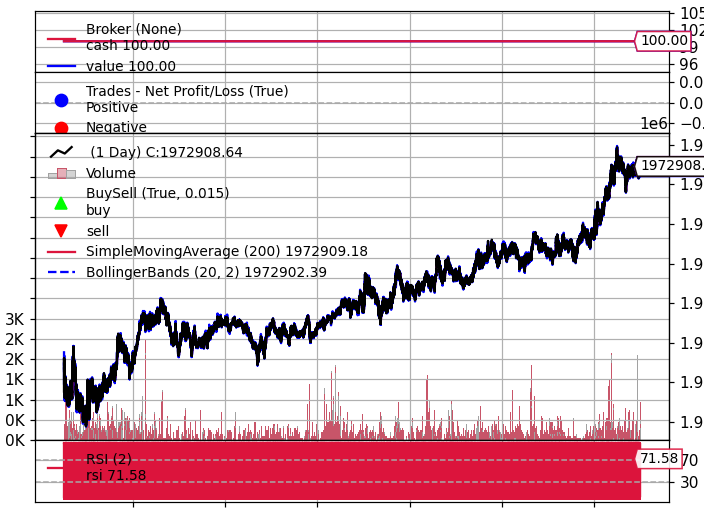

In [ ]:
import pandas as pd
import backtrader as bt
import datetime

# Assuming data_df is a DataFrame with "time" and "MV" columns.
data_df.set_index("time", inplace=True)
data_df = data_df.dropna()


class TestStrategy(bt.Strategy):
    def log(self, txt, dt=None):
        dt = dt or self.datas[0].datetime.date(0)
        print('%s, %s' % (dt.isoformat(), txt))

    def __init__(self):
        self.dataclose = self.datas[0].close
        self.order = None

        self.sma = bt.indicators.SimpleMovingAverage(self.dataclose, period=200)
        self.boll = bt.indicators.BollingerBands(self.dataclose, period=20, devfactor=2)
        self.rsi = bt.indicators.RSI(self.dataclose, period=2, safediv=True)

    def notify_order(self, order):
        if order.status in [order.Submitted, order.Accepted]:
            return

        if order.status in [order.Completed]:
            if order.isbuy():
                self.log('BUY EXECUTED, %.2f' % order.executed.price)
            elif order.issell():
                self.log('SELL EXECUTED, %.2f' % order.executed.price)

            self.bar_executed = len(self)

        self.order = None

    def next(self):
        self.log('Close, %.2f' % self.dataclose[0])
        if self.order:
            return

        if not self.position:
            if self.dataclose[0] < self.sma[0] and self.dataclose[0] < self.boll.lines.bot[0]:
                self.log('BUY CREATE, %.2f' % self.dataclose[0])
                self.order = self.buy(exectype=bt.Order.Market)  # Use Market order instead of Limit order
        else:
            if self.dataclose[0] > self.boll.lines.top[0]:
                self.log('SELL CREATE, %.2f' % self.dataclose[0])
                self.order = self.sell(exectype=bt.Order.Market)  # Use Market order instead of Limit order

    def stop(self):
        if self.position:
            self.log('SELL ALL, %.2f' % self.dataclose[0])
            self.close()

if __name__ == '__main__':
    cerebro = bt.Cerebro()

    # Assuming data_df is a DataFrame with "time" and "MV" columns and has been set as the index.
    data_feed = bt.feeds.PandasData(dataname=data_df)

    cerebro.adddata(data_feed)

    cerebro.addstrategy(TestStrategy)

    # Set the sizer here instead of inside the strategy.
    cerebro.addsizer(bt.sizers.PercentSizer, percents=100)

    # Set the starting cash amount for the backtest.
    cerebro.broker.set_cash(100)
    cerebro.broker.setcommission(commission=0.001, margin=False)  # Fixed commission per trade

    print('starting portfolio value: %.2f' % cerebro.broker.getvalue())

    cerebro.run()

    print('final portfolio value: %.2f' % value)

    # Create a new custom data feed for the MV column
    class MVData(bt.feeds.PandasData):
        lines = ('MV',)
        params = (('datetime', None), ('MV', -1),)  # Need to specify datetime field for custom feed

    # Extract the "MV" column from the DataFrame and convert it to a DataFrame with "time" as index
    mv_df = pd.DataFrame(data_df['MV'])
    mv_df['time'] = mv_df.index
    mv_df.set_index('time', inplace=True)

    mv_feed = MVData(dataname=mv_df)
    cerebro.adddata(mv_feed)

    cerebro.plot()


## net profit %=75.57 %